In [1]:
import sys
import os

# Get the root directory
root_dir = os.path.abspath(os.path.join(os.getcwd(), '..'))

# Add the root directory to the Python path
sys.path.append(root_dir)

In [2]:
from tqdm import tqdm
from torch.utils.data import DataLoader, TensorDataset
from torch.optim.lr_scheduler import OneCycleLR
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.datasets import load_diabetes
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from TINTOlib.igtd import IGTD
from kan import *
from tqdm import tqdm
from sklearn.metrics import confusion_matrix


import traceback
import time
import gc
import copy
import traceback
import cv2
import math
import random
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import torch.nn as nn
import torch.optim as optim
import csv


if torch.cuda.is_available():
  device = torch.device("cuda")
else:
  device = torch.device("cpu")

print(device)

cuda


In [3]:
SEED = 381
# SET RANDOM SEED FOR REPRODUCIBILITY
torch.manual_seed(SEED)
random.seed(SEED)
np.random.seed(SEED)

# Best 0.212

In [4]:
folder="data/treasury"
x_col=["1Y-CMaturityRate", "30Y-CMortgageRate", "3M-Rate-AuctionAverage", "3M-Rate-SecondaryMarket", "3Y-CMaturityRate", 
       "5Y-CMaturityRate", "bankCredit", "currency", "demandDeposits", "federalFunds", "moneyStock", "checkableDeposits", 
       "loansLeases", "savingsDeposits", "tradeCurrencies"]

target_col=["target"]

# Functions

### Load Dataset and Images

In [5]:
def load_and_clean(npy_filename, y_filename, x_col, target_col):
    """
    Load the feature array (npy_filename) and label array (y_filename),
    drop rows in the feature array that contain any NaNs, and apply
    the same mask to the label array.
    """
    # Load numpy arrays
    X = np.load(os.path.join(folder, npy_filename))
    y = np.load(os.path.join(folder, y_filename))
    
    # Ensure the number of rows matches between X and y
    if X.shape[0] != y.shape[0]:
        raise ValueError("The number of rows in {} and {} do not match.".format(npy_filename, y_filename))
    
    # Create a boolean mask for rows that do NOT have any NaN values in X
    valid_rows = ~np.isnan(X).any(axis=1)
    #print(valid_rows)
    # Filter both arrays using the valid_rows mask
    X_clean = X[valid_rows]
    y_clean = y[valid_rows]
    
    # Convert arrays to DataFrames
    df_X = pd.DataFrame(X_clean)
    df_y = pd.DataFrame(y_clean)
    df_X.columns = x_col
    df_y.columns = target_col
    return df_X, df_y

In [6]:
def load_and_preprocess_data(X_train, y_train, X_test, y_test, X_val, y_val, image_model, problem_type, batch_size=32):
    # Add target column to input for IGTD
    X_train_full = X_train.copy()
    X_train_full["target"] = y_train.values

    X_val_full = X_val.copy()
    X_val_full["target"] = y_val.values

    X_test_full = X_test.copy()
    X_test_full["target"] = y_test.values

    # Generate the images if the folder does not exist
    if not os.path.exists(f'{images_folder}/train'):
        image_model.fit_transform(X_train_full, f'{images_folder}/train')
        image_model.saveHyperparameters(f'{images_folder}/model.pkl')
    else:
        print("The images are already generated")

    # Load image paths
    imgs_train = pd.read_csv(os.path.join(f'{images_folder}/train', f'{problem_type}.csv'))
    imgs_train["images"] = images_folder + "/train/" + imgs_train["images"]

    if not os.path.exists(f'{images_folder}/val'):
        image_model.transform(X_val_full, f'{images_folder}/val')
    else:
        print("The images are already generated")

    imgs_val = pd.read_csv(os.path.join(f'{images_folder}/val', f'{problem_type}.csv'))
    imgs_val["images"] = images_folder + "/val/" + imgs_val["images"]

    if not os.path.exists(f'{images_folder}/test'):
        image_model.transform(X_test_full, f'{images_folder}/test')
    else:
        print("The images are already generated")

    imgs_test = pd.read_csv(os.path.join(f'{images_folder}/test', f'{problem_type}.csv'))
    imgs_test["images"] = images_folder + "/test/" + imgs_test["images"]

    # Image data
    X_train_img = np.array([cv2.imread(img) for img in imgs_train["images"]])
    X_val_img = np.array([cv2.imread(img) for img in imgs_val["images"]])
    X_test_img = np.array([cv2.imread(img) for img in imgs_test["images"]])

    # Create a MinMaxScaler object
    scaler = MinMaxScaler()

    # Scale numerical data
    X_train_num = pd.DataFrame(scaler.fit_transform(X_train), columns=X_train.columns)
    X_val_num = pd.DataFrame(scaler.transform(X_val), columns=X_val.columns)
    X_test_num = pd.DataFrame(scaler.transform(X_test), columns=X_test.columns)

    attributes = len(X_train_num.columns)
    height, width, channels = X_train_img[0].shape
    imgs_shape = (channels, height, width)

    print("Images shape: ", imgs_shape)
    print("Attributes: ", attributes)

    # Convert data to PyTorch tensors
    X_train_num_tensor = torch.as_tensor(X_train_num.values, dtype=torch.float32)
    X_val_num_tensor = torch.as_tensor(X_val_num.values, dtype=torch.float32)
    X_test_num_tensor = torch.as_tensor(X_test_num.values, dtype=torch.float32)
    X_train_img_tensor = torch.as_tensor(X_train_img, dtype=torch.float32).permute(0, 3, 1, 2) / 255.0
    X_val_img_tensor = torch.as_tensor(X_val_img, dtype=torch.float32).permute(0, 3, 1, 2) / 255.0
    X_test_img_tensor = torch.as_tensor(X_test_img, dtype=torch.float32).permute(0, 3, 1, 2) / 255.0
    y_train_tensor = torch.as_tensor(y_train.values, dtype=torch.float32).reshape(-1, 1)
    y_val_tensor = torch.as_tensor(y_val.values, dtype=torch.float32).reshape(-1, 1)
    y_test_tensor = torch.as_tensor(y_test.values, dtype=torch.float32).reshape(-1, 1)

    # Create DataLoaders
    train_dataset = TensorDataset(X_train_num_tensor, X_train_img_tensor, y_train_tensor)
    val_dataset = TensorDataset(X_val_num_tensor, X_val_img_tensor, y_val_tensor)
    test_dataset = TensorDataset(X_test_num_tensor, X_test_img_tensor, y_test_tensor)

    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, pin_memory=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, pin_memory=True)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, pin_memory=True)

    return train_loader, val_loader, test_loader, attributes, imgs_shape

In [7]:
def complete_coordinate_and_xcol(coordinate, x_col):
    """
    Given a coordinate (tuple of row, col arrays) and x_col feature list,
    return completed coordinate and x_col including empty positions.

    Empty positions are filled with labels: 'Ex1', 'Ex2', ...
    """

    row_coords, col_coords = coordinate
    max_row = row_coords.max()
    max_col = col_coords.max()
    
    # All possible coordinate slots
    full_coords = set((r, c) for r in range(max_row + 1) for c in range(max_col + 1))
    current_coords = set(zip(row_coords, col_coords))
    missing_coords = sorted(full_coords - current_coords)

    # Create updated coordinate arrays
    new_row_coords = list(row_coords)
    new_col_coords = list(col_coords)
    new_x_col = list(x_col)

    for idx, (r, c) in enumerate(missing_coords):
        new_row_coords.append(r)
        new_col_coords.append(c)
        new_x_col.append(f"Ex{idx+1}")

    completed_coordinate = (np.array(new_row_coords), np.array(new_col_coords))
    return completed_coordinate, new_x_col

In [8]:
def plot_feature_mapping(x_col, coordinate, scale=(4,4)):
    grid = np.full(scale, "", dtype=object)
    rows, cols = coordinate
    for i, (r, c) in enumerate(zip(rows, cols)):
        if i < len(x_col):
            grid[r, c] = x_col[i]
        else:
            grid[r, c] = "?"
    
    plt.figure(figsize=(scale[1] * 2, scale[0] * 2))
    for i in range(scale[0]):
        for j in range(scale[1]):
            plt.text(j, i, grid[i, j], ha='center', va='center', fontsize=10,
                     bbox=dict(facecolor='white', edgecolor='gray'))
    
    plt.xticks(np.arange(scale[1]))
    plt.yticks(np.arange(scale[0]))
    plt.grid(True)
    plt.title("Feature → Pixel Mapping")
    plt.gca().invert_yaxis()  # So row 0 is at the top
    plt.show()

In [9]:
def combine_loader(loader):
    """
    Combines all batches from a DataLoader into three tensors.
    Assumes each batch is a tuple: (mlp_tensor, img_tensor, target_tensor)
    """
    mlp_list, img_list, target_list = [], [], []
    for mlp, img, target in loader:
        mlp_list.append(mlp)
        img_list.append(img)
        target_list.append(target)
    return torch.cat(mlp_list, dim=0), torch.cat(img_list, dim=0), torch.cat(target_list, dim=0)

### Functions for KAN

In [10]:
def average_rmse(output, val_target):
    """
    Computes the root mean squared error (RMSE) between output and val_target.

    Args:
        output (torch.Tensor): The predicted output tensor.
        val_target (torch.Tensor): The ground truth tensor.
    
    Returns:
        float: The RMSE value.
    """
    mse = torch.mean((output - val_target) ** 2)
    rmse = torch.sqrt(mse)
    return rmse.item()

In [11]:
def plot_training_RMSE(train_loss, val_loss):
    plt.figure(figsize=(5, 4))
    plt.plot(train_loss)
    plt.plot(val_loss)
    plt.legend(['train', 'val'])
    plt.ylabel('RMSE')
    plt.xlabel('step')
    plt.yscale('log')

In [12]:
def plot_sorted_feature_importance(columns, importances):
    # Move to CPU and numpy if it's a GPU tensor
    if isinstance(importances, torch.Tensor):
        importances = importances.detach().cpu().numpy()

    # Pair columns and importances and sort by importance descending
    sorted_pairs = sorted(zip(columns, importances), key=lambda x: x[1], reverse=True)
    print(sorted_pairs)
    sorted_columns, sorted_importances = zip(*sorted_pairs)
    
    # Create the bar plot
    plt.figure(figsize=(6, 3))
    plt.barh(sorted_columns, sorted_importances, color='royalblue')
    plt.xlabel('Importance')
    plt.title('KAN Feature Importances')
    plt.gca().invert_yaxis()
    plt.tight_layout()
    plt.show()
    return sorted_pairs

In [13]:
def custom_fit(model, dataset, opt="LBFGS", steps=100, log=1, lamb=0., lamb_l1=1., lamb_entropy=2., lamb_coef=0., lamb_coefdiff=0., update_grid=True, 
               grid_update_num=10, loss_fn=None, lr=1.,start_grid_update_step=-1, stop_grid_update_step=50, batch=-1,
            metrics=None, save_fig=False, in_vars=None, out_vars=None, beta=3, save_fig_freq=1, img_folder='./video', 
               singularity_avoiding=False, y_th=1000., reg_metric='edge_forward_spline_n', display_metrics=None):
    '''
    training

    Args:
    -----
        dataset : dic
            contains dataset['train_input'], dataset['train_label'], dataset['val_input'], dataset['val_label']
        opt : str
            "LBFGS" or "Adam"
        steps : int
            training steps
        log : int
            logging frequency
        lamb : float
            overall penalty strength
        lamb_l1 : float
            l1 penalty strength
        lamb_entropy : float
            entropy penalty strength
        lamb_coef : float
            coefficient magnitude penalty strength
        lamb_coefdiff : float
            difference of nearby coefficits (smoothness) penalty strength
        update_grid : bool
            If True, update grid regularly before stop_grid_update_step
        grid_update_num : int
            the number of grid updates before stop_grid_update_step
        start_grid_update_step : int
            no grid updates before this training step
        stop_grid_update_step : int
            no grid updates after this training step
        loss_fn : function
            loss function
        lr : float
            learning rate
        batch : int
            batch size, if -1 then full.
        save_fig_freq : int
            save figure every (save_fig_freq) steps
        singularity_avoiding : bool
            indicate whether to avoid singularity for the symbolic part
        y_th : float
            singularity threshold (anything above the threshold is considered singular and is softened in some ways)
        reg_metric : str
            regularization metric. Choose from {'edge_forward_spline_n', 'edge_forward_spline_u', 'edge_forward_sum', 'edge_backward', 'node_backward'}
        metrics : a list of metrics (as functions)
            the metrics to be computed in training
        display_metrics : a list of functions
            the metric to be displayed in tqdm progress bar

    Returns:
    --------
        results : dic
            results['train_loss'], 1D array of training losses (RMSE)
            results['val_loss'], 1D array of val losses (RMSE)
            results['reg'], 1D array of regularization
            other metrics specified in metrics
        best_model:
    '''

    if lamb > 0. and not model.save_act:
        print('setting lamb=0. If you want to set lamb > 0, set model.save_act=True')
        
    old_save_act, old_symbolic_enabled = model.disable_symbolic_in_fit(lamb)

    pbar = tqdm(range(steps), desc='description', ncols=100)

    if loss_fn == None:
        loss_fn = loss_fn_eval = lambda x, y: torch.mean((x - y) ** 2)
    else:
        loss_fn = loss_fn_eval = loss_fn

    grid_update_freq = int(stop_grid_update_step / grid_update_num)

    if opt == "Adam":
        optimizer = torch.optim.Adam(model.get_params(), lr=lr)
    elif opt == "LBFGS":
        optimizer = LBFGS(model.get_params(), lr=lr, history_size=10, 
                          line_search_fn="strong_wolfe", 
                          tolerance_grad=1e-32,
                          tolerance_change=1e-32,
                          tolerance_ys=1e-32)

    results = {}
    results['train_loss'] = []
    results['val_loss'] = []
    results['reg'] = []
    if metrics != None:
        for i in range(len(metrics)):
            results[metrics[i].__name__] = []

    if batch == -1 or batch > dataset['train_input'].shape[0]:
        batch_size = dataset['train_input'].shape[0]
        batch_size_val = dataset['val_input'].shape[0]
    else:
        batch_size = batch
        batch_size_val = batch

    global train_loss, reg_

    def closure():
        global train_loss, reg_
        optimizer.zero_grad()
        pred = model.forward(dataset['train_input'][train_id], singularity_avoiding=singularity_avoiding, y_th=y_th)
        train_loss = loss_fn(pred, dataset['train_label'][train_id])
        if model.save_act:
            if reg_metric == 'edge_backward':
                model.attribute()
            if reg_metric == 'node_backward':
                model.node_attribute()
            reg_ = model.get_reg(reg_metric, lamb_l1, lamb_entropy, lamb_coef, lamb_coefdiff)
        else:
            reg_ = torch.tensor(0.)
        objective = train_loss + lamb * reg_
        objective.backward()
        return objective

    if save_fig:
        if not os.path.exists(img_folder):
            os.makedirs(img_folder)
    
    best_model_state = None
    best_epoch = -1
    best_loss = float('inf')
    
    for epoch in pbar:
        
        if epoch == steps-1 and old_save_act:
            model.save_act = True
            
        if save_fig and epoch % save_fig_freq == 0:
            save_act = model.save_act
            model.save_act = True
        
        train_id = np.random.choice(dataset['train_input'].shape[0], batch_size, replace=False)
        val_id = np.random.choice(dataset['val_input'].shape[0], batch_size_val, replace=False)

        if epoch % grid_update_freq == 0 and epoch < stop_grid_update_step and update_grid and epoch >= start_grid_update_step:
            model.update_grid(dataset['train_input'][train_id])

        if opt == "LBFGS":
            optimizer.step(closure)

        if opt == "Adam":
            pred = model.forward(dataset['train_input'][train_id], singularity_avoiding=singularity_avoiding, y_th=y_th)
            train_loss = loss_fn(pred, dataset['train_label'][train_id])
            if model.save_act:
                if reg_metric == 'edge_backward':
                    model.attribute()
                if reg_metric == 'node_backward':
                    model.node_attribute()
                reg_ = model.get_reg(reg_metric, lamb_l1, lamb_entropy, lamb_coef, lamb_coefdiff)
            else:
                reg_ = torch.tensor(0.)
            loss = train_loss + lamb * reg_
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        val_loss = loss_fn_eval(model.forward(dataset['val_input'][val_id]), dataset['val_label'][val_id])
        
        
        if metrics != None:
            for i in range(len(metrics)):
                results[metrics[i].__name__].append(metrics[i]().item())

        if val_loss < best_loss:
            best_epoch = epoch
            best_loss = val_loss
            best_model_state = copy.deepcopy(model.state_dict())
        
        results['train_loss'].append(torch.sqrt(train_loss).cpu().detach().numpy())
        results['val_loss'].append(torch.sqrt(val_loss).cpu().detach().numpy())
        results['reg'].append(reg_.cpu().detach().numpy())

        if epoch % log == 0:
            if display_metrics == None:
                pbar.set_description("| train_loss: %.2e | val_loss: %.2e | reg: %.2e | " % (torch.sqrt(train_loss).cpu().detach().numpy(), torch.sqrt(val_loss).cpu().detach().numpy(), reg_.cpu().detach().numpy()))
            else:
                string = ''
                data = ()
                for metric in display_metrics:
                    string += f' {metric}: %.2e |'
                    try:
                        results[metric]
                    except:
                        raise Exception(f'{metric} not recognized')
                    data += (results[metric][-1],)
                pbar.set_description(string % data)
                
        
        if save_fig and epoch % save_fig_freq == 0:
            model.plot(folder=img_folder, in_vars=in_vars, out_vars=out_vars, title="Step {}".format(_), beta=beta)
            plt.savefig(img_folder + '/' + str(_) + '.jpg', bbox_inches='tight', dpi=200)
            plt.close()
            model.save_act = save_act

    model.log_history('fit')
    # revert back to original state
    model.symbolic_enabled = old_symbolic_enabled
    print(f"Best epoch: {best_epoch} ")
    return best_model_state, results, best_epoch

### Grad CAM Functions

In [14]:
def grad_cam_side_by_side(model, model_state, num_input, img_input, x_col, coordinate,
                          zoom=1, target_index=None, save_path=None, show=True):
    model.load_state_dict(model_state)
    model.eval()
    model.zero_grad()

    if num_input.dim() == 1:
        num_input = num_input.unsqueeze(0)
    if img_input.dim() == 3:
        img_input = img_input.unsqueeze(0)

    num_input = num_input.to(model.device)
    img_input = img_input.to(model.device)

    # Store activations and gradients
    activations = {}
    gradients = {}

    def forward_hook(module, input, output):
        activations["value"] = output.detach()

    def backward_hook(module, grad_input, grad_output):
        gradients["value"] = grad_output[0].detach()

    conv_layer = model.cnn_branch[0]
    h_fwd = conv_layer.register_forward_hook(forward_hook)
    h_bwd = conv_layer.register_full_backward_hook(backward_hook)

    output = model(num_input, img_input)
    target = output if target_index is None else output[:, target_index]
    target.backward()

    act = activations["value"].squeeze(0)
    grad = gradients["value"].squeeze(0)
    weights = grad.mean(dim=(1, 2))
    cam = torch.zeros_like(act[0])
    for i, w in enumerate(weights):
        cam += w * act[i]

    cam = torch.relu(cam)
    if cam.max() > 0:
        cam -= cam.min()
        cam /= cam.max()
    else:
        cam[:] = 0.0


    cam_resized = F.interpolate(cam.unsqueeze(0).unsqueeze(0), size=img_input.shape[-2:], mode='bilinear', align_corners=False)
    #print(cam_resized)
    heatmap = cam_resized.squeeze().cpu()

    img_disp = img_input.squeeze().detach().cpu()
    if img_disp.shape[0] == 1:
        img_disp = img_disp[0]
        cmap = 'gray'
    else:
        img_disp = img_disp.permute(1, 2, 0)
        cmap = None

    h, w = img_disp.shape[:2]

    fig, axs = plt.subplots(1, 2, figsize=(12, 5))
    axs[0].imshow(img_disp, cmap=cmap)
    axs[0].set_title("Original Image")
    axs[0].axis('off')

    im = axs[1].imshow(img_disp, cmap=cmap)
    heatmap_img = axs[1].imshow(heatmap, cmap='jet', alpha=0.5)
    axs[1].set_title("Grad-CAM")
    axs[1].axis('off')

    # Add colorbar (legend)
    cbar = fig.colorbar(heatmap_img, ax=axs[1], fraction=0.046, pad=0.04)
    cbar.set_label("Grad-CAM Intensity", fontsize=10)

    # Overlay abbreviated features
    for i, col in enumerate(x_col):
        abbrev = col.split("-")[0][:8]
        if i < len(coordinate[0]):
            r, c = coordinate[0][i], coordinate[1][i]
            ry = r * zoom + zoom // 2
            cx = c * zoom + zoom // 2
            if ry < h and cx < w:
                axs[1].text(cx, ry, abbrev,
                            color='white', fontsize=9, ha='center', va='center',
                            bbox=dict(facecolor='black', edgecolor='none', pad=1.0, alpha=0.4))
                axs[0].text(cx, ry, abbrev,
                            color='white', fontsize=9, ha='center', va='center',
                            bbox=dict(facecolor='black', edgecolor='none', pad=1.0, alpha=0.4))

    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, bbox_inches='tight', dpi=300)

    if show:
        plt.show()
    else:
        plt.close()

    h_fwd.remove()
    h_bwd.remove()

    return heatmap

In [15]:
def heatmap_to_feature_relevance(heatmap, coordinate, x_col, zoom=1):
    """
    Map heatmap pixel intensities to their corresponding features using coordinate and zoom.
    Returns a dictionary of {feature_name: relevance_score}.
    """
    feature_scores = {}

    for i, col in enumerate(x_col):
        if i < len(coordinate[0]):
            r, c = coordinate[0][i], coordinate[1][i]
            ry = r * zoom + zoom // 2
            cx = c * zoom + zoom // 2
            if ry < heatmap.shape[0] and cx < heatmap.shape[1]:
                feature_scores[col] = heatmap[ry, cx].item()

    return feature_scores

def plot_feature_relevance_bar(feature_scores):
    """
    Plots a horizontal bar chart of feature relevance from Grad-CAM heatmap.
    """
    sorted_scores = sorted(feature_scores.items(), key=lambda item: item[1], reverse=True)
    print(sorted_scores)
    features, scores = zip(*sorted_scores)

    plt.figure(figsize=(6, 3))
    plt.barh(features, scores, color='royalblue')
    plt.xlabel("Grad-CAM Relevance")
    plt.title("Feature Relevance for Test")
    plt.gca().invert_yaxis()
    plt.tight_layout()
    plt.show()
    return sorted_scores

In [16]:
def compute_avg_feature_relevance_from_val(model, model_state, val_inputs, val_imgs, coordinate, x_col, zoom=1):
    """
    Computes average Grad-CAM feature relevance over all validation instances with a tqdm progress bar.

    Args:
        model: Trained model
        model_state: Trained weights to be loaded
        val_inputs: List or tensor of numerical inputs
        val_imgs: List or tensor of image inputs
        coordinate: IGTD-style coordinate tuple (row array, col array)
        x_col: List of feature names (including extras)
        zoom: Zoom level used when generating the images

    Returns:
        Dictionary of average feature relevance
    """
    accumulated_scores = {feature: [] for feature in x_col}

    for num_input, img_input in tqdm(zip(val_inputs, val_imgs), total=len(val_inputs), desc="Computing Grad-CAM"):
        heatmap = grad_cam_side_by_side(
            model=model,
            model_state=model_state,
            num_input=num_input,
            img_input=img_input,
            coordinate=coordinate,
            x_col=x_col,
            zoom=zoom,
            show=False
        )
        scores = heatmap_to_feature_relevance(heatmap, coordinate, x_col, zoom)
        for feature, value in scores.items():
            accumulated_scores[feature].append(value)

    # Compute average
    avg_scores = {feature: float(np.mean(values)) if values else 0.0
                  for feature, values in accumulated_scores.items()}

    return avg_scores


def plot_avg_feature_relevance_from_val(model, val_inputs, val_imgs, coordinate, x_col, zoom=1):
    """
    Combines all steps: compute average relevance and plot.
    """
    avg_scores = compute_avg_feature_relevance_from_val(model, val_inputs, val_imgs, coordinate, x_col, zoom)
    plot_feature_relevance_bar(avg_scores)
    return avg_scores

### CNN Functions

In [18]:
def fit_cnn_only_model(model, dataset, steps=100, lr=1.0, loss_fn=None, batch=-1, opt="LBFGS"):
    """
    Trains a CNN-only model using LBFGS.

    Args:
        model: CNN-only PyTorch model.
        dataset: Dictionary with keys: 'train_img', 'train_label', 'val_img', 'val_label'.
        steps: Number of training iterations.
        lr: Learning rate.
        loss_fn: Loss function. Defaults to MSE.

    Returns:
        results: Dict with lists of train/val losses.
        best_model_state: Best weights based on val loss.
    """
    device = model.device
    if loss_fn is None:
        loss_fn = nn.MSELoss()

    # Optimizer selection
    if opt == "LBFGS":
        optimizer = LBFGS(model.parameters(), lr=lr, history_size=10, 
                          line_search_fn="strong_wolfe", 
                          tolerance_grad=1e-32, 
                          tolerance_change=1e-32, 
                          tolerance_ys=1e-32)
    elif opt == "AdamW":
        optimizer = optim.AdamW(model.parameters(), lr=lr)
    else:
        raise ValueError(f"Unsupported optimizer '{opt}'")

    n_train = dataset["train_img"].shape[0]
    n_val = dataset["val_img"].shape[0]
    batch_size = n_train if batch == -1 or batch > n_train else batch

    results = {'train_loss': [], 'val_loss': []}
    best_model_state = None
    best_loss = float("inf")
    best_epoch = -1

    pbar = tqdm(range(steps), desc="Training CNN Only ({opt})", ncols=100)

    for step in pbar:
        train_idx = np.random.choice(n_train, batch_size, replace=False)
        #train_idx = torch.randperm(n_train)[:min(32, n_train)]  # small batch
        x_train = dataset["train_img"][train_idx].to(device)
        y_train = dataset["train_label"][train_idx].to(device)
        if opt == "LBFGS":
            def closure():
                optimizer.zero_grad()
                output = model(0, x_train)
                loss = loss_fn(output, y_train)
                loss.backward()
                return loss
            optimizer.step(closure)
            train_loss = closure().item()

        else:  # AdamW
            optimizer.zero_grad()
            output = model(0, x_train)
            loss = loss_fn(output, y_train)
            loss.backward()
            optimizer.step()
            train_loss = loss.item()

        with torch.no_grad():
            val_output = model(0, dataset["val_img"].to(device))
            val_loss = loss_fn(val_output, dataset["val_label"].to(device)).item()

        results["train_loss"].append(train_loss)
        results["val_loss"].append(val_loss)

        if val_loss < best_loss:
            best_loss = val_loss
            best_epoch = step
            best_model_state = copy.deepcopy(model.state_dict())

        pbar.set_description(f"| Train: {train_loss:.4e} | Val: {val_loss:.4e} |")

    print(f"✅ Best validation loss: {best_loss:.4e} at {best_epoch} epoch")
    return best_model_state, results, best_epoch

In [19]:
def build_custom_cnn_model(cnn_blocks, dense_layers, imgs_shape, device='cuda'):
    class CustomCNNModel(nn.Module):
        def __init__(self):
            super(CustomCNNModel, self).__init__()
            self.device = device

            cnn_layers = []
            in_channels = imgs_shape[0]
            out_channels = 16
            cnn_blocks_list = [8, 6, 5]
            size_layer_norm = cnn_blocks_list[cnn_blocks-1]
            
            f_layer_size = 10 - cnn_blocks*2
            for i in range(cnn_blocks):
                cnn_layers.append(nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=2))
                
                if i < cnn_blocks - 1:
                    cnn_layers.append(nn.BatchNorm2d(out_channels))
                    cnn_layers.append(nn.ReLU())
                    cnn_layers.append(nn.MaxPool2d(2))
                else:
                    # Last block: LayerNorm + Sigmoid + Flatten
                    cnn_layers.append(nn.LayerNorm([out_channels, size_layer_norm, size_layer_norm]))
                    cnn_layers.append(nn.Sigmoid())
                    cnn_layers.append(nn.Flatten())
                in_channels = out_channels
                out_channels *= 2

            self.cnn_branch = nn.Sequential(*cnn_layers).to(device)
            self.flat_size = self._get_flat_size(imgs_shape)

            # Dense (FC) layers
            fc_layers = []
            input_dim = self.flat_size
            for i in range(dense_layers - 1):
                fc_layers.append(nn.Linear(int(input_dim), int(input_dim // 2)))
                fc_layers.append(nn.ReLU())
                input_dim = input_dim // 2
            fc_layers.append(nn.Linear(int(input_dim), 1))

            self.fc = nn.Sequential(*fc_layers).to(device)

        def _get_flat_size(self, imgs_shape):
            dummy_input = torch.zeros(1, *imgs_shape, device=self.device)
            x = self.cnn_branch(dummy_input)
            return x.shape[1]

        def forward(self, num_input, img_input):
            img_input = img_input.to(self.device)
            features = self.cnn_branch(img_input)
            output = self.fc(features)
            return output

    return CustomCNNModel()

### Hybrid Functions

In [17]:
def print_mkan_vs_cnn_relevance(feature_scores, mkan_len):
    if isinstance(feature_scores, torch.Tensor):
        feature_scores = feature_scores.detach().cpu().numpy()

    mkan_relevance = feature_scores[:mkan_len].sum()
    cnn_relevance = feature_scores[mkan_len:].sum()
    m_kan_relevance_perct = float(mkan_relevance/(mkan_relevance+cnn_relevance))
    cnn_relevance_perct = float(cnn_relevance/(mkan_relevance+cnn_relevance))
    print(f"M_KAN Relevance: {m_kan_relevance_perct}")
    print(f"CNN Relevance: {cnn_relevance_perct}")
    return m_kan_relevance_perct, cnn_relevance_perct

In [18]:
def plot_mkan_vs_cnn_relevance(feature_scores, mkan_len=6, title="Feature Relevance Split"):
    """
    Plots a pie chart comparing the total feature relevance from m_kan output vs CNN output.

    Args:
        feature_scores (torch.Tensor or list): 1D tensor of relevance values from final_kan.
        mkan_len (int): Number of dimensions from m_kan (default: 6).
        title (str): Title for the pie chart.
    """
    if isinstance(feature_scores, torch.Tensor):
        feature_scores = feature_scores.detach().cpu().numpy()

    mkan_relevance = feature_scores[:mkan_len].sum()
    cnn_relevance = feature_scores[mkan_len:].sum()

    sizes = [mkan_relevance, cnn_relevance]
    labels = ['m_kan Output', 'CNN Output']
    explode = (0.05, 0)  # Slightly explode m_kan slice for emphasis

    plt.figure(figsize=(3, 3))
    plt.pie(sizes, labels=labels, explode=explode, autopct='%1.1f%%',
            shadow=True, startangle=140, colors=["#66c2a5", "#fc8d62"])
    plt.title(title)
    plt.axis('equal')
    plt.tight_layout()
    plt.show()

In [19]:
def fit_hybrid_dataloaders(model, 
                           dataset,
                           opt="AdamW", 
                           steps=100, 
                           log=1, 
                           lamb=0., 
                           lamb_l1=1., 
                           lamb_entropy=2., 
                           lamb_coef=0., 
                           lamb_coefdiff=0., 
                           update_grid=True, 
                           grid_update_num=10, 
                           loss_fn=None, 
                           lr=1., 
                           start_grid_update_step=-1, 
                           stop_grid_update_step=50, 
                           batch=-1,
                           metrics=None, 
                           save_fig=False, 
                           in_vars=None, 
                           out_vars=None, 
                           beta=3, 
                           save_fig_freq=1, 
                           img_folder='./video', 
                           singularity_avoiding=False, 
                           y_th=1000., 
                           reg_metric='edge_forward_spline_n', 
                           display_metrics=None,
                           sum_f_reg=True):
    """
    Trains the hybrid model (with a KAN branch and a CNN branch) using a steps-based loop
    adapted from KAN.fit(), with grid updates and regularization.
    
    Instead of a single dataset dict, this function accepts three DataLoaders:
        - train_loader: provides (mlp, img, target) for training
        - val_loader: provides (mlp, img, target) for evaluation during training
        - test_loader: provides (mlp, img, target) for validation

    Internally, the function combines each loader into a dataset dictionary.
    
    Returns:
        results: dictionary containing training loss, evaluation loss, regularization values,
                 and any additional metrics recorded during training.
    """
    # Warn if regularization is requested but model's internal flag isn't enabled.
    if lamb > 0. and not getattr(model.m_kan, "save_act", False):
        print("setting lamb=0. If you want to set lamb > 0, set model.m_kan.save_act=True")
    
    # Disable symbolic processing for training if applicable (KAN internal logic)
    if hasattr(model.m_kan, "disable_symbolic_in_fit"):
        old_save_act, old_symbolic_enabled = model.m_kan.disable_symbolic_in_fit(lamb)
        f_old_save_act, f_old_symbolic_enabled = model.final_kan.disable_symbolic_in_fit(lamb)
    else:
        old_save_act, old_symbolic_enabled = None, None

    pbar = tqdm(range(steps), desc='Training', ncols=100)

    # Default loss function (mean squared error) if not provided
    if loss_fn is None:
        loss_fn = lambda x, y: torch.mean((x - y) ** 2)

    # Determine grid update frequency
    grid_update_freq = int(stop_grid_update_step / grid_update_num) if grid_update_num > 0 else 1

    # Determine total number of training examples
    n_train = dataset["train_input"].shape[0]
    n_eval  = dataset["val_input"].shape[0]  # using val set for evaluation during training
    batch_size = n_train if batch == -1 or batch > n_train else batch

    # Set up optimizer: choose between Adam and LBFGS (removed tolerance_ys)
    if opt == "AdamW":
        optimizer = optim.AdamW(model.parameters(), lr=lr)
    elif opt == "LBFGS":        
        optimizer = LBFGS(model.parameters(), lr=lr, history_size=10, 
                          line_search_fn="strong_wolfe", 
                          tolerance_grad=1e-32, 
                          tolerance_change=1e-32, 
                          tolerance_ys=1e-32)
    else:
        raise ValueError("Optimizer not recognized. Use 'Adam' or 'LBFGS'.")

    # Prepare results dictionary.
    results = {'train_loss': [], 'eval_loss': [], 'reg': []}

    
    if metrics is not None:
        for metric in metrics:
            results[metric.__name__] = []

    best_model_state = None
    best_epoch = -1
    best_loss = float('inf')

    for step in pbar:
        # Randomly sample indices for a mini-batch from the training set.
        train_indices = np.random.choice(n_train, batch_size, replace=False)
        # Use full evaluation set for evaluation; you can also sample if desired.
        eval_indices = np.arange(n_eval)
        cached_loss = {}
        # Closure for LBFGS
        def closure():
            optimizer.zero_grad()
            mlp_batch = dataset["train_input"][train_indices]
            img_batch = dataset["train_img"][train_indices]
            target_batch = dataset["train_label"][train_indices]
            outputs = model(mlp_batch, img_batch)
            train_loss = loss_fn(outputs, target_batch)
            # Compute regularization term if enabled.
            if hasattr(model.m_kan, "save_act") and model.m_kan.save_act:
                if reg_metric == 'edge_backward':
                    model.m_kan.attribute()
                    model.final_kan.attribute()
                if reg_metric == 'node_backward':
                    model.m_kan.node_attribute()
                    model.final_kan.node_attribute()
                reg_val_inner = model.m_kan.get_reg(reg_metric, lamb_l1, lamb_entropy, lamb_coef, lamb_coefdiff)
                if sum_f_reg:
                    reg_val_inner += model.final_kan.get_reg(reg_metric, lamb_l1, lamb_entropy, lamb_coef, lamb_coefdiff)
            else:
                reg_val_inner = torch.tensor(0., device=device)
            loss_val_inner = train_loss + lamb * reg_val_inner
            loss_val_inner.backward()

            cached_loss['loss'] = loss_val_inner.detach()
            cached_loss['reg'] = reg_val_inner.detach()
            return loss_val_inner

        # Perform grid update if applicable.
        if (step % grid_update_freq == 0 and step < stop_grid_update_step 
            and update_grid and step >= start_grid_update_step):
            
            mlp_batch = dataset['train_input'][train_indices]
            cnn_batch = dataset['train_img'][train_indices]
            
            model.m_kan.update_grid(mlp_batch)
            #cnn_output = model.cnn_branch(cnn_batch)  # Process image input
            concatenated = model.get_concat_output(mlp_batch, cnn_batch)
            #concatenated = torch.cat((mlp_batch, cnn_output), dim=1)
            model.final_kan.update_grid(concatenated)

        # Perform an optimizer step.
        if opt == "LBFGS":
            optimizer.step(closure)
            loss_val = cached_loss['loss']
            reg_val = cached_loss['reg']
        else:  # AdamW branch
            optimizer.zero_grad()
            mlp_batch = dataset["train_input"][train_indices]
            img_batch = dataset["train_img"][train_indices]
            target_batch = dataset["train_label"][train_indices]
            outputs = model(mlp_batch, img_batch)
            train_loss = loss_fn(outputs, target_batch)
            if hasattr(model.m_kan, "save_act") and model.m_kan.save_act:
                if reg_metric == 'edge_backward':
                    model.m_kan.attribute()
                    model.final_kan.attribute()
                if reg_metric == 'node_backward':
                    model.m_kan.node_attribute()
                    model.final_kan.node_attribute()
                reg_val = model.m_kan.get_reg(reg_metric, lamb_l1, lamb_entropy, lamb_coef, lamb_coefdiff)
                if sum_f_reg:
                    reg_val += model.final_kan.get_reg(reg_metric, lamb_l1, lamb_entropy, lamb_coef, lamb_coefdiff)
            else:
                reg_val = torch.tensor(0., device=device)
            loss_val = train_loss + lamb * reg_val
            loss_val.backward()
            optimizer.step()

        with torch.no_grad():
            mlp_eval = dataset["val_input"][eval_indices]
            img_eval = dataset["val_img"][eval_indices]
            target_eval = dataset["val_label"][eval_indices]
            eval_loss = loss_fn(model(mlp_eval, img_eval), target_eval)

        # Record results (using square-root of loss similar to KAN.fit)
        results['train_loss'].append(torch.sqrt(loss_val.detach()).item())
        results['eval_loss'].append(torch.sqrt(eval_loss.detach()).item())
        results['reg'].append(reg_val.detach().item())

        if metrics is not None:
            for metric in metrics:
                # Here, we assume each metric returns a tensor.
                results[metric.__name__].append(metric().item())

        if eval_loss < best_loss:
            best_epoch = step
            best_loss = eval_loss
            best_model_state = copy.deepcopy(model.state_dict())

        # Update progress bar.
        if display_metrics is None:
            pbar.set_description("| train_loss: %.2e | eval_loss: %.2e | reg: %.2e |" %
                                 (torch.sqrt(loss_val.detach()).item(),
                                  torch.sqrt(eval_loss.detach()).item(),
                                  reg_val.detach().item()))
        else:
            desc = ""
            data = []
            for metric in display_metrics:
                desc += f" {metric}: %.2e |"
                data.append(results[metric.__name__][-1])
            pbar.set_description(desc % tuple(data))

        # Optionally save a figure snapshot.
        if save_fig and step % save_fig_freq == 0:
            save_act_backup = getattr(model.m_kan, "save_act", False)
            model.m_kan.save_act = True
            model.plot(folder=img_folder, in_vars=in_vars, out_vars=out_vars, title=f"Step {step}", beta=beta)
            plt.savefig(os.path.join(img_folder, f"{step}.jpg"), bbox_inches='tight', dpi=200)
            plt.close()
            model.m_kan.save_act = save_act_backup

    # Restore original settings if applicable.
    if old_symbolic_enabled is not None:
        model.m_kan.symbolic_enabled = old_symbolic_enabled
    if hasattr(model.m_kan, "log_history"):
        model.m_kan.log_history('fit')
    print(f"Best epoch {best_epoch}")
    return best_model_state, results, best_epoch

In [20]:
import traceback

def try_create_model(model_class, attributes, imgs_shape, kan_neurons, kan_grid, cnn_bottleneck_dim, alpha, hidden_dim, embed_dim, num_heads):
    try:
        model = model_class(attributes, imgs_shape, kan_neurons, kan_grid,
                            cnn_bottleneck_dim=cnn_bottleneck_dim, alpha=alpha, hidden_dim=hidden_dim, embed_dim=embed_dim, num_heads=num_heads)

        # Test the model with a sample input
        num_input = torch.randn(4, attributes)
        img_input = torch.randn(4, *imgs_shape)
        output = model(num_input, img_input)
        
        print(f"Successfully created and tested {model_class.__name__}")
        
        return model
    except Exception as e:
        print(f"Error creating or testing {model_class.__name__}:")
        traceback.print_exc()
        return None

In [21]:
def cnn_branch_relevance(model, best_model_state):
    avg_scores = compute_avg_feature_relevance_from_val(
        model=model,
        model_state=best_model_state,
        val_inputs=dataset["test_input"],
        val_imgs=dataset["test_img"],
        coordinate=completed_coordinate,
        x_col=completed_x_col,
        zoom=2
    )
    return plot_feature_relevance_bar(avg_scores)

In [22]:
def train_and_plot_relevance(model_class, kan_neurons, kan_grid, lamb, steps, cnn_bottleneck_dim=-1, alpha=-1, hidden_dim=-1, embed_dim=-1, num_heads=-1, n_kan_len=None, filename=None, opt_col_val=None):
    torch.cuda.empty_cache()
    gc.collect()
    model = try_create_model(model_class, attributes, imgs_shape, kan_neurons=kan_neurons, kan_grid=kan_grid,
                             cnn_bottleneck_dim=cnn_bottleneck_dim, alpha=alpha, hidden_dim=hidden_dim, embed_dim=embed_dim, num_heads=num_heads)
    best_model_state, metrics3, best_epoch = fit_hybrid_dataloaders(model, dataset, opt="LBFGS", lamb=lamb, steps=steps)
    model.load_state_dict(best_model_state)
    rmse = average_rmse(model(dataset['test_input'], dataset['test_img']), dataset['test_label'])
    print(rmse)
    plot_training_RMSE(metrics3['train_loss'], metrics3['eval_loss'])
    if not n_kan_len:
        n_kan_len = kan_neurons
    k_rel, cnn_rel = print_mkan_vs_cnn_relevance(model.final_kan.feature_score, mkan_len=n_kan_len)
    #plot_mkan_vs_cnn_relevance(model.final_kan.feature_score, mkan_len=kan_neurons)
    kan_mrf = plot_sorted_feature_importance(x_col, model.m_kan.feature_score)
    
    cnn_mrf = cnn_branch_relevance(model, best_model_state)

    append_row_to_csv(filename, kan_neurons, kan_grid, lamb, opt_col_val, rmse, best_epoch, k_rel, cnn_rel, kan_mrf, cnn_mrf)

### Models Class

In [22]:
class Model3(nn.Module):
    def __init__(self, attributes, imgs_shape, kan_neurons, kan_grid, cnn_bottleneck_dim, device=device):
        super(Model3, self).__init__()
        # CNN branch
        self.cnn_branch = nn.Sequential(
            nn.Conv2d(imgs_shape[0], 16, kernel_size=3, padding=2),     # out: 16 x 9 x 9
            nn.LayerNorm([16, 8, 8]),
            nn.Sigmoid(),
            nn.Flatten()
        ).to(device)
        # Final KAN layers
        self.m_kan = KAN(
            width=[attributes, kan_neurons],
            grid=kan_grid,
            k=3,
            seed=SEED,
            device=device
        )

        # Calculate the size of the flattened output
        self.flat_size = self._get_flat_size(imgs_shape)

        # Final MLP layers
        self.final_kan = KAN(
            width=[self.flat_size + kan_neurons, 1],
            grid=kan_grid,
            k=3,
            seed=SEED,
            device=device
        )

        self.device = device


    def _get_flat_size(self, imgs_shape):
        # Forward pass with dummy input to calculate flat size
        dummy_input = torch.zeros(4, *imgs_shape, device=device)
        x = self.cnn_branch(dummy_input)
        return x.size(1)

    def get_concat_output(self, mlp_input, cnn_input):
        # Ensure inputs are moved to the correct device
        kan_input = mlp_input.to(self.device)
        cnn_input = cnn_input.to(self.device)
        
        cnn_output = self.cnn_branch(cnn_input)  # Process image input
        kan_output = self.m_kan(kan_input)  # Process numerical input
        
        return torch.cat((kan_output, cnn_output), dim=1)

    
    def forward(self, mlp_input, cnn_input):
        concat_output = self.get_concat_output(mlp_input, cnn_input)
        return self.final_kan(concat_output)

In [23]:
class Model4(nn.Module):
    def __init__(self, attributes, imgs_shape, kan_neurons, kan_grid, cnn_bottleneck_dim, device=device):
        super(Model4, self).__init__()

        self.cnn_branch = nn.Sequential(
            nn.Conv2d(imgs_shape[0], 16, kernel_size=3, padding=2),     # out: 16 x 9 x 9
            nn.BatchNorm2d(16),
            nn.ReLU(),
            nn.MaxPool2d(2),                                            # out: 16 x 4 x 4
            
            nn.Conv2d(16, 32, kernel_size=3, padding=2),                # out: 32 x 5 x 5
            nn.LayerNorm([32, 6, 6]),
            nn.Sigmoid(),
            nn.Flatten()
        ).to(device)

        # Middle KAN layers
        self.m_kan = KAN(
            width=[attributes, kan_neurons],
            grid=kan_grid,
            k=3,
            seed=SEED,
            device=device
        )
        # Calculate the size of the flattened output
        self.flat_size = self._get_flat_size(imgs_shape)
        # Final MLP layers
        self.final_kan = KAN(
            width=[self.flat_size + kan_neurons, 1],
            grid=kan_grid,
            k=3,
            device=device
        )
        
        self.device = device

    def _get_flat_size(self, imgs_shape):
        # Forward pass with dummy input to calculate flat size
        dummy_input = torch.zeros(4, *imgs_shape, device=device)
        x = self.cnn_branch(dummy_input)
        return x.size(1)

    def get_concat_output(self, mlp_input, cnn_input):
        # Ensure inputs are moved to the correct device
        kan_input = mlp_input.to(self.device)
        cnn_input = cnn_input.to(self.device)
        
        cnn_output = self.cnn_branch(cnn_input)  # Process image input
        kan_output = self.m_kan(kan_input)  # Process numerical input
        
        return torch.cat((kan_output, cnn_output), dim=1)

    
    def forward(self, mlp_input, cnn_input):
        concat_output = self.get_concat_output(mlp_input, cnn_input)
        return self.final_kan(concat_output)

### Write metrics

In [23]:
def create_csv_with_header(filename, columns_opt):
    header=['kan_neurons', 'kan_grid', 'lamb', columns_opt, 'ACC','Best_Epoch','KAN_Relevance','CNN_Relevance','KAN M.R.F.','CNN M.R.F.']
    """Creates a CSV file with a given header."""
    with open(filename, mode='w', newline='') as file:
        writer = csv.writer(file)
        writer.writerow(header)

In [24]:
def format_top_3(pairs):
    return '\n'.join(f"{k}: {v:.2f}" for k, v in pairs[:3])

In [25]:
def append_row_to_csv(filename, kan_neurons, kan_grid, lamb, opt_col_val, acc, best_epoch, k_rel, cnn_rel, kan_mrf, cnn_mrf):
    row = [kan_neurons, kan_grid, lamb, opt_col_val, acc, best_epoch, k_rel, cnn_rel, format_top_3(kan_mrf), format_top_3(cnn_mrf)]
    """Appends a single row to an existing CSV file."""
    if not os.path.isfile(filename):
        raise FileNotFoundError(f"{filename} does not exist. Please create the file first with a header.")
    with open(filename, mode='a', newline='') as file:
        writer = csv.writer(file)
        writer.writerow(row)

### Models Class Hybrids

In [26]:
class Model3_0(nn.Module):
    def __init__(self, attributes, imgs_shape, kan_neurons, kan_grid, cnn_bottleneck_dim=-1, alpha=-1, hidden_dim=-1, embed_dim=-1, num_heads=-1, device=device):
        super(Model3_0, self).__init__()

        self.device = device

        # CNN branch
        self.cnn_branch = nn.Sequential(
            nn.Conv2d(imgs_shape[0], 16, kernel_size=3, padding=2),     # out: 16 x 9 x 9
            nn.BatchNorm2d(16),
            nn.ReLU(),
            nn.MaxPool2d(2),                                            # out: 16 x 4 x 4
            
            nn.Conv2d(16, 32, kernel_size=3, padding=2),                # out: 32 x 5 x 5
            nn.LayerNorm([32, 7, 7]),
            nn.Sigmoid(),
            nn.Flatten()
        ).to(device)

        # Dummy pass to get flattened size
        self.flat_size = self._get_flat_size(imgs_shape)

        # Bottleneck layer
        self.cnn_bottleneck = nn.Linear(self.flat_size, 1).to(device)

        # KAN branch
        self.m_kan = KAN(
            width=[attributes, kan_neurons, 1],
            grid=kan_grid,
            k=3,
            seed=SEED,
            device=device
        )

        # Final KAN layer
        self.final_kan = KAN(
            width=[2, 1],
            grid=kan_grid,
            k=3,
            seed=SEED,
            device=device
        )

    def _get_flat_size(self, imgs_shape):
        dummy_input = torch.zeros(1, *imgs_shape, device=self.device)
        x = self.cnn_branch(dummy_input)
        return x.shape[1]

    def get_concat_output(self, mlp_input, cnn_input):
        kan_input = mlp_input.to(self.device)
        cnn_input = cnn_input.to(self.device)

        conv_out = self.cnn_branch(cnn_input)
        cnn_output = self.cnn_bottleneck(conv_out)

        kan_output = self.m_kan(kan_input)

        return torch.cat((kan_output, cnn_output), dim=1)

    def forward(self, mlp_input, cnn_input):
        concat_output = self.get_concat_output(mlp_input, cnn_input)
        return self.final_kan(concat_output)

In [27]:
class Model3_1(nn.Module):
    def __init__(self, attributes, imgs_shape, kan_neurons, kan_grid, cnn_bottleneck_dim=-1, alpha=-1, hidden_dim=-1, embed_dim=-1, num_heads=-1, device=device):
        super(Model3_1, self).__init__()

        self.device = device

        # CNN branch
        self.cnn_branch = nn.Sequential(
            nn.Conv2d(imgs_shape[0], 16, kernel_size=3, padding=2),     # out: 16 x 9 x 9
            nn.BatchNorm2d(16),
            nn.ReLU(),
            nn.MaxPool2d(2),                                            # out: 16 x 4 x 4
            
            nn.Conv2d(16, 32, kernel_size=3, padding=2),                # out: 32 x 5 x 5
            nn.LayerNorm([32, 7, 7]),
            nn.Sigmoid(),
            nn.Flatten()
        ).to(device)

        # Dummy pass to get flattened size
        self.flat_size = self._get_flat_size(imgs_shape)

        # Bottleneck layer
        self.cnn_bottleneck = nn.Linear(self.flat_size, cnn_bottleneck_dim).to(device)

        # KAN branch
        self.m_kan = KAN(
            width=[attributes, kan_neurons],
            grid=kan_grid,
            k=3,
            seed=SEED,
            device=device
        )

        # Final KAN layer
        self.final_kan = KAN(
            width=[cnn_bottleneck_dim + kan_neurons, 1],
            grid=kan_grid,
            k=3,
            seed=SEED,
            device=device
        )

    def _get_flat_size(self, imgs_shape):
        dummy_input = torch.zeros(1, *imgs_shape, device=self.device)
        x = self.cnn_branch(dummy_input)
        return x.shape[1]

    def get_concat_output(self, mlp_input, cnn_input):
        kan_input = mlp_input.to(self.device)
        cnn_input = cnn_input.to(self.device)

        conv_out = self.cnn_branch(cnn_input)
        cnn_output = self.cnn_bottleneck(conv_out)

        kan_output = self.m_kan(kan_input)

        return torch.cat((kan_output, cnn_output), dim=1)

    def forward(self, mlp_input, cnn_input):
        concat_output = self.get_concat_output(mlp_input, cnn_input)
        return self.final_kan(concat_output)

In [28]:
class Model3_2(nn.Module):
    def __init__(self, attributes, imgs_shape, kan_neurons, kan_grid, cnn_bottleneck_dim=-1, alpha=-1, hidden_dim=-1, embed_dim=-1, num_heads=-1, device=device):
        super(Model3_2, self).__init__()
        # CNN branch
        self.cnn_branch = nn.Sequential(
            nn.Conv2d(imgs_shape[0], 16, kernel_size=3, padding=2),     # out: 16 x 9 x 9
            nn.BatchNorm2d(16),
            nn.ReLU(),
            nn.MaxPool2d(2),                                            # out: 16 x 4 x 4
            
            nn.Conv2d(16, 32, kernel_size=3, padding=2),                # out: 32 x 5 x 5
            nn.LayerNorm([32, 7, 7]),
            nn.Sigmoid(),
            nn.Flatten()
        ).to(device)
        # Final KAN layers
        self.m_kan = KAN(
            width=[attributes, kan_neurons],
            grid=kan_grid,
            k=3,
            seed=SEED,
            device=device
        )

        # Calculate the size of the flattened output
        self.flat_size = self._get_flat_size(imgs_shape)

        # Final MLP layers
        self.final_kan = KAN(
            width=[self.flat_size + kan_neurons, 1],
            grid=kan_grid,
            k=3,
            seed=SEED,
            device=device
        )

        self.device = device
        self.alpha = alpha


    def _get_flat_size(self, imgs_shape):
        # Forward pass with dummy input to calculate flat size
        dummy_input = torch.zeros(4, *imgs_shape, device=device)
        x = self.cnn_branch(dummy_input)
        return x.size(1)

    def get_concat_output(self, mlp_input, cnn_input):
        # Ensure inputs are moved to the correct device
        kan_input = mlp_input.to(self.device)
        cnn_input = cnn_input.to(self.device)
        
        cnn_output = self.cnn_branch(cnn_input)  # Process image input
        cnn_output = cnn_output * self.alpha
        kan_output = self.m_kan(kan_input)  # Process numerical input
        
        return torch.cat((kan_output, cnn_output), dim=1)

    
    def forward(self, mlp_input, cnn_input):
        concat_output = self.get_concat_output(mlp_input, cnn_input)
        return self.final_kan(concat_output)

In [29]:
class Model3_3(nn.Module):
    def __init__(self, attributes, imgs_shape, kan_neurons, kan_grid, cnn_bottleneck_dim=-1, alpha=-1, hidden_dim=-1, embed_dim=-1, num_heads=-1, device=device):
        super(Model3_3, self).__init__()
        self.device = device

        # CNN branch
        self.cnn_branch = nn.Sequential(
            nn.Conv2d(imgs_shape[0], 16, kernel_size=3, padding=2),     # out: 16 x 9 x 9
            nn.BatchNorm2d(16),
            nn.ReLU(),
            nn.MaxPool2d(2),                                            # out: 16 x 4 x 4
            
            nn.Conv2d(16, 32, kernel_size=3, padding=2),                # out: 32 x 5 x 5
            nn.LayerNorm([32, 7, 7]),
            nn.Sigmoid(),
            nn.Flatten()
        ).to(device)

        self.flat_size = self._get_flat_size(imgs_shape)

        # KAN branch
        self.m_kan = KAN(
            width=[attributes, kan_neurons],
            grid=kan_grid,
            k=3,
            seed=SEED,
            device=device
        )

        # Gating MLP: inputs are concatenated CNN + KAN representations
        self.gate_net = nn.Sequential(
            nn.Linear(self.flat_size + kan_neurons, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, 1),
            nn.Sigmoid()  # Output ∈ [0,1]
        ).to(device)

        # Final regressor (KAN layer)
        self.final_kan = KAN(
            width=[kan_neurons + self.flat_size, 1],
            grid=kan_grid,
            k=3,
            seed=SEED,
            device=device
        )

    def _get_flat_size(self, imgs_shape):
        dummy_input = torch.zeros(4, *imgs_shape, device=self.device)
        x = self.cnn_branch(dummy_input)
        return x.size(1)

    def get_concat_output(self, mlp_input, cnn_input):
        mlp_input = mlp_input.to(self.device)
        cnn_input = cnn_input.to(self.device)

        kan_out = self.m_kan(mlp_input)                  # shape: (B, kan_neurons)
        cnn_out = self.cnn_branch(cnn_input)             # shape: (B, cnn_flat)

        concat = torch.cat((kan_out, cnn_out), dim=1)    # For gating
        alpha = self.gate_net(concat)                    # shape: (B, 1)

        gated_kan = (1 - alpha) * kan_out                # shape: (B, kan_neurons)
        gated_cnn = alpha * cnn_out                      # shape: (B, cnn_flat)

        return torch.cat((gated_kan, gated_cnn), dim=1)  # shape: (B, total)

    def forward(self, mlp_input, cnn_input):
        fused = self.get_concat_output(mlp_input, cnn_input)
        return self.final_kan(fused)

In [30]:
class Model3_4(nn.Module):
    def __init__(self, attributes, imgs_shape, kan_neurons, kan_grid, cnn_bottleneck_dim=-1, alpha=-1, hidden_dim=-1, embed_dim=-1, num_heads=-1, device=device):
        super(Model3_4, self).__init__()
        self.device = device

        # CNN branch
        self.cnn_branch = nn.Sequential(
            nn.Conv2d(imgs_shape[0], 16, kernel_size=3, padding=2),
            nn.BatchNorm2d(16),
            nn.ReLU(),
            nn.MaxPool2d(2),
            
            nn.Conv2d(16, 32, kernel_size=3, padding=2),
            nn.LayerNorm([32, 7, 7]),
            nn.Sigmoid(),
            nn.Flatten()
        ).to(device)


        self.flat_size = self._get_flat_size(imgs_shape)

        # KAN Branch
        self.m_kan = KAN(
            width=[attributes, kan_neurons],
            grid=kan_grid,
            k=3,
            seed=SEED,
            device=device
        )

        # Linear projections for Q, K, V
        self.query_proj = nn.Linear(kan_neurons, embed_dim).to(device)
        self.key_proj = nn.Linear(self.flat_size, embed_dim).to(device)
        self.value_proj = nn.Linear(self.flat_size, embed_dim).to(device)

        # Attention module
        self.attn = nn.MultiheadAttention(embed_dim=embed_dim, num_heads=num_heads, batch_first=True).to(device)

        # Final regression layer (KAN again)
        self.final_kan = KAN(
            width=[embed_dim, 1],
            grid=kan_grid,
            k=3,
            seed=SEED,
            device=device
        )


    def _get_flat_size(self, imgs_shape):
        dummy_input = torch.zeros(1, *imgs_shape, device=self.device)
        return self.cnn_branch(dummy_input).shape[1]

    
    def get_concat_output(self, mlp_input, cnn_input):
        # Get KAN and CNN outputs
        kan_out = self.m_kan(mlp_input.to(self.device))  # [B, D_kan]
        cnn_out = self.cnn_branch(cnn_input.to(self.device))  # [B, D_cnn]

        # Project into Q, K, V space
        Q = self.query_proj(kan_out).unsqueeze(1)  # [B, 1, E]
        K = self.key_proj(cnn_out).unsqueeze(1)    # [B, 1, E]
        V = self.value_proj(cnn_out).unsqueeze(1)  # [B, 1, E]

        # Cross-attention: KAN attends to CNN
        attn_out, _ = self.attn(Q, K, V)  # [B, 1, E]
        attn_out = attn_out.squeeze(1)   # [B, E]

        return attn_out


    def forward(self, mlp_input, cnn_input):
        attn_out = self.get_concat_output(mlp_input, cnn_input)

        return self.final_kan(attn_out)

# Load Dataset and Images

In [31]:
X_train, y_train = load_and_clean('N_train.npy', 'y_train.npy',x_col, target_col)
X_test, y_test   = load_and_clean('N_test.npy',  'y_test.npy', x_col, target_col)
X_val, y_val     = load_and_clean('N_val.npy',   'y_val.npy', x_col, target_col)

In [32]:
# Get the shape of the dataframe
num_columns = X_train.shape[1]

# Calculate number of columns - 1
columns_minus_one = num_columns - 1

# Calculate the square root for image size
image_size = math.ceil(math.sqrt(columns_minus_one))
print(image_size)

4


In [33]:
dataset_name = 'treasury'
#Select the model and the parameters
problem_type = "regression"
image_model = IGTD(problem=problem_type, 
                   scale=[image_size,image_size],
                   fea_dist_method='Euclidean',
                   image_dist_method='Euclidean',
                   error='abs',
                   max_step=30000,
                   val_step=300,
                   zoom=2,
                   random_seed=SEED)

name = f"IGTD_{image_size}x{image_size}_fEuclidean_iEuclidean_abs"

#Define the dataset path and the folder where the images will be saved
images_folder = f"HyNNImages/Regression2/{dataset_name}/images_{dataset_name}_{name}"

In [34]:
train_loader, val_loader, test_loader, attributes, imgs_shape = load_and_preprocess_data(
    X_train, y_train, X_test, y_test, X_val, y_val,
    image_model=image_model,
    problem_type=problem_type,
    batch_size=16
)

The images are already generated
The images are already generated
The images are already generated
Images shape:  (3, 8, 8)
Attributes:  15


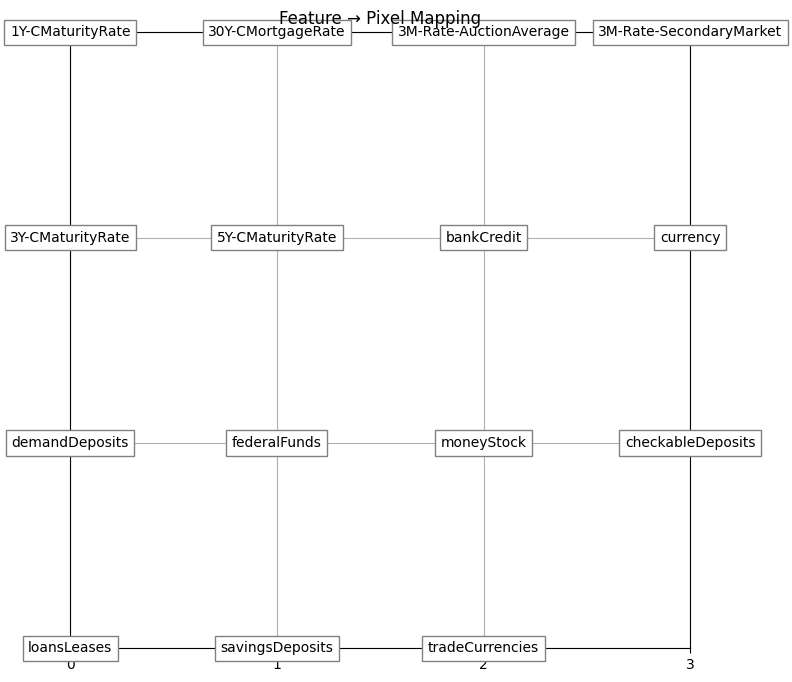

In [35]:
if hasattr(image_model, 'coordinate'):
    coordinates = image_model.coordinate
else:
    coordinates = (np.array([0, 0, 0, 0, 1, 1, 1, 1, 2, 2, 2, 2, 3, 3, 3]),
                 np.array([0, 1, 2, 3, 0, 1, 2, 3, 0, 1, 2, 3, 0, 1, 2]))

plot_feature_mapping(x_col, coordinates, scale=[4, 4])

In [36]:
# Combine dataloaders into tensors.
train_mlp, train_img, train_target = combine_loader(train_loader)
val_mlp, val_img, val_target = combine_loader(val_loader)
test_mlp, test_img, test_target = combine_loader(test_loader)

dataset = {
    "train_input": train_mlp.to(device),
    "train_img": train_img.to(device),
    "train_label": train_target.to(device),
    "val_input": val_mlp.to(device),
    "val_img": val_img.to(device),
    "val_label": val_target.to(device),
    "test_input": test_mlp.to(device),
    "test_img": test_img.to(device),
    "test_label": test_target.to(device),
}

In [37]:
# Print the shapes of the tensors
print("Train data shape:", dataset['train_input'].shape)
print("Train target shape:", dataset['train_label'].shape)
print("Test data shape:", dataset['test_input'].shape)
print("Test target shape:", dataset['test_label'].shape)
print("Validation data shape:", dataset['val_input'].shape)
print("Validation target shape:", dataset['val_label'].shape)

Train data shape: torch.Size([671, 15])
Train target shape: torch.Size([671, 1])
Test data shape: torch.Size([210, 15])
Test target shape: torch.Size([210, 1])
Validation data shape: torch.Size([168, 15])
Validation target shape: torch.Size([168, 1])


In [38]:
completed_coordinate, completed_x_col = complete_coordinate_and_xcol(coordinates, x_col)

# KAN training ✅ Top 2 Configurations

### 1. width=[15, 5, 1], grid=4, lamb=0.0001 | best_epoch=34 | loss=0.19097

checkpoint directory created: ./model
saving model version 0.0


| train_loss: 1.36e-01 | val_loss: 1.80e-01 | reg: 4.75e+01 | : 100%|█| 40/40 [00:09<00:00,  4.14it/

saving model version 0.1
Best epoch: 37 
0.18955093622207642
[('30Y-CMortgageRate', 0.7325168), ('tradeCurrencies', 0.49436545), ('bankCredit', 0.46021512), ('5Y-CMaturityRate', 0.35470903), ('moneyStock', 0.3519421), ('checkableDeposits', 0.31118405), ('savingsDeposits', 0.27279374), ('loansLeases', 0.23648222), ('3Y-CMaturityRate', 0.22925347), ('demandDeposits', 0.21092331), ('federalFunds', 0.20983216), ('3M-Rate-AuctionAverage', 0.18891422), ('1Y-CMaturityRate', 0.17683145), ('3M-Rate-SecondaryMarket', 0.16635098), ('currency', 0.14574489)]


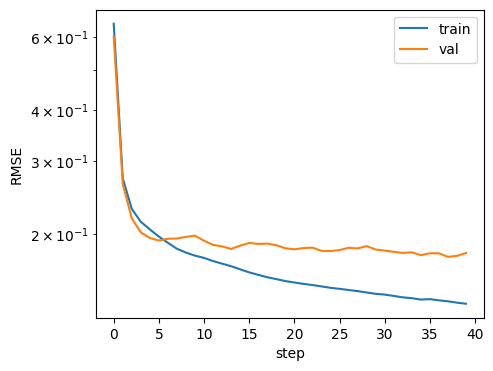

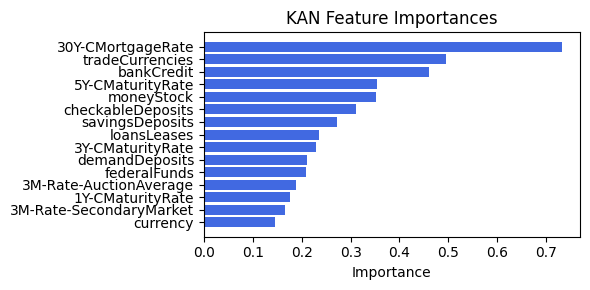

[('30Y-CMortgageRate', 0.7325168),
 ('tradeCurrencies', 0.49436545),
 ('bankCredit', 0.46021512),
 ('5Y-CMaturityRate', 0.35470903),
 ('moneyStock', 0.3519421),
 ('checkableDeposits', 0.31118405),
 ('savingsDeposits', 0.27279374),
 ('loansLeases', 0.23648222),
 ('3Y-CMaturityRate', 0.22925347),
 ('demandDeposits', 0.21092331),
 ('federalFunds', 0.20983216),
 ('3M-Rate-AuctionAverage', 0.18891422),
 ('1Y-CMaturityRate', 0.17683145),
 ('3M-Rate-SecondaryMarket', 0.16635098),
 ('currency', 0.14574489)]

In [35]:
model = KAN(width=[attributes, 5, 1], grid=4, k=3, seed=381, device=device)
best_model_state, results, _  = custom_fit(model, dataset, opt="LBFGS", steps=40, lamb=0.0001)
model.load_state_dict(best_model_state)
rmse = average_rmse(model(dataset['test_input']), dataset['test_label'])
print(rmse)
plot_training_RMSE(results['train_loss'], results['val_loss'])
plot_sorted_feature_importance(x_col, model.feature_score)

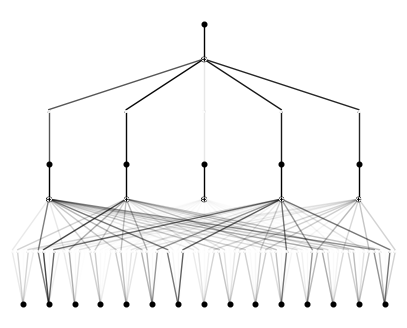

In [36]:
model.plot()

[('30Y-CMortgageRate', 0.7325168), ('tradeCurrencies', 0.49436545), ('bankCredit', 0.46021512), ('5Y-CMaturityRate', 0.35470903), ('moneyStock', 0.3519421), ('checkableDeposits', 0.31118405), ('savingsDeposits', 0.27279374), ('loansLeases', 0.23648222), ('3Y-CMaturityRate', 0.22925347), ('demandDeposits', 0.21092331), ('federalFunds', 0.20983216), ('3M-Rate-AuctionAverage', 0.18891422), ('1Y-CMaturityRate', 0.17683145), ('3M-Rate-SecondaryMarket', 0.16635098), ('currency', 0.14574489)]


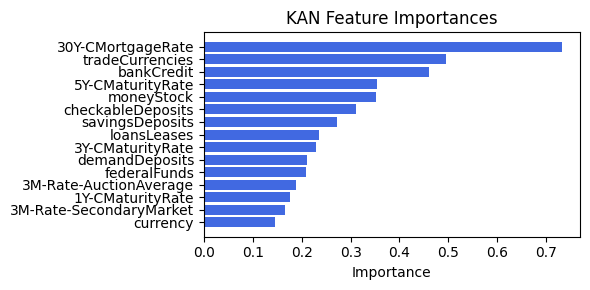

[('30Y-CMortgageRate', 0.7325168),
 ('tradeCurrencies', 0.49436545),
 ('bankCredit', 0.46021512),
 ('5Y-CMaturityRate', 0.35470903),
 ('moneyStock', 0.3519421),
 ('checkableDeposits', 0.31118405),
 ('savingsDeposits', 0.27279374),
 ('loansLeases', 0.23648222),
 ('3Y-CMaturityRate', 0.22925347),
 ('demandDeposits', 0.21092331),
 ('federalFunds', 0.20983216),
 ('3M-Rate-AuctionAverage', 0.18891422),
 ('1Y-CMaturityRate', 0.17683145),
 ('3M-Rate-SecondaryMarket', 0.16635098),
 ('currency', 0.14574489)]

In [37]:
plot_sorted_feature_importance(x_col, model.feature_score)

### 2. width=[15, 6, 1], grid=5, lamb=1e-05 | best_epoch=35 | loss=0.19433

checkpoint directory created: ./model
saving model version 0.0


| train_loss: 1.30e-01 | val_loss: 2.14e-01 | reg: 5.94e+01 | : 100%|█| 40/40 [00:11<00:00,  3.57it/

saving model version 0.1
Best epoch: 35 
0.19433213770389557


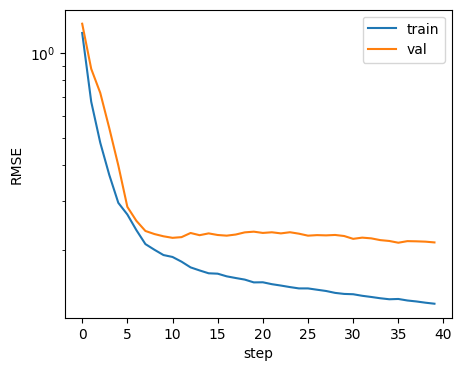

In [39]:
del model
model = KAN(width=[attributes, 6, 1], grid=5, k=3, seed=381, device=device)
best_model_state, results, best_epoch  = custom_fit(model, dataset, opt="LBFGS", steps=40, lamb=1e-5)
model.load_state_dict(best_model_state)
rmse = average_rmse(model(dataset['test_input']), dataset['test_label'])
print(rmse)
plot_training_RMSE(results['train_loss'], results['val_loss'])

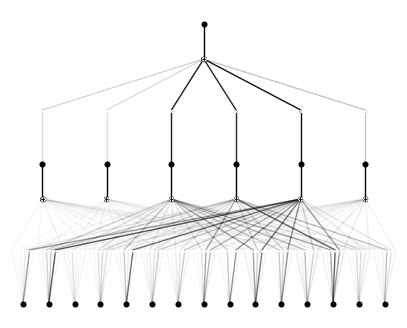

In [60]:
model.plot()

[('loansLeases', 0.5506578), ('federalFunds', 0.4344675), ('30Y-CMortgageRate', 0.4336687), ('3Y-CMaturityRate', 0.34883213), ('moneyStock', 0.31503502), ('currency', 0.29855254), ('demandDeposits', 0.2600871), ('checkableDeposits', 0.24960296), ('1Y-CMaturityRate', 0.21477611), ('tradeCurrencies', 0.18913421), ('5Y-CMaturityRate', 0.18816254), ('bankCredit', 0.18642467), ('3M-Rate-SecondaryMarket', 0.18454753), ('savingsDeposits', 0.17091796), ('3M-Rate-AuctionAverage', 0.112727046)]


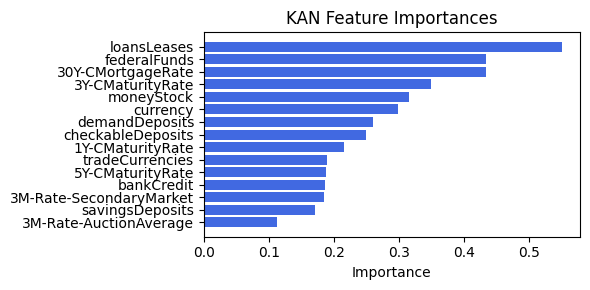

In [61]:
plot_sorted_feature_importance(x_col, model.feature_score)

# Set Files Name

In [39]:
filename_0=f'{dataset_name}_Concat_Op0.csv'
filename_1=f'{dataset_name}_Concat_Op1.csv'
filename_2=f'{dataset_name}_Concat_Op2.csv'
filename_3=f'{dataset_name}_Concat_Op3.csv'
filename_4=f'{dataset_name}_Concat_Op4.csv'

In [40]:
columns_opt0 = '_'
columns_opt1 = 'cnn_bottleneck_dim'
columns_opt2 = 'alpha'
columns_opt3 = 'hidden_dim'
columns_opt4 = 'embed_dim, num_heads'

# Option 0: Concat full best KAN with full best CNN

In [54]:
create_csv_with_header(filename_0, columns_opt0)

### 0.1.1 width=[15, 5, 1], grid=4, lamb=0.0001

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_0


| train_loss: 4.78e-01 | eval_loss: 3.39e-01 | reg: 4.17e+01 |: 100%|█| 40/40 [00:16<00:00,  2.38it/

saving model version 0.1
Best epoch 38
0.592028021812439
M_KAN Relevance: 0.9794920086860657
CNN Relevance: 0.020508041605353355
[('savingsDeposits', 0.6483262), ('checkableDeposits', 0.5875312), ('moneyStock', 0.44278896), ('federalFunds', 0.43569154), ('3Y-CMaturityRate', 0.40557098), ('bankCredit', 0.38372198), ('currency', 0.31176412), ('3M-Rate-AuctionAverage', 0.28164783), ('tradeCurrencies', 0.2591906), ('30Y-CMortgageRate', 0.25152886), ('loansLeases', 0.24466854), ('5Y-CMaturityRate', 0.21349292), ('demandDeposits', 0.21311505), ('3M-Rate-SecondaryMarket', 0.15041625), ('1Y-CMaturityRate', 0.08957114)]


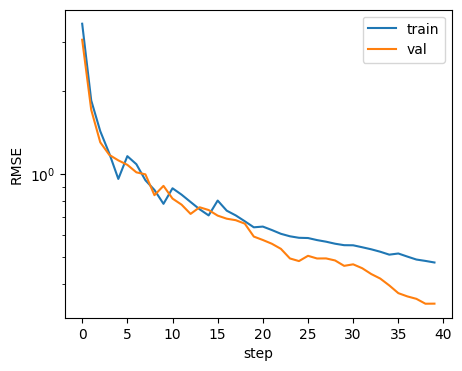

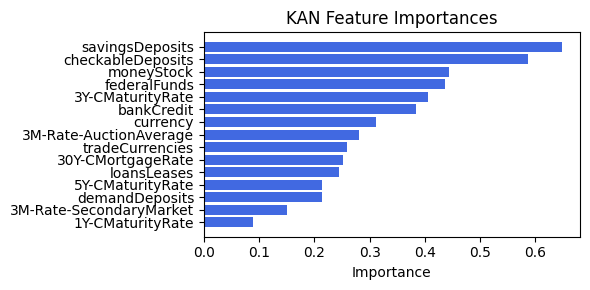

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.53it/s]


[('tradeCurrencies', 0.4921484922302798), ('moneyStock', 0.4127218514946955), ('federalFunds', 0.37089524897968484), ('bankCredit', 0.36287898249768963), ('5Y-CMaturityRate', 0.33423549915238426), ('demandDeposits', 0.33001998773265984), ('savingsDeposits', 0.30780093744694265), ('3Y-CMaturityRate', 0.2995845827584465), ('Ex1', 0.2169128259311297), ('1Y-CMaturityRate', 0.21152992201747284), ('3M-Rate-AuctionAverage', 0.18951303203745434), ('30Y-CMortgageRate', 0.18338648206332608), ('loansLeases', 0.18257195154604103), ('3M-Rate-SecondaryMarket', 0.11377139036998242), ('checkableDeposits', 0.10102824688157333), ('currency', 0.09297388133743967)]


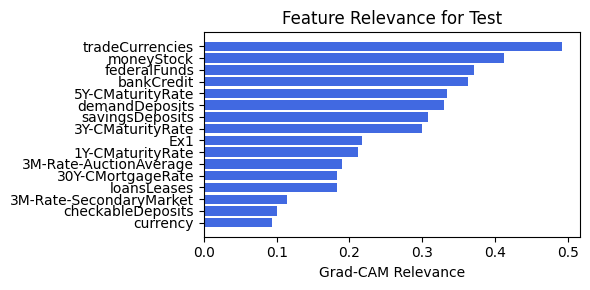

In [58]:
train_and_plot_relevance(Model3_0, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=40, n_kan_len=1, filename=filename_0, opt_col_val='_')

### 0.1.2 width=[15, 5, 1], grid=4, lamb=0.0001 

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_0


| train_loss: 5.29e-01 | eval_loss: 9.38e-01 | reg: 4.34e+01 |: 100%|█| 40/40 [00:15<00:00,  2.51it/

saving model version 0.1
Best epoch 6
1.0188512802124023
M_KAN Relevance: 0.9998999238014221
CNN Relevance: 0.00010010838013840839
[('savingsDeposits', 0.9654883), ('checkableDeposits', 0.78896797), ('tradeCurrencies', 0.78157884), ('federalFunds', 0.615031), ('loansLeases', 0.5816973), ('demandDeposits', 0.5550992), ('3Y-CMaturityRate', 0.5084312), ('1Y-CMaturityRate', 0.486076), ('3M-Rate-AuctionAverage', 0.48605195), ('3M-Rate-SecondaryMarket', 0.44844025), ('moneyStock', 0.38054776), ('bankCredit', 0.3461782), ('currency', 0.32020873), ('30Y-CMortgageRate', 0.31164193), ('5Y-CMaturityRate', 0.2591407)]


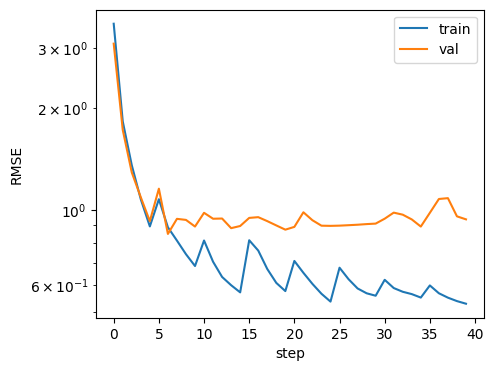

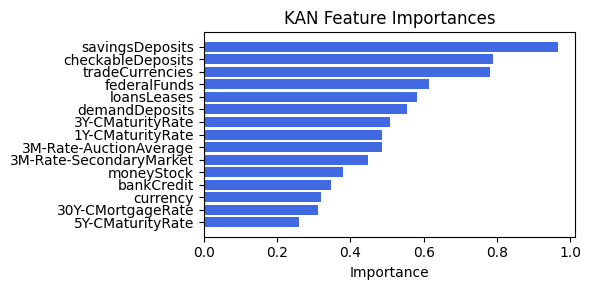

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  8.77it/s]

[('moneyStock', 0.3496030949588333), ('federalFunds', 0.26272322970520084), ('3M-Rate-SecondaryMarket', 0.2492997522837305), ('demandDeposits', 0.2430064960005915), ('savingsDeposits', 0.24231619882984454), ('3M-Rate-AuctionAverage', 0.2353288302685888), ('30Y-CMortgageRate', 0.23106363488893425), ('loansLeases', 0.2305324160725355), ('tradeCurrencies', 0.2157955688806916), ('checkableDeposits', 0.21482541903082858), ('1Y-CMaturityRate', 0.18735830004138518), ('bankCredit', 0.1159035883708081), ('5Y-CMaturityRate', 0.11284808009042449), ('3Y-CMaturityRate', 0.10653000708026368), ('Ex1', 0.09246347881909016), ('currency', 0.03616821055322708)]


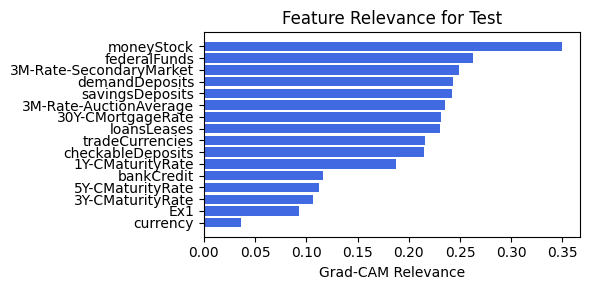

In [59]:
train_and_plot_relevance(Model3_0, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=40, n_kan_len=1, filename=filename_0, opt_col_val='_')

### 0.2.1 width=[15, 6, 1], grid=5, lamb=1e-05

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_0


| train_loss: 1.09e-01 | eval_loss: 1.94e-01 | reg: 2.64e+01 |: 100%|█| 40/40 [00:15<00:00,  2.51it/

saving model version 0.1
Best epoch 19
0.24259307980537415
M_KAN Relevance: 0.06979130953550339
CNN Relevance: 0.9302087426185608
[('checkableDeposits', 0.8011364), ('federalFunds', 0.7249697), ('tradeCurrencies', 0.64756703), ('loansLeases', 0.6205262), ('3Y-CMaturityRate', 0.5098141), ('currency', 0.47039205), ('3M-Rate-SecondaryMarket', 0.4591505), ('moneyStock', 0.45773327), ('savingsDeposits', 0.4322261), ('1Y-CMaturityRate', 0.42479426), ('demandDeposits', 0.38995063), ('30Y-CMortgageRate', 0.37039423), ('5Y-CMaturityRate', 0.3367458), ('bankCredit', 0.2709772), ('3M-Rate-AuctionAverage', 0.23325525)]


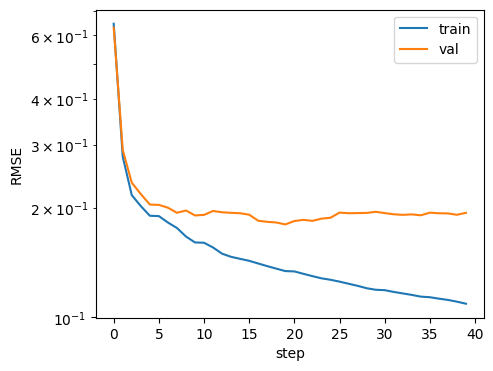

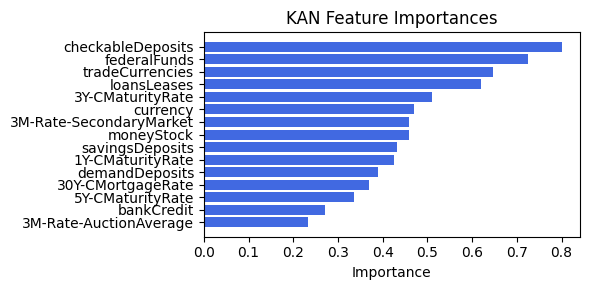

Computing Grad-CAM: 100%|██████████| 210/210 [00:27<00:00,  7.78it/s]

[('loansLeases', 0.13385281646180722), ('Ex1', 0.01953133571715582), ('demandDeposits', 0.010331752470561437), ('checkableDeposits', 0.008986758901959374), ('savingsDeposits', 0.004443954614301523), ('3M-Rate-SecondaryMarket', 0.0028351580834991875), ('tradeCurrencies', 0.001749454882173311), ('1Y-CMaturityRate', 0.0009652851592926752), ('3Y-CMaturityRate', 0.0008845663496426173), ('currency', 0.0006095796856763107), ('5Y-CMaturityRate', 0.0005847313751777013), ('30Y-CMortgageRate', 0.0005497486995799201), ('3M-Rate-AuctionAverage', 9.097049478441477e-05), ('bankCredit', 8.82438894006468e-05), ('federalFunds', 0.0), ('moneyStock', 0.0)]


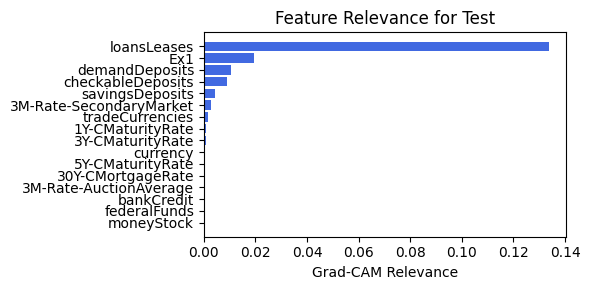

In [60]:
train_and_plot_relevance(Model3_0, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, n_kan_len=1, filename=filename_0, opt_col_val='_')

### 0.2.2 width=[15, 6, 1], grid=5, lamb=1e-05

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_0


| train_loss: 1.11e-01 | eval_loss: 2.35e-01 | reg: 2.63e+01 |: 100%|█| 40/40 [00:19<00:00,  2.02it/


saving model version 0.1
Best epoch 19
0.23960164189338684
M_KAN Relevance: 0.07686016708612442
CNN Relevance: 0.9231398701667786
[('checkableDeposits', 0.90422356), ('loansLeases', 0.72569346), ('tradeCurrencies', 0.7210671), ('federalFunds', 0.71129656), ('currency', 0.4705549), ('3Y-CMaturityRate', 0.4660291), ('moneyStock', 0.45787942), ('5Y-CMaturityRate', 0.4305024), ('3M-Rate-SecondaryMarket', 0.38997608), ('1Y-CMaturityRate', 0.3814934), ('savingsDeposits', 0.36544055), ('demandDeposits', 0.36380664), ('bankCredit', 0.3636844), ('30Y-CMortgageRate', 0.3263158), ('3M-Rate-AuctionAverage', 0.26737446)]


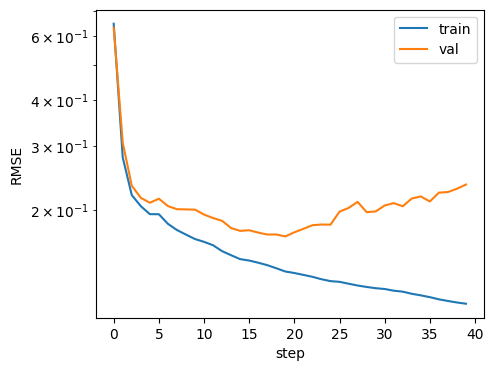

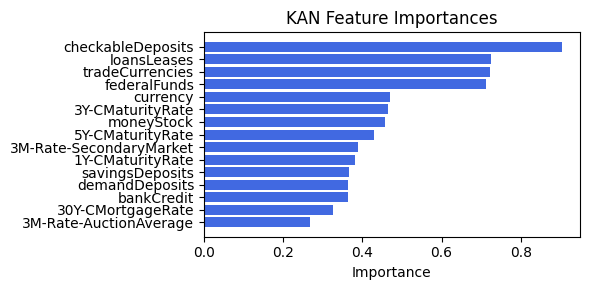

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  7.86it/s]


[('3Y-CMaturityRate', 0.13934900698562463), ('demandDeposits', 0.04935828628284591), ('loansLeases', 0.024206249917291905), ('1Y-CMaturityRate', 0.01703787511990716), ('tradeCurrencies', 0.012713836617435196), ('Ex1', 0.012536724692299252), ('checkableDeposits', 0.008334080094382877), ('3M-Rate-SecondaryMarket', 0.00260253498951594), ('savingsDeposits', 0.0006159882683451066), ('currency', 0.0005823838746263867), ('5Y-CMaturityRate', 0.00039776850136972607), ('30Y-CMortgageRate', 0.0002393387346750214), ('3M-Rate-AuctionAverage', 0.00016090797171706246), ('bankCredit', 7.733521051704884e-05), ('federalFunds', 0.0), ('moneyStock', 0.0)]


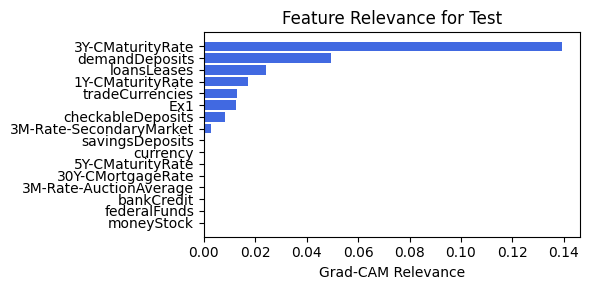

In [61]:
train_and_plot_relevance(Model3_0, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, n_kan_len=1, filename=filename_0, opt_col_val='_')

### 3.1 width=[15, 1, 1], grid=5, lamb=1e-05

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_0


| train_loss: 1.47e-01 | eval_loss: 1.76e-01 | reg: 1.44e+01 |: 100%|█| 40/40 [00:17<00:00,  2.28it/

saving model version 0.1
Best epoch 38
0.2644762098789215
M_KAN Relevance: 0.036843299865722656
CNN Relevance: 0.9631566405296326
[('loansLeases', 0.3836718), ('federalFunds', 0.3383358), ('savingsDeposits', 0.29632908), ('currency', 0.28241795), ('moneyStock', 0.21262638), ('5Y-CMaturityRate', 0.20709723), ('3M-Rate-SecondaryMarket', 0.19275199), ('1Y-CMaturityRate', 0.16977385), ('tradeCurrencies', 0.15554282), ('30Y-CMortgageRate', 0.13586244), ('demandDeposits', 0.093096435), ('bankCredit', 0.074559756), ('checkableDeposits', 0.0677985), ('3Y-CMaturityRate', 0.048773017), ('3M-Rate-AuctionAverage', 0.0473571)]


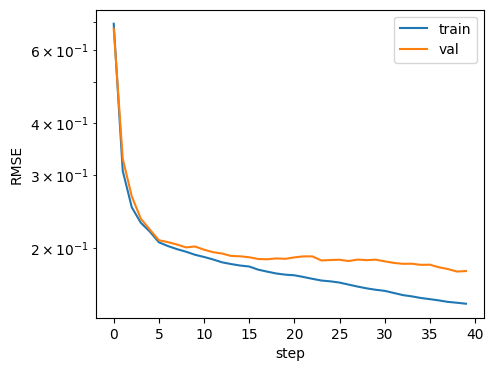

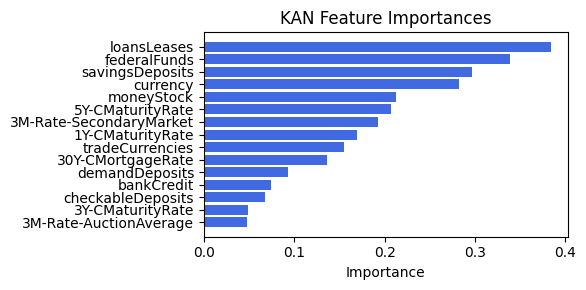

Computing Grad-CAM: 100%|██████████| 210/210 [00:17<00:00, 12.07it/s]


[('3Y-CMaturityRate', 0.2067977196403912), ('tradeCurrencies', 0.11504807648293319), ('demandDeposits', 0.09524362913909412), ('loansLeases', 0.08487557206480276), ('savingsDeposits', 0.024956748682251645), ('1Y-CMaturityRate', 0.02200907687822889), ('moneyStock', 0.0075186551238099735), ('Ex1', 0.006116611616952079), ('3M-Rate-SecondaryMarket', 0.0015486148496468863), ('currency', 0.0007477082223409698), ('3M-Rate-AuctionAverage', 0.00045020519977524167), ('bankCredit', 5.67146066931032e-06), ('30Y-CMortgageRate', 0.0), ('5Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('checkableDeposits', 0.0)]


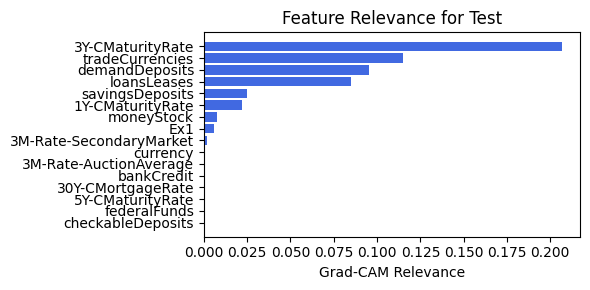

In [62]:
train_and_plot_relevance(Model3_0, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, n_kan_len=1, filename=filename_0, opt_col_val='_')

### 3.2 width=[15, 1, 1], grid=5, lamb=1e-05

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_0


| train_loss: 1.41e-01 | eval_loss: 1.98e-01 | reg: 1.43e+01 |: 100%|█| 40/40 [00:16<00:00,  2.42it/

saving model version 0.1
Best epoch 28
0.4296741783618927
M_KAN Relevance: 0.07485564798116684
CNN Relevance: 0.925144374370575
[('federalFunds', 0.47457007), ('loansLeases', 0.36031616), ('savingsDeposits', 0.23704988), ('currency', 0.2188062), ('moneyStock', 0.18937315), ('bankCredit', 0.14082533), ('demandDeposits', 0.14057016), ('3M-Rate-AuctionAverage', 0.09985252), ('checkableDeposits', 0.095333755), ('1Y-CMaturityRate', 0.07695854), ('5Y-CMaturityRate', 0.075011715), ('tradeCurrencies', 0.068575785), ('3M-Rate-SecondaryMarket', 0.042656135), ('3Y-CMaturityRate', 0.04017604), ('30Y-CMortgageRate', 0.012733484)]


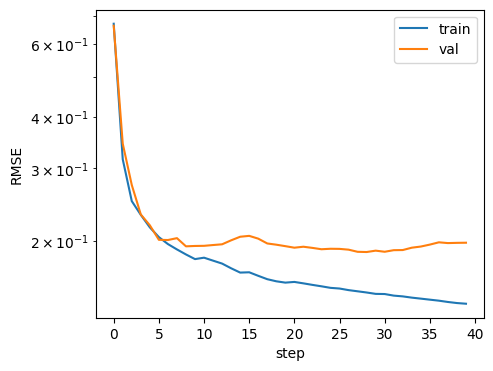

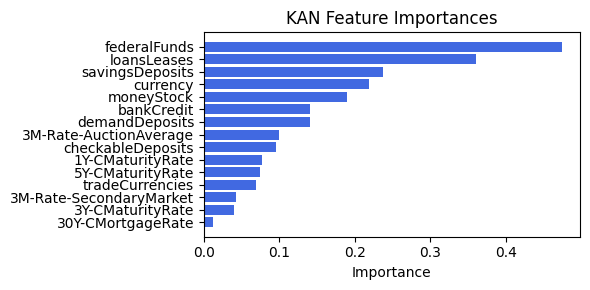

Computing Grad-CAM: 100%|██████████| 210/210 [00:17<00:00, 11.85it/s]


[('3Y-CMaturityRate', 0.13297246102066268), ('demandDeposits', 0.048090236452186394), ('Ex1', 0.027559808960982733), ('tradeCurrencies', 0.009836921175675733), ('1Y-CMaturityRate', 0.00871385998048243), ('3M-Rate-SecondaryMarket', 0.007418142099465642), ('checkableDeposits', 0.00519622266292572), ('currency', 0.00359814331112873), ('loansLeases', 0.0018200249836635997), ('3M-Rate-AuctionAverage', 0.0007838447838799939), ('30Y-CMortgageRate', 0.0007297143517505555), ('5Y-CMaturityRate', 0.00033319385810976935), ('bankCredit', 0.00023468976751679467), ('federalFunds', 0.0), ('moneyStock', 0.0), ('savingsDeposits', 0.0)]


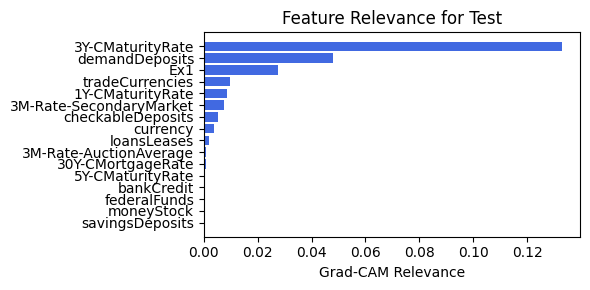

In [63]:
train_and_plot_relevance(Model3_0, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, n_kan_len=1, filename=filename_0, opt_col_val='_')

### 4.1 width=[15, 6, 1], grid=7, lamb=1e-05

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_0


| train_loss: 1.32e-01 | eval_loss: 1.70e-01 | reg: 6.53e+01 |: 100%|█| 40/40 [00:16<00:00,  2.38it/

saving model version 0.1
Best epoch 32
0.2238791137933731
M_KAN Relevance: 0.9460374116897583
CNN Relevance: 0.05396251007914543
[('moneyStock', 0.3756139), ('tradeCurrencies', 0.2971996), ('3Y-CMaturityRate', 0.2660677), ('30Y-CMortgageRate', 0.26405776), ('federalFunds', 0.25241005), ('3M-Rate-SecondaryMarket', 0.22864252), ('loansLeases', 0.22740938), ('3M-Rate-AuctionAverage', 0.18227932), ('checkableDeposits', 0.17033921), ('5Y-CMaturityRate', 0.16410679), ('bankCredit', 0.109432906), ('savingsDeposits', 0.09668965), ('1Y-CMaturityRate', 0.09140239), ('currency', 0.07608174), ('demandDeposits', 0.049731158)]


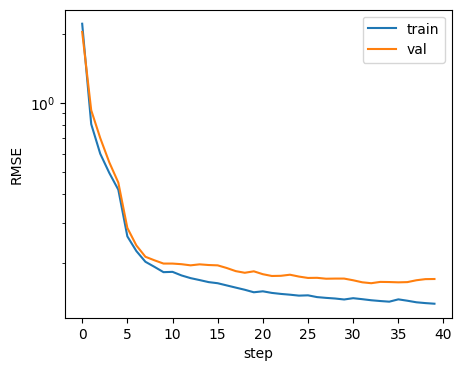

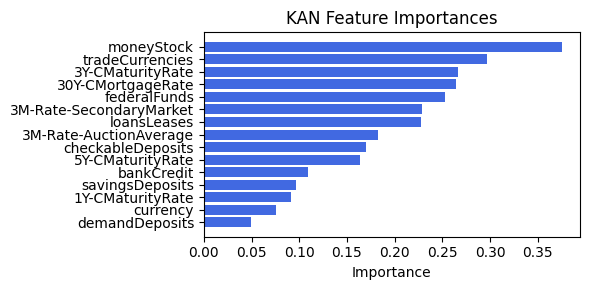

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  7.90it/s]


[('tradeCurrencies', 0.4124232008343651), ('3Y-CMaturityRate', 0.39184765274071004), ('5Y-CMaturityRate', 0.3759747150343), ('bankCredit', 0.3735547928006521), ('checkableDeposits', 0.2657902585773501), ('3M-Rate-SecondaryMarket', 0.2275239986403557), ('3M-Rate-AuctionAverage', 0.22202359912030045), ('currency', 0.2139180625087604), ('federalFunds', 0.20497002728405364), ('30Y-CMortgageRate', 0.20249672878001418), ('1Y-CMaturityRate', 0.18734134694566906), ('demandDeposits', 0.1795667480854761), ('moneyStock', 0.1786948448302047), ('savingsDeposits', 0.17622490802230978), ('loansLeases', 0.13806193258039587), ('Ex1', 0.06164501334451849)]


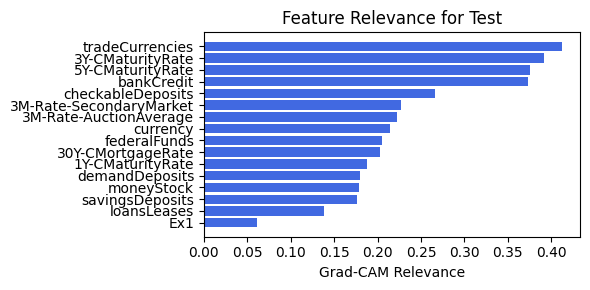

In [64]:
train_and_plot_relevance(Model3_0, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, n_kan_len=1, filename=filename_0, opt_col_val='_')

### 4.2 width=[15, 6, 1], grid=7, lamb=1e-05

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_0


| train_loss: 1.32e-01 | eval_loss: 1.70e-01 | reg: 6.53e+01 |: 100%|█| 40/40 [00:16<00:00,  2.45it/

saving model version 0.1
Best epoch 32
0.2238791137933731
M_KAN Relevance: 0.9460374116897583
CNN Relevance: 0.05396251007914543
[('moneyStock', 0.3756139), ('tradeCurrencies', 0.2971996), ('3Y-CMaturityRate', 0.2660677), ('30Y-CMortgageRate', 0.26405776), ('federalFunds', 0.25241005), ('3M-Rate-SecondaryMarket', 0.22864252), ('loansLeases', 0.22740938), ('3M-Rate-AuctionAverage', 0.18227932), ('checkableDeposits', 0.17033921), ('5Y-CMaturityRate', 0.16410679), ('bankCredit', 0.109432906), ('savingsDeposits', 0.09668965), ('1Y-CMaturityRate', 0.09140239), ('currency', 0.07608174), ('demandDeposits', 0.049731158)]


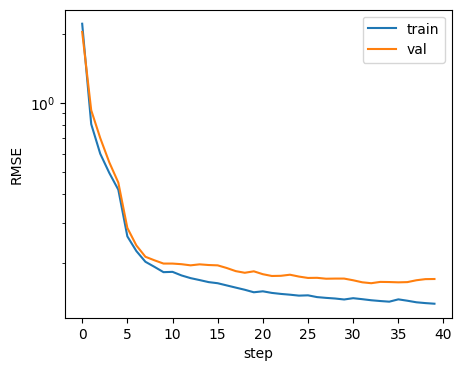

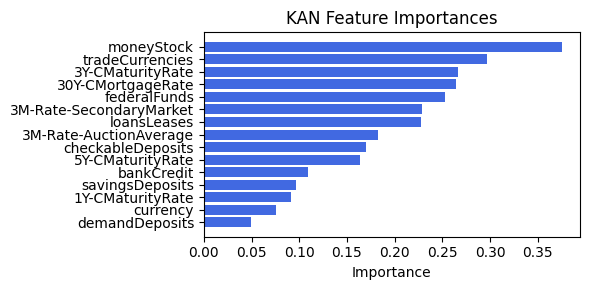

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  7.95it/s]


[('tradeCurrencies', 0.4124232008343651), ('3Y-CMaturityRate', 0.39184765274071004), ('5Y-CMaturityRate', 0.3759747150343), ('bankCredit', 0.3735547928006521), ('checkableDeposits', 0.2657902585773501), ('3M-Rate-SecondaryMarket', 0.2275239986403557), ('3M-Rate-AuctionAverage', 0.22202359912030045), ('currency', 0.2139180625087604), ('federalFunds', 0.20497002728405364), ('30Y-CMortgageRate', 0.20249672878001418), ('1Y-CMaturityRate', 0.18734134694566906), ('demandDeposits', 0.1795667480854761), ('moneyStock', 0.1786948448302047), ('savingsDeposits', 0.17622490802230978), ('loansLeases', 0.13806193258039587), ('Ex1', 0.06164501334451849)]


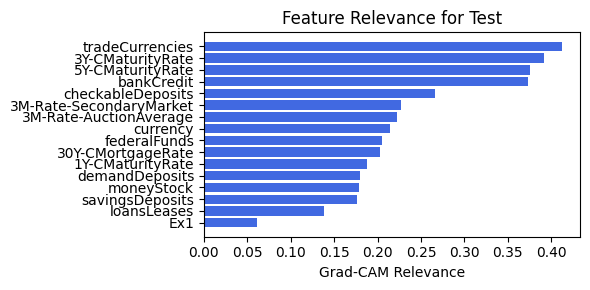

In [65]:
train_and_plot_relevance(Model3_0, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, n_kan_len=1, filename=filename_0, opt_col_val='_')

# Option 1: Concat KAN with (CNN with dense layer to reduce output_size)

In [67]:
create_csv_with_header(filename_1, columns_opt1)

## 1.0 width=[15, 5, 1], grid=4, lamb=0.0001

### 1.0.0 width=[15, 5, 1], grid=4, lamb=0.0001 | cnn_bottleneck_dim=1

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.61e-01 | eval_loss: 1.90e-01 | reg: 1.74e+01 |: 100%|█| 40/40 [00:11<00:00,  3.49it/

saving model version 0.1
Best epoch 37
0.2483818382024765
M_KAN Relevance: 0.0727979838848114
CNN Relevance: 0.927202045917511
[('30Y-CMortgageRate', 0.23318951), ('checkableDeposits', 0.20175385), ('5Y-CMaturityRate', 0.18737641), ('loansLeases', 0.17367515), ('currency', 0.16486405), ('moneyStock', 0.16305463), ('bankCredit', 0.15588689), ('3M-Rate-AuctionAverage', 0.15294881), ('tradeCurrencies', 0.14545672), ('savingsDeposits', 0.11401322), ('1Y-CMaturityRate', 0.09339694), ('demandDeposits', 0.09255487), ('3M-Rate-SecondaryMarket', 0.09216202), ('federalFunds', 0.069230124), ('3Y-CMaturityRate', 0.044431467)]


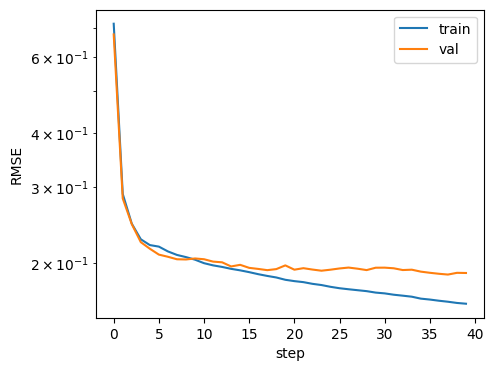

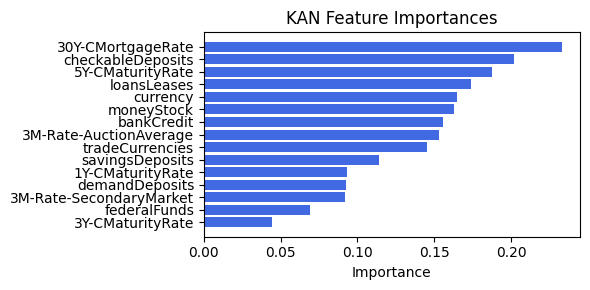

Computing Grad-CAM: 100%|██████████| 210/210 [00:21<00:00,  9.64it/s]

[('Ex1', 0.21804305424753), ('tradeCurrencies', 0.09616924377263612), ('savingsDeposits', 0.05899563727559455), ('loansLeases', 0.05596907907830817), ('demandDeposits', 0.032744932031865966), ('federalFunds', 0.029450592380904014), ('moneyStock', 0.02392897500041207), ('3Y-CMaturityRate', 0.014386625208758882), ('3M-Rate-SecondaryMarket', 0.006758261707034849), ('currency', 0.0017342993945238137), ('checkableDeposits', 0.0015196767014761766), ('5Y-CMaturityRate', 0.0003755169610182444), ('3M-Rate-AuctionAverage', 7.633416070824577e-05), ('bankCredit', 7.883405002454917e-06), ('1Y-CMaturityRate', 5.074208491437492e-06), ('30Y-CMortgageRate', 0.0)]


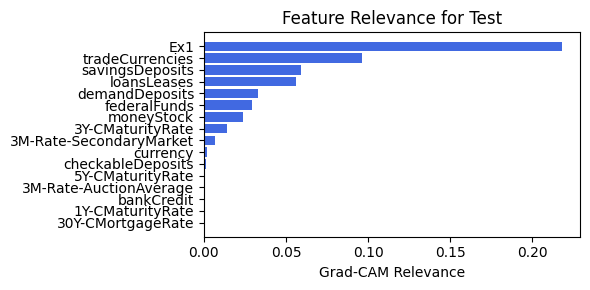

In [68]:
train_and_plot_relevance(Model3_1, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=1, lamb=0.0001, steps=40, filename=filename_1, opt_col_val=1)

### 1.0.1 width=[15, 5, 1], grid=4, lamb=0.0001 | cnn_bottleneck_dim=1

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.61e-01 | eval_loss: 1.90e-01 | reg: 1.74e+01 |: 100%|█| 40/40 [00:12<00:00,  3.27it/

saving model version 0.1
Best epoch 37
0.2483818382024765
M_KAN Relevance: 0.0727979838848114
CNN Relevance: 0.927202045917511
[('30Y-CMortgageRate', 0.23318951), ('checkableDeposits', 0.20175385), ('5Y-CMaturityRate', 0.18737641), ('loansLeases', 0.17367515), ('currency', 0.16486405), ('moneyStock', 0.16305463), ('bankCredit', 0.15588689), ('3M-Rate-AuctionAverage', 0.15294881), ('tradeCurrencies', 0.14545672), ('savingsDeposits', 0.11401322), ('1Y-CMaturityRate', 0.09339694), ('demandDeposits', 0.09255487), ('3M-Rate-SecondaryMarket', 0.09216202), ('federalFunds', 0.069230124), ('3Y-CMaturityRate', 0.044431467)]


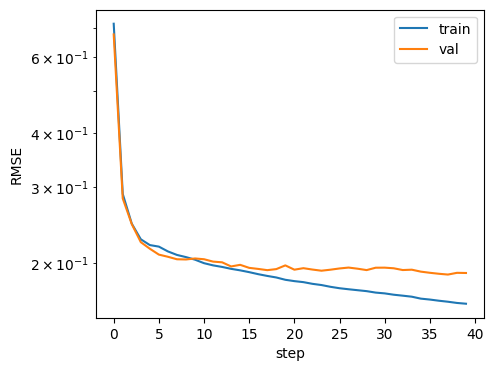

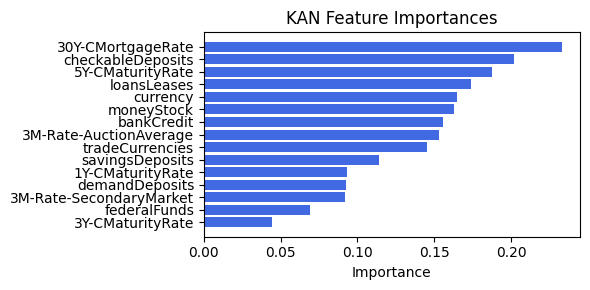

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  9.09it/s]

[('Ex1', 0.21804305403465626), ('tradeCurrencies', 0.09616924377263612), ('savingsDeposits', 0.058995637204636645), ('loansLeases', 0.05596907893639235), ('demandDeposits', 0.03274493197864753), ('federalFunds', 0.029450592380904014), ('moneyStock', 0.02392897498267259), ('3Y-CMaturityRate', 0.01438662506684306), ('3M-Rate-SecondaryMarket', 0.006758261707034849), ('currency', 0.0017342993945238137), ('checkableDeposits', 0.0015196767014761766), ('5Y-CMaturityRate', 0.0003755169255392892), ('3M-Rate-AuctionAverage', 7.633416070824577e-05), ('bankCredit', 7.883405002454917e-06), ('1Y-CMaturityRate', 5.074208491437492e-06), ('30Y-CMortgageRate', 0.0)]


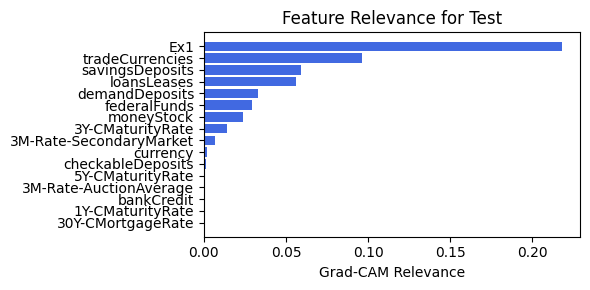

In [69]:
train_and_plot_relevance(Model3_1, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=1, lamb=0.0001, steps=40, filename=filename_1, opt_col_val=1)

### 1.0.2 width=[15, 5, 1], grid=4, lamb=0.0001 | cnn_bottleneck_dim=2

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.34e-01 | eval_loss: 1.76e-01 | reg: 3.78e+01 |: 100%|█| 40/40 [00:56<00:00,  1.42s/i

saving model version 0.1
Best epoch 16
0.19998478889465332
M_KAN Relevance: 0.9576696753501892
CNN Relevance: 0.04233032092452049
[('bankCredit', 0.30911773), ('moneyStock', 0.30769014), ('tradeCurrencies', 0.30004522), ('30Y-CMortgageRate', 0.2640234), ('3Y-CMaturityRate', 0.23152104), ('federalFunds', 0.22564788), ('3M-Rate-SecondaryMarket', 0.22411804), ('loansLeases', 0.2089533), ('3M-Rate-AuctionAverage', 0.20616002), ('5Y-CMaturityRate', 0.1918429), ('checkableDeposits', 0.18769296), ('savingsDeposits', 0.18507653), ('1Y-CMaturityRate', 0.15309322), ('demandDeposits', 0.07982949), ('currency', 0.07764025)]


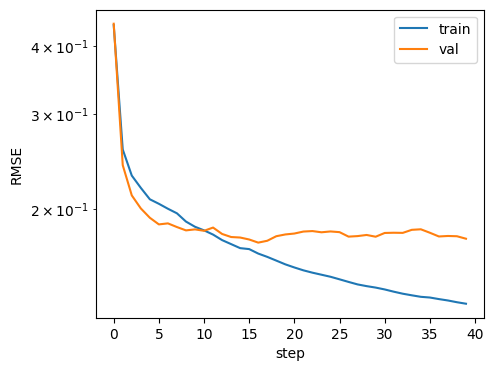

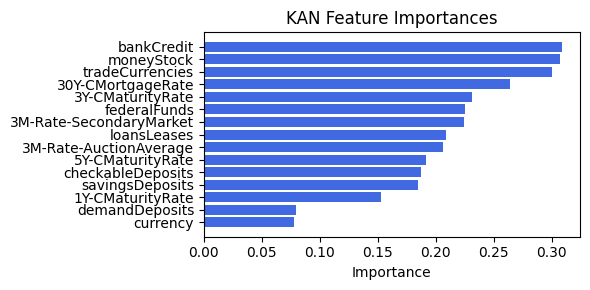

Computing Grad-CAM: 100%|██████████| 210/210 [01:41<00:00,  2.08it/s]


[('3M-Rate-AuctionAverage', 0.30248618690030915), ('30Y-CMortgageRate', 0.29563495133271706), ('3M-Rate-SecondaryMarket', 0.2904523778681843), ('checkableDeposits', 0.2594346388681082), ('tradeCurrencies', 0.2568733573625477), ('1Y-CMaturityRate', 0.23736464389311593), ('currency', 0.2301034151879278), ('moneyStock', 0.19562005619740203), ('bankCredit', 0.14782372624225293), ('5Y-CMaturityRate', 0.14000385150526806), ('federalFunds', 0.13344478403672666), ('savingsDeposits', 0.12559273065749688), ('3Y-CMaturityRate', 0.11566471755837224), ('demandDeposits', 0.10347288471592557), ('Ex1', 0.10291587585594417), ('loansLeases', 0.09897068012453798)]


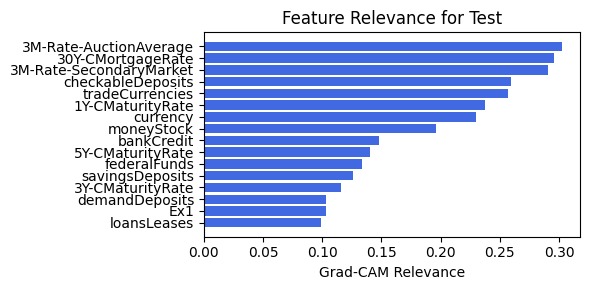

In [46]:
train_and_plot_relevance(Model3_1, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=2, lamb=0.0001, steps=40, filename=filename_1, opt_col_val=2)

### 1.0.2 width=[15, 5, 1], grid=4, lamb=0.0001 | cnn_bottleneck_dim=2

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.39e-01 | eval_loss: 1.83e-01 | reg: 3.60e+01 |: 100%|█| 40/40 [00:11<00:00,  3.45it/

saving model version 0.1
Best epoch 13
0.19197335839271545
M_KAN Relevance: 0.9535290002822876
CNN Relevance: 0.046471007168293
[('moneyStock', 0.325338), ('tradeCurrencies', 0.28635), ('bankCredit', 0.28535205), ('3M-Rate-SecondaryMarket', 0.24096775), ('30Y-CMortgageRate', 0.2282366), ('3Y-CMaturityRate', 0.2188438), ('3M-Rate-AuctionAverage', 0.20875116), ('checkableDeposits', 0.20711076), ('5Y-CMaturityRate', 0.18881933), ('loansLeases', 0.18575041), ('savingsDeposits', 0.17854935), ('federalFunds', 0.17056037), ('1Y-CMaturityRate', 0.11531639), ('demandDeposits', 0.09312462), ('currency', 0.08118655)]


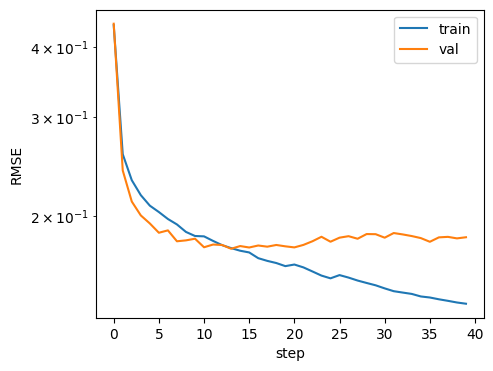

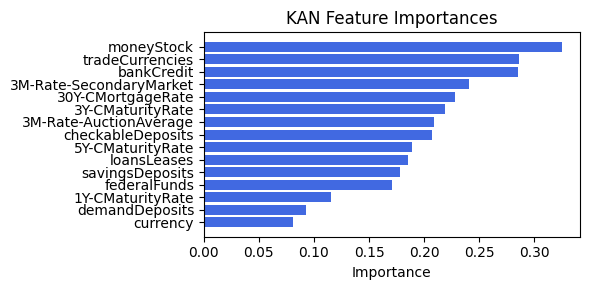

Computing Grad-CAM: 100%|██████████| 210/210 [00:22<00:00,  9.38it/s]

[('tradeCurrencies', 0.38191472806446697), ('moneyStock', 0.2990215364843607), ('federalFunds', 0.2501141119931292), ('bankCredit', 0.24262563046261978), ('5Y-CMaturityRate', 0.2320464852703957), ('checkableDeposits', 0.19968105110483952), ('3M-Rate-AuctionAverage', 0.18226280556769953), ('30Y-CMortgageRate', 0.17472262470030164), ('currency', 0.1741428543325691), ('savingsDeposits', 0.15848180433022208), ('3Y-CMaturityRate', 0.1550782420976854), ('demandDeposits', 0.15280195415238962), ('Ex1', 0.14194901455858988), ('1Y-CMaturityRate', 0.12513420982785256), ('3M-Rate-SecondaryMarket', 0.12414735415839545), ('loansLeases', 0.11700182346893208)]


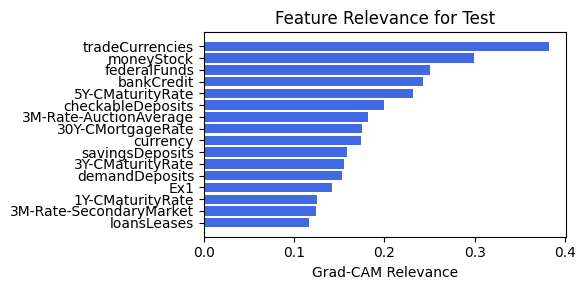

In [70]:
train_and_plot_relevance(Model3_1, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=2, lamb=0.0001, steps=40, filename=filename_1, opt_col_val=2)

### 1.0.3 width=[15, 5, 1], grid=4, lamb=0.0001 | cnn_bottleneck_dim=2

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.39e-01 | eval_loss: 1.83e-01 | reg: 3.60e+01 |: 100%|█| 40/40 [00:11<00:00,  3.48it/

saving model version 0.1
Best epoch 13
0.19197335839271545
M_KAN Relevance: 0.9535290002822876
CNN Relevance: 0.046471007168293
[('moneyStock', 0.325338), ('tradeCurrencies', 0.28635), ('bankCredit', 0.28535205), ('3M-Rate-SecondaryMarket', 0.24096775), ('30Y-CMortgageRate', 0.2282366), ('3Y-CMaturityRate', 0.2188438), ('3M-Rate-AuctionAverage', 0.20875116), ('checkableDeposits', 0.20711076), ('5Y-CMaturityRate', 0.18881933), ('loansLeases', 0.18575041), ('savingsDeposits', 0.17854935), ('federalFunds', 0.17056037), ('1Y-CMaturityRate', 0.11531639), ('demandDeposits', 0.09312462), ('currency', 0.08118655)]


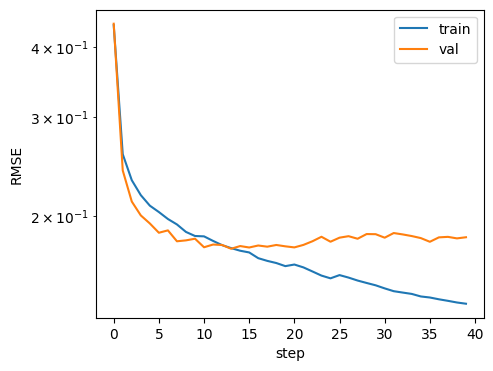

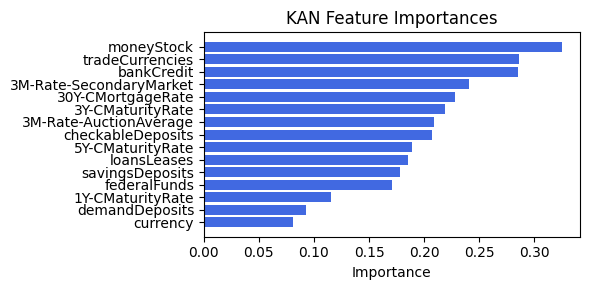

Computing Grad-CAM: 100%|██████████| 210/210 [00:22<00:00,  9.38it/s]

[('tradeCurrencies', 0.3819147281354249), ('moneyStock', 0.29902153620052907), ('federalFunds', 0.2501141117092976), ('bankCredit', 0.24262563032070397), ('5Y-CMaturityRate', 0.2320464851284799), ('checkableDeposits', 0.1996810506790921), ('3M-Rate-AuctionAverage', 0.18226280553222057), ('30Y-CMortgageRate', 0.17472262470030164), ('currency', 0.17414285419065328), ('savingsDeposits', 0.15848180435239642), ('3Y-CMaturityRate', 0.15507824220412225), ('demandDeposits', 0.15280195415238962), ('Ex1', 0.14194901457632936), ('1Y-CMaturityRate', 0.12513421005846578), ('3M-Rate-SecondaryMarket', 0.12414735394552173), ('loansLeases', 0.11700182335362548)]


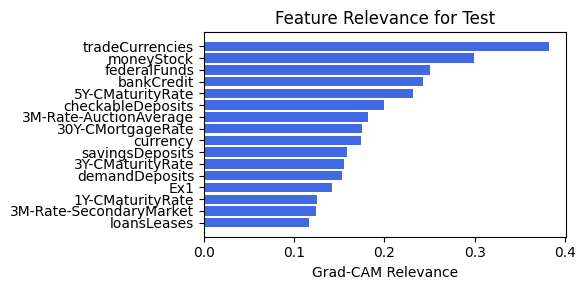

In [71]:
train_and_plot_relevance(Model3_1, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=2, lamb=0.0001, steps=40, filename=filename_1, opt_col_val=2)

### 1.0.1 width=[15, 5, 1], grid=4, lamb=0.0001 | cnn_bottleneck_dim=3

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.62e-01 | eval_loss: 1.97e-01 | reg: 2.33e+01 |: 100%|█| 40/40 [00:13<00:00,  3.07it/

saving model version 0.1
Best epoch 21
0.22918769717216492
M_KAN Relevance: 0.12847021222114563
CNN Relevance: 0.871529757976532
[('checkableDeposits', 0.26927742), ('tradeCurrencies', 0.2583478), ('savingsDeposits', 0.19503178), ('loansLeases', 0.19427033), ('federalFunds', 0.16685936), ('30Y-CMortgageRate', 0.1483234), ('1Y-CMaturityRate', 0.14546339), ('5Y-CMaturityRate', 0.12635301), ('3M-Rate-SecondaryMarket', 0.10718637), ('bankCredit', 0.10674471), ('3Y-CMaturityRate', 0.10127095), ('3M-Rate-AuctionAverage', 0.09726222), ('currency', 0.09700211), ('moneyStock', 0.091693476), ('demandDeposits', 0.076800406)]


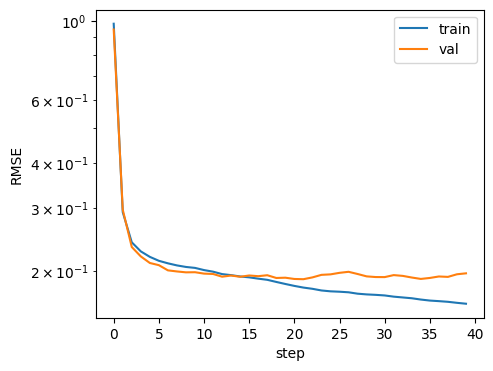

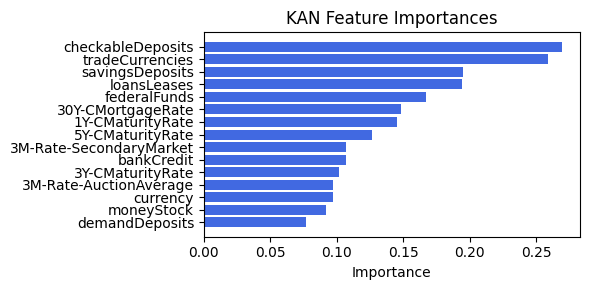

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  8.80it/s]


[('3Y-CMaturityRate', 0.21571335405266534), ('loansLeases', 0.21055281175123083), ('demandDeposits', 0.06413441200552153), ('tradeCurrencies', 0.050658421991171224), ('1Y-CMaturityRate', 0.022457634348012064), ('savingsDeposits', 0.006423048141767226), ('3M-Rate-SecondaryMarket', 0.0007949925604320708), ('federalFunds', 0.00022886672231834382), ('3M-Rate-AuctionAverage', 0.0002201591984928763), ('bankCredit', 0.00011252936507974351), ('30Y-CMortgageRate', 9.002634989363807e-05), ('5Y-CMaturityRate', 0.0), ('currency', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


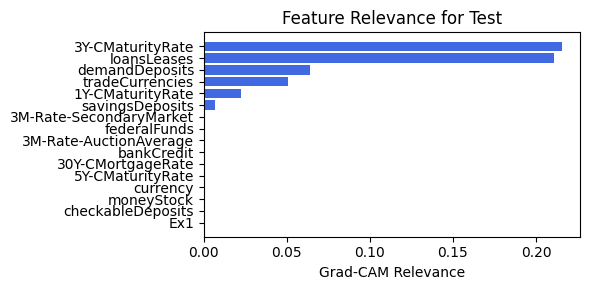

In [72]:
train_and_plot_relevance(Model3_1, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=3, lamb=0.0001, steps=40, filename=filename_1, opt_col_val=3)

### 1.0.2 width=[15, 5, 1], grid=4, lamb=0.0001 | cnn_bottleneck_dim=3

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.64e-01 | eval_loss: 1.84e-01 | reg: 2.24e+01 |: 100%|█| 40/40 [00:12<00:00,  3.26it/

saving model version 0.1
Best epoch 23
0.23944582045078278
M_KAN Relevance: 0.08156201988458633
CNN Relevance: 0.9184380173683167
[('tradeCurrencies', 0.27695465), ('checkableDeposits', 0.267434), ('savingsDeposits', 0.259975), ('federalFunds', 0.25937936), ('loansLeases', 0.23218083), ('30Y-CMortgageRate', 0.16913384), ('moneyStock', 0.1531141), ('3M-Rate-AuctionAverage', 0.14054428), ('5Y-CMaturityRate', 0.13551347), ('1Y-CMaturityRate', 0.12006139), ('3Y-CMaturityRate', 0.116752364), ('currency', 0.11558755), ('3M-Rate-SecondaryMarket', 0.1014449), ('bankCredit', 0.09792863), ('demandDeposits', 0.04754977)]


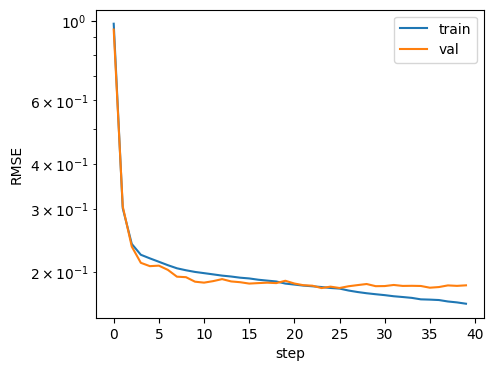

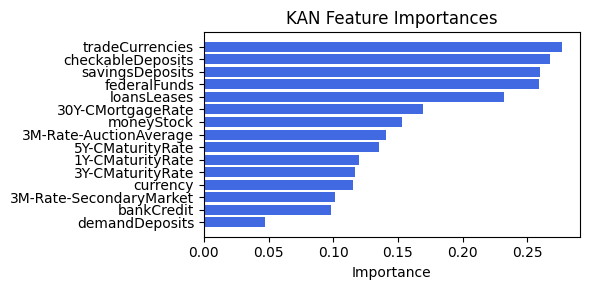

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  9.05it/s]


[('tradeCurrencies', 0.09991265426478571), ('savingsDeposits', 0.014220763566637679), ('moneyStock', 0.00783298136278366), ('Ex1', 0.003383031084446148), ('loansLeases', 0.003346530080619102), ('demandDeposits', 0.001506274125893556), ('1Y-CMaturityRate', 8.865158472742353e-05), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3M-Rate-SecondaryMarket', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('federalFunds', 0.0), ('checkableDeposits', 0.0)]


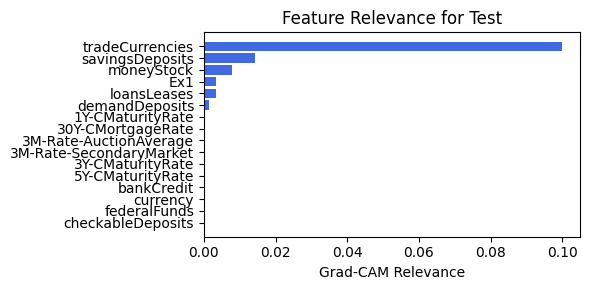

In [73]:
train_and_plot_relevance(Model3_1, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=3, lamb=0.0001, steps=40, filename=filename_1, opt_col_val=3)

### 1.0.3 width=[15, 5, 1], grid=4, lamb=0.0001 | cnn_bottleneck_dim=5

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.51e-01 | eval_loss: 1.87e-01 | reg: 2.04e+01 |: 100%|█| 40/40 [00:12<00:00,  3.29it/

saving model version 0.1
Best epoch 37
0.23693378269672394
M_KAN Relevance: 0.11384087800979614
CNN Relevance: 0.8861590623855591
[('federalFunds', 0.3627607), ('tradeCurrencies', 0.2985398), ('30Y-CMortgageRate', 0.28606656), ('3M-Rate-AuctionAverage', 0.2533923), ('demandDeposits', 0.24566145), ('5Y-CMaturityRate', 0.24126835), ('currency', 0.21098883), ('1Y-CMaturityRate', 0.20162204), ('loansLeases', 0.1905659), ('savingsDeposits', 0.17666455), ('3M-Rate-SecondaryMarket', 0.17026624), ('3Y-CMaturityRate', 0.15722306), ('moneyStock', 0.15300772), ('checkableDeposits', 0.15217306), ('bankCredit', 0.11890079)]


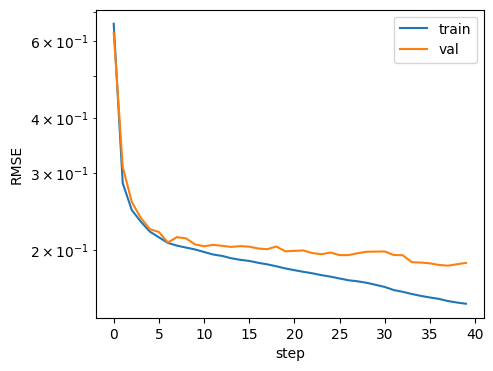

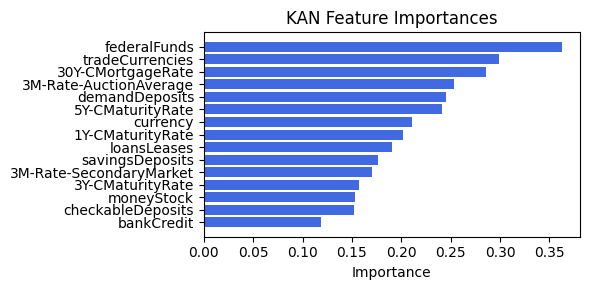

Computing Grad-CAM: 100%|██████████| 210/210 [00:22<00:00,  9.43it/s]

[('tradeCurrencies', 0.19806067612288253), ('3Y-CMaturityRate', 0.10243222476204945), ('5Y-CMaturityRate', 0.04914660725889484), ('savingsDeposits', 0.04834819582692511), ('loansLeases', 0.040121860822477), ('bankCredit', 0.03509595931751565), ('federalFunds', 0.02918877619363013), ('demandDeposits', 0.02525242939092485), ('Ex1', 0.020503778557828072), ('1Y-CMaturityRate', 0.007181404067558192), ('3M-Rate-SecondaryMarket', 0.0035332807123527993), ('3M-Rate-AuctionAverage', 0.00034214829405148826), ('30Y-CMortgageRate', 0.0002462705713696778), ('currency', 1.4268001541495323e-05), ('moneyStock', 0.0), ('checkableDeposits', 0.0)]


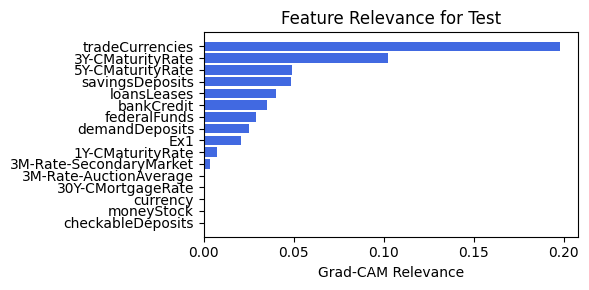

In [74]:
train_and_plot_relevance(Model3_1, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=5, lamb=0.0001, steps=40, filename=filename_1, opt_col_val=5)

### 1.0.4 width=[15, 5, 1], grid=4, lamb=0.0001 | cnn_bottleneck_dim=5

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.53e-01 | eval_loss: 2.02e-01 | reg: 2.13e+01 |: 100%|█| 40/40 [00:11<00:00,  3.44it/

saving model version 0.1
Best epoch 21
0.258075475692749
M_KAN Relevance: 0.14222964644432068
CNN Relevance: 0.8577703833580017
[('tradeCurrencies', 0.3153368), ('5Y-CMaturityRate', 0.274813), ('federalFunds', 0.25786525), ('30Y-CMortgageRate', 0.24395409), ('demandDeposits', 0.23833974), ('savingsDeposits', 0.20483907), ('currency', 0.19027565), ('3M-Rate-SecondaryMarket', 0.18893877), ('1Y-CMaturityRate', 0.18042491), ('moneyStock', 0.1788082), ('3Y-CMaturityRate', 0.16729109), ('checkableDeposits', 0.16394499), ('3M-Rate-AuctionAverage', 0.15874064), ('bankCredit', 0.14037274), ('loansLeases', 0.13292761)]


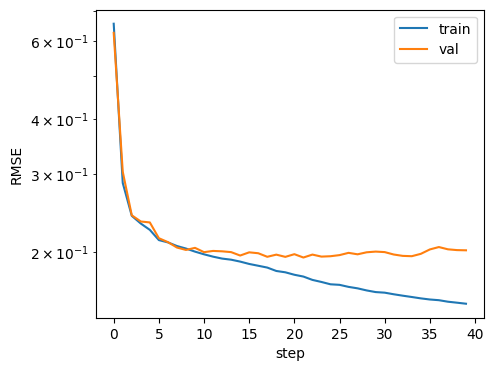

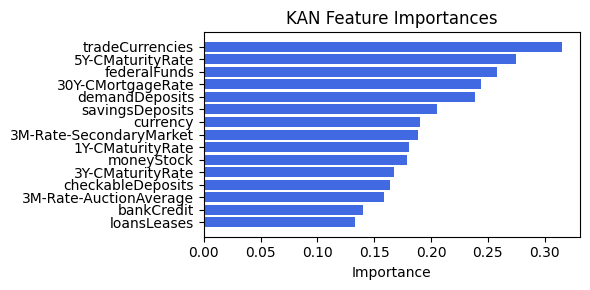

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  9.11it/s]

[('3Y-CMaturityRate', 0.10387439388959181), ('1Y-CMaturityRate', 0.06634960938466801), ('tradeCurrencies', 0.05887386215507009), ('demandDeposits', 0.04468584283299389), ('loansLeases', 0.04258290041900528), ('savingsDeposits', 0.012981544892525135), ('moneyStock', 0.004274131312212419), ('3M-Rate-SecondaryMarket', 0.002437408268451691), ('federalFunds', 1.3310096636858015e-05), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


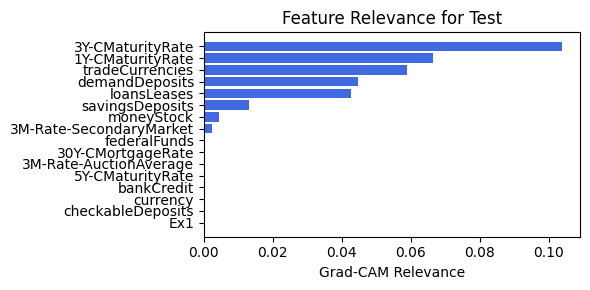

In [75]:
train_and_plot_relevance(Model3_1, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=5, lamb=0.0001, steps=40, filename=filename_1, opt_col_val=5)

### 1.0.5 width=[15, 5, 1], grid=4, lamb=0.0001 | cnn_bottleneck_dim=8

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.64e-01 | eval_loss: 1.92e-01 | reg: 2.04e+01 |: 100%|█| 40/40 [00:11<00:00,  3.43it/

saving model version 0.1
Best epoch 32
0.23415841162204742
M_KAN Relevance: 0.07200522720813751
CNN Relevance: 0.9279947876930237
[('federalFunds', 0.36325955), ('1Y-CMaturityRate', 0.25471744), ('demandDeposits', 0.2530422), ('3M-Rate-AuctionAverage', 0.24749282), ('30Y-CMortgageRate', 0.21119986), ('3Y-CMaturityRate', 0.20903666), ('tradeCurrencies', 0.20144121), ('bankCredit', 0.18515955), ('3M-Rate-SecondaryMarket', 0.14094144), ('moneyStock', 0.13994917), ('5Y-CMaturityRate', 0.1377694), ('checkableDeposits', 0.13773237), ('loansLeases', 0.13215227), ('savingsDeposits', 0.12706833), ('currency', 0.09097195)]


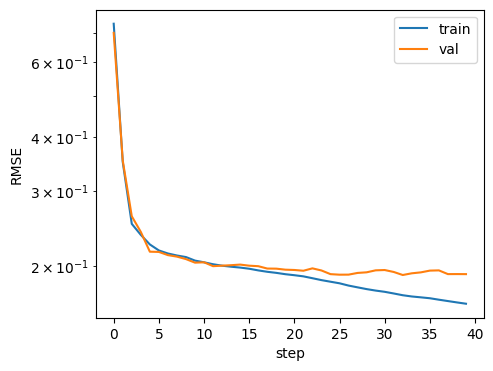

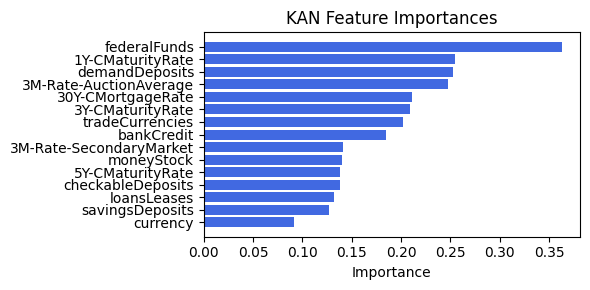

Computing Grad-CAM: 100%|██████████| 210/210 [00:22<00:00,  9.34it/s]

[('loansLeases', 0.05273491891616903), ('tradeCurrencies', 0.037125377933539094), ('3M-Rate-SecondaryMarket', 0.019107499789623988), ('demandDeposits', 0.01226409579893308), ('3Y-CMaturityRate', 0.006994052284530231), ('Ex1', 0.006168184961591448), ('savingsDeposits', 0.005084794452886854), ('30Y-CMortgageRate', 0.0021817134959357127), ('1Y-CMaturityRate', 0.0017681050668692305), ('3M-Rate-AuctionAverage', 0.0003531723061487788), ('currency', 0.00022229951850715138), ('moneyStock', 0.00017910158660795007), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('federalFunds', 0.0), ('checkableDeposits', 0.0)]


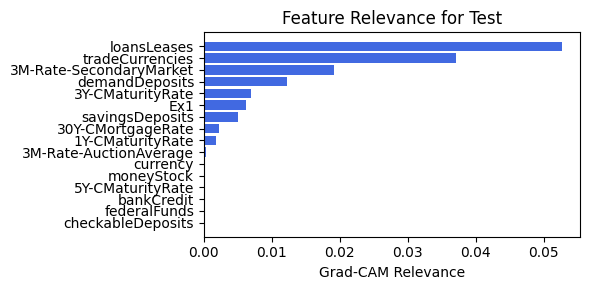

In [76]:
train_and_plot_relevance(Model3_1, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=8, lamb=0.0001, steps=40, filename=filename_1, opt_col_val=8)

### 1.0.6 width=[15, 5, 1], grid=4, lamb=0.0001 | cnn_bottleneck_dim=8

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.63e-01 | eval_loss: 2.02e-01 | reg: 2.02e+01 |: 100%|█| 40/40 [00:12<00:00,  3.31it/

saving model version 0.1
Best epoch 22
0.23694159090518951
M_KAN Relevance: 0.04433406889438629
CNN Relevance: 0.9556658864021301
[('tradeCurrencies', 0.34951195), ('federalFunds', 0.30470926), ('checkableDeposits', 0.29864672), ('30Y-CMortgageRate', 0.2666022), ('demandDeposits', 0.2633475), ('savingsDeposits', 0.25046262), ('1Y-CMaturityRate', 0.23952198), ('currency', 0.23372577), ('3Y-CMaturityRate', 0.22639064), ('3M-Rate-AuctionAverage', 0.21883257), ('5Y-CMaturityRate', 0.20637958), ('3M-Rate-SecondaryMarket', 0.2042918), ('loansLeases', 0.19895263), ('moneyStock', 0.14200376), ('bankCredit', 0.10920133)]


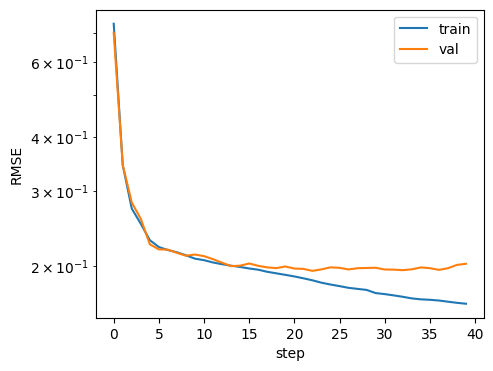

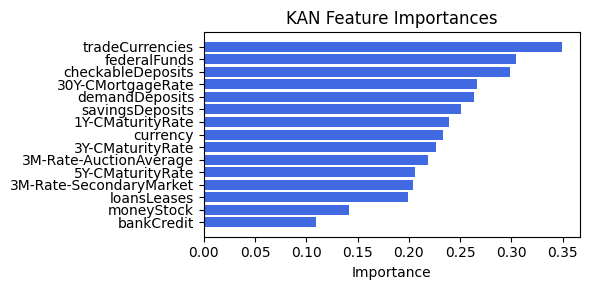

Computing Grad-CAM: 100%|██████████| 210/210 [00:21<00:00,  9.56it/s]

[('loansLeases', 0.1592763940759358), ('tradeCurrencies', 0.053122424037151394), ('savingsDeposits', 0.033374755206473525), ('3M-Rate-SecondaryMarket', 0.01263218207944495), ('checkableDeposits', 0.002662209763989917), ('1Y-CMaturityRate', 0.002331794567760967), ('demandDeposits', 0.0006986673832649276), ('currency', 0.0005208333333333333), ('30Y-CMortgageRate', 2.5178973252574603e-05), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('Ex1', 0.0)]


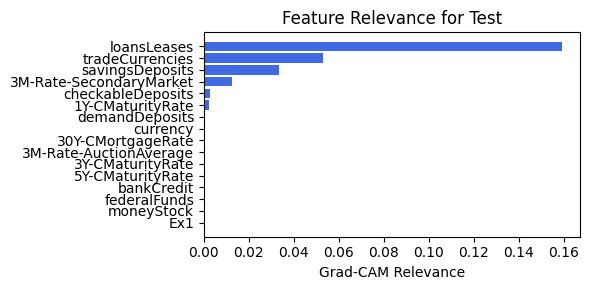

In [77]:
train_and_plot_relevance(Model3_1, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=8, lamb=0.0001, steps=40, filename=filename_1, opt_col_val=8)

### 1.0.7 width=[15, 5, 1], grid=4, lamb=0.0001 | cnn_bottleneck_dim=10

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.66e-01 | eval_loss: 1.95e-01 | reg: 1.89e+01 |: 100%|█| 40/40 [00:11<00:00,  3.53it/

saving model version 0.1
Best epoch 38
0.22303804755210876
M_KAN Relevance: 0.04340481013059616
CNN Relevance: 0.956595242023468
[('savingsDeposits', 0.3726542), ('loansLeases', 0.30580455), ('tradeCurrencies', 0.29515287), ('federalFunds', 0.2745712), ('30Y-CMortgageRate', 0.2630436), ('checkableDeposits', 0.251111), ('currency', 0.22878127), ('5Y-CMaturityRate', 0.20900479), ('1Y-CMaturityRate', 0.20776215), ('bankCredit', 0.20063639), ('3M-Rate-SecondaryMarket', 0.18571298), ('3M-Rate-AuctionAverage', 0.15621375), ('moneyStock', 0.14380598), ('3Y-CMaturityRate', 0.13747528), ('demandDeposits', 0.11886569)]


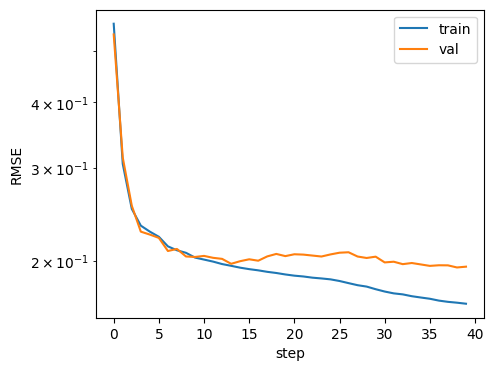

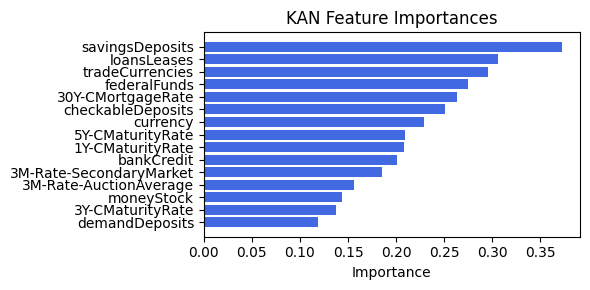

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  8.94it/s]


[('30Y-CMortgageRate', 0.40106497687686765), ('3M-Rate-AuctionAverage', 0.38707926295499506), ('1Y-CMaturityRate', 0.35822670643350907), ('3M-Rate-SecondaryMarket', 0.15119906685182027), ('moneyStock', 0.0938172778832571), ('demandDeposits', 0.032592121740301426), ('loansLeases', 0.03101201352436051), ('checkableDeposits', 0.008269515506496343), ('savingsDeposits', 0.008219300968505108), ('3Y-CMaturityRate', 0.007708572742107901), ('federalFunds', 0.00478235565048332), ('tradeCurrencies', 0.0005709723687600455), ('currency', 0.00014397281199871075), ('bankCredit', 0.00010030459934135987), ('Ex1', 4.933620359571207e-06), ('5Y-CMaturityRate', 0.0)]


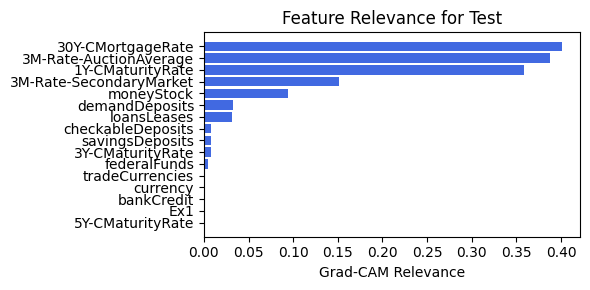

In [78]:
train_and_plot_relevance(Model3_1, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=10, lamb=0.0001, steps=40, filename=filename_1, opt_col_val=8)

### 1.0.8 width=[15, 5, 1], grid=4, lamb=0.0001 | cnn_bottleneck_dim=10

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.68e-01 | eval_loss: 1.89e-01 | reg: 1.99e+01 |: 100%|█| 40/40 [00:15<00:00,  2.58it/

saving model version 0.1
Best epoch 39
0.22895818948745728
M_KAN Relevance: 0.042198680341243744
CNN Relevance: 0.9578012824058533
[('checkableDeposits', 0.2852026), ('30Y-CMortgageRate', 0.27252218), ('tradeCurrencies', 0.24630861), ('savingsDeposits', 0.23422985), ('5Y-CMaturityRate', 0.22019589), ('bankCredit', 0.21696965), ('loansLeases', 0.19230019), ('currency', 0.18278085), ('federalFunds', 0.16305041), ('3M-Rate-SecondaryMarket', 0.15618722), ('3M-Rate-AuctionAverage', 0.15499456), ('moneyStock', 0.14165594), ('1Y-CMaturityRate', 0.1338177), ('3Y-CMaturityRate', 0.12649523), ('demandDeposits', 0.095664196)]


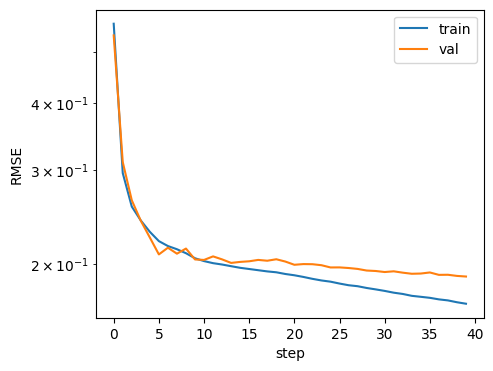

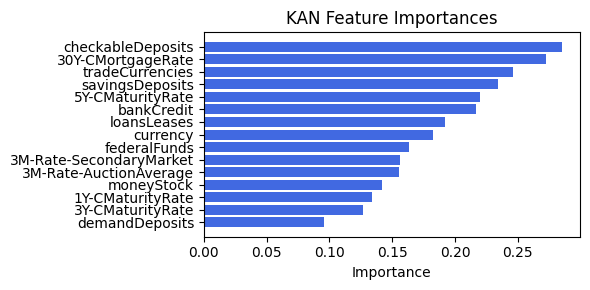

Computing Grad-CAM: 100%|██████████| 210/210 [00:22<00:00,  9.21it/s]

[('3M-Rate-SecondaryMarket', 0.4934091318930898), ('currency', 0.4689991805879843), ('checkableDeposits', 0.34330652476776213), ('30Y-CMortgageRate', 0.27865306194871664), ('3M-Rate-AuctionAverage', 0.27616586179162067), ('1Y-CMaturityRate', 0.1314932817526694), ('Ex1', 0.11160840317606927), ('loansLeases', 0.013828189062353755), ('demandDeposits', 0.007628838823958566), ('moneyStock', 0.006888921359287841), ('savingsDeposits', 0.0014355293222685023), ('bankCredit', 0.00012619284292062123), ('5Y-CMaturityRate', 8.365042712761178e-05), ('federalFunds', 8.531194734608843e-06), ('3Y-CMaturityRate', 0.0), ('tradeCurrencies', 0.0)]


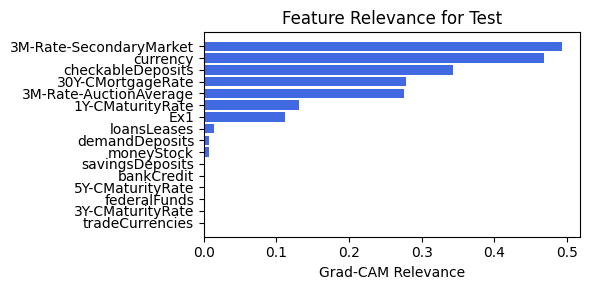

In [79]:
train_and_plot_relevance(Model3_1, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=10, lamb=0.0001, steps=40, filename=filename_1, opt_col_val=10)

### 1.0.9 width=[15, 5, 1], grid=4, lamb=0.0001 | cnn_bottleneck_dim=15

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.63e-01 | eval_loss: 1.87e-01 | reg: 2.16e+01 |: 100%|█| 40/40 [00:12<00:00,  3.16it/

saving model version 0.1
Best epoch 34
0.23134364187717438
M_KAN Relevance: 0.043598320335149765
CNN Relevance: 0.9564016461372375
[('tradeCurrencies', 0.43650493), ('savingsDeposits', 0.39108786), ('checkableDeposits', 0.3632458), ('loansLeases', 0.26557937), ('1Y-CMaturityRate', 0.26283038), ('30Y-CMortgageRate', 0.24786036), ('bankCredit', 0.21401249), ('3M-Rate-SecondaryMarket', 0.20774594), ('federalFunds', 0.20655294), ('3Y-CMaturityRate', 0.20398425), ('3M-Rate-AuctionAverage', 0.20103863), ('5Y-CMaturityRate', 0.19485407), ('moneyStock', 0.17086504), ('demandDeposits', 0.10262673), ('currency', 0.095443286)]


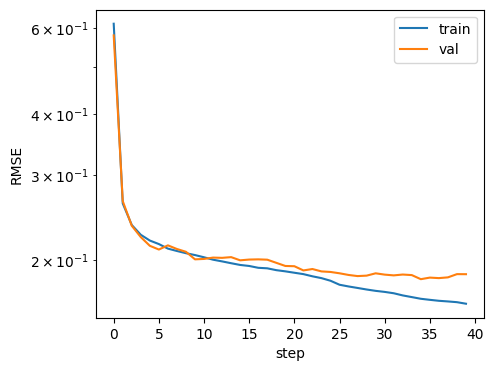

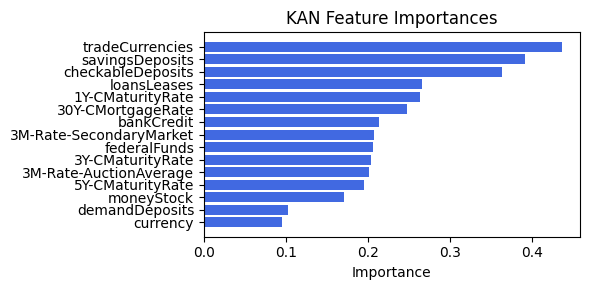

Computing Grad-CAM: 100%|██████████| 210/210 [00:22<00:00,  9.31it/s]

[('checkableDeposits', 0.2605068379115047), ('currency', 0.23527025705469506), ('3M-Rate-SecondaryMarket', 0.2118344844485234), ('Ex1', 0.13861882660005773), ('loansLeases', 0.12263369264713089), ('savingsDeposits', 0.05643118596372439), ('tradeCurrencies', 0.009720530270022296), ('3Y-CMaturityRate', 0.0002776804490990582), ('moneyStock', 0.00011461773621184485), ('5Y-CMaturityRate', 3.908889900360789e-05), ('bankCredit', 1.6968683450527135e-06), ('1Y-CMaturityRate', 0.0), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0)]


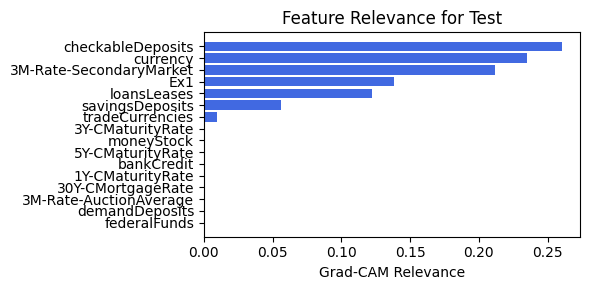

In [80]:
train_and_plot_relevance(Model3_1, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=15, lamb=0.0001, steps=40, filename=filename_1, opt_col_val=15)

### 1.0.10 width=[15, 5, 1], grid=4, lamb=0.0001 | cnn_bottleneck_dim=15

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.63e-01 | eval_loss: 1.87e-01 | reg: 2.16e+01 |: 100%|█| 40/40 [00:11<00:00,  3.45it/

saving model version 0.1
Best epoch 34
0.23134364187717438
M_KAN Relevance: 0.043598320335149765
CNN Relevance: 0.9564016461372375
[('tradeCurrencies', 0.43650493), ('savingsDeposits', 0.39108786), ('checkableDeposits', 0.3632458), ('loansLeases', 0.26557937), ('1Y-CMaturityRate', 0.26283038), ('30Y-CMortgageRate', 0.24786036), ('bankCredit', 0.21401249), ('3M-Rate-SecondaryMarket', 0.20774594), ('federalFunds', 0.20655294), ('3Y-CMaturityRate', 0.20398425), ('3M-Rate-AuctionAverage', 0.20103863), ('5Y-CMaturityRate', 0.19485407), ('moneyStock', 0.17086504), ('demandDeposits', 0.10262673), ('currency', 0.095443286)]


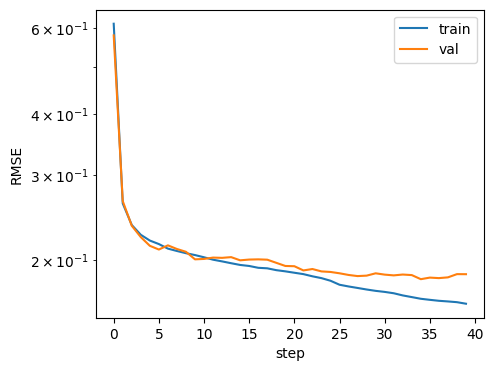

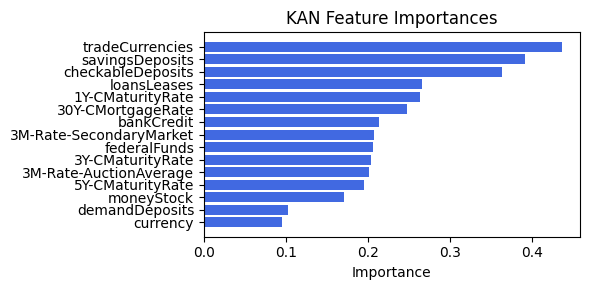

Computing Grad-CAM: 100%|██████████| 210/210 [00:22<00:00,  9.13it/s]

[('checkableDeposits', 0.2605068379115047), ('currency', 0.23527025705469506), ('3M-Rate-SecondaryMarket', 0.2118344844485234), ('Ex1', 0.13861882660005773), ('loansLeases', 0.12263369264713089), ('savingsDeposits', 0.05643118596372439), ('tradeCurrencies', 0.009720530270022296), ('3Y-CMaturityRate', 0.0002776804490990582), ('moneyStock', 0.00011461773621184485), ('5Y-CMaturityRate', 3.908889900360789e-05), ('bankCredit', 1.6968683450527135e-06), ('1Y-CMaturityRate', 0.0), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0)]


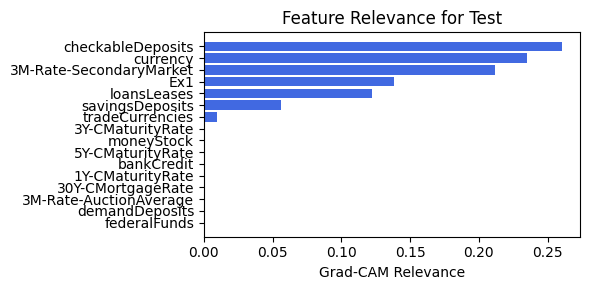

In [81]:
train_and_plot_relevance(Model3_1, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=15, lamb=0.0001, steps=40, filename=filename_1, opt_col_val=15)

### 1.0.11 width=[15, 5, 1], grid=4, lamb=0.0001 | cnn_bottleneck_dim=18

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.74e-01 | eval_loss: 2.12e-01 | reg: 2.14e+01 |: 100%|█| 40/40 [00:12<00:00,  3.14it/

saving model version 0.1
Best epoch 25
0.24163857102394104
M_KAN Relevance: 0.021263644099235535
CNN Relevance: 0.978736400604248
[('loansLeases', 0.4472607), ('tradeCurrencies', 0.3957541), ('savingsDeposits', 0.35444355), ('checkableDeposits', 0.34193003), ('federalFunds', 0.28306675), ('30Y-CMortgageRate', 0.2743306), ('bankCredit', 0.26767838), ('currency', 0.23909317), ('5Y-CMaturityRate', 0.22721837), ('moneyStock', 0.215552), ('3M-Rate-SecondaryMarket', 0.20507696), ('3M-Rate-AuctionAverage', 0.1976269), ('demandDeposits', 0.18520688), ('1Y-CMaturityRate', 0.17722161), ('3Y-CMaturityRate', 0.122383356)]


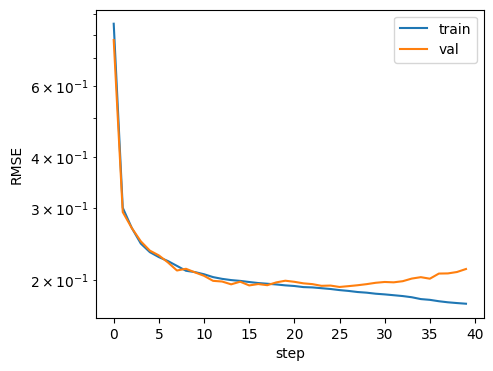

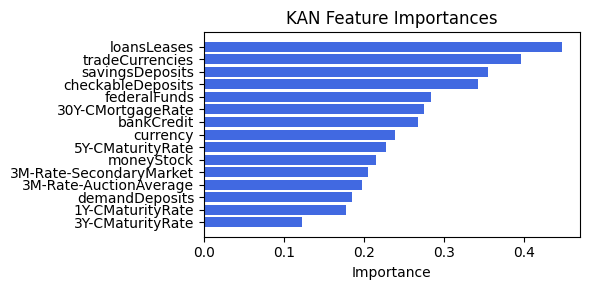

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.72it/s]

[('3M-Rate-SecondaryMarket', 0.10673584640913067), ('loansLeases', 0.05993486445042349), ('1Y-CMaturityRate', 0.006050480749191982), ('3M-Rate-AuctionAverage', 0.002557555337746938), ('30Y-CMortgageRate', 0.001330548773209254), ('currency', 0.0007219573571568443), ('savingsDeposits', 0.000676193307819111), ('bankCredit', 0.0005030282728728794), ('checkableDeposits', 0.0002438620797225407), ('5Y-CMaturityRate', 5.5840804374643736e-05), ('3Y-CMaturityRate', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


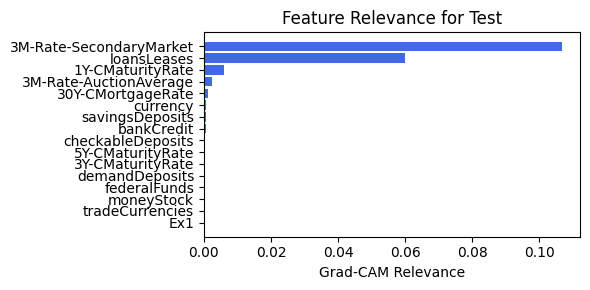

In [82]:
train_and_plot_relevance(Model3_1, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=18, lamb=0.0001, steps=40, filename=filename_1, opt_col_val=18)

## 1.1 width=[15, 6, 1], grid=5, lamb=1e-05

### 1.1.0 width=[15, 6, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=1

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.09e-01 | eval_loss: 2.12e-01 | reg: 4.62e+01 |: 100%|█| 50/50 [00:16<00:00,  3.06it/

saving model version 0.1
Best epoch 18
0.21221202611923218
M_KAN Relevance: 0.9823524951934814
CNN Relevance: 0.01764753647148609
[('moneyStock', 0.28088573), ('30Y-CMortgageRate', 0.25504017), ('checkableDeposits', 0.20719396), ('bankCredit', 0.20625512), ('3Y-CMaturityRate', 0.18558359), ('tradeCurrencies', 0.18238388), ('federalFunds', 0.173498), ('currency', 0.17031422), ('3M-Rate-AuctionAverage', 0.16982207), ('5Y-CMaturityRate', 0.15765224), ('demandDeposits', 0.15131229), ('3M-Rate-SecondaryMarket', 0.14955509), ('loansLeases', 0.14624158), ('savingsDeposits', 0.1365721), ('1Y-CMaturityRate', 0.068982586)]


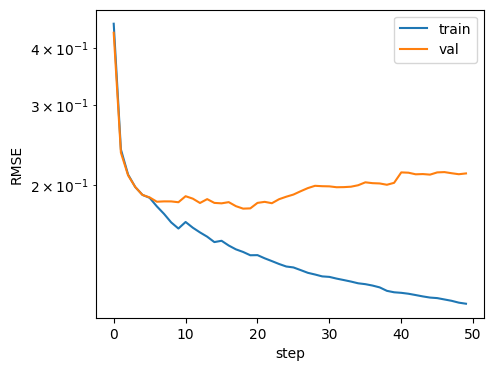

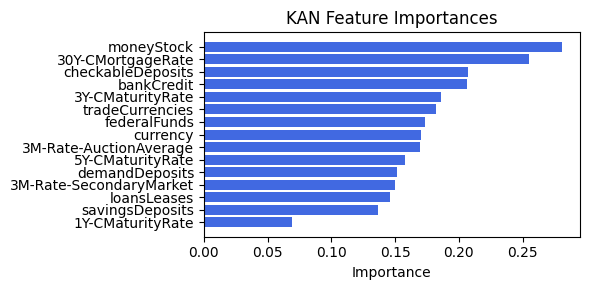

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.53it/s]


[('moneyStock', 0.47406776086205527), ('3M-Rate-AuctionAverage', 0.42686483466199465), ('30Y-CMortgageRate', 0.4207090768730268), ('5Y-CMaturityRate', 0.40645556799690463), ('bankCredit', 0.39857684171098906), ('1Y-CMaturityRate', 0.3854197075000099), ('3Y-CMaturityRate', 0.29496406880678566), ('federalFunds', 0.27600823243459066), ('currency', 0.23158253361470998), ('demandDeposits', 0.19472770776954434), ('Ex1', 0.1917779702515829), ('checkableDeposits', 0.17227119817287617), ('3M-Rate-SecondaryMarket', 0.13293952168647333), ('tradeCurrencies', 0.12661521324799174), ('loansLeases', 0.11489591728895902), ('savingsDeposits', 0.09378009664693049)]


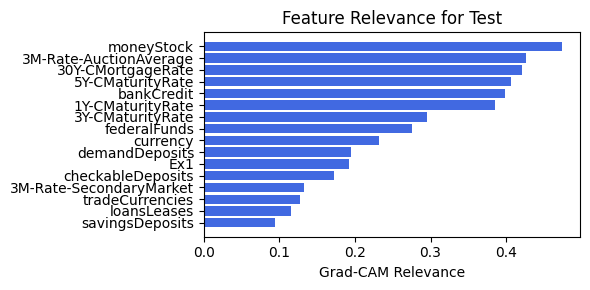

In [234]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=1, lamb=1e-05, steps=50, filename=filename_1, opt_col_val=1)

### 1.1.1 width=[15, 6, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=1

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.06e-01 | eval_loss: 2.13e-01 | reg: 4.56e+01 |: 100%|█| 50/50 [00:16<00:00,  3.12it/

saving model version 0.1
Best epoch 18
0.20452335476875305
M_KAN Relevance: 0.9862038493156433
CNN Relevance: 0.013796146027743816
[('30Y-CMortgageRate', 0.287249), ('moneyStock', 0.26927832), ('bankCredit', 0.20690861), ('currency', 0.18969826), ('checkableDeposits', 0.18924832), ('tradeCurrencies', 0.18667683), ('3Y-CMaturityRate', 0.18545845), ('savingsDeposits', 0.16266659), ('3M-Rate-AuctionAverage', 0.1602148), ('5Y-CMaturityRate', 0.15852907), ('demandDeposits', 0.14862901), ('federalFunds', 0.13548563), ('3M-Rate-SecondaryMarket', 0.12868199), ('loansLeases', 0.11812422), ('1Y-CMaturityRate', 0.06032316)]


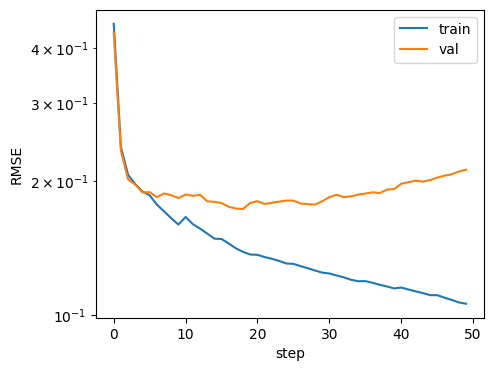

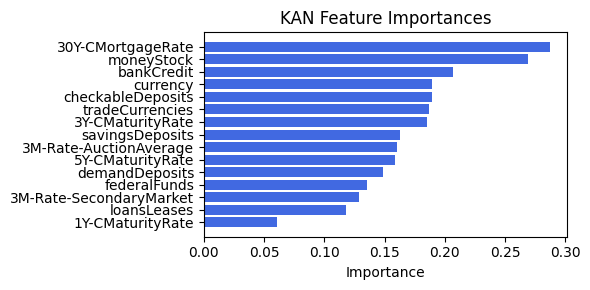

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.09it/s]


[('3M-Rate-SecondaryMarket', 0.2837522336414882), ('loansLeases', 0.25610593853108143), ('moneyStock', 0.1813047209665889), ('5Y-CMaturityRate', 0.17864498225590936), ('checkableDeposits', 0.17677549474728516), ('bankCredit', 0.174547264108523), ('3M-Rate-AuctionAverage', 0.1306096283364154), ('3Y-CMaturityRate', 0.1291426918136754), ('30Y-CMortgageRate', 0.12592823209152335), ('1Y-CMaturityRate', 0.12058898200325313), ('federalFunds', 0.12053119930483046), ('tradeCurrencies', 0.11282151237213665), ('savingsDeposits', 0.11011973876591669), ('Ex1', 0.08135066664295404), ('demandDeposits', 0.07537900690388466), ('currency', 0.061692438750677474)]


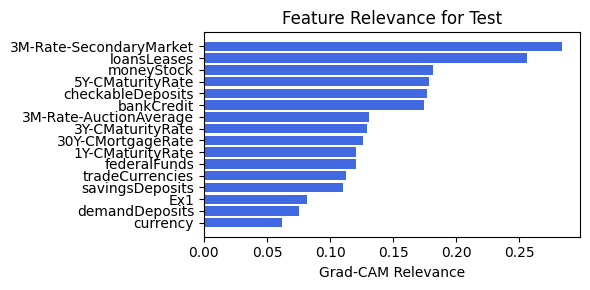

In [235]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=1, lamb=1e-05, steps=50, filename=filename_1, opt_col_val=1)

### 1.1.3 width=[15, 6, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=2

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.38e-01 | eval_loss: 1.98e-01 | reg: 3.34e+01 |: 100%|█| 50/50 [01:25<00:00,  1.72s/i


saving model version 0.1
Best epoch 17
0.1949918270111084
M_KAN Relevance: 0.31808608770370483
CNN Relevance: 0.6819138526916504
[('checkableDeposits', 0.16964827), ('3Y-CMaturityRate', 0.11692866), ('tradeCurrencies', 0.11229591), ('bankCredit', 0.1037651), ('3M-Rate-SecondaryMarket', 0.10093286), ('federalFunds', 0.09949571), ('moneyStock', 0.09678259), ('3M-Rate-AuctionAverage', 0.0951594), ('currency', 0.094931595), ('demandDeposits', 0.09479682), ('5Y-CMaturityRate', 0.09224053), ('loansLeases', 0.09055053), ('savingsDeposits', 0.083027735), ('30Y-CMortgageRate', 0.07077655), ('1Y-CMaturityRate', 0.067447826)]


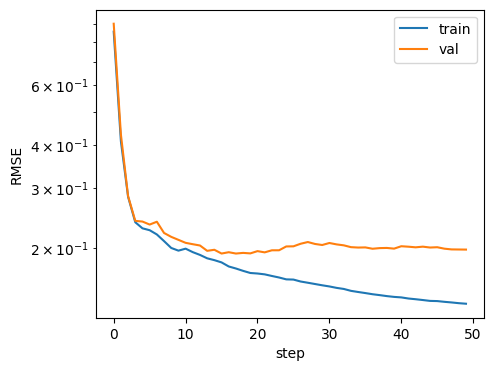

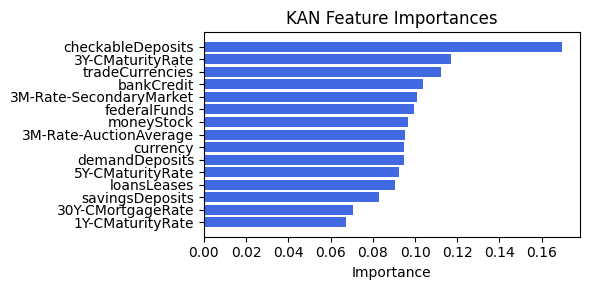

Computing Grad-CAM: 100%|██████████| 210/210 [02:04<00:00,  1.68it/s]


[('loansLeases', 0.09263409572609124), ('savingsDeposits', 0.021867571817710995), ('checkableDeposits', 0.007479047640888547), ('demandDeposits', 0.0034649129602171125), ('1Y-CMaturityRate', 0.0011967891738528297), ('bankCredit', 2.7549767955428077e-05), ('currency', 1.8096833844624815e-05), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3M-Rate-SecondaryMarket', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


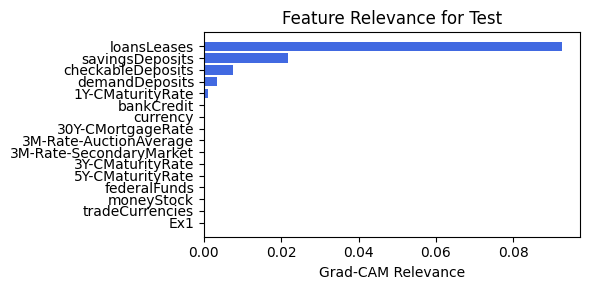

In [43]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=2, lamb=1e-05, steps=50, filename=filename_1, opt_col_val=2)

### 1.1.4 width=[15, 6, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=2

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.77e-01 | eval_loss: 1.88e-01 | reg: 4.92e+01 |: 100%|█| 50/50 [01:24<00:00,  1.68s/i


saving model version 0.1
Best epoch 45
0.2457398772239685
M_KAN Relevance: 0.6965482831001282
CNN Relevance: 0.3034517467021942
[('checkableDeposits', 0.17437641), ('tradeCurrencies', 0.13457173), ('moneyStock', 0.11622581), ('3M-Rate-AuctionAverage', 0.10569771), ('bankCredit', 0.10456588), ('loansLeases', 0.09619653), ('currency', 0.09227368), ('5Y-CMaturityRate', 0.09014674), ('savingsDeposits', 0.08668053), ('3Y-CMaturityRate', 0.08461543), ('30Y-CMortgageRate', 0.07994532), ('demandDeposits', 0.07937564), ('federalFunds', 0.0787794), ('3M-Rate-SecondaryMarket', 0.067286424), ('1Y-CMaturityRate', 0.06532654)]


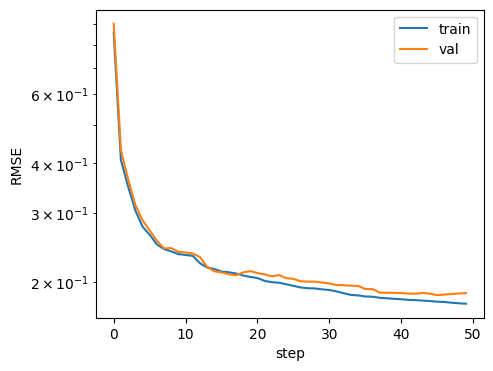

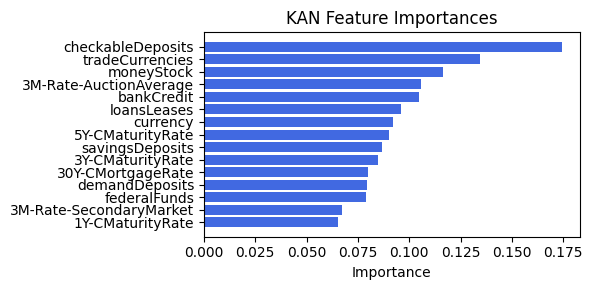

Computing Grad-CAM: 100%|██████████| 210/210 [02:05<00:00,  1.68it/s]


[('loansLeases', 0.21391088992712043), ('savingsDeposits', 0.053328864107884115), ('demandDeposits', 0.00124738695366042), ('1Y-CMaturityRate', 0.0009117828948157174), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3M-Rate-SecondaryMarket', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


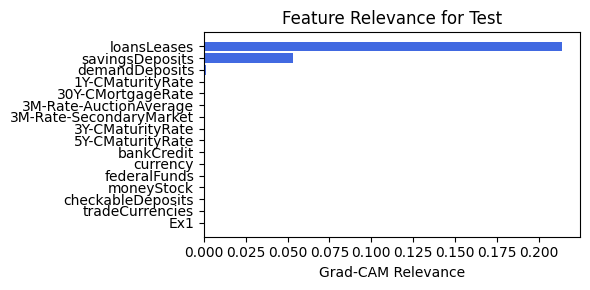

In [44]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=2, lamb=1e-05, steps=50, filename=filename_1, opt_col_val=2)

### 1.1.5 width=[15, 6, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=3

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.54e-01 | eval_loss: 1.86e-01 | reg: 3.25e+01 |: 100%|█| 40/40 [00:12<00:00,  3.28it/

saving model version 0.1
Best epoch 35
0.20743721723556519
M_KAN Relevance: 0.13005316257476807
CNN Relevance: 0.8699468374252319
[('currency', 0.15362084), ('loansLeases', 0.14911783), ('savingsDeposits', 0.13106732), ('5Y-CMaturityRate', 0.13044178), ('3Y-CMaturityRate', 0.12581646), ('30Y-CMortgageRate', 0.123723894), ('moneyStock', 0.1188239), ('bankCredit', 0.11371487), ('3M-Rate-AuctionAverage', 0.10364976), ('3M-Rate-SecondaryMarket', 0.10192328), ('demandDeposits', 0.101566985), ('federalFunds', 0.09670672), ('checkableDeposits', 0.08718126), ('1Y-CMaturityRate', 0.08425115), ('tradeCurrencies', 0.081723645)]


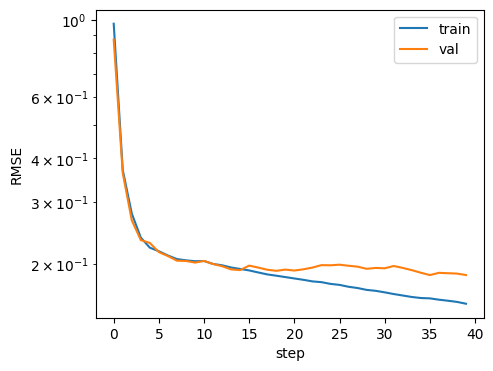

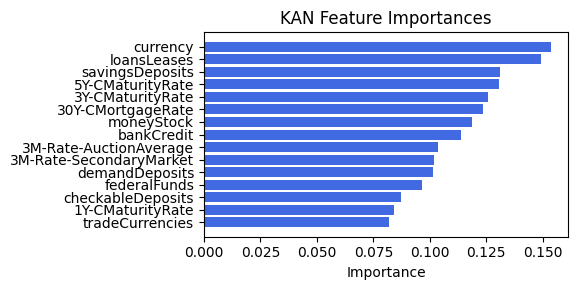

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.62it/s]

[('loansLeases', 0.1565970355406448), ('demandDeposits', 0.09166962400610958), ('3Y-CMaturityRate', 0.07853748837840699), ('savingsDeposits', 0.0550065886827984), ('tradeCurrencies', 0.054947547581312914), ('3M-Rate-SecondaryMarket', 0.026881412381217593), ('1Y-CMaturityRate', 0.0028876406805855887), ('3M-Rate-AuctionAverage', 0.001406841760589963), ('30Y-CMortgageRate', 0.001392616331577301), ('currency', 0.000999957819779714), ('Ex1', 0.0008577804480280195), ('bankCredit', 8.922420176012175e-05), ('5Y-CMaturityRate', 2.271656080016068e-05), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0)]


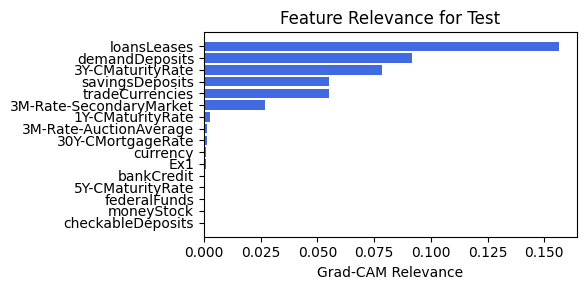

In [83]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=3, lamb=1e-05, steps=40, filename=filename_1, opt_col_val=3)

### 1.1.6 width=[15, 6, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=3

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.92e-01 | eval_loss: 1.92e-01 | reg: 3.74e+01 |: 100%|█| 40/40 [00:12<00:00,  3.27it/

saving model version 0.1
Best epoch 32
0.24566848576068878
M_KAN Relevance: 0.10153210163116455
CNN Relevance: 0.8984678387641907
[('loansLeases', 0.17304635), ('currency', 0.12976825), ('savingsDeposits', 0.10606062), ('federalFunds', 0.09243193), ('checkableDeposits', 0.09042631), ('5Y-CMaturityRate', 0.082316354), ('moneyStock', 0.078093246), ('bankCredit', 0.07567093), ('1Y-CMaturityRate', 0.07566537), ('demandDeposits', 0.07536504), ('3Y-CMaturityRate', 0.07157138), ('30Y-CMortgageRate', 0.07147256), ('3M-Rate-AuctionAverage', 0.06919505), ('3M-Rate-SecondaryMarket', 0.049934246), ('tradeCurrencies', 0.038990848)]


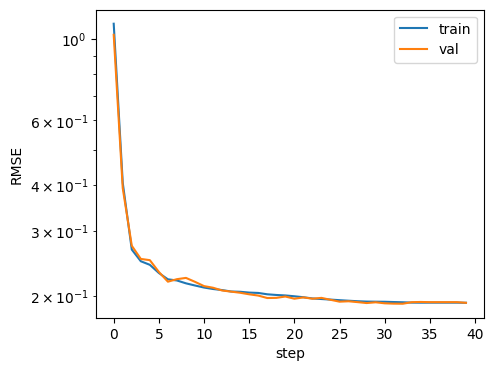

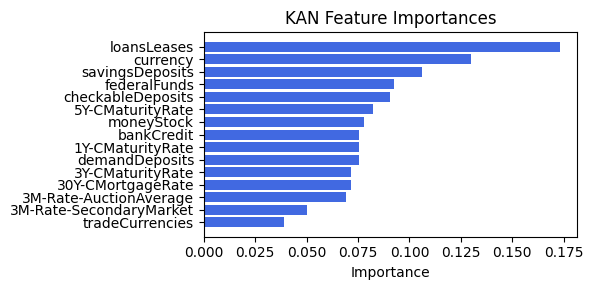

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  8.84it/s]

[('loansLeases', 0.44584716475080877), ('savingsDeposits', 0.07782365749645535), ('demandDeposits', 0.02167858730203339), ('tradeCurrencies', 0.016748117180707466), ('1Y-CMaturityRate', 0.0021930947190239316), ('3M-Rate-SecondaryMarket', 0.001797272123041607), ('3M-Rate-AuctionAverage', 0.0007736870220729283), ('30Y-CMortgageRate', 3.7833791048753826e-05), ('bankCredit', 2.628866627457596e-05), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('currency', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


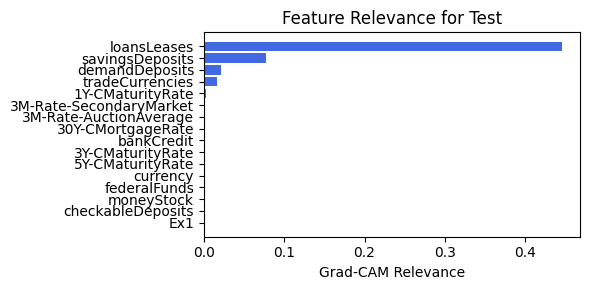

In [84]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=3, lamb=1e-05, steps=40, filename=filename_1, opt_col_val=3)

### 1.1.7 width=[15, 6, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=6

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.81e-01 | eval_loss: 1.93e-01 | reg: 2.92e+01 |: 100%|█| 40/40 [00:12<00:00,  3.14it/

saving model version 0.1
Best epoch 24
0.22827918827533722
M_KAN Relevance: 0.054962173104286194
CNN Relevance: 0.9450377821922302
[('checkableDeposits', 0.29144996), ('tradeCurrencies', 0.19752006), ('30Y-CMortgageRate', 0.14652738), ('1Y-CMaturityRate', 0.1372156), ('loansLeases', 0.1351951), ('3M-Rate-AuctionAverage', 0.13012378), ('5Y-CMaturityRate', 0.1298686), ('3Y-CMaturityRate', 0.12786254), ('currency', 0.11963943), ('3M-Rate-SecondaryMarket', 0.11798512), ('bankCredit', 0.11261037), ('federalFunds', 0.112321034), ('moneyStock', 0.09361991), ('demandDeposits', 0.093209706), ('savingsDeposits', 0.059787687)]


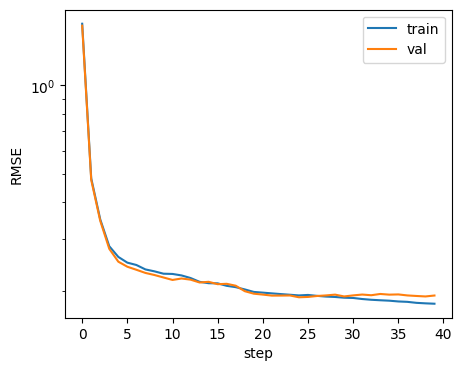

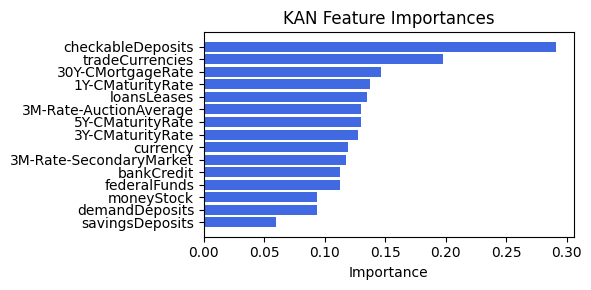

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.69it/s]

[('loansLeases', 0.22523218808429582), ('savingsDeposits', 0.05094743406267038), ('demandDeposits', 0.007331662908906029), ('3M-Rate-SecondaryMarket', 0.004949349759235269), ('1Y-CMaturityRate', 0.0018634373233431861), ('currency', 5.807696087729363e-05), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


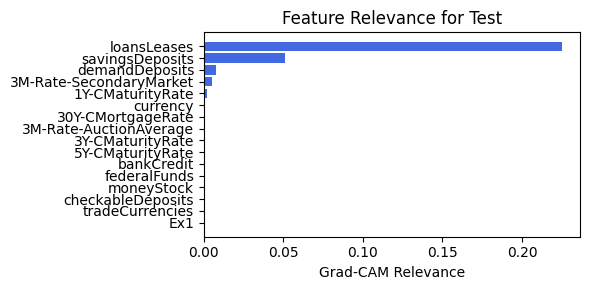

In [85]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=6, lamb=1e-05, steps=40, filename=filename_1, opt_col_val=6)

### 1.1.8 width=[15, 6, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=6

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.80e-01 | eval_loss: 1.91e-01 | reg: 2.80e+01 |: 100%|█| 40/40 [00:12<00:00,  3.21it/

saving model version 0.1
Best epoch 36
0.22796620428562164
M_KAN Relevance: 0.07971754670143127
CNN Relevance: 0.9202824831008911
[('checkableDeposits', 0.32081202), ('tradeCurrencies', 0.22452347), ('30Y-CMortgageRate', 0.18069309), ('5Y-CMaturityRate', 0.14944796), ('1Y-CMaturityRate', 0.14741957), ('3M-Rate-AuctionAverage', 0.1454409), ('3M-Rate-SecondaryMarket', 0.14418232), ('loansLeases', 0.13359973), ('bankCredit', 0.1244376), ('3Y-CMaturityRate', 0.12292731), ('federalFunds', 0.117405534), ('currency', 0.112285286), ('moneyStock', 0.1075252), ('demandDeposits', 0.10329222), ('savingsDeposits', 0.06806018)]


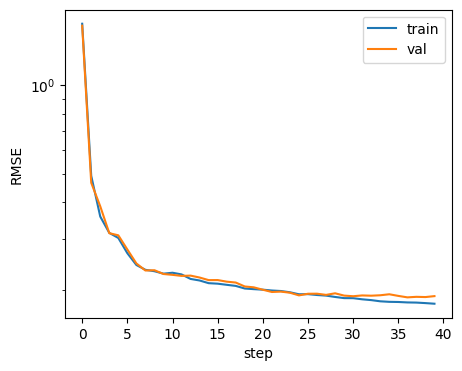

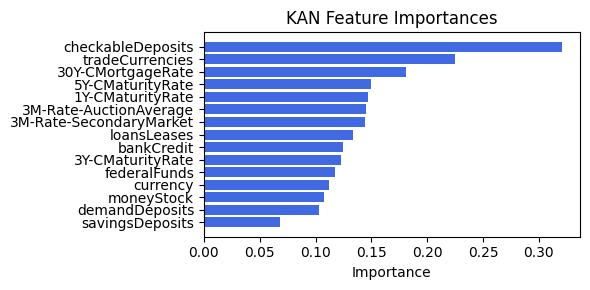

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.27it/s]

[('loansLeases', 0.26460865757516805), ('savingsDeposits', 0.07546870604301581), ('demandDeposits', 0.010466106342417854), ('3M-Rate-SecondaryMarket', 0.0065542072589908325), ('1Y-CMaturityRate', 0.002115444200379508), ('currency', 0.0001654436146574361), ('3M-Rate-AuctionAverage', 9.050423368102028e-05), ('30Y-CMortgageRate', 4.722178869304203e-05), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


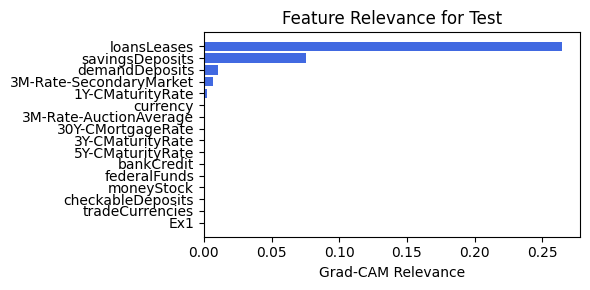

In [86]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=6, lamb=1e-05, steps=40, filename=filename_1, opt_col_val=6)

### 1.1.9 width=[15, 6, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=9

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.27e-01 | eval_loss: 2.00e-01 | reg: 2.72e+01 |: 100%|█| 40/40 [00:12<00:00,  3.21it/

saving model version 0.1
Best epoch 30
0.24205802381038666
M_KAN Relevance: 0.12323900312185287
CNN Relevance: 0.8767610192298889
[('federalFunds', 0.44901645), ('tradeCurrencies', 0.43166506), ('checkableDeposits', 0.4154849), ('30Y-CMortgageRate', 0.3687911), ('3Y-CMaturityRate', 0.281084), ('3M-Rate-SecondaryMarket', 0.2751852), ('loansLeases', 0.24031958), ('currency', 0.24011233), ('5Y-CMaturityRate', 0.22440355), ('moneyStock', 0.22090285), ('demandDeposits', 0.21824501), ('1Y-CMaturityRate', 0.21718232), ('bankCredit', 0.1664932), ('3M-Rate-AuctionAverage', 0.16303273), ('savingsDeposits', 0.12780064)]


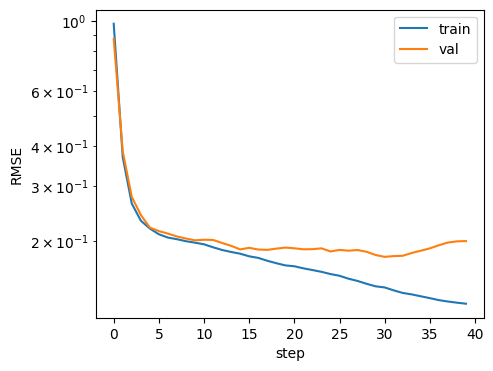

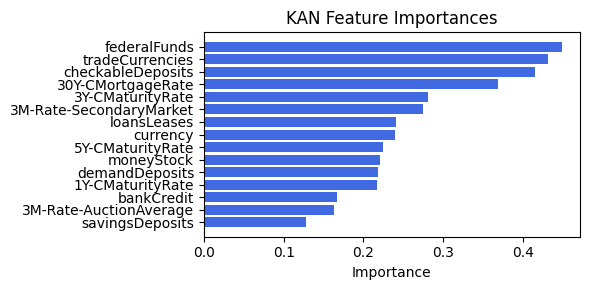

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.60it/s]

[('loansLeases', 0.1806004961242988), ('savingsDeposits', 0.04905880924752204), ('demandDeposits', 0.007705348162423997), ('1Y-CMaturityRate', 0.0015279855046953473), ('3M-Rate-SecondaryMarket', 0.0012613894329184577), ('currency', 0.0007306134416943504), ('Ex1', 1.984689429047562e-05), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('tradeCurrencies', 0.0)]


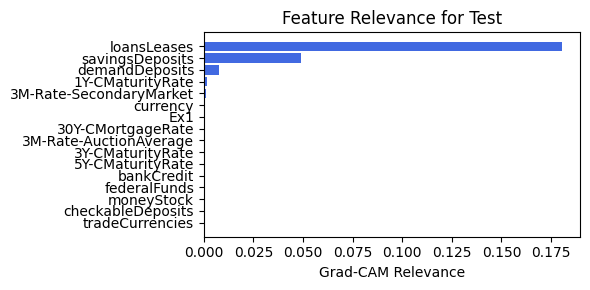

In [87]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=9, lamb=1e-05, steps=40, filename=filename_1, opt_col_val=9)

### 1.1.10 width=[15, 6, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=9

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.37e-01 | eval_loss: 1.91e-01 | reg: 2.64e+01 |: 100%|█| 40/40 [00:14<00:00,  2.69it/

saving model version 0.1
Best epoch 24
0.2271515130996704
M_KAN Relevance: 0.12163688242435455
CNN Relevance: 0.8783631324768066
[('checkableDeposits', 0.4404591), ('tradeCurrencies', 0.33881757), ('currency', 0.31601712), ('3Y-CMaturityRate', 0.28293622), ('demandDeposits', 0.27730656), ('1Y-CMaturityRate', 0.27163774), ('30Y-CMortgageRate', 0.26829588), ('5Y-CMaturityRate', 0.2651769), ('moneyStock', 0.25623137), ('loansLeases', 0.23894243), ('federalFunds', 0.23426966), ('3M-Rate-SecondaryMarket', 0.2321975), ('3M-Rate-AuctionAverage', 0.19551241), ('bankCredit', 0.18711743), ('savingsDeposits', 0.16539596)]


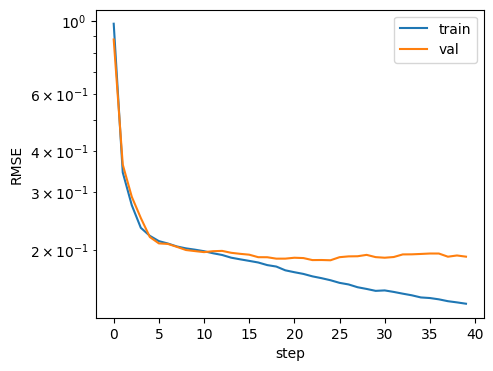

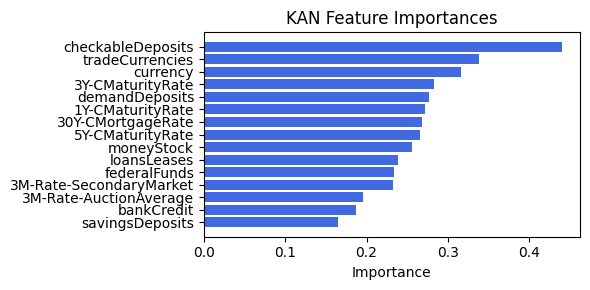

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.40it/s]

[('loansLeases', 0.24758688625214356), ('savingsDeposits', 0.10425229891247692), ('Ex1', 0.01978250596494902), ('demandDeposits', 0.013197872251094808), ('3M-Rate-SecondaryMarket', 0.008274198270269803), ('1Y-CMaturityRate', 0.002071816296804519), ('tradeCurrencies', 0.0016282024571583386), ('currency', 0.0006726758820669992), ('5Y-CMaturityRate', 0.00024016808990078668), ('bankCredit', 0.00013326054128507772), ('30Y-CMortgageRate', 4.005308396049908e-05), ('3M-Rate-AuctionAverage', 2.6479576315198626e-05), ('3Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0)]


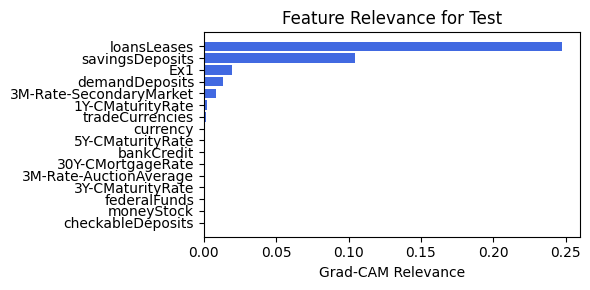

In [88]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=9, lamb=1e-05, steps=40, filename=filename_1, opt_col_val=9)

### 1.1.11 width=[15, 6, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=12

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.59e-01 | eval_loss: 1.78e-01 | reg: 3.21e+01 |: 100%|█| 40/40 [00:13<00:00,  3.02it/

saving model version 0.1
Best epoch 36
0.2287575900554657
M_KAN Relevance: 0.13317757844924927
CNN Relevance: 0.8668224215507507
[('tradeCurrencies', 0.1823315), ('checkableDeposits', 0.16977262), ('3M-Rate-SecondaryMarket', 0.16209254), ('moneyStock', 0.1617515), ('federalFunds', 0.16051006), ('bankCredit', 0.15506431), ('30Y-CMortgageRate', 0.14460565), ('1Y-CMaturityRate', 0.1296892), ('5Y-CMaturityRate', 0.12887907), ('currency', 0.12815884), ('loansLeases', 0.119778), ('savingsDeposits', 0.10913532), ('3Y-CMaturityRate', 0.106233925), ('3M-Rate-AuctionAverage', 0.102015525), ('demandDeposits', 0.077567294)]


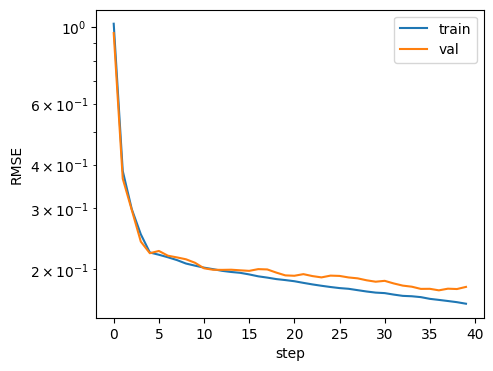

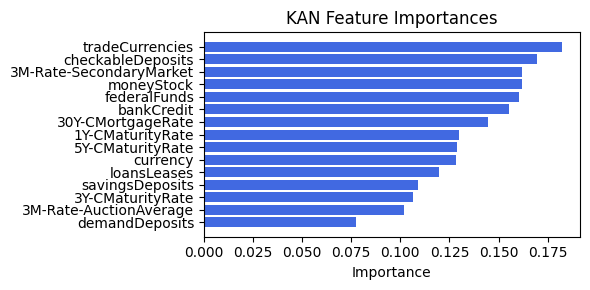

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.17it/s]


[('loansLeases', 0.07980544909480072), ('tradeCurrencies', 0.046278669685125354), ('demandDeposits', 0.0047755295455100995), ('3M-Rate-SecondaryMarket', 0.001002882562932514), ('1Y-CMaturityRate', 0.0007754386180923099), ('3M-Rate-AuctionAverage', 0.0003166889860516503), ('30Y-CMortgageRate', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('savingsDeposits', 0.0), ('Ex1', 0.0)]


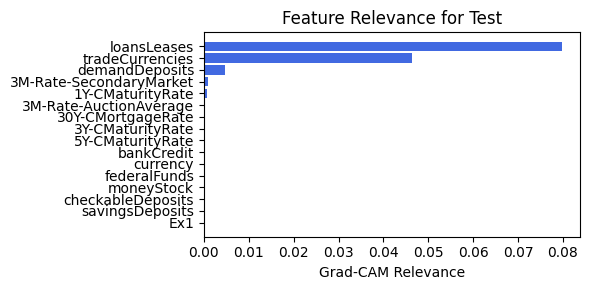

In [89]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=12, lamb=1e-05, steps=40, filename=filename_1, opt_col_val=12)

### 1.1.12 width=[15, 6, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=12

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.61e-01 | eval_loss: 1.86e-01 | reg: 3.16e+01 |: 100%|█| 40/40 [00:12<00:00,  3.14it/

saving model version 0.1
Best epoch 37
0.1988229900598526
M_KAN Relevance: 0.2067822366952896
CNN Relevance: 0.7932177782058716
[('loansLeases', 0.20922819), ('federalFunds', 0.17760882), ('3M-Rate-SecondaryMarket', 0.16844462), ('savingsDeposits', 0.14116873), ('30Y-CMortgageRate', 0.13230479), ('1Y-CMaturityRate', 0.132249), ('currency', 0.12958188), ('checkableDeposits', 0.12595622), ('tradeCurrencies', 0.12508011), ('moneyStock', 0.1198435), ('bankCredit', 0.11292084), ('3M-Rate-AuctionAverage', 0.10572487), ('5Y-CMaturityRate', 0.091768265), ('3Y-CMaturityRate', 0.08068642), ('demandDeposits', 0.07426225)]


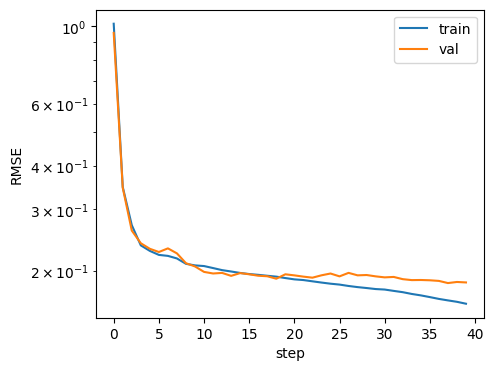

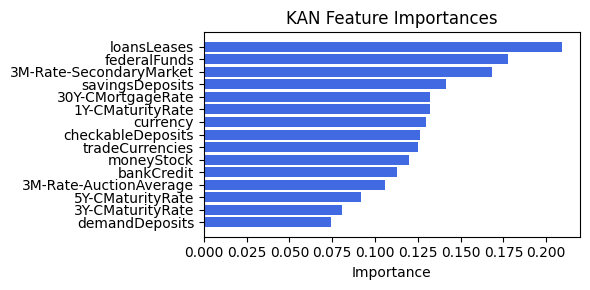

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.14it/s]

[('loansLeases', 0.06207287979888774), ('savingsDeposits', 0.01661003026224318), ('1Y-CMaturityRate', 0.0015290771211896625), ('3M-Rate-SecondaryMarket', 0.00025428049266338346), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


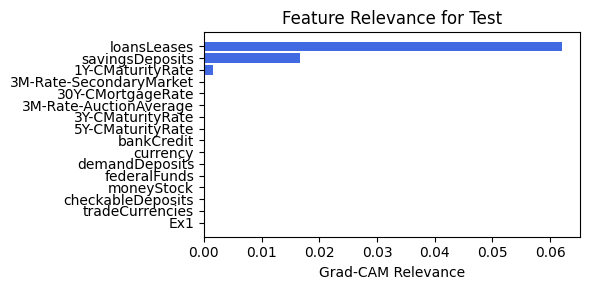

In [90]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=12, lamb=1e-05, steps=40, filename=filename_1, opt_col_val=12)

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.62e-01 | eval_loss: 1.84e-01 | reg: 3.51e+01 |: 100%|█| 40/40 [00:12<00:00,  3.21it/

saving model version 0.1
Best epoch 37
0.2093443125486374
M_KAN Relevance: 0.2012813538312912
CNN Relevance: 0.7987186312675476
[('checkableDeposits', 0.19596504), ('loansLeases', 0.16501708), ('tradeCurrencies', 0.14622878), ('30Y-CMortgageRate', 0.14094904), ('bankCredit', 0.13629113), ('moneyStock', 0.12946343), ('5Y-CMaturityRate', 0.11469629), ('currency', 0.113015085), ('3M-Rate-SecondaryMarket', 0.11264485), ('federalFunds', 0.101770245), ('3Y-CMaturityRate', 0.099745445), ('demandDeposits', 0.09377741), ('1Y-CMaturityRate', 0.09210953), ('3M-Rate-AuctionAverage', 0.09091293), ('savingsDeposits', 0.08708644)]


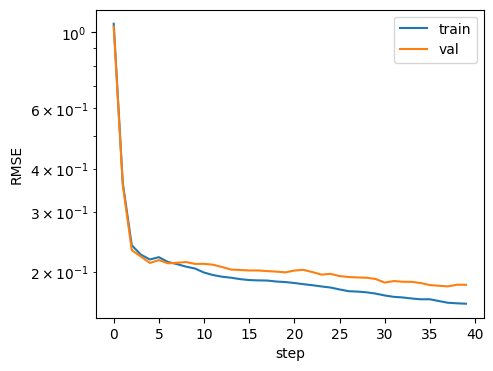

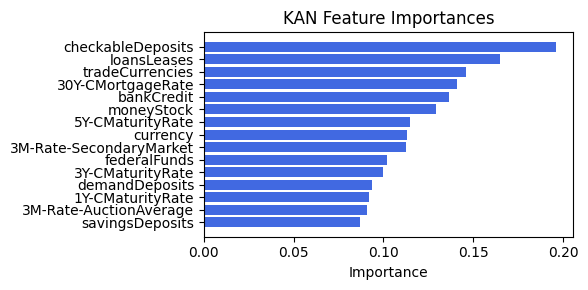

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.37it/s]


[('loansLeases', 0.3807181613076301), ('tradeCurrencies', 0.07947038324727189), ('demandDeposits', 0.029479320656641255), ('3Y-CMaturityRate', 0.012077707619894119), ('savingsDeposits', 0.007958023466995829), ('1Y-CMaturityRate', 0.0008914350044159662), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3M-Rate-SecondaryMarket', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


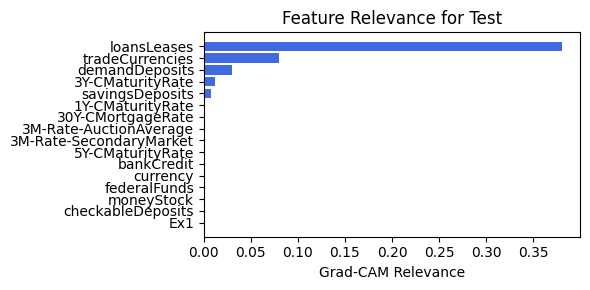

In [100]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=12, lamb=1e-06, steps=40)

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.43e-01 | eval_loss: 1.95e-01 | reg: 3.13e+01 |: 100%|█| 50/50 [00:17<00:00,  2.78it/

saving model version 0.1
Best epoch 24
0.22078965604305267
M_KAN Relevance: 0.16170795261859894
CNN Relevance: 0.8382920622825623
[('checkableDeposits', 0.31123313), ('moneyStock', 0.2967087), ('tradeCurrencies', 0.28379905), ('loansLeases', 0.27746785), ('federalFunds', 0.27732775), ('3Y-CMaturityRate', 0.24150777), ('30Y-CMortgageRate', 0.23684339), ('currency', 0.23427133), ('5Y-CMaturityRate', 0.21122226), ('1Y-CMaturityRate', 0.16692063), ('3M-Rate-SecondaryMarket', 0.16522239), ('3M-Rate-AuctionAverage', 0.15278316), ('savingsDeposits', 0.15238951), ('demandDeposits', 0.14578009), ('bankCredit', 0.13901943)]


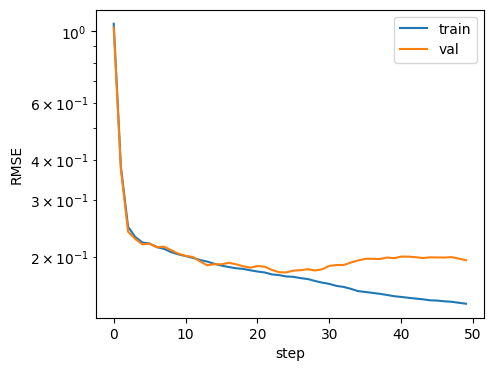

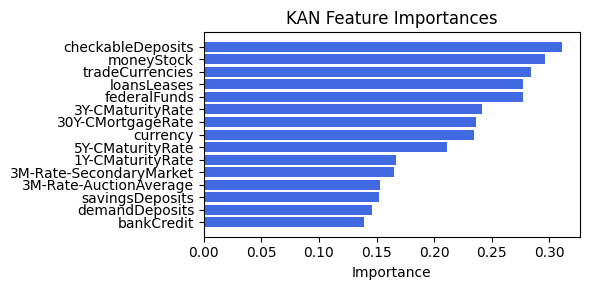

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  8.06it/s]


[('loansLeases', 0.396561888986755), ('tradeCurrencies', 0.0736896228932199), ('savingsDeposits', 0.06243460221726092), ('demandDeposits', 0.053608785763138996), ('3M-Rate-SecondaryMarket', 0.004826912177460534), ('1Y-CMaturityRate', 0.0025792962028866723), ('30Y-CMortgageRate', 1.952845292786757e-05), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


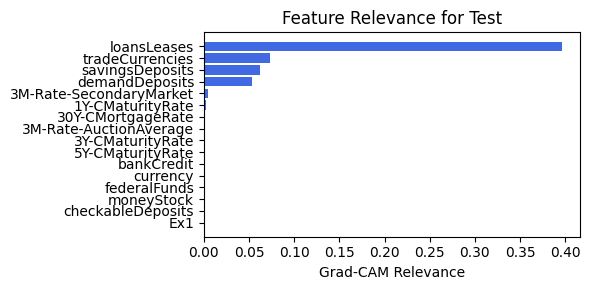

In [102]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=12, lamb=1e-07, steps=50)

### 1.1.13 width=[15, 6, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=15

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.67e-01 | eval_loss: 1.97e-01 | reg: 2.88e+01 |: 100%|█| 40/40 [00:13<00:00,  3.05it/

saving model version 0.1
Best epoch 34
0.21957673132419586
M_KAN Relevance: 0.12357223033905029
CNN Relevance: 0.8764277696609497
[('checkableDeposits', 0.27329433), ('tradeCurrencies', 0.20968962), ('loansLeases', 0.18625844), ('moneyStock', 0.1828199), ('federalFunds', 0.17878442), ('1Y-CMaturityRate', 0.17387083), ('5Y-CMaturityRate', 0.1720225), ('3Y-CMaturityRate', 0.16293587), ('3M-Rate-SecondaryMarket', 0.15984039), ('bankCredit', 0.14813015), ('savingsDeposits', 0.13981695), ('30Y-CMortgageRate', 0.1395972), ('3M-Rate-AuctionAverage', 0.11289418), ('demandDeposits', 0.109300554), ('currency', 0.10031878)]


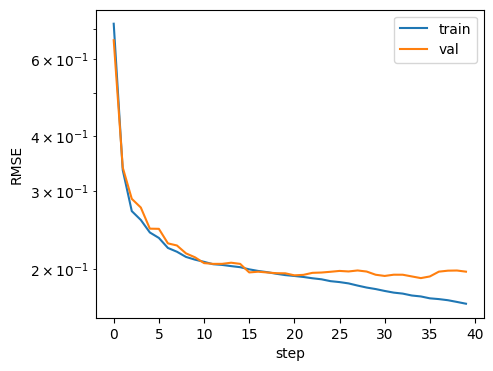

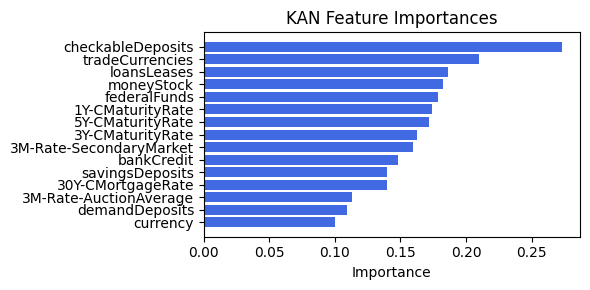

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.51it/s]


[('loansLeases', 0.1904229248840628), ('savingsDeposits', 0.010028339490028364), ('demandDeposits', 0.006254889221773261), ('1Y-CMaturityRate', 0.0036782440330301014), ('3M-Rate-SecondaryMarket', 0.0027269847868453888), ('3M-Rate-AuctionAverage', 0.0012440834726606096), ('currency', 0.00044237345989261355), ('30Y-CMortgageRate', 0.0003601843402499244), ('bankCredit', 0.000309930413606621), ('5Y-CMaturityRate', 5.444953151579414e-05), ('3Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


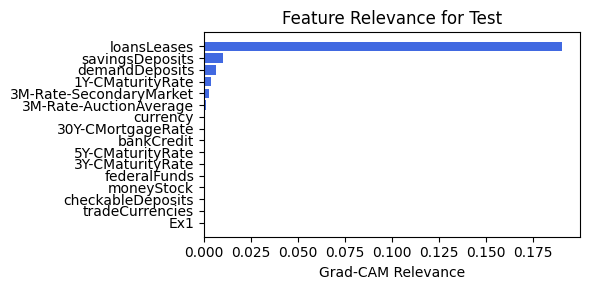

In [91]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=15, lamb=1e-05, steps=40, filename=filename_1, opt_col_val=15)

### 1.1.10 width=[15, 6, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=15

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.67e-01 | eval_loss: 1.84e-01 | reg: 2.66e+01 |: 100%|█| 40/40 [00:12<00:00,  3.30it/

saving model version 0.1
Best epoch 35
0.22975236177444458
M_KAN Relevance: 0.07709774374961853
CNN Relevance: 0.9229022860527039
[('checkableDeposits', 0.23580033), ('3Y-CMaturityRate', 0.1636568), ('moneyStock', 0.16355148), ('currency', 0.15196805), ('tradeCurrencies', 0.14993796), ('savingsDeposits', 0.1399202), ('5Y-CMaturityRate', 0.13916084), ('3M-Rate-SecondaryMarket', 0.13528416), ('bankCredit', 0.13411218), ('30Y-CMortgageRate', 0.13218713), ('federalFunds', 0.12078771), ('demandDeposits', 0.12034776), ('loansLeases', 0.10644388), ('1Y-CMaturityRate', 0.105964534), ('3M-Rate-AuctionAverage', 0.10488391)]


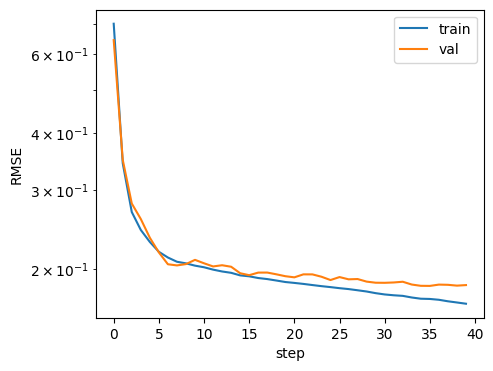

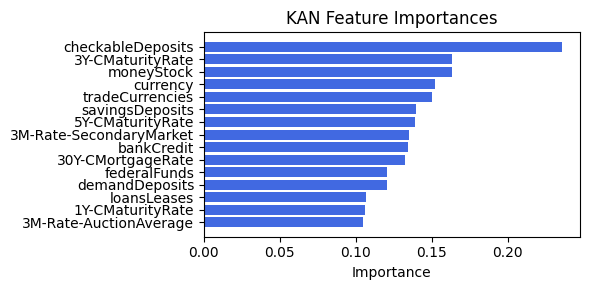

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.53it/s]

[('loansLeases', 0.20048541655497892), ('demandDeposits', 0.12233330940029451), ('3Y-CMaturityRate', 0.09840390172653965), ('1Y-CMaturityRate', 0.0686429073923223), ('tradeCurrencies', 0.04231110858354008), ('moneyStock', 0.03914209249473753), ('bankCredit', 0.03640464333639968), ('5Y-CMaturityRate', 0.03518694462476387), ('federalFunds', 0.035130724907919235), ('savingsDeposits', 0.027928262434211537), ('30Y-CMortgageRate', 0.021470442774339713), ('3M-Rate-AuctionAverage', 0.02140844599122093), ('checkableDeposits', 0.01143462675002714), ('currency', 0.008730648470199888), ('3M-Rate-SecondaryMarket', 0.006386814404478563), ('Ex1', 0.003696251477092682)]


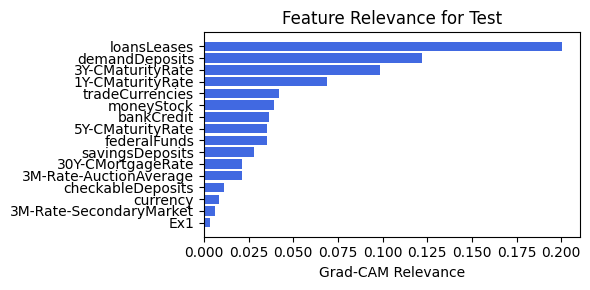

In [92]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=15, lamb=1e-05, steps=40, filename=filename_1, opt_col_val=15)

## 1.2 width=[15, 1, 1], grid=5, lamb=1e-05

### 1.2.1 width=[15, 1, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=1

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.49e-01 | eval_loss: 1.94e-01 | reg: 1.38e+01 |: 100%|█| 40/40 [00:12<00:00,  3.10it/

saving model version 0.1
Best epoch 19
0.2613905072212219
M_KAN Relevance: 0.03829760476946831
CNN Relevance: 0.9617024064064026
[('5Y-CMaturityRate', 0.46632433), ('moneyStock', 0.3787567), ('1Y-CMaturityRate', 0.360011), ('tradeCurrencies', 0.32933962), ('loansLeases', 0.31247756), ('30Y-CMortgageRate', 0.30923492), ('3M-Rate-SecondaryMarket', 0.2566821), ('3Y-CMaturityRate', 0.23188569), ('3M-Rate-AuctionAverage', 0.2267038), ('currency', 0.21812838), ('bankCredit', 0.17691389), ('federalFunds', 0.16600613), ('savingsDeposits', 0.14686124), ('demandDeposits', 0.11289054), ('checkableDeposits', 0.08806925)]


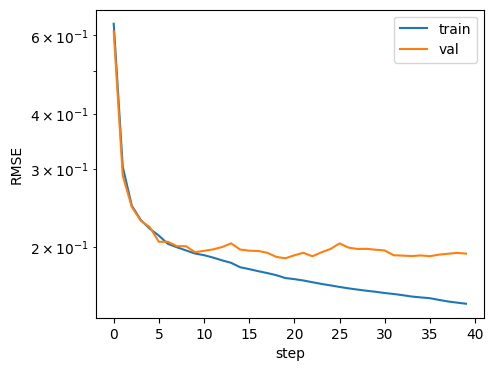

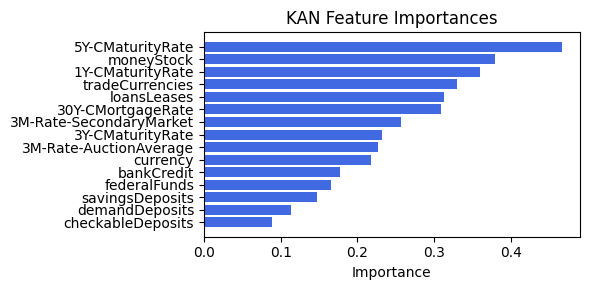

Computing Grad-CAM: 100%|██████████| 210/210 [00:15<00:00, 13.54it/s]

[('loansLeases', 0.25311767936994634), ('savingsDeposits', 0.11495409949039596), ('tradeCurrencies', 0.08182131405032816), ('Ex1', 0.023695200211590245), ('demandDeposits', 0.015383579935656772), ('3M-Rate-SecondaryMarket', 0.005497659246126811), ('currency', 0.0007741146853991917), ('federalFunds', 0.00020668478682637215), ('1Y-CMaturityRate', 0.0), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0)]


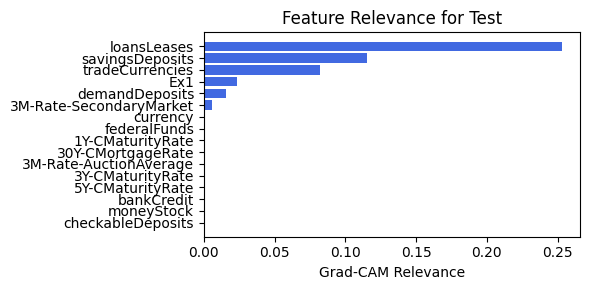

In [93]:
train_and_plot_relevance(Model3_1, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=1, lamb=1e-05, steps=40, filename=filename_1, opt_col_val=1)

### 1.2.2 width=[15, 1, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=1

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.52e-01 | eval_loss: 1.91e-01 | reg: 1.48e+01 |: 100%|█| 40/40 [00:11<00:00,  3.43it/

saving model version 0.1
Best epoch 29
0.22157429158687592
M_KAN Relevance: 0.0424509160220623
CNN Relevance: 0.9575490951538086
[('1Y-CMaturityRate', 0.4123005), ('federalFunds', 0.3536651), ('5Y-CMaturityRate', 0.277263), ('currency', 0.26680455), ('loansLeases', 0.26661125), ('30Y-CMortgageRate', 0.26642495), ('3M-Rate-SecondaryMarket', 0.25811926), ('savingsDeposits', 0.23421185), ('moneyStock', 0.16285959), ('demandDeposits', 0.1458471), ('checkableDeposits', 0.13978197), ('tradeCurrencies', 0.11686856), ('3Y-CMaturityRate', 0.11246134), ('bankCredit', 0.08767755), ('3M-Rate-AuctionAverage', 0.0817252)]


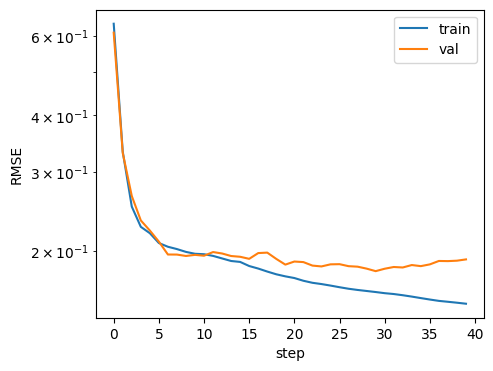

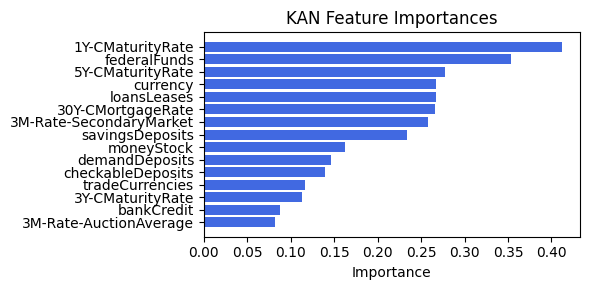

Computing Grad-CAM: 100%|██████████| 210/210 [00:16<00:00, 12.95it/s]


[('1Y-CMaturityRate', 0.17784779717524846), ('3M-Rate-SecondaryMarket', 0.022780627880932852), ('Ex1', 0.005123901225271679), ('currency', 0.0009663374118861698), ('3M-Rate-AuctionAverage', 0.000752950424239749), ('bankCredit', 0.00012937142025856745), ('federalFunds', 8.412428931998356e-06), ('5Y-CMaturityRate', 8.13857408329135e-06), ('30Y-CMortgageRate', 0.0), ('3Y-CMaturityRate', 0.0), ('demandDeposits', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('loansLeases', 0.0), ('savingsDeposits', 0.0), ('tradeCurrencies', 0.0)]


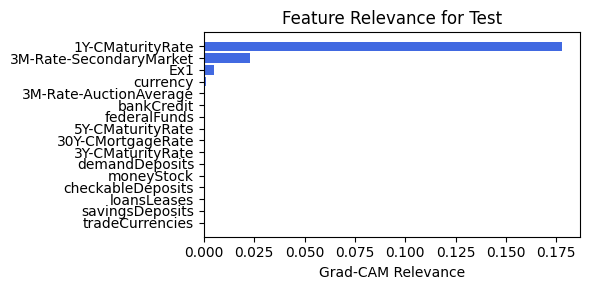

In [94]:
train_and_plot_relevance(Model3_1, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=1, lamb=1e-05, steps=40, filename=filename_1, opt_col_val=1)

### 1.2.3 width=[15, 1, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=2

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.96e-01 | eval_loss: 2.32e-01 | reg: 1.56e+01 |: 100%|█| 40/40 [00:13<00:00,  2.99it/

saving model version 0.1
Best epoch 38
0.26233312487602234
M_KAN Relevance: 0.16809789836406708
CNN Relevance: 0.8319020867347717
[('demandDeposits', 0.64221007), ('tradeCurrencies', 0.5434484), ('checkableDeposits', 0.41548127), ('3Y-CMaturityRate', 0.40293056), ('savingsDeposits', 0.283926), ('moneyStock', 0.26976377), ('30Y-CMortgageRate', 0.24572681), ('federalFunds', 0.2305365), ('1Y-CMaturityRate', 0.22573495), ('loansLeases', 0.21110551), ('3M-Rate-AuctionAverage', 0.16746527), ('bankCredit', 0.15997232), ('currency', 0.14948182), ('5Y-CMaturityRate', 0.13459086), ('3M-Rate-SecondaryMarket', 0.087697975)]


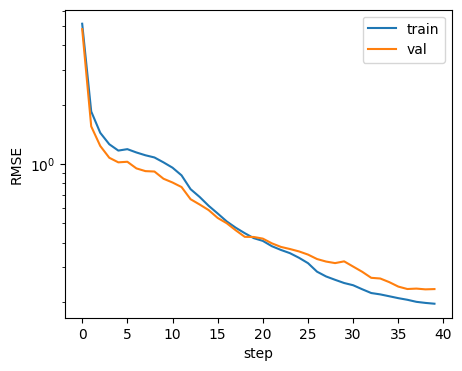

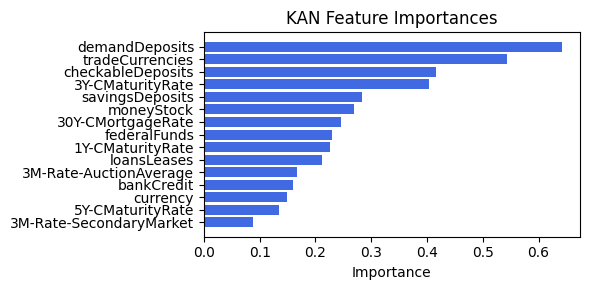

Computing Grad-CAM: 100%|██████████| 210/210 [00:14<00:00, 14.16it/s]

[('loansLeases', 0.3165777117767859), ('tradeCurrencies', 0.12689175814101916), ('savingsDeposits', 0.10610145563148848), ('5Y-CMaturityRate', 0.08497524493861766), ('bankCredit', 0.08282293755383718), ('3M-Rate-SecondaryMarket', 0.07971392871945032), ('currency', 0.07760095816282998), ('3M-Rate-AuctionAverage', 0.03999421868828081), ('30Y-CMortgageRate', 0.03979744468039523), ('1Y-CMaturityRate', 0.03902934377214738), ('3Y-CMaturityRate', 0.030833836041745687), ('checkableDeposits', 0.02923516844000135), ('demandDeposits', 0.01769736871078965), ('Ex1', 0.011832476921734355), ('moneyStock', 0.008638667448290756), ('federalFunds', 0.008471378624173147)]


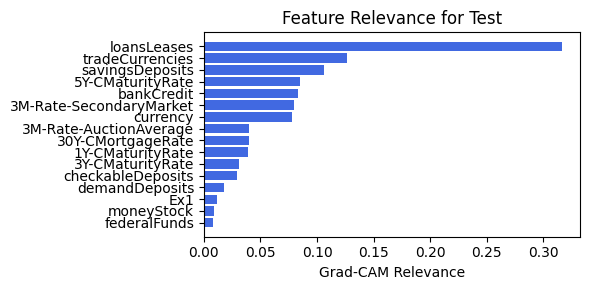

In [95]:
train_and_plot_relevance(Model3_1, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=2, lamb=1e-05, steps=40, filename=filename_1, opt_col_val=2)

### 1.2.4 width=[15, 1, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=2

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.55e-01 | eval_loss: 1.95e-01 | reg: 1.28e+01 |: 100%|█| 40/40 [00:11<00:00,  3.43it/

saving model version 0.1
Best epoch 27
0.24395398795604706
M_KAN Relevance: 0.03971379995346069
CNN Relevance: 0.9602862596511841
[('loansLeases', 2.319814), ('checkableDeposits', 2.145227), ('currency', 1.5960943), ('3M-Rate-SecondaryMarket', 1.3802215), ('bankCredit', 1.0984855), ('5Y-CMaturityRate', 1.034393), ('3Y-CMaturityRate', 0.90521145), ('federalFunds', 0.89273846), ('tradeCurrencies', 0.7333277), ('demandDeposits', 0.5782316), ('3M-Rate-AuctionAverage', 0.48601544), ('moneyStock', 0.4469352), ('30Y-CMortgageRate', 0.29707423), ('savingsDeposits', 0.2693827), ('1Y-CMaturityRate', 0.17706035)]


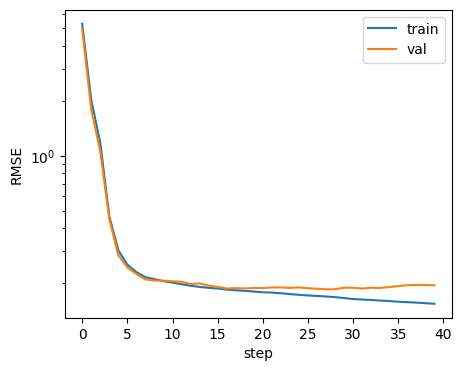

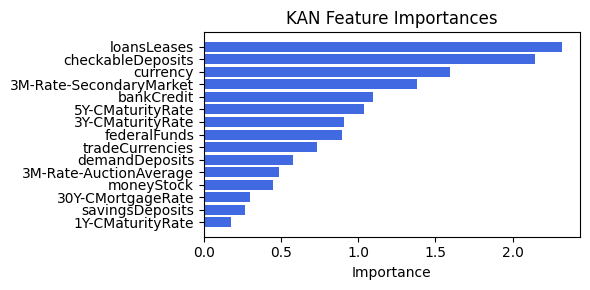

Computing Grad-CAM: 100%|██████████| 210/210 [00:16<00:00, 12.74it/s]


[('checkableDeposits', 0.36370878084784464), ('3M-Rate-SecondaryMarket', 0.36200194851650547), ('currency', 0.057122625851202646), ('loansLeases', 0.005208333333333333), ('1Y-CMaturityRate', 0.0), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('savingsDeposits', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


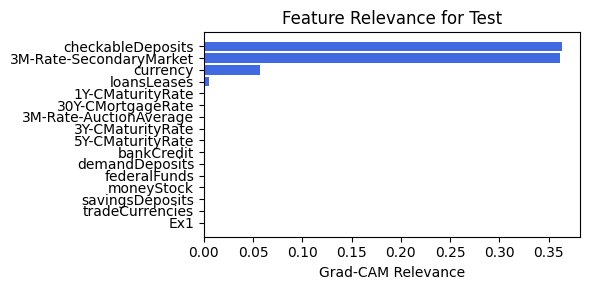

In [96]:
train_and_plot_relevance(Model3_1, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=2, lamb=1e-05, steps=40, filename=filename_1, opt_col_val=2)

### 1.2.5 width=[15, 1, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=3

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.63e-01 | eval_loss: 1.93e-01 | reg: 1.51e+01 |: 100%|█| 40/40 [00:11<00:00,  3.45it/

saving model version 0.1
Best epoch 37
0.21184764802455902
M_KAN Relevance: 0.06732836365699768
CNN Relevance: 0.9326716661453247
[('3M-Rate-SecondaryMarket', 0.13250926), ('moneyStock', 0.130071), ('3Y-CMaturityRate', 0.12008309), ('30Y-CMortgageRate', 0.12001007), ('bankCredit', 0.11961461), ('currency', 0.087842226), ('tradeCurrencies', 0.08210535), ('loansLeases', 0.0748779), ('1Y-CMaturityRate', 0.06540355), ('demandDeposits', 0.053606562), ('savingsDeposits', 0.052024484), ('federalFunds', 0.038972285), ('5Y-CMaturityRate', 0.03282855), ('3M-Rate-AuctionAverage', 0.01722854), ('checkableDeposits', 0.016037272)]


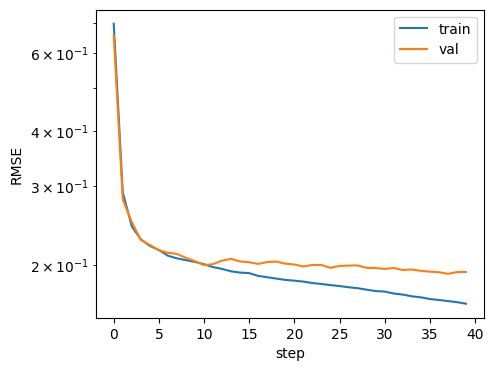

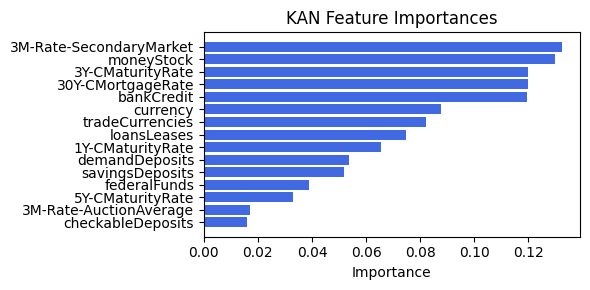

Computing Grad-CAM: 100%|██████████| 210/210 [00:15<00:00, 13.90it/s]


[('1Y-CMaturityRate', 0.13087323052542552), ('3Y-CMaturityRate', 0.026465080855857758), ('demandDeposits', 0.016940755179772775), ('3M-Rate-SecondaryMarket', 0.016528786364055817), ('currency', 0.011658160262214508), ('loansLeases', 0.010465800787122654), ('30Y-CMortgageRate', 0.0056147876993886065), ('tradeCurrencies', 0.0038851622126198243), ('moneyStock', 0.002166248935585221), ('3M-Rate-AuctionAverage', 0.0011050587253911154), ('Ex1', 0.0006712543112891061), ('federalFunds', 0.0005329974558359633), ('savingsDeposits', 0.0003799375490329805), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('checkableDeposits', 0.0)]


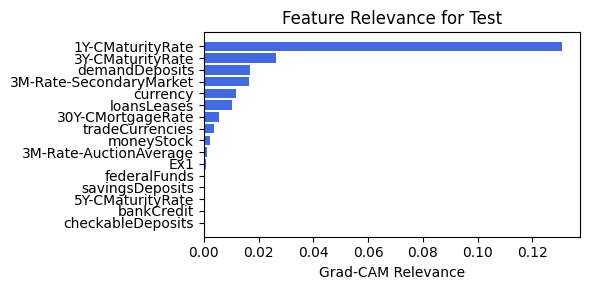

In [97]:
train_and_plot_relevance(Model3_1, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=4, lamb=1e-05, steps=40, filename=filename_1, opt_col_val=3)

### 1.2.6 width=[15, 1, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=3

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.63e-01 | eval_loss: 1.93e-01 | reg: 1.51e+01 |: 100%|█| 40/40 [00:11<00:00,  3.46it/

saving model version 0.1
Best epoch 37
0.21184764802455902
M_KAN Relevance: 0.06732836365699768
CNN Relevance: 0.9326716661453247
[('3M-Rate-SecondaryMarket', 0.13250926), ('moneyStock', 0.130071), ('3Y-CMaturityRate', 0.12008309), ('30Y-CMortgageRate', 0.12001007), ('bankCredit', 0.11961461), ('currency', 0.087842226), ('tradeCurrencies', 0.08210535), ('loansLeases', 0.0748779), ('1Y-CMaturityRate', 0.06540355), ('demandDeposits', 0.053606562), ('savingsDeposits', 0.052024484), ('federalFunds', 0.038972285), ('5Y-CMaturityRate', 0.03282855), ('3M-Rate-AuctionAverage', 0.01722854), ('checkableDeposits', 0.016037272)]


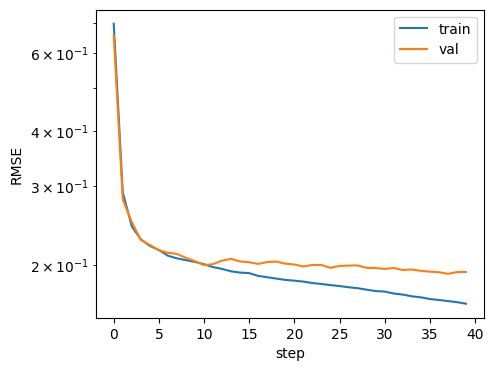

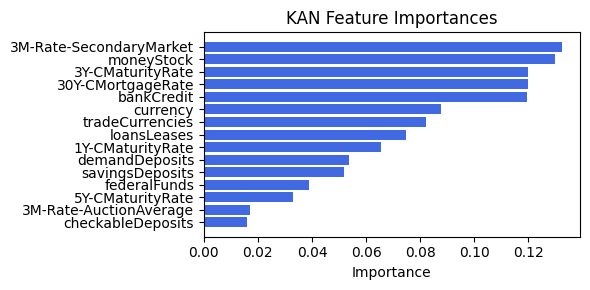

Computing Grad-CAM: 100%|██████████| 210/210 [00:16<00:00, 13.02it/s]

[('1Y-CMaturityRate', 0.13087323052542552), ('3Y-CMaturityRate', 0.026465080855857758), ('demandDeposits', 0.016940755179772775), ('3M-Rate-SecondaryMarket', 0.016528786364055817), ('currency', 0.011658160262214508), ('loansLeases', 0.010465800787122654), ('30Y-CMortgageRate', 0.0056147876993886065), ('tradeCurrencies', 0.0038851622126198243), ('moneyStock', 0.002166248935585221), ('3M-Rate-AuctionAverage', 0.0011050587253911154), ('Ex1', 0.0006712543112891061), ('federalFunds', 0.0005329974558359633), ('savingsDeposits', 0.0003799375490329805), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('checkableDeposits', 0.0)]


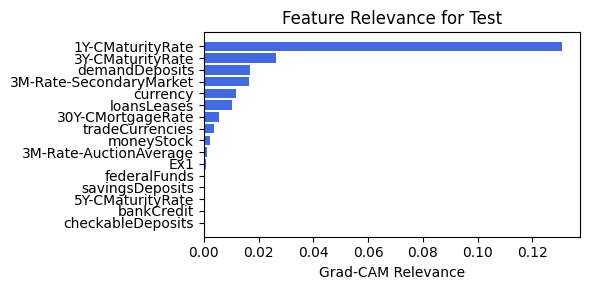

In [98]:
train_and_plot_relevance(Model3_1, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=4, lamb=1e-05, steps=40, filename=filename_1, opt_col_val=3)

### 1.2.7 width=[15, 1, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=4

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.63e-01 | eval_loss: 1.93e-01 | reg: 1.51e+01 |: 100%|█| 40/40 [00:13<00:00,  2.94it/

saving model version 0.1
Best epoch 37
0.21184764802455902
M_KAN Relevance: 0.06732836365699768
CNN Relevance: 0.9326716661453247
[('3M-Rate-SecondaryMarket', 0.13250926), ('moneyStock', 0.130071), ('3Y-CMaturityRate', 0.12008309), ('30Y-CMortgageRate', 0.12001007), ('bankCredit', 0.11961461), ('currency', 0.087842226), ('tradeCurrencies', 0.08210535), ('loansLeases', 0.0748779), ('1Y-CMaturityRate', 0.06540355), ('demandDeposits', 0.053606562), ('savingsDeposits', 0.052024484), ('federalFunds', 0.038972285), ('5Y-CMaturityRate', 0.03282855), ('3M-Rate-AuctionAverage', 0.01722854), ('checkableDeposits', 0.016037272)]


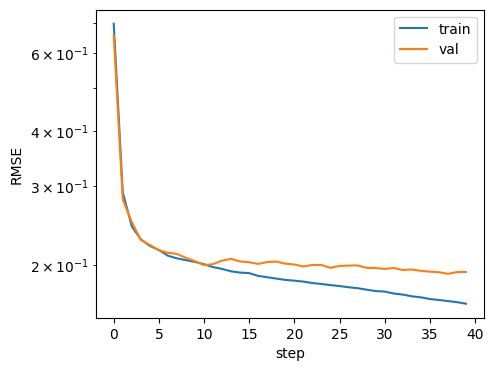

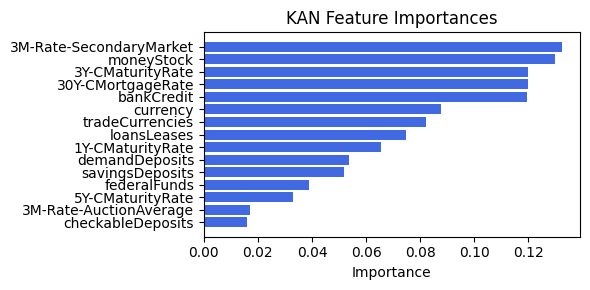

Computing Grad-CAM: 100%|██████████| 210/210 [00:16<00:00, 12.75it/s]


[('1Y-CMaturityRate', 0.13087323059638342), ('3Y-CMaturityRate', 0.026465080855857758), ('demandDeposits', 0.016940755179772775), ('3M-Rate-SecondaryMarket', 0.016528786364055817), ('currency', 0.011658160262214508), ('loansLeases', 0.010465800787122654), ('30Y-CMortgageRate', 0.0056147876993886065), ('tradeCurrencies', 0.0038851622126198243), ('moneyStock', 0.002166248935585221), ('3M-Rate-AuctionAverage', 0.0011050587253911154), ('Ex1', 0.0006712543112891061), ('federalFunds', 0.0005329974558359633), ('savingsDeposits', 0.0003799375490329805), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('checkableDeposits', 0.0)]


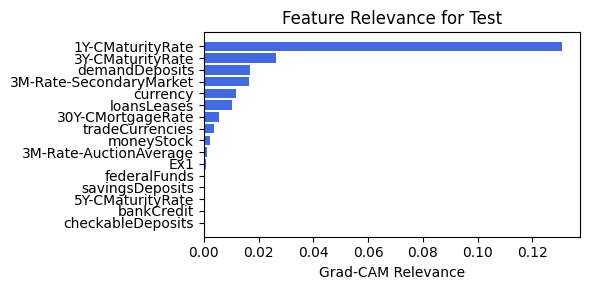

In [99]:
train_and_plot_relevance(Model3_1, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=4, lamb=1e-05, steps=40, filename=filename_1, opt_col_val=4)

### 1.2.8 width=[15, 1, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=4

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.63e-01 | eval_loss: 1.93e-01 | reg: 1.51e+01 |: 100%|█| 40/40 [00:11<00:00,  3.48it/

saving model version 0.1
Best epoch 37
0.21184764802455902
M_KAN Relevance: 0.06732836365699768
CNN Relevance: 0.9326716661453247
[('3M-Rate-SecondaryMarket', 0.13250926), ('moneyStock', 0.130071), ('3Y-CMaturityRate', 0.12008309), ('30Y-CMortgageRate', 0.12001007), ('bankCredit', 0.11961461), ('currency', 0.087842226), ('tradeCurrencies', 0.08210535), ('loansLeases', 0.0748779), ('1Y-CMaturityRate', 0.06540355), ('demandDeposits', 0.053606562), ('savingsDeposits', 0.052024484), ('federalFunds', 0.038972285), ('5Y-CMaturityRate', 0.03282855), ('3M-Rate-AuctionAverage', 0.01722854), ('checkableDeposits', 0.016037272)]


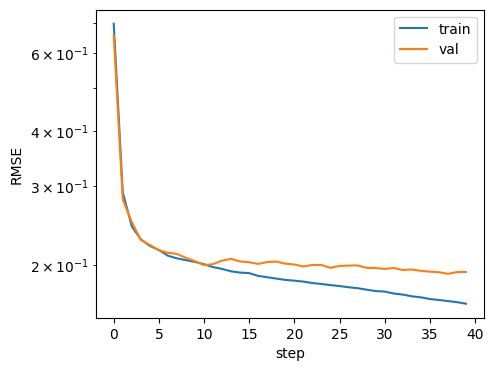

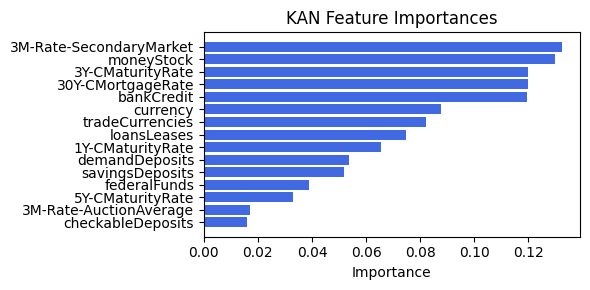

Computing Grad-CAM: 100%|██████████| 210/210 [00:17<00:00, 12.17it/s]


[('1Y-CMaturityRate', 0.13087323052542552), ('3Y-CMaturityRate', 0.026465080855857758), ('demandDeposits', 0.016940755179772775), ('3M-Rate-SecondaryMarket', 0.016528786364055817), ('currency', 0.011658160262214508), ('loansLeases', 0.010465800787122654), ('30Y-CMortgageRate', 0.0056147876993886065), ('tradeCurrencies', 0.0038851622126198243), ('moneyStock', 0.002166248935585221), ('3M-Rate-AuctionAverage', 0.0011050587253911154), ('Ex1', 0.0006712543112891061), ('federalFunds', 0.0005329974558359633), ('savingsDeposits', 0.0003799375490329805), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('checkableDeposits', 0.0)]


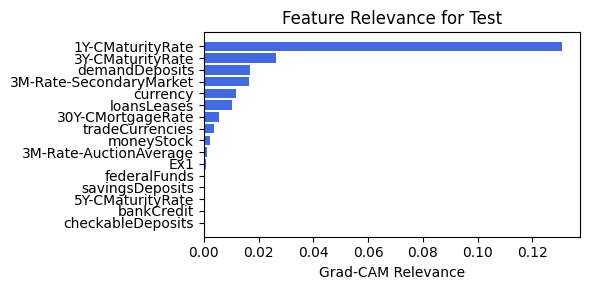

In [100]:
train_and_plot_relevance(Model3_1, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=4, lamb=1e-05, steps=40, filename=filename_1, opt_col_val=4)

### 1.2.9 width=[15, 1, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=5

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.37e-01 | eval_loss: 1.99e-01 | reg: 1.52e+01 |: 100%|█| 70/70 [00:24<00:00,  2.87it/

saving model version 0.1
Best epoch 47
0.20989322662353516
M_KAN Relevance: 0.05187230557203293
CNN Relevance: 0.9481277465820312
[('currency', 0.21744564), ('bankCredit', 0.18436582), ('loansLeases', 0.14135338), ('savingsDeposits', 0.13445652), ('tradeCurrencies', 0.11787987), ('30Y-CMortgageRate', 0.09937857), ('3M-Rate-AuctionAverage', 0.07197269), ('3M-Rate-SecondaryMarket', 0.066046536), ('3Y-CMaturityRate', 0.059864756), ('demandDeposits', 0.059490766), ('moneyStock', 0.04727363), ('1Y-CMaturityRate', 0.045261577), ('federalFunds', 0.029270615), ('5Y-CMaturityRate', 0.021840574), ('checkableDeposits', 0.0073807235)]


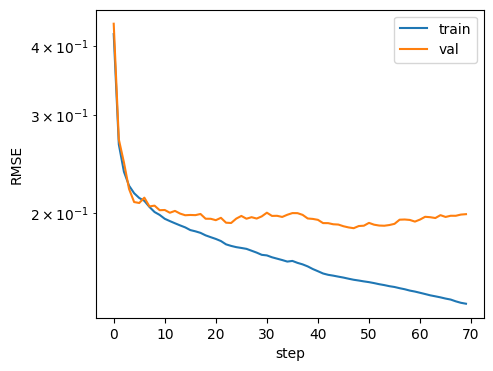

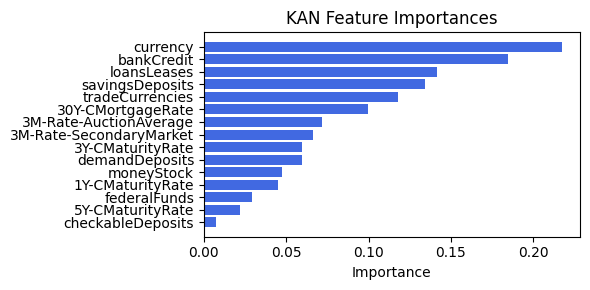

Computing Grad-CAM: 100%|██████████| 210/210 [00:19<00:00, 10.60it/s]


[('Ex1', 0.17768028091689173), ('loansLeases', 0.13852067616590785), ('savingsDeposits', 0.08789158112846227), ('checkableDeposits', 0.05584446633057225), ('demandDeposits', 0.05427677252640327), ('3Y-CMaturityRate', 0.048321090776534265), ('tradeCurrencies', 0.02893264591361263), ('currency', 0.006188746723013797), ('5Y-CMaturityRate', 0.0022155095121845427), ('bankCredit', 0.0018582439316170557), ('3M-Rate-SecondaryMarket', 0.0009322672904956908), ('1Y-CMaturityRate', 2.8300977178982327e-05), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0)]


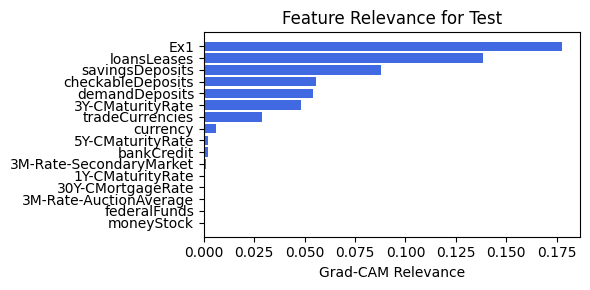

In [49]:
train_and_plot_relevance(Model3_1, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=5, lamb=1e-05, steps=70, filename=filename_1, opt_col_val=5)

### 1.2.10 width=[15, 1, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=5

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.37e-01 | eval_loss: 1.99e-01 | reg: 1.52e+01 |: 100%|█| 70/70 [00:23<00:00,  3.04it/

saving model version 0.1
Best epoch 47
0.20989322662353516
M_KAN Relevance: 0.05187230557203293
CNN Relevance: 0.9481277465820312
[('currency', 0.21744564), ('bankCredit', 0.18436582), ('loansLeases', 0.14135338), ('savingsDeposits', 0.13445652), ('tradeCurrencies', 0.11787987), ('30Y-CMortgageRate', 0.09937857), ('3M-Rate-AuctionAverage', 0.07197269), ('3M-Rate-SecondaryMarket', 0.066046536), ('3Y-CMaturityRate', 0.059864756), ('demandDeposits', 0.059490766), ('moneyStock', 0.04727363), ('1Y-CMaturityRate', 0.045261577), ('federalFunds', 0.029270615), ('5Y-CMaturityRate', 0.021840574), ('checkableDeposits', 0.0073807235)]


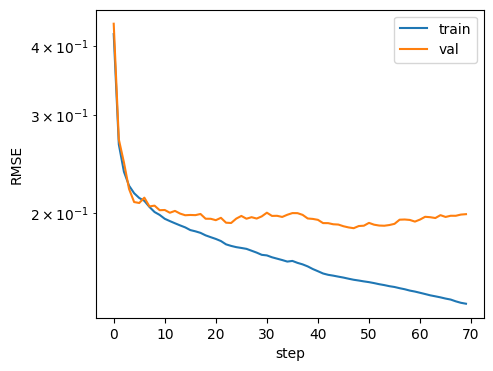

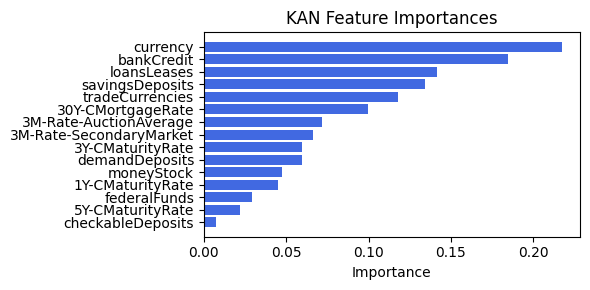

Computing Grad-CAM: 100%|██████████| 210/210 [00:22<00:00,  9.24it/s]


[('Ex1', 0.17768028091689173), ('loansLeases', 0.13852067616590785), ('savingsDeposits', 0.08789158112846227), ('checkableDeposits', 0.05584446633057225), ('demandDeposits', 0.05427677252640327), ('3Y-CMaturityRate', 0.048321090776534265), ('tradeCurrencies', 0.02893264591361263), ('currency', 0.006188746723013797), ('5Y-CMaturityRate', 0.0022155095121845427), ('bankCredit', 0.0018582439316170557), ('3M-Rate-SecondaryMarket', 0.0009322672904956908), ('1Y-CMaturityRate', 2.8300977178982327e-05), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0)]


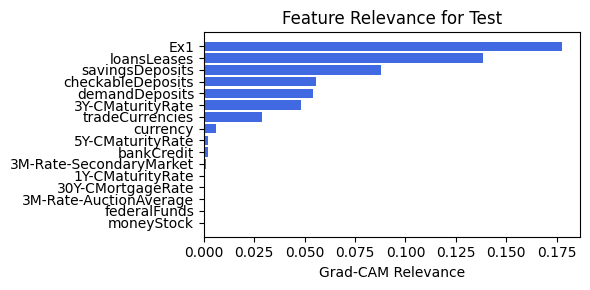

In [50]:
train_and_plot_relevance(Model3_1, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=5, lamb=1e-05, steps=70, filename=filename_1, opt_col_val=5)

### 1.2.11 width=[15, 1, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=6

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.34e-01 | eval_loss: 1.98e-01 | reg: 1.69e+01 |: 100%|█| 70/70 [00:22<00:00,  3.08it/


saving model version 0.1
Best epoch 30
0.22920766472816467
M_KAN Relevance: 0.029840553179383278
CNN Relevance: 0.9701594710350037
[('5Y-CMaturityRate', 0.39388558), ('3M-Rate-AuctionAverage', 0.38431725), ('currency', 0.25804907), ('30Y-CMortgageRate', 0.19865884), ('tradeCurrencies', 0.19847228), ('savingsDeposits', 0.18303004), ('3Y-CMaturityRate', 0.16909318), ('3M-Rate-SecondaryMarket', 0.14649384), ('loansLeases', 0.12721819), ('demandDeposits', 0.11252598), ('moneyStock', 0.09418221), ('checkableDeposits', 0.08659168), ('federalFunds', 0.08296876), ('bankCredit', 0.04790935), ('1Y-CMaturityRate', 0.028531943)]


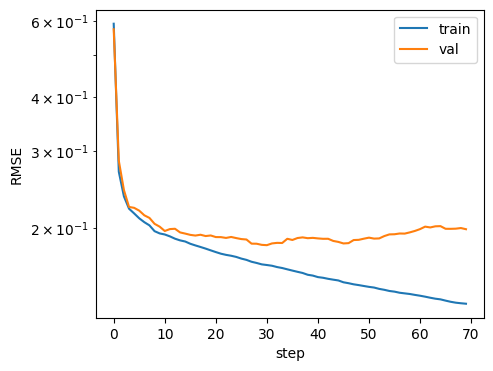

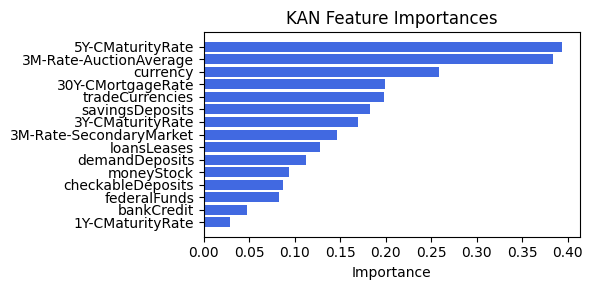

Computing Grad-CAM: 100%|██████████| 210/210 [00:19<00:00, 10.91it/s]

[('loansLeases', 0.10460609191504773), ('3M-Rate-SecondaryMarket', 0.09794130202028013), ('currency', 0.034175414733943484), ('3Y-CMaturityRate', 0.03361391957926874), ('demandDeposits', 0.02066895388332861), ('tradeCurrencies', 0.012876272280811377), ('savingsDeposits', 0.006917056543724833), ('Ex1', 0.0047849435104234585), ('1Y-CMaturityRate', 0.0027537251423512188), ('3M-Rate-AuctionAverage', 0.0017596484804969458), ('30Y-CMortgageRate', 0.0012065787045728593), ('checkableDeposits', 0.0005409718801577886), ('bankCredit', 0.000284237161810909), ('5Y-CMaturityRate', 0.00011511838861874171), ('federalFunds', 1.9038584183103272e-05), ('moneyStock', 0.0)]


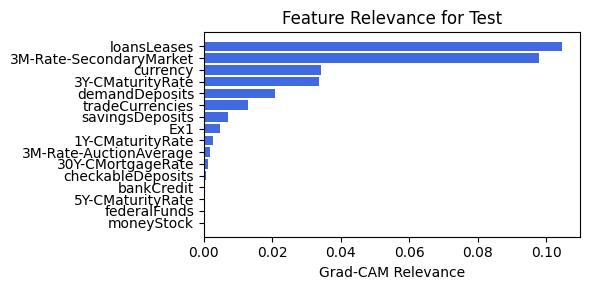

In [51]:
train_and_plot_relevance(Model3_1, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=6, lamb=1e-05, steps=70, filename=filename_1, opt_col_val=6)

### 1.2.12 width=[15, 1, 1], grid=5, lamb=1e-05 | cnn_bottleneck_dim=6

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.42e-01 | eval_loss: 1.97e-01 | reg: 1.82e+01 |: 100%|█| 70/70 [00:22<00:00,  3.11it/

saving model version 0.1
Best epoch 25
0.22837992012500763
M_KAN Relevance: 0.015605111606419086
CNN Relevance: 0.9843949675559998
[('5Y-CMaturityRate', 0.40288028), ('3M-Rate-AuctionAverage', 0.34034553), ('currency', 0.23240058), ('30Y-CMortgageRate', 0.19593498), ('tradeCurrencies', 0.1751702), ('savingsDeposits', 0.15712582), ('3Y-CMaturityRate', 0.15113981), ('loansLeases', 0.13902049), ('3M-Rate-SecondaryMarket', 0.12220714), ('checkableDeposits', 0.09997155), ('moneyStock', 0.091648206), ('demandDeposits', 0.0813962), ('bankCredit', 0.08063015), ('federalFunds', 0.05394357), ('1Y-CMaturityRate', 0.016523268)]


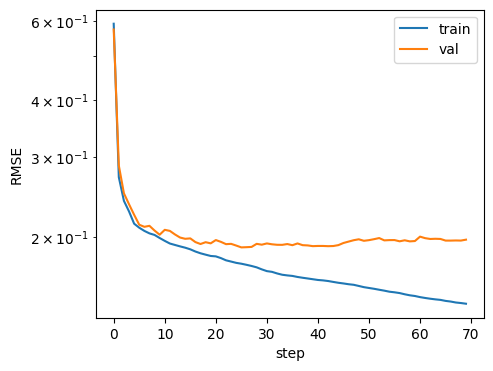

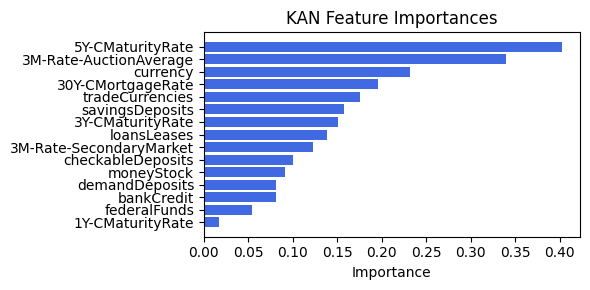

Computing Grad-CAM: 100%|██████████| 210/210 [00:19<00:00, 11.00it/s]


[('loansLeases', 0.35114126343812263), ('3M-Rate-SecondaryMarket', 0.20914324977036033), ('savingsDeposits', 0.10515140519308347), ('currency', 0.07967812001727344), ('demandDeposits', 0.06475991569902925), ('3Y-CMaturityRate', 0.03233050867593625), ('checkableDeposits', 0.02927781030358303), ('tradeCurrencies', 0.023677842100278214), ('1Y-CMaturityRate', 0.001695519969576881), ('Ex1', 0.0006611302733376978), ('federalFunds', 0.00027856026731786274), ('3M-Rate-AuctionAverage', 5.278220244993766e-06), ('30Y-CMortgageRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('moneyStock', 0.0)]


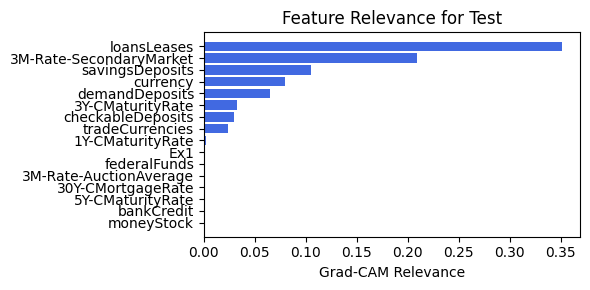

In [52]:
train_and_plot_relevance(Model3_1, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=6, lamb=1e-05, steps=70, filename=filename_1, opt_col_val=6)

## 1.3 width=[15, 6, 1], grid=7, lamb=1e-05

### 1.3.0a width=[15, 6, 1], grid=7, lamb=1e-05 | cnn_bottleneck_dim=1

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.71e-01 | eval_loss: 1.85e-01 | reg: 4.63e+01 |: 100%|█| 80/80 [00:25<00:00,  3.10it/

saving model version 0.1
Best epoch 48
0.2522439956665039
M_KAN Relevance: 0.8228941559791565
CNN Relevance: 0.17710581421852112
[('loansLeases', 0.1428957), ('moneyStock', 0.13453448), ('federalFunds', 0.12705073), ('tradeCurrencies', 0.11808749), ('checkableDeposits', 0.11749858), ('3Y-CMaturityRate', 0.09322419), ('3M-Rate-AuctionAverage', 0.09155564), ('demandDeposits', 0.0900207), ('savingsDeposits', 0.08828944), ('bankCredit', 0.077067815), ('3M-Rate-SecondaryMarket', 0.07547976), ('1Y-CMaturityRate', 0.07531555), ('currency', 0.07326128), ('30Y-CMortgageRate', 0.063993916), ('5Y-CMaturityRate', 0.049526215)]


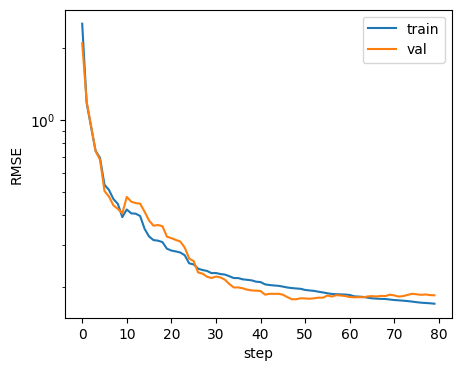

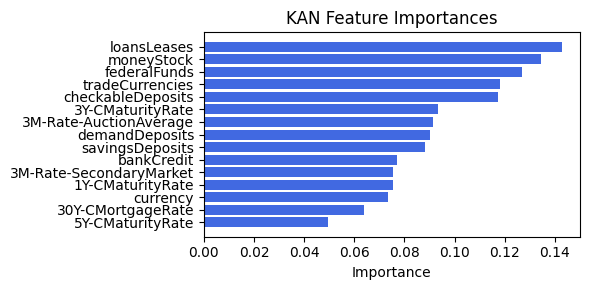

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.40it/s]

[('tradeCurrencies', 0.2935676565039016), ('loansLeases', 0.11705388520799932), ('savingsDeposits', 0.08296751800835842), ('Ex1', 0.06042898596441817), ('3M-Rate-SecondaryMarket', 0.01572956746178014), ('federalFunds', 0.010218084881836105), ('checkableDeposits', 0.009249178994269597), ('currency', 0.006407656697999863), ('3Y-CMaturityRate', 0.005890918239241555), ('5Y-CMaturityRate', 0.0056202941441110205), ('moneyStock', 0.005495542287826538), ('demandDeposits', 0.004978666593143273), ('bankCredit', 0.00492893623027374), ('30Y-CMortgageRate', 0.0026124809114705947), ('1Y-CMaturityRate', 0.002138728896776835), ('3M-Rate-AuctionAverage', 0.0013665377029350827)]


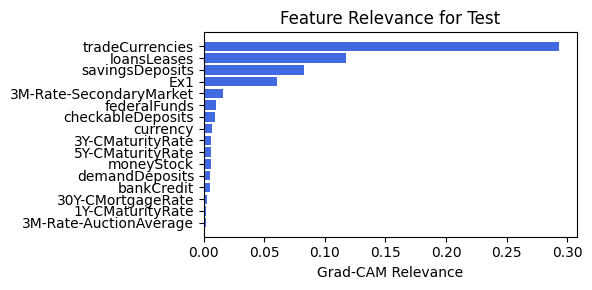

In [103]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=1, lamb=1e-05, steps=80, filename=filename_1, opt_col_val=1)

### 1.3.0a width=[15, 6, 1], grid=7, lamb=1e-05 | cnn_bottleneck_dim=1

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.58e-01 | eval_loss: 1.93e-01 | reg: 4.38e+01 |: 100%|█| 80/80 [00:25<00:00,  3.13it/

saving model version 0.1
Best epoch 78
0.23699642717838287
M_KAN Relevance: 0.7098954916000366
CNN Relevance: 0.290104478597641
[('loansLeases', 0.16242437), ('savingsDeposits', 0.12361735), ('checkableDeposits', 0.12003063), ('federalFunds', 0.11623852), ('tradeCurrencies', 0.095896214), ('3Y-CMaturityRate', 0.09063819), ('3M-Rate-AuctionAverage', 0.08369821), ('demandDeposits', 0.08027256), ('bankCredit', 0.079186365), ('currency', 0.07893565), ('3M-Rate-SecondaryMarket', 0.07342018), ('moneyStock', 0.06810284), ('5Y-CMaturityRate', 0.056998044), ('30Y-CMortgageRate', 0.055100553), ('1Y-CMaturityRate', 0.044893008)]


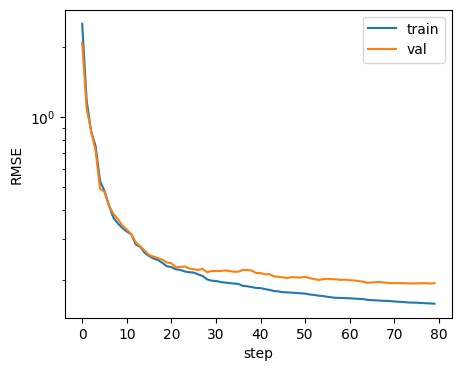

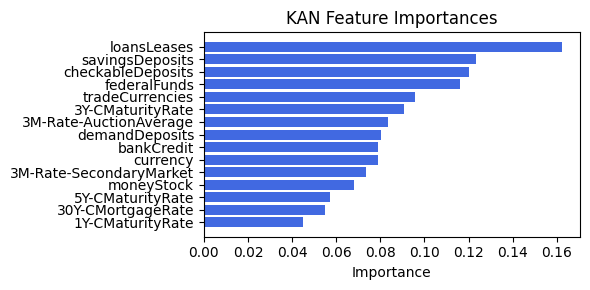

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.43it/s]

[('tradeCurrencies', 0.45208281824099167), ('5Y-CMaturityRate', 0.2684563709245551), ('bankCredit', 0.2659211282573995), ('moneyStock', 0.24764969497919082), ('federalFunds', 0.22252807209623002), ('3Y-CMaturityRate', 0.19761927009870608), ('loansLeases', 0.18846037974581123), ('savingsDeposits', 0.1801828077374791), ('Ex1', 0.16976954261328847), ('demandDeposits', 0.13381459010055377), ('3M-Rate-AuctionAverage', 0.1271127031583871), ('30Y-CMortgageRate', 0.12396613148905869), ('currency', 0.11472741529522908), ('1Y-CMaturityRate', 0.1039660542759867), ('checkableDeposits', 0.09300625392962025), ('3M-Rate-SecondaryMarket', 0.06330976705288603)]


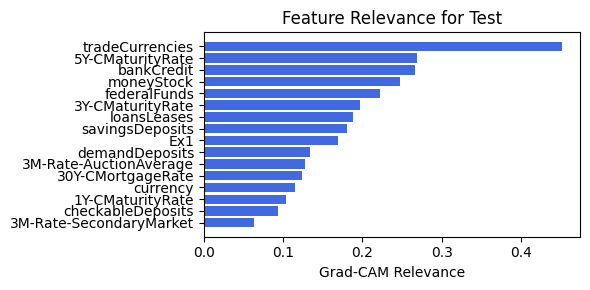

In [104]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=1, lamb=1e-05, steps=80, filename=filename_1, opt_col_val=1)

### 1.3.0b width=[15, 6, 1], grid=7, lamb=1e-05 | cnn_bottleneck_dim=2

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.11e-01 | eval_loss: 1.74e-01 | reg: 3.69e+01 |: 100%|█| 80/80 [00:24<00:00,  3.33it/

saving model version 0.1
Best epoch 65
0.21021708846092224
M_KAN Relevance: 0.9183403253555298
CNN Relevance: 0.08165965974330902
[('bankCredit', 0.3689925), ('checkableDeposits', 0.33517498), ('5Y-CMaturityRate', 0.31938612), ('demandDeposits', 0.2927488), ('30Y-CMortgageRate', 0.26431662), ('federalFunds', 0.20267805), ('loansLeases', 0.16425389), ('tradeCurrencies', 0.16054927), ('3M-Rate-SecondaryMarket', 0.15646386), ('3Y-CMaturityRate', 0.14979364), ('savingsDeposits', 0.1486795), ('currency', 0.1455421), ('moneyStock', 0.12368584), ('1Y-CMaturityRate', 0.094780676), ('3M-Rate-AuctionAverage', 0.06943917)]


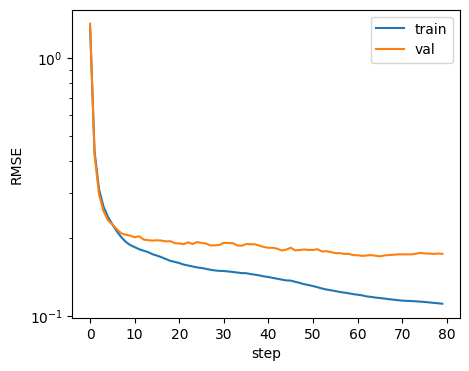

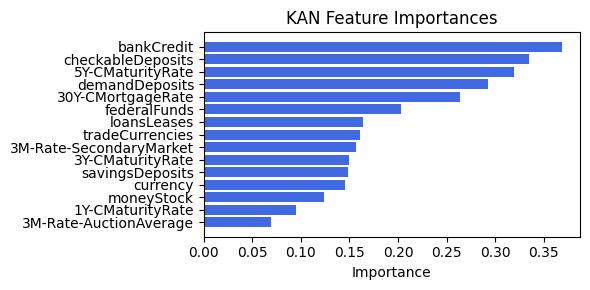

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.12it/s]

[('tradeCurrencies', 0.24960007798009817), ('moneyStock', 0.19385412448928468), ('loansLeases', 0.15821913521836645), ('bankCredit', 0.15669588631107695), ('3M-Rate-AuctionAverage', 0.1557864961170015), ('5Y-CMaturityRate', 0.15398103694121043), ('30Y-CMortgageRate', 0.15307265520095825), ('federalFunds', 0.13895675462969978), ('demandDeposits', 0.1261078538772251), ('3Y-CMaturityRate', 0.12445457608749469), ('checkableDeposits', 0.12078429446333931), ('1Y-CMaturityRate', 0.10850994894724517), ('currency', 0.09495444964794886), ('3M-Rate-SecondaryMarket', 0.07995064145042782), ('savingsDeposits', 0.0664620369273637), ('Ex1', 0.04995236623189634)]


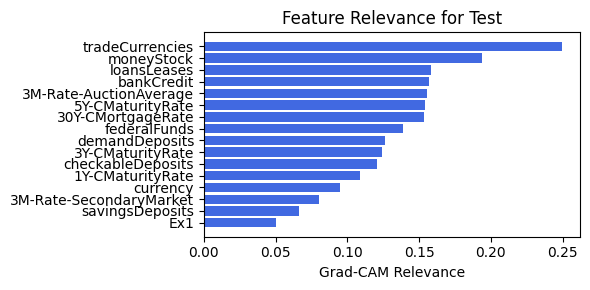

In [105]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=2, lamb=1e-05, steps=80, filename=filename_1, opt_col_val=2)

### 1.3.0c width=[15, 6, 1], grid=7, lamb=1e-05 | cnn_bottleneck_dim=2

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.20e-01 | eval_loss: 1.90e-01 | reg: 3.69e+01 |: 100%|█| 80/80 [00:24<00:00,  3.29it/

saving model version 0.1
Best epoch 47
0.23682840168476105
M_KAN Relevance: 0.9423967599868774
CNN Relevance: 0.05760325863957405
[('bankCredit', 0.36337596), ('checkableDeposits', 0.3045755), ('5Y-CMaturityRate', 0.2817731), ('30Y-CMortgageRate', 0.25511667), ('demandDeposits', 0.24445228), ('federalFunds', 0.18418048), ('3Y-CMaturityRate', 0.15497981), ('3M-Rate-SecondaryMarket', 0.14465784), ('loansLeases', 0.1384319), ('savingsDeposits', 0.12754317), ('moneyStock', 0.119469106), ('tradeCurrencies', 0.118170045), ('currency', 0.11171957), ('3M-Rate-AuctionAverage', 0.06117432), ('1Y-CMaturityRate', 0.058969915)]


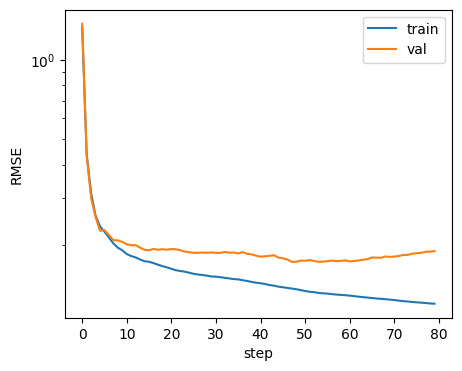

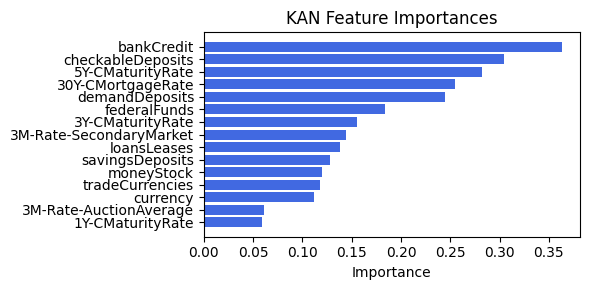

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.32it/s]

[('tradeCurrencies', 0.2558431741593051), ('moneyStock', 0.23579173712503343), ('3M-Rate-AuctionAverage', 0.19749390340986706), ('30Y-CMortgageRate', 0.1949450004668463), ('bankCredit', 0.17787802927196025), ('5Y-CMaturityRate', 0.1742336218023584), ('federalFunds', 0.16599763242827195), ('checkableDeposits', 0.14770988992282322), ('demandDeposits', 0.13908278765711224), ('1Y-CMaturityRate', 0.13858700366247267), ('3Y-CMaturityRate', 0.1347514433342786), ('loansLeases', 0.13407661305824323), ('currency', 0.11538498351971309), ('3M-Rate-SecondaryMarket', 0.10209305243832724), ('savingsDeposits', 0.07304162942760048), ('Ex1', 0.060894493597810476)]


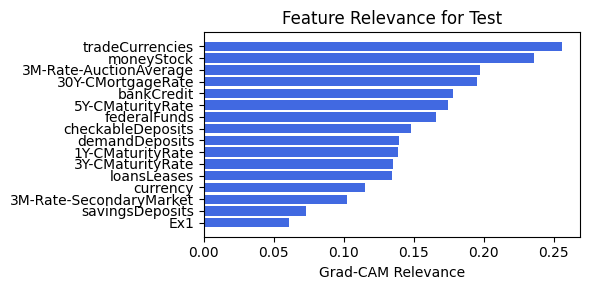

In [106]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=2, lamb=1e-05, steps=80, filename=filename_1, opt_col_val=2)

### 1.3.1 width=[15, 6, 1], grid=7, lamb=1e-05 | cnn_bottleneck_dim=3

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 7.47e-02 | eval_loss: 2.04e-01 | reg: 2.89e+01 |: 100%|█| 80/80 [00:23<00:00,  3.34it/

saving model version 0.1
Best epoch 28
0.22623299062252045
M_KAN Relevance: 0.13794660568237305
CNN Relevance: 0.862053394317627
[('federalFunds', 0.39925265), ('checkableDeposits', 0.328709), ('3M-Rate-SecondaryMarket', 0.28267613), ('3M-Rate-AuctionAverage', 0.28172606), ('moneyStock', 0.27005795), ('30Y-CMortgageRate', 0.26581836), ('bankCredit', 0.2643391), ('tradeCurrencies', 0.26038736), ('5Y-CMaturityRate', 0.23500678), ('3Y-CMaturityRate', 0.23013234), ('1Y-CMaturityRate', 0.22669959), ('currency', 0.21198541), ('loansLeases', 0.20018479), ('savingsDeposits', 0.16955456), ('demandDeposits', 0.16160166)]


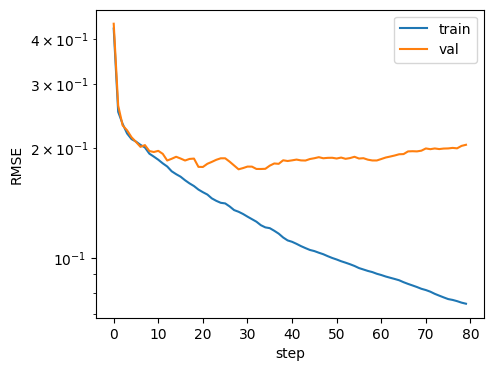

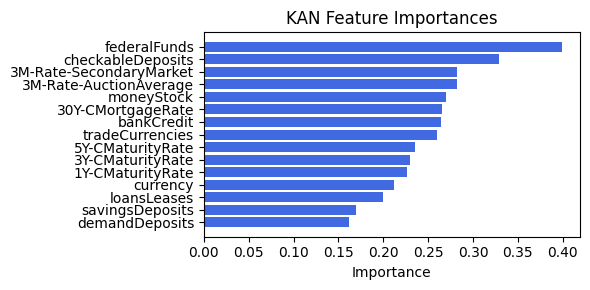

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  8.90it/s]

[('loansLeases', 0.25019362090111136), ('demandDeposits', 0.08797384432206551), ('savingsDeposits', 0.07344926096820495), ('3M-Rate-SecondaryMarket', 0.029831713107636288), ('tradeCurrencies', 0.01744544797859687), ('3Y-CMaturityRate', 0.01696290505296063), ('Ex1', 0.002552219231923421), ('currency', 0.0022754911954204243), ('1Y-CMaturityRate', 0.0017262667417526246), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0)]


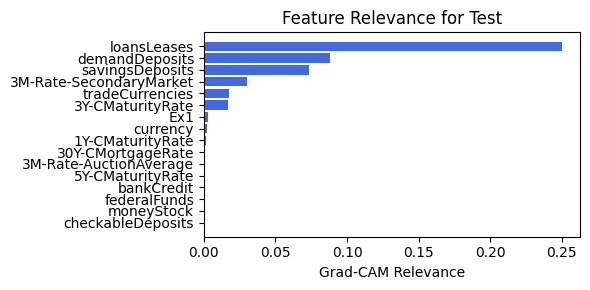

In [107]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=3, lamb=1e-05, steps=80, filename=filename_1, opt_col_val=3)

### 1.3.2 width=[15, 6, 1], grid=7, lamb=1e-05 | cnn_bottleneck_dim=3

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 7.03e-02 | eval_loss: 1.93e-01 | reg: 3.05e+01 |: 100%|█| 80/80 [00:27<00:00,  2.92it/

saving model version 0.1
Best epoch 27
0.2240319848060608
M_KAN Relevance: 0.15517371892929077
CNN Relevance: 0.8448262810707092
[('federalFunds', 0.50651056), ('checkableDeposits', 0.3915438), ('3M-Rate-SecondaryMarket', 0.2971565), ('3Y-CMaturityRate', 0.278665), ('1Y-CMaturityRate', 0.27730906), ('bankCredit', 0.27728295), ('30Y-CMortgageRate', 0.26045913), ('tradeCurrencies', 0.24592428), ('5Y-CMaturityRate', 0.23547235), ('loansLeases', 0.22282861), ('3M-Rate-AuctionAverage', 0.21948676), ('moneyStock', 0.21885294), ('savingsDeposits', 0.17449896), ('demandDeposits', 0.16805094), ('currency', 0.14928484)]


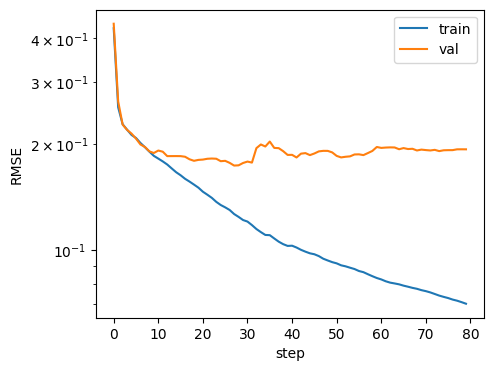

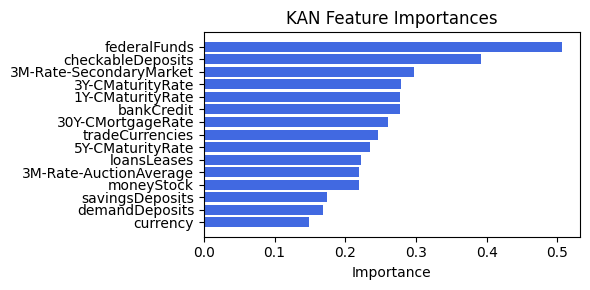

Computing Grad-CAM: 100%|██████████| 210/210 [00:27<00:00,  7.72it/s]


[('loansLeases', 0.25214940213731357), ('savingsDeposits', 0.09210008486684057), ('demandDeposits', 0.04375087817066482), ('tradeCurrencies', 0.02450992377208812), ('3M-Rate-SecondaryMarket', 0.007609740298773561), ('1Y-CMaturityRate', 0.001385957712218875), ('currency', 0.0005654569360471907), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


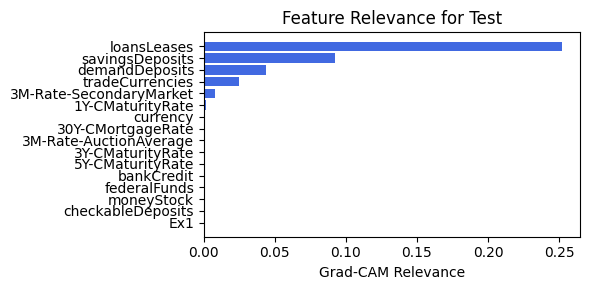

In [108]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=3, lamb=1e-05, steps=80, filename=filename_1, opt_col_val=3)

### 1.3.2 width=[15, 6, 1], grid=7, lamb=1e-05 | cnn_bottleneck_dim=6

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.06e-01 | eval_loss: 1.89e-01 | reg: 2.63e+01 |: 100%|█| 80/80 [00:23<00:00,  3.43it/

saving model version 0.1
Best epoch 44
0.23673634231090546
M_KAN Relevance: 0.14395517110824585
CNN Relevance: 0.8560448884963989
[('checkableDeposits', 0.24769346), ('3M-Rate-AuctionAverage', 0.20287119), ('bankCredit', 0.2018038), ('3M-Rate-SecondaryMarket', 0.20005974), ('tradeCurrencies', 0.18806094), ('moneyStock', 0.18724656), ('30Y-CMortgageRate', 0.17143457), ('loansLeases', 0.1568085), ('federalFunds', 0.15210514), ('3Y-CMaturityRate', 0.14797306), ('5Y-CMaturityRate', 0.13943885), ('1Y-CMaturityRate', 0.12354117), ('currency', 0.12294447), ('demandDeposits', 0.12147229), ('savingsDeposits', 0.11239982)]


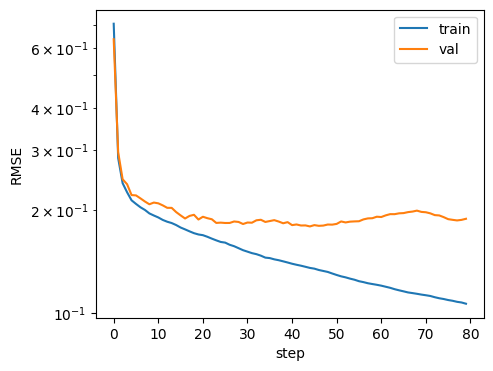

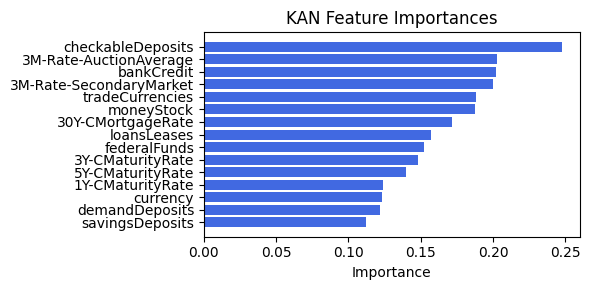

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  7.88it/s]


[('3M-Rate-SecondaryMarket', 0.42962924941842046), ('loansLeases', 0.2144594599038274), ('3M-Rate-AuctionAverage', 0.09785587356337125), ('30Y-CMortgageRate', 0.0974019299194749), ('savingsDeposits', 0.07744425660930573), ('demandDeposits', 0.07730305884033442), ('1Y-CMaturityRate', 0.0725865080608942), ('3Y-CMaturityRate', 0.02403269410133362), ('tradeCurrencies', 0.017697424131135144), ('checkableDeposits', 0.002290718229154923), ('currency', 0.0002452055568851176), ('federalFunds', 0.00022275498735585382), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('moneyStock', 0.0), ('Ex1', 0.0)]


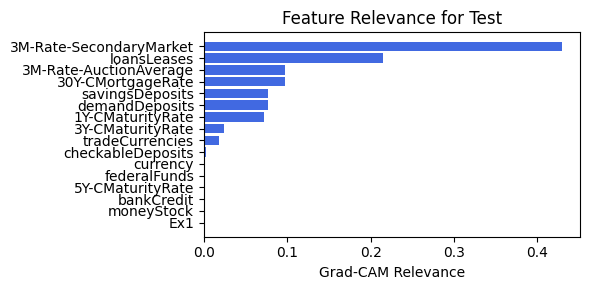

In [109]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=6, lamb=1e-05, steps=80, filename=filename_1, opt_col_val=6)

### 1.3.3 width=[15, 6, 1], grid=7, lamb=1e-05 | cnn_bottleneck_dim=6

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.06e-01 | eval_loss: 1.89e-01 | reg: 2.63e+01 |: 100%|█| 80/80 [00:23<00:00,  3.44it/

saving model version 0.1
Best epoch 44
0.23673634231090546
M_KAN Relevance: 0.14395517110824585
CNN Relevance: 0.8560448884963989
[('checkableDeposits', 0.24769346), ('3M-Rate-AuctionAverage', 0.20287119), ('bankCredit', 0.2018038), ('3M-Rate-SecondaryMarket', 0.20005974), ('tradeCurrencies', 0.18806094), ('moneyStock', 0.18724656), ('30Y-CMortgageRate', 0.17143457), ('loansLeases', 0.1568085), ('federalFunds', 0.15210514), ('3Y-CMaturityRate', 0.14797306), ('5Y-CMaturityRate', 0.13943885), ('1Y-CMaturityRate', 0.12354117), ('currency', 0.12294447), ('demandDeposits', 0.12147229), ('savingsDeposits', 0.11239982)]


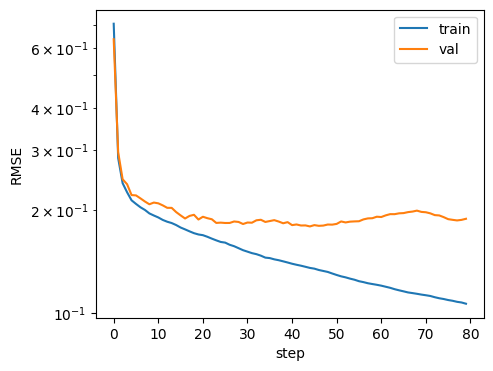

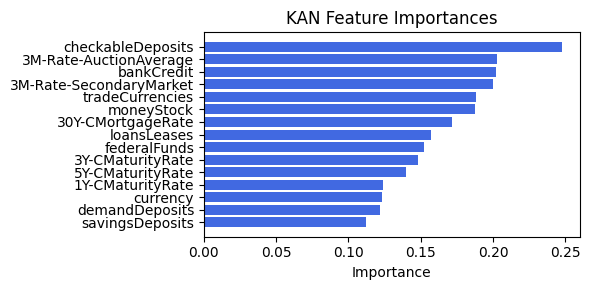

Computing Grad-CAM: 100%|██████████| 210/210 [00:27<00:00,  7.69it/s]

[('3M-Rate-SecondaryMarket', 0.42962924913458883), ('loansLeases', 0.2144594597973905), ('3M-Rate-AuctionAverage', 0.09785587335049752), ('30Y-CMortgageRate', 0.09740192977755907), ('savingsDeposits', 0.07744425660930573), ('demandDeposits', 0.07730305884033442), ('1Y-CMaturityRate', 0.07258650798993628), ('3Y-CMaturityRate', 0.02403269410133362), ('tradeCurrencies', 0.017697424131135144), ('checkableDeposits', 0.002290718229154923), ('currency', 0.0002452055568851176), ('federalFunds', 0.00022275498735585382), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('moneyStock', 0.0), ('Ex1', 0.0)]


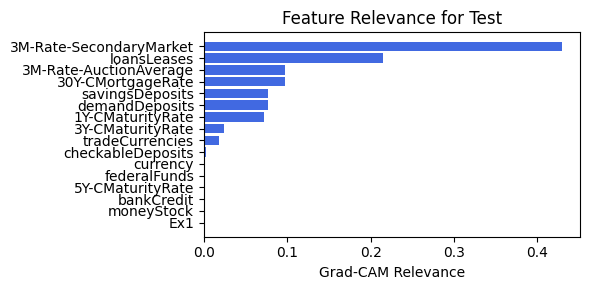

In [110]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=6, lamb=1e-05, steps=80, filename=filename_1, opt_col_val=6)

### 1.3.4 width=[15, 6, 1], grid=7, lamb=1e-05 | cnn_bottleneck_dim=9

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 8.39e-02 | eval_loss: 1.78e-01 | reg: 2.98e+01 |: 100%|█| 80/80 [00:23<00:00,  3.36it/

saving model version 0.1
Best epoch 66
0.262649267911911
M_KAN Relevance: 0.21425525844097137
CNN Relevance: 0.7857447266578674
[('federalFunds', 0.36109525), ('tradeCurrencies', 0.25546733), ('3M-Rate-SecondaryMarket', 0.2478516), ('30Y-CMortgageRate', 0.24326257), ('moneyStock', 0.24250183), ('3M-Rate-AuctionAverage', 0.2176228), ('loansLeases', 0.20392883), ('currency', 0.19013116), ('3Y-CMaturityRate', 0.1877068), ('5Y-CMaturityRate', 0.18159747), ('1Y-CMaturityRate', 0.13766399), ('bankCredit', 0.13098738), ('demandDeposits', 0.118242204), ('savingsDeposits', 0.112007014), ('checkableDeposits', 0.0837396)]


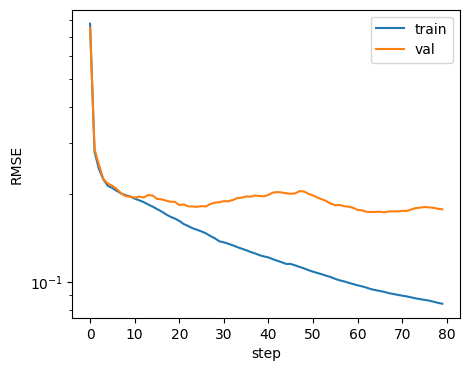

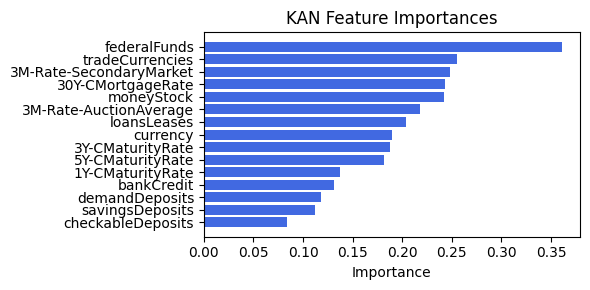

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  7.78it/s]


[('loansLeases', 0.22374062290237773), ('checkableDeposits', 0.039946599473201096), ('savingsDeposits', 0.03865125823926757), ('Ex1', 0.011017275634886962), ('demandDeposits', 0.007095147915173411), ('tradeCurrencies', 0.002293988099942605), ('1Y-CMaturityRate', 0.0009378954058601742), ('3Y-CMaturityRate', 5.868305230424518e-05), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3M-Rate-SecondaryMarket', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0)]


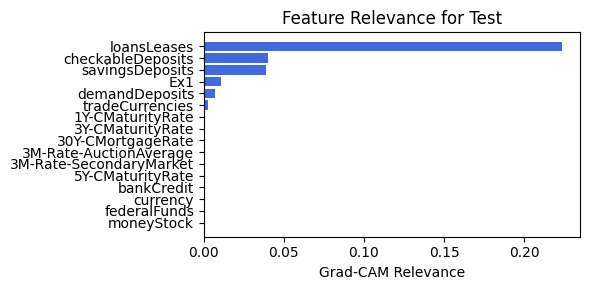

In [111]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=9, lamb=1e-05, steps=80, filename=filename_1, opt_col_val=9)

### 1.3.5 width=[15, 6, 1], grid=7, lamb=1e-05 | cnn_bottleneck_dim=9

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 8.39e-02 | eval_loss: 1.78e-01 | reg: 2.98e+01 |: 100%|█| 80/80 [00:24<00:00,  3.24it/

saving model version 0.1
Best epoch 66
0.262649267911911
M_KAN Relevance: 0.21425525844097137
CNN Relevance: 0.7857447266578674
[('federalFunds', 0.36109525), ('tradeCurrencies', 0.25546733), ('3M-Rate-SecondaryMarket', 0.2478516), ('30Y-CMortgageRate', 0.24326257), ('moneyStock', 0.24250183), ('3M-Rate-AuctionAverage', 0.2176228), ('loansLeases', 0.20392883), ('currency', 0.19013116), ('3Y-CMaturityRate', 0.1877068), ('5Y-CMaturityRate', 0.18159747), ('1Y-CMaturityRate', 0.13766399), ('bankCredit', 0.13098738), ('demandDeposits', 0.118242204), ('savingsDeposits', 0.112007014), ('checkableDeposits', 0.0837396)]


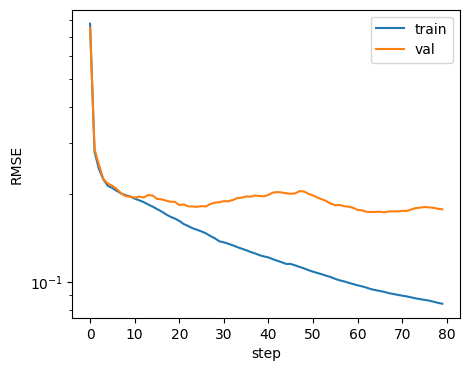

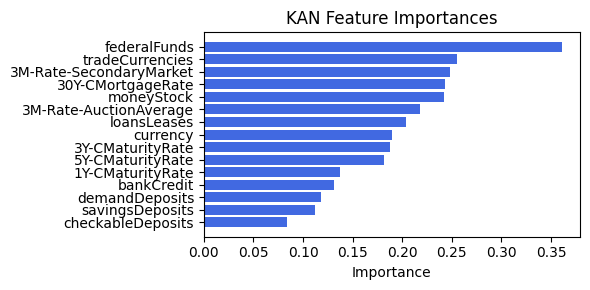

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  8.06it/s]


[('loansLeases', 0.22374062276046192), ('checkableDeposits', 0.039946599473201096), ('savingsDeposits', 0.03865125795100106), ('Ex1', 0.011017275634886962), ('demandDeposits', 0.007095147857520108), ('tradeCurrencies', 0.002293988099942605), ('1Y-CMaturityRate', 0.0009378954058601742), ('3Y-CMaturityRate', 5.868305230424518e-05), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3M-Rate-SecondaryMarket', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0)]


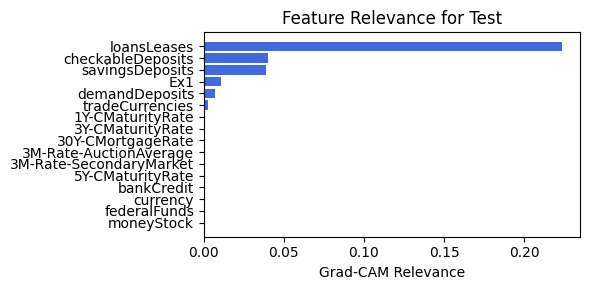

In [112]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=9, lamb=1e-05, steps=80, filename=filename_1, opt_col_val=9)

### 1.3.6 width=[15, 6, 1], grid=7, lamb=1e-05 | cnn_bottleneck_dim=12

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.02e-01 | eval_loss: 1.86e-01 | reg: 2.96e+01 |: 100%|█| 80/80 [00:23<00:00,  3.38it/

saving model version 0.1
Best epoch 39
0.22002828121185303
M_KAN Relevance: 0.11298706382513046
CNN Relevance: 0.8870128989219666
[('loansLeases', 0.34306931), ('checkableDeposits', 0.30100235), ('bankCredit', 0.2882163), ('3M-Rate-AuctionAverage', 0.28628516), ('5Y-CMaturityRate', 0.25598866), ('30Y-CMortgageRate', 0.22768065), ('federalFunds', 0.21949965), ('3M-Rate-SecondaryMarket', 0.20395403), ('1Y-CMaturityRate', 0.19624607), ('currency', 0.17949311), ('moneyStock', 0.14785606), ('tradeCurrencies', 0.14633602), ('3Y-CMaturityRate', 0.142984), ('savingsDeposits', 0.14242557), ('demandDeposits', 0.1318952)]


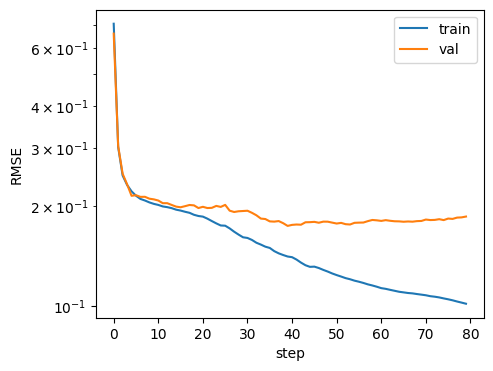

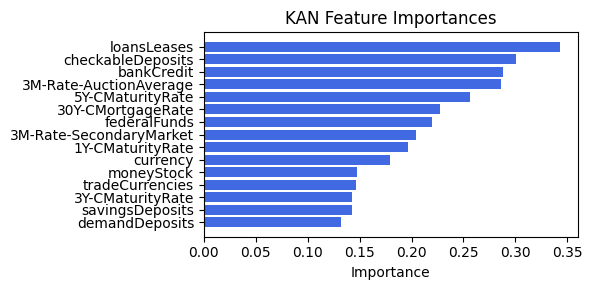

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  7.99it/s]


[('checkableDeposits', 0.24193644914554344), ('3M-Rate-SecondaryMarket', 0.19856436006680486), ('currency', 0.13063480996116553), ('loansLeases', 0.035304944469992605), ('Ex1', 0.006621616972344262), ('savingsDeposits', 0.0033152941901270034), ('1Y-CMaturityRate', 0.0), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0)]


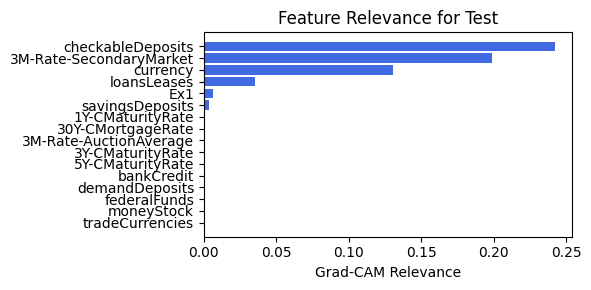

In [113]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=12, lamb=1e-05, steps=80, filename=filename_1, opt_col_val=12)

### 1.3.7 width=[15, 6, 1], grid=7, lamb=1e-05 | cnn_bottleneck_dim=12

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_1


| train_loss: 1.02e-01 | eval_loss: 1.86e-01 | reg: 2.96e+01 |: 100%|█| 80/80 [00:23<00:00,  3.39it/

saving model version 0.1
Best epoch 39
0.22002828121185303
M_KAN Relevance: 0.11298706382513046
CNN Relevance: 0.8870128989219666
[('loansLeases', 0.34306931), ('checkableDeposits', 0.30100235), ('bankCredit', 0.2882163), ('3M-Rate-AuctionAverage', 0.28628516), ('5Y-CMaturityRate', 0.25598866), ('30Y-CMortgageRate', 0.22768065), ('federalFunds', 0.21949965), ('3M-Rate-SecondaryMarket', 0.20395403), ('1Y-CMaturityRate', 0.19624607), ('currency', 0.17949311), ('moneyStock', 0.14785606), ('tradeCurrencies', 0.14633602), ('3Y-CMaturityRate', 0.142984), ('savingsDeposits', 0.14242557), ('demandDeposits', 0.1318952)]


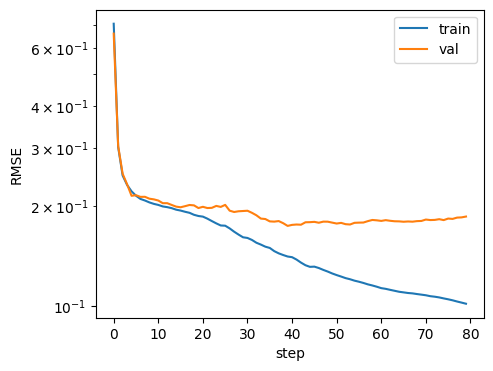

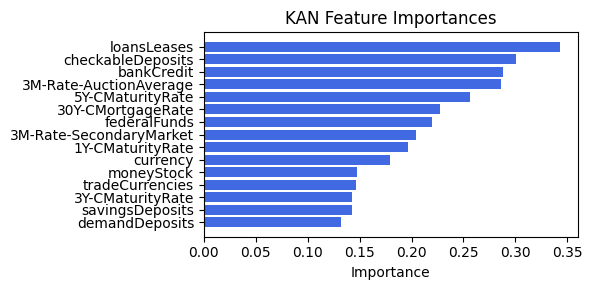

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  8.03it/s]

[('checkableDeposits', 0.24193644793925895), ('3M-Rate-SecondaryMarket', 0.19856436143939693), ('currency', 0.13063480964185492), ('loansLeases', 0.035304944469992605), ('Ex1', 0.006621616972344262), ('savingsDeposits', 0.0033152941901270034), ('1Y-CMaturityRate', 0.0), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0)]


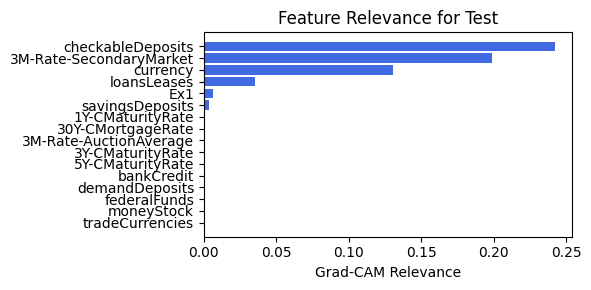

In [114]:
train_and_plot_relevance(Model3_1, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=12, lamb=1e-05, steps=80, filename=filename_1, opt_col_val=12)

# Option 2: Multiply CNN output by factor

In [115]:
create_csv_with_header(filename_2, columns_opt2)

## 2.0. width=[15, 5, 1], grid=4, lamb=0.0001

### 2.0.1. width=[15, 5, 1], grid=4, lamb=0.0001 | alpha=0.75

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.61e-01 | eval_loss: 1.88e-01 | reg: 9.86e+01 |: 100%|█| 40/40 [00:36<00:00,  1.09it/

saving model version 0.1
Best epoch 38
0.2546606957912445
M_KAN Relevance: 0.016505425795912743
CNN Relevance: 0.9834945797920227
[('tradeCurrencies', 0.3965392), ('30Y-CMortgageRate', 0.28294674), ('checkableDeposits', 0.27474323), ('bankCredit', 0.27128547), ('savingsDeposits', 0.2697734), ('federalFunds', 0.20678428), ('1Y-CMaturityRate', 0.1953859), ('moneyStock', 0.18528436), ('loansLeases', 0.17292583), ('5Y-CMaturityRate', 0.16477184), ('3M-Rate-AuctionAverage', 0.15727372), ('3Y-CMaturityRate', 0.15634066), ('3M-Rate-SecondaryMarket', 0.15222554), ('currency', 0.141867), ('demandDeposits', 0.13797987)]


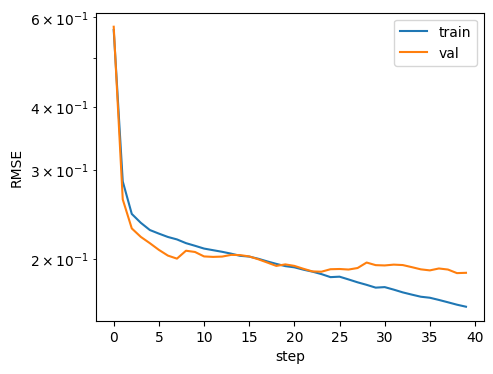

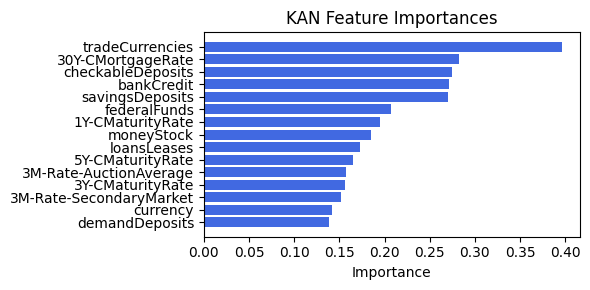

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.43it/s]


[('Ex1', 0.48464379097623306), ('tradeCurrencies', 0.1320186092828711), ('savingsDeposits', 0.10819583223326065), ('loansLeases', 0.08799421437073587), ('5Y-CMaturityRate', 0.03135870974538626), ('bankCredit', 0.029511932463425355), ('3Y-CMaturityRate', 0.02205049260172971), ('demandDeposits', 0.017950619291514158), ('currency', 0.015469242339687689), ('1Y-CMaturityRate', 0.008523134011331769), ('federalFunds', 0.006090632727275425), ('moneyStock', 0.003783431235656497), ('3M-Rate-SecondaryMarket', 0.0008631047970127492), ('30Y-CMortgageRate', 0.0002546146157242003), ('3M-Rate-AuctionAverage', 8.754714259079524e-05), ('checkableDeposits', 0.0)]


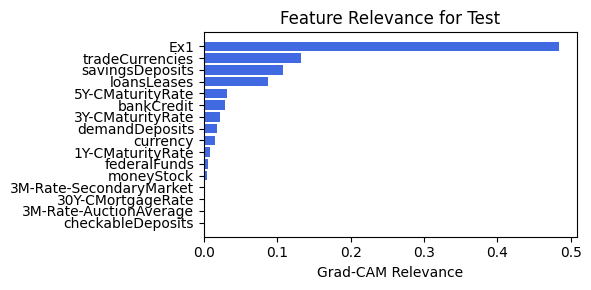

In [116]:
train_and_plot_relevance(Model3_2, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=40, alpha=.75, filename=filename_2, opt_col_val=0.75)

### 2.0.2. width=[15, 5, 1], grid=4, lamb=0.0001 | alpha=0.75

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.60e-01 | eval_loss: 1.84e-01 | reg: 8.31e+01 |: 100%|█| 40/40 [00:36<00:00,  1.10it/


saving model version 0.1
Best epoch 39
0.2656557857990265
M_KAN Relevance: 0.014120531268417835
CNN Relevance: 0.9858794808387756
[('tradeCurrencies', 0.4054187), ('30Y-CMortgageRate', 0.32064322), ('bankCredit', 0.24815822), ('savingsDeposits', 0.22236805), ('1Y-CMaturityRate', 0.21019319), ('checkableDeposits', 0.19566552), ('moneyStock', 0.1574856), ('3M-Rate-SecondaryMarket', 0.1470007), ('federalFunds', 0.14510894), ('loansLeases', 0.13626881), ('currency', 0.13361311), ('3M-Rate-AuctionAverage', 0.11667382), ('3Y-CMaturityRate', 0.11602502), ('demandDeposits', 0.093122065), ('5Y-CMaturityRate', 0.063804835)]


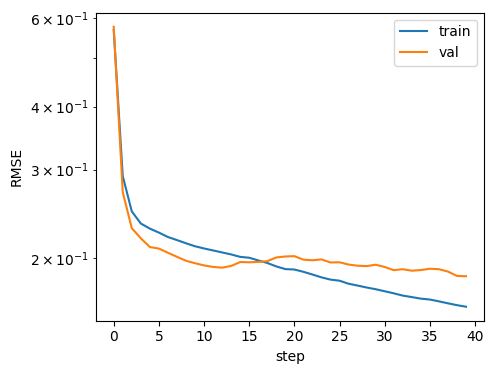

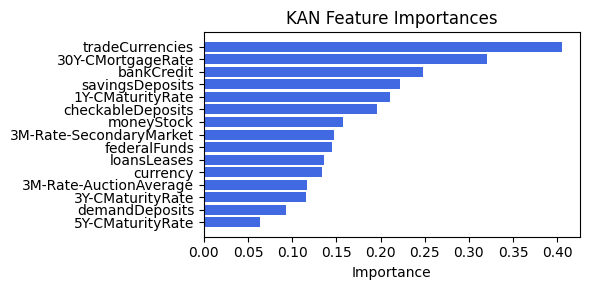

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.20it/s]

[('loansLeases', 0.07957062464140888), ('5Y-CMaturityRate', 0.03618508042501552), ('bankCredit', 0.034439003964265184), ('3Y-CMaturityRate', 0.03142626857872875), ('1Y-CMaturityRate', 0.02445474323328762), ('demandDeposits', 0.014179669085535265), ('30Y-CMortgageRate', 0.012885479309729168), ('3M-Rate-AuctionAverage', 0.011475495830555224), ('moneyStock', 0.010194868544515755), ('federalFunds', 0.008346061692351386), ('currency', 0.008160947867491771), ('tradeCurrencies', 0.007516652656652565), ('3M-Rate-SecondaryMarket', 0.004733235850220635), ('checkableDeposits', 0.00399435002888952), ('Ex1', 0.003487643972039223), ('savingsDeposits', 0.0027768227803919997)]


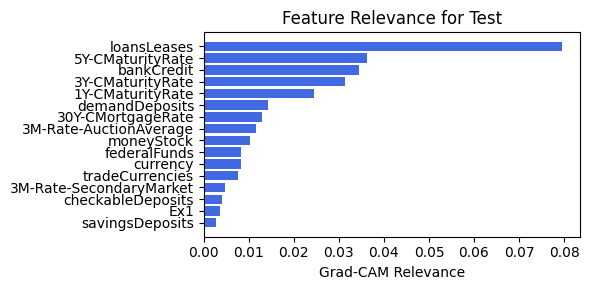

In [117]:
train_and_plot_relevance(Model3_2, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=40, alpha=.75, filename=filename_2, opt_col_val=0.75)

### 2.0.3. width=[15, 5, 1], grid=4, lamb=0.0001 | alpha=0.5

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.43e-01 | eval_loss: 2.24e-01 | reg: 9.74e+01 |: 100%|█| 40/40 [00:36<00:00,  1.10it/

saving model version 0.1
Best epoch 12
0.2438238561153412
M_KAN Relevance: 0.10208207368850708
CNN Relevance: 0.8979179263114929
[('federalFunds', 0.64327085), ('tradeCurrencies', 0.5313634), ('moneyStock', 0.39697108), ('loansLeases', 0.37741593), ('30Y-CMortgageRate', 0.29358104), ('bankCredit', 0.2781053), ('savingsDeposits', 0.27178258), ('3M-Rate-AuctionAverage', 0.2556515), ('1Y-CMaturityRate', 0.21779025), ('checkableDeposits', 0.19583689), ('3M-Rate-SecondaryMarket', 0.18248785), ('demandDeposits', 0.163049), ('3Y-CMaturityRate', 0.13407753), ('currency', 0.06498552), ('5Y-CMaturityRate', 0.06230663)]


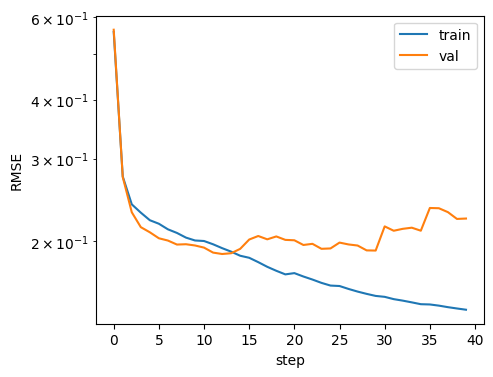

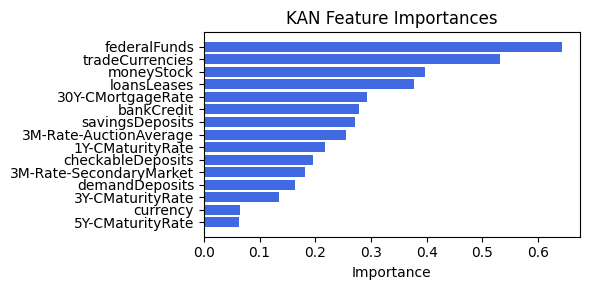

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.68it/s]


[('3Y-CMaturityRate', 0.2224308748463435), ('loansLeases', 0.2094517953516472), ('demandDeposits', 0.08915321572373311), ('tradeCurrencies', 0.05736173556762792), ('1Y-CMaturityRate', 0.04223129708940784), ('savingsDeposits', 0.014290574869318378), ('Ex1', 0.007654322329021635), ('currency', 6.99731255216258e-05), ('moneyStock', 5.384149872476146e-06), ('federalFunds', 1.0336284980266576e-06), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3M-Rate-SecondaryMarket', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('checkableDeposits', 0.0)]


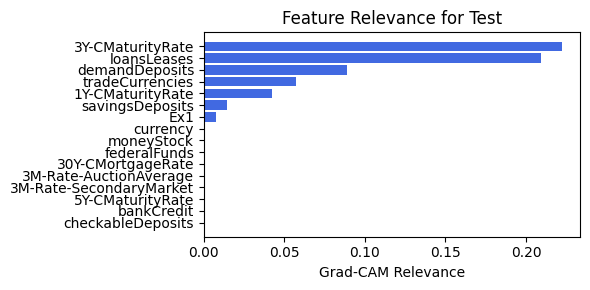

In [118]:
train_and_plot_relevance(Model3_2, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=40, alpha=.5, filename=filename_2, opt_col_val=0.5)

### 2.0.4. width=[15, 5, 1], grid=4, lamb=0.0001 | alpha=0.5

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.48e-01 | eval_loss: 1.79e-01 | reg: 9.75e+01 |: 100%|█| 40/40 [00:36<00:00,  1.10it/

saving model version 0.1
Best epoch 17
0.25335195660591125
M_KAN Relevance: 0.1099267452955246
CNN Relevance: 0.8900732398033142
[('tradeCurrencies', 0.49211), ('federalFunds', 0.42388844), ('30Y-CMortgageRate', 0.35863385), ('moneyStock', 0.34113848), ('bankCredit', 0.3037891), ('savingsDeposits', 0.28254807), ('3M-Rate-SecondaryMarket', 0.25505993), ('loansLeases', 0.22854975), ('1Y-CMaturityRate', 0.17217982), ('3Y-CMaturityRate', 0.16320957), ('checkableDeposits', 0.15825039), ('demandDeposits', 0.10710286), ('5Y-CMaturityRate', 0.08309769), ('currency', 0.0704021), ('3M-Rate-AuctionAverage', 0.06885662)]


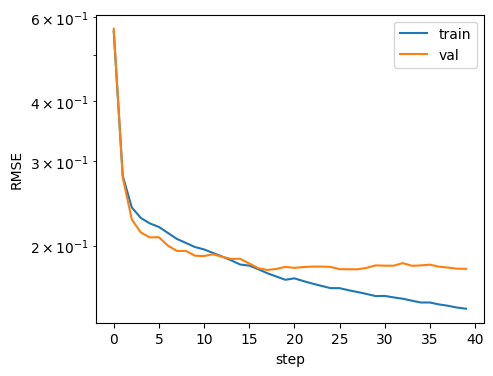

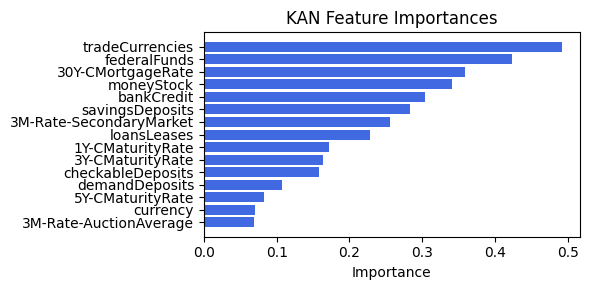

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.66it/s]

[('loansLeases', 0.36753893932771114), ('tradeCurrencies', 0.22974042099501404), ('savingsDeposits', 0.18254670683693672), ('Ex1', 0.05781073111076174), ('3Y-CMaturityRate', 0.04219042594278497), ('demandDeposits', 0.03411135818099692), ('currency', 0.006582281193030732), ('checkableDeposits', 0.005767649618376579), ('bankCredit', 0.005052970420746576), ('5Y-CMaturityRate', 0.0047751230985990595), ('3M-Rate-SecondaryMarket', 0.001906706743119728), ('1Y-CMaturityRate', 0.0007790901210336459), ('3M-Rate-AuctionAverage', 2.5112944699469066e-05), ('30Y-CMortgageRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0)]


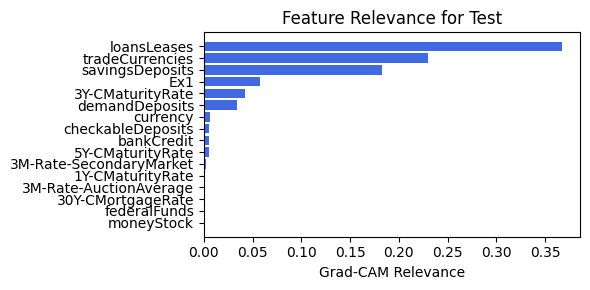

In [119]:
train_and_plot_relevance(Model3_2, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=40, alpha=.5, filename=filename_2, opt_col_val=0.5)

### 2.0.5. width=[15, 5, 1], grid=4, lamb=0.0001 | alpha=0.25

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.39e-01 | eval_loss: 1.98e-01 | reg: 1.02e+02 |: 100%|█| 40/40 [00:35<00:00,  1.12it/

saving model version 0.1
Best epoch 11
0.22669650614261627
M_KAN Relevance: 0.2104313224554062
CNN Relevance: 0.7895686626434326
[('30Y-CMortgageRate', 0.25025517), ('moneyStock', 0.17503071), ('tradeCurrencies', 0.1545483), ('3M-Rate-SecondaryMarket', 0.091374), ('3Y-CMaturityRate', 0.09066413), ('1Y-CMaturityRate', 0.08723047), ('checkableDeposits', 0.082368635), ('5Y-CMaturityRate', 0.07131548), ('bankCredit', 0.06975795), ('loansLeases', 0.06935794), ('3M-Rate-AuctionAverage', 0.066833206), ('savingsDeposits', 0.06556689), ('currency', 0.06328314), ('federalFunds', 0.05095282), ('demandDeposits', 0.04385515)]


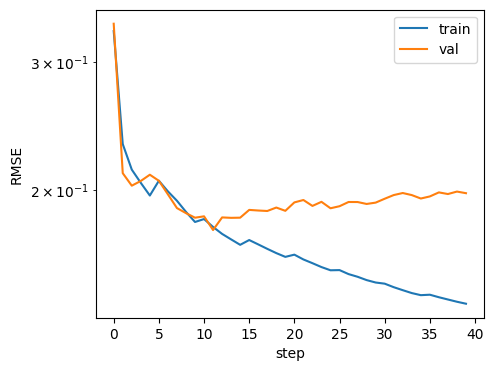

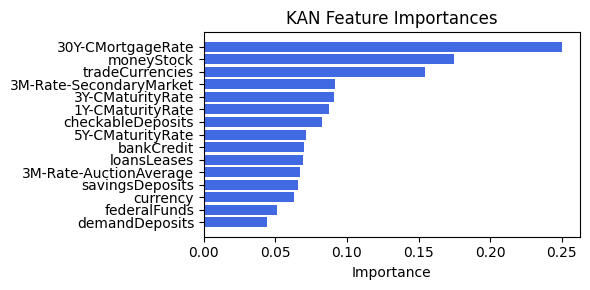

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.46it/s]

[('tradeCurrencies', 0.32066091371788863), ('loansLeases', 0.2243314115463623), ('savingsDeposits', 0.1769465581114803), ('3Y-CMaturityRate', 0.11169306916140374), ('bankCredit', 0.0990579818142578), ('5Y-CMaturityRate', 0.0945904522646396), ('demandDeposits', 0.06938269820197353), ('federalFunds', 0.05488948328974878), ('3M-Rate-SecondaryMarket', 0.047524134081877056), ('currency', 0.04078608090834071), ('Ex1', 0.035061101321480236), ('1Y-CMaturityRate', 0.03383954405518515), ('moneyStock', 0.03280553490372508), ('30Y-CMortgageRate', 0.03214613673765035), ('3M-Rate-AuctionAverage', 0.031913344970061666), ('checkableDeposits', 0.03026615145527536)]


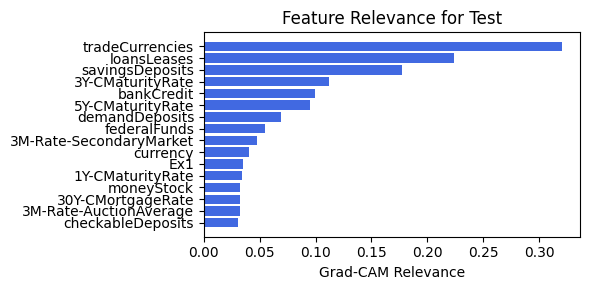

In [120]:
train_and_plot_relevance(Model3_2, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=40, alpha=.25, filename=filename_2, opt_col_val=0.25)

### 2.0.6. width=[15, 5, 1], grid=4, lamb=0.0001 | alpha=0.25

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.39e-01 | eval_loss: 1.98e-01 | reg: 1.02e+02 |: 100%|█| 40/40 [00:36<00:00,  1.10it/

saving model version 0.1
Best epoch 11
0.22669650614261627
M_KAN Relevance: 0.2104313224554062
CNN Relevance: 0.7895686626434326
[('30Y-CMortgageRate', 0.25025517), ('moneyStock', 0.17503071), ('tradeCurrencies', 0.1545483), ('3M-Rate-SecondaryMarket', 0.091374), ('3Y-CMaturityRate', 0.09066413), ('1Y-CMaturityRate', 0.08723047), ('checkableDeposits', 0.082368635), ('5Y-CMaturityRate', 0.07131548), ('bankCredit', 0.06975795), ('loansLeases', 0.06935794), ('3M-Rate-AuctionAverage', 0.066833206), ('savingsDeposits', 0.06556689), ('currency', 0.06328314), ('federalFunds', 0.05095282), ('demandDeposits', 0.04385515)]


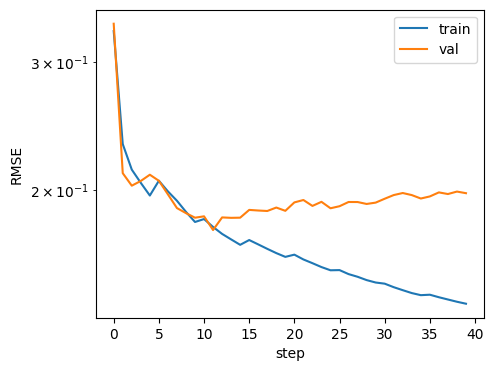

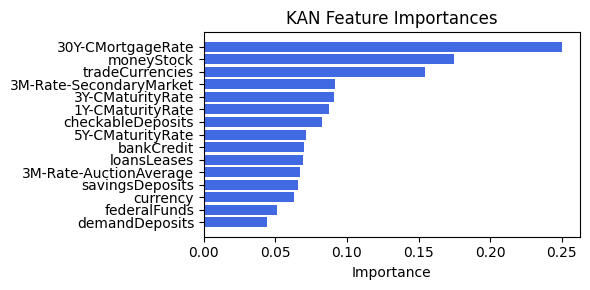

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  8.91it/s]

[('tradeCurrencies', 0.32066091371788863), ('loansLeases', 0.22433141126253064), ('savingsDeposits', 0.1769465581114803), ('3Y-CMaturityRate', 0.11169306930331957), ('bankCredit', 0.09905798195617362), ('5Y-CMaturityRate', 0.09459045247751333), ('demandDeposits', 0.06938269820197353), ('federalFunds', 0.05488948339618565), ('3M-Rate-SecondaryMarket', 0.047524134081877056), ('currency', 0.04078608090834071), ('Ex1', 0.035061101321480236), ('1Y-CMaturityRate', 0.03383954405518515), ('moneyStock', 0.03280553490372508), ('30Y-CMortgageRate', 0.03214613673765035), ('3M-Rate-AuctionAverage', 0.031913344970061666), ('checkableDeposits', 0.03026615145527536)]


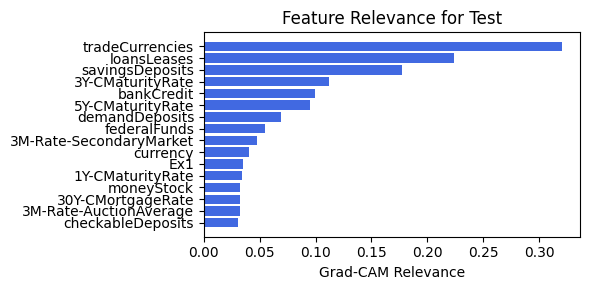

In [121]:
train_and_plot_relevance(Model3_2, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=40, alpha=.25, filename=filename_2, opt_col_val=0.25)

### 2.0.7. width=[15, 5, 1], grid=4, lamb=0.0001 | alpha=0.1

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.27e-01 | eval_loss: 1.69e-01 | reg: 8.61e+01 |: 100%|█| 40/40 [00:36<00:00,  1.09it/

saving model version 0.1
Best epoch 25
0.22670778632164001
M_KAN Relevance: 0.3868083357810974
CNN Relevance: 0.6131916642189026
[('30Y-CMortgageRate', 0.21098483), ('moneyStock', 0.19039956), ('3Y-CMaturityRate', 0.15376087), ('tradeCurrencies', 0.11531653), ('checkableDeposits', 0.11332693), ('3M-Rate-SecondaryMarket', 0.110711075), ('loansLeases', 0.10754631), ('currency', 0.08779282), ('5Y-CMaturityRate', 0.076816216), ('federalFunds', 0.07410046), ('demandDeposits', 0.062206626), ('savingsDeposits', 0.059628826), ('1Y-CMaturityRate', 0.058430817), ('bankCredit', 0.057556678), ('3M-Rate-AuctionAverage', 0.052548554)]


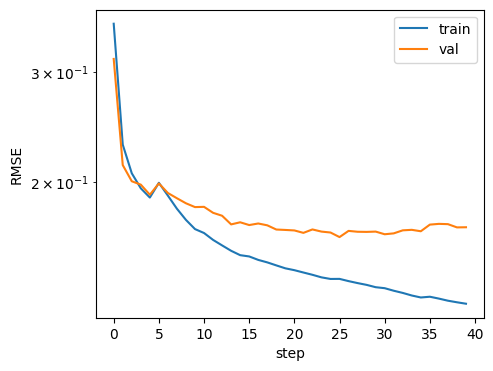

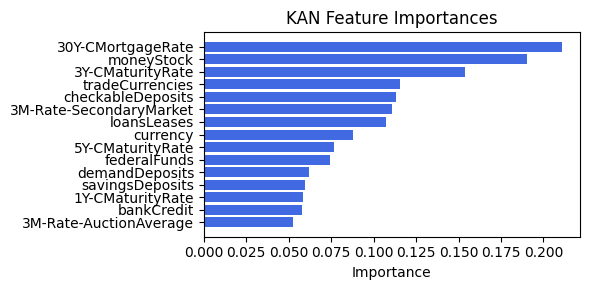

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.09it/s]


[('checkableDeposits', 0.22910991704446218), ('3M-Rate-SecondaryMarket', 0.20928085490817294), ('loansLeases', 0.18950332249071272), ('3M-Rate-AuctionAverage', 0.14602100140514918), ('30Y-CMortgageRate', 0.13826435104669405), ('1Y-CMaturityRate', 0.13588080773174407), ('tradeCurrencies', 0.12054447092357025), ('currency', 0.10091603470500558), ('savingsDeposits', 0.08687096770899232), ('demandDeposits', 0.07264524491370788), ('moneyStock', 0.06966738368961765), ('3Y-CMaturityRate', 0.06375630585299362), ('bankCredit', 0.0452055797501955), ('5Y-CMaturityRate', 0.04114231288743516), ('federalFunds', 0.038252847696865155), ('Ex1', 0.019813499224948742)]


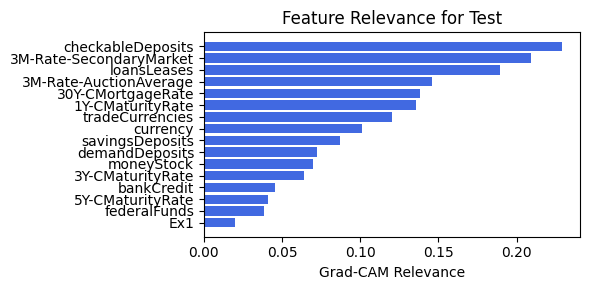

In [122]:
train_and_plot_relevance(Model3_2, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=40, alpha=.1, filename=filename_2, opt_col_val=0.1)

### 2.0.8. width=[15, 5, 1], grid=4, lamb=0.0001 | alpha=0.1

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.28e-01 | eval_loss: 1.68e-01 | reg: 8.95e+01 |: 100%|█| 40/40 [00:36<00:00,  1.10it/

saving model version 0.1
Best epoch 31
0.2359362095594406
M_KAN Relevance: 0.375696063041687
CNN Relevance: 0.6243038773536682
[('30Y-CMortgageRate', 0.2619845), ('moneyStock', 0.20696259), ('tradeCurrencies', 0.16359268), ('3Y-CMaturityRate', 0.15351936), ('3M-Rate-SecondaryMarket', 0.11181678), ('checkableDeposits', 0.11027986), ('loansLeases', 0.10244546), ('federalFunds', 0.09516348), ('savingsDeposits', 0.08294398), ('currency', 0.08242333), ('bankCredit', 0.06739321), ('5Y-CMaturityRate', 0.065995656), ('1Y-CMaturityRate', 0.061196953), ('demandDeposits', 0.053770076), ('3M-Rate-AuctionAverage', 0.04534379)]


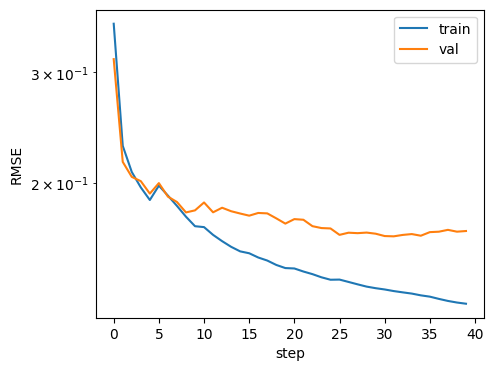

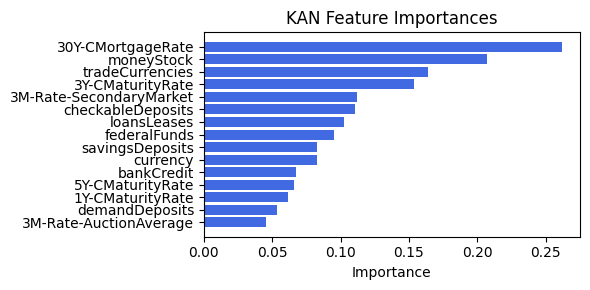

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.49it/s]


[('checkableDeposits', 0.2984888109378517), ('3M-Rate-SecondaryMarket', 0.2346186514818761), ('currency', 0.21894960425394985), ('30Y-CMortgageRate', 0.17989645534100765), ('3M-Rate-AuctionAverage', 0.17904802066318337), ('5Y-CMaturityRate', 0.16315522674121893), ('bankCredit', 0.16279231281507583), ('loansLeases', 0.1613351747623667), ('1Y-CMaturityRate', 0.1466164832787832), ('3Y-CMaturityRate', 0.12346881985902741), ('moneyStock', 0.116832809420746), ('tradeCurrencies', 0.11308244671665653), ('federalFunds', 0.11305860538379334), ('Ex1', 0.08756998154955606), ('demandDeposits', 0.07421741445903622), ('savingsDeposits', 0.069570176953788)]


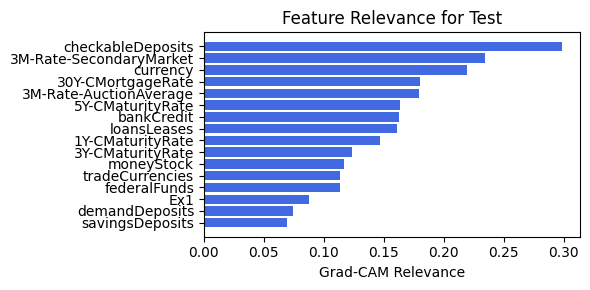

In [123]:
train_and_plot_relevance(Model3_2, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=40, alpha=.1, filename=filename_2, opt_col_val=0.1)

### 2.0.9. width=[15, 5, 1], grid=4, lamb=0.0001 | alpha=0.075

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.30e-01 | eval_loss: 2.32e-01 | reg: 1.01e+02 |: 100%|█| 40/40 [00:35<00:00,  1.13it/

saving model version 0.1
Best epoch 9
0.23976729810237885
M_KAN Relevance: 0.31276658177375793
CNN Relevance: 0.6872333884239197
[('30Y-CMortgageRate', 0.23342259), ('moneyStock', 0.22335711), ('tradeCurrencies', 0.17414588), ('checkableDeposits', 0.15589558), ('1Y-CMaturityRate', 0.15298568), ('loansLeases', 0.13845438), ('3Y-CMaturityRate', 0.13411464), ('3M-Rate-SecondaryMarket', 0.11793643), ('savingsDeposits', 0.116824366), ('currency', 0.11504968), ('demandDeposits', 0.09279944), ('federalFunds', 0.0902115), ('3M-Rate-AuctionAverage', 0.08486058), ('5Y-CMaturityRate', 0.08381364), ('bankCredit', 0.054843377)]


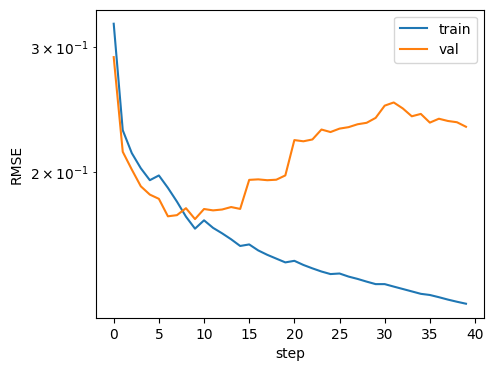

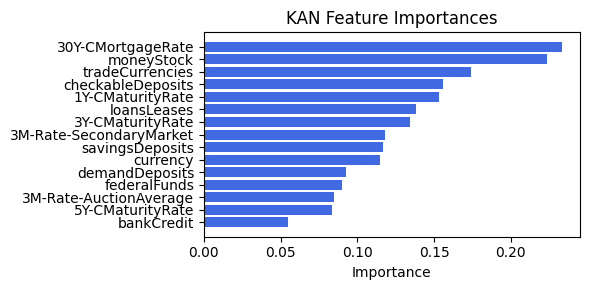

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.61it/s]


[('1Y-CMaturityRate', 0.13492942272375028), ('3Y-CMaturityRate', 0.06466789824688542), ('tradeCurrencies', 0.06238363447732159), ('moneyStock', 0.05318184761064393), ('demandDeposits', 0.052149955857367744), ('loansLeases', 0.03509953513941062), ('federalFunds', 0.030256640476485092), ('checkableDeposits', 0.028202565613069705), ('bankCredit', 0.027590258685605867), ('5Y-CMaturityRate', 0.02683314517628224), ('savingsDeposits', 0.021248577700333997), ('currency', 0.01861783098651185), ('30Y-CMortgageRate', 0.016399046304147867), ('3M-Rate-AuctionAverage', 0.015240953716316393), ('3M-Rate-SecondaryMarket', 0.012265663242266913), ('Ex1', 0.007397913326886261)]


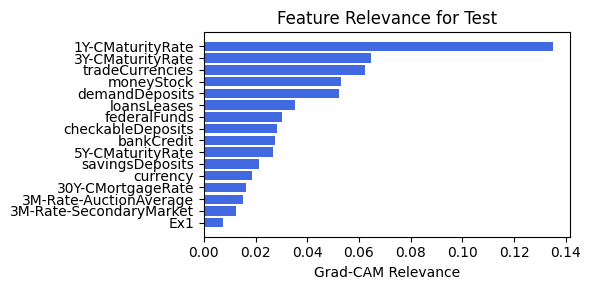

In [124]:
train_and_plot_relevance(Model3_2, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=40, alpha=.075, filename=filename_2, opt_col_val=0.075)

### 2.0.10 width=[15, 5, 1], grid=4, lamb=0.0001 | alpha=0.075

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.30e-01 | eval_loss: 1.99e-01 | reg: 9.78e+01 |: 100%|█| 40/40 [00:35<00:00,  1.11it/

saving model version 0.1
Best epoch 13
0.23900793492794037
M_KAN Relevance: 0.30397799611091614
CNN Relevance: 0.6960219740867615
[('30Y-CMortgageRate', 0.25755575), ('moneyStock', 0.23085637), ('tradeCurrencies', 0.19049324), ('checkableDeposits', 0.16057082), ('1Y-CMaturityRate', 0.15504082), ('loansLeases', 0.13619862), ('3Y-CMaturityRate', 0.12882793), ('currency', 0.12552896), ('3M-Rate-SecondaryMarket', 0.11250486), ('savingsDeposits', 0.10397402), ('3M-Rate-AuctionAverage', 0.09388038), ('federalFunds', 0.08605119), ('demandDeposits', 0.08248373), ('5Y-CMaturityRate', 0.07894128), ('bankCredit', 0.04761463)]


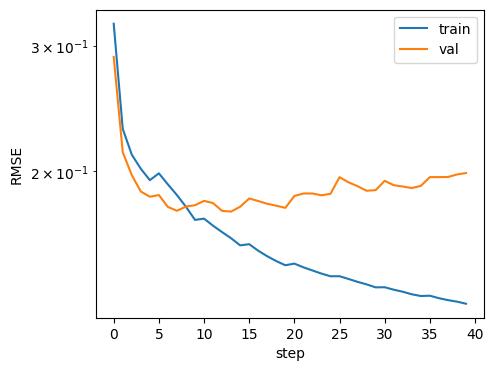

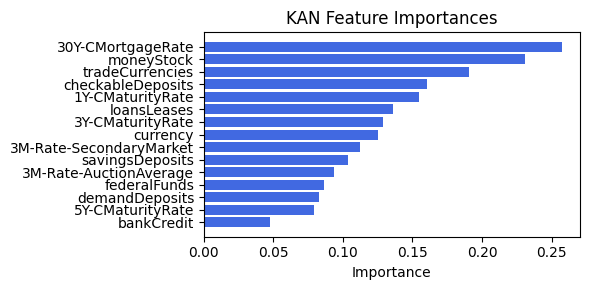

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  8.77it/s]

[('1Y-CMaturityRate', 0.2796652883823429), ('moneyStock', 0.11559263176584084), ('3M-Rate-AuctionAverage', 0.0957014652346039), ('30Y-CMortgageRate', 0.08760999604350045), ('checkableDeposits', 0.0857783608315956), ('demandDeposits', 0.08037988813455393), ('federalFunds', 0.07494798501401896), ('3Y-CMaturityRate', 0.07478145404768709), ('currency', 0.06774919432410527), ('bankCredit', 0.06641513240202108), ('5Y-CMaturityRate', 0.06365157993277534), ('Ex1', 0.05587884421859469), ('3M-Rate-SecondaryMarket', 0.053553526317479), ('loansLeases', 0.04396754901206025), ('savingsDeposits', 0.03390848548362902), ('tradeCurrencies', 0.03262670650618107)]


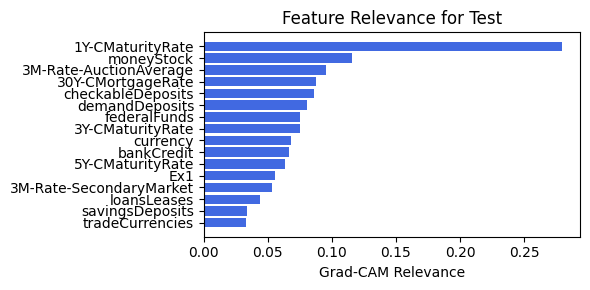

In [125]:
train_and_plot_relevance(Model3_2, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=40, alpha=.075, filename=filename_2, opt_col_val=0.075)

### 2.0.11 width=[15, 5, 1], grid=4, lamb=0.0001 | alpha=0.05

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.35e-01 | eval_loss: 1.65e-01 | reg: 1.06e+02 |: 100%|█| 40/40 [00:35<00:00,  1.13it/

saving model version 0.1
Best epoch 39
0.21928006410598755
M_KAN Relevance: 0.26579031348228455
CNN Relevance: 0.7342097163200378
[('30Y-CMortgageRate', 0.24990351), ('moneyStock', 0.19807458), ('savingsDeposits', 0.15030104), ('3Y-CMaturityRate', 0.13704179), ('1Y-CMaturityRate', 0.12134123), ('3M-Rate-SecondaryMarket', 0.10748078), ('tradeCurrencies', 0.100745216), ('demandDeposits', 0.0908187), ('currency', 0.08889487), ('checkableDeposits', 0.0874581), ('loansLeases', 0.077907085), ('5Y-CMaturityRate', 0.06984429), ('3M-Rate-AuctionAverage', 0.06645521), ('federalFunds', 0.06635558), ('bankCredit', 0.042639755)]


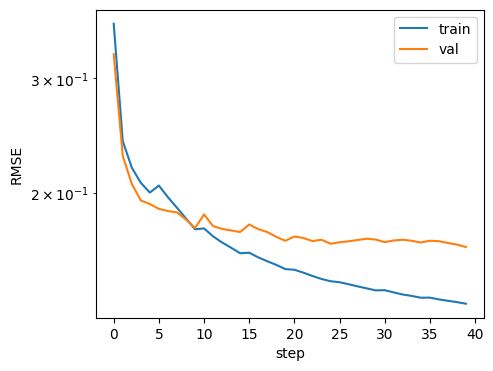

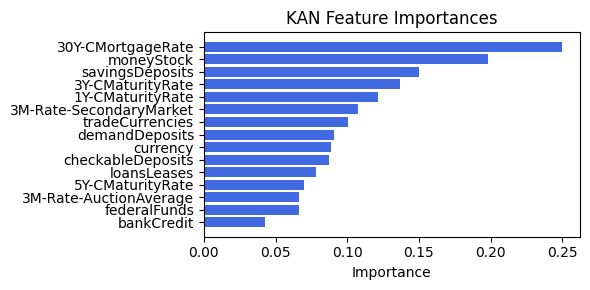

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.68it/s]

[('tradeCurrencies', 0.18071101065725087), ('1Y-CMaturityRate', 0.17006126306064073), ('3Y-CMaturityRate', 0.1685067099090139), ('demandDeposits', 0.13499059042161596), ('currency', 0.1243072047574623), ('Ex1', 0.11874501852074727), ('checkableDeposits', 0.10306346051206458), ('5Y-CMaturityRate', 0.09641813873313368), ('bankCredit', 0.0943652229206193), ('moneyStock', 0.09293717318657962), ('loansLeases', 0.08544877607429434), ('savingsDeposits', 0.08337409280883591), ('3M-Rate-AuctionAverage', 0.07709425779591714), ('3M-Rate-SecondaryMarket', 0.07476008437695869), ('federalFunds', 0.07349288947658525), ('30Y-CMortgageRate', 0.07311382518992537)]


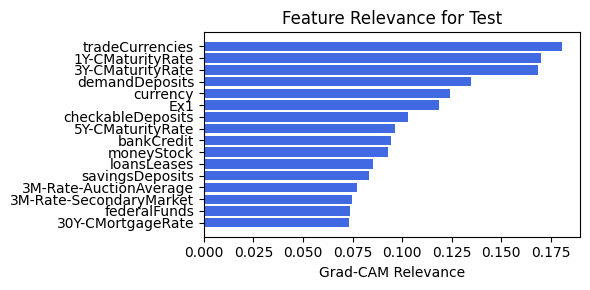

In [126]:
train_and_plot_relevance(Model3_2, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=40, alpha=.05, filename=filename_2, opt_col_val=0.05)

### 2.0.12 width=[15, 5, 1], grid=4, lamb=0.0001 | alpha=0.05

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.32e-01 | eval_loss: 1.71e+00 | reg: 1.06e+02 |: 100%|█| 40/40 [00:36<00:00,  1.10it/

saving model version 0.1
Best epoch 9
0.24279636144638062
M_KAN Relevance: 0.239900141954422
CNN Relevance: 0.7600998878479004
[('30Y-CMortgageRate', 0.20728235), ('moneyStock', 0.19969021), ('savingsDeposits', 0.19273238), ('3Y-CMaturityRate', 0.15192819), ('tradeCurrencies', 0.14329593), ('3M-Rate-SecondaryMarket', 0.13319463), ('1Y-CMaturityRate', 0.11568345), ('demandDeposits', 0.11083549), ('3M-Rate-AuctionAverage', 0.109056644), ('currency', 0.109021306), ('loansLeases', 0.106903486), ('checkableDeposits', 0.09253589), ('5Y-CMaturityRate', 0.09225051), ('bankCredit', 0.08799481), ('federalFunds', 0.05831)]


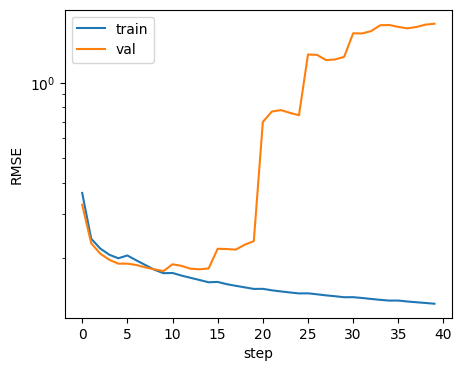

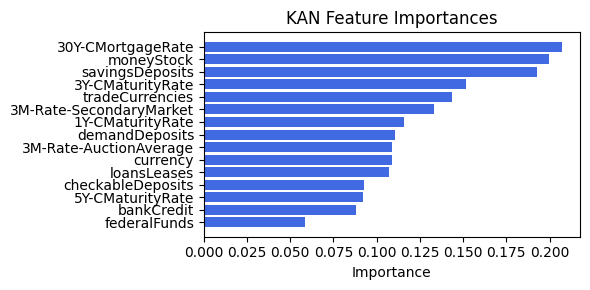

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.44it/s]

[('checkableDeposits', 0.1692801185973665), ('loansLeases', 0.1484748779194585), ('currency', 0.12083605432417244), ('Ex1', 0.11586395625736692), ('tradeCurrencies', 0.1094516558076499), ('demandDeposits', 0.09466782871722465), ('savingsDeposits', 0.0921202818619176), ('3M-Rate-SecondaryMarket', 0.0887398808252155), ('1Y-CMaturityRate', 0.08850152834895111), ('3Y-CMaturityRate', 0.06172054193559147), ('moneyStock', 0.0523649764524418), ('federalFunds', 0.0491435057450352), ('bankCredit', 0.03227986803367024), ('5Y-CMaturityRate', 0.03181403118401899), ('30Y-CMortgageRate', 0.013351554039677251), ('3M-Rate-AuctionAverage', 0.013039568492344448)]


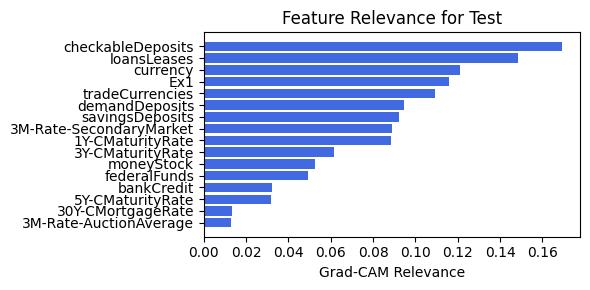

In [127]:
train_and_plot_relevance(Model3_2, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=40, alpha=.05, filename=filename_2, opt_col_val=0.05)

### 2.0.13 width=[15, 5, 1], grid=4, lamb=0.0001 | alpha=0.01

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.39e-01 | eval_loss: 1.75e-01 | reg: 1.13e+02 |: 100%|█| 40/40 [00:35<00:00,  1.12it/

saving model version 0.1
Best epoch 20
0.23407164216041565
M_KAN Relevance: 0.20323321223258972
CNN Relevance: 0.7967668175697327
[('30Y-CMortgageRate', 0.34386227), ('savingsDeposits', 0.2888533), ('moneyStock', 0.25763306), ('loansLeases', 0.23194142), ('tradeCurrencies', 0.22064798), ('3Y-CMaturityRate', 0.21615247), ('3M-Rate-AuctionAverage', 0.19841102), ('3M-Rate-SecondaryMarket', 0.18334436), ('currency', 0.18147965), ('checkableDeposits', 0.15448156), ('5Y-CMaturityRate', 0.14843185), ('1Y-CMaturityRate', 0.1472641), ('federalFunds', 0.1360121), ('bankCredit', 0.13260376), ('demandDeposits', 0.11040491)]


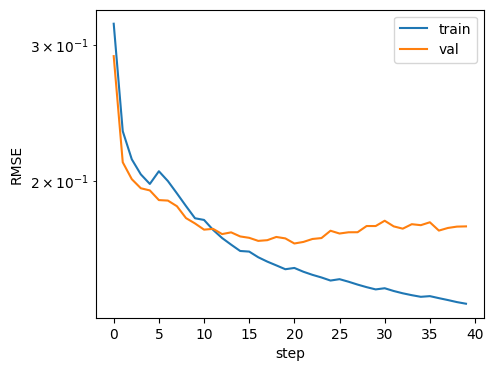

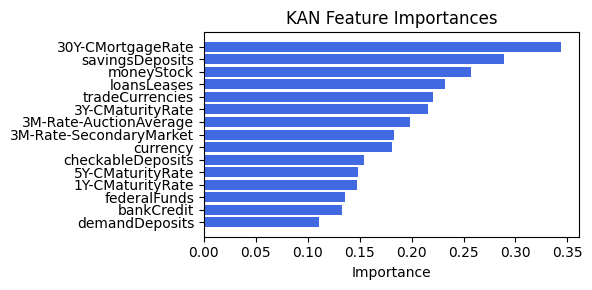

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  7.92it/s]


[('1Y-CMaturityRate', 0.21131529976680344), ('checkableDeposits', 0.14886052838936892), ('3Y-CMaturityRate', 0.14174408587693635), ('3M-Rate-AuctionAverage', 0.13770300745077077), ('3M-Rate-SecondaryMarket', 0.13379871365004442), ('30Y-CMortgageRate', 0.12279670455359987), ('demandDeposits', 0.11700524514335917), ('currency', 0.11390934188100454), ('tradeCurrencies', 0.10479197086588968), ('moneyStock', 0.09352586523164064), ('loansLeases', 0.08632809894070739), ('Ex1', 0.0848558368466911), ('bankCredit', 0.07846188035688274), ('5Y-CMaturityRate', 0.07563068858002052), ('savingsDeposits', 0.05836011923494793), ('federalFunds', 0.04743327738693292)]


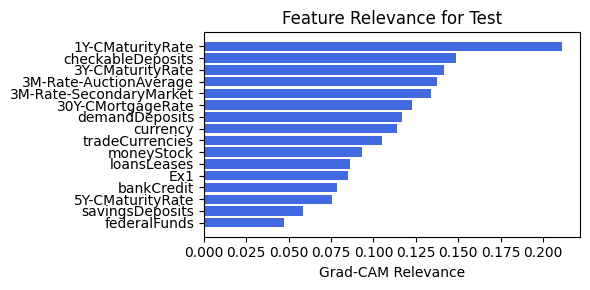

In [128]:
train_and_plot_relevance(Model3_2, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=40, alpha=.01, filename=filename_2, opt_col_val=0.01)

### 2.0.14 width=[15, 5, 1], grid=4, lamb=0.0001 | alpha=0.01

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.36e-01 | eval_loss: 1.89e-01 | reg: 1.09e+02 |: 100%|█| 40/40 [00:35<00:00,  1.12it/

saving model version 0.1
Best epoch 13
0.23345164954662323
M_KAN Relevance: 0.19172316789627075
CNN Relevance: 0.808276891708374
[('savingsDeposits', 0.25336283), ('30Y-CMortgageRate', 0.24159732), ('moneyStock', 0.21518567), ('3Y-CMaturityRate', 0.17536634), ('tradeCurrencies', 0.16463295), ('3M-Rate-SecondaryMarket', 0.15744397), ('3M-Rate-AuctionAverage', 0.14876997), ('loansLeases', 0.13804607), ('5Y-CMaturityRate', 0.12547776), ('currency', 0.1192688), ('demandDeposits', 0.11652609), ('bankCredit', 0.11485656), ('1Y-CMaturityRate', 0.113783695), ('federalFunds', 0.09715063), ('checkableDeposits', 0.09321531)]


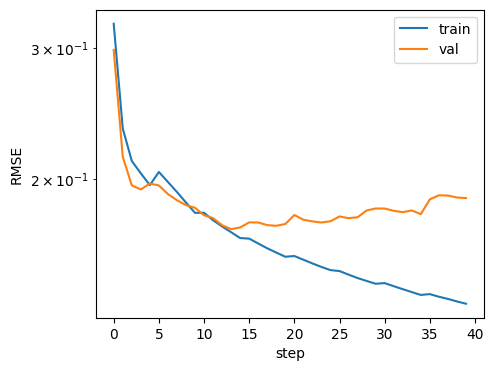

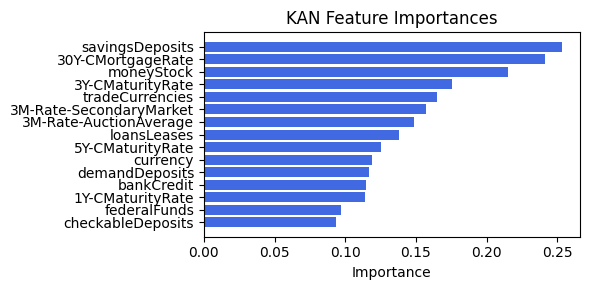

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.72it/s]

[('tradeCurrencies', 0.243941227914322), ('Ex1', 0.20044512032514572), ('loansLeases', 0.1842070151630434), ('savingsDeposits', 0.1401203840929416), ('demandDeposits', 0.13161969648541083), ('3Y-CMaturityRate', 0.12201422063545102), ('checkableDeposits', 0.11760250020029378), ('1Y-CMaturityRate', 0.08286311014810399), ('currency', 0.07994975182103059), ('federalFunds', 0.06051530439373372), ('3M-Rate-SecondaryMarket', 0.054162583894677006), ('moneyStock', 0.050771712822218734), ('bankCredit', 0.037090281978626516), ('5Y-CMaturityRate', 0.03497748960411021), ('3M-Rate-AuctionAverage', 0.02713720237924939), ('30Y-CMortgageRate', 0.026879964826539867)]


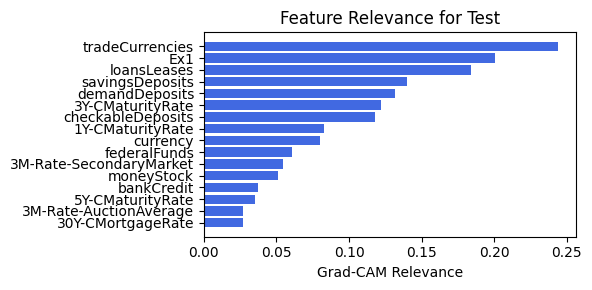

In [129]:
train_and_plot_relevance(Model3_2, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=40, alpha=.01, filename=filename_2, opt_col_val=0.01)

## 2.1 width=[15, 6, 1], grid=5, lamb=1e-05

### 2.1.1. width=[15, 6, 1], grid=5, lamb=1e-05 | alpha=0.75

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.27e-01 | eval_loss: 1.90e-01 | reg: 1.14e+02 |: 100%|█| 40/40 [00:41<00:00,  1.04s/i

saving model version 0.1
Best epoch 19
0.25537732243537903
M_KAN Relevance: 0.018495449796319008
CNN Relevance: 0.9815045595169067
[('checkableDeposits', 0.3470263), ('tradeCurrencies', 0.29440293), ('30Y-CMortgageRate', 0.25399712), ('loansLeases', 0.23754695), ('federalFunds', 0.22229639), ('currency', 0.19781739), ('3Y-CMaturityRate', 0.19739203), ('5Y-CMaturityRate', 0.1949254), ('moneyStock', 0.18590653), ('3M-Rate-SecondaryMarket', 0.17431885), ('savingsDeposits', 0.1326655), ('demandDeposits', 0.1279226), ('3M-Rate-AuctionAverage', 0.11348872), ('1Y-CMaturityRate', 0.11030492), ('bankCredit', 0.10542181)]


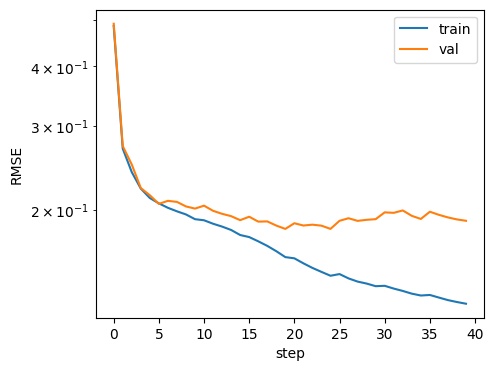

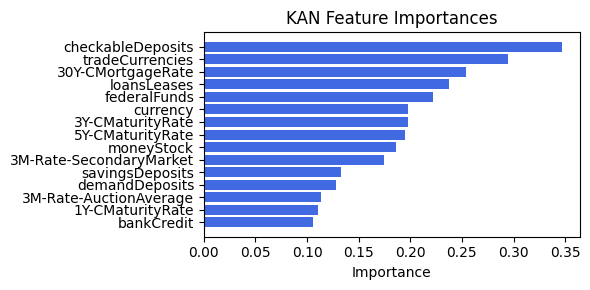

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.11it/s]


[('currency', 0.025566677128275237), ('3M-Rate-SecondaryMarket', 0.014327899969759441), ('tradeCurrencies', 0.013925087276757474), ('Ex1', 0.011078324329684534), ('moneyStock', 0.009126372332684696), ('5Y-CMaturityRate', 0.008934998796099708), ('bankCredit', 0.007808529266289302), ('checkableDeposits', 0.0073214958931203), ('3Y-CMaturityRate', 0.004181531497410365), ('1Y-CMaturityRate', 0.0012282415692295347), ('loansLeases', 0.001060289535893216), ('demandDeposits', 0.0005004473856561596), ('3M-Rate-AuctionAverage', 0.00028013414038079127), ('savingsDeposits', 0.00017244090368400238), ('30Y-CMortgageRate', 0.00016507351150115332), ('federalFunds', 0.0)]


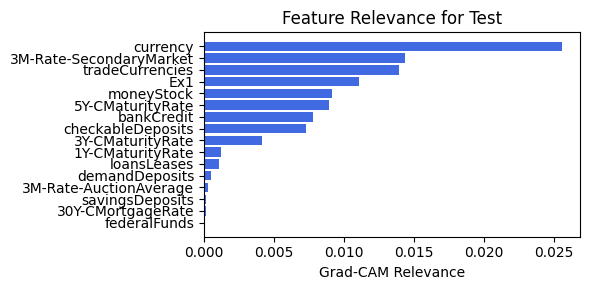

In [130]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.75, filename=filename_2, opt_col_val=0.75)

### 2.1.2. width=[15, 6, 1], grid=5, lamb=1e-05 | alpha=0.75

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.18e-01 | eval_loss: 1.85e-01 | reg: 1.16e+02 |: 100%|█| 40/40 [00:40<00:00,  1.02s/i


saving model version 0.1
Best epoch 31
0.23516708612442017
M_KAN Relevance: 0.01217610202729702
CNN Relevance: 0.9878239035606384
[('checkableDeposits', 0.36447978), ('tradeCurrencies', 0.3083618), ('30Y-CMortgageRate', 0.2607917), ('federalFunds', 0.24386033), ('loansLeases', 0.22821891), ('3Y-CMaturityRate', 0.19299416), ('3M-Rate-SecondaryMarket', 0.18467352), ('moneyStock', 0.18304071), ('5Y-CMaturityRate', 0.18246095), ('currency', 0.1776211), ('demandDeposits', 0.14026192), ('savingsDeposits', 0.12940073), ('3M-Rate-AuctionAverage', 0.1193689), ('1Y-CMaturityRate', 0.11661895), ('bankCredit', 0.10893403)]


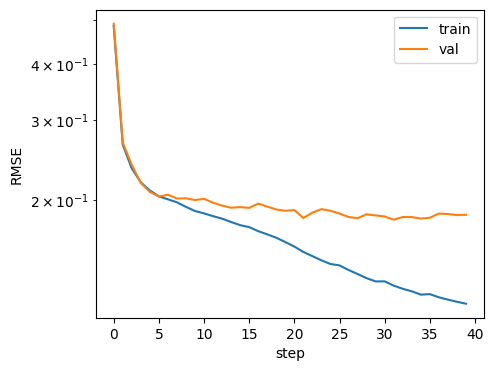

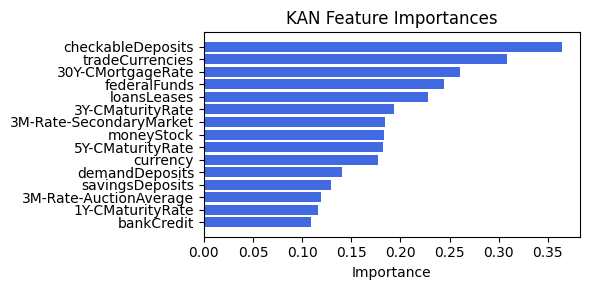

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.34it/s]

[('5Y-CMaturityRate', 0.18411714356237402), ('tradeCurrencies', 0.1809804868640467), ('bankCredit', 0.17334067342758533), ('3Y-CMaturityRate', 0.15455248348395495), ('Ex1', 0.11660553939810987), ('currency', 0.1087009273912935), ('moneyStock', 0.09912075310324629), ('federalFunds', 0.0783224279823203), ('savingsDeposits', 0.06791849949513562), ('demandDeposits', 0.057871882590864385), ('1Y-CMaturityRate', 0.05051035229116678), ('3M-Rate-AuctionAverage', 0.0420972292400187), ('loansLeases', 0.040553173155612535), ('30Y-CMortgageRate', 0.04041324538688752), ('checkableDeposits', 0.0341941488640649), ('3M-Rate-SecondaryMarket', 0.027160150318273475)]


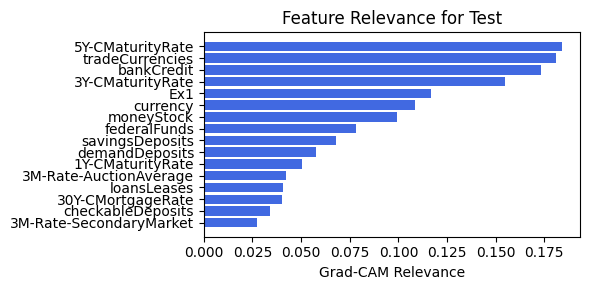

In [131]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.75, filename=filename_2, opt_col_val=0.75)

### 2.1.3. width=[15, 6, 1], grid=5, lamb=1e-05 | alpha=0.5

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.12e-01 | eval_loss: 1.82e-01 | reg: 1.57e+02 |: 100%|█| 40/40 [00:40<00:00,  1.02s/i

saving model version 0.1
Best epoch 29
0.2370750606060028
M_KAN Relevance: 0.05406937003135681
CNN Relevance: 0.9459306597709656
[('30Y-CMortgageRate', 0.40269136), ('tradeCurrencies', 0.34745145), ('federalFunds', 0.295966), ('3M-Rate-SecondaryMarket', 0.2310559), ('loansLeases', 0.21615085), ('moneyStock', 0.20834737), ('currency', 0.19803283), ('5Y-CMaturityRate', 0.16687964), ('checkableDeposits', 0.16466485), ('1Y-CMaturityRate', 0.14950217), ('3Y-CMaturityRate', 0.13720882), ('savingsDeposits', 0.11065807), ('demandDeposits', 0.103141785), ('bankCredit', 0.097628236), ('3M-Rate-AuctionAverage', 0.066276535)]


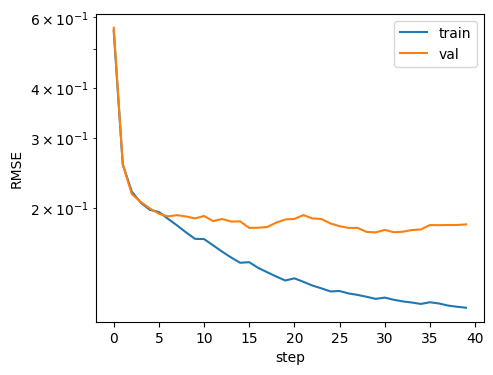

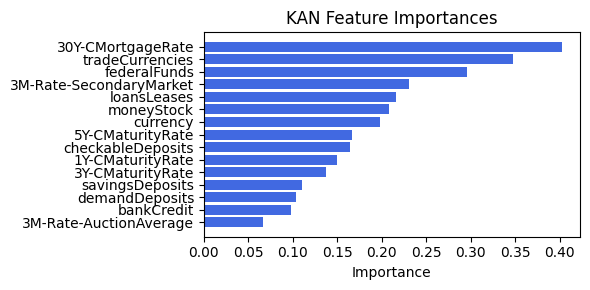

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.19it/s]

[('tradeCurrencies', 0.2825893436167722), ('loansLeases', 0.24970106897096792), ('savingsDeposits', 0.1986729313968681), ('1Y-CMaturityRate', 0.19189764718148147), ('3M-Rate-AuctionAverage', 0.17869186161052703), ('30Y-CMortgageRate', 0.17698997145053), ('moneyStock', 0.16199010857159182), ('federalFunds', 0.13448063711458375), ('3Y-CMaturityRate', 0.11535562461330777), ('demandDeposits', 0.11419007685700698), ('bankCredit', 0.10736874153981694), ('5Y-CMaturityRate', 0.10571745650266252), ('Ex1', 0.0702058997584529), ('checkableDeposits', 0.06676888423084858), ('currency', 0.058402327118009065), ('3M-Rate-SecondaryMarket', 0.05164482072993581)]


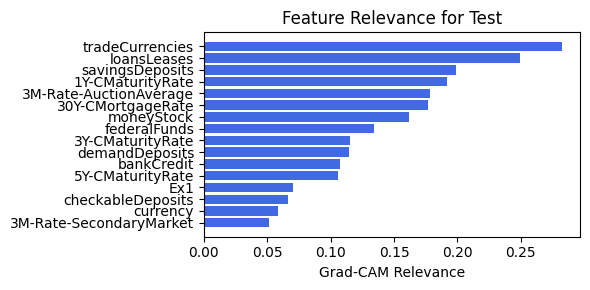

In [132]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.5, filename=filename_2, opt_col_val=0.5)

### 2.1.4. width=[15, 6, 1], grid=5, lamb=1e-05 | alpha=0.5

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.01e-01 | eval_loss: 1.81e-01 | reg: 1.63e+02 |: 100%|█| 40/40 [00:39<00:00,  1.02it/

saving model version 0.1
Best epoch 14
0.2382107824087143
M_KAN Relevance: 0.06445541977882385
CNN Relevance: 0.9355445504188538
[('30Y-CMortgageRate', 0.35350475), ('tradeCurrencies', 0.32575983), ('loansLeases', 0.24460447), ('3M-Rate-SecondaryMarket', 0.21276854), ('currency', 0.19998527), ('moneyStock', 0.19811091), ('federalFunds', 0.1885935), ('5Y-CMaturityRate', 0.17042875), ('checkableDeposits', 0.16510198), ('1Y-CMaturityRate', 0.14049155), ('3Y-CMaturityRate', 0.13184096), ('demandDeposits', 0.121739864), ('savingsDeposits', 0.11195493), ('bankCredit', 0.08471285), ('3M-Rate-AuctionAverage', 0.06368941)]


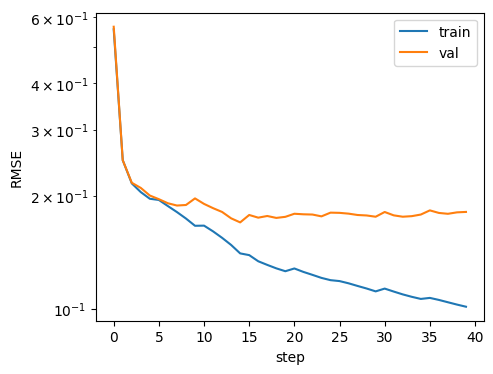

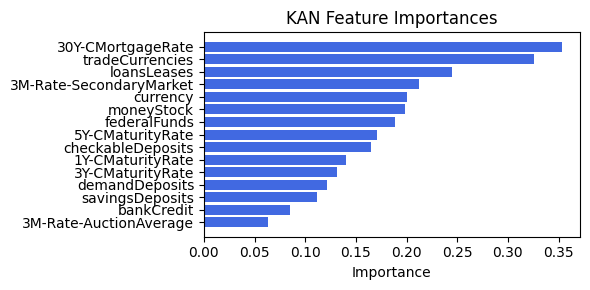

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.52it/s]

[('tradeCurrencies', 0.22678151703633678), ('loansLeases', 0.2015628942953689), ('savingsDeposits', 0.14733939629014847), ('3M-Rate-AuctionAverage', 0.07106220415305524), ('30Y-CMortgageRate', 0.07101573539631707), ('moneyStock', 0.06091079490510137), ('checkableDeposits', 0.05990084751198689), ('1Y-CMaturityRate', 0.05370181759021112), ('federalFunds', 0.050976492817114506), ('3M-Rate-SecondaryMarket', 0.049887464960504856), ('bankCredit', 0.046959363608177575), ('demandDeposits', 0.04588112464352023), ('5Y-CMaturityRate', 0.04392552742557157), ('3Y-CMaturityRate', 0.040443653462543375), ('currency', 0.037852006618465696), ('Ex1', 0.032776852286908596)]


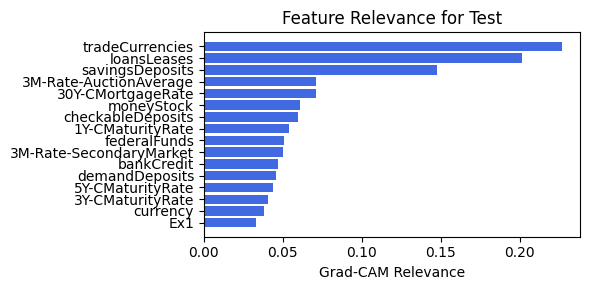

In [133]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.5, filename=filename_2, opt_col_val=0.5)

### 2.1.5. width=[15, 6, 1], grid=5, lamb=1e-05 | alpha=0.25

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 8.39e-02 | eval_loss: 1.82e-01 | reg: 1.57e+02 |: 100%|█| 40/40 [00:37<00:00,  1.05it/

saving model version 0.1
Best epoch 23
0.20568381249904633
M_KAN Relevance: 0.24815888702869415
CNN Relevance: 0.7518410682678223
[('moneyStock', 0.20755541), ('30Y-CMortgageRate', 0.1825374), ('checkableDeposits', 0.13142204), ('tradeCurrencies', 0.11637975), ('3Y-CMaturityRate', 0.115122676), ('3M-Rate-SecondaryMarket', 0.11340386), ('federalFunds', 0.09070501), ('savingsDeposits', 0.07798918), ('3M-Rate-AuctionAverage', 0.07242975), ('1Y-CMaturityRate', 0.064675905), ('5Y-CMaturityRate', 0.0642109), ('currency', 0.060712032), ('loansLeases', 0.058805298), ('bankCredit', 0.049240522), ('demandDeposits', 0.045739993)]


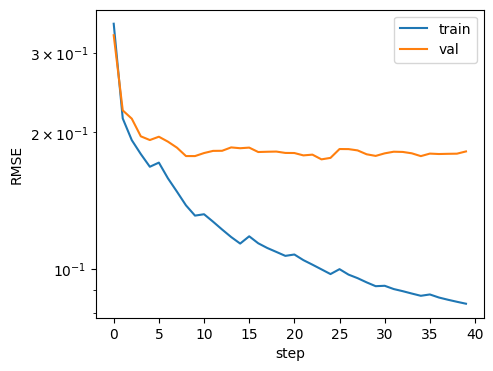

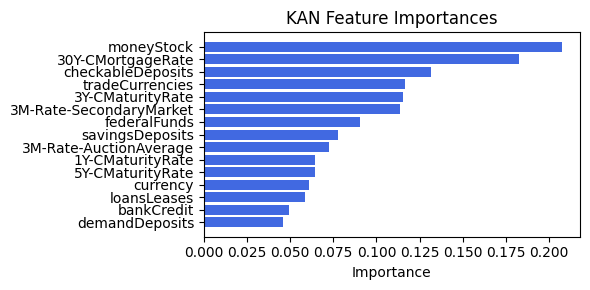

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  8.80it/s]

[('moneyStock', 0.28157193807197645), ('3M-Rate-AuctionAverage', 0.25286746770587), ('30Y-CMortgageRate', 0.24879433964157388), ('1Y-CMaturityRate', 0.24604065194282504), ('bankCredit', 0.2189720612706705), ('5Y-CMaturityRate', 0.2134012027067088), ('checkableDeposits', 0.1845502201426522), ('federalFunds', 0.18048510254371822), ('Ex1', 0.17563806996775036), ('currency', 0.1711523418542042), ('tradeCurrencies', 0.1497102016334663), ('3M-Rate-SecondaryMarket', 0.1438100922378778), ('3Y-CMaturityRate', 0.14254062849144075), ('demandDeposits', 0.1304974843075754), ('savingsDeposits', 0.10813422248964863), ('loansLeases', 0.10150004382067848)]


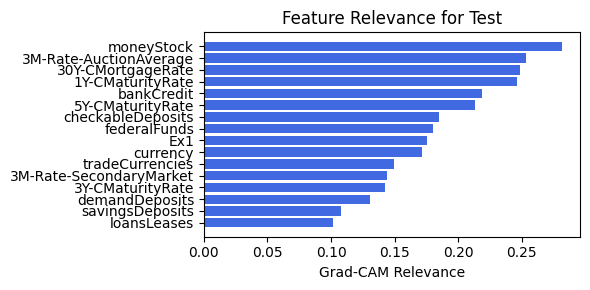

In [134]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.25, filename=filename_2, opt_col_val=0.25)

### 2.1.6. width=[15, 6, 1], grid=5, lamb=1e-05 | alpha=0.25

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 8.57e-02 | eval_loss: 1.91e-01 | reg: 1.46e+02 |: 100%|█| 40/40 [00:39<00:00,  1.01it/

saving model version 0.1
Best epoch 15
0.2088983952999115
M_KAN Relevance: 0.2834295332431793
CNN Relevance: 0.7165704965591431
[('30Y-CMortgageRate', 0.19348429), ('moneyStock', 0.18376146), ('checkableDeposits', 0.14498441), ('3Y-CMaturityRate', 0.123041354), ('tradeCurrencies', 0.122858405), ('3M-Rate-SecondaryMarket', 0.10415908), ('federalFunds', 0.09054659), ('savingsDeposits', 0.07994521), ('3M-Rate-AuctionAverage', 0.07736747), ('5Y-CMaturityRate', 0.07271629), ('loansLeases', 0.064603195), ('currency', 0.061065786), ('1Y-CMaturityRate', 0.057890177), ('bankCredit', 0.052554708), ('demandDeposits', 0.045631453)]


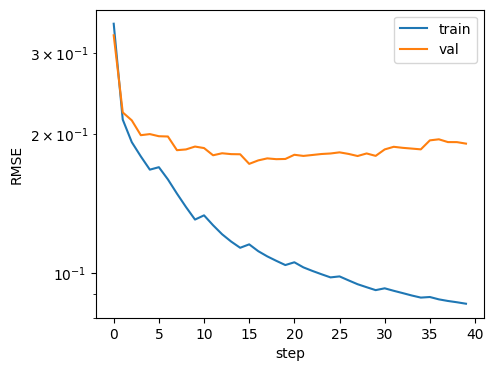

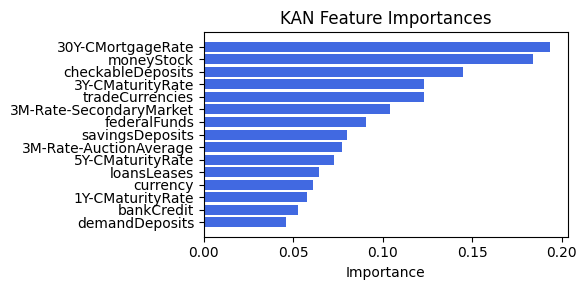

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.47it/s]

[('3M-Rate-SecondaryMarket', 0.34970041556239484), ('bankCredit', 0.3408382841208506), ('5Y-CMaturityRate', 0.33505858590665627), ('checkableDeposits', 0.32078120873110105), ('tradeCurrencies', 0.291668621233354), ('currency', 0.2825751981171336), ('3Y-CMaturityRate', 0.24994569971057076), ('federalFunds', 0.2424245431664444), ('3M-Rate-AuctionAverage', 0.20178657590101162), ('moneyStock', 0.19720293247096596), ('30Y-CMortgageRate', 0.19666307596933275), ('demandDeposits', 0.18468643827807335), ('savingsDeposits', 0.1547666507872886), ('1Y-CMaturityRate', 0.15192900031161982), ('Ex1', 0.13742710542310738), ('loansLeases', 0.13670760045005453)]


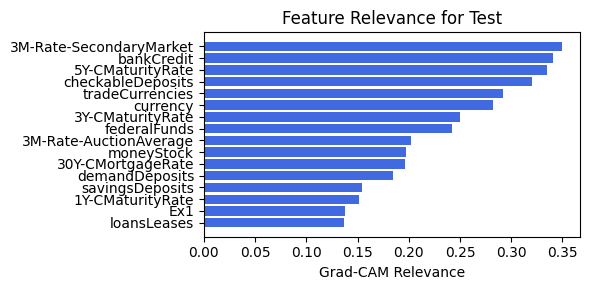

In [135]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.25, filename=filename_2, opt_col_val=0.25)

### 2.1.7 width=[15, 6, 1], grid=5, lamb=1e-05 | alpha=0.25

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 8.22e-02 | eval_loss: 1.80e-01 | reg: 1.55e+02 |: 100%|█| 50/50 [00:49<00:00,  1.02it/

saving model version 0.1
Best epoch 41
0.22561678290367126
M_KAN Relevance: 0.23632794618606567
CNN Relevance: 0.7636720538139343
[('30Y-CMortgageRate', 0.2298922), ('moneyStock', 0.19154263), ('tradeCurrencies', 0.14251886), ('checkableDeposits', 0.130373), ('3Y-CMaturityRate', 0.12740946), ('federalFunds', 0.11567019), ('3M-Rate-SecondaryMarket', 0.09166385), ('3M-Rate-AuctionAverage', 0.07450955), ('5Y-CMaturityRate', 0.0691555), ('loansLeases', 0.06775385), ('currency', 0.06486269), ('1Y-CMaturityRate', 0.064492404), ('savingsDeposits', 0.059272), ('demandDeposits', 0.05039084), ('bankCredit', 0.044902124)]


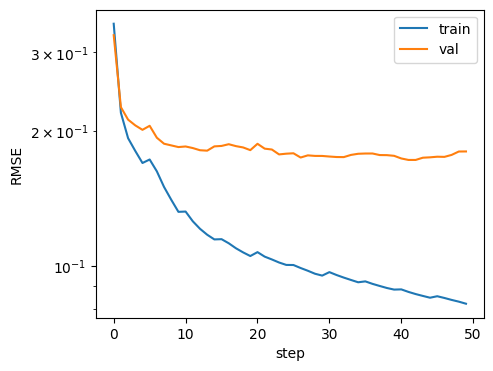

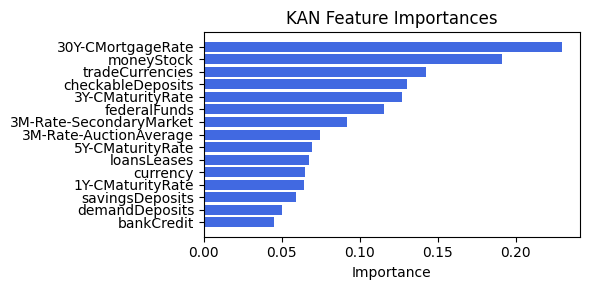

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  7.86it/s]


[('1Y-CMaturityRate', 0.27486344076737407), ('moneyStock', 0.2705936906415792), ('30Y-CMortgageRate', 0.26605381893348834), ('3M-Rate-AuctionAverage', 0.26588089564382766), ('bankCredit', 0.2044949622558696), ('5Y-CMaturityRate', 0.20079785551698434), ('federalFunds', 0.20029693240472365), ('3M-Rate-SecondaryMarket', 0.18166514025540978), ('3Y-CMaturityRate', 0.17549784751026892), ('demandDeposits', 0.17383556602026579), ('tradeCurrencies', 0.1659752413478037), ('currency', 0.16132566758626907), ('checkableDeposits', 0.16006326352085343), ('Ex1', 0.14856356349607397), ('savingsDeposits', 0.12630322495873164), ('loansLeases', 0.11434034506471237)]


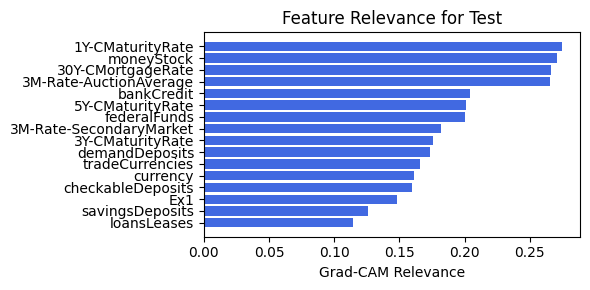

In [56]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=50, alpha=0.25, filename=filename_2, opt_col_val=0.25)

### 2.1.8 width=[15, 6, 1], grid=5, lamb=1e-05 | alpha=0.2

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 9.98e-02 | eval_loss: 1.96e-01 | reg: 1.43e+02 |: 100%|█| 40/40 [00:39<00:00,  1.01it/


saving model version 0.1
Best epoch 16
0.24961857497692108
M_KAN Relevance: 0.2653321623802185
CNN Relevance: 0.7346678376197815
[('moneyStock', 0.24379276), ('3M-Rate-SecondaryMarket', 0.2261456), ('30Y-CMortgageRate', 0.18503653), ('tradeCurrencies', 0.1627236), ('currency', 0.15666062), ('5Y-CMaturityRate', 0.1397526), ('3Y-CMaturityRate', 0.13709103), ('checkableDeposits', 0.12744729), ('1Y-CMaturityRate', 0.123184696), ('demandDeposits', 0.11146329), ('loansLeases', 0.10542919), ('savingsDeposits', 0.104540996), ('3M-Rate-AuctionAverage', 0.1034428), ('bankCredit', 0.08541786), ('federalFunds', 0.07465641)]


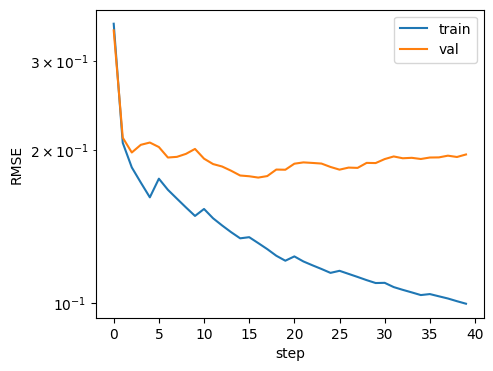

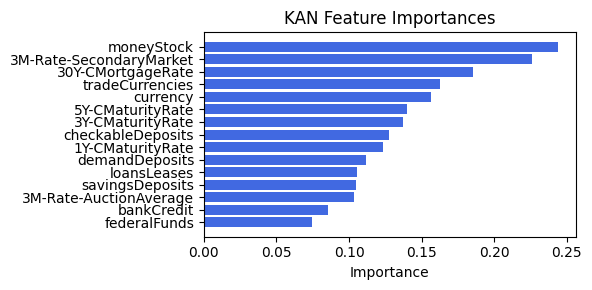

Computing Grad-CAM: 100%|██████████| 210/210 [00:28<00:00,  7.43it/s]


[('checkableDeposits', 0.25855910929052955), ('tradeCurrencies', 0.2525892324422741), ('moneyStock', 0.19650038710484902), ('bankCredit', 0.1718675056816123), ('5Y-CMaturityRate', 0.16578643586724953), ('savingsDeposits', 0.1558969620439235), ('Ex1', 0.152563706885225), ('3M-Rate-AuctionAverage', 0.13943128561423648), ('30Y-CMortgageRate', 0.1387642149318708), ('federalFunds', 0.1385894668177657), ('loansLeases', 0.13432048940809355), ('3M-Rate-SecondaryMarket', 0.13353907655858036), ('currency', 0.13298140870396136), ('1Y-CMaturityRate', 0.10865835630628724), ('3Y-CMaturityRate', 0.10336301170283974), ('demandDeposits', 0.09296013128394927)]


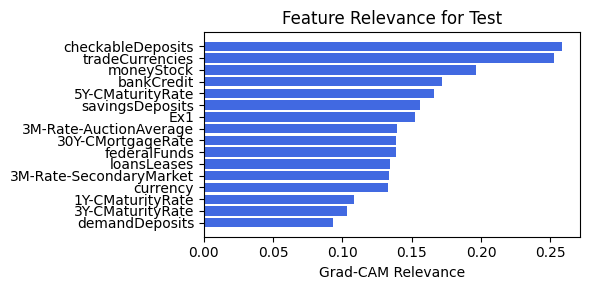

In [61]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=40, alpha=0.2, filename=filename_2, opt_col_val=0.2)

### 2.1.9 width=[15, 6, 1], grid=5, lamb=1e-05 | alpha=0.2

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 9.80e-02 | eval_loss: 1.80e-01 | reg: 1.49e+02 |: 100%|█| 40/40 [00:39<00:00,  1.02it/

saving model version 0.1
Best epoch 39
0.2829303741455078
M_KAN Relevance: 0.19873765110969543
CNN Relevance: 0.8012623190879822
[('moneyStock', 0.23913185), ('3M-Rate-SecondaryMarket', 0.23147643), ('3Y-CMaturityRate', 0.19143496), ('30Y-CMortgageRate', 0.16961472), ('currency', 0.1556878), ('tradeCurrencies', 0.13592148), ('5Y-CMaturityRate', 0.12864046), ('savingsDeposits', 0.1252912), ('checkableDeposits', 0.1212289), ('demandDeposits', 0.10565998), ('loansLeases', 0.09960766), ('1Y-CMaturityRate', 0.09397665), ('3M-Rate-AuctionAverage', 0.090968594), ('federalFunds', 0.08746235), ('bankCredit', 0.086028896)]


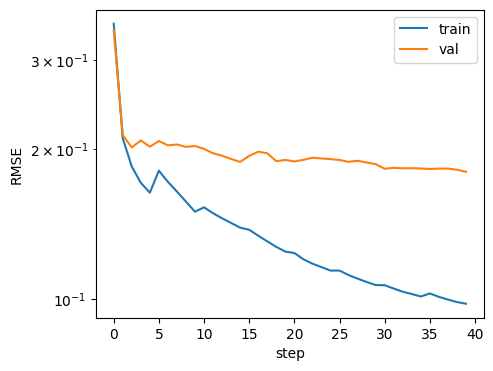

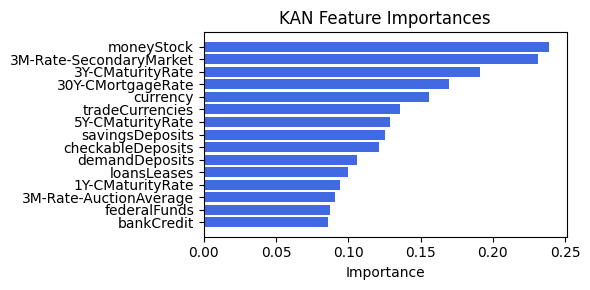

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  7.96it/s]


[('tradeCurrencies', 0.437214112486912), ('bankCredit', 0.31448463499102564), ('5Y-CMaturityRate', 0.303503137632894), ('3Y-CMaturityRate', 0.25240462819956955), ('federalFunds', 0.23640180859171475), ('moneyStock', 0.23380570925780506), ('Ex1', 0.20666241746817138), ('savingsDeposits', 0.19594179568396483), ('checkableDeposits', 0.17984644401197633), ('demandDeposits', 0.1633205462599151), ('3M-Rate-AuctionAverage', 0.15548418725541394), ('30Y-CMortgageRate', 0.15527060412624408), ('currency', 0.14962310732142733), ('1Y-CMaturityRate', 0.14018624133840646), ('loansLeases', 0.13814879722596657), ('3M-Rate-SecondaryMarket', 0.11772218639408016)]


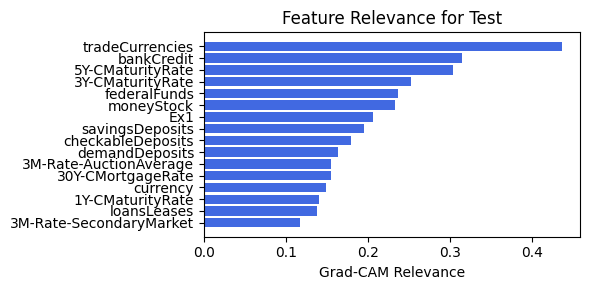

In [62]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=40, alpha=0.2, filename=filename_2, opt_col_val=0.2)

### 2.1.10 width=[15, 6, 1], grid=5, lamb=1e-05 | alpha=0.18

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 7.59e-02 | eval_loss: 1.96e-01 | reg: 1.58e+02 |: 100%|█| 60/60 [00:56<00:00,  1.06it/

saving model version 0.1
Best epoch 30
0.23483063280582428
M_KAN Relevance: 0.3063136041164398
CNN Relevance: 0.6936864256858826
[('moneyStock', 0.24860583), ('bankCredit', 0.2318459), ('3M-Rate-SecondaryMarket', 0.22500555), ('30Y-CMortgageRate', 0.21514522), ('5Y-CMaturityRate', 0.21440601), ('tradeCurrencies', 0.20540272), ('checkableDeposits', 0.20065628), ('federalFunds', 0.160233), ('currency', 0.13278958), ('1Y-CMaturityRate', 0.12318544), ('3Y-CMaturityRate', 0.11905023), ('3M-Rate-AuctionAverage', 0.11563049), ('loansLeases', 0.09494998), ('savingsDeposits', 0.09221403), ('demandDeposits', 0.059885643)]


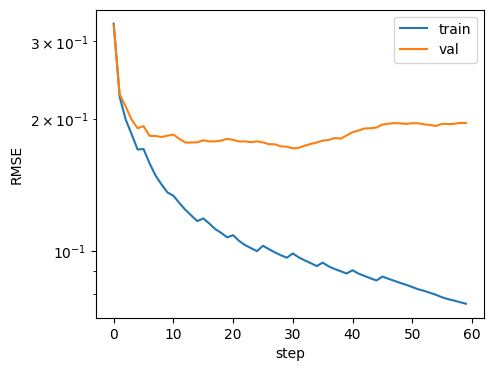

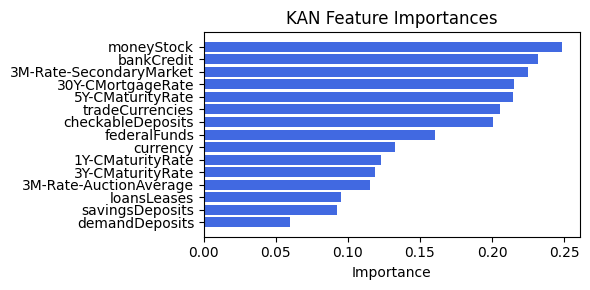

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.46it/s]


[('tradeCurrencies', 0.48610499553781533), ('bankCredit', 0.3705213070410537), ('5Y-CMaturityRate', 0.36921989294545104), ('3Y-CMaturityRate', 0.319041894895712), ('savingsDeposits', 0.3135571578356792), ('moneyStock', 0.2856823047024331), ('federalFunds', 0.27841300240889677), ('loansLeases', 0.2607065932560155), ('3M-Rate-AuctionAverage', 0.24207410686871125), ('30Y-CMortgageRate', 0.23880960414452213), ('1Y-CMaturityRate', 0.23508205458167053), ('Ex1', 0.22373176816008275), ('demandDeposits', 0.2068490576797298), ('currency', 0.12643515232373917), ('checkableDeposits', 0.09995278564352443), ('3M-Rate-SecondaryMarket', 0.0797122602550579)]


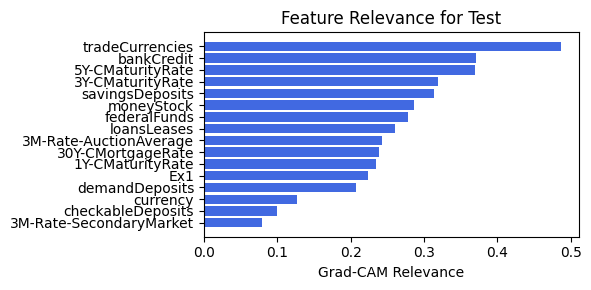

In [71]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=60, alpha=0.18, filename=filename_2, opt_col_val=0.18)

### 2.1.10 width=[15, 6, 1], grid=5, lamb=1e-05 | alpha=0.18

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 7.59e-02 | eval_loss: 1.96e-01 | reg: 1.58e+02 |: 100%|█| 60/60 [00:58<00:00,  1.03it/

saving model version 0.1
Best epoch 30
0.23483063280582428
M_KAN Relevance: 0.3063136041164398
CNN Relevance: 0.6936864256858826
[('moneyStock', 0.24860583), ('bankCredit', 0.2318459), ('3M-Rate-SecondaryMarket', 0.22500555), ('30Y-CMortgageRate', 0.21514522), ('5Y-CMaturityRate', 0.21440601), ('tradeCurrencies', 0.20540272), ('checkableDeposits', 0.20065628), ('federalFunds', 0.160233), ('currency', 0.13278958), ('1Y-CMaturityRate', 0.12318544), ('3Y-CMaturityRate', 0.11905023), ('3M-Rate-AuctionAverage', 0.11563049), ('loansLeases', 0.09494998), ('savingsDeposits', 0.09221403), ('demandDeposits', 0.059885643)]


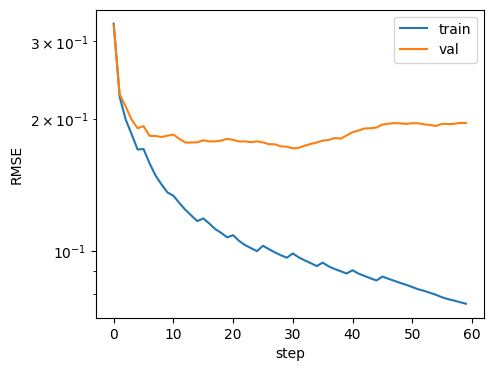

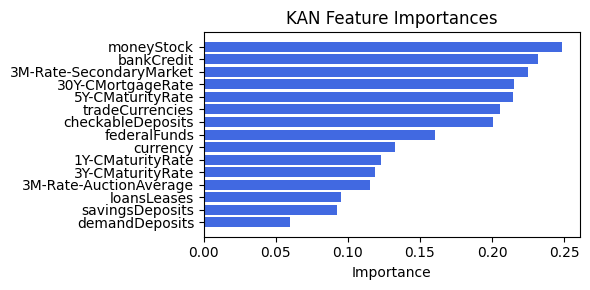

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  7.91it/s]

[('tradeCurrencies', 0.48610499553781533), ('bankCredit', 0.3705213070410537), ('5Y-CMaturityRate', 0.36921989294545104), ('3Y-CMaturityRate', 0.319041894895712), ('savingsDeposits', 0.3135571578356792), ('moneyStock', 0.2856823047024331), ('federalFunds', 0.27841300240889677), ('loansLeases', 0.2607065932560155), ('3M-Rate-AuctionAverage', 0.24207410686871125), ('30Y-CMortgageRate', 0.23880960414452213), ('1Y-CMaturityRate', 0.23508205458167053), ('Ex1', 0.22373176816008275), ('demandDeposits', 0.2068490576797298), ('currency', 0.12643515232373917), ('checkableDeposits', 0.09995278564352443), ('3M-Rate-SecondaryMarket', 0.0797122602550579)]


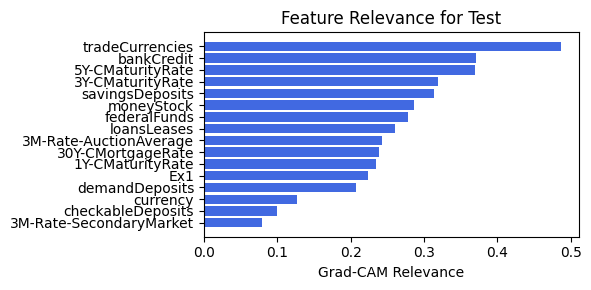

In [70]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=60, alpha=0.18, filename=filename_2, opt_col_val=0.18)

### 2.1.10 width=[15, 6, 1], grid=5, lamb=1e-05 | alpha=0.15

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 8.60e-02 | eval_loss: 1.95e-01 | reg: 1.56e+02 |: 100%|█| 60/60 [00:56<00:00,  1.07it/

saving model version 0.1
Best epoch 18
0.23872263729572296
M_KAN Relevance: 0.3487001955509186
CNN Relevance: 0.651299774646759
[('moneyStock', 0.24770951), ('checkableDeposits', 0.1748145), ('tradeCurrencies', 0.15288953), ('3Y-CMaturityRate', 0.14729613), ('5Y-CMaturityRate', 0.13071129), ('loansLeases', 0.12852812), ('30Y-CMortgageRate', 0.1279529), ('3M-Rate-SecondaryMarket', 0.12293954), ('3M-Rate-AuctionAverage', 0.10184701), ('currency', 0.08681786), ('federalFunds', 0.08669506), ('bankCredit', 0.084548235), ('1Y-CMaturityRate', 0.08187109), ('savingsDeposits', 0.079159096), ('demandDeposits', 0.04719932)]


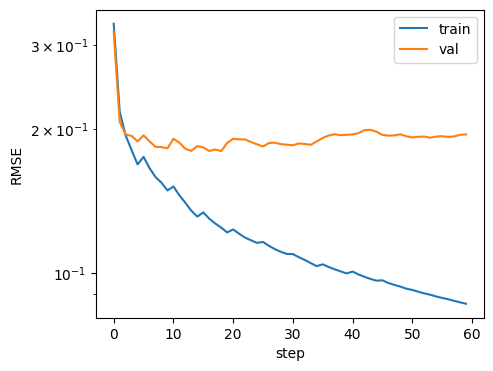

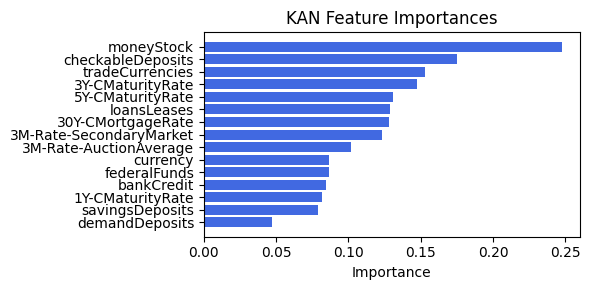

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  7.91it/s]

[('1Y-CMaturityRate', 0.26423490712172465), ('3M-Rate-AuctionAverage', 0.20086695754684375), ('30Y-CMortgageRate', 0.19664041524534004), ('moneyStock', 0.19141218032288765), ('loansLeases', 0.1898662511706962), ('tradeCurrencies', 0.17115321171503248), ('savingsDeposits', 0.16965517418578938), ('federalFunds', 0.09947310122273241), ('checkableDeposits', 0.08784817768914979), ('demandDeposits', 0.07840033714227113), ('Ex1', 0.07351339103216084), ('3Y-CMaturityRate', 0.06397768999616216), ('5Y-CMaturityRate', 0.06065139449284678), ('bankCredit', 0.058854488721339124), ('3M-Rate-SecondaryMarket', 0.04797600428310467), ('currency', 0.04743470533881226)]


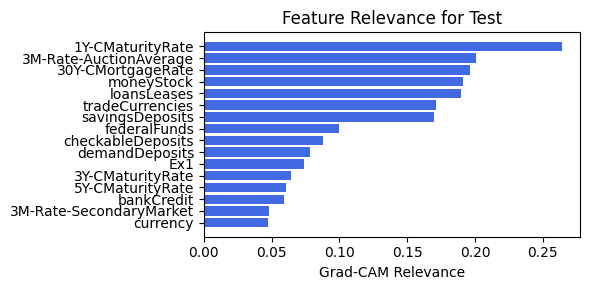

In [63]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=60, alpha=0.15, filename=filename_2, opt_col_val=0.15)

### 2.1.11 width=[15, 6, 1], grid=5, lamb=1e-05 | alpha=0.15

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 8.93e-02 | eval_loss: 1.95e-01 | reg: 1.54e+02 |: 100%|█| 60/60 [00:57<00:00,  1.04it/

saving model version 0.1
Best epoch 8
0.23473623394966125
M_KAN Relevance: 0.43108847737312317
CNN Relevance: 0.5689115524291992
[('moneyStock', 0.23747101), ('checkableDeposits', 0.16999444), ('3Y-CMaturityRate', 0.14243203), ('3M-Rate-SecondaryMarket', 0.13762638), ('5Y-CMaturityRate', 0.1367851), ('loansLeases', 0.13535315), ('tradeCurrencies', 0.1341936), ('1Y-CMaturityRate', 0.11729243), ('30Y-CMortgageRate', 0.10506692), ('currency', 0.101491466), ('savingsDeposits', 0.087730035), ('3M-Rate-AuctionAverage', 0.0860395), ('federalFunds', 0.08352111), ('bankCredit', 0.06758756), ('demandDeposits', 0.060569923)]


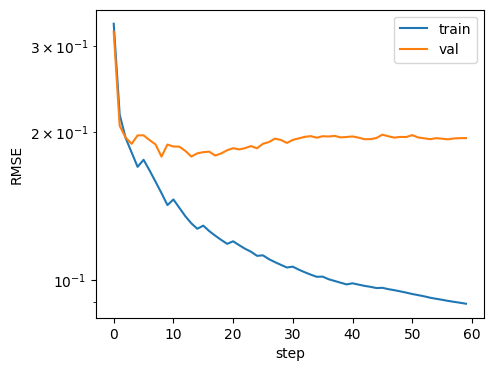

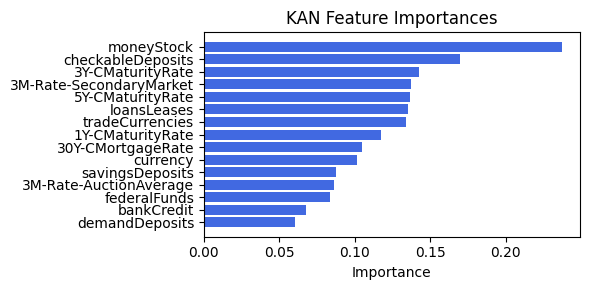

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  7.83it/s]

[('Ex1', 0.1869173413142562), ('1Y-CMaturityRate', 0.13223943253979087), ('loansLeases', 0.10635400977972452), ('tradeCurrencies', 0.10538315873903532), ('savingsDeposits', 0.08732234876550224), ('30Y-CMortgageRate', 0.03178433213283175), ('moneyStock', 0.03136375060005646), ('3M-Rate-AuctionAverage', 0.030213595687278678), ('federalFunds', 0.029576108037006287), ('demandDeposits', 0.0277427051925943), ('checkableDeposits', 0.02393414267959694), ('5Y-CMaturityRate', 0.022717311100236007), ('bankCredit', 0.022011514322920925), ('3Y-CMaturityRate', 0.02168941287479053), ('currency', 0.01794111647399231), ('3M-Rate-SecondaryMarket', 0.010418747163133785)]


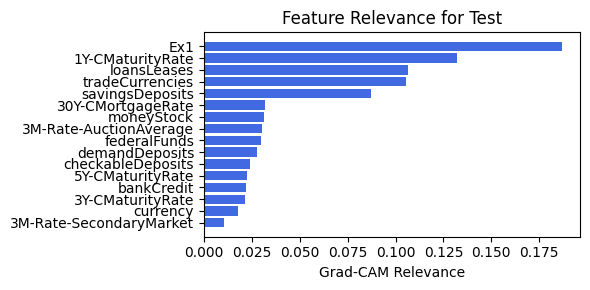

In [64]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=60, alpha=0.15, filename=filename_2, opt_col_val=0.15)

### 2.1.12 width=[15, 6, 1], grid=5, lamb=1e-05 | alpha=0.15

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 8.50e-02 | eval_loss: 1.76e-01 | reg: 1.52e+02 |: 100%|█| 40/40 [00:38<00:00,  1.05it/

saving model version 0.1
Best epoch 33
0.19465455412864685
M_KAN Relevance: 0.25622329115867615
CNN Relevance: 0.7437766790390015
[('moneyStock', 0.16993313), ('3M-Rate-SecondaryMarket', 0.14418173), ('3Y-CMaturityRate', 0.13993171), ('30Y-CMortgageRate', 0.1361419), ('federalFunds', 0.13079129), ('5Y-CMaturityRate', 0.11856085), ('loansLeases', 0.11710366), ('1Y-CMaturityRate', 0.1035171), ('currency', 0.088031515), ('demandDeposits', 0.08681047), ('checkableDeposits', 0.08662428), ('savingsDeposits', 0.06823651), ('3M-Rate-AuctionAverage', 0.06303336), ('tradeCurrencies', 0.06165519), ('bankCredit', 0.051687688)]


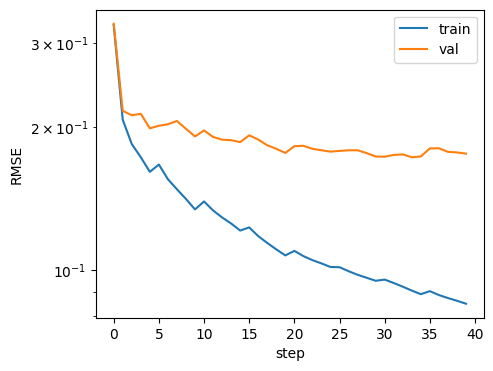

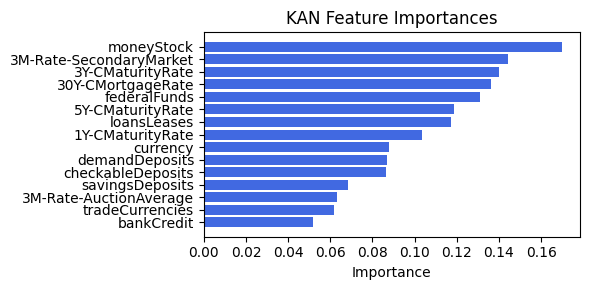

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.22it/s]


[('Ex1', 0.3746658591082364), ('tradeCurrencies', 0.17540390636680794), ('currency', 0.1724223710496777), ('savingsDeposits', 0.1614564403910966), ('moneyStock', 0.14924242270533883), ('bankCredit', 0.14048316798150717), ('5Y-CMaturityRate', 0.13947849477048122), ('federalFunds', 0.1388842314524698), ('3Y-CMaturityRate', 0.12923853986042863), ('loansLeases', 0.11654507399071008), ('demandDeposits', 0.11320072449272543), ('checkableDeposits', 0.09827741385060584), ('1Y-CMaturityRate', 0.09512389727100352), ('3M-Rate-SecondaryMarket', 0.0807672604380752), ('3M-Rate-AuctionAverage', 0.0750398482905612), ('30Y-CMortgageRate', 0.07487958161426442)]


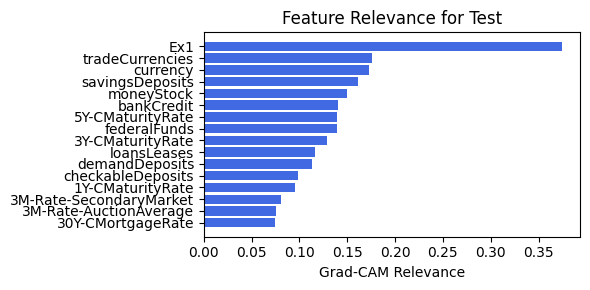

In [66]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.1, filename=filename_2, opt_col_val=0.1)

### 2.1.13 width=[15, 6, 1], grid=5, lamb=1e-05 | alpha=0.13

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.01e-01 | eval_loss: 1.93e-01 | reg: 1.35e+02 |: 100%|█| 40/40 [00:39<00:00,  1.01it/


saving model version 0.1
Best epoch 26
0.22284206748008728
M_KAN Relevance: 0.31591930985450745
CNN Relevance: 0.6840806603431702
[('moneyStock', 0.19361791), ('3Y-CMaturityRate', 0.17816702), ('checkableDeposits', 0.16031414), ('3M-Rate-SecondaryMarket', 0.13192077), ('5Y-CMaturityRate', 0.124043375), ('federalFunds', 0.12198751), ('30Y-CMortgageRate', 0.118194185), ('savingsDeposits', 0.1098411), ('loansLeases', 0.09966655), ('3M-Rate-AuctionAverage', 0.09140454), ('demandDeposits', 0.07641299), ('tradeCurrencies', 0.072326556), ('1Y-CMaturityRate', 0.067802295), ('currency', 0.06458241), ('bankCredit', 0.056617737)]


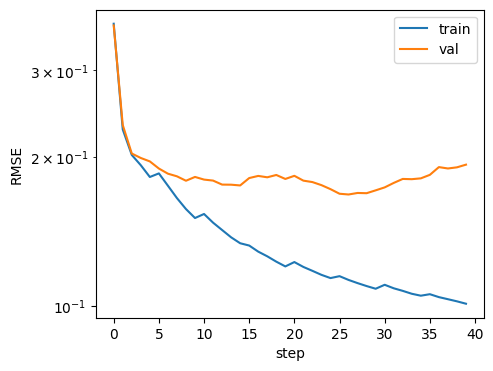

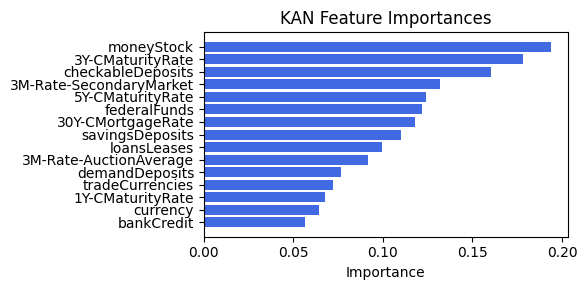

Computing Grad-CAM: 100%|██████████| 210/210 [00:28<00:00,  7.48it/s]


[('tradeCurrencies', 0.3805050092438857), ('loansLeases', 0.23681296174015318), ('savingsDeposits', 0.22922184032476728), ('Ex1', 0.17012675978199002), ('demandDeposits', 0.12097709044437147), ('3Y-CMaturityRate', 0.11520139862938474), ('federalFunds', 0.11007495626219593), ('5Y-CMaturityRate', 0.10230782438531086), ('bankCredit', 0.09484287356469957), ('1Y-CMaturityRate', 0.0722755008266263), ('moneyStock', 0.07212264599788579), ('30Y-CMortgageRate', 0.053834893555349914), ('currency', 0.05216151412931227), ('3M-Rate-AuctionAverage', 0.05044257045235662), ('3M-Rate-SecondaryMarket', 0.03041262050891029), ('checkableDeposits', 0.023635525530248527)]


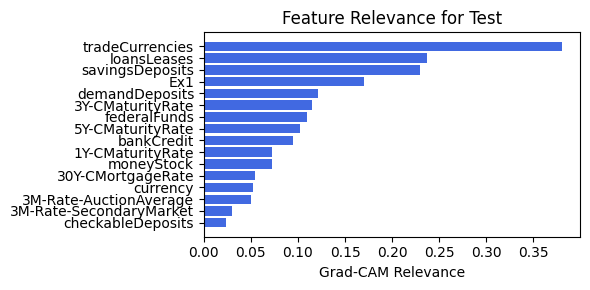

In [67]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=40, alpha=0.13, filename=filename_2, opt_col_val=0.13)

### 2.1.13 width=[15, 6, 1], grid=5, lamb=1e-05 | alpha=0.13

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.00e-01 | eval_loss: 2.28e-01 | reg: 1.43e+02 |: 100%|█| 40/40 [00:39<00:00,  1.00it/


saving model version 0.1
Best epoch 12
0.23841030895709991
M_KAN Relevance: 0.42199403047561646
CNN Relevance: 0.5780059695243835
[('moneyStock', 0.21278022), ('3Y-CMaturityRate', 0.17945245), ('checkableDeposits', 0.1708158), ('5Y-CMaturityRate', 0.13978335), ('3M-Rate-SecondaryMarket', 0.13361698), ('savingsDeposits', 0.12451361), ('30Y-CMortgageRate', 0.1213337), ('federalFunds', 0.117844895), ('3M-Rate-AuctionAverage', 0.10743668), ('loansLeases', 0.09752499), ('1Y-CMaturityRate', 0.091930196), ('tradeCurrencies', 0.083408356), ('currency', 0.07637137), ('demandDeposits', 0.07448632), ('bankCredit', 0.043189384)]


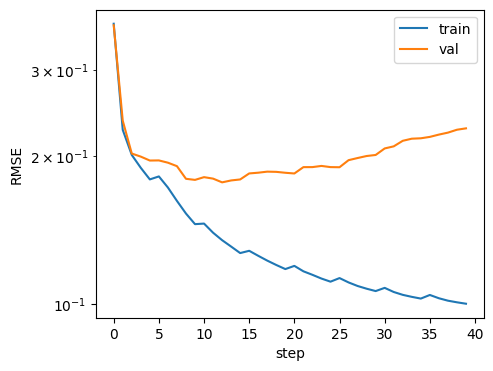

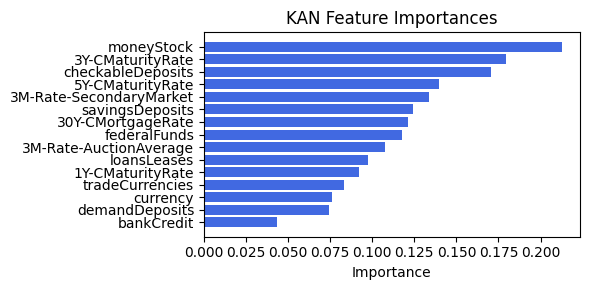

Computing Grad-CAM: 100%|██████████| 210/210 [00:27<00:00,  7.72it/s]


[('tradeCurrencies', 0.401183393177399), ('bankCredit', 0.25567242627564285), ('5Y-CMaturityRate', 0.25205116774665104), ('savingsDeposits', 0.23677341224974952), ('loansLeases', 0.21326448233365747), ('federalFunds', 0.2037918927885628), ('moneyStock', 0.2037883012511191), ('3Y-CMaturityRate', 0.19340930542065984), ('Ex1', 0.17482035556223266), ('demandDeposits', 0.16705572425160511), ('3M-Rate-AuctionAverage', 0.14335108028358912), ('30Y-CMortgageRate', 0.13688113636897123), ('currency', 0.1197037420949311), ('checkableDeposits', 0.10962863998443242), ('1Y-CMaturityRate', 0.10378303653560579), ('3M-Rate-SecondaryMarket', 0.08683136453951842)]


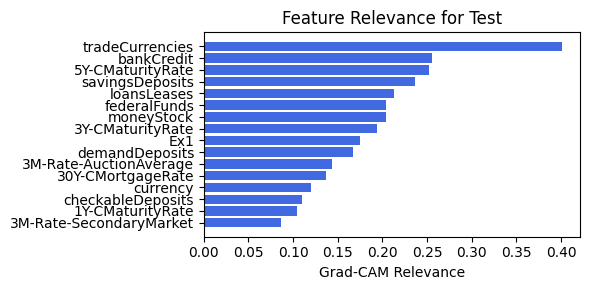

In [68]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=40, alpha=0.13, filename=filename_2, opt_col_val=0.13)

### 2.1.12 width=[15, 6, 1], grid=5, lamb=1e-05 | alpha=0.1

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 8.50e-02 | eval_loss: 1.76e-01 | reg: 1.52e+02 |: 100%|█| 40/40 [00:40<00:00,  1.00s/i

saving model version 0.1
Best epoch 33
0.19465455412864685
M_KAN Relevance: 0.25622329115867615
CNN Relevance: 0.7437766790390015
[('moneyStock', 0.16993313), ('3M-Rate-SecondaryMarket', 0.14418173), ('3Y-CMaturityRate', 0.13993171), ('30Y-CMortgageRate', 0.1361419), ('federalFunds', 0.13079129), ('5Y-CMaturityRate', 0.11856085), ('loansLeases', 0.11710366), ('1Y-CMaturityRate', 0.1035171), ('currency', 0.088031515), ('demandDeposits', 0.08681047), ('checkableDeposits', 0.08662428), ('savingsDeposits', 0.06823651), ('3M-Rate-AuctionAverage', 0.06303336), ('tradeCurrencies', 0.06165519), ('bankCredit', 0.051687688)]


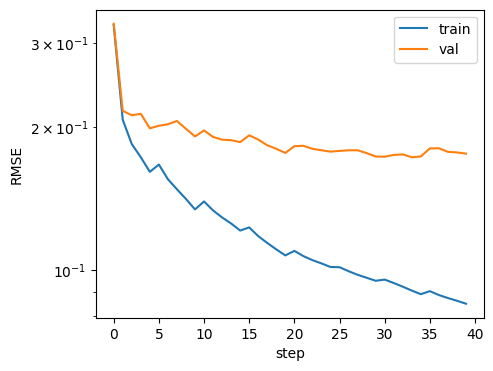

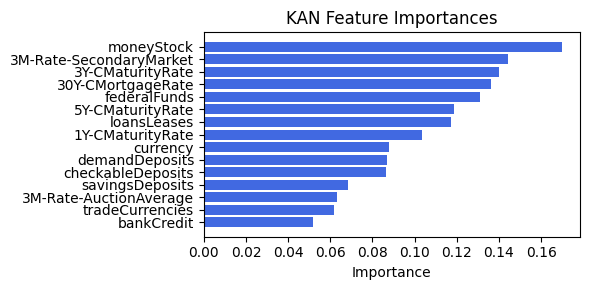

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  8.91it/s]

[('Ex1', 0.3746658591082364), ('tradeCurrencies', 0.17540390636680794), ('currency', 0.1724223710496777), ('savingsDeposits', 0.1614564403910966), ('moneyStock', 0.14924242270533883), ('bankCredit', 0.14048316798150717), ('5Y-CMaturityRate', 0.13947849477048122), ('federalFunds', 0.1388842314524698), ('3Y-CMaturityRate', 0.12923853986042863), ('loansLeases', 0.11654507399071008), ('demandDeposits', 0.11320072449272543), ('checkableDeposits', 0.09827741385060584), ('1Y-CMaturityRate', 0.09512389727100352), ('3M-Rate-SecondaryMarket', 0.0807672604380752), ('3M-Rate-AuctionAverage', 0.0750398482905612), ('30Y-CMortgageRate', 0.07487958161426442)]


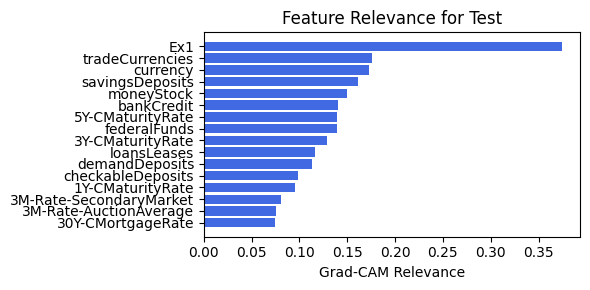

In [136]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.1, filename=filename_2, opt_col_val=0.1)

### 2.1.13 width=[15, 6, 1], grid=5, lamb=1e-05 | alpha=0.1

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 9.63e-02 | eval_loss: 1.74e-01 | reg: 1.49e+02 |: 100%|█| 40/40 [00:38<00:00,  1.03it/

saving model version 0.1
Best epoch 39
0.2307395040988922
M_KAN Relevance: 0.2444632351398468
CNN Relevance: 0.7555367946624756
[('moneyStock', 0.21456608), ('3Y-CMaturityRate', 0.18645921), ('30Y-CMortgageRate', 0.16692625), ('loansLeases', 0.16541003), ('3M-Rate-SecondaryMarket', 0.1648641), ('5Y-CMaturityRate', 0.12417579), ('currency', 0.12132023), ('federalFunds', 0.117821336), ('demandDeposits', 0.11643132), ('1Y-CMaturityRate', 0.112835035), ('bankCredit', 0.09864446), ('checkableDeposits', 0.09404191), ('3M-Rate-AuctionAverage', 0.07889019), ('savingsDeposits', 0.078145705), ('tradeCurrencies', 0.062450226)]


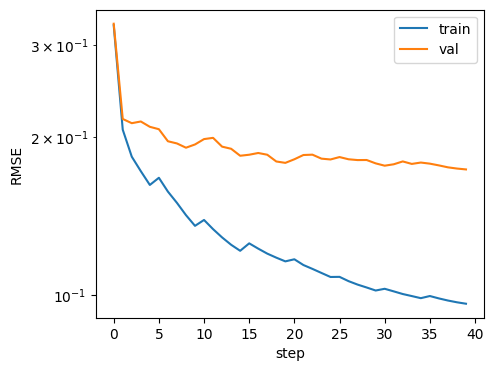

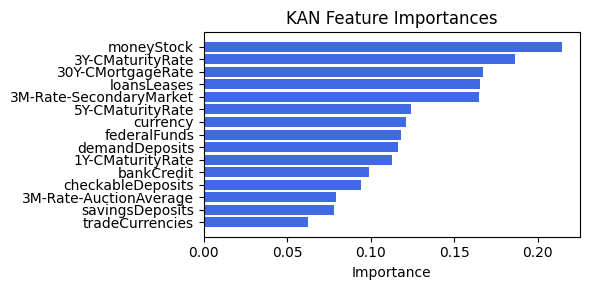

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.66it/s]

[('Ex1', 0.39281786661040746), ('currency', 0.31484598463755986), ('checkableDeposits', 0.27023324986387576), ('3M-Rate-SecondaryMarket', 0.21621917488186487), ('tradeCurrencies', 0.0983096838862236), ('savingsDeposits', 0.09464219955386527), ('loansLeases', 0.05222343086248397), ('moneyStock', 0.043367973331450704), ('5Y-CMaturityRate', 0.03925655257245082), ('bankCredit', 0.0388653592672199), ('1Y-CMaturityRate', 0.03448425407432729), ('30Y-CMortgageRate', 0.02831125792193537), ('3M-Rate-AuctionAverage', 0.026919496360988844), ('3Y-CMaturityRate', 0.02131563656120783), ('federalFunds', 0.019523566548308564), ('demandDeposits', 0.01703635417146697)]


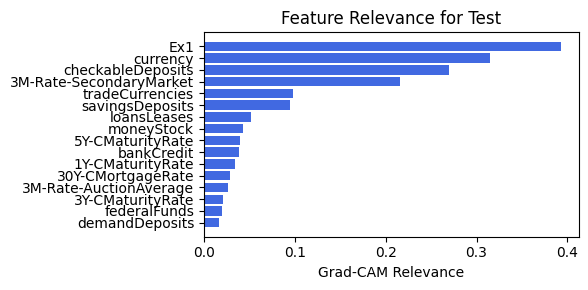

In [137]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.1, filename=filename_2, opt_col_val=0.1)

### 2.1.14 width=[15, 6, 1], grid=5, lamb=1e-05 | alpha=0.05

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 8.85e-02 | eval_loss: 2.54e-01 | reg: 1.92e+02 |: 100%|█| 40/40 [00:37<00:00,  1.06it/

saving model version 0.1
Best epoch 19
0.23536278307437897
M_KAN Relevance: 0.150605246424675
CNN Relevance: 0.8493947386741638
[('moneyStock', 0.22936681), ('checkableDeposits', 0.19265446), ('3Y-CMaturityRate', 0.18552178), ('3M-Rate-SecondaryMarket', 0.17950737), ('bankCredit', 0.16158548), ('currency', 0.1576097), ('federalFunds', 0.1563788), ('3M-Rate-AuctionAverage', 0.15113054), ('30Y-CMortgageRate', 0.12838954), ('5Y-CMaturityRate', 0.12594005), ('demandDeposits', 0.12236949), ('loansLeases', 0.11701211), ('savingsDeposits', 0.11650597), ('tradeCurrencies', 0.10119053), ('1Y-CMaturityRate', 0.08944135)]


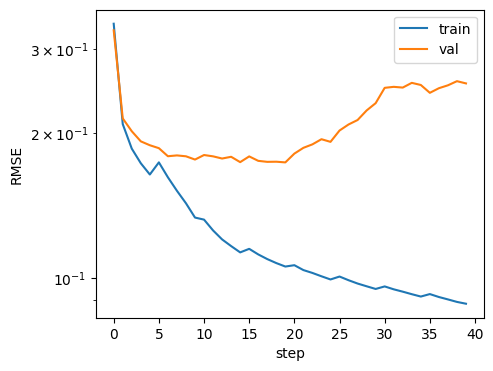

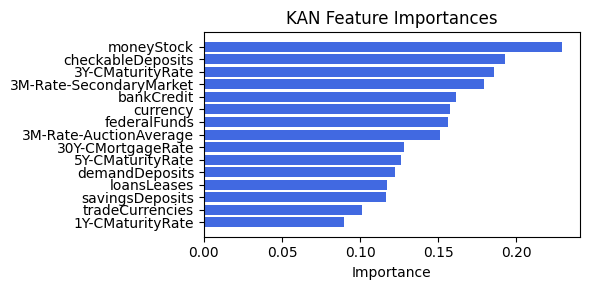

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.55it/s]


[('checkableDeposits', 0.2396123031137644), ('Ex1', 0.23234724853176714), ('currency', 0.20323614159798517), ('3M-Rate-SecondaryMarket', 0.2010742420365291), ('tradeCurrencies', 0.16086256602845553), ('loansLeases', 0.12676897805954684), ('savingsDeposits', 0.12467629415609519), ('moneyStock', 0.09314551148619059), ('1Y-CMaturityRate', 0.07356124395598834), ('30Y-CMortgageRate', 0.07075805183987888), ('3M-Rate-AuctionAverage', 0.06873169144881623), ('federalFunds', 0.06361978049597902), ('5Y-CMaturityRate', 0.05878481147893971), ('bankCredit', 0.05815273301909439), ('3Y-CMaturityRate', 0.05660585553241184), ('demandDeposits', 0.05639640236040577)]


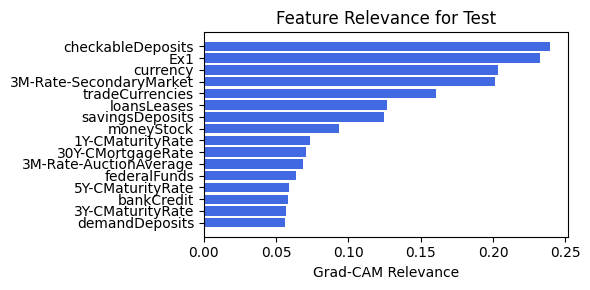

In [138]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.05, filename=filename_2, opt_col_val=0.05)

### 2.1.15 width=[15, 6, 1], grid=5, lamb=1e-05 | alpha=0.05

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 9.38e-02 | eval_loss: 1.69e-01 | reg: 1.96e+02 |: 100%|█| 40/40 [00:38<00:00,  1.04it/

saving model version 0.1
Best epoch 18
0.21687369048595428
M_KAN Relevance: 0.13900066912174225
CNN Relevance: 0.860999345779419
[('moneyStock', 0.24610287), ('3Y-CMaturityRate', 0.21863048), ('checkableDeposits', 0.21779013), ('3M-Rate-SecondaryMarket', 0.21082833), ('currency', 0.2076287), ('bankCredit', 0.1927869), ('federalFunds', 0.17660227), ('3M-Rate-AuctionAverage', 0.16554455), ('loansLeases', 0.15441099), ('savingsDeposits', 0.15335378), ('demandDeposits', 0.15002379), ('5Y-CMaturityRate', 0.1457237), ('30Y-CMortgageRate', 0.13470778), ('1Y-CMaturityRate', 0.11934292), ('tradeCurrencies', 0.11327897)]


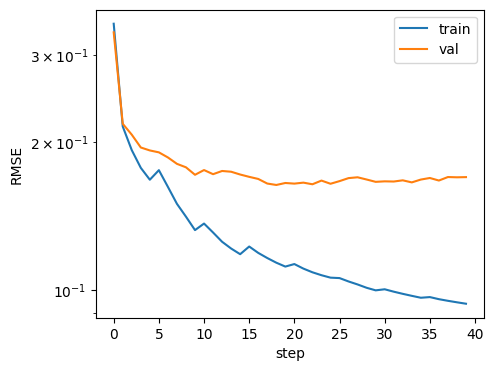

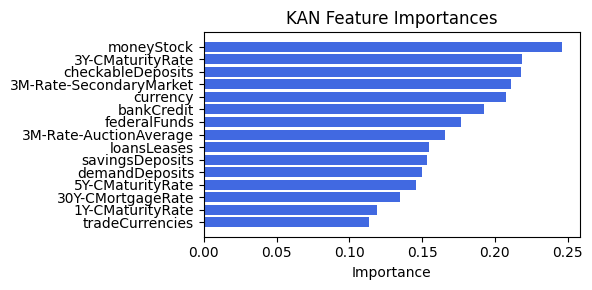

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.23it/s]

[('checkableDeposits', 0.24280744643294297), ('3M-Rate-SecondaryMarket', 0.2376279519312361), ('tradeCurrencies', 0.23083190076119667), ('loansLeases', 0.1992771497936961), ('savingsDeposits', 0.17070523945363847), ('currency', 0.08063119615636381), ('Ex1', 0.07404766119905704), ('demandDeposits', 0.0606611236131617), ('3Y-CMaturityRate', 0.059304291750803324), ('1Y-CMaturityRate', 0.055070048109406515), ('30Y-CMortgageRate', 0.04296647305025198), ('3M-Rate-AuctionAverage', 0.041543828290776304), ('federalFunds', 0.03918857220227697), ('bankCredit', 0.038246361363036115), ('5Y-CMaturityRate', 0.038213552901565674), ('moneyStock', 0.03767277583482653)]


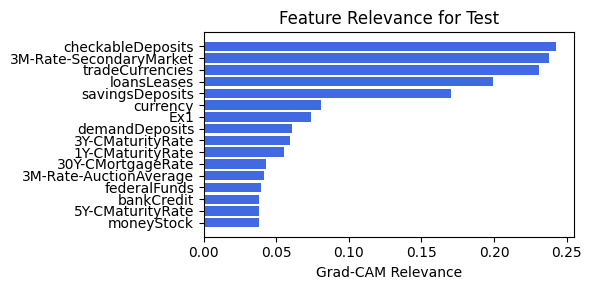

In [139]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=40, alpha=0.05, filename=filename_2, opt_col_val=0.05)

### 2.1.16 width=[15, 6, 1], grid=5, lamb=1e-05 | alpha=0.025

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.02e-01 | eval_loss: 1.70e-01 | reg: 1.74e+02 |: 100%|█| 25/25 [00:23<00:00,  1.05it/

saving model version 0.1
Best epoch 9
0.2316489964723587
M_KAN Relevance: 0.16798852384090424
CNN Relevance: 0.8320114612579346
[('moneyStock', 0.24636212), ('checkableDeposits', 0.22978863), ('3Y-CMaturityRate', 0.21746007), ('3M-Rate-SecondaryMarket', 0.21530233), ('currency', 0.19650137), ('bankCredit', 0.19322664), ('federalFunds', 0.17600177), ('3M-Rate-AuctionAverage', 0.15859705), ('loansLeases', 0.15699841), ('5Y-CMaturityRate', 0.15172377), ('savingsDeposits', 0.14964491), ('demandDeposits', 0.13781029), ('30Y-CMortgageRate', 0.133582), ('tradeCurrencies', 0.120114386), ('1Y-CMaturityRate', 0.11401393)]


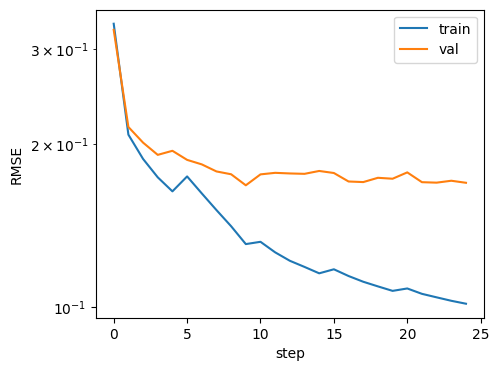

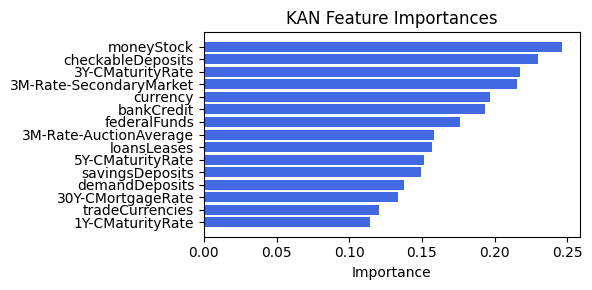

Computing Grad-CAM:  34%|███▍      | 72/210 [00:09<00:18,  7.51it/s]


KeyboardInterrupt: 

In [60]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=25, alpha=0.05, filename=filename_2, opt_col_val=0.05)

## 2.2 width=[15, 1, 1], grid=5, lamb=1e-05

### 2.2.1. width=[15, 1, 1], grid=5, lamb=1e-05 | alpha=0.75

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.20e-01 | eval_loss: 2.01e-01 | reg: 1.25e+02 |: 100%|█| 40/40 [00:39<00:00,  1.02it/

saving model version 0.1
Best epoch 23
0.22105364501476288
M_KAN Relevance: 0.003428601659834385
CNN Relevance: 0.9965714812278748
[('tradeCurrencies', 0.23146859), ('currency', 0.19884463), ('loansLeases', 0.1708445), ('1Y-CMaturityRate', 0.16240719), ('30Y-CMortgageRate', 0.12997474), ('bankCredit', 0.12938216), ('moneyStock', 0.12820439), ('savingsDeposits', 0.12341894), ('3M-Rate-AuctionAverage', 0.11204405), ('federalFunds', 0.10099941), ('5Y-CMaturityRate', 0.09454896), ('3Y-CMaturityRate', 0.0751645), ('demandDeposits', 0.067863315), ('3M-Rate-SecondaryMarket', 0.06531), ('checkableDeposits', 0.020590615)]


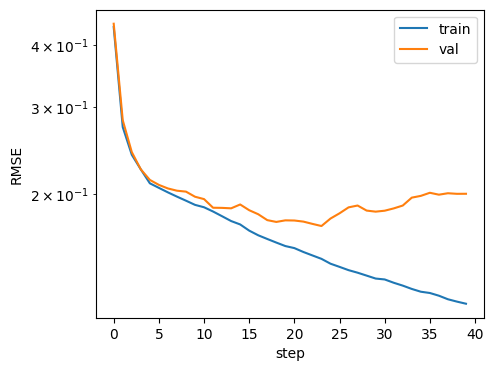

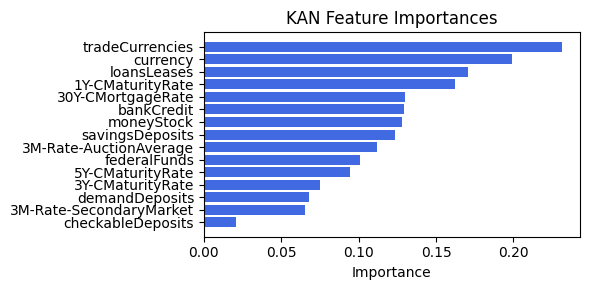

Computing Grad-CAM: 100%|██████████| 210/210 [00:16<00:00, 12.93it/s]

[('3M-Rate-SecondaryMarket', 0.373296469210514), ('checkableDeposits', 0.253318721956263), ('currency', 0.09007861983430172), ('loansLeases', 0.07066781584116619), ('tradeCurrencies', 0.047554215735622817), ('savingsDeposits', 0.025678682595580107), ('1Y-CMaturityRate', 0.002821909724956467), ('Ex1', 0.0024537855058692263), ('demandDeposits', 0.0010620693277035441), ('3M-Rate-AuctionAverage', 0.0006338174144426982), ('30Y-CMortgageRate', 0.0005455769066299711), ('bankCredit', 0.0002129405736923218), ('5Y-CMaturityRate', 0.00018370327140603747), ('3Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0)]


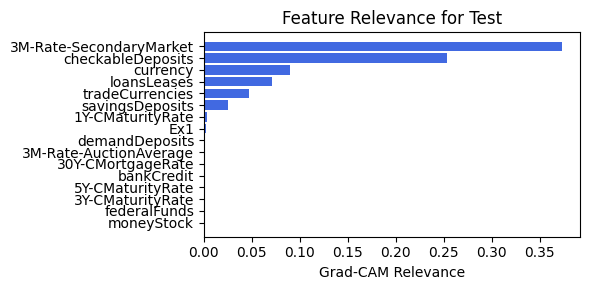

In [140]:
train_and_plot_relevance(Model3_2, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.75, filename=filename_2, opt_col_val=0.75)

### 2.2.2. width=[15, 1, 1], grid=5, lamb=1e-05 | alpha=0.75

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.14e-01 | eval_loss: 1.96e-01 | reg: 1.29e+02 |: 100%|█| 40/40 [00:38<00:00,  1.05it/

saving model version 0.1
Best epoch 22
0.26392608880996704
M_KAN Relevance: 0.0036149437073618174
CNN Relevance: 0.9963850975036621
[('tradeCurrencies', 0.21417008), ('1Y-CMaturityRate', 0.20289327), ('currency', 0.17835088), ('30Y-CMortgageRate', 0.17655219), ('loansLeases', 0.16020301), ('bankCredit', 0.14877032), ('moneyStock', 0.14117837), ('federalFunds', 0.10541467), ('savingsDeposits', 0.10362797), ('3Y-CMaturityRate', 0.101448275), ('3M-Rate-AuctionAverage', 0.096851975), ('3M-Rate-SecondaryMarket', 0.0631266), ('5Y-CMaturityRate', 0.061491214), ('checkableDeposits', 0.05338461), ('demandDeposits', 0.02590955)]


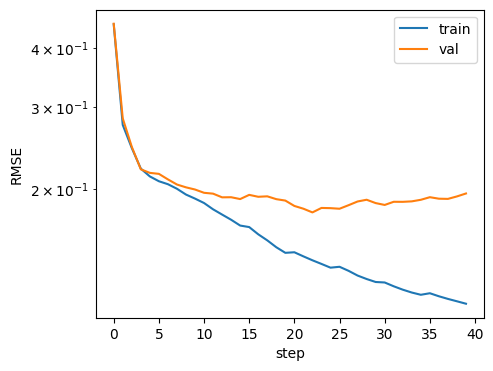

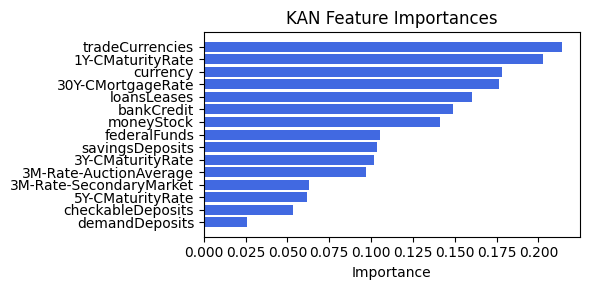

Computing Grad-CAM: 100%|██████████| 210/210 [00:15<00:00, 13.14it/s]

[('checkableDeposits', 0.3602627614468691), ('3M-Rate-SecondaryMarket', 0.29490755754412107), ('loansLeases', 0.15174629124729627), ('currency', 0.1297904456756355), ('tradeCurrencies', 0.09322101911585334), ('savingsDeposits', 0.03232797202903644), ('3Y-CMaturityRate', 0.012946924032959422), ('demandDeposits', 0.009385100964711802), ('federalFunds', 0.003123904602779519), ('moneyStock', 0.002582535573414394), ('1Y-CMaturityRate', 0.002083904588861125), ('3M-Rate-AuctionAverage', 0.0007764359315236409), ('Ex1', 0.0007343992657427277), ('30Y-CMortgageRate', 0.0006672433178339685), ('bankCredit', 0.00015977348112279462), ('5Y-CMaturityRate', 0.00015267332782968878)]


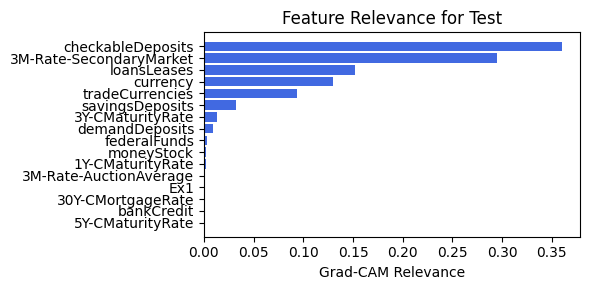

In [141]:
train_and_plot_relevance(Model3_2, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.75, filename=filename_2, opt_col_val=0.75)

### 2.2.3. width=[15, 1, 1], grid=5, lamb=1e-05 | alpha=0.52

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.29e-01 | eval_loss: 1.82e-01 | reg: 1.19e+02 |: 100%|█| 25/25 [00:25<00:00,  1.00s/i

saving model version 0.1
Best epoch 20
0.22082144021987915
M_KAN Relevance: 0.01039216760545969
CNN Relevance: 0.9896078109741211
[('federalFunds', 0.79250586), ('tradeCurrencies', 0.5916868), ('30Y-CMortgageRate', 0.4253673), ('moneyStock', 0.39654678), ('3Y-CMaturityRate', 0.2978188), ('5Y-CMaturityRate', 0.24461846), ('3M-Rate-SecondaryMarket', 0.22892125), ('currency', 0.18628405), ('1Y-CMaturityRate', 0.17919278), ('3M-Rate-AuctionAverage', 0.15861958), ('loansLeases', 0.128674), ('demandDeposits', 0.11258776), ('bankCredit', 0.09435666), ('savingsDeposits', 0.09207751), ('checkableDeposits', 0.083969355)]


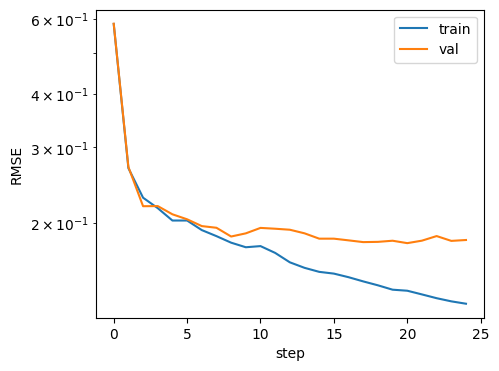

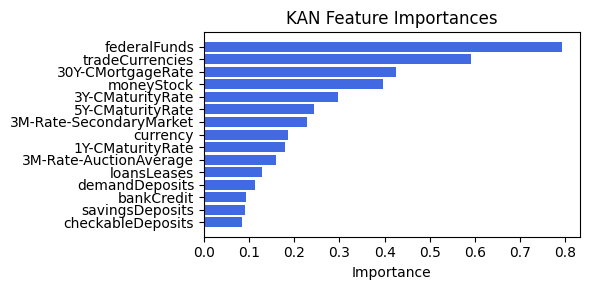

Computing Grad-CAM: 100%|██████████| 210/210 [00:17<00:00, 12.07it/s]


[('3M-Rate-SecondaryMarket', 0.07333402037232493), ('loansLeases', 0.06544167549083275), ('1Y-CMaturityRate', 0.03877806576478872), ('3M-Rate-AuctionAverage', 0.03206245644195449), ('30Y-CMortgageRate', 0.03145030684148272), ('savingsDeposits', 0.018364539370339203), ('tradeCurrencies', 0.015912045669254093), ('3Y-CMaturityRate', 0.007711750859536031), ('checkableDeposits', 0.005752235990283744), ('demandDeposits', 0.0032896812517373333), ('bankCredit', 0.0017882580425412882), ('5Y-CMaturityRate', 0.0015953928232192993), ('federalFunds', 0.0001942928198591939), ('currency', 0.0), ('moneyStock', 0.0), ('Ex1', 0.0)]


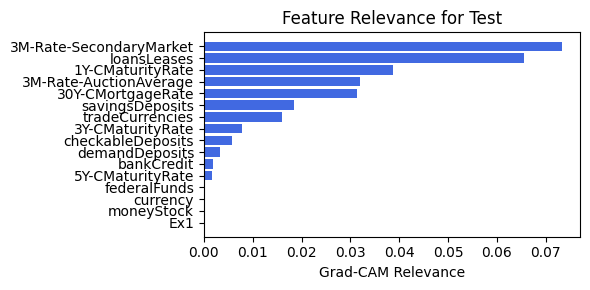

In [53]:
train_and_plot_relevance(Model3_2, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=25, alpha=0.525, filename=filename_2, opt_col_val=0.525)

### 2.2.3. width=[15, 1, 1], grid=5, lamb=1e-05 | alpha=0.51

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.30e-01 | eval_loss: 1.83e-01 | reg: 1.34e+02 |: 100%|█| 25/25 [00:24<00:00,  1.04it/

saving model version 0.1
Best epoch 24
0.22097305953502655
M_KAN Relevance: 0.009149006567895412
CNN Relevance: 0.9908509850502014
[('federalFunds', 1.0401262), ('moneyStock', 0.44008172), ('tradeCurrencies', 0.32509354), ('3M-Rate-AuctionAverage', 0.29837853), ('5Y-CMaturityRate', 0.28185904), ('bankCredit', 0.27712423), ('loansLeases', 0.26319546), ('3Y-CMaturityRate', 0.24172916), ('30Y-CMortgageRate', 0.23166722), ('currency', 0.22239311), ('savingsDeposits', 0.15755834), ('demandDeposits', 0.13042039), ('3M-Rate-SecondaryMarket', 0.101999745), ('checkableDeposits', 0.07610929), ('1Y-CMaturityRate', 0.056456644)]


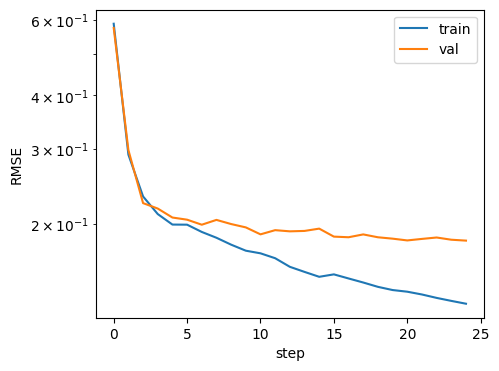

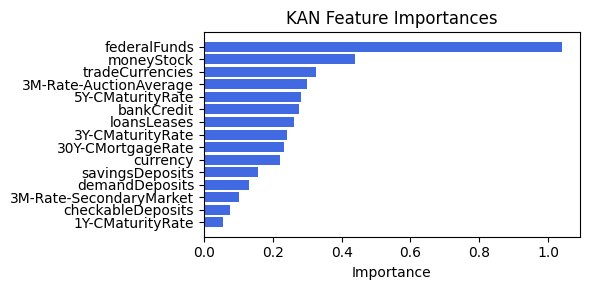

Computing Grad-CAM: 100%|██████████| 210/210 [00:17<00:00, 11.73it/s]


[('3M-Rate-SecondaryMarket', 0.14376444249813045), ('checkableDeposits', 0.12043161409840519), ('currency', 0.09734097296327707), ('loansLeases', 0.049463133544417184), ('Ex1', 0.04264404934697918), ('3Y-CMaturityRate', 0.04089908781239674), ('tradeCurrencies', 0.03797955267703704), ('1Y-CMaturityRate', 0.029281853179314307), ('savingsDeposits', 0.024238454609266703), ('demandDeposits', 0.02078858050074251), ('3M-Rate-AuctionAverage', 0.018652895197183602), ('30Y-CMortgageRate', 0.016589807508890296), ('5Y-CMaturityRate', 0.016287426557391883), ('bankCredit', 0.01515916219380285), ('federalFunds', 0.009750203543808312), ('moneyStock', 0.008949100363644815)]


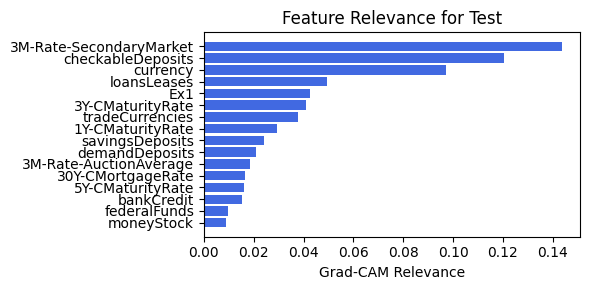

In [56]:
train_and_plot_relevance(Model3_2, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=25, alpha=0.51, filename=filename_2, opt_col_val=0.51)

### 2.2.3. width=[15, 1, 1], grid=5, lamb=1e-05 | alpha=0.5

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 9.90e-02 | eval_loss: 1.83e-01 | reg: 1.33e+02 |: 100%|█| 40/40 [00:39<00:00,  1.01it/

saving model version 0.1
Best epoch 20
0.20448167622089386
M_KAN Relevance: 0.015125058591365814
CNN Relevance: 0.9848749041557312
[('federalFunds', 0.6207588), ('30Y-CMortgageRate', 0.50247175), ('bankCredit', 0.33313203), ('3Y-CMaturityRate', 0.31075388), ('moneyStock', 0.30709735), ('1Y-CMaturityRate', 0.30071536), ('5Y-CMaturityRate', 0.25531003), ('3M-Rate-SecondaryMarket', 0.24618633), ('currency', 0.19968583), ('tradeCurrencies', 0.18901138), ('savingsDeposits', 0.15383902), ('loansLeases', 0.1437755), ('3M-Rate-AuctionAverage', 0.11902093), ('demandDeposits', 0.09166104), ('checkableDeposits', 0.087948546)]


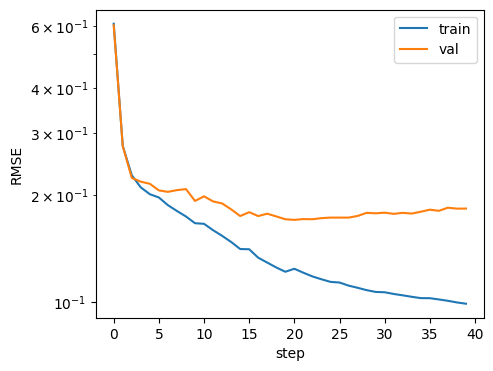

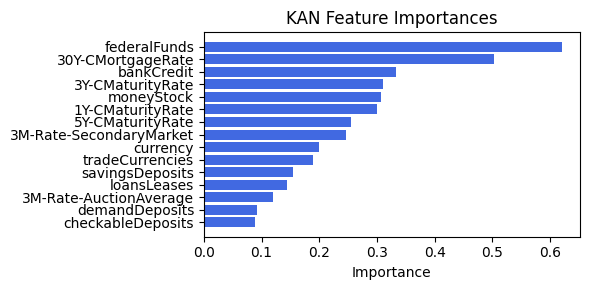

Computing Grad-CAM: 100%|██████████| 210/210 [00:15<00:00, 13.33it/s]


[('loansLeases', 0.10512352250405543), ('currency', 0.03336854242675361), ('3M-Rate-SecondaryMarket', 0.03145146025788216), ('savingsDeposits', 0.030684225281999846), ('checkableDeposits', 0.02316265290691739), ('Ex1', 0.02034574727572146), ('tradeCurrencies', 0.013683383827585549), ('moneyStock', 0.010209851915992442), ('demandDeposits', 0.009057677958515429), ('federalFunds', 0.008868980653850096), ('3Y-CMaturityRate', 0.008657743135422823), ('bankCredit', 0.008549828210934286), ('5Y-CMaturityRate', 0.008445017851911308), ('1Y-CMaturityRate', 0.008142217570206238), ('3M-Rate-AuctionAverage', 0.006117889422568537), ('30Y-CMortgageRate', 0.0054294509014913015)]


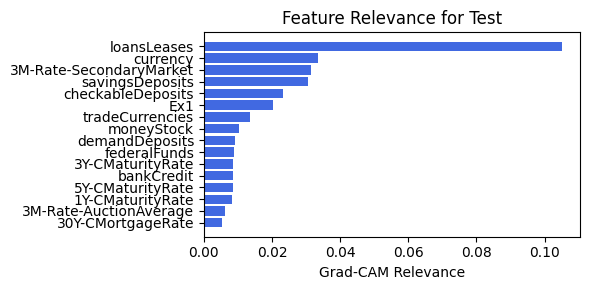

In [142]:
train_and_plot_relevance(Model3_2, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.5, filename=filename_2, opt_col_val=0.5)

### 2.2.4. width=[15, 1, 1], grid=5, lamb=1e-05 | alpha=0.5

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 9.90e-02 | eval_loss: 1.83e-01 | reg: 1.33e+02 |: 100%|█| 40/40 [00:38<00:00,  1.03it/

saving model version 0.1
Best epoch 20
0.20448167622089386
M_KAN Relevance: 0.015125058591365814
CNN Relevance: 0.9848749041557312
[('federalFunds', 0.6207588), ('30Y-CMortgageRate', 0.50247175), ('bankCredit', 0.33313203), ('3Y-CMaturityRate', 0.31075388), ('moneyStock', 0.30709735), ('1Y-CMaturityRate', 0.30071536), ('5Y-CMaturityRate', 0.25531003), ('3M-Rate-SecondaryMarket', 0.24618633), ('currency', 0.19968583), ('tradeCurrencies', 0.18901138), ('savingsDeposits', 0.15383902), ('loansLeases', 0.1437755), ('3M-Rate-AuctionAverage', 0.11902093), ('demandDeposits', 0.09166104), ('checkableDeposits', 0.087948546)]


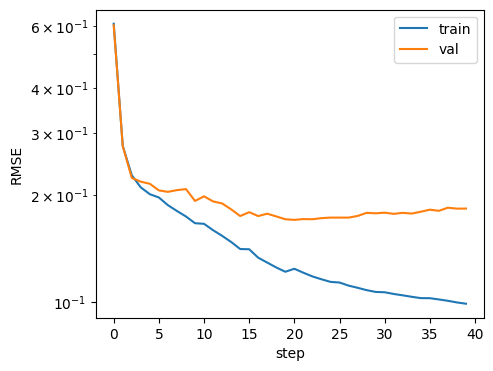

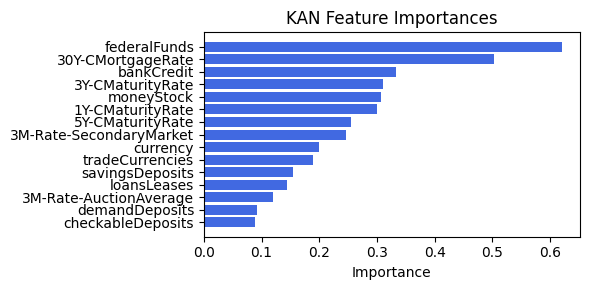

Computing Grad-CAM: 100%|██████████| 210/210 [00:15<00:00, 13.40it/s]


[('loansLeases', 0.10512352250405543), ('currency', 0.03336854242675361), ('3M-Rate-SecondaryMarket', 0.03145146025788216), ('savingsDeposits', 0.030684225281999846), ('checkableDeposits', 0.02316265290691739), ('Ex1', 0.02034574727572146), ('tradeCurrencies', 0.013683383827585549), ('moneyStock', 0.010209851915992442), ('demandDeposits', 0.009057677958515429), ('federalFunds', 0.008868980653850096), ('3Y-CMaturityRate', 0.008657743135422823), ('bankCredit', 0.008549828210934286), ('5Y-CMaturityRate', 0.008445017851911308), ('1Y-CMaturityRate', 0.008142217570206238), ('3M-Rate-AuctionAverage', 0.006117889422568537), ('30Y-CMortgageRate', 0.0054294509014913015)]


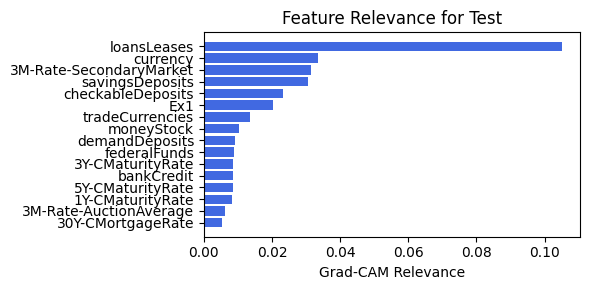

In [143]:
train_and_plot_relevance(Model3_2, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=40, alpha=0.5, filename=filename_2, opt_col_val=0.5)

### 2.2.5. width=[15, 1, 1], grid=5, lamb=1e-05 | alpha=0.45

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.15e-01 | eval_loss: 2.14e-01 | reg: 1.35e+02 |: 100%|█| 25/25 [00:23<00:00,  1.05it/

saving model version 0.1
Best epoch 9
0.2653639018535614
M_KAN Relevance: 0.023670470342040062
CNN Relevance: 0.976329505443573
[('federalFunds', 0.56043005), ('moneyStock', 0.5517157), ('tradeCurrencies', 0.34809455), ('3Y-CMaturityRate', 0.2656704), ('30Y-CMortgageRate', 0.25996417), ('3M-Rate-SecondaryMarket', 0.22831811), ('3M-Rate-AuctionAverage', 0.21057437), ('5Y-CMaturityRate', 0.15463576), ('currency', 0.11387355), ('demandDeposits', 0.10941773), ('bankCredit', 0.09024078), ('checkableDeposits', 0.08210413), ('1Y-CMaturityRate', 0.07163857), ('loansLeases', 0.055451382), ('savingsDeposits', 0.030316552)]


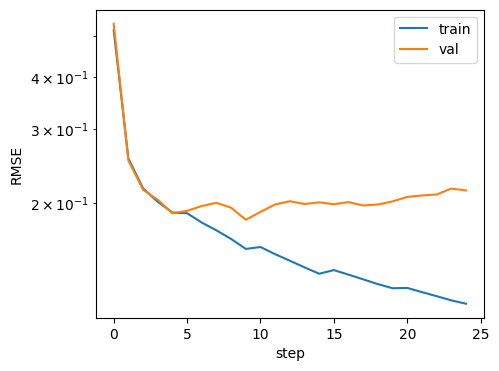

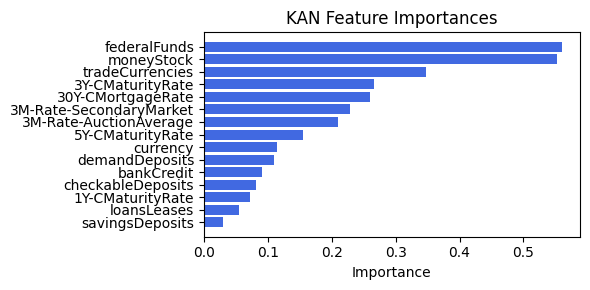

Computing Grad-CAM:  32%|███▏      | 67/210 [00:05<00:11, 12.30it/s]


KeyboardInterrupt: 

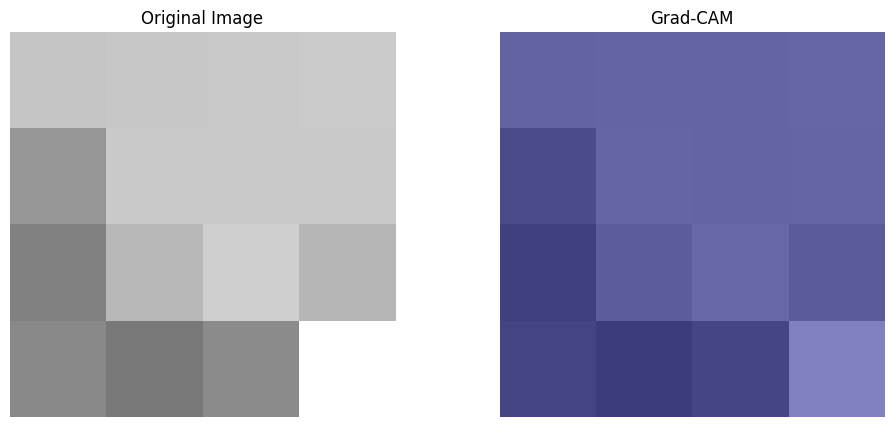

In [54]:
train_and_plot_relevance(Model3_2, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=25, alpha=0.45, filename=filename_2, opt_col_val=0.45)

### 2.2.5. width=[15, 1, 1], grid=5, lamb=1e-05 | alpha=0.4

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.22e-01 | eval_loss: 1.95e-01 | reg: 1.43e+02 |: 100%|█| 25/25 [00:23<00:00,  1.05it/

saving model version 0.1
Best epoch 13
0.25899556279182434
M_KAN Relevance: 0.0281161367893219
CNN Relevance: 0.9718838334083557
[('federalFunds', 0.50799125), ('moneyStock', 0.42382446), ('30Y-CMortgageRate', 0.26976883), ('3Y-CMaturityRate', 0.26484862), ('3M-Rate-SecondaryMarket', 0.25505233), ('tradeCurrencies', 0.17794554), ('1Y-CMaturityRate', 0.16242446), ('loansLeases', 0.10073495), ('5Y-CMaturityRate', 0.079619616), ('currency', 0.07340829), ('3M-Rate-AuctionAverage', 0.058203593), ('checkableDeposits', 0.05394536), ('bankCredit', 0.039705545), ('demandDeposits', 0.036524255), ('savingsDeposits', 0.021570465)]


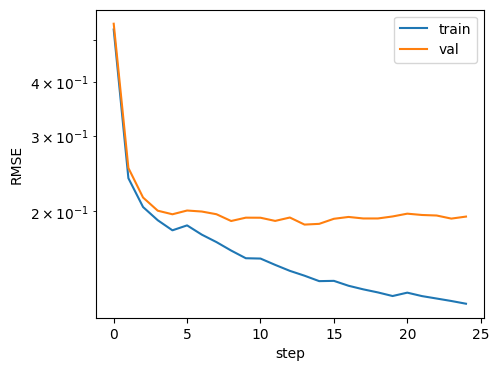

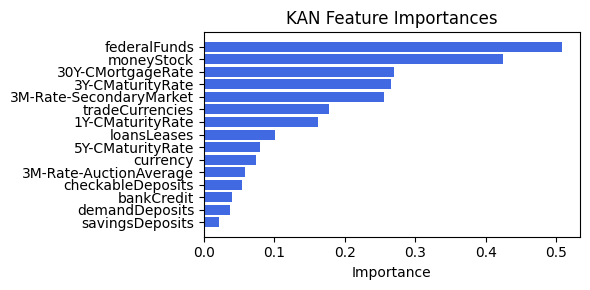

Computing Grad-CAM:  98%|█████████▊| 205/210 [00:16<00:00, 12.54it/s]


KeyboardInterrupt: 

In [57]:
train_and_plot_relevance(Model3_2, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=25, alpha=0.4, filename=filename_2, opt_col_val=0.4)

### 2.2.5. width=[15, 1, 1], grid=5, lamb=1e-05 | alpha=0.25

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 9.11e-02 | eval_loss: 1.72e-01 | reg: 1.81e+02 |: 100%|█| 40/40 [00:38<00:00,  1.04it/

saving model version 0.1
Best epoch 39
0.24237459897994995
M_KAN Relevance: 0.024364063516259193
CNN Relevance: 0.9756358861923218
[('federalFunds', 0.69806015), ('30Y-CMortgageRate', 0.46538758), ('moneyStock', 0.35563892), ('loansLeases', 0.21257097), ('3M-Rate-SecondaryMarket', 0.20536105), ('bankCredit', 0.14919023), ('3Y-CMaturityRate', 0.13318914), ('tradeCurrencies', 0.11623414), ('currency', 0.09996021), ('1Y-CMaturityRate', 0.093652375), ('savingsDeposits', 0.077065445), ('3M-Rate-AuctionAverage', 0.068775356), ('checkableDeposits', 0.042942327), ('5Y-CMaturityRate', 0.0374868), ('demandDeposits', 0.027258271)]


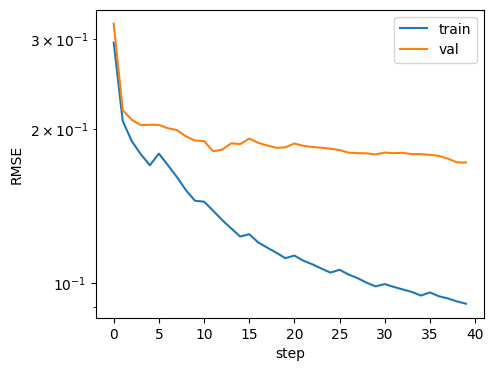

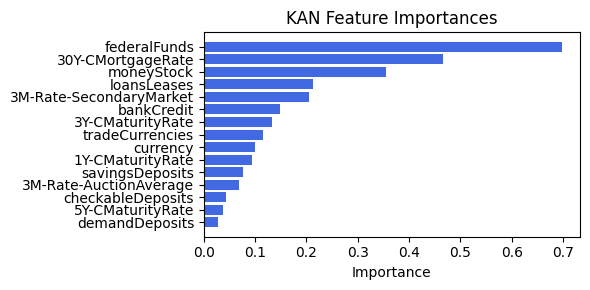

Computing Grad-CAM: 100%|██████████| 210/210 [00:14<00:00, 14.31it/s]

[('loansLeases', 0.15835280073280003), ('Ex1', 0.1443562969598653), ('tradeCurrencies', 0.10694107322293954), ('moneyStock', 0.09140355726731719), ('1Y-CMaturityRate', 0.08106570902857042), ('savingsDeposits', 0.07873841399670622), ('federalFunds', 0.06716343626779105), ('3Y-CMaturityRate', 0.06586945147442055), ('3M-Rate-SecondaryMarket', 0.05919570811162148), ('currency', 0.0578856522605444), ('5Y-CMaturityRate', 0.056290838565854796), ('bankCredit', 0.05484953176762376), ('demandDeposits', 0.05324802233704499), ('3M-Rate-AuctionAverage', 0.05073307277191253), ('30Y-CMortgageRate', 0.04814276050781787), ('checkableDeposits', 0.044838455434711204)]


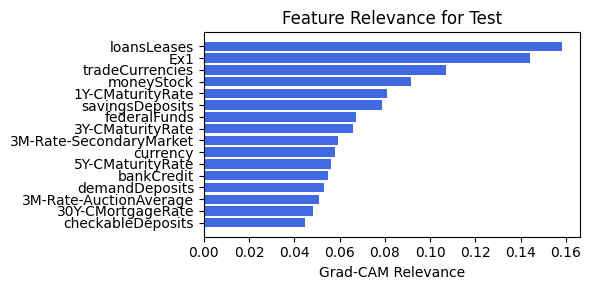

In [144]:
train_and_plot_relevance(Model3_2, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.25, filename=filename_2, opt_col_val=0.25)

### 2.2.6. width=[15, 1, 1], grid=5, lamb=1e-05 | alpha=0.25

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 8.99e-02 | eval_loss: 2.02e-01 | reg: 1.76e+02 |: 100%|█| 40/40 [00:39<00:00,  1.02it/

saving model version 0.1
Best epoch 13
0.2296377569437027
M_KAN Relevance: 0.03317049518227577
CNN Relevance: 0.9668295383453369
[('federalFunds', 0.41578892), ('30Y-CMortgageRate', 0.32406318), ('moneyStock', 0.27049112), ('loansLeases', 0.25036237), ('3M-Rate-SecondaryMarket', 0.18480958), ('3Y-CMaturityRate', 0.13615581), ('tradeCurrencies', 0.13192445), ('currency', 0.09015994), ('3M-Rate-AuctionAverage', 0.08422961), ('1Y-CMaturityRate', 0.07679693), ('bankCredit', 0.061890177), ('checkableDeposits', 0.05831561), ('savingsDeposits', 0.051027853), ('5Y-CMaturityRate', 0.035824664), ('demandDeposits', 0.021089407)]


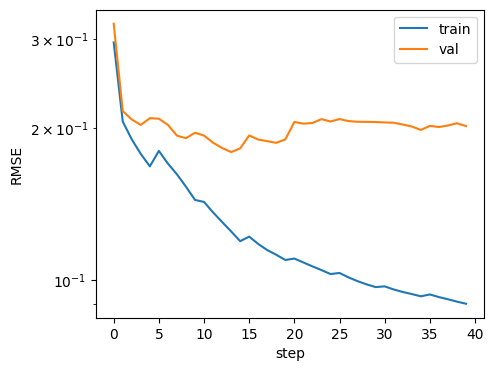

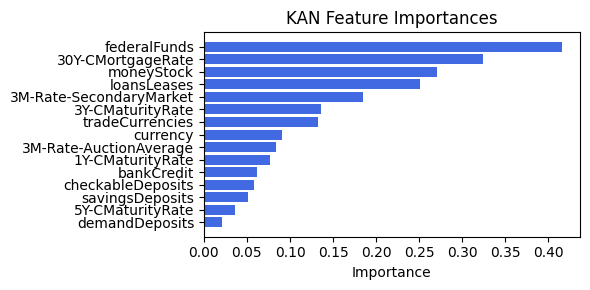

Computing Grad-CAM: 100%|██████████| 210/210 [00:15<00:00, 13.93it/s]


[('Ex1', 0.26234869867552163), ('currency', 0.11530258922970721), ('loansLeases', 0.10511883443396072), ('tradeCurrencies', 0.09016031729545267), ('1Y-CMaturityRate', 0.07804334368057815), ('savingsDeposits', 0.06638343172023832), ('3M-Rate-SecondaryMarket', 0.05660439576632122), ('30Y-CMortgageRate', 0.05031310524297753), ('3M-Rate-AuctionAverage', 0.05000691446919171), ('checkableDeposits', 0.040538526914592476), ('moneyStock', 0.03819757355155334), ('demandDeposits', 0.03276510236762641), ('5Y-CMaturityRate', 0.028144806550422105), ('bankCredit', 0.026830065971063008), ('federalFunds', 0.02547691741159984), ('3Y-CMaturityRate', 0.019627777222818363)]


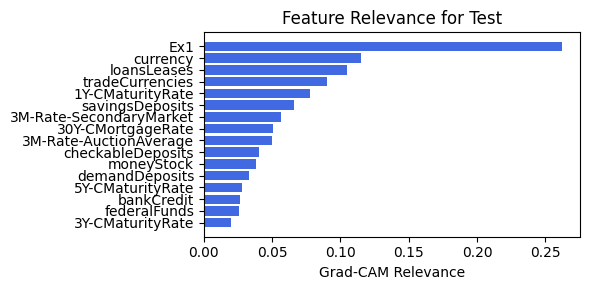

In [145]:
train_and_plot_relevance(Model3_2, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.25, filename=filename_2, opt_col_val=0.25)

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 8.95e-02 | eval_loss: 1.96e-01 | reg: 1.72e+02 |: 100%|█| 40/40 [00:39<00:00,  1.02it/

saving model version 0.1
Best epoch 14
0.28096115589141846
M_KAN Relevance: 0.026539012789726257
CNN Relevance: 0.9734609723091125
[('federalFunds', 0.5701787), ('30Y-CMortgageRate', 0.49099508), ('moneyStock', 0.33667573), ('loansLeases', 0.19810273), ('3M-Rate-SecondaryMarket', 0.14681838), ('bankCredit', 0.1321578), ('3Y-CMaturityRate', 0.11471339), ('1Y-CMaturityRate', 0.11299327), ('tradeCurrencies', 0.109371126), ('currency', 0.086110234), ('3M-Rate-AuctionAverage', 0.07981118), ('savingsDeposits', 0.05738358), ('checkableDeposits', 0.05058448), ('demandDeposits', 0.034234725), ('5Y-CMaturityRate', 0.02940262)]


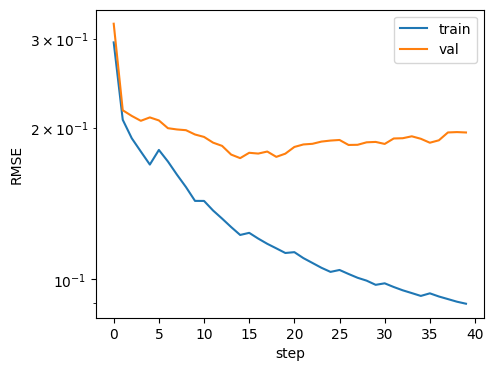

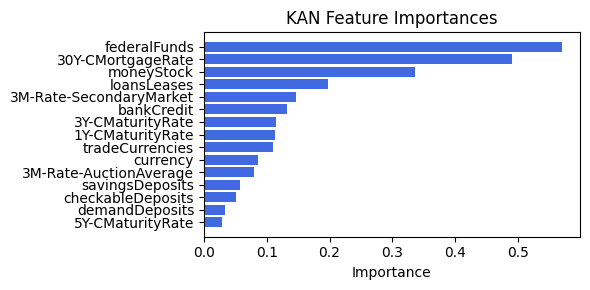

Computing Grad-CAM: 100%|██████████| 210/210 [00:18<00:00, 11.23it/s]

[('tradeCurrencies', 0.18208386049761127), ('Ex1', 0.16548449760441492), ('loansLeases', 0.12919000280678683), ('1Y-CMaturityRate', 0.09569291472033087), ('3Y-CMaturityRate', 0.08250825253780932), ('savingsDeposits', 0.0776924569805574), ('demandDeposits', 0.057109850804304835), ('federalFunds', 0.049095108594130056), ('5Y-CMaturityRate', 0.04844855151826605), ('bankCredit', 0.04427465333581148), ('moneyStock', 0.04332017754869802), ('currency', 0.034918269779466625), ('checkableDeposits', 0.033009125127379475), ('30Y-CMortgageRate', 0.03169781076721847), ('3M-Rate-AuctionAverage', 0.031575925781258514), ('3M-Rate-SecondaryMarket', 0.026552109639271206)]


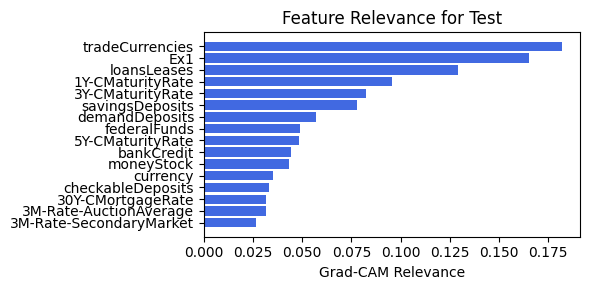

In [113]:
train_and_plot_relevance(Model3_2, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.25)

### 2.2.7. width=[15, 1, 1], grid=5, lamb=1e-05 | alpha=0.1

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 9.21e-02 | eval_loss: 2.02e-01 | reg: 2.17e+02 |: 100%|█| 40/40 [00:38<00:00,  1.03it/

saving model version 0.1
Best epoch 14
0.22765015065670013
M_KAN Relevance: 0.00031623875838704407
CNN Relevance: 0.9996837377548218
[('checkableDeposits', 0.18651925), ('5Y-CMaturityRate', 0.16748312), ('3M-Rate-AuctionAverage', 0.15261926), ('federalFunds', 0.124103285), ('30Y-CMortgageRate', 0.08458417), ('3Y-CMaturityRate', 0.07711887), ('3M-Rate-SecondaryMarket', 0.0653275), ('moneyStock', 0.05866211), ('demandDeposits', 0.049441367), ('loansLeases', 0.036288213), ('bankCredit', 0.020474872), ('savingsDeposits', 0.018939447), ('tradeCurrencies', 0.015005392), ('1Y-CMaturityRate', 0.009544317), ('currency', 0.009016158)]


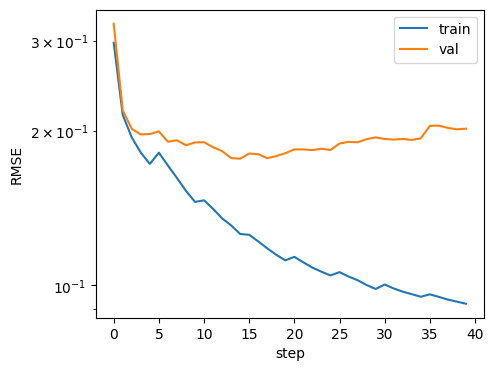

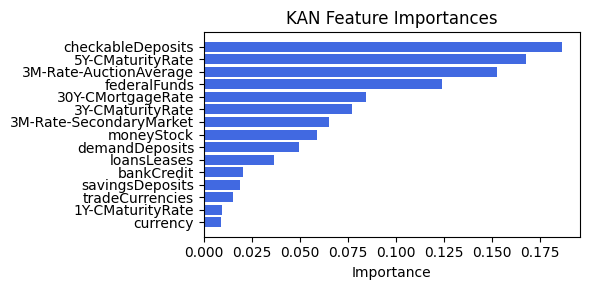

Computing Grad-CAM: 100%|██████████| 210/210 [00:15<00:00, 13.76it/s]


[('loansLeases', 0.041255341252932946), ('Ex1', 0.039245904228162196), ('tradeCurrencies', 0.03426236446414675), ('1Y-CMaturityRate', 0.025007296655149686), ('savingsDeposits', 0.018195236563908458), ('3Y-CMaturityRate', 0.014994210459380632), ('demandDeposits', 0.013635562362504147), ('3M-Rate-SecondaryMarket', 0.01047015980584547), ('currency', 0.008594616837356062), ('30Y-CMortgageRate', 0.008527396640385546), ('3M-Rate-AuctionAverage', 0.008479392572882629), ('federalFunds', 0.007659298296840418), ('checkableDeposits', 0.005472269460802809), ('moneyStock', 0.005334182877448343), ('5Y-CMaturityRate', 0.0038097837274628024), ('bankCredit', 0.0033096448207894963)]


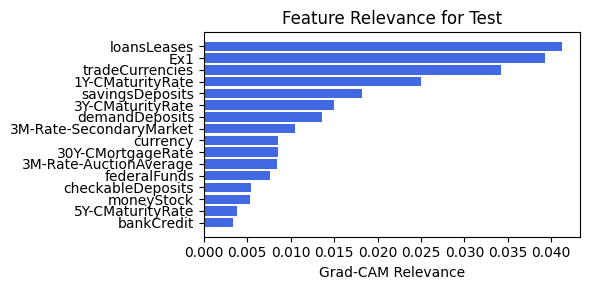

In [146]:
train_and_plot_relevance(Model3_2, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.1, filename=filename_2, opt_col_val=0.1)

### 2.2.7. width=[15, 1, 1], grid=5, lamb=1e-05 | alpha=0.1

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 9.72e-02 | eval_loss: 1.65e-01 | reg: 2.22e+02 |: 100%|█| 40/40 [00:39<00:00,  1.01it/

saving model version 0.1
Best epoch 32
0.21719655394554138
M_KAN Relevance: 0.00015381377306766808
CNN Relevance: 0.9998461604118347
[('checkableDeposits', 0.18851176), ('5Y-CMaturityRate', 0.1698115), ('3M-Rate-AuctionAverage', 0.15445548), ('federalFunds', 0.124599665), ('30Y-CMortgageRate', 0.084993936), ('3Y-CMaturityRate', 0.07713707), ('3M-Rate-SecondaryMarket', 0.06519868), ('moneyStock', 0.0583536), ('demandDeposits', 0.048154533), ('loansLeases', 0.03410686), ('bankCredit', 0.018116513), ('savingsDeposits', 0.017341942), ('tradeCurrencies', 0.013049366), ('1Y-CMaturityRate', 0.008449967), ('currency', 0.0077088615)]


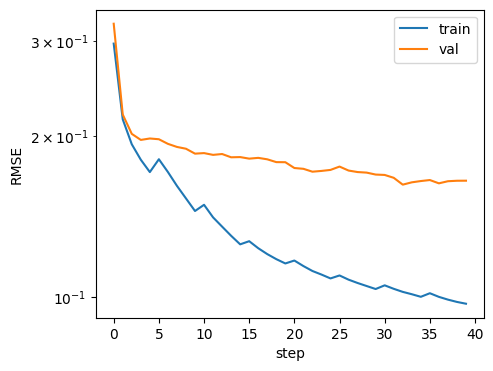

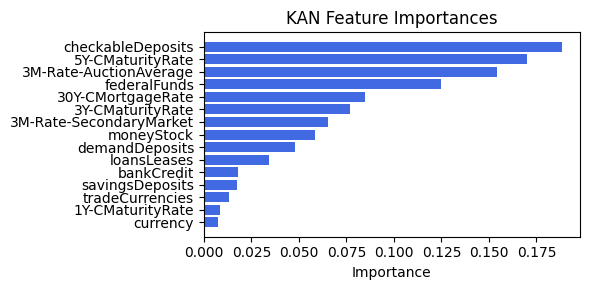

Computing Grad-CAM: 100%|██████████| 210/210 [00:14<00:00, 14.35it/s]

[('tradeCurrencies', 0.2852410063236242), ('loansLeases', 0.21152294319527712), ('savingsDeposits', 0.17202529100967304), ('3Y-CMaturityRate', 0.15136427751609258), ('Ex1', 0.13360484112275853), ('5Y-CMaturityRate', 0.12055176776075746), ('bankCredit', 0.11885624645011765), ('demandDeposits', 0.08653063265429366), ('federalFunds', 0.05885698536987461), ('1Y-CMaturityRate', 0.05662930390043627), ('checkableDeposits', 0.05656383427613903), ('moneyStock', 0.03669533846855518), ('30Y-CMortgageRate', 0.03579744249138804), ('3M-Rate-AuctionAverage', 0.035160749228227706), ('currency', 0.034963101545526155), ('3M-Rate-SecondaryMarket', 0.020359276511174227)]


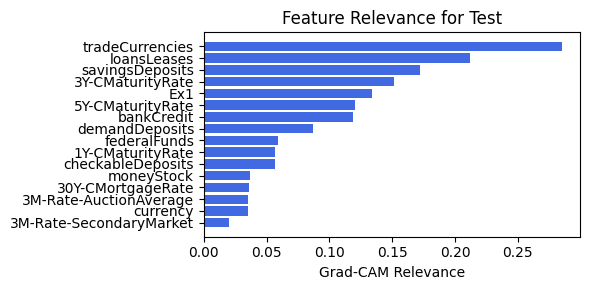

In [147]:
train_and_plot_relevance(Model3_2, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.1, filename=filename_2, opt_col_val=0.1)

### 2.2.9. width=[15, 1, 1], grid=5, lamb=1e-05 | alpha=0.01

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.09e-01 | eval_loss: 1.86e-01 | reg: 2.78e+02 |: 100%|█| 40/40 [00:39<00:00,  1.02it/

saving model version 0.1
Best epoch 12
0.24820062518119812
M_KAN Relevance: 0.001416109618730843
CNN Relevance: 0.9985838532447815
[('loansLeases', 0.4504278), ('5Y-CMaturityRate', 0.41575915), ('currency', 0.41530505), ('3M-Rate-AuctionAverage', 0.35167822), ('tradeCurrencies', 0.31835675), ('savingsDeposits', 0.28915057), ('bankCredit', 0.1671028), ('demandDeposits', 0.14406253), ('1Y-CMaturityRate', 0.097873), ('30Y-CMortgageRate', 0.07980641), ('3Y-CMaturityRate', 0.05663077), ('checkableDeposits', 0.0358184), ('federalFunds', 0.030690195), ('3M-Rate-SecondaryMarket', 0.017613526), ('moneyStock', 0.013591308)]


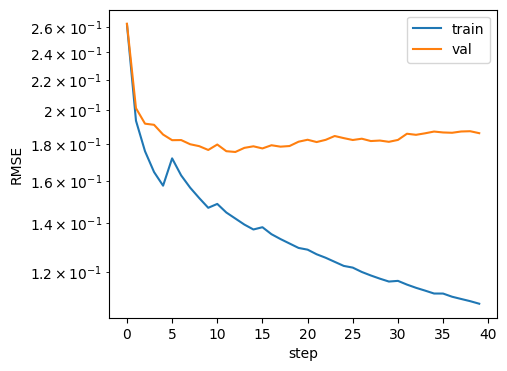

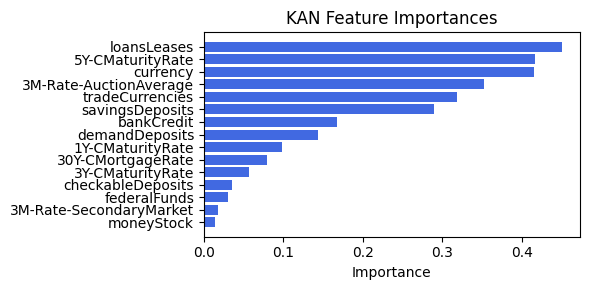

Computing Grad-CAM: 100%|██████████| 210/210 [00:14<00:00, 14.16it/s]


[('loansLeases', 0.2318007894464591), ('tradeCurrencies', 0.07865171209199442), ('3M-Rate-SecondaryMarket', 0.05365428632136346), ('savingsDeposits', 0.04532912428147115), ('1Y-CMaturityRate', 0.03780302991203609), ('demandDeposits', 0.026345565769865756), ('3Y-CMaturityRate', 0.025568072870096548), ('30Y-CMortgageRate', 0.017546617789637474), ('checkableDeposits', 0.01576726824222576), ('3M-Rate-AuctionAverage', 0.013410138835509618), ('currency', 0.010537505612592212), ('Ex1', 0.004969137752916486), ('federalFunds', 0.001199623906896228), ('moneyStock', 0.0009271810984327679), ('bankCredit', 0.0006081706079255258), ('5Y-CMaturityRate', 0.0005854297462584717)]


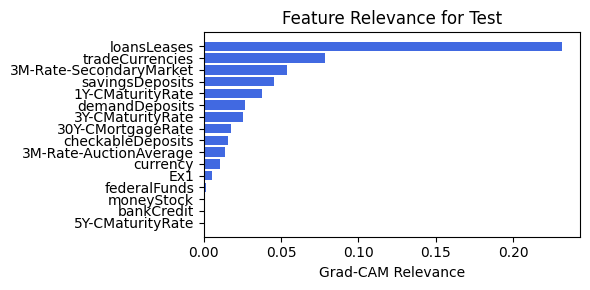

In [148]:
train_and_plot_relevance(Model3_2, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.01, filename=filename_2, opt_col_val=0.01)

### 2.2.10. width=[15, 1, 1], grid=5, lamb=1e-05 | alpha=0.01

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 1.18e-01 | eval_loss: 1.82e-01 | reg: 2.81e+02 |: 100%|█| 40/40 [00:38<00:00,  1.04it/

saving model version 0.1
Best epoch 7
0.2333342581987381
M_KAN Relevance: 0.0014683117624372244
CNN Relevance: 0.998531699180603
[('loansLeases', 0.45157087), ('5Y-CMaturityRate', 0.41712022), ('currency', 0.4159237), ('3M-Rate-AuctionAverage', 0.35337088), ('tradeCurrencies', 0.31916872), ('savingsDeposits', 0.28974706), ('bankCredit', 0.16565818), ('demandDeposits', 0.14449848), ('1Y-CMaturityRate', 0.09781246), ('30Y-CMortgageRate', 0.080617554), ('3Y-CMaturityRate', 0.05739441), ('checkableDeposits', 0.035548672), ('federalFunds', 0.03194714), ('3M-Rate-SecondaryMarket', 0.018671067), ('moneyStock', 0.013814435)]


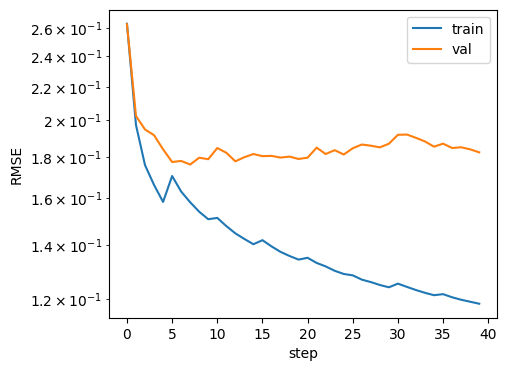

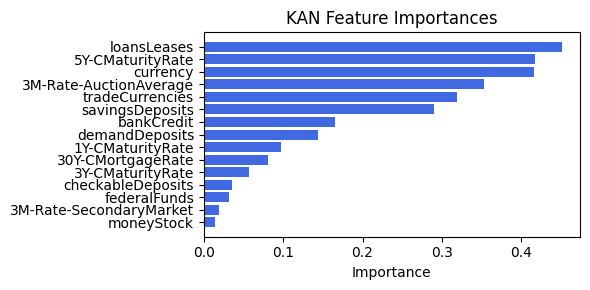

Computing Grad-CAM: 100%|██████████| 210/210 [00:14<00:00, 14.21it/s]


[('loansLeases', 0.10585017742677813), ('currency', 0.03208767094072842), ('tradeCurrencies', 0.028102783113718034), ('checkableDeposits', 0.022151894466064515), ('savingsDeposits', 0.020331660525075027), ('3M-Rate-SecondaryMarket', 0.0178814310755115), ('1Y-CMaturityRate', 0.013625772173206012), ('30Y-CMortgageRate', 0.006236701228079342), ('3M-Rate-AuctionAverage', 0.004710515238167274), ('Ex1', 0.004081305063196591), ('3Y-CMaturityRate', 0.0025871617675182366), ('demandDeposits', 0.002549385962386926), ('5Y-CMaturityRate', 2.9802942576463377e-05), ('bankCredit', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0)]


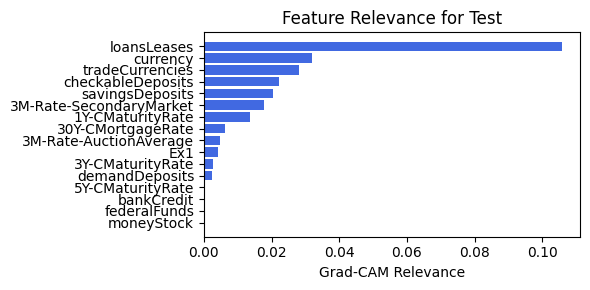

In [149]:
train_and_plot_relevance(Model3_2, kan_neurons=1, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.01, filename=filename_2, opt_col_val=0.01)

## 2.3 width=[15, 6, 1], grid=7, lamb=1e-05

### 2.3.1. width=[15, 6, 1], grid=7, lamb=1e-05 | alpha=0.75

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 8.35e-02 | eval_loss: 1.85e-01 | reg: 1.31e+02 |: 100%|█| 40/40 [00:43<00:00,  1.09s/i

saving model version 0.1
Best epoch 36
0.20526260137557983
M_KAN Relevance: 0.07130081951618195
CNN Relevance: 0.9286991953849792
[('federalFunds', 0.48259565), ('3M-Rate-AuctionAverage', 0.37848872), ('30Y-CMortgageRate', 0.3376324), ('tradeCurrencies', 0.3022154), ('5Y-CMaturityRate', 0.29003298), ('checkableDeposits', 0.27355736), ('currency', 0.2612216), ('1Y-CMaturityRate', 0.24624112), ('bankCredit', 0.24543159), ('moneyStock', 0.23197936), ('3M-Rate-SecondaryMarket', 0.22204201), ('loansLeases', 0.19648312), ('demandDeposits', 0.17997977), ('3Y-CMaturityRate', 0.15658972), ('savingsDeposits', 0.15222213)]


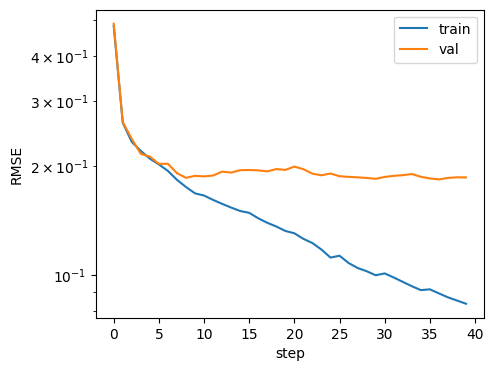

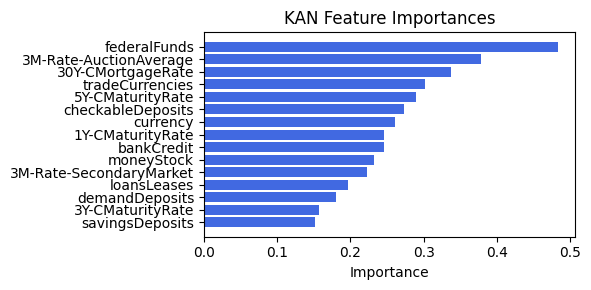

Computing Grad-CAM: 100%|██████████| 210/210 [00:22<00:00,  9.50it/s]

[('3M-Rate-SecondaryMarket', 0.18943643411164104), ('checkableDeposits', 0.12729243372256557), ('loansLeases', 0.10573598504387996), ('currency', 0.08659325575932772), ('3M-Rate-AuctionAverage', 0.07127967975324108), ('30Y-CMortgageRate', 0.07087764137540944), ('tradeCurrencies', 0.06087191314006867), ('Ex1', 0.05039930658614529), ('bankCredit', 0.050274931568475), ('5Y-CMaturityRate', 0.04829782085227115), ('savingsDeposits', 0.04805903980658124), ('1Y-CMaturityRate', 0.040698299135658006), ('moneyStock', 0.0379550470837525), ('federalFunds', 0.035720030925724476), ('3Y-CMaturityRate', 0.030889226735702584), ('demandDeposits', 0.02238344546141369)]


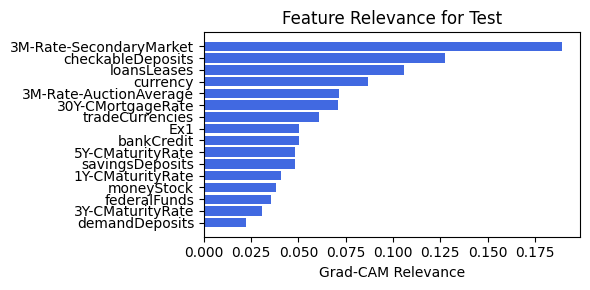

In [150]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.75, filename=filename_2, opt_col_val=0.75)

### 2.3.2. width=[15, 6, 1], grid=7, lamb=1e-05 | alpha=0.75

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 8.25e-02 | eval_loss: 1.97e-01 | reg: 1.17e+02 |: 100%|█| 40/40 [00:45<00:00,  1.14s/i

saving model version 0.1
Best epoch 26
0.23650237917900085
M_KAN Relevance: 0.07476211339235306
CNN Relevance: 0.9252378344535828
[('federalFunds', 0.48950428), ('3M-Rate-AuctionAverage', 0.41958684), ('checkableDeposits', 0.3735292), ('currency', 0.33473134), ('30Y-CMortgageRate', 0.31566107), ('moneyStock', 0.30809104), ('tradeCurrencies', 0.3017794), ('3M-Rate-SecondaryMarket', 0.23970726), ('1Y-CMaturityRate', 0.23488563), ('5Y-CMaturityRate', 0.22550993), ('bankCredit', 0.22451514), ('savingsDeposits', 0.21234016), ('loansLeases', 0.20213132), ('3Y-CMaturityRate', 0.17636636), ('demandDeposits', 0.17409623)]


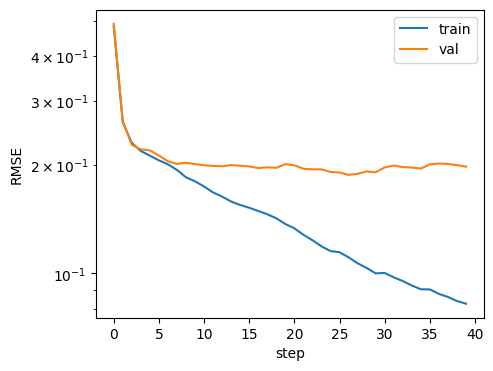

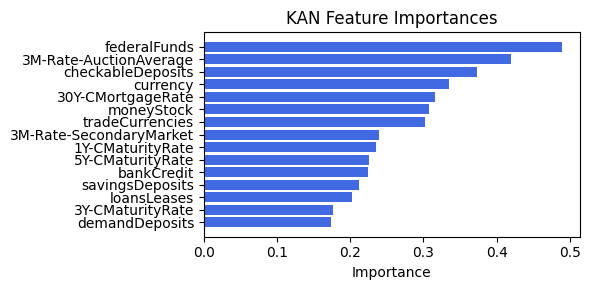

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.30it/s]

[('3M-Rate-SecondaryMarket', 0.2745637533565362), ('checkableDeposits', 0.16974036724173597), ('loansLeases', 0.11665237544323082), ('currency', 0.07306437083032159), ('3M-Rate-AuctionAverage', 0.06025541027386983), ('30Y-CMortgageRate', 0.060110839651454064), ('savingsDeposits', 0.054556202182235815), ('1Y-CMaturityRate', 0.054402863208781044), ('tradeCurrencies', 0.04845643794341456), ('demandDeposits', 0.04590316893764317), ('moneyStock', 0.03543589318703328), ('federalFunds', 0.0345891997633901), ('bankCredit', 0.03199441358003588), ('3Y-CMaturityRate', 0.029871810782545558), ('5Y-CMaturityRate', 0.029675793106712048), ('Ex1', 0.014334293674411518)]


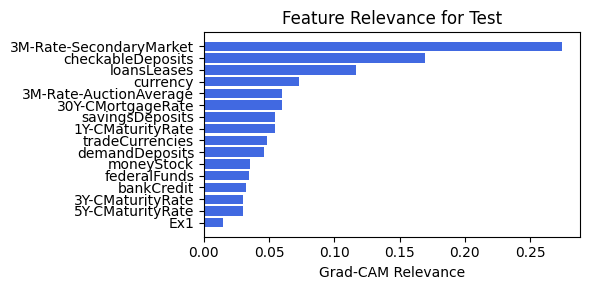

In [151]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.75, filename=filename_2, opt_col_val=0.75)

### 2.3.3. width=[15, 6, 1], grid=7, lamb=1e-05 | alpha=0.5

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 7.73e-02 | eval_loss: 1.95e-01 | reg: 1.13e+02 |: 100%|█| 40/40 [00:44<00:00,  1.12s/i

saving model version 0.1
Best epoch 13
0.23047970235347748
M_KAN Relevance: 0.1786167472600937
CNN Relevance: 0.8213832378387451
[('federalFunds', 0.37166676), ('30Y-CMortgageRate', 0.3509079), ('moneyStock', 0.3152929), ('tradeCurrencies', 0.2966839), ('checkableDeposits', 0.27311265), ('1Y-CMaturityRate', 0.22269839), ('3M-Rate-AuctionAverage', 0.22214358), ('currency', 0.21775341), ('3M-Rate-SecondaryMarket', 0.21467088), ('bankCredit', 0.21029787), ('5Y-CMaturityRate', 0.19061905), ('3Y-CMaturityRate', 0.17585061), ('demandDeposits', 0.16202505), ('savingsDeposits', 0.15525201), ('loansLeases', 0.13434106)]


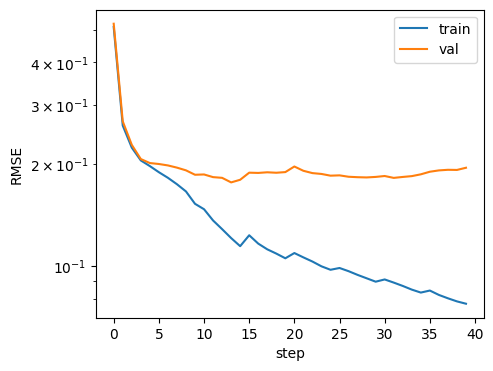

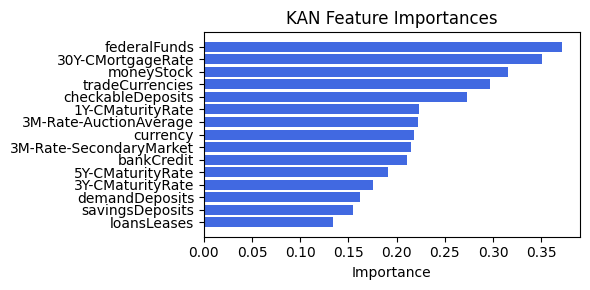

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.36it/s]

[('loansLeases', 0.1966631211916614), ('tradeCurrencies', 0.16659383694863036), ('bankCredit', 0.13333464377737117), ('3Y-CMaturityRate', 0.13250601916924573), ('5Y-CMaturityRate', 0.13236880043876312), ('savingsDeposits', 0.11282885131853011), ('moneyStock', 0.10862610874963659), ('federalFunds', 0.09303721450463248), ('3M-Rate-SecondaryMarket', 0.08486312691266426), ('checkableDeposits', 0.0760336534167263), ('demandDeposits', 0.07014367695664987), ('3M-Rate-AuctionAverage', 0.0681829436637816), ('1Y-CMaturityRate', 0.06783054758395468), ('30Y-CMortgageRate', 0.06643086167251958), ('Ex1', 0.054960140064940786), ('currency', 0.047325152820017785)]


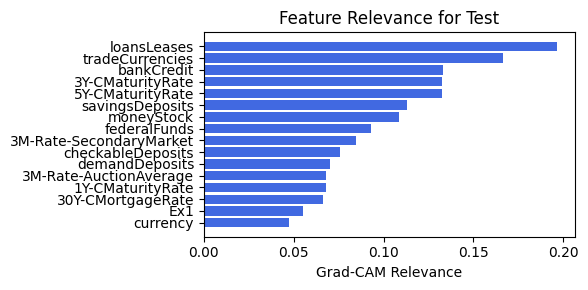

In [152]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.5, filename=filename_2, opt_col_val=0.5)

### 2.3.4. width=[15, 6, 1], grid=7, lamb=1e-05 | alpha=0.5

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 7.68e-02 | eval_loss: 2.52e-01 | reg: 1.08e+02 |: 100%|█| 40/40 [00:44<00:00,  1.10s/i

saving model version 0.1
Best epoch 14
0.24369002878665924
M_KAN Relevance: 0.16798503696918488
CNN Relevance: 0.8320149779319763
[('federalFunds', 0.38893592), ('30Y-CMortgageRate', 0.33056384), ('checkableDeposits', 0.3101405), ('moneyStock', 0.29440862), ('tradeCurrencies', 0.27953523), ('3M-Rate-AuctionAverage', 0.26896718), ('bankCredit', 0.24785547), ('1Y-CMaturityRate', 0.22765033), ('3M-Rate-SecondaryMarket', 0.2267406), ('currency', 0.20903116), ('5Y-CMaturityRate', 0.20797902), ('3Y-CMaturityRate', 0.18419957), ('demandDeposits', 0.16505827), ('loansLeases', 0.15541443), ('savingsDeposits', 0.13423054)]


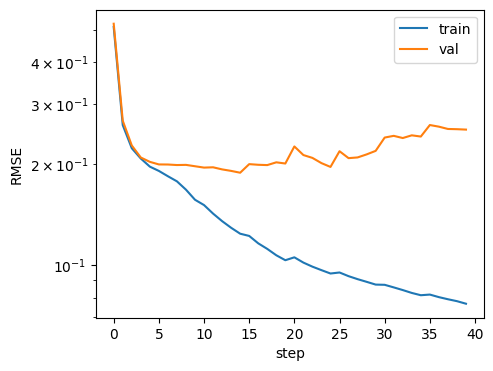

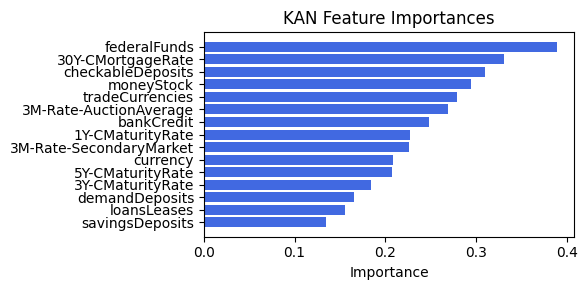

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  8.99it/s]


[('loansLeases', 0.20848217288869256), ('tradeCurrencies', 0.10735233555370498), ('3Y-CMaturityRate', 0.0812644057774118), ('savingsDeposits', 0.07458256004112107), ('bankCredit', 0.05511645651644184), ('5Y-CMaturityRate', 0.05508544559072886), ('moneyStock', 0.05338504642602943), ('1Y-CMaturityRate', 0.053118812142028696), ('3M-Rate-SecondaryMarket', 0.04831678343360268), ('checkableDeposits', 0.04204514289019807), ('demandDeposits', 0.0386136158524702), ('3M-Rate-AuctionAverage', 0.034100250857660455), ('30Y-CMortgageRate', 0.03372451434233448), ('federalFunds', 0.03222334146211367), ('Ex1', 0.03102768315473527), ('currency', 0.015029091125636893)]


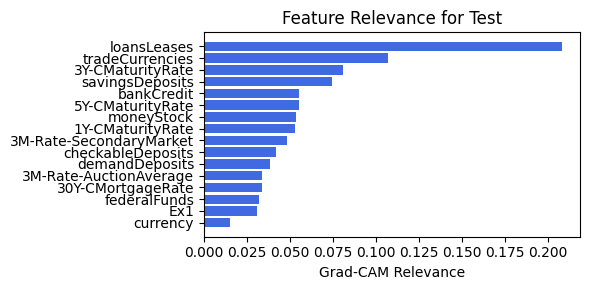

In [153]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.5, filename=filename_2, opt_col_val=0.5)

### 2.3.5. width=[15, 6, 1], grid=7, lamb=1e-05 | alpha=0.25

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 7.72e-02 | eval_loss: 1.64e-01 | reg: 1.05e+02 |: 100%|█| 40/40 [00:44<00:00,  1.11s/i

saving model version 0.1
Best epoch 39
0.2108450084924698
M_KAN Relevance: 0.30973929166793823
CNN Relevance: 0.6902607083320618
[('moneyStock', 0.23256293), ('30Y-CMortgageRate', 0.200349), ('3M-Rate-SecondaryMarket', 0.14870006), ('federalFunds', 0.14059241), ('3M-Rate-AuctionAverage', 0.13612768), ('3Y-CMaturityRate', 0.13272655), ('checkableDeposits', 0.12642986), ('loansLeases', 0.118015155), ('tradeCurrencies', 0.1144847), ('bankCredit', 0.10428559), ('5Y-CMaturityRate', 0.09693205), ('currency', 0.09587349), ('1Y-CMaturityRate', 0.063321486), ('demandDeposits', 0.046116203), ('savingsDeposits', 0.041263934)]


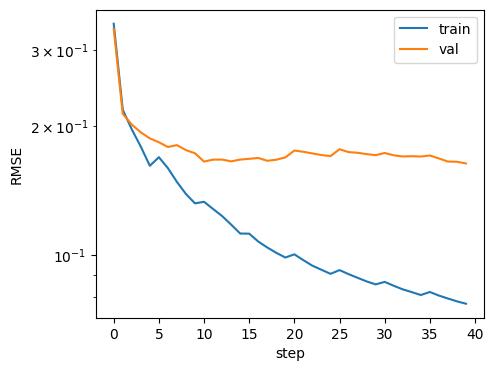

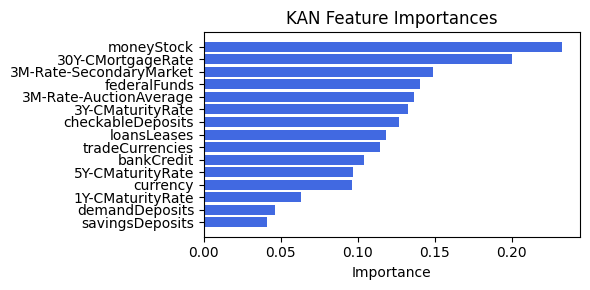

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.26it/s]

[('bankCredit', 0.31679114803250524), ('5Y-CMaturityRate', 0.31104864514754377), ('3M-Rate-AuctionAverage', 0.3075118337137004), ('30Y-CMortgageRate', 0.30532451164797836), ('1Y-CMaturityRate', 0.2941295366069036), ('3Y-CMaturityRate', 0.27722575546940786), ('tradeCurrencies', 0.24853165946468445), ('moneyStock', 0.2395098471296175), ('federalFunds', 0.18106647013586813), ('savingsDeposits', 0.14480437101197563), ('loansLeases', 0.1437694182558473), ('demandDeposits', 0.1305842469016733), ('checkableDeposits', 0.09497371631067446), ('currency', 0.07650225174758296), ('Ex1', 0.07422521219788385), ('3M-Rate-SecondaryMarket', 0.06942986680050603)]


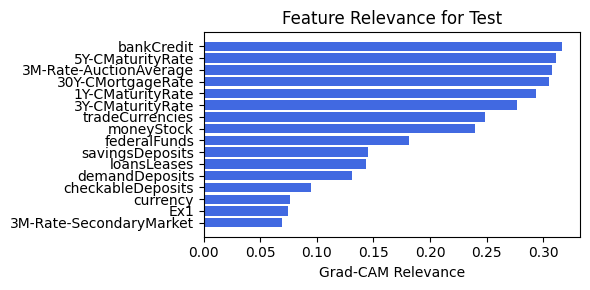

In [154]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.25, filename=filename_2, opt_col_val=0.25)

### 2.3.6. width=[15, 6, 1], grid=7, lamb=1e-05 | alpha=0.25

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 8.04e-02 | eval_loss: 1.86e-01 | reg: 1.06e+02 |: 100%|█| 40/40 [00:43<00:00,  1.10s/i

saving model version 0.1
Best epoch 21
0.2520860731601715
M_KAN Relevance: 0.30844202637672424
CNN Relevance: 0.6915579438209534
[('moneyStock', 0.24601911), ('30Y-CMortgageRate', 0.19690947), ('3M-Rate-AuctionAverage', 0.15619229), ('3M-Rate-SecondaryMarket', 0.14977421), ('3Y-CMaturityRate', 0.14092866), ('checkableDeposits', 0.13925658), ('federalFunds', 0.13892427), ('tradeCurrencies', 0.13200063), ('currency', 0.11113395), ('loansLeases', 0.11055705), ('bankCredit', 0.10743334), ('1Y-CMaturityRate', 0.10136983), ('5Y-CMaturityRate', 0.09551795), ('demandDeposits', 0.06631091), ('savingsDeposits', 0.050250895)]


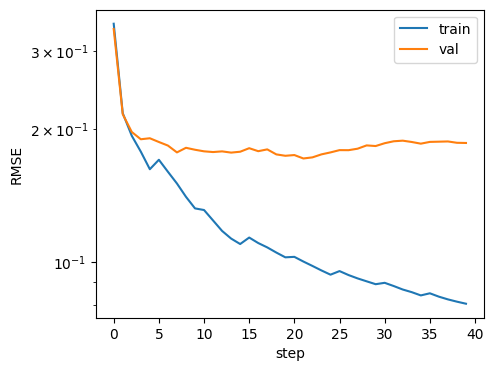

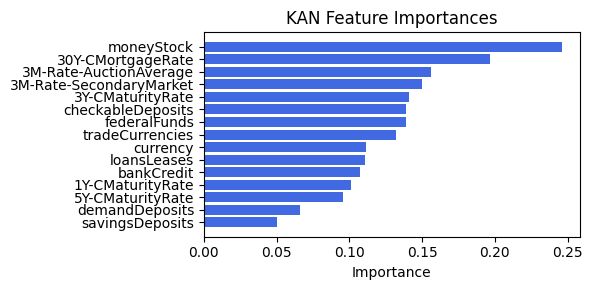

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  8.88it/s]

[('tradeCurrencies', 0.34491023704232204), ('bankCredit', 0.2689634454347903), ('5Y-CMaturityRate', 0.2667828083747909), ('3Y-CMaturityRate', 0.24532297736011624), ('loansLeases', 0.224052796005604), ('moneyStock', 0.20170843531488486), ('1Y-CMaturityRate', 0.18586999753357045), ('30Y-CMortgageRate', 0.1777591436258739), ('savingsDeposits', 0.17728082928917416), ('3M-Rate-AuctionAverage', 0.17723395022607985), ('federalFunds', 0.16867355736903847), ('demandDeposits', 0.13366693366087495), ('Ex1', 0.07268507405838352), ('currency', 0.07130144061513766), ('checkableDeposits', 0.0661601920992585), ('3M-Rate-SecondaryMarket', 0.050888481652130696)]


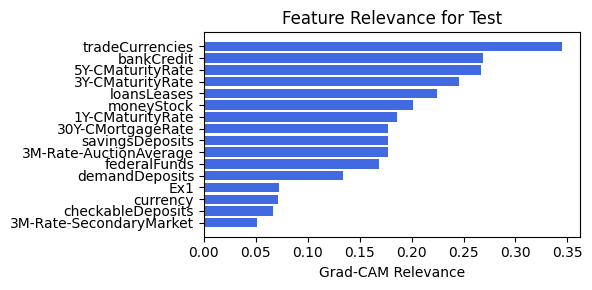

In [155]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.25, filename=filename_2, opt_col_val=0.25)

### 2.3.7. width=[15, 6, 1], grid=7, lamb=1e-05 | alpha=0.1

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 8.28e-02 | eval_loss: 2.12e-01 | reg: 1.28e+02 |: 100%|█| 40/40 [00:44<00:00,  1.11s/i

saving model version 0.1
Best epoch 5
0.2167949378490448
M_KAN Relevance: 0.44864487648010254
CNN Relevance: 0.5513551235198975
[('moneyStock', 0.19981143), ('3Y-CMaturityRate', 0.16856568), ('3M-Rate-SecondaryMarket', 0.16268528), ('checkableDeposits', 0.16077857), ('30Y-CMortgageRate', 0.14392428), ('loansLeases', 0.11396046), ('5Y-CMaturityRate', 0.10423939), ('tradeCurrencies', 0.099004716), ('1Y-CMaturityRate', 0.0806901), ('currency', 0.07738801), ('federalFunds', 0.07723771), ('bankCredit', 0.074344136), ('demandDeposits', 0.06673979), ('3M-Rate-AuctionAverage', 0.057331465), ('savingsDeposits', 0.04746647)]


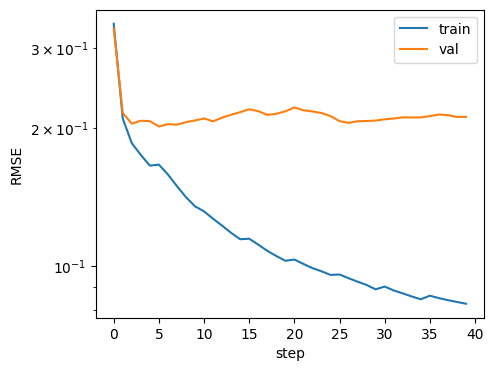

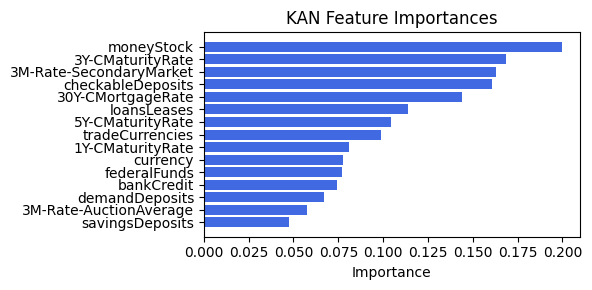

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  8.81it/s]

[('3M-Rate-AuctionAverage', 0.2571389832974611), ('30Y-CMortgageRate', 0.2533899286140998), ('1Y-CMaturityRate', 0.2199449684470892), ('tradeCurrencies', 0.2118638552277324), ('bankCredit', 0.20631849205320968), ('moneyStock', 0.19907348184801993), ('loansLeases', 0.19780608028297483), ('5Y-CMaturityRate', 0.19641098051977765), ('3Y-CMaturityRate', 0.18011236748258982), ('savingsDeposits', 0.1627700632701384), ('federalFunds', 0.15186559399368152), ('checkableDeposits', 0.14795180938228789), ('3M-Rate-SecondaryMarket', 0.13566372959508693), ('demandDeposits', 0.13050292439736602), ('currency', 0.10386870242114778), ('Ex1', 0.06080585874622643)]


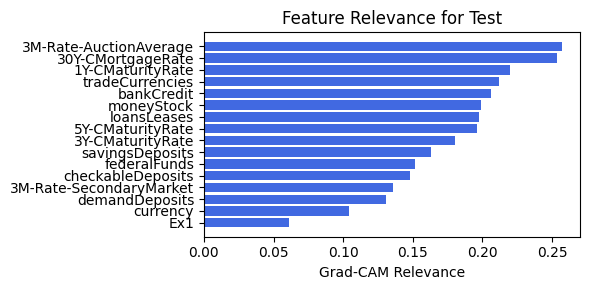

In [156]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.1, filename=filename_2, opt_col_val=0.1)

### 2.3.8. width=[15, 6, 1], grid=7, lamb=1e-05 | alpha=0.1

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 8.14e-02 | eval_loss: 2.18e-01 | reg: 1.31e+02 |: 100%|█| 40/40 [00:44<00:00,  1.11s/i

saving model version 0.1
Best epoch 9
0.22983045876026154
M_KAN Relevance: 0.39419451355934143
CNN Relevance: 0.605805516242981
[('moneyStock', 0.21101569), ('3Y-CMaturityRate', 0.17497054), ('3M-Rate-SecondaryMarket', 0.16323963), ('30Y-CMortgageRate', 0.1567471), ('checkableDeposits', 0.14751194), ('loansLeases', 0.11811995), ('tradeCurrencies', 0.104634665), ('5Y-CMaturityRate', 0.09880917), ('federalFunds', 0.08172661), ('1Y-CMaturityRate', 0.07951545), ('currency', 0.07622223), ('bankCredit', 0.07004368), ('demandDeposits', 0.06355504), ('3M-Rate-AuctionAverage', 0.05672004), ('savingsDeposits', 0.05306586)]


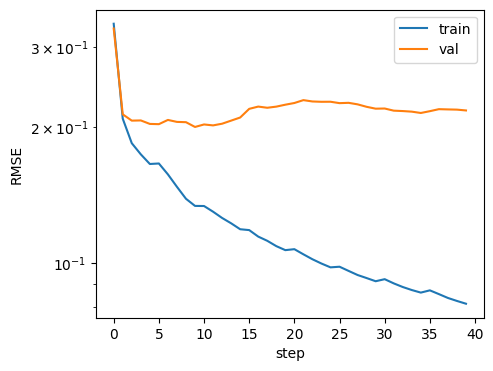

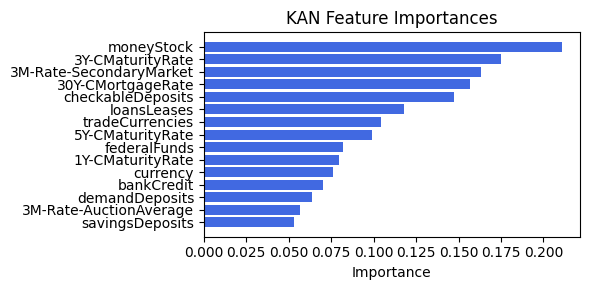

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  9.01it/s]

[('bankCredit', 0.2919809657082494), ('3M-Rate-AuctionAverage', 0.28760567276649884), ('30Y-CMortgageRate', 0.2846863968369906), ('5Y-CMaturityRate', 0.28031010064407297), ('1Y-CMaturityRate', 0.23314345522473257), ('moneyStock', 0.22099910005927087), ('tradeCurrencies', 0.20402930053394466), ('3Y-CMaturityRate', 0.1984545274593291), ('checkableDeposits', 0.19761923225014472), ('currency', 0.1778688534345877), ('federalFunds', 0.15695885886172098), ('3M-Rate-SecondaryMarket', 0.15557995069816355), ('savingsDeposits', 0.14734158293833302), ('loansLeases', 0.1398445980492397), ('Ex1', 0.12745293867109078), ('demandDeposits', 0.1042390409772495)]


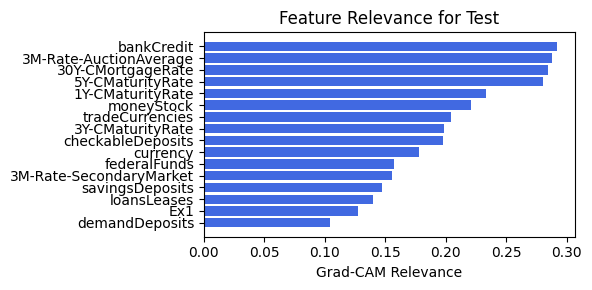

In [157]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.1, filename=filename_2, opt_col_val=0.1)

### 2.3.9. width=[15, 6, 1], grid=7, lamb=1e-05 | alpha=0.05

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 5.77e-02 | eval_loss: 1.93e-01 | reg: 1.78e+02 |: 100%|█| 40/40 [00:45<00:00,  1.13s/i

saving model version 0.1
Best epoch 7
0.23076829314231873
M_KAN Relevance: 0.17028847336769104
CNN Relevance: 0.8297115564346313
[('moneyStock', 0.23419425), ('checkableDeposits', 0.21876585), ('3M-Rate-AuctionAverage', 0.19289397), ('bankCredit', 0.17477684), ('3M-Rate-SecondaryMarket', 0.16673045), ('loansLeases', 0.16648981), ('30Y-CMortgageRate', 0.15867978), ('3Y-CMaturityRate', 0.1581457), ('5Y-CMaturityRate', 0.14977324), ('currency', 0.14868079), ('1Y-CMaturityRate', 0.1457969), ('savingsDeposits', 0.11974168), ('federalFunds', 0.104065165), ('tradeCurrencies', 0.07902907), ('demandDeposits', 0.05274543)]


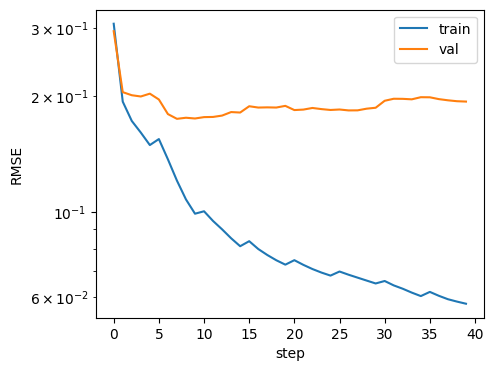

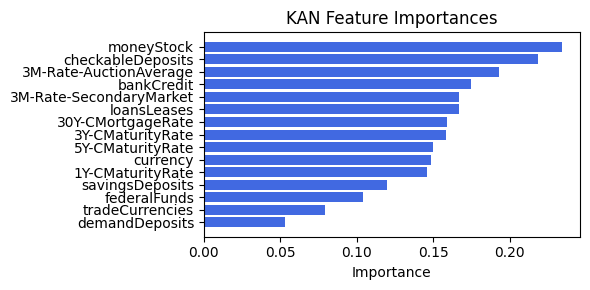

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.68it/s]

[('loansLeases', 0.2330806420612914), ('1Y-CMaturityRate', 0.21154080401839956), ('3M-Rate-SecondaryMarket', 0.1698472765407392), ('tradeCurrencies', 0.15376253599450657), ('30Y-CMortgageRate', 0.13828346504652428), ('3M-Rate-AuctionAverage', 0.13655338151203025), ('3Y-CMaturityRate', 0.13309804529846933), ('savingsDeposits', 0.11500644151903024), ('demandDeposits', 0.10272623722641064), ('5Y-CMaturityRate', 0.08574295614518979), ('bankCredit', 0.08456531569272989), ('currency', 0.06770950224904698), ('moneyStock', 0.06498945209286397), ('checkableDeposits', 0.05963029794899436), ('federalFunds', 0.052077930769883096), ('Ex1', 0.04121326701078076)]


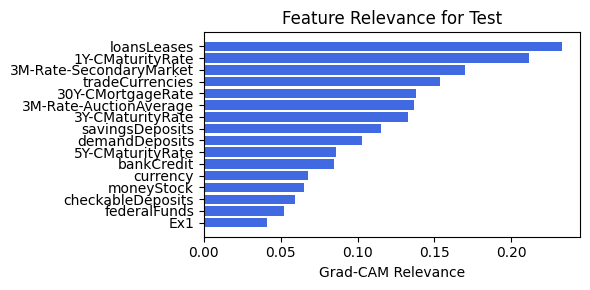

In [158]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.05, filename=filename_2, opt_col_val=0.05)

### 2.3.10. width=[15, 6, 1], grid=7, lamb=1e-05 | alpha=0.05

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_2


| train_loss: 5.69e-02 | eval_loss: 2.32e-01 | reg: 1.80e+02 |: 100%|█| 40/40 [00:42<00:00,  1.07s/i

saving model version 0.1
Best epoch 9
0.24242308735847473
M_KAN Relevance: 0.15848509967327118
CNN Relevance: 0.8415149450302124
[('moneyStock', 0.2636968), ('checkableDeposits', 0.24451534), ('3M-Rate-AuctionAverage', 0.225993), ('loansLeases', 0.21762042), ('bankCredit', 0.21251027), ('3Y-CMaturityRate', 0.19133489), ('3M-Rate-SecondaryMarket', 0.18300217), ('30Y-CMortgageRate', 0.17219904), ('5Y-CMaturityRate', 0.16138572), ('currency', 0.14877632), ('1Y-CMaturityRate', 0.13511938), ('savingsDeposits', 0.11129598), ('federalFunds', 0.099314764), ('tradeCurrencies', 0.09333359), ('demandDeposits', 0.072472185)]


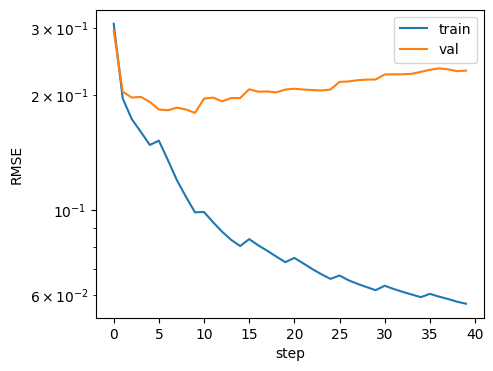

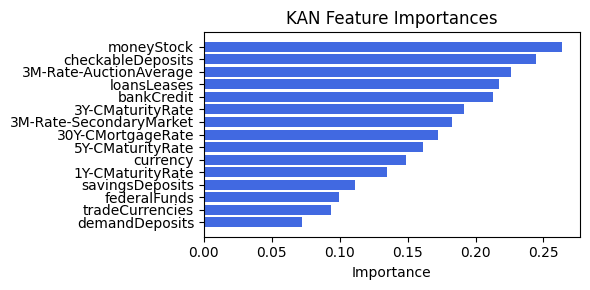

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.50it/s]

[('tradeCurrencies', 0.2699475510948711), ('3M-Rate-SecondaryMarket', 0.21483167876666856), ('loansLeases', 0.1824442038007657), ('currency', 0.17054799344415578), ('1Y-CMaturityRate', 0.1653583666342976), ('3Y-CMaturityRate', 0.1639955572528942), ('checkableDeposits', 0.16216258163719127), ('savingsDeposits', 0.14054634833938465), ('bankCredit', 0.1400387929297895), ('5Y-CMaturityRate', 0.13636805205273309), ('30Y-CMortgageRate', 0.12493924119903352), ('demandDeposits', 0.12481547380753216), ('3M-Rate-AuctionAverage', 0.1196302898139471), ('Ex1', 0.08577788427993212), ('federalFunds', 0.06589984333466938), ('moneyStock', 0.04829766165591233)]


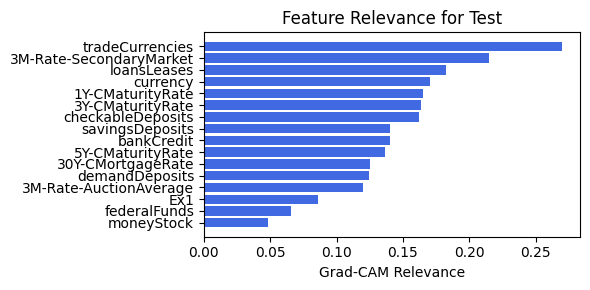

In [159]:
train_and_plot_relevance(Model3_2, kan_neurons=6, kan_grid=7, cnn_bottleneck_dim=-1, lamb=1e-05, steps=40, alpha=0.05, filename=filename_2, opt_col_val=0.05)

# Option 3: Dynamic factor

In [168]:
create_csv_with_header(filename_3, columns_opt3)

## 3.0. width=[15, 5, 1], grid=4, lamb=0.0001

### 3.0.0 width=[15, 5, 1], grid=4, lamb=0.0001 | hidden_dim=128

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.69e-01 | eval_loss: 1.99e-01 | reg: 4.88e+01 |: 100%|█| 70/70 [01:05<00:00,  1.06it/

saving model version 0.1
Best epoch 38
0.24100971221923828
M_KAN Relevance: 0.0015544993802905083
CNN Relevance: 0.9984455108642578
[('savingsDeposits', 0.46625757), ('loansLeases', 0.41164446), ('tradeCurrencies', 0.40688968), ('checkableDeposits', 0.32957613), ('federalFunds', 0.31435457), ('3M-Rate-AuctionAverage', 0.25955525), ('moneyStock', 0.20975582), ('bankCredit', 0.20497446), ('demandDeposits', 0.20455368), ('3Y-CMaturityRate', 0.18003091), ('3M-Rate-SecondaryMarket', 0.17832637), ('30Y-CMortgageRate', 0.17827784), ('currency', 0.1728475), ('1Y-CMaturityRate', 0.1648926), ('5Y-CMaturityRate', 0.15921201)]


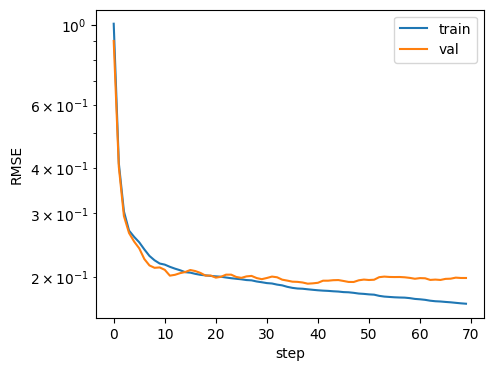

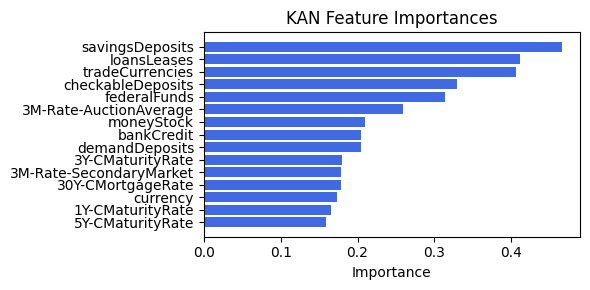

Computing Grad-CAM: 100%|██████████| 210/210 [00:22<00:00,  9.43it/s]

[('checkableDeposits', 0.754701775880087), ('Ex1', 0.5337648638657161), ('currency', 0.463952753231639), ('3M-Rate-SecondaryMarket', 0.429285964824348), ('savingsDeposits', 0.2250736705357364), ('loansLeases', 0.18385585659638137), ('tradeCurrencies', 0.18224603980779647), ('demandDeposits', 0.007483654655429529), ('federalFunds', 0.005881976787072961), ('moneyStock', 0.000500929896675405), ('5Y-CMaturityRate', 0.00029619349682304477), ('1Y-CMaturityRate', 0.0002124874231715997), ('30Y-CMortgageRate', 0.0002103031208250849), ('bankCredit', 9.262944749068646e-05), ('3Y-CMaturityRate', 3.8438403446759494e-05), ('3M-Rate-AuctionAverage', 0.0)]


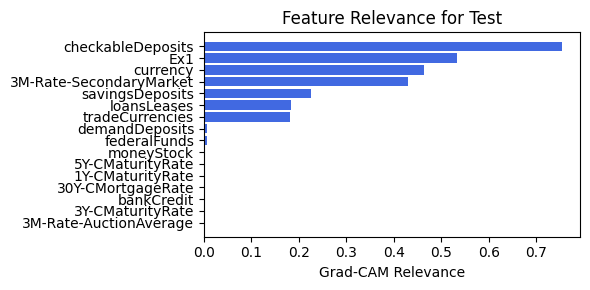

In [169]:
train_and_plot_relevance(Model3_3, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=70, hidden_dim=128, filename=filename_3, opt_col_val=128)

### 3.0.1 width=[15, 5, 1], grid=4, lamb=0.0001 | hidden_dim=128

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.65e-01 | eval_loss: 1.95e-01 | reg: 5.00e+01 |: 100%|█| 70/70 [01:05<00:00,  1.07it/

saving model version 0.1
Best epoch 36
0.23375777900218964
M_KAN Relevance: 0.001678628264926374
CNN Relevance: 0.9983213543891907
[('savingsDeposits', 0.4662024), ('loansLeases', 0.41247636), ('tradeCurrencies', 0.40706196), ('checkableDeposits', 0.32988793), ('federalFunds', 0.31453615), ('3M-Rate-AuctionAverage', 0.25947252), ('moneyStock', 0.21109104), ('bankCredit', 0.2040063), ('demandDeposits', 0.20398192), ('30Y-CMortgageRate', 0.18080579), ('3Y-CMaturityRate', 0.17987762), ('3M-Rate-SecondaryMarket', 0.17848562), ('currency', 0.1730053), ('1Y-CMaturityRate', 0.16517925), ('5Y-CMaturityRate', 0.15960422)]


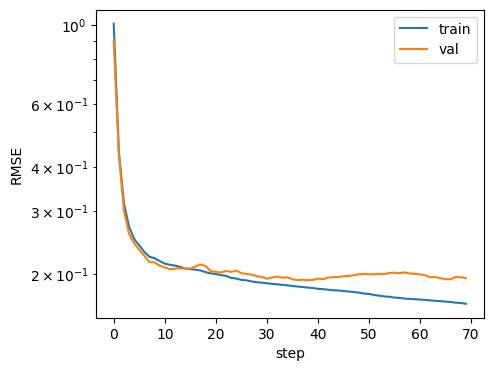

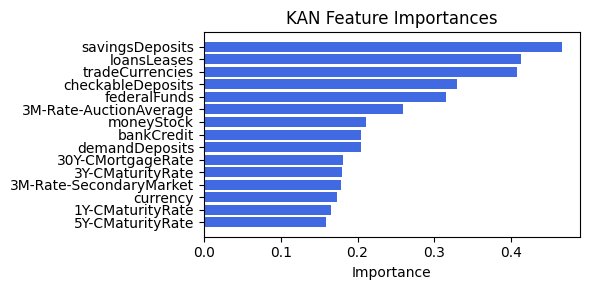

Computing Grad-CAM: 100%|██████████| 210/210 [00:22<00:00,  9.18it/s]

[('checkableDeposits', 0.4469329202281577), ('loansLeases', 0.27512472782816205), ('3M-Rate-SecondaryMarket', 0.24956009757616335), ('tradeCurrencies', 0.23335587651513162), ('savingsDeposits', 0.22664359498857742), ('currency', 0.21989038216526666), ('Ex1', 0.21398069592015373), ('demandDeposits', 0.0028738271409349094), ('5Y-CMaturityRate', 0.00014304322234931445), ('bankCredit', 0.00012505988457373212), ('federalFunds', 0.00010413303867348336), ('30Y-CMortgageRate', 4.994041685547147e-05), ('3Y-CMaturityRate', 5.655254686384329e-07), ('1Y-CMaturityRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('moneyStock', 0.0)]


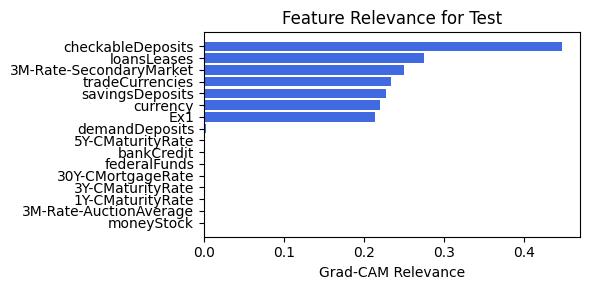

In [170]:
train_and_plot_relevance(Model3_3, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=70, hidden_dim=128, filename=filename_3, opt_col_val=128)

### 3.0.2 width=[15, 5, 1], grid=4, lamb=0.0001 | hidden_dim=64

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.74e-01 | eval_loss: 1.97e-01 | reg: 4.95e+01 |: 100%|█| 70/70 [01:06<00:00,  1.05it/

saving model version 0.1
Best epoch 34
0.247760608792305
M_KAN Relevance: 0.00194309011567384
CNN Relevance: 0.998056948184967
[('savingsDeposits', 0.44483826), ('loansLeases', 0.40061513), ('tradeCurrencies', 0.39524552), ('checkableDeposits', 0.32122725), ('federalFunds', 0.30503312), ('3M-Rate-AuctionAverage', 0.2467794), ('moneyStock', 0.20320228), ('demandDeposits', 0.19454502), ('bankCredit', 0.19437559), ('30Y-CMortgageRate', 0.17820631), ('3M-Rate-SecondaryMarket', 0.1732691), ('3Y-CMaturityRate', 0.17258899), ('currency', 0.16362074), ('1Y-CMaturityRate', 0.16035965), ('5Y-CMaturityRate', 0.15433674)]


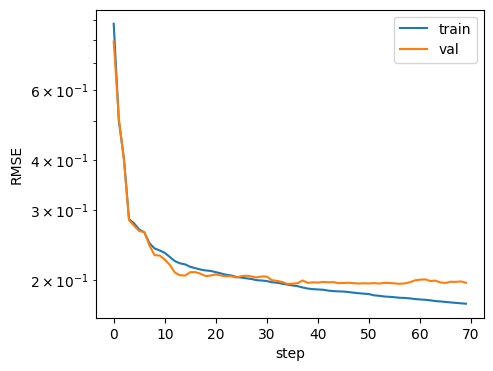

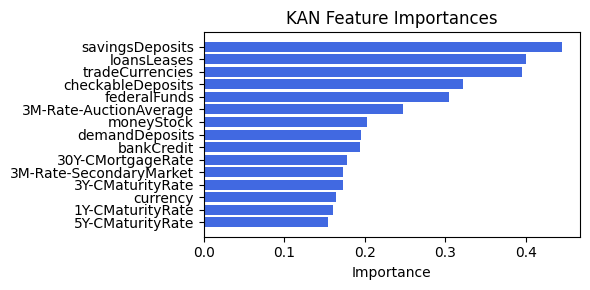

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  9.05it/s]

[('loansLeases', 0.01452946641615459), ('1Y-CMaturityRate', 0.00287608958425976), ('3M-Rate-SecondaryMarket', 0.0008140582413900466), ('30Y-CMortgageRate', 0.00012314080127647946), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('savingsDeposits', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


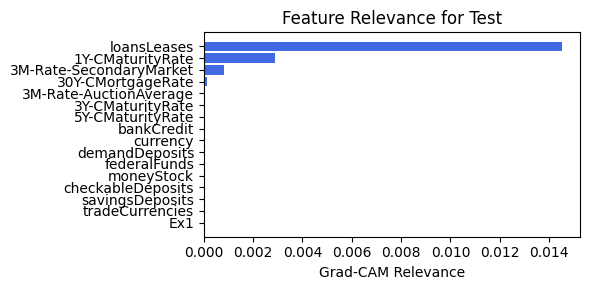

In [171]:
train_and_plot_relevance(Model3_3, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=70, hidden_dim=64, filename=filename_3, opt_col_val=64)

### 3.0.3 width=[15, 5, 1], grid=4, lamb=0.0001  | hidden_dim=64

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.81e-01 | eval_loss: 1.98e-01 | reg: 5.20e+01 |: 100%|█| 70/70 [01:07<00:00,  1.03it/

saving model version 0.1
Best epoch 20
0.24165453016757965
M_KAN Relevance: 0.0018432046053931117
CNN Relevance: 0.9981567859649658
[('savingsDeposits', 0.45499325), ('loansLeases', 0.41119114), ('tradeCurrencies', 0.40086317), ('checkableDeposits', 0.33606654), ('federalFunds', 0.31921554), ('3M-Rate-AuctionAverage', 0.25669804), ('moneyStock', 0.21618211), ('bankCredit', 0.21305776), ('demandDeposits', 0.21027353), ('3M-Rate-SecondaryMarket', 0.17901318), ('3Y-CMaturityRate', 0.17827468), ('currency', 0.1780002), ('30Y-CMortgageRate', 0.17710866), ('1Y-CMaturityRate', 0.16884151), ('5Y-CMaturityRate', 0.1666212)]


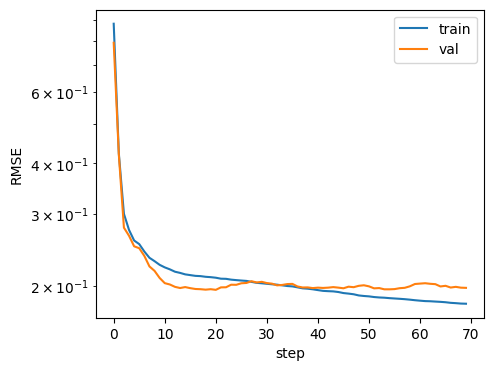

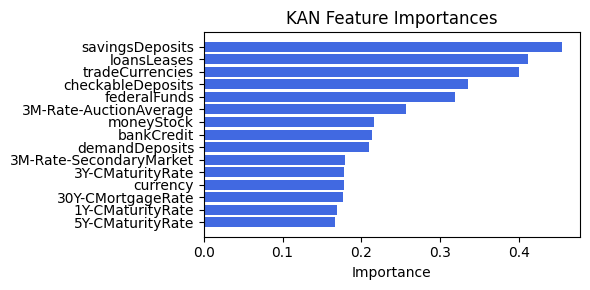

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.25it/s]

[('loansLeases', 0.17566647763763155), ('savingsDeposits', 0.029598119375961168), ('1Y-CMaturityRate', 0.0027186150706949687), ('3M-Rate-SecondaryMarket', 0.0022891269908064888), ('currency', 0.001315315422557649), ('3M-Rate-AuctionAverage', 0.0004537483411175864), ('demandDeposits', 0.00035248909677777974), ('30Y-CMortgageRate', 9.66559031179973e-05), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


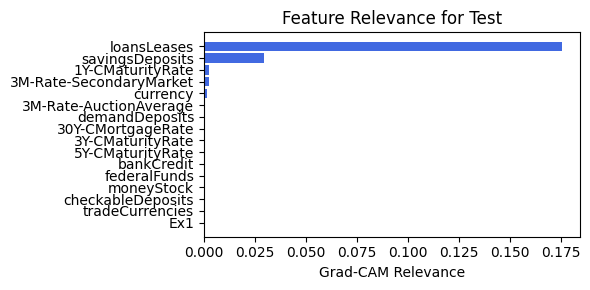

In [172]:
train_and_plot_relevance(Model3_3, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=70, hidden_dim=64, filename=filename_3, opt_col_val=64)

### 3.0.4 width=[15, 5, 1], grid=4, lamb=0.0001  | hidden_dim=32

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.59e-01 | eval_loss: 2.10e-01 | reg: 5.09e+01 |: 100%|█| 70/70 [01:04<00:00,  1.08it/

saving model version 0.1
Best epoch 26
0.22702452540397644
M_KAN Relevance: 0.0030113065149635077
CNN Relevance: 0.9969887137413025
[('savingsDeposits', 0.4541234), ('loansLeases', 0.39845428), ('tradeCurrencies', 0.39571968), ('checkableDeposits', 0.32069525), ('federalFunds', 0.31338292), ('3M-Rate-AuctionAverage', 0.2529892), ('moneyStock', 0.20834255), ('bankCredit', 0.20263155), ('demandDeposits', 0.19341727), ('30Y-CMortgageRate', 0.16893522), ('3M-Rate-SecondaryMarket', 0.16807783), ('3Y-CMaturityRate', 0.16765326), ('currency', 0.1646853), ('1Y-CMaturityRate', 0.15750796), ('5Y-CMaturityRate', 0.15605181)]


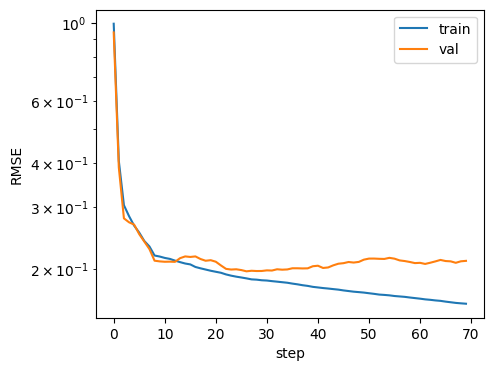

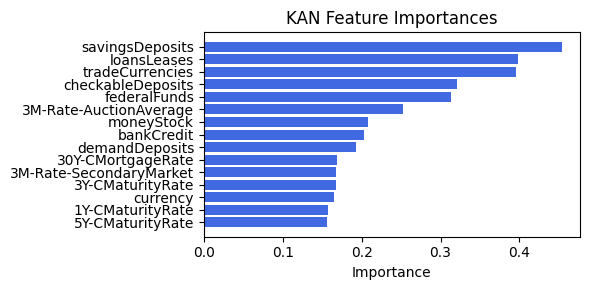

Computing Grad-CAM: 100%|██████████| 210/210 [00:21<00:00,  9.71it/s]

[('loansLeases', 0.24792026896029712), ('3Y-CMaturityRate', 0.23592215048237924), ('demandDeposits', 0.12126195946032003), ('tradeCurrencies', 0.10360184798853533), ('savingsDeposits', 0.05022011029733611), ('3M-Rate-SecondaryMarket', 0.04151421128993943), ('1Y-CMaturityRate', 0.027346980932634324), ('currency', 0.01717930247874132), ('checkableDeposits', 0.008657791217168172), ('30Y-CMortgageRate', 0.006659061346380483), ('3M-Rate-AuctionAverage', 0.004128335753367061), ('Ex1', 0.002544647455215454), ('5Y-CMaturityRate', 0.0005943435111216137), ('bankCredit', 0.0005378167854533309), ('federalFunds', 0.0), ('moneyStock', 0.0)]


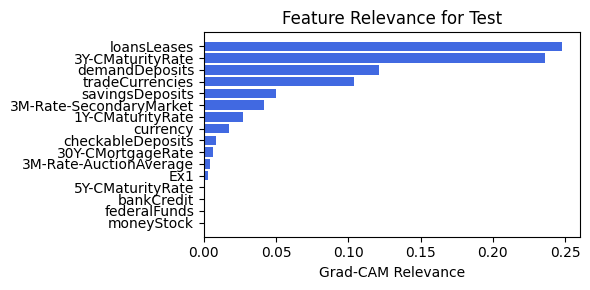

In [173]:
train_and_plot_relevance(Model3_3, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=70, hidden_dim=32, filename=filename_3, opt_col_val=32)

### 3.0.5 width=[15, 5, 1], grid=4, lamb=0.0001  | hidden_dim=32

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.58e-01 | eval_loss: 2.08e-01 | reg: 4.97e+01 |: 100%|█| 70/70 [01:05<00:00,  1.07it/

saving model version 0.1
Best epoch 25
0.24370546638965607
M_KAN Relevance: 0.0028090891428291798
CNN Relevance: 0.9971908926963806
[('savingsDeposits', 0.4575296), ('loansLeases', 0.40128714), ('tradeCurrencies', 0.3981363), ('checkableDeposits', 0.3236676), ('federalFunds', 0.31511575), ('3M-Rate-AuctionAverage', 0.25483486), ('moneyStock', 0.21253048), ('bankCredit', 0.2045948), ('demandDeposits', 0.19783528), ('3Y-CMaturityRate', 0.1709227), ('3M-Rate-SecondaryMarket', 0.1706224), ('30Y-CMortgageRate', 0.16947387), ('currency', 0.16743551), ('1Y-CMaturityRate', 0.16034482), ('5Y-CMaturityRate', 0.15922171)]


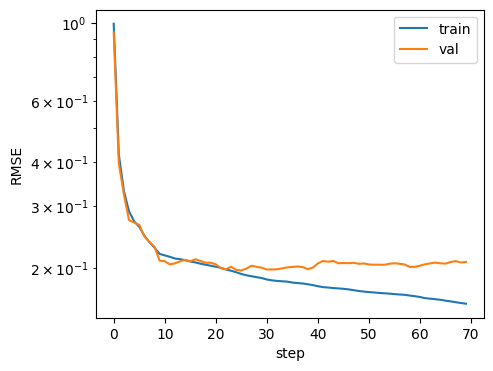

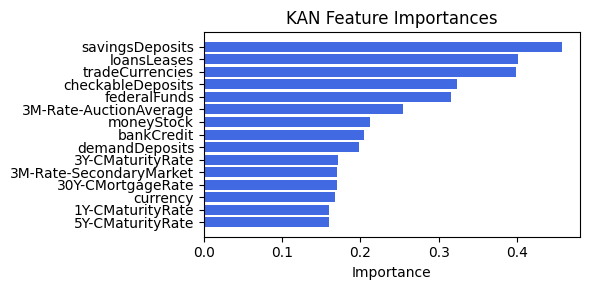

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.69it/s]

[('loansLeases', 0.2539479290600866), ('3M-Rate-SecondaryMarket', 0.025202533460798718), ('1Y-CMaturityRate', 0.024316499878962835), ('3M-Rate-AuctionAverage', 0.01909308641084603), ('30Y-CMortgageRate', 0.018988487698758643), ('savingsDeposits', 0.011023490472386282), ('3Y-CMaturityRate', 0.010398529367964891), ('currency', 0.008477116656667064), ('tradeCurrencies', 0.006703577882477215), ('demandDeposits', 0.006506349547444621), ('bankCredit', 0.0009870227947387667), ('5Y-CMaturityRate', 0.0005883472306387765), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


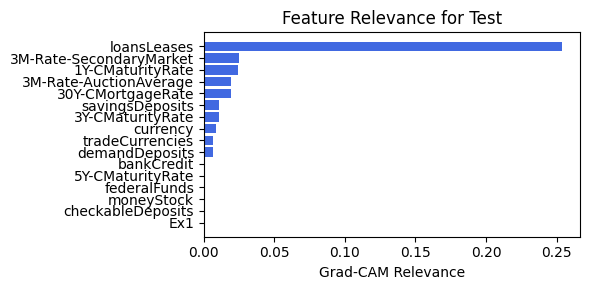

In [174]:
train_and_plot_relevance(Model3_3, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=70, hidden_dim=32, filename=filename_3, opt_col_val=32)

### 3.0.6 width=[15, 5, 1], grid=4, lamb=0.0001  | hidden_dim=16

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.74e-01 | eval_loss: 2.07e-01 | reg: 4.91e+01 |: 100%|█| 70/70 [01:07<00:00,  1.04it/

saving model version 0.1
Best epoch 14
0.24504755437374115
M_KAN Relevance: 0.002633467549458146
CNN Relevance: 0.9973664879798889
[('savingsDeposits', 0.4591835), ('loansLeases', 0.4093527), ('tradeCurrencies', 0.4007899), ('checkableDeposits', 0.32931), ('federalFunds', 0.3220379), ('3M-Rate-AuctionAverage', 0.26154444), ('moneyStock', 0.21750064), ('bankCredit', 0.21393037), ('demandDeposits', 0.20452271), ('3Y-CMaturityRate', 0.17755024), ('currency', 0.1759706), ('30Y-CMortgageRate', 0.17580113), ('3M-Rate-SecondaryMarket', 0.17365645), ('1Y-CMaturityRate', 0.16648947), ('5Y-CMaturityRate', 0.16140997)]


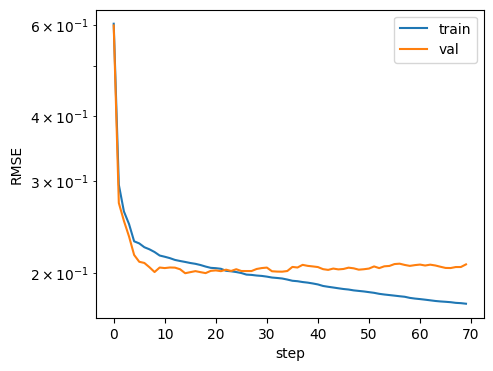

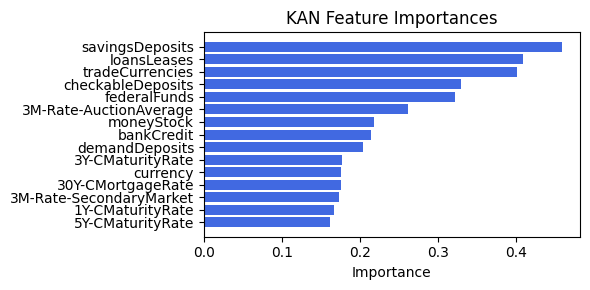

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  8.98it/s]

[('loansLeases', 0.2763423121855816), ('savingsDeposits', 0.0749476749361271), ('demandDeposits', 0.03133106095095475), ('3M-Rate-SecondaryMarket', 0.014800431339868478), ('1Y-CMaturityRate', 0.008653254283680802), ('3M-Rate-AuctionAverage', 0.0021766388777732138), ('30Y-CMortgageRate', 0.0012670982096876417), ('checkableDeposits', 0.0010759335543428148), ('bankCredit', 0.0006065631728796732), ('currency', 0.0004805346950888634), ('5Y-CMaturityRate', 0.0001494710621911855), ('federalFunds', 4.1424589497702465e-05), ('3Y-CMaturityRate', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


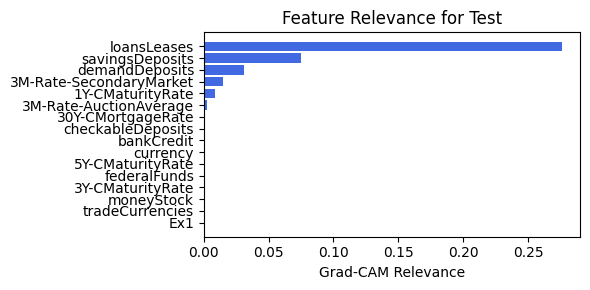

In [175]:
train_and_plot_relevance(Model3_3, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=70, hidden_dim=16, filename=filename_3, opt_col_val=16)

### 3.0.7 width=[15, 5, 1], grid=4, lamb=0.0001  | hidden_dim=16

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.64e-01 | eval_loss: 2.03e-01 | reg: 4.75e+01 |: 100%|█| 70/70 [01:08<00:00,  1.03it/

saving model version 0.1
Best epoch 45
0.23909904062747955
M_KAN Relevance: 0.0026307341177016497
CNN Relevance: 0.9973692893981934
[('savingsDeposits', 0.45881507), ('tradeCurrencies', 0.4017744), ('loansLeases', 0.39549443), ('federalFunds', 0.29942796), ('checkableDeposits', 0.29835013), ('3M-Rate-AuctionAverage', 0.24405217), ('moneyStock', 0.19714437), ('bankCredit', 0.17834575), ('30Y-CMortgageRate', 0.17475489), ('demandDeposits', 0.16842411), ('3Y-CMaturityRate', 0.16607063), ('3M-Rate-SecondaryMarket', 0.16371325), ('1Y-CMaturityRate', 0.14757515), ('currency', 0.14407273), ('5Y-CMaturityRate', 0.13668011)]


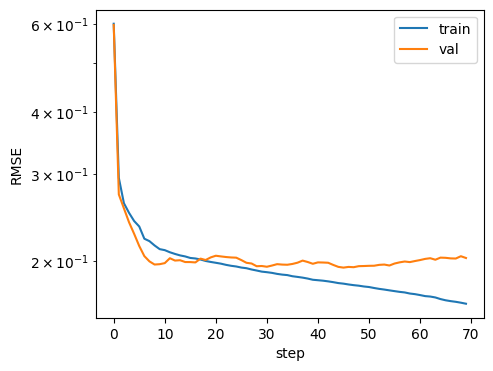

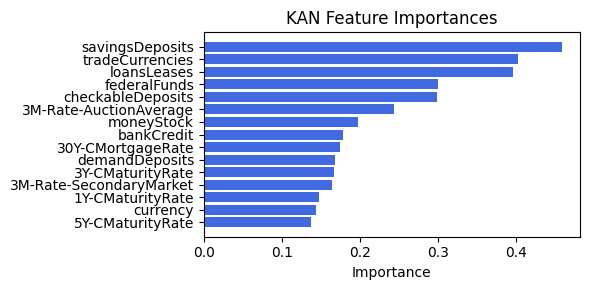

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.70it/s]

[('loansLeases', 0.360832607178461), ('3M-Rate-SecondaryMarket', 0.25725866712275003), ('savingsDeposits', 0.03327152336548481), ('currency', 0.005977414849968184), ('demandDeposits', 0.005197844245204968), ('1Y-CMaturityRate', 0.0007058732566379366), ('Ex1', 0.0004037342535300901), ('checkableDeposits', 7.926237192891892e-05), ('5Y-CMaturityRate', 4.029816205036782e-05), ('30Y-CMortgageRate', 3.896282786237342e-06), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0)]


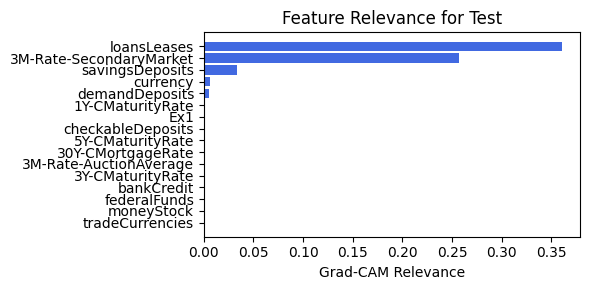

In [176]:
train_and_plot_relevance(Model3_3, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=70, hidden_dim=16, filename=filename_3, opt_col_val=16)

### 3.0.8 width=[15, 5, 1], grid=4, lamb=0.0001 | hidden_dim=8

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.60e-01 | eval_loss: 1.85e-01 | reg: 4.91e+01 |: 100%|█| 70/70 [01:06<00:00,  1.05it/

saving model version 0.1
Best epoch 68
0.24682116508483887
M_KAN Relevance: 0.0018381531117483974
CNN Relevance: 0.9981618523597717
[('savingsDeposits', 0.45104572), ('tradeCurrencies', 0.41467363), ('loansLeases', 0.39556542), ('federalFunds', 0.28353858), ('checkableDeposits', 0.26781756), ('3M-Rate-AuctionAverage', 0.22243944), ('moneyStock', 0.18322794), ('bankCredit', 0.1725745), ('30Y-CMortgageRate', 0.16598965), ('3M-Rate-SecondaryMarket', 0.14985995), ('3Y-CMaturityRate', 0.14951979), ('1Y-CMaturityRate', 0.12416973), ('demandDeposits', 0.11933034), ('5Y-CMaturityRate', 0.107236065), ('currency', 0.10692578)]


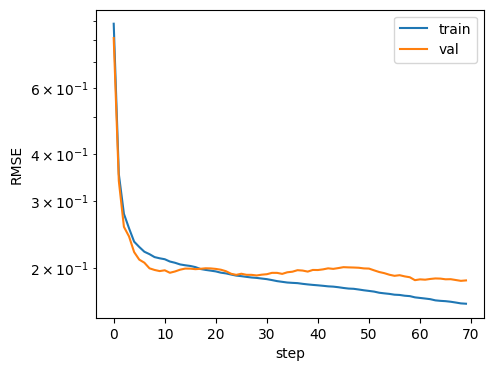

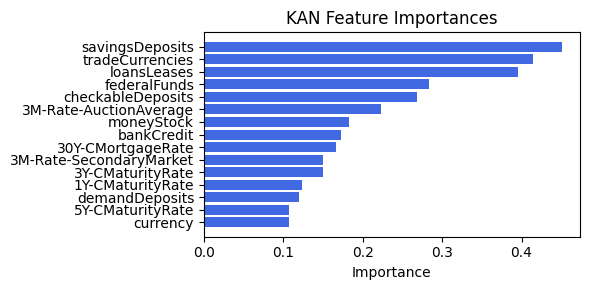

Computing Grad-CAM: 100%|██████████| 210/210 [00:22<00:00,  9.14it/s]

[('tradeCurrencies', 0.5130961415804146), ('loansLeases', 0.20784239113951722), ('savingsDeposits', 0.16849601151077964), ('Ex1', 0.02759754637760731), ('demandDeposits', 0.021803924927510144), ('1Y-CMaturityRate', 0.004783300824818157), ('federalFunds', 0.0033705604833639447), ('3Y-CMaturityRate', 0.0029101805345687483), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3M-Rate-SecondaryMarket', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0)]


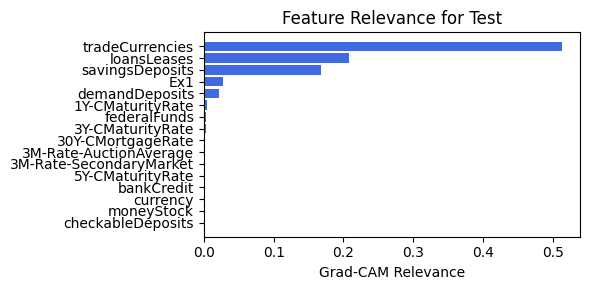

In [177]:
train_and_plot_relevance(Model3_3, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=70, hidden_dim=8, filename=filename_3, opt_col_val=8)

### 3.0.9 width=[15, 5, 1], grid=4, lamb=0.0001 | hidden_dim=8

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.61e-01 | eval_loss: 2.07e-01 | reg: 4.97e+01 |: 100%|█| 70/70 [01:05<00:00,  1.06it/

saving model version 0.1
Best epoch 26
0.2402019500732422
M_KAN Relevance: 0.0020343996584415436
CNN Relevance: 0.9979655742645264
[('savingsDeposits', 0.44533834), ('tradeCurrencies', 0.39372617), ('loansLeases', 0.39097786), ('checkableDeposits', 0.31052858), ('federalFunds', 0.302521), ('3M-Rate-AuctionAverage', 0.24419856), ('moneyStock', 0.20102525), ('bankCredit', 0.18659103), ('demandDeposits', 0.18450837), ('30Y-CMortgageRate', 0.17177157), ('3Y-CMaturityRate', 0.16678248), ('3M-Rate-SecondaryMarket', 0.16567564), ('currency', 0.1577406), ('1Y-CMaturityRate', 0.1540977), ('5Y-CMaturityRate', 0.14732184)]


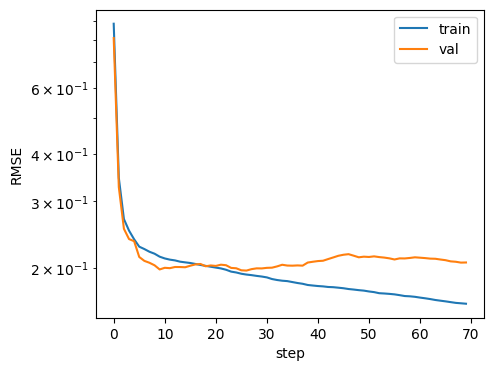

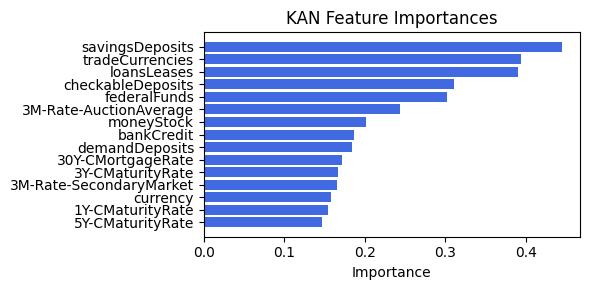

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.67it/s]

[('tradeCurrencies', 0.02282794359184447), ('loansLeases', 0.017237706036706057), ('savingsDeposits', 0.009958219457240331), ('3M-Rate-SecondaryMarket', 0.006389868953486993), ('1Y-CMaturityRate', 0.0030667819836664766), ('30Y-CMortgageRate', 0.0001533464484271549), ('currency', 8.870209012890146e-05), ('3M-Rate-AuctionAverage', 4.591470406878562e-05), ('bankCredit', 2.8052406837343282e-05), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


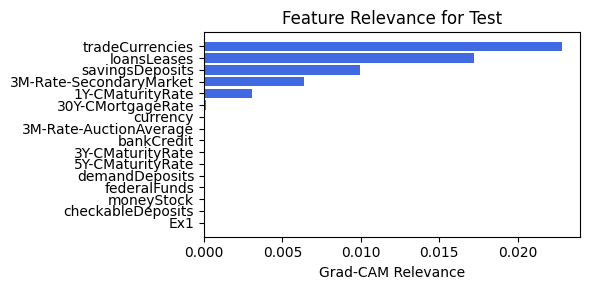

In [178]:
train_and_plot_relevance(Model3_3, kan_neurons=5, kan_grid=4, cnn_bottleneck_dim=-1, lamb=0.0001, steps=70, hidden_dim=8, filename=filename_3, opt_col_val=8)

## 3.1. width=[15, 6, 1], grid=5, lamb=1e-05

### 3.1.0 width=[15, 6, 1], grid=5, lamb=1e-05 | hidden_dim=128

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.63e-01 | eval_loss: 1.98e-01 | reg: 5.50e+01 |: 100%|█| 60/60 [01:03<00:00,  1.06s/i

saving model version 0.1
Best epoch 40
0.2482244074344635
M_KAN Relevance: 0.0025191970635205507
CNN Relevance: 0.9974808096885681
[('checkableDeposits', 0.510369), ('tradeCurrencies', 0.35538384), ('loansLeases', 0.30090404), ('federalFunds', 0.2942359), ('currency', 0.29038173), ('3Y-CMaturityRate', 0.27935278), ('moneyStock', 0.27898312), ('30Y-CMortgageRate', 0.2539529), ('demandDeposits', 0.24234316), ('savingsDeposits', 0.24132037), ('3M-Rate-SecondaryMarket', 0.23019812), ('5Y-CMaturityRate', 0.2207472), ('bankCredit', 0.18260758), ('3M-Rate-AuctionAverage', 0.16821484), ('1Y-CMaturityRate', 0.15006839)]


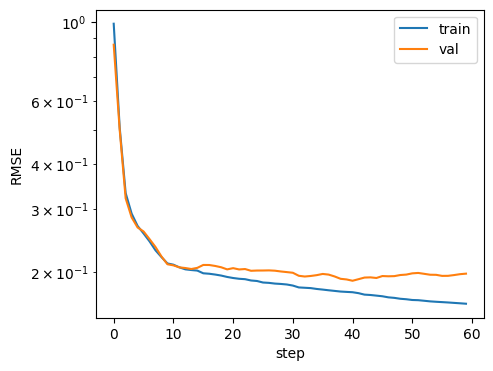

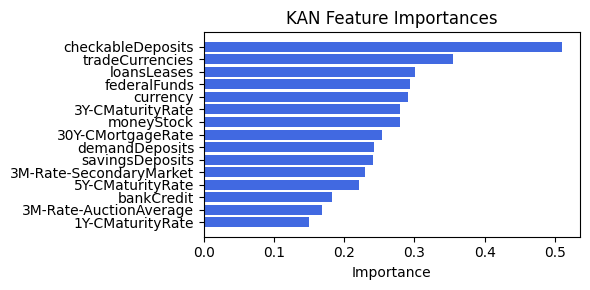

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.50it/s]

[('loansLeases', 0.1820162875757974), ('3M-Rate-SecondaryMarket', 0.028749671374403294), ('checkableDeposits', 0.027918073894189935), ('savingsDeposits', 0.02045160201156423), ('tradeCurrencies', 0.019897533179842174), ('demandDeposits', 0.008504934271886234), ('Ex1', 0.0019191997181180688), ('1Y-CMaturityRate', 0.001252091738084952), ('30Y-CMortgageRate', 0.0010675590263590927), ('3M-Rate-AuctionAverage', 0.0006572129071823189), ('currency', 0.000543129222101665), ('5Y-CMaturityRate', 0.0002636679226443881), ('bankCredit', 0.00025093831299316315), ('3Y-CMaturityRate', 0.00010383641125545615), ('moneyStock', 7.26711049321152e-05), ('federalFunds', 0.0)]


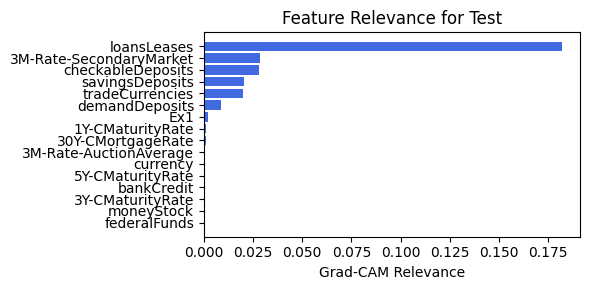

In [179]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=60, hidden_dim=128, filename=filename_3, opt_col_val=128)

### 3.1.1 width=[15, 6, 1], grid=5, lamb=1e-05 | hidden_dim=128

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.67e-01 | eval_loss: 1.96e-01 | reg: 5.39e+01 |: 100%|█| 60/60 [01:04<00:00,  1.07s/i

saving model version 0.1
Best epoch 47
0.23683160543441772
M_KAN Relevance: 0.0018680861685425043
CNN Relevance: 0.9981319308280945
[('checkableDeposits', 0.50719947), ('tradeCurrencies', 0.35129333), ('loansLeases', 0.30126032), ('federalFunds', 0.29312056), ('currency', 0.29139137), ('3Y-CMaturityRate', 0.2780062), ('moneyStock', 0.27666205), ('30Y-CMortgageRate', 0.24980728), ('savingsDeposits', 0.23951232), ('demandDeposits', 0.23626682), ('3M-Rate-SecondaryMarket', 0.2300582), ('5Y-CMaturityRate', 0.22109643), ('bankCredit', 0.18275958), ('3M-Rate-AuctionAverage', 0.16632472), ('1Y-CMaturityRate', 0.14823183)]


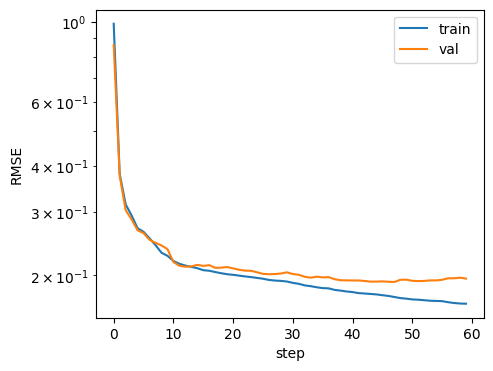

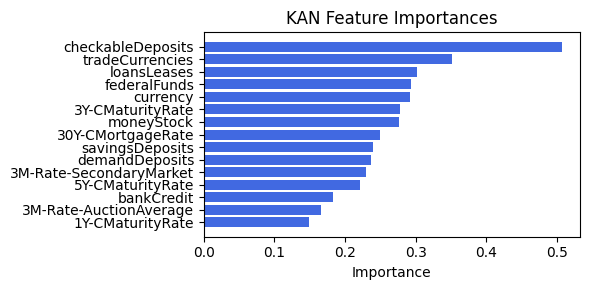

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.22it/s]


[('loansLeases', 0.36302846677191114), ('tradeCurrencies', 0.0647450655554643), ('checkableDeposits', 0.05570902083778665), ('savingsDeposits', 0.055005711980629715), ('3M-Rate-SecondaryMarket', 0.03441534425752858), ('demandDeposits', 0.006968583299645356), ('Ex1', 0.005646469397470355), ('currency', 0.0016999022547333014), ('30Y-CMortgageRate', 0.0010878917023849984), ('1Y-CMaturityRate', 0.0010719850925462588), ('3M-Rate-AuctionAverage', 0.0006046152718010403), ('5Y-CMaturityRate', 0.0003579665285152649), ('bankCredit', 0.00028552737619195665), ('3Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0)]


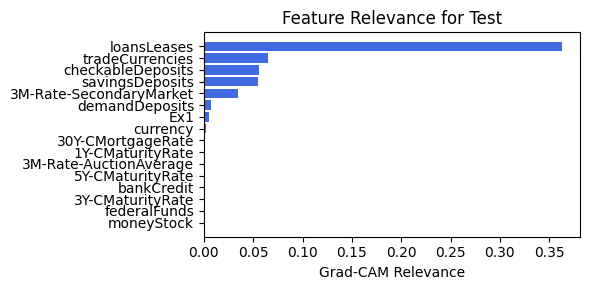

In [180]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=60, hidden_dim=128, filename=filename_3, opt_col_val=128)

### 3.1.2 width=[15, 6, 1], grid=5, lamb=1e-05 | hidden_dim=64

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.73e-01 | eval_loss: 2.00e-01 | reg: 5.31e+01 |: 100%|█| 60/60 [01:04<00:00,  1.08s/i

saving model version 0.1
Best epoch 45
0.24542424082756042
M_KAN Relevance: 0.0023160898126661777
CNN Relevance: 0.9976838827133179
[('checkableDeposits', 0.48028302), ('tradeCurrencies', 0.3393348), ('loansLeases', 0.2922328), ('federalFunds', 0.27859452), ('currency', 0.26656505), ('moneyStock', 0.2627684), ('3Y-CMaturityRate', 0.258245), ('30Y-CMortgageRate', 0.23847704), ('savingsDeposits', 0.22416936), ('demandDeposits', 0.22315252), ('3M-Rate-SecondaryMarket', 0.2187265), ('5Y-CMaturityRate', 0.20483807), ('bankCredit', 0.17151622), ('3M-Rate-AuctionAverage', 0.1583751), ('1Y-CMaturityRate', 0.141318)]


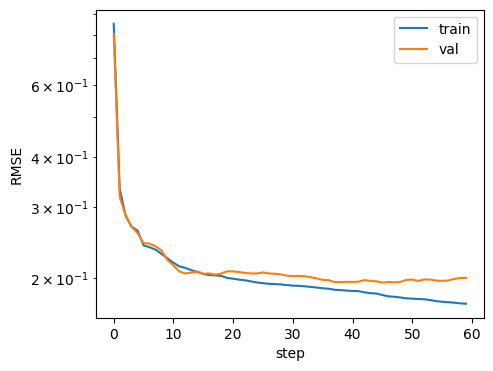

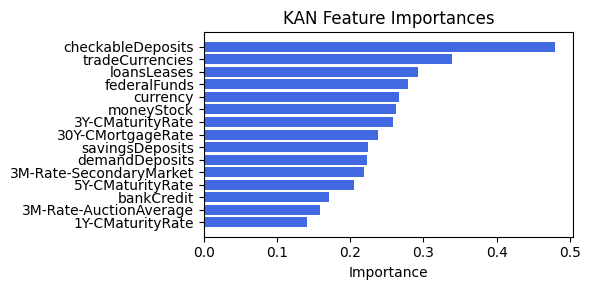

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.50it/s]


[('loansLeases', 0.0743449437808955), ('3M-Rate-SecondaryMarket', 0.02539590842789039), ('savingsDeposits', 0.010665209201674554), ('1Y-CMaturityRate', 0.009361469617024774), ('currency', 0.003226087270082817), ('30Y-CMortgageRate', 0.0021619068594494213), ('Ex1', 0.0010852445626542682), ('3M-Rate-AuctionAverage', 0.0007802365347743034), ('5Y-CMaturityRate', 0.00016450207414371628), ('bankCredit', 0.00013461650703989325), ('3Y-CMaturityRate', 9.270825290254184e-05), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('tradeCurrencies', 0.0)]


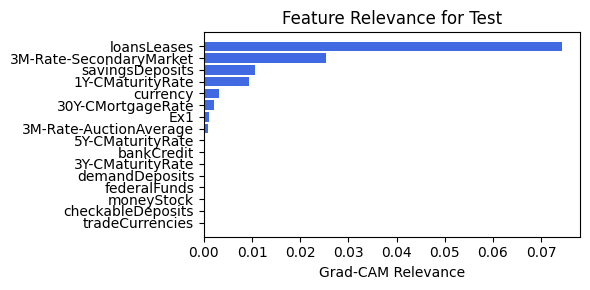

In [181]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=60, hidden_dim=64, filename=filename_3, opt_col_val=64)

### 3.1.3 width=[15, 6, 1], grid=5, lamb=1e-05 | hidden_dim=64

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.69e-01 | eval_loss: 2.01e-01 | reg: 5.45e+01 |: 100%|█| 60/60 [01:05<00:00,  1.09s/i

saving model version 0.1
Best epoch 47
0.23983170092105865
M_KAN Relevance: 0.0028091473504900932
CNN Relevance: 0.9971908926963806
[('checkableDeposits', 0.4748152), ('tradeCurrencies', 0.33648917), ('loansLeases', 0.29161656), ('federalFunds', 0.2764128), ('currency', 0.26320904), ('moneyStock', 0.26039124), ('3Y-CMaturityRate', 0.2551214), ('30Y-CMortgageRate', 0.23668574), ('savingsDeposits', 0.2207407), ('demandDeposits', 0.22019386), ('3M-Rate-SecondaryMarket', 0.21819386), ('5Y-CMaturityRate', 0.20271717), ('bankCredit', 0.17067043), ('3M-Rate-AuctionAverage', 0.15565845), ('1Y-CMaturityRate', 0.13754337)]


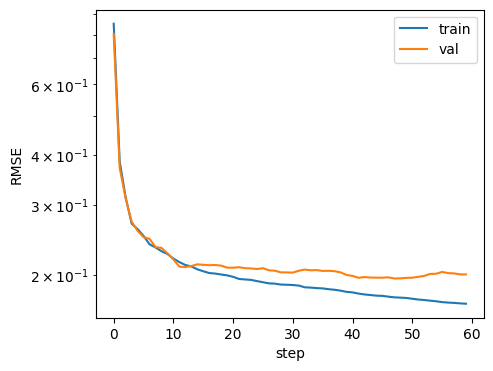

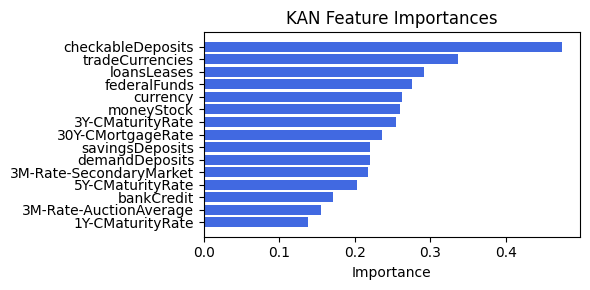

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.20it/s]


[('3M-Rate-SecondaryMarket', 0.06005009095117982), ('loansLeases', 0.05749302067838254), ('savingsDeposits', 0.009240332241530442), ('1Y-CMaturityRate', 0.008480565326975747), ('Ex1', 0.006171014656623204), ('currency', 0.00589934897032522), ('demandDeposits', 0.00218957829333487), ('30Y-CMortgageRate', 0.0005552942642853373), ('3M-Rate-AuctionAverage', 0.00018785125575959682), ('checkableDeposits', 0.00015688743442296982), ('5Y-CMaturityRate', 0.00012459469338258107), ('bankCredit', 2.6015425100922583e-05), ('3Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0)]


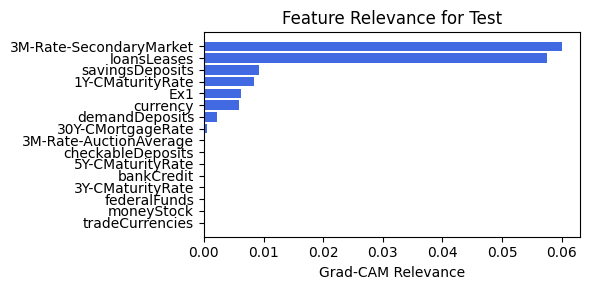

In [182]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=60, hidden_dim=64, filename=filename_3, opt_col_val=64)

### 3.1.4 width=[15, 6, 1], grid=5, lamb=1e-05 | hidden_dim=32

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.57e-01 | eval_loss: 1.97e-01 | reg: 5.58e+01 |: 100%|█| 60/60 [01:04<00:00,  1.07s/i

saving model version 0.1
Best epoch 58
0.22309938073158264
M_KAN Relevance: 0.0030402487609535456
CNN Relevance: 0.9969598054885864
[('checkableDeposits', 0.4965355), ('tradeCurrencies', 0.3481086), ('loansLeases', 0.29260647), ('currency', 0.27998605), ('federalFunds', 0.2785826), ('moneyStock', 0.26469776), ('3Y-CMaturityRate', 0.2623881), ('30Y-CMortgageRate', 0.2479305), ('demandDeposits', 0.22926013), ('savingsDeposits', 0.22512859), ('3M-Rate-SecondaryMarket', 0.22074771), ('5Y-CMaturityRate', 0.21483159), ('bankCredit', 0.17520443), ('3M-Rate-AuctionAverage', 0.15927577), ('1Y-CMaturityRate', 0.14919896)]


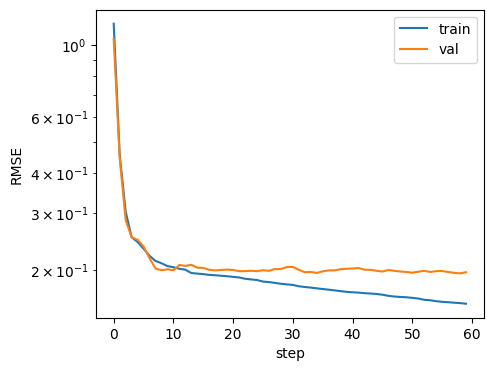

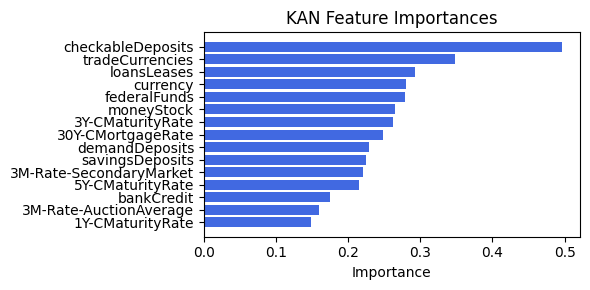

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.12it/s]

[('Ex1', 0.12272776804332222), ('tradeCurrencies', 0.09147660746349998), ('savingsDeposits', 0.035992306692060085), ('loansLeases', 0.026069014909721556), ('3M-Rate-SecondaryMarket', 0.006703077156063436), ('1Y-CMaturityRate', 0.005925277123848597), ('currency', 0.004602281050063626), ('checkableDeposits', 0.0025800382758634876), ('30Y-CMortgageRate', 0.00024086300815854753), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0)]


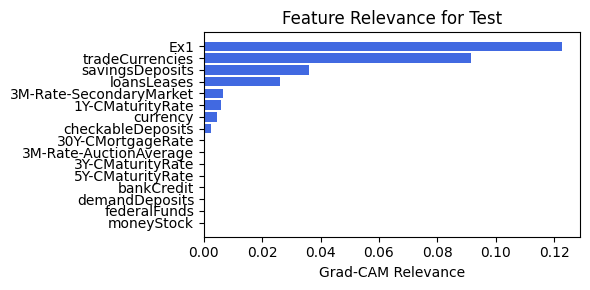

In [183]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=60, hidden_dim=32, filename=filename_3, opt_col_val=32)

### 3.1.5 width=[15, 6, 1], grid=5, lamb=1e-05 | hidden_dim=32

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.59e-01 | eval_loss: 2.07e-01 | reg: 5.51e+01 |: 100%|█| 60/60 [01:03<00:00,  1.06s/i

saving model version 0.1
Best epoch 30
0.23289725184440613
M_KAN Relevance: 0.0024498235434293747
CNN Relevance: 0.9975502490997314
[('checkableDeposits', 0.49749935), ('tradeCurrencies', 0.34612268), ('loansLeases', 0.29495576), ('currency', 0.28284684), ('federalFunds', 0.2809862), ('moneyStock', 0.26765594), ('3Y-CMaturityRate', 0.2659268), ('30Y-CMortgageRate', 0.24385697), ('savingsDeposits', 0.2290983), ('demandDeposits', 0.22688566), ('3M-Rate-SecondaryMarket', 0.21850422), ('5Y-CMaturityRate', 0.21400389), ('bankCredit', 0.17407441), ('3M-Rate-AuctionAverage', 0.16291142), ('1Y-CMaturityRate', 0.14729996)]


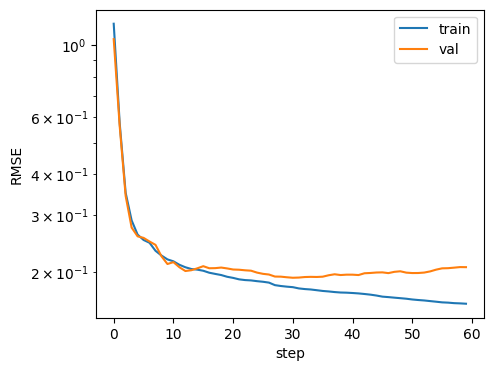

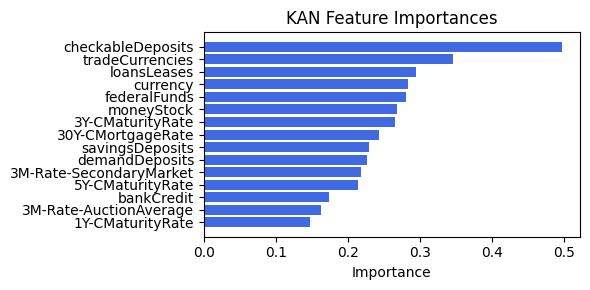

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  8.78it/s]

[('loansLeases', 0.4688155271467708), ('savingsDeposits', 0.0885275160261829), ('1Y-CMaturityRate', 0.02580480145822678), ('demandDeposits', 0.017106531977298715), ('3M-Rate-SecondaryMarket', 0.014588960291196903), ('30Y-CMortgageRate', 0.005488634211499067), ('3M-Rate-AuctionAverage', 0.005428494088396075), ('3Y-CMaturityRate', 0.0014738801193224), ('bankCredit', 0.000936246911684672), ('currency', 0.0007585235073098114), ('5Y-CMaturityRate', 0.0006665740694318499), ('Ex1', 0.00011490276748580592), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('tradeCurrencies', 0.0)]


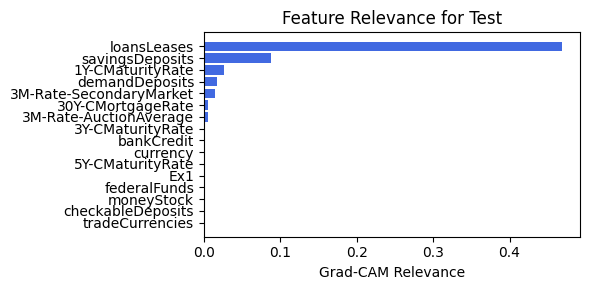

In [184]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=60, hidden_dim=32, filename=filename_3, opt_col_val=32)

### 3.1.6 width=[15, 6, 1], grid=5, lamb=1e-05 | hidden_dim=16

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.55e-01 | eval_loss: 1.93e-01 | reg: 5.57e+01 |: 100%|█| 60/60 [01:02<00:00,  1.05s/i

saving model version 0.1
Best epoch 33
0.24240030348300934
M_KAN Relevance: 0.003248195629566908
CNN Relevance: 0.9967517852783203
[('checkableDeposits', 0.5047309), ('tradeCurrencies', 0.35451144), ('loansLeases', 0.2879002), ('federalFunds', 0.2858703), ('currency', 0.28451937), ('3Y-CMaturityRate', 0.2702776), ('moneyStock', 0.26979622), ('30Y-CMortgageRate', 0.24351525), ('savingsDeposits', 0.23654908), ('demandDeposits', 0.23061201), ('5Y-CMaturityRate', 0.21569328), ('3M-Rate-SecondaryMarket', 0.20705943), ('bankCredit', 0.17331861), ('3M-Rate-AuctionAverage', 0.1617141), ('1Y-CMaturityRate', 0.15327507)]


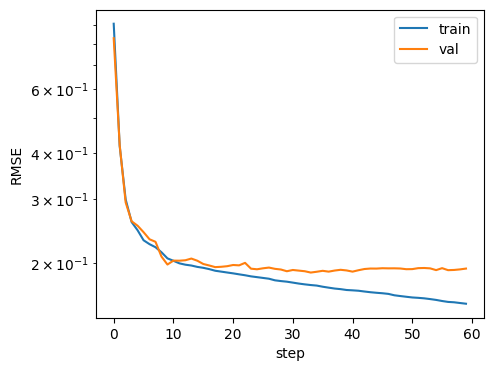

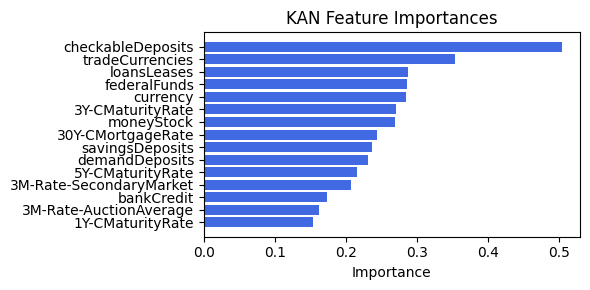

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.23it/s]


[('3Y-CMaturityRate', 0.16150642594854747), ('3M-Rate-SecondaryMarket', 0.043168635524454574), ('demandDeposits', 0.042389193362379), ('loansLeases', 0.04104678068179921), ('tradeCurrencies', 0.034632737654083895), ('1Y-CMaturityRate', 0.02693910196311273), ('3M-Rate-AuctionAverage', 0.017389707018931708), ('30Y-CMortgageRate', 0.01696623485712778), ('currency', 0.003316495242706012), ('savingsDeposits', 0.0032524944661417978), ('bankCredit', 0.0009153362186182113), ('5Y-CMaturityRate', 0.0005578526340070225), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


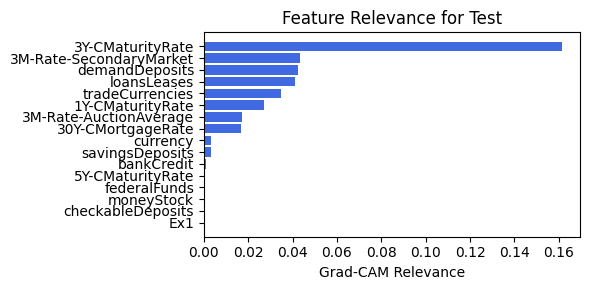

In [185]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=60, hidden_dim=16, filename=filename_3, opt_col_val=16)

### 3.1.7 width=[15, 6, 1], grid=5, lamb=1e-05 | hidden_dim=16

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.54e-01 | eval_loss: 1.98e-01 | reg: 5.36e+01 |: 100%|█| 60/60 [01:02<00:00,  1.05s/i

saving model version 0.1
Best epoch 37
0.25755926966667175
M_KAN Relevance: 0.002278306055814028
CNN Relevance: 0.9977216720581055
[('checkableDeposits', 0.5115847), ('tradeCurrencies', 0.35841855), ('federalFunds', 0.28993458), ('loansLeases', 0.28979686), ('currency', 0.2883587), ('moneyStock', 0.2739358), ('3Y-CMaturityRate', 0.27286512), ('30Y-CMortgageRate', 0.24752407), ('savingsDeposits', 0.24083722), ('demandDeposits', 0.23802803), ('3M-Rate-SecondaryMarket', 0.21944651), ('5Y-CMaturityRate', 0.2160455), ('bankCredit', 0.17731434), ('3M-Rate-AuctionAverage', 0.16617808), ('1Y-CMaturityRate', 0.15205431)]


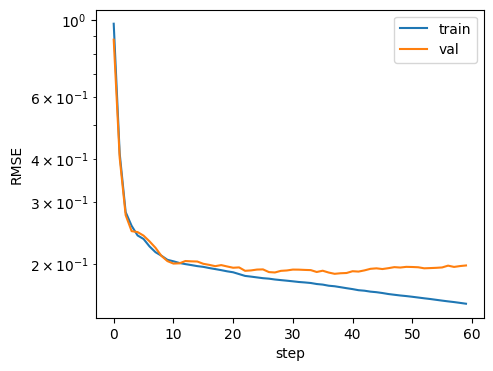

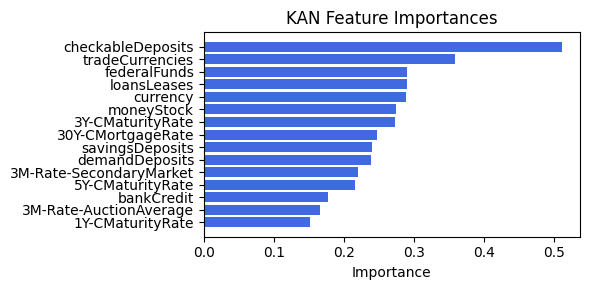

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.16it/s]

[('loansLeases', 0.04690006954728493), ('3M-Rate-SecondaryMarket', 0.04190961704367683), ('1Y-CMaturityRate', 0.030650720638888223), ('demandDeposits', 0.027978574848246007), ('30Y-CMortgageRate', 0.02458012593644006), ('3M-Rate-AuctionAverage', 0.023509843718437923), ('currency', 0.01446332860671516), ('tradeCurrencies', 0.012589862641124498), ('3Y-CMaturityRate', 0.011519700350860754), ('savingsDeposits', 0.001630700711670908), ('bankCredit', 0.0005855519324541092), ('5Y-CMaturityRate', 0.0003825604998772698), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


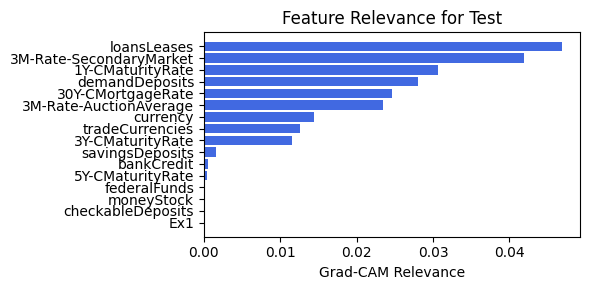

In [186]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=60, hidden_dim=16, filename=filename_3, opt_col_val=16)

### 3.1.8 width=[15, 6, 1], grid=5, lamb=1e-05 | hidden_dim=8

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.53e-01 | eval_loss: 1.96e-01 | reg: 5.54e+01 |: 100%|█| 60/60 [01:03<00:00,  1.06s/i

saving model version 0.1
Best epoch 46
0.20925134420394897
M_KAN Relevance: 0.002527673961594701
CNN Relevance: 0.9974722862243652
[('checkableDeposits', 0.5008486), ('tradeCurrencies', 0.3524694), ('federalFunds', 0.2950099), ('loansLeases', 0.2876126), ('currency', 0.27867618), ('3Y-CMaturityRate', 0.2723179), ('moneyStock', 0.262444), ('30Y-CMortgageRate', 0.25159144), ('demandDeposits', 0.24237108), ('savingsDeposits', 0.23842132), ('3M-Rate-SecondaryMarket', 0.22730446), ('5Y-CMaturityRate', 0.21347128), ('bankCredit', 0.17446652), ('3M-Rate-AuctionAverage', 0.16738003), ('1Y-CMaturityRate', 0.15323709)]


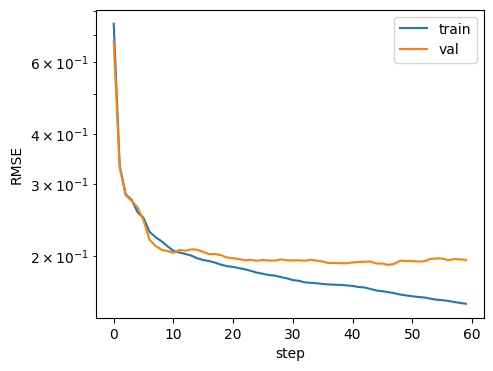

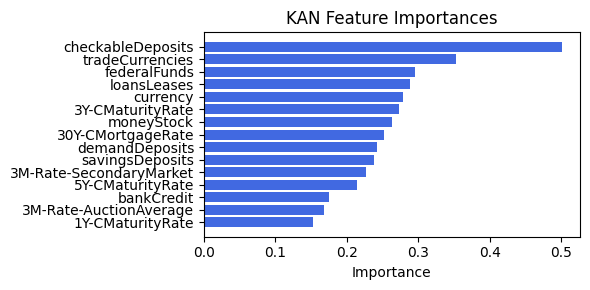

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.17it/s]


[('3M-Rate-SecondaryMarket', 0.45551226528893624), ('checkableDeposits', 0.09247823870252996), ('currency', 0.011905965812149501), ('1Y-CMaturityRate', 0.0), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('loansLeases', 0.0), ('savingsDeposits', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


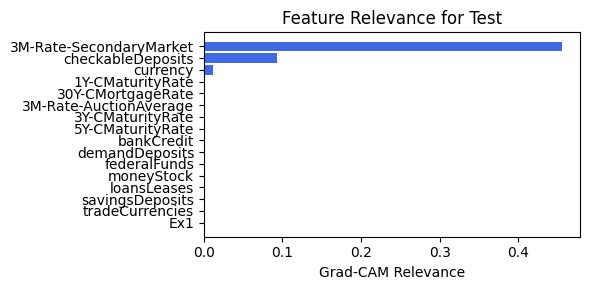

In [187]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=60, hidden_dim=8, filename=filename_3, opt_col_val=8)

### 3.1.9 width=[15, 6, 1], grid=5, lamb=1e-05 | hidden_dim=8

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.53e-01 | eval_loss: 1.96e-01 | reg: 5.54e+01 |: 100%|█| 60/60 [01:03<00:00,  1.05s/i

saving model version 0.1
Best epoch 46
0.20925134420394897
M_KAN Relevance: 0.002527673961594701
CNN Relevance: 0.9974722862243652
[('checkableDeposits', 0.5008486), ('tradeCurrencies', 0.3524694), ('federalFunds', 0.2950099), ('loansLeases', 0.2876126), ('currency', 0.27867618), ('3Y-CMaturityRate', 0.2723179), ('moneyStock', 0.262444), ('30Y-CMortgageRate', 0.25159144), ('demandDeposits', 0.24237108), ('savingsDeposits', 0.23842132), ('3M-Rate-SecondaryMarket', 0.22730446), ('5Y-CMaturityRate', 0.21347128), ('bankCredit', 0.17446652), ('3M-Rate-AuctionAverage', 0.16738003), ('1Y-CMaturityRate', 0.15323709)]


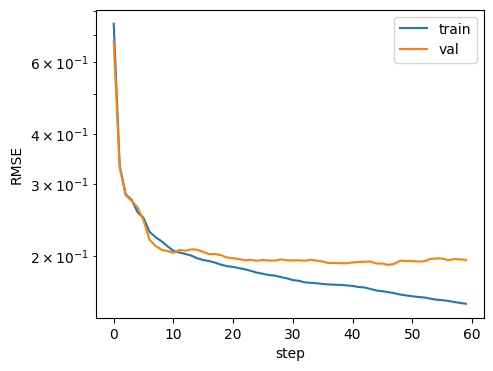

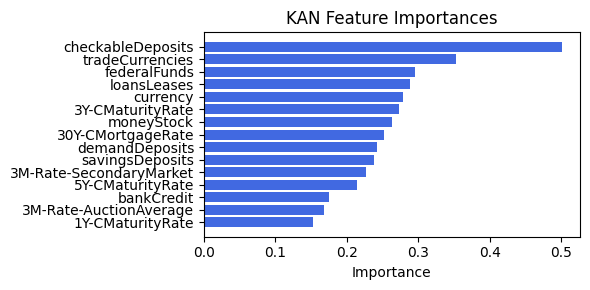

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.75it/s]

[('3M-Rate-SecondaryMarket', 0.45551226528893624), ('checkableDeposits', 0.09247823870252996), ('currency', 0.011905965812149501), ('1Y-CMaturityRate', 0.0), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('loansLeases', 0.0), ('savingsDeposits', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


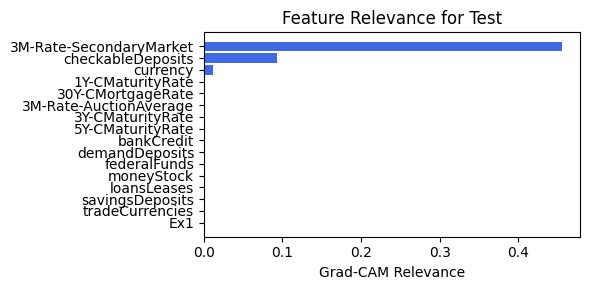

In [188]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=5, cnn_bottleneck_dim=-1, lamb=1e-05, steps=60, hidden_dim=8, filename=filename_3, opt_col_val=8)

### 3.1.10 width=[15, 6, 1], grid=5, lamb=1e-05 | hidden_dim=6

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.75e-01 | eval_loss: 1.87e-01 | reg: 9.37e+01 |: 100%|█| 40/40 [00:42<00:00,  1.07s/i

saving model version 0.1
Best epoch 38
0.2669050693511963
M_KAN Relevance: 0.005669923033565283
CNN Relevance: 0.994330108165741
[('checkableDeposits', 0.47357935), ('tradeCurrencies', 0.36269957), ('loansLeases', 0.3407193), ('currency', 0.3206542), ('federalFunds', 0.28647113), ('3Y-CMaturityRate', 0.27658254), ('30Y-CMortgageRate', 0.2678004), ('moneyStock', 0.260808), ('demandDeposits', 0.2513413), ('savingsDeposits', 0.24572682), ('3M-Rate-SecondaryMarket', 0.2190598), ('5Y-CMaturityRate', 0.20890896), ('3M-Rate-AuctionAverage', 0.18495974), ('1Y-CMaturityRate', 0.17768756), ('bankCredit', 0.16832194)]


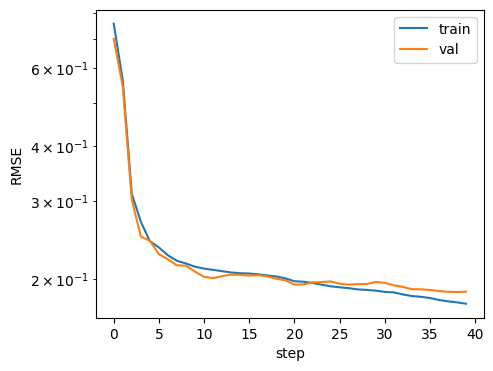

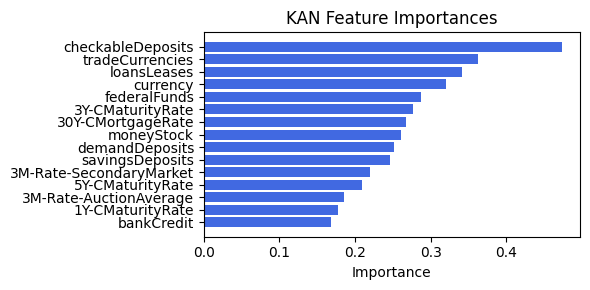

Computing Grad-CAM: 100%|██████████| 210/210 [00:28<00:00,  7.48it/s]


[('loansLeases', 0.07109587589899699), ('savingsDeposits', 0.002249529172799417), ('tradeCurrencies', 0.0008901721842232205), ('Ex1', 0.00029942765831947327), ('1Y-CMaturityRate', 0.00014226108434654418), ('bankCredit', 1.644062465943751e-05), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3M-Rate-SecondaryMarket', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('currency', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0)]


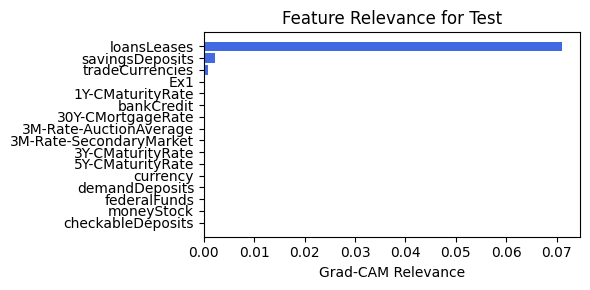

In [79]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=40, hidden_dim=6, filename=filename_3, opt_col_val=6)

### 3.1.10 width=[15, 6, 1], grid=5, lamb=1e-05 | hidden_dim=6

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.65e-01 | eval_loss: 1.99e-01 | reg: 6.35e+01 |: 100%|█| 40/40 [00:42<00:00,  1.06s/i


saving model version 0.1
Best epoch 25
0.23832012712955475
M_KAN Relevance: 0.0034364366438239813
CNN Relevance: 0.9965635538101196
[('checkableDeposits', 0.50332355), ('tradeCurrencies', 0.37223062), ('loansLeases', 0.32204872), ('federalFunds', 0.30765477), ('currency', 0.28722185), ('3Y-CMaturityRate', 0.2740283), ('demandDeposits', 0.26518592), ('moneyStock', 0.26500154), ('30Y-CMortgageRate', 0.26024556), ('savingsDeposits', 0.25156286), ('3M-Rate-SecondaryMarket', 0.23130858), ('5Y-CMaturityRate', 0.21827516), ('bankCredit', 0.17175016), ('3M-Rate-AuctionAverage', 0.16870503), ('1Y-CMaturityRate', 0.1685485)]


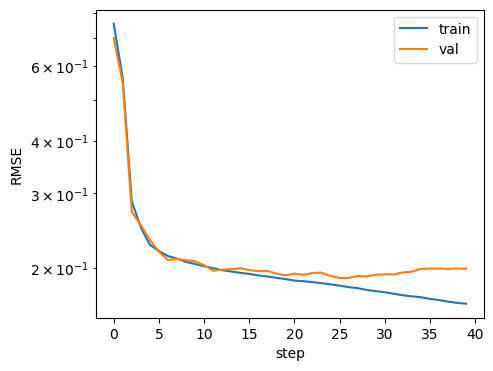

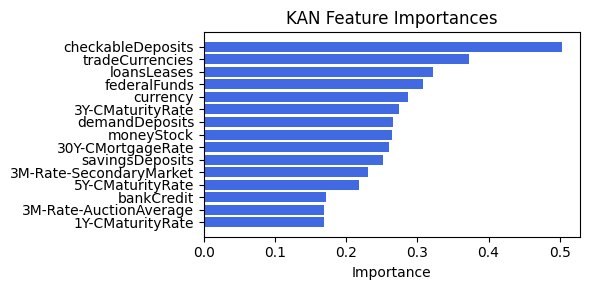

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  7.95it/s]

[('loansLeases', 0.2472167010818209), ('savingsDeposits', 0.026891197964349495), ('demandDeposits', 0.009943958147916765), ('1Y-CMaturityRate', 0.0), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3M-Rate-SecondaryMarket', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


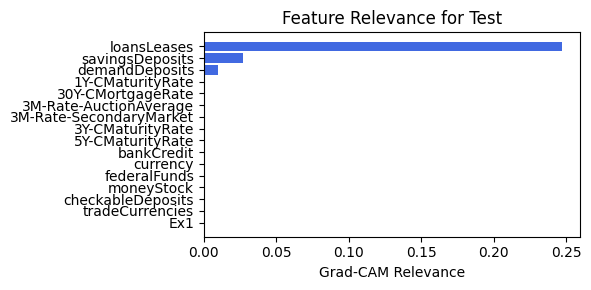

In [80]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=40, hidden_dim=6, filename=filename_3, opt_col_val=6)

### 3.1.10 width=[15, 6, 1], grid=5, lamb=1e-05 | hidden_dim=4

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.52e-01 | eval_loss: 1.89e-01 | reg: 7.27e+01 |: 100%|█| 40/40 [00:43<00:00,  1.09s/i

saving model version 0.1
Best epoch 24
0.22751758992671967
M_KAN Relevance: 0.0022411111276596785
CNN Relevance: 0.9977589249610901
[('checkableDeposits', 0.4982024), ('tradeCurrencies', 0.368953), ('currency', 0.2844255), ('federalFunds', 0.27580723), ('loansLeases', 0.27181616), ('3Y-CMaturityRate', 0.25927475), ('moneyStock', 0.25499493), ('30Y-CMortgageRate', 0.23798397), ('savingsDeposits', 0.23739748), ('demandDeposits', 0.2201305), ('3M-Rate-SecondaryMarket', 0.21621919), ('5Y-CMaturityRate', 0.2068426), ('bankCredit', 0.17014766), ('3M-Rate-AuctionAverage', 0.15680023), ('1Y-CMaturityRate', 0.1437585)]


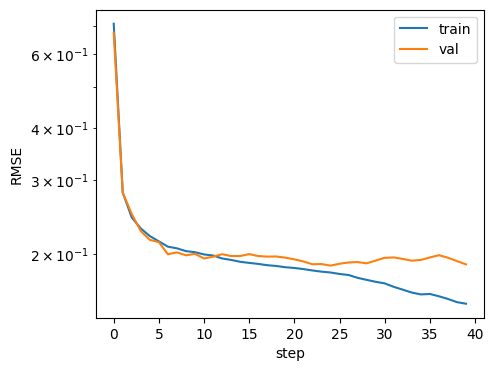

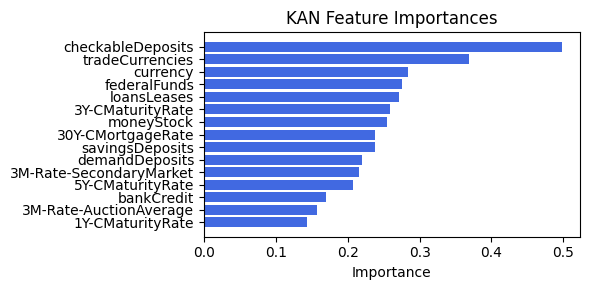

Computing Grad-CAM: 100%|██████████| 210/210 [00:27<00:00,  7.78it/s]

[('Ex1', 0.26814097591808866), ('tradeCurrencies', 0.04565253851580478), ('savingsDeposits', 0.027037510101217778), ('loansLeases', 0.019193838474651177), ('currency', 3.4502430242441947e-06), ('1Y-CMaturityRate', 0.0), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3M-Rate-SecondaryMarket', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0)]


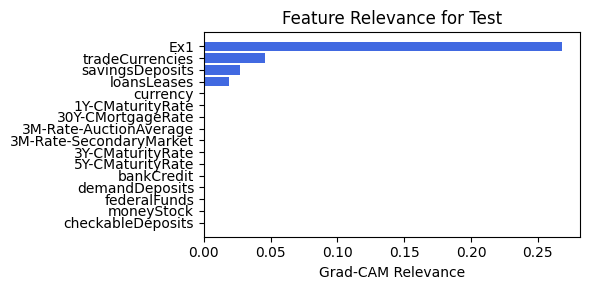

In [75]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=40, hidden_dim=4, filename=filename_3, opt_col_val=4)

### 3.1.11 width=[15, 6, 1], grid=5, lamb=1e-05 | hidden_dim=4

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.33e-01 | eval_loss: 1.90e-01 | reg: 9.34e+01 |: 100%|█| 40/40 [00:42<00:00,  1.06s/i

saving model version 0.1
Best epoch 28
0.25452402234077454
M_KAN Relevance: 0.013295366428792477
CNN Relevance: 0.9867046475410461
[('checkableDeposits', 0.48554134), ('tradeCurrencies', 0.37707943), ('federalFunds', 0.3008086), ('30Y-CMortgageRate', 0.28549415), ('3Y-CMaturityRate', 0.26580676), ('currency', 0.26447684), ('loansLeases', 0.24921742), ('savingsDeposits', 0.23481748), ('moneyStock', 0.22727194), ('3M-Rate-SecondaryMarket', 0.21485877), ('demandDeposits', 0.20810676), ('5Y-CMaturityRate', 0.20377931), ('bankCredit', 0.18487749), ('3M-Rate-AuctionAverage', 0.14117882), ('1Y-CMaturityRate', 0.124795616)]


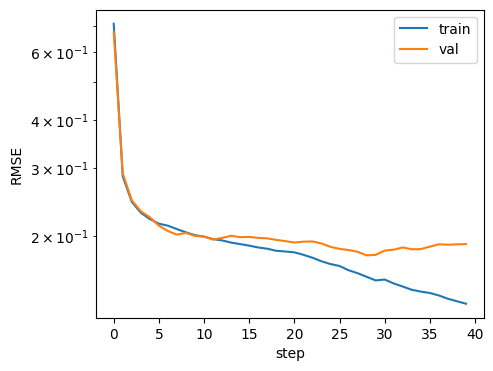

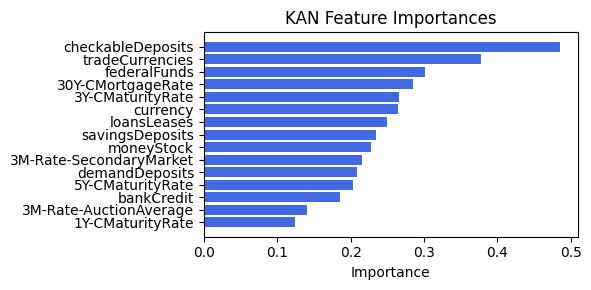

Computing Grad-CAM: 100%|██████████| 210/210 [00:28<00:00,  7.33it/s]


[('3M-Rate-SecondaryMarket', 0.1499621105857105), ('currency', 0.10123545491535749), ('Ex1', 0.050369201001844235), ('checkableDeposits', 0.04535574446920128), ('loansLeases', 0.011695073598197528), ('savingsDeposits', 0.005957516034444174), ('tradeCurrencies', 0.005936139822006225), ('1Y-CMaturityRate', 0.0023233307813782067), ('30Y-CMortgageRate', 5.0737427504611246e-05), ('3M-Rate-AuctionAverage', 2.5615856672326723e-05), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0)]


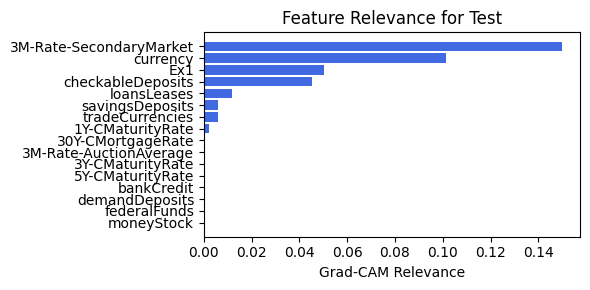

In [76]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=40, hidden_dim=4, filename=filename_3, opt_col_val=4)

### 3.1.13 width=[15, 6, 1], grid=5, lamb=1e-05 | hidden_dim=2

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.12e-01 | eval_loss: 2.15e-01 | reg: 1.29e+02 |: 100%|█| 40/40 [00:40<00:00,  1.01s/i

saving model version 0.1
Best epoch 13
0.26016995310783386
M_KAN Relevance: 0.005377583671361208
CNN Relevance: 0.9946224093437195
[('checkableDeposits', 0.4530917), ('tradeCurrencies', 0.37709397), ('loansLeases', 0.32790875), ('moneyStock', 0.3099413), ('currency', 0.30740005), ('3Y-CMaturityRate', 0.29153264), ('savingsDeposits', 0.27373892), ('30Y-CMortgageRate', 0.25365448), ('bankCredit', 0.23452532), ('federalFunds', 0.23044622), ('3M-Rate-SecondaryMarket', 0.21044105), ('demandDeposits', 0.20071614), ('5Y-CMaturityRate', 0.19682986), ('3M-Rate-AuctionAverage', 0.15424094), ('1Y-CMaturityRate', 0.12150466)]


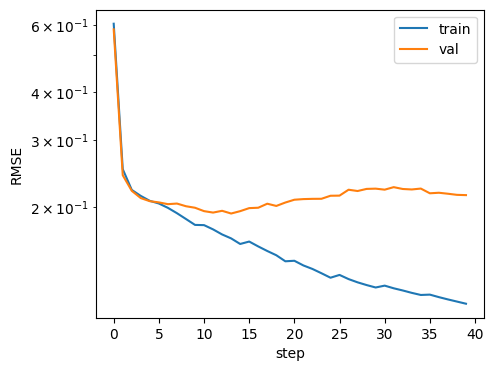

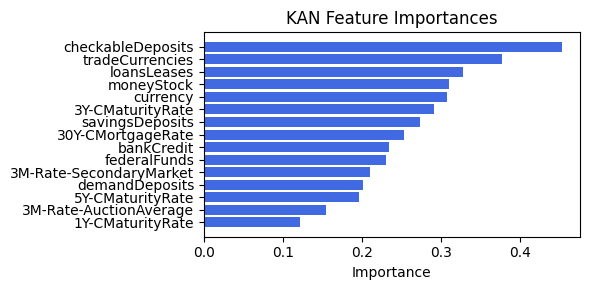

Computing Grad-CAM: 100%|██████████| 210/210 [00:27<00:00,  7.59it/s]


[('loansLeases', 0.06611011236728657), ('savingsDeposits', 0.011823308843720173), ('Ex1', 0.0053778233982267835), ('checkableDeposits', 0.005207041615531558), ('tradeCurrencies', 0.005007403805142357), ('moneyStock', 0.002567589282989502), ('1Y-CMaturityRate', 0.0023621779156937487), ('federalFunds', 0.002320189703078497), ('3M-Rate-SecondaryMarket', 0.0013167162736256917), ('demandDeposits', 0.0011201887613251096), ('30Y-CMortgageRate', 0.00031556632990638415), ('3Y-CMaturityRate', 0.0002929401184831347), ('3M-Rate-AuctionAverage', 0.00022511805984235946), ('5Y-CMaturityRate', 0.00011014711510922227), ('currency', 9.174346480341184e-05), ('bankCredit', 6.290607686553683e-05)]


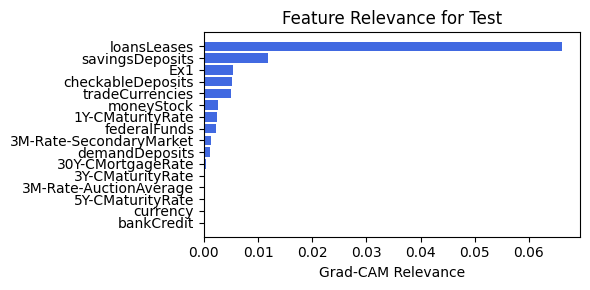

In [77]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=40, hidden_dim=2, filename=filename_3, opt_col_val=2)

### 3.1.14 width=[15, 6, 1], grid=5, lamb=1e-05 | hidden_dim=2

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.23e-01 | eval_loss: 2.01e-01 | reg: 1.25e+02 |: 100%|█| 40/40 [00:40<00:00,  1.02s/i

saving model version 0.1
Best epoch 29
0.2697797119617462
M_KAN Relevance: 0.006850631441920996
CNN Relevance: 0.9931493997573853
[('checkableDeposits', 0.44527933), ('tradeCurrencies', 0.38497418), ('loansLeases', 0.32539284), ('moneyStock', 0.32263237), ('currency', 0.2835265), ('3Y-CMaturityRate', 0.2824554), ('30Y-CMortgageRate', 0.2746875), ('savingsDeposits', 0.2722123), ('federalFunds', 0.2526897), ('bankCredit', 0.2363728), ('3M-Rate-SecondaryMarket', 0.218341), ('demandDeposits', 0.20285349), ('5Y-CMaturityRate', 0.16267541), ('1Y-CMaturityRate', 0.145758), ('3M-Rate-AuctionAverage', 0.14244476)]


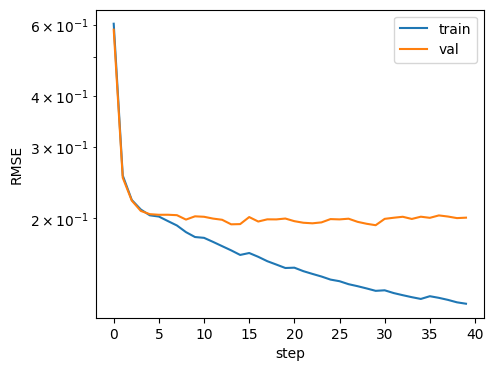

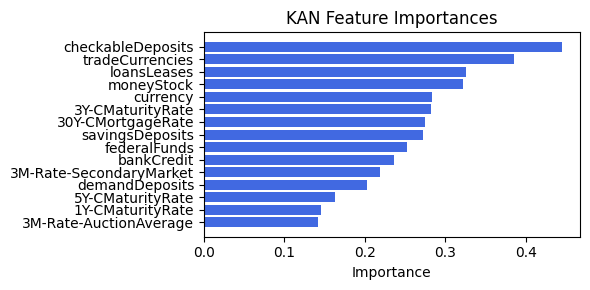

Computing Grad-CAM: 100%|██████████| 210/210 [00:28<00:00,  7.43it/s]


[('loansLeases', 0.21370978673166108), ('tradeCurrencies', 0.21343896360180917), ('savingsDeposits', 0.13674643756600008), ('3Y-CMaturityRate', 0.09185542941448234), ('demandDeposits', 0.05595797413871402), ('1Y-CMaturityRate', 0.0315030714485883), ('checkableDeposits', 0.030420661114511034), ('5Y-CMaturityRate', 0.02734023658454784), ('Ex1', 0.02720148820607435), ('federalFunds', 0.022802696779919123), ('bankCredit', 0.02156767095550008), ('currency', 0.01414144760929048), ('moneyStock', 0.012046842658725966), ('3M-Rate-SecondaryMarket', 0.005690911293051959), ('30Y-CMortgageRate', 0.004062714381697809), ('3M-Rate-AuctionAverage', 0.003557913782562883)]


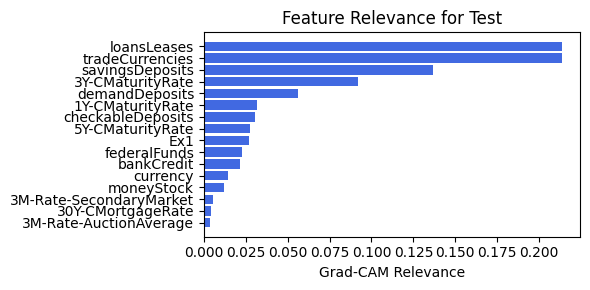

In [78]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=40, hidden_dim=2, filename=filename_3, opt_col_val=2)

## 3.2 width=[15, 1, 1], grid=5, lamb=1e-05

### 3.2.0 width=[15, 1, 1], grid=5, lamb=1e-05 | hidden_dim=128

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.62e-01 | eval_loss: 2.06e-01 | reg: 4.85e+01 |: 100%|█| 60/60 [01:02<00:00,  1.05s/i

saving model version 0.1
Best epoch 20
0.24259500205516815
M_KAN Relevance: 2.5653866032371297e-05
CNN Relevance: 0.9999743103981018
[('currency', 0.32657334), ('loansLeases', 0.3132033), ('bankCredit', 0.28673095), ('5Y-CMaturityRate', 0.27840266), ('tradeCurrencies', 0.22075035), ('3M-Rate-AuctionAverage', 0.2179938), ('savingsDeposits', 0.205633), ('1Y-CMaturityRate', 0.1797483), ('checkableDeposits', 0.17110232), ('moneyStock', 0.102357924), ('3M-Rate-SecondaryMarket', 0.09001468), ('demandDeposits', 0.086688325), ('federalFunds', 0.07118951), ('3Y-CMaturityRate', 0.05699919), ('30Y-CMortgageRate', 0.04234529)]


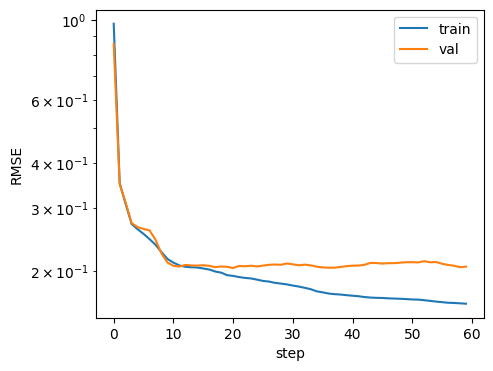

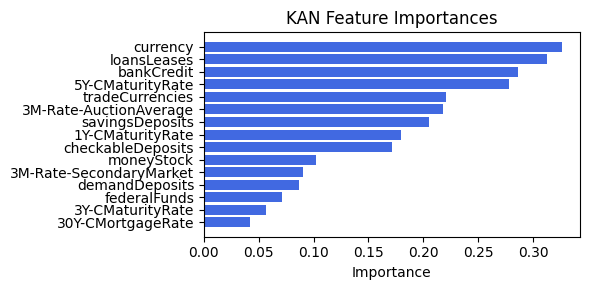

Computing Grad-CAM: 100%|██████████| 210/210 [00:16<00:00, 12.87it/s]


[('loansLeases', 0.15568182407656594), ('checkableDeposits', 0.041271927297791645), ('demandDeposits', 0.0041276745852969945), ('3Y-CMaturityRate', 0.00268047856433051), ('tradeCurrencies', 0.0018794327264740353), ('savingsDeposits', 0.0016554746244634901), ('3M-Rate-SecondaryMarket', 0.001144996631358351), ('30Y-CMortgageRate', 0.0009678292753440993), ('3M-Rate-AuctionAverage', 0.0008244780468798819), ('1Y-CMaturityRate', 0.00048295493415069014), ('currency', 0.00015520052041947133), ('bankCredit', 0.00014968673210768473), ('5Y-CMaturityRate', 0.00010838070773475228), ('Ex1', 6.363215811905407e-05), ('federalFunds', 0.0), ('moneyStock', 0.0)]


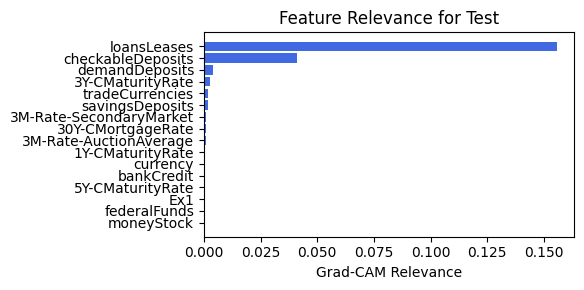

In [189]:
train_and_plot_relevance(Model3_3, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=60, hidden_dim=128, filename=filename_3, opt_col_val=128)

### 3.2.1 width=[15, 1, 1], grid=5, lamb=1e-05 | hidden_dim=128

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.63e-01 | eval_loss: 2.11e-01 | reg: 4.74e+01 |: 100%|█| 60/60 [01:03<00:00,  1.07s/i

saving model version 0.1
Best epoch 35
0.23427197337150574
M_KAN Relevance: 2.277077510370873e-05
CNN Relevance: 0.9999772310256958
[('currency', 0.3250513), ('loansLeases', 0.3124892), ('bankCredit', 0.2851293), ('5Y-CMaturityRate', 0.27627215), ('tradeCurrencies', 0.22029854), ('3M-Rate-AuctionAverage', 0.21539626), ('savingsDeposits', 0.20375252), ('1Y-CMaturityRate', 0.17946722), ('checkableDeposits', 0.16905321), ('moneyStock', 0.10109985), ('3M-Rate-SecondaryMarket', 0.08890958), ('demandDeposits', 0.08527033), ('federalFunds', 0.069084205), ('3Y-CMaturityRate', 0.056667265), ('30Y-CMortgageRate', 0.043242436)]


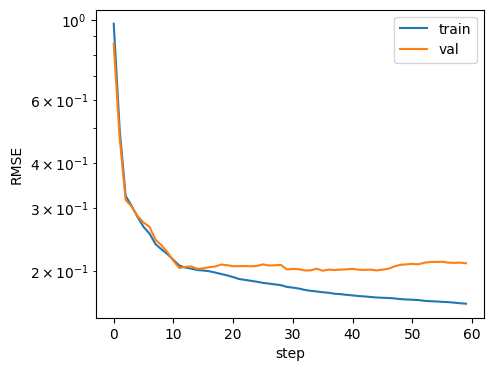

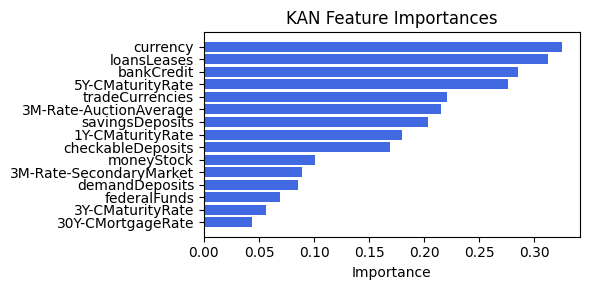

Computing Grad-CAM: 100%|██████████| 210/210 [00:16<00:00, 12.40it/s]


[('loansLeases', 0.10215787110584122), ('checkableDeposits', 0.07835633749408381), ('3M-Rate-SecondaryMarket', 0.047245073360612705), ('tradeCurrencies', 0.007729747294381793), ('savingsDeposits', 0.007639383826227415), ('Ex1', 0.0019275526266678104), ('30Y-CMortgageRate', 0.00019484351256064005), ('3M-Rate-AuctionAverage', 2.5682630283491952e-05), ('5Y-CMaturityRate', 1.6478501215931915e-05), ('bankCredit', 1.0759718272657621e-05), ('currency', 6.158294646801161e-06), ('1Y-CMaturityRate', 0.0), ('3Y-CMaturityRate', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0)]


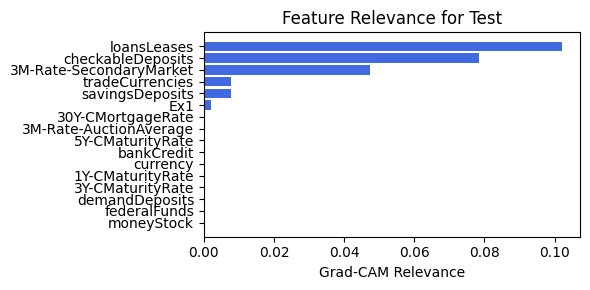

In [190]:
train_and_plot_relevance(Model3_3, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=60, hidden_dim=128, filename=filename_3, opt_col_val=128)

### 3.2.2 width=[15, 1, 1], grid=5, lamb=1e-05 | hidden_dim=64

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.85e-01 | eval_loss: 2.09e-01 | reg: 4.85e+01 |: 100%|█| 60/60 [01:04<00:00,  1.07s/i

saving model version 0.1
Best epoch 47
0.25251293182373047
M_KAN Relevance: 0.0002499739348422736
CNN Relevance: 0.9997500777244568
[('currency', 0.2801652), ('loansLeases', 0.27616233), ('bankCredit', 0.24951577), ('5Y-CMaturityRate', 0.21709278), ('tradeCurrencies', 0.19315104), ('savingsDeposits', 0.17897363), ('3M-Rate-AuctionAverage', 0.16756481), ('1Y-CMaturityRate', 0.1531757), ('checkableDeposits', 0.12028462), ('moneyStock', 0.096810564), ('3M-Rate-SecondaryMarket', 0.08692419), ('demandDeposits', 0.08011979), ('3Y-CMaturityRate', 0.05868506), ('30Y-CMortgageRate', 0.04812215), ('federalFunds', 0.04247009)]


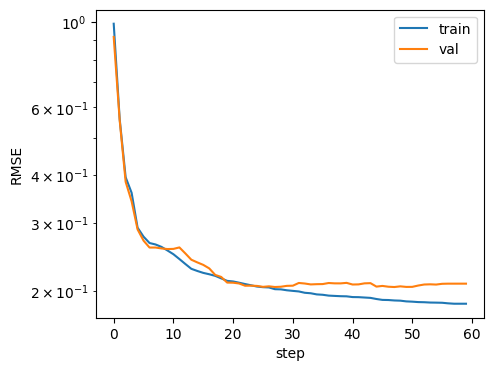

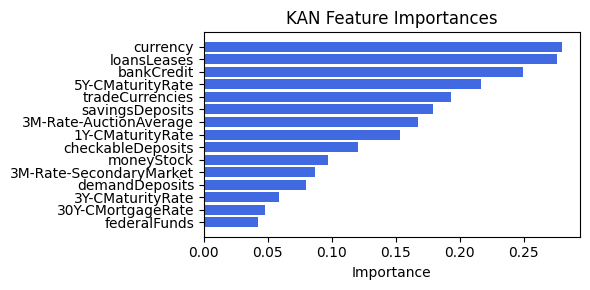

Computing Grad-CAM: 100%|██████████| 210/210 [00:16<00:00, 12.73it/s]


[('3M-Rate-SecondaryMarket', 0.29632373114803895), ('loansLeases', 0.07124661009182177), ('checkableDeposits', 0.022335719778424218), ('currency', 0.008488936655755555), ('savingsDeposits', 0.004549287079966494), ('1Y-CMaturityRate', 0.00282666285832723), ('30Y-CMortgageRate', 0.0027086370048068817), ('3M-Rate-AuctionAverage', 0.002574221355219682), ('demandDeposits', 0.00026511061227037794), ('5Y-CMaturityRate', 0.00014746616638842082), ('Ex1', 7.057577992479007e-05), ('bankCredit', 6.96195156446525e-05), ('3Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0)]


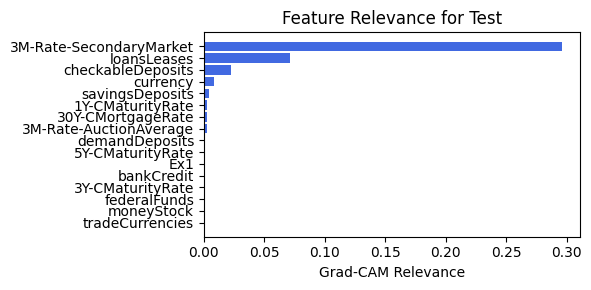

In [191]:
train_and_plot_relevance(Model3_3, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=60, hidden_dim=64, filename=filename_3, opt_col_val=64)

### 3.2.3 width=[15, 1, 1], grid=5, lamb=1e-05 | hidden_dim=64

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.83e-01 | eval_loss: 2.04e-01 | reg: 4.97e+01 |: 100%|█| 60/60 [01:03<00:00,  1.06s/i

saving model version 0.1
Best epoch 55
0.23342637717723846
M_KAN Relevance: 0.0002742882934398949
CNN Relevance: 0.9997256398200989
[('currency', 0.27316839), ('loansLeases', 0.27207524), ('bankCredit', 0.24283865), ('5Y-CMaturityRate', 0.20772809), ('tradeCurrencies', 0.18997853), ('savingsDeposits', 0.17399476), ('3M-Rate-AuctionAverage', 0.16070737), ('1Y-CMaturityRate', 0.14705828), ('checkableDeposits', 0.111443706), ('moneyStock', 0.096420884), ('3M-Rate-SecondaryMarket', 0.087275304), ('demandDeposits', 0.07821868), ('3Y-CMaturityRate', 0.060489256), ('30Y-CMortgageRate', 0.050623897), ('federalFunds', 0.037492614)]


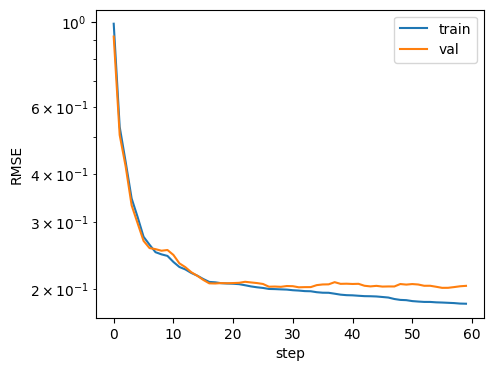

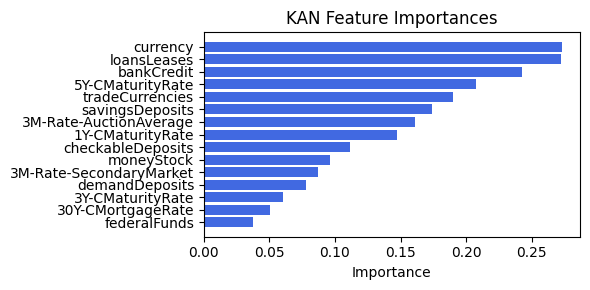

Computing Grad-CAM: 100%|██████████| 210/210 [00:15<00:00, 13.31it/s]


[('loansLeases', 0.5128532562396556), ('3M-Rate-SecondaryMarket', 0.3389422949580919), ('savingsDeposits', 0.053840964823515), ('demandDeposits', 0.03864249509892293), ('tradeCurrencies', 0.02372486481340491), ('Ex1', 0.003489111077630826), ('1Y-CMaturityRate', 0.0010932311850843862), ('currency', 0.0007732743506840918), ('3Y-CMaturityRate', 1.5523750334978104e-05), ('30Y-CMortgageRate', 1.2724179153641065e-05), ('5Y-CMaturityRate', 1.1680326757154295e-05), ('3M-Rate-AuctionAverage', 0.0), ('bankCredit', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0)]


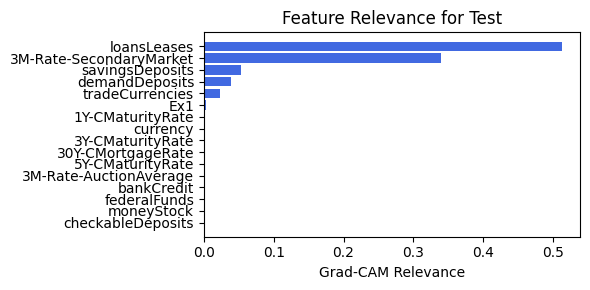

In [192]:
train_and_plot_relevance(Model3_3, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=60, hidden_dim=64, filename=filename_3, opt_col_val=64)

### 3.2.4 width=[15, 1, 1], grid=5, lamb=1e-05 | hidden_dim=32

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.45e-01 | eval_loss: 2.06e-01 | reg: 4.74e+01 |: 100%|█| 60/60 [01:02<00:00,  1.05s/i

saving model version 0.1
Best epoch 34
0.2357470840215683
M_KAN Relevance: 3.551298868842423e-05
CNN Relevance: 0.9999644756317139
[('currency', 0.30889803), ('loansLeases', 0.29865015), ('bankCredit', 0.2757836), ('5Y-CMaturityRate', 0.254023), ('tradeCurrencies', 0.21189834), ('3M-Rate-AuctionAverage', 0.19647437), ('savingsDeposits', 0.19274162), ('1Y-CMaturityRate', 0.17175132), ('checkableDeposits', 0.15546608), ('moneyStock', 0.100022845), ('3M-Rate-SecondaryMarket', 0.08533611), ('demandDeposits', 0.080859244), ('federalFunds', 0.061751448), ('3Y-CMaturityRate', 0.0571066), ('30Y-CMortgageRate', 0.050337456)]


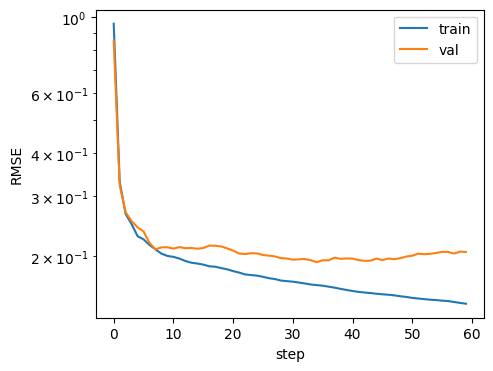

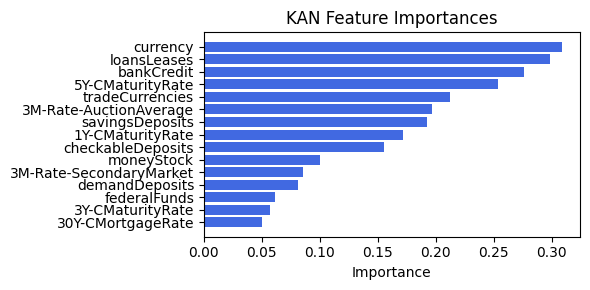

Computing Grad-CAM: 100%|██████████| 210/210 [00:16<00:00, 12.69it/s]


[('loansLeases', 0.3533378538209945), ('savingsDeposits', 0.2062639213715946), ('tradeCurrencies', 0.12620944684548746), ('Ex1', 0.06284321819853392), ('3M-Rate-SecondaryMarket', 0.057855703965539025), ('currency', 0.03249308706394264), ('checkableDeposits', 0.02454729171669377), ('1Y-CMaturityRate', 0.0042324743810154145), ('30Y-CMortgageRate', 0.0035491889963547387), ('3M-Rate-AuctionAverage', 0.003093340101518801), ('demandDeposits', 0.002897093751068626), ('3Y-CMaturityRate', 0.0014862113765307834), ('5Y-CMaturityRate', 0.0006188278831402949), ('bankCredit', 0.00040178770487684577), ('federalFunds', 0.0), ('moneyStock', 0.0)]


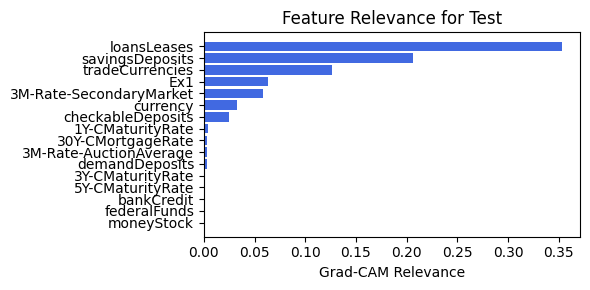

In [193]:
train_and_plot_relevance(Model3_3, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=60, hidden_dim=32, filename=filename_3, opt_col_val=32)

### 3.2.5 width=[15, 1, 1], grid=5, lamb=1e-05 | hidden_dim=32

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.48e-01 | eval_loss: 2.24e-01 | reg: 4.81e+01 |: 100%|█| 60/60 [01:02<00:00,  1.04s/i

saving model version 0.1
Best epoch 20
0.24052794277668
M_KAN Relevance: 9.45079664234072e-05
CNN Relevance: 0.999905526638031
[('currency', 0.3077669), ('loansLeases', 0.29575354), ('bankCredit', 0.27577904), ('5Y-CMaturityRate', 0.253047), ('tradeCurrencies', 0.21089597), ('3M-Rate-AuctionAverage', 0.19801632), ('savingsDeposits', 0.1928089), ('1Y-CMaturityRate', 0.17129244), ('checkableDeposits', 0.15663789), ('moneyStock', 0.1024171), ('3M-Rate-SecondaryMarket', 0.088026986), ('demandDeposits', 0.08335419), ('federalFunds', 0.065137886), ('3Y-CMaturityRate', 0.05799225), ('30Y-CMortgageRate', 0.049959783)]


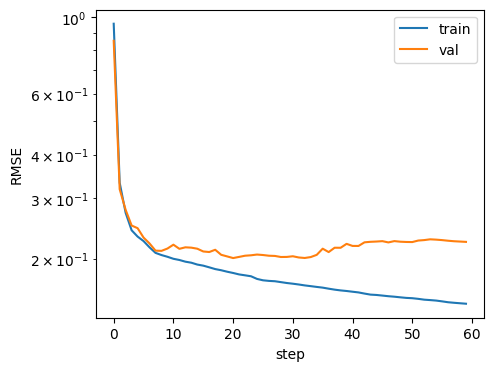

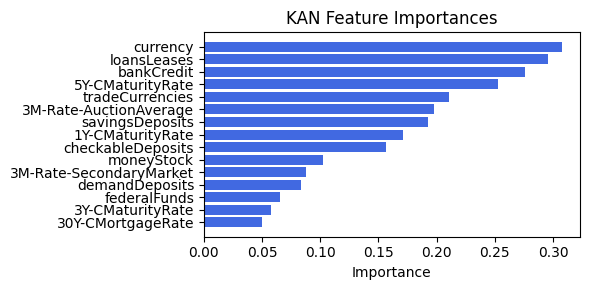

Computing Grad-CAM: 100%|██████████| 210/210 [00:16<00:00, 13.01it/s]


[('loansLeases', 0.4737248210280779), ('savingsDeposits', 0.11966585039294192), ('demandDeposits', 0.04531046277399929), ('tradeCurrencies', 0.041510403189542036), ('3M-Rate-SecondaryMarket', 0.039112919107789086), ('1Y-CMaturityRate', 0.03651187344055091), ('3Y-CMaturityRate', 0.030402249268566568), ('30Y-CMortgageRate', 0.015675462839204728), ('3M-Rate-AuctionAverage', 0.015324545799133678), ('currency', 0.0030245142589722363), ('bankCredit', 0.0009111363352054642), ('5Y-CMaturityRate', 0.0006759056998860268), ('Ex1', 0.0003112495533146319), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0)]


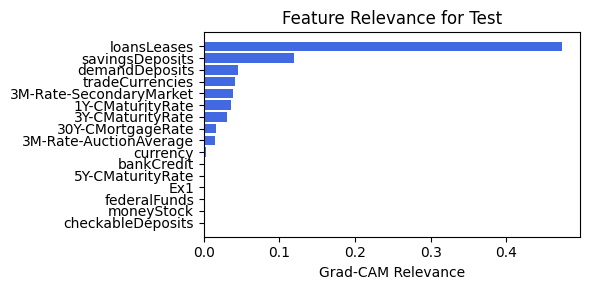

In [194]:
train_and_plot_relevance(Model3_3, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=60, hidden_dim=32, filename=filename_3, opt_col_val=32)

### 3.2.6 width=[15, 1, 1], grid=5, lamb=1e-05 | hidden_dim=16

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.49e-01 | eval_loss: 2.10e-01 | reg: 5.20e+01 |: 100%|█| 60/60 [01:03<00:00,  1.05s/i

saving model version 0.1
Best epoch 34
0.23211006820201874
M_KAN Relevance: 0.000599425460677594
CNN Relevance: 0.9994006156921387
[('currency', 0.32774135), ('loansLeases', 0.31741047), ('bankCredit', 0.28973114), ('5Y-CMaturityRate', 0.2795579), ('tradeCurrencies', 0.22219722), ('3M-Rate-AuctionAverage', 0.21532042), ('savingsDeposits', 0.20388187), ('1Y-CMaturityRate', 0.17821383), ('checkableDeposits', 0.1701671), ('moneyStock', 0.099220455), ('3M-Rate-SecondaryMarket', 0.08830788), ('demandDeposits', 0.08240578), ('federalFunds', 0.06588819), ('3Y-CMaturityRate', 0.05535141), ('30Y-CMortgageRate', 0.042413224)]


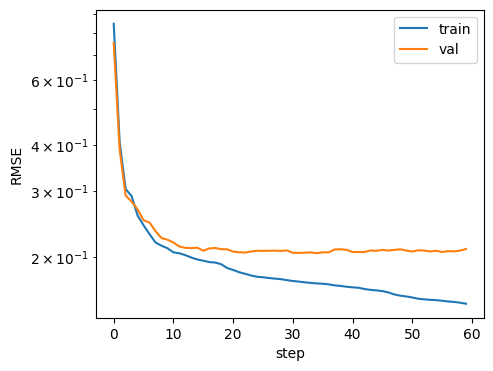

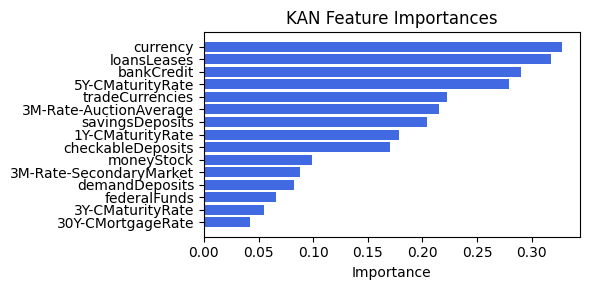

Computing Grad-CAM: 100%|██████████| 210/210 [00:17<00:00, 12.35it/s]


[('checkableDeposits', 0.08732742998926413), ('3M-Rate-SecondaryMarket', 0.0836771917839845), ('loansLeases', 0.020833333333333332), ('tradeCurrencies', 0.001359331980901992), ('1Y-CMaturityRate', 0.00023016207629726046), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('savingsDeposits', 0.0), ('Ex1', 0.0)]


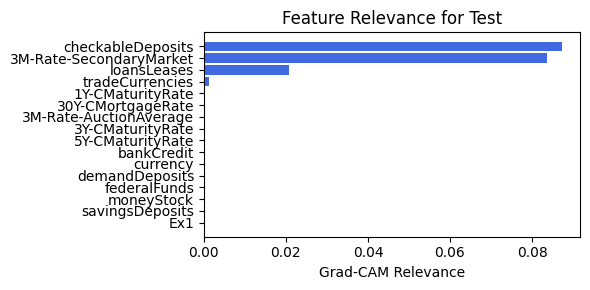

In [195]:
train_and_plot_relevance(Model3_3, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=60, hidden_dim=16, filename=filename_3, opt_col_val=16)

### 3.2.7 width=[15, 1, 1], grid=5, lamb=1e-05 | hidden_dim=16

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.49e-01 | eval_loss: 2.10e-01 | reg: 5.20e+01 |: 100%|█| 60/60 [01:03<00:00,  1.06s/i

saving model version 0.1
Best epoch 34
0.23211006820201874
M_KAN Relevance: 0.000599425460677594
CNN Relevance: 0.9994006156921387
[('currency', 0.32774135), ('loansLeases', 0.31741047), ('bankCredit', 0.28973114), ('5Y-CMaturityRate', 0.2795579), ('tradeCurrencies', 0.22219722), ('3M-Rate-AuctionAverage', 0.21532042), ('savingsDeposits', 0.20388187), ('1Y-CMaturityRate', 0.17821383), ('checkableDeposits', 0.1701671), ('moneyStock', 0.099220455), ('3M-Rate-SecondaryMarket', 0.08830788), ('demandDeposits', 0.08240578), ('federalFunds', 0.06588819), ('3Y-CMaturityRate', 0.05535141), ('30Y-CMortgageRate', 0.042413224)]


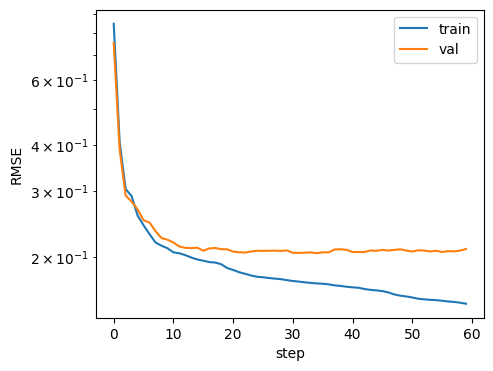

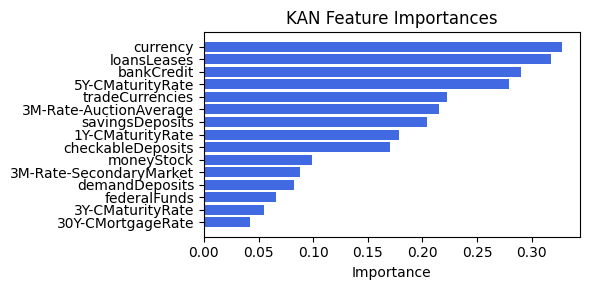

Computing Grad-CAM: 100%|██████████| 210/210 [00:16<00:00, 12.39it/s]


[('checkableDeposits', 0.08732742998926413), ('3M-Rate-SecondaryMarket', 0.0836771917839845), ('loansLeases', 0.020833333333333332), ('tradeCurrencies', 0.001359331980901992), ('1Y-CMaturityRate', 0.00023016207629726046), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('savingsDeposits', 0.0), ('Ex1', 0.0)]


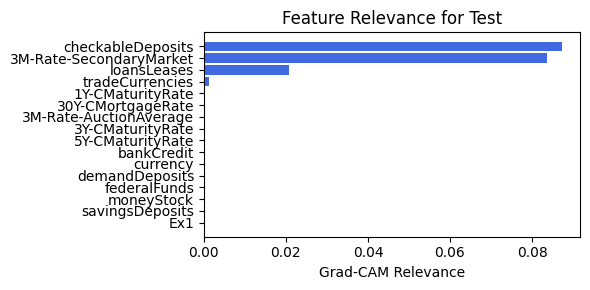

In [196]:
train_and_plot_relevance(Model3_3, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=60, hidden_dim=16, filename=filename_3, opt_col_val=16)

### 3.2.8 width=[15, 1, 1], grid=5, lamb=1e-05 | hidden_dim=8

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.54e-01 | eval_loss: 1.95e-01 | reg: 5.08e+01 |: 100%|█| 60/60 [01:02<00:00,  1.03s/i

saving model version 0.1
Best epoch 58
0.24119111895561218
M_KAN Relevance: 0.000346043350873515
CNN Relevance: 0.9996539950370789
[('loansLeases', 0.30836353), ('currency', 0.3073894), ('bankCredit', 0.25546795), ('5Y-CMaturityRate', 0.23736775), ('tradeCurrencies', 0.21434496), ('3M-Rate-AuctionAverage', 0.18427859), ('savingsDeposits', 0.17807856), ('1Y-CMaturityRate', 0.17117211), ('checkableDeposits', 0.12772433), ('moneyStock', 0.0948854), ('3M-Rate-SecondaryMarket', 0.07732606), ('30Y-CMortgageRate', 0.073793486), ('federalFunds', 0.0727539), ('3Y-CMaturityRate', 0.058143876), ('demandDeposits', 0.056725677)]


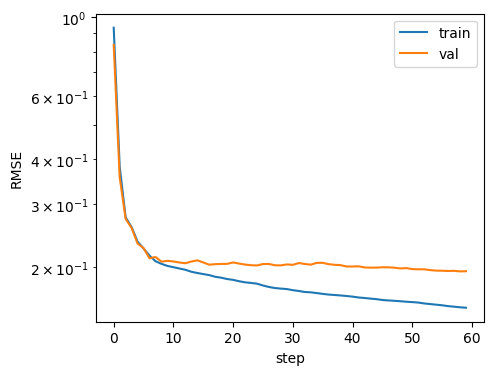

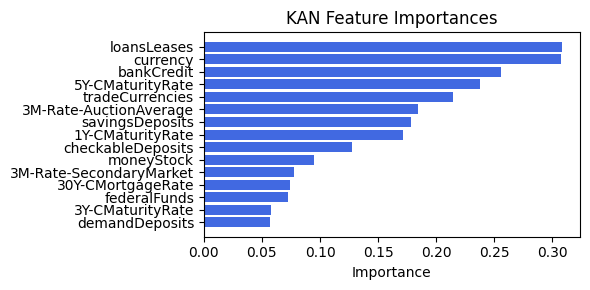

Computing Grad-CAM: 100%|██████████| 210/210 [00:16<00:00, 13.04it/s]


[('3M-Rate-SecondaryMarket', 0.5386111070002828), ('checkableDeposits', 0.45407375015229695), ('currency', 0.17095321049619955), ('loansLeases', 0.1144227602652141), ('savingsDeposits', 0.04055025385723205), ('demandDeposits', 0.007628531842159905), ('30Y-CMortgageRate', 0.002573245945608332), ('3M-Rate-AuctionAverage', 0.0024878795691100613), ('1Y-CMaturityRate', 0.0017370179295539856), ('bankCredit', 0.000156334787607193), ('5Y-CMaturityRate', 8.881079376719538e-05), ('federalFunds', 2.3941402988774437e-05), ('Ex1', 9.866652405998183e-07), ('3Y-CMaturityRate', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0)]


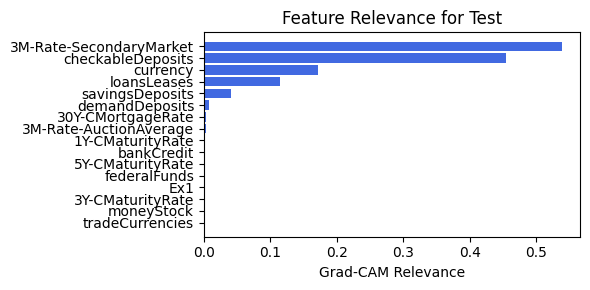

In [197]:
train_and_plot_relevance(Model3_3, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=60, hidden_dim=8, filename=filename_3, opt_col_val=8)

### 3.2.9 width=[15, 1, 1], grid=5, lamb=1e-05 | hidden_dim=8

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.49e-01 | eval_loss: 1.97e-01 | reg: 4.72e+01 |: 100%|█| 60/60 [01:01<00:00,  1.03s/i

saving model version 0.1
Best epoch 49
0.2408369481563568
M_KAN Relevance: 0.00021343353728298098
CNN Relevance: 0.9997864961624146
[('currency', 0.30955926), ('loansLeases', 0.3063381), ('bankCredit', 0.26508415), ('5Y-CMaturityRate', 0.24804917), ('tradeCurrencies', 0.21912156), ('3M-Rate-AuctionAverage', 0.19160685), ('savingsDeposits', 0.1851501), ('1Y-CMaturityRate', 0.16873631), ('checkableDeposits', 0.14356731), ('moneyStock', 0.09534111), ('3M-Rate-SecondaryMarket', 0.08241724), ('federalFunds', 0.06838314), ('demandDeposits', 0.067386), ('30Y-CMortgageRate', 0.06632891), ('3Y-CMaturityRate', 0.05774283)]


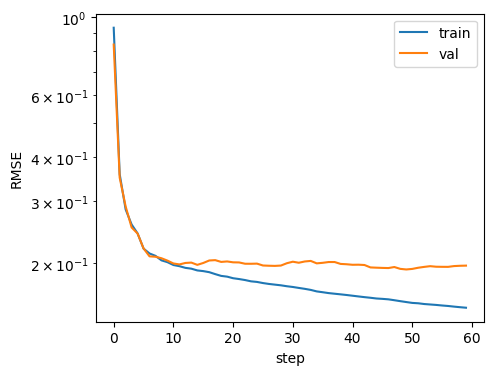

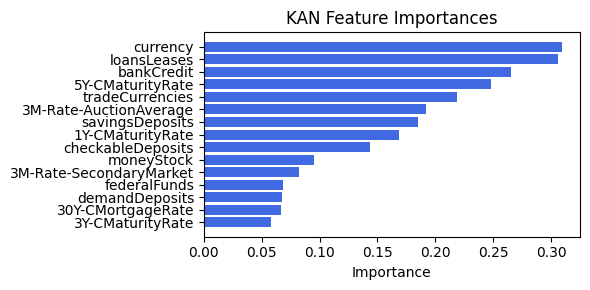

Computing Grad-CAM: 100%|██████████| 210/210 [00:16<00:00, 12.73it/s]

[('3M-Rate-SecondaryMarket', 0.6500792297578993), ('checkableDeposits', 0.6417306448022525), ('currency', 0.3469236131402708), ('loansLeases', 0.07898120793092642), ('savingsDeposits', 0.032159377894450225), ('1Y-CMaturityRate', 0.023885918803335654), ('3M-Rate-AuctionAverage', 0.021310701802195537), ('30Y-CMortgageRate', 0.019810048512937058), ('5Y-CMaturityRate', 0.014414010764587494), ('Ex1', 0.013255147084349855), ('bankCredit', 0.013101701584777662), ('demandDeposits', 0.005135724010566871), ('3Y-CMaturityRate', 0.0001376199536025524), ('federalFunds', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0)]


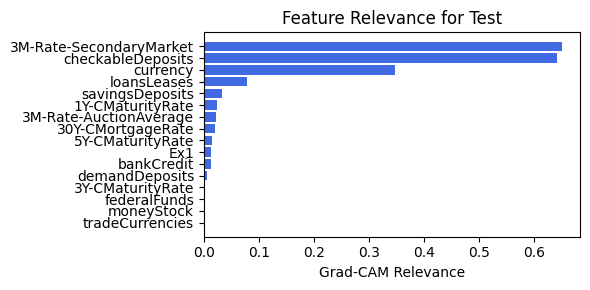

In [198]:
train_and_plot_relevance(Model3_3, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=60, hidden_dim=8, filename=filename_3, opt_col_val=8)

## 3.3 width=[15, 6, 1], grid=7, lamb=1e-05

### 3.3.0 width=[15, 6, 1], grid=7, lamb=1e-05 | hidden_dim=128

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.49e-01 | eval_loss: 1.96e-01 | reg: 5.17e+01 |: 100%|█| 60/60 [01:13<00:00,  1.22s/i


saving model version 0.1
Best epoch 22
0.2466985136270523
M_KAN Relevance: 0.0023490318562835455
CNN Relevance: 0.9976509809494019
[('checkableDeposits', 0.54995203), ('federalFunds', 0.537034), ('30Y-CMortgageRate', 0.41254804), ('3M-Rate-AuctionAverage', 0.4021643), ('bankCredit', 0.35968134), ('3M-Rate-SecondaryMarket', 0.33247858), ('1Y-CMaturityRate', 0.31434122), ('tradeCurrencies', 0.29399917), ('currency', 0.2919825), ('moneyStock', 0.27061272), ('3Y-CMaturityRate', 0.26391536), ('5Y-CMaturityRate', 0.26072443), ('loansLeases', 0.2362467), ('demandDeposits', 0.22432137), ('savingsDeposits', 0.20553224)]


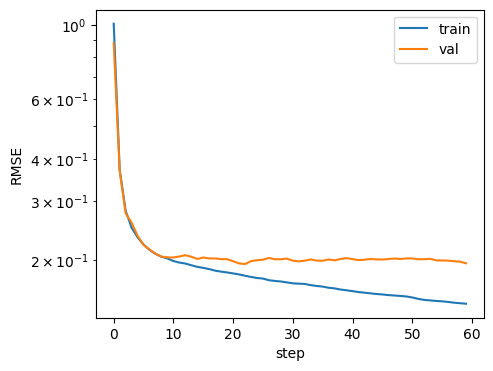

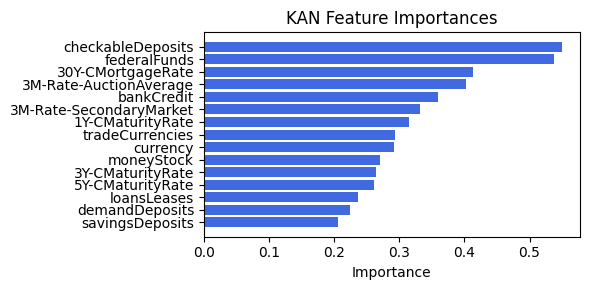

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.31it/s]

[('3M-Rate-SecondaryMarket', 0.1434634069867787), ('checkableDeposits', 0.0396676344530923), ('currency', 0.03620628257769914), ('loansLeases', 0.023867784794752617), ('1Y-CMaturityRate', 0.010413484568042414), ('3M-Rate-AuctionAverage', 0.008548564273154452), ('30Y-CMortgageRate', 0.008199399971358833), ('bankCredit', 0.0013650971980366325), ('demandDeposits', 0.0012049322770464987), ('savingsDeposits', 0.0009873696844026978), ('5Y-CMaturityRate', 0.0007309273949691228), ('3Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


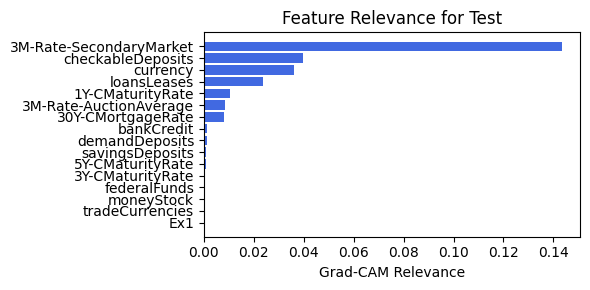

In [199]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=7, lamb=1e-05, steps=60, hidden_dim=128, filename=filename_3, opt_col_val=128)

### 3.3.1 width=[15, 6, 1], grid=7, lamb=1e-05 | hidden_dim=128

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.52e-01 | eval_loss: 1.98e-01 | reg: 5.35e+01 |: 100%|█| 60/60 [01:13<00:00,  1.22s/i

saving model version 0.1
Best epoch 12
0.25189247727394104
M_KAN Relevance: 0.002799244364723563
CNN Relevance: 0.9972007870674133
[('checkableDeposits', 0.55412245), ('federalFunds', 0.5396678), ('30Y-CMortgageRate', 0.41248733), ('3M-Rate-AuctionAverage', 0.4038372), ('bankCredit', 0.36025426), ('3M-Rate-SecondaryMarket', 0.33408368), ('1Y-CMaturityRate', 0.31543788), ('tradeCurrencies', 0.2940804), ('currency', 0.29158968), ('moneyStock', 0.27190024), ('3Y-CMaturityRate', 0.26421094), ('5Y-CMaturityRate', 0.2610211), ('loansLeases', 0.23579511), ('demandDeposits', 0.22703038), ('savingsDeposits', 0.20543912)]


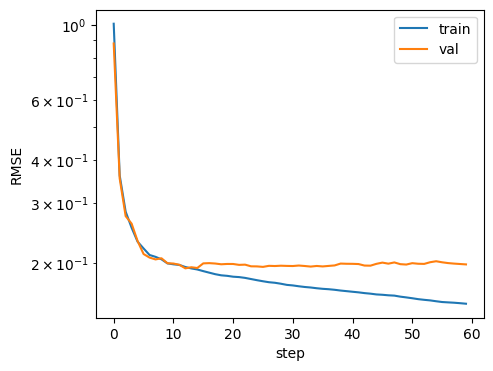

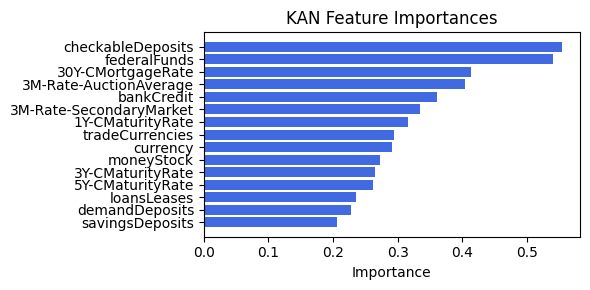

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.65it/s]


[('3M-Rate-SecondaryMarket', 0.3318349706807307), ('checkableDeposits', 0.06841038199407713), ('loansLeases', 0.012234203122733604), ('1Y-CMaturityRate', 0.003075716502609707), ('savingsDeposits', 0.000934204053954177), ('30Y-CMortgageRate', 0.00019753336839910065), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


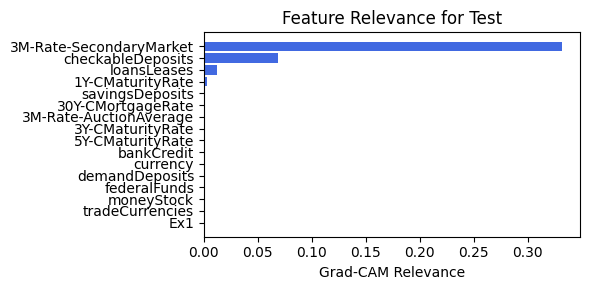

In [200]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=7, lamb=1e-05, steps=60, hidden_dim=128, filename=filename_3, opt_col_val=128)

### 3.3.2 width=[15, 6, 1], grid=7, lamb=1e-05 | hidden_dim=64

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.46e-01 | eval_loss: 2.04e-01 | reg: 5.19e+01 |: 100%|█| 60/60 [01:13<00:00,  1.22s/i


saving model version 0.1
Best epoch 10
0.2627926468849182
M_KAN Relevance: 0.0018195474985986948
CNN Relevance: 0.9981804490089417
[('checkableDeposits', 0.5686048), ('federalFunds', 0.5433108), ('3M-Rate-AuctionAverage', 0.41672224), ('30Y-CMortgageRate', 0.41561168), ('bankCredit', 0.37387198), ('3M-Rate-SecondaryMarket', 0.3375586), ('1Y-CMaturityRate', 0.33073872), ('currency', 0.30376685), ('tradeCurrencies', 0.30210957), ('moneyStock', 0.281474), ('5Y-CMaturityRate', 0.27259803), ('3Y-CMaturityRate', 0.2679975), ('loansLeases', 0.25623947), ('demandDeposits', 0.23223966), ('savingsDeposits', 0.20645043)]


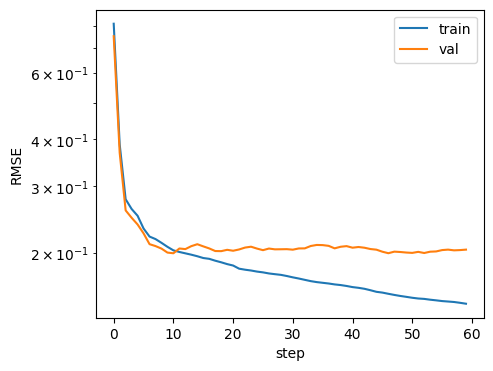

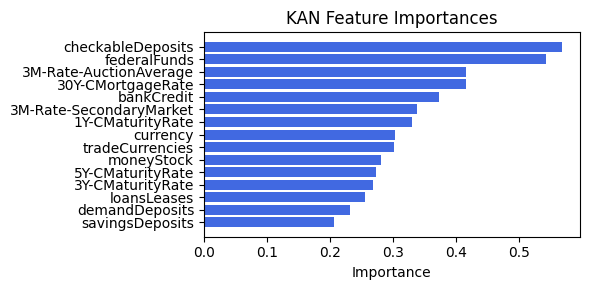

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.47it/s]

[('3M-Rate-SecondaryMarket', 0.14913936453494464), ('loansLeases', 0.09748250192857259), ('checkableDeposits', 0.03519112629195054), ('savingsDeposits', 0.01230148647813448), ('demandDeposits', 0.004228192754089833), ('1Y-CMaturityRate', 0.0013339797581595901), ('3M-Rate-AuctionAverage', 0.0004258881899572554), ('30Y-CMortgageRate', 0.0001552463730885869), ('bankCredit', 4.023410645978791e-05), ('currency', 3.3023273794069176e-06), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


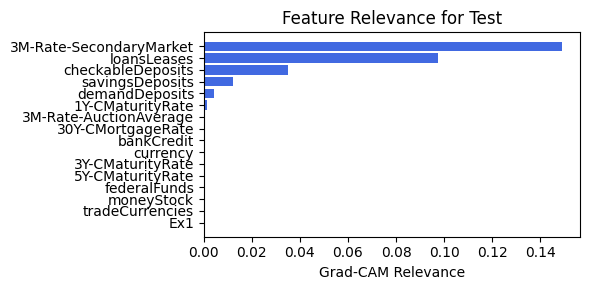

In [201]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=7, lamb=1e-05, steps=60, hidden_dim=64, filename=filename_3, opt_col_val=64)

### 3.3.3 width=[15, 6, 1], grid=7, lamb=1e-05 | hidden_dim=64

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.48e-01 | eval_loss: 2.03e-01 | reg: 5.21e+01 |: 100%|█| 60/60 [01:30<00:00,  1.50s/i


saving model version 0.1
Best epoch 52
0.2281675785779953
M_KAN Relevance: 0.0026473035104572773
CNN Relevance: 0.997352659702301
[('checkableDeposits', 0.5423896), ('federalFunds', 0.5282827), ('30Y-CMortgageRate', 0.42134473), ('3M-Rate-AuctionAverage', 0.40309918), ('bankCredit', 0.36051244), ('3M-Rate-SecondaryMarket', 0.32918614), ('1Y-CMaturityRate', 0.31212264), ('currency', 0.3001865), ('tradeCurrencies', 0.2957064), ('moneyStock', 0.27609622), ('5Y-CMaturityRate', 0.26585183), ('3Y-CMaturityRate', 0.2609371), ('loansLeases', 0.22388932), ('demandDeposits', 0.22080252), ('savingsDeposits', 0.19853847)]


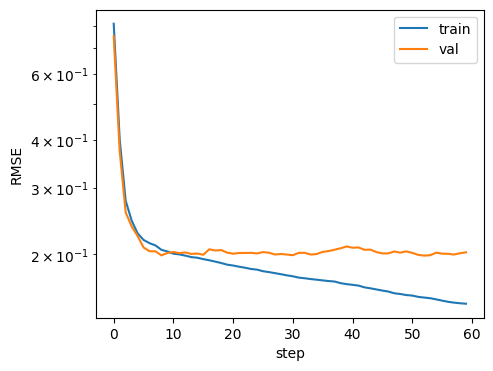

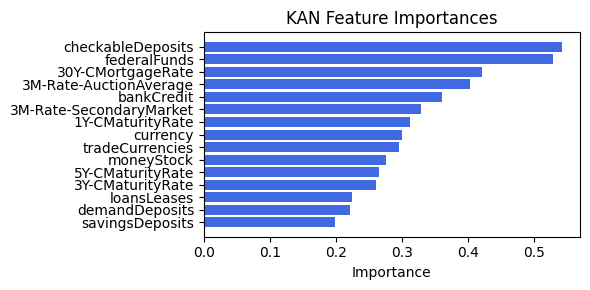

Computing Grad-CAM: 100%|██████████| 210/210 [02:05<00:00,  1.67it/s]


[('loansLeases', 0.17187809710878701), ('3M-Rate-SecondaryMarket', 0.029016438508898276), ('Ex1', 0.0025073513147531013), ('tradeCurrencies', 0.0021153480779113514), ('savingsDeposits', 0.0006922895765109432), ('1Y-CMaturityRate', 0.0001688325023722081), ('checkableDeposits', 4.21067788487389e-06), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0)]


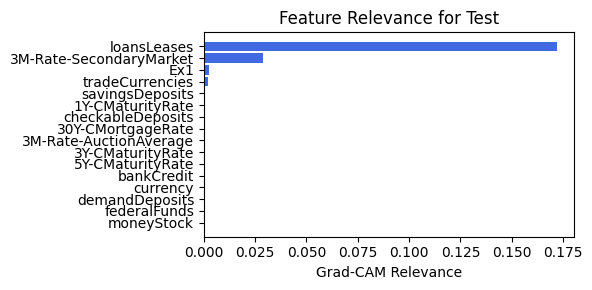

In [202]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=7, lamb=1e-05, steps=60, hidden_dim=64, filename=filename_3, opt_col_val=64)

### 3.3.4 width=[15, 6, 1], grid=7, lamb=1e-05 | hidden_dim=32

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.49e-01 | eval_loss: 2.09e-01 | reg: 5.17e+01 |: 100%|█| 60/60 [02:19<00:00,  2.32s/i


saving model version 0.1
Best epoch 21
0.2501407265663147
M_KAN Relevance: 0.0026071369647979736
CNN Relevance: 0.9973928332328796
[('checkableDeposits', 0.5589818), ('federalFunds', 0.5337972), ('30Y-CMortgageRate', 0.41402358), ('3M-Rate-AuctionAverage', 0.41077888), ('bankCredit', 0.36933154), ('3M-Rate-SecondaryMarket', 0.32826748), ('1Y-CMaturityRate', 0.31837994), ('currency', 0.2963726), ('tradeCurrencies', 0.2897233), ('moneyStock', 0.27810952), ('3Y-CMaturityRate', 0.26262844), ('5Y-CMaturityRate', 0.26187968), ('loansLeases', 0.24378161), ('demandDeposits', 0.22235188), ('savingsDeposits', 0.20403337)]


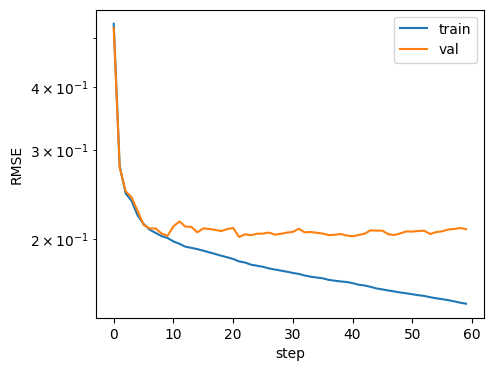

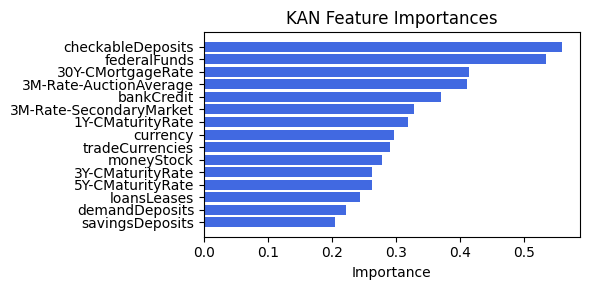

Computing Grad-CAM: 100%|██████████| 210/210 [02:04<00:00,  1.68it/s]


[('3M-Rate-SecondaryMarket', 0.09290941362934453), ('currency', 0.053383628456365496), ('loansLeases', 0.050251436439741934), ('checkableDeposits', 0.02728952719342141), ('3M-Rate-AuctionAverage', 0.014952266721853189), ('30Y-CMortgageRate', 0.014629087597131728), ('1Y-CMaturityRate', 0.012541865373523683), ('bankCredit', 0.004007828075970922), ('5Y-CMaturityRate', 0.00357864127893533), ('demandDeposits', 0.00028304345462293855), ('tradeCurrencies', 0.00023360137073766618), ('3Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('savingsDeposits', 0.0), ('Ex1', 0.0)]


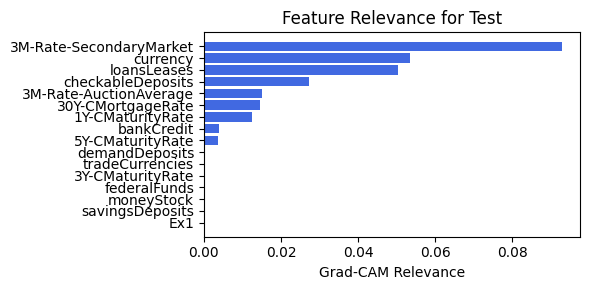

In [203]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=7, lamb=1e-05, steps=60, hidden_dim=32, filename=filename_3, opt_col_val=32)

### 3.3.5 width=[15, 6, 1], grid=7, lamb=1e-05 | hidden_dim=32

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.45e-01 | eval_loss: 2.00e-01 | reg: 5.25e+01 |: 100%|█| 60/60 [02:21<00:00,  2.35s/i


saving model version 0.1
Best epoch 48
0.2457113415002823
M_KAN Relevance: 0.003394149709492922
CNN Relevance: 0.9966058135032654
[('checkableDeposits', 0.51183915), ('federalFunds', 0.4975284), ('30Y-CMortgageRate', 0.4026254), ('3M-Rate-AuctionAverage', 0.3898958), ('bankCredit', 0.3448654), ('3M-Rate-SecondaryMarket', 0.3076026), ('1Y-CMaturityRate', 0.29246646), ('currency', 0.28116477), ('tradeCurrencies', 0.27644792), ('moneyStock', 0.26722437), ('5Y-CMaturityRate', 0.24849677), ('3Y-CMaturityRate', 0.24055521), ('demandDeposits', 0.21711496), ('loansLeases', 0.21295285), ('savingsDeposits', 0.18934447)]


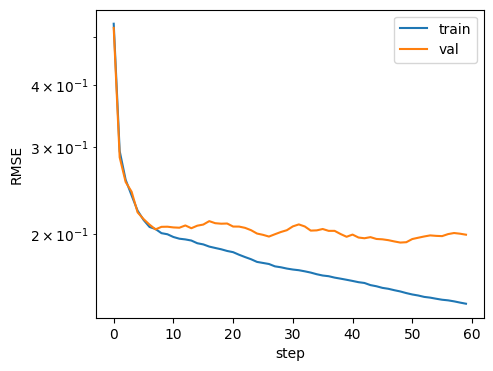

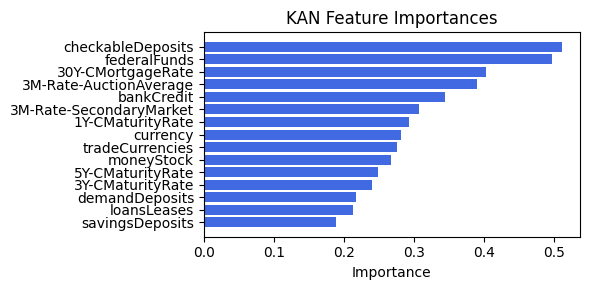

Computing Grad-CAM: 100%|██████████| 210/210 [02:06<00:00,  1.66it/s]


[('currency', 0.10692198584521455), ('checkableDeposits', 0.10308694768519629), ('Ex1', 0.07331716233664858), ('3M-Rate-SecondaryMarket', 0.04040647400099607), ('tradeCurrencies', 0.03612601368555001), ('savingsDeposits', 0.03147947087745706), ('loansLeases', 0.030795202764593774), ('moneyStock', 0.02369933162948915), ('demandDeposits', 0.0007113607134670019), ('federalFunds', 0.00024258061533882503), ('5Y-CMaturityRate', 0.00012258561161745873), ('30Y-CMortgageRate', 9.423308739704745e-05), ('bankCredit', 7.274234667420387e-06), ('1Y-CMaturityRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0)]


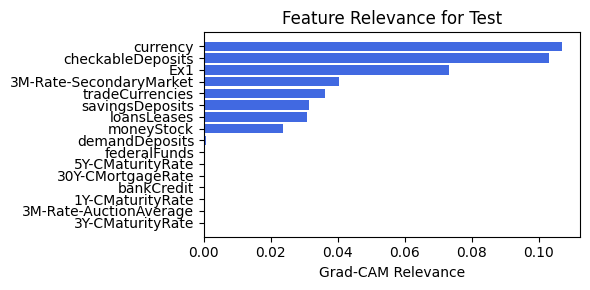

In [204]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=7, lamb=1e-05, steps=60, hidden_dim=32, filename=filename_3, opt_col_val=32)

### 3.3.6 width=[15, 6, 1], grid=7, lamb=1e-05 | hidden_dim=16

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.62e-01 | eval_loss: 1.95e-01 | reg: 5.26e+01 |: 100%|█| 60/60 [02:21<00:00,  2.35s/i


saving model version 0.1
Best epoch 39
0.24461902678012848
M_KAN Relevance: 0.002671319991350174
CNN Relevance: 0.9973286986351013
[('federalFunds', 0.545799), ('checkableDeposits', 0.53483266), ('30Y-CMortgageRate', 0.414666), ('3M-Rate-AuctionAverage', 0.4100222), ('bankCredit', 0.35692447), ('3M-Rate-SecondaryMarket', 0.34649464), ('1Y-CMaturityRate', 0.31442186), ('currency', 0.31336236), ('tradeCurrencies', 0.30775127), ('moneyStock', 0.29059607), ('5Y-CMaturityRate', 0.26258534), ('3Y-CMaturityRate', 0.26169708), ('demandDeposits', 0.23834197), ('loansLeases', 0.2379938), ('savingsDeposits', 0.19673626)]


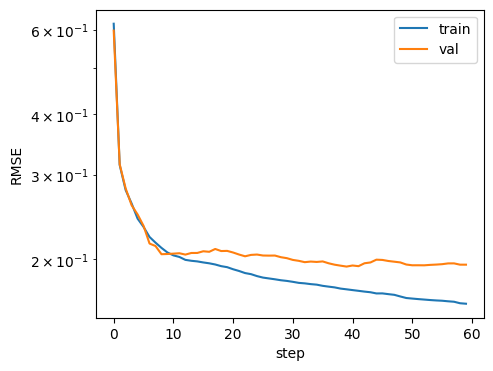

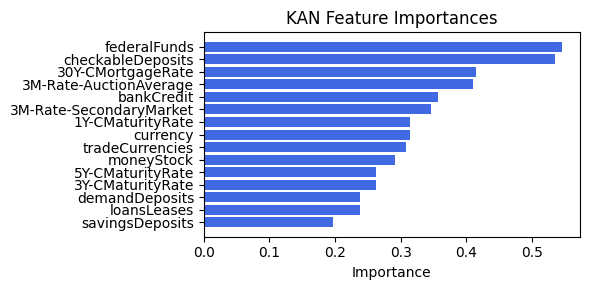

Computing Grad-CAM: 100%|██████████| 210/210 [02:08<00:00,  1.63it/s]


[('3M-Rate-SecondaryMarket', 0.3000411699392966), ('checkableDeposits', 0.11960561044785815), ('loansLeases', 0.034060497641275146), ('1Y-CMaturityRate', 0.026277339387507665), ('3M-Rate-AuctionAverage', 0.021668867908772968), ('30Y-CMortgageRate', 0.021129575974884487), ('currency', 0.01774161161766166), ('bankCredit', 0.0010689911609959035), ('3Y-CMaturityRate', 0.0008172333484426851), ('5Y-CMaturityRate', 0.0007060587051368895), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('savingsDeposits', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


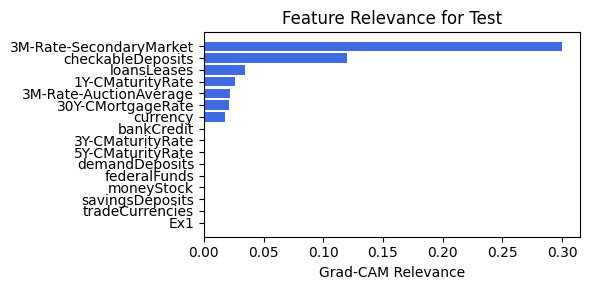

In [205]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=7, lamb=1e-05, steps=60, hidden_dim=16, filename=filename_3, opt_col_val=16)

### 3.3.7 width=[15, 6, 1], grid=7, lamb=1e-05 | hidden_dim=16

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.58e-01 | eval_loss: 2.02e-01 | reg: 5.31e+01 |: 100%|█| 60/60 [02:20<00:00,  2.35s/i


saving model version 0.1
Best epoch 27
0.24508726596832275
M_KAN Relevance: 0.002816717606037855
CNN Relevance: 0.9971832633018494
[('federalFunds', 0.5520897), ('checkableDeposits', 0.5499405), ('30Y-CMortgageRate', 0.42246264), ('3M-Rate-AuctionAverage', 0.41490006), ('bankCredit', 0.36121285), ('3M-Rate-SecondaryMarket', 0.34816885), ('1Y-CMaturityRate', 0.32231876), ('currency', 0.31515878), ('tradeCurrencies', 0.30771443), ('moneyStock', 0.28871393), ('5Y-CMaturityRate', 0.26966813), ('3Y-CMaturityRate', 0.26623154), ('loansLeases', 0.24471347), ('demandDeposits', 0.23515384), ('savingsDeposits', 0.20125066)]


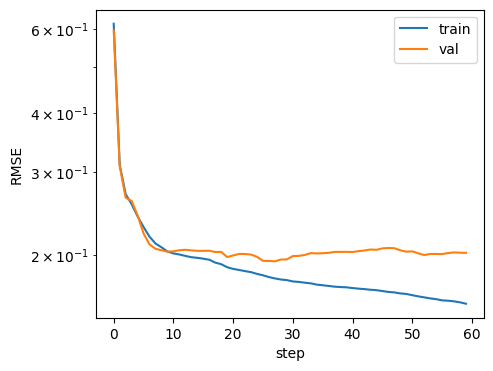

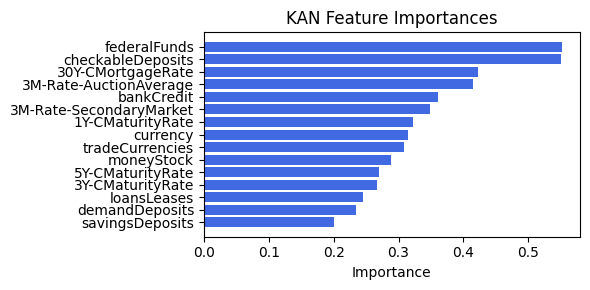

Computing Grad-CAM: 100%|██████████| 210/210 [02:08<00:00,  1.63it/s]


[('3M-Rate-SecondaryMarket', 0.10448830791061656), ('checkableDeposits', 0.07675356020973552), ('currency', 0.022344003342801615), ('1Y-CMaturityRate', 0.013222160899922961), ('loansLeases', 0.012683940753846573), ('3M-Rate-AuctionAverage', 0.012154728103251685), ('30Y-CMortgageRate', 0.011907120485834423), ('bankCredit', 0.0007851693247045789), ('savingsDeposits', 0.0005792138011505207), ('5Y-CMaturityRate', 0.0005348754958027886), ('3Y-CMaturityRate', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


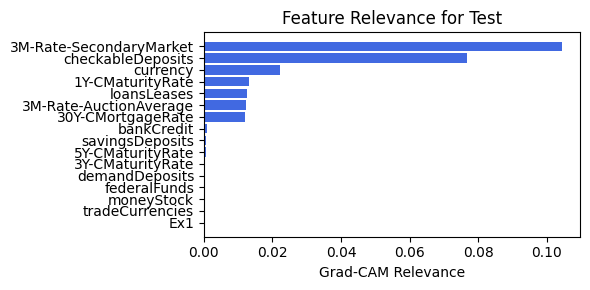

In [206]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=7, lamb=1e-05, steps=60, hidden_dim=16, filename=filename_3, opt_col_val=16)

### 3.3.8 width=[15, 6, 1], grid=7, lamb=1e-05 | hidden_dim=8

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.48e-01 | eval_loss: 1.94e-01 | reg: 5.19e+01 |: 100%|█| 60/60 [02:19<00:00,  2.33s/i


saving model version 0.1
Best epoch 46
0.2373645007610321
M_KAN Relevance: 0.004005760420113802
CNN Relevance: 0.9959942102432251
[('checkableDeposits', 0.5165754), ('federalFunds', 0.49997637), ('30Y-CMortgageRate', 0.41182017), ('3M-Rate-AuctionAverage', 0.38982028), ('bankCredit', 0.34499788), ('3M-Rate-SecondaryMarket', 0.3161793), ('1Y-CMaturityRate', 0.29540247), ('currency', 0.28909454), ('tradeCurrencies', 0.28173006), ('moneyStock', 0.26822343), ('5Y-CMaturityRate', 0.24861589), ('3Y-CMaturityRate', 0.2361323), ('demandDeposits', 0.21696603), ('loansLeases', 0.19939873), ('savingsDeposits', 0.18666993)]


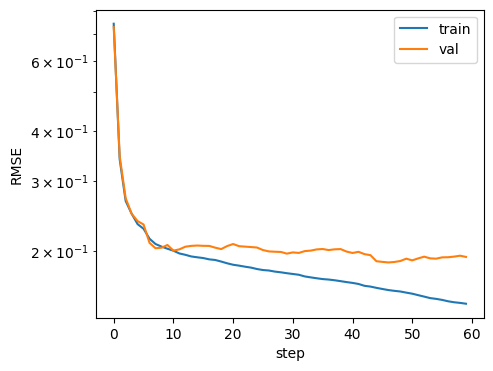

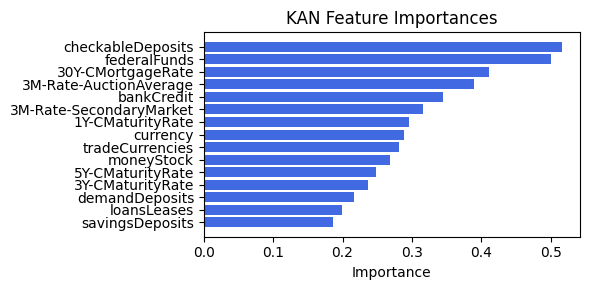

Computing Grad-CAM: 100%|██████████| 210/210 [02:03<00:00,  1.70it/s]


[('loansLeases', 0.09714443591670022), ('3M-Rate-SecondaryMarket', 0.08252140922815583), ('checkableDeposits', 0.06435858887575921), ('currency', 0.019571834412359056), ('savingsDeposits', 0.0158827864729184), ('demandDeposits', 0.008501241498050236), ('1Y-CMaturityRate', 0.008380716952628323), ('3M-Rate-AuctionAverage', 0.0016801152910505023), ('30Y-CMortgageRate', 0.001063733281833785), ('tradeCurrencies', 0.0004933992944036921), ('bankCredit', 9.858861920379457e-05), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('Ex1', 0.0)]


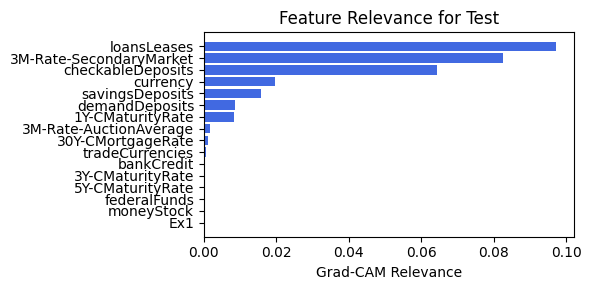

In [207]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=7, lamb=1e-05, steps=60, hidden_dim=8, filename=filename_3, opt_col_val=8)

### 3.3.9 width=[15, 6, 1], grid=7, lamb=1e-05 | hidden_dim=8

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_3


| train_loss: 1.46e-01 | eval_loss: 2.10e-01 | reg: 5.23e+01 |: 100%|█| 60/60 [02:17<00:00,  2.29s/i


saving model version 0.1
Best epoch 20
0.23634546995162964
M_KAN Relevance: 0.0032133450731635094
CNN Relevance: 0.9967866539955139
[('checkableDeposits', 0.5310057), ('federalFunds', 0.5212151), ('30Y-CMortgageRate', 0.4120364), ('3M-Rate-AuctionAverage', 0.39358175), ('bankCredit', 0.34625918), ('3M-Rate-SecondaryMarket', 0.32540417), ('currency', 0.29566962), ('1Y-CMaturityRate', 0.29486728), ('tradeCurrencies', 0.28751153), ('moneyStock', 0.27212223), ('5Y-CMaturityRate', 0.24962363), ('3Y-CMaturityRate', 0.24805705), ('loansLeases', 0.22553544), ('demandDeposits', 0.2203219), ('savingsDeposits', 0.19561112)]


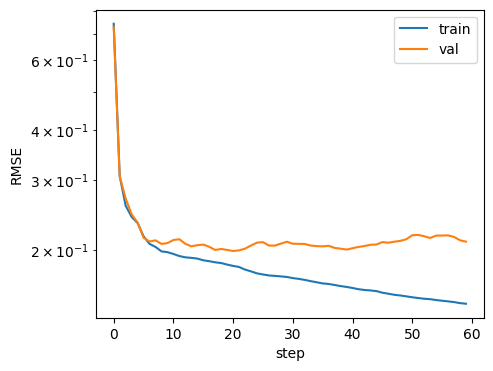

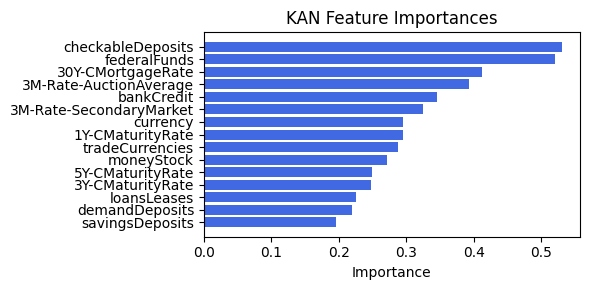

Computing Grad-CAM: 100%|██████████| 210/210 [02:04<00:00,  1.69it/s]


[('3M-Rate-SecondaryMarket', 0.036582932228754673), ('1Y-CMaturityRate', 0.026720674371435528), ('loansLeases', 0.02006984058368419), ('3M-Rate-AuctionAverage', 0.003322917347153028), ('30Y-CMortgageRate', 0.0028795883458639896), ('savingsDeposits', 0.0028142999189661906), ('currency', 0.0003575386656891732), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


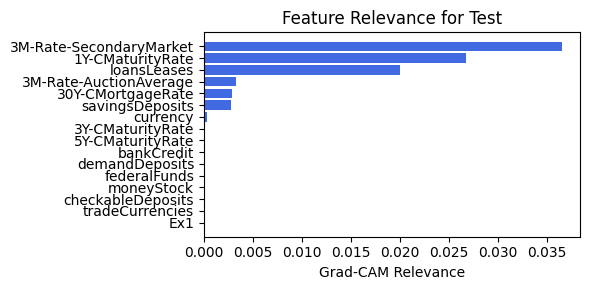

In [208]:
train_and_plot_relevance(Model3_3, kan_neurons=6, kan_grid=7, lamb=1e-05, steps=60, hidden_dim=8, filename=filename_3, opt_col_val=8)

# Opt4: MultiHead Attention

In [45]:
create_csv_with_header(filename_4, columns_opt4)

## 4.0. width=[15, 5, 1], grid=4, lamb=0.0001

embed_dim: 64, num_head:2
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.85e-01 | eval_loss: 1.95e-01 | reg: 2.30e+01 |: 100%|█| 90/90 [02:14<00:00,  1.49s/i


saving model version 0.1
Best epoch 83
0.24302281439304352
M_KAN Relevance: 0.16545182466506958
CNN Relevance: 0.8345481753349304
[('savingsDeposits', 0.46835265), ('tradeCurrencies', 0.40104493), ('loansLeases', 0.39602485), ('federalFunds', 0.30312204), ('checkableDeposits', 0.30304962), ('3M-Rate-AuctionAverage', 0.2462101), ('moneyStock', 0.2000039), ('bankCredit', 0.18659301), ('demandDeposits', 0.1688883), ('3Y-CMaturityRate', 0.1650801), ('3M-Rate-SecondaryMarket', 0.16374393), ('30Y-CMortgageRate', 0.15324534), ('currency', 0.14613429), ('1Y-CMaturityRate', 0.1430192), ('5Y-CMaturityRate', 0.13972981)]


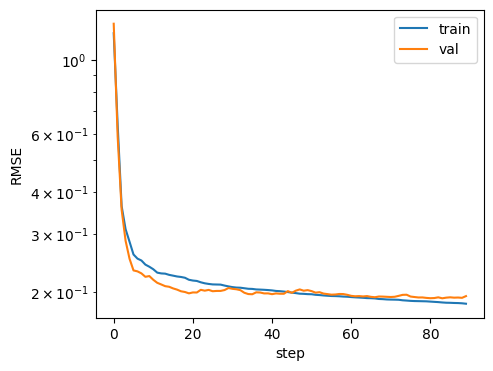

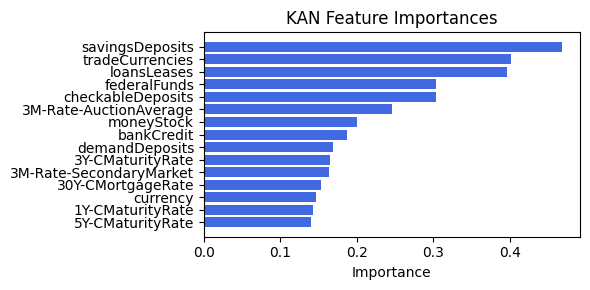

Computing Grad-CAM:   0%|          | 0/210 [00:00<?, ?it/s]C:\Users\vgiov\OneDrive\Documents\Master Data Science\Thesis\pykan\kan\MultKAN.py:822: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\ReduceOps.cpp:1823.)
  self.subnode_actscale.append(torch.std(x, dim=0).detach())
C:\Users\vgiov\OneDrive\Documents\Master Data Science\Thesis\pykan\kan\MultKAN.py:832: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\ReduceOps.cpp:1823.)
  input_range = torch.std(preacts, dim=0) + 0.1
C:\Users\vgiov\OneDrive\Documents\Master Data Science\Thesis\pykan\kan\MultKAN.py:833: UserWarning: std(): degrees of freedom is <= 0. Correction should be strict

[('1Y-CMaturityRate', 0.06468121203638258), ('loansLeases', 0.015619250277190336), ('currency', 0.0034269420163972036), ('5Y-CMaturityRate', 0.0015097367621603466), ('bankCredit', 0.00013127724329630534), ('tradeCurrencies', 8.725338571128392e-05), ('savingsDeposits', 7.02699714933953e-05), ('3M-Rate-SecondaryMarket', 5.0837590935684386e-05), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


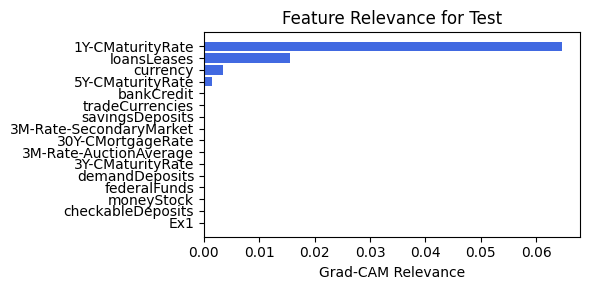

embed_dim: 64, num_head:4
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 2.05e-01 | eval_loss: 2.02e-01 | reg: 2.09e+01 |: 100%|█| 90/90 [00:29<00:00,  3.06it/

saving model version 0.1
Best epoch 89
0.24309638142585754
M_KAN Relevance: 0.13458691537380219
CNN Relevance: 0.8654130697250366
[('savingsDeposits', 0.4673914), ('tradeCurrencies', 0.40166146), ('loansLeases', 0.40026388), ('checkableDeposits', 0.31498948), ('federalFunds', 0.30688182), ('3M-Rate-AuctionAverage', 0.2521916), ('moneyStock', 0.20355049), ('bankCredit', 0.19555555), ('demandDeposits', 0.18314344), ('3Y-CMaturityRate', 0.17016931), ('3M-Rate-SecondaryMarket', 0.16796269), ('30Y-CMortgageRate', 0.15888813), ('currency', 0.15699135), ('1Y-CMaturityRate', 0.15264888), ('5Y-CMaturityRate', 0.14665559)]


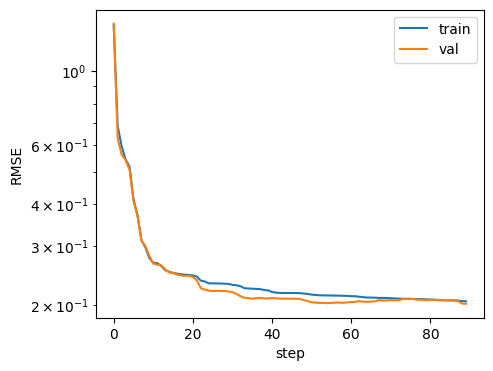

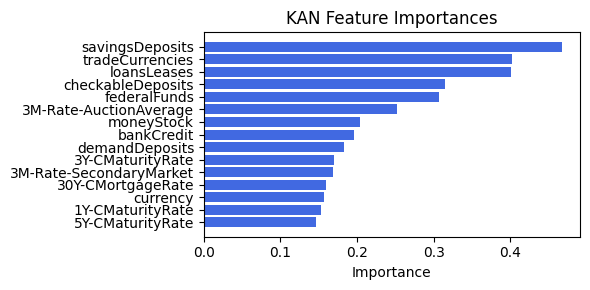

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  8.88it/s]

[('loansLeases', 0.14496322940214582), ('savingsDeposits', 0.017887656183336816), ('demandDeposits', 0.009330964496447927), ('checkableDeposits', 0.002355153432914189), ('1Y-CMaturityRate', 0.0011775636956805275), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3M-Rate-SecondaryMarket', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


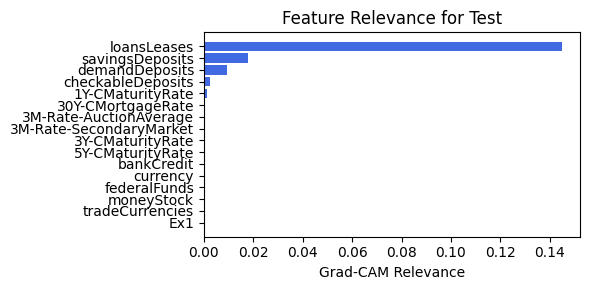

embed_dim: 64, num_head:8
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 2.10e-01 | eval_loss: 2.10e-01 | reg: 2.12e+01 |: 100%|█| 90/90 [00:25<00:00,  3.53it/


saving model version 0.1
Best epoch 67
0.24803997576236725
M_KAN Relevance: 0.09306477010250092
CNN Relevance: 0.9069352149963379
[('savingsDeposits', 0.4671507), ('loansLeases', 0.40705582), ('tradeCurrencies', 0.40304786), ('checkableDeposits', 0.32710424), ('federalFunds', 0.31263906), ('3M-Rate-AuctionAverage', 0.25824147), ('moneyStock', 0.20781891), ('bankCredit', 0.2056034), ('demandDeposits', 0.19734578), ('3Y-CMaturityRate', 0.17558251), ('3M-Rate-SecondaryMarket', 0.17262553), ('currency', 0.1680568), ('30Y-CMortgageRate', 0.16552459), ('1Y-CMaturityRate', 0.16246264), ('5Y-CMaturityRate', 0.15559992)]


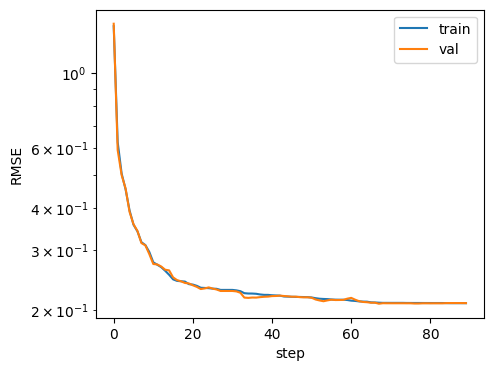

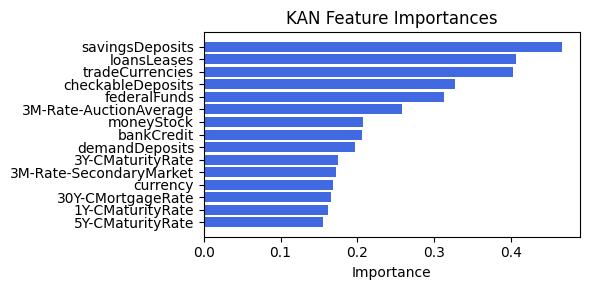

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  9.08it/s]

[('loansLeases', 0.08963608101365111), ('checkableDeposits', 0.019380248196068265), ('savingsDeposits', 0.011529796121508947), ('tradeCurrencies', 0.004948634689762478), ('demandDeposits', 0.0038077696093491145), ('1Y-CMaturityRate', 0.0033144946964014143), ('Ex1', 0.0023696585780098325), ('3M-Rate-AuctionAverage', 0.0017621557982194992), ('3Y-CMaturityRate', 0.0016736068363700594), ('30Y-CMortgageRate', 0.0006415127288727533), ('3M-Rate-SecondaryMarket', 0.00045993694525566837), ('bankCredit', 0.00036820837606986364), ('5Y-CMaturityRate', 0.00025133653765632995), ('currency', 0.00019290263188027201), ('federalFunds', 0.0), ('moneyStock', 0.0)]


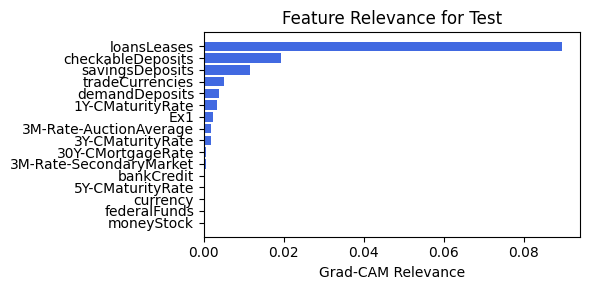

embed_dim: 32, num_head:2
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.76e-01 | eval_loss: 1.98e-01 | reg: 1.74e+01 |: 100%|█| 90/90 [00:29<00:00,  3.09it/

saving model version 0.1
Best epoch 84
0.22802986204624176
M_KAN Relevance: 0.41098761558532715
CNN Relevance: 0.5890123844146729
[('savingsDeposits', 0.47404176), ('tradeCurrencies', 0.4009746), ('loansLeases', 0.38667867), ('federalFunds', 0.2768341), ('checkableDeposits', 0.2758884), ('3M-Rate-AuctionAverage', 0.23970857), ('moneyStock', 0.18979512), ('bankCredit', 0.16359253), ('3M-Rate-SecondaryMarket', 0.152203), ('3Y-CMaturityRate', 0.14870082), ('30Y-CMortgageRate', 0.13631411), ('1Y-CMaturityRate', 0.12171829), ('demandDeposits', 0.12107724), ('5Y-CMaturityRate', 0.11809955), ('currency', 0.10213659)]


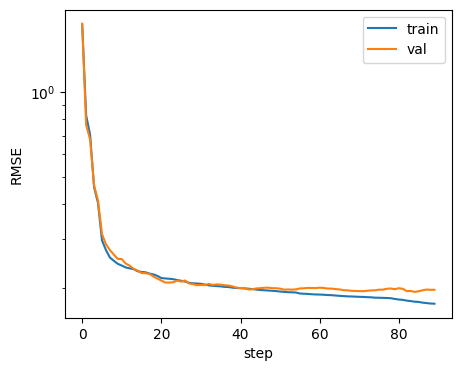

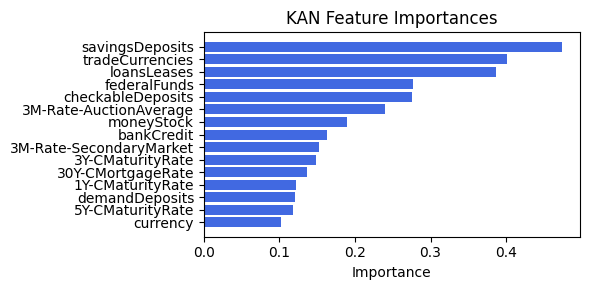

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  9.13it/s]

[('loansLeases', 0.2753353443174135), ('savingsDeposits', 0.06496971928780633), ('tradeCurrencies', 0.058087635545858315), ('demandDeposits', 0.03760217816701957), ('3M-Rate-SecondaryMarket', 0.02010085650143169), ('1Y-CMaturityRate', 0.006191477782669521), ('3M-Rate-AuctionAverage', 0.001297462128457569), ('30Y-CMortgageRate', 0.0010058043968109857), ('currency', 0.0003041515392916543), ('bankCredit', 2.5221122251380058e-05), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


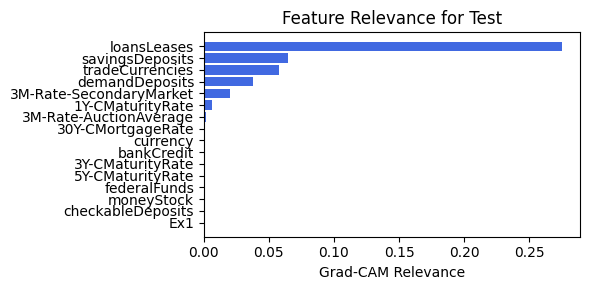

embed_dim: 32, num_head:4
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 2.13e-01 | eval_loss: 1.99e-01 | reg: 2.40e+01 |: 100%|█| 90/90 [00:23<00:00,  3.84it/

saving model version 0.1
Best epoch 89
0.2473994344472885
M_KAN Relevance: 0.2303164005279541
CNN Relevance: 0.7696836590766907
[('savingsDeposits', 0.46798202), ('loansLeases', 0.41214123), ('tradeCurrencies', 0.40474805), ('checkableDeposits', 0.3344873), ('federalFunds', 0.31806007), ('3M-Rate-AuctionAverage', 0.26218477), ('bankCredit', 0.21184292), ('moneyStock', 0.2108536), ('demandDeposits', 0.2057044), ('3Y-CMaturityRate', 0.17894875), ('3M-Rate-SecondaryMarket', 0.175738), ('currency', 0.17513381), ('30Y-CMortgageRate', 0.17078651), ('1Y-CMaturityRate', 0.16829596), ('5Y-CMaturityRate', 0.16163363)]


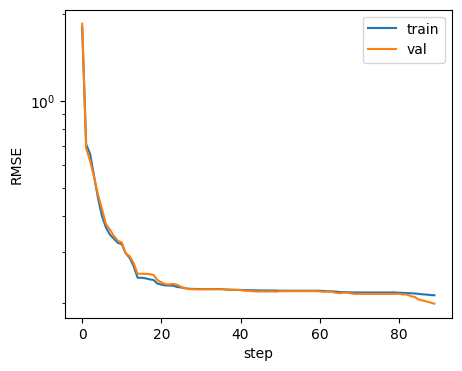

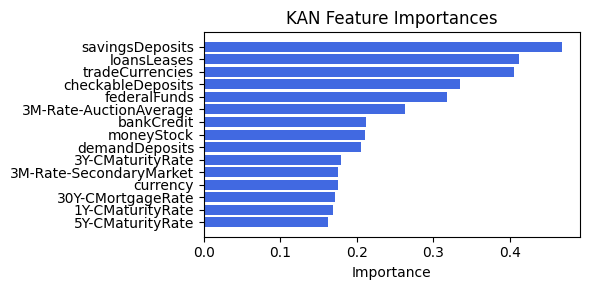

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  8.84it/s]

[('loansLeases', 0.10262765511870384), ('savingsDeposits', 0.008609911433554121), ('1Y-CMaturityRate', 0.0017855705249877204), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3M-Rate-SecondaryMarket', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


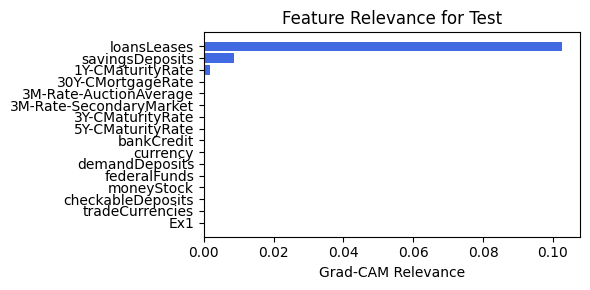

embed_dim: 32, num_head:8
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.71e-01 | eval_loss: 1.94e-01 | reg: 1.94e+01 |: 100%|█| 90/90 [00:28<00:00,  3.16it/

saving model version 0.1
Best epoch 63
0.24854996800422668
M_KAN Relevance: 0.2371397316455841
CNN Relevance: 0.7628602385520935
[('savingsDeposits', 0.46870747), ('tradeCurrencies', 0.40126035), ('loansLeases', 0.3960009), ('federalFunds', 0.30243412), ('checkableDeposits', 0.30190703), ('3M-Rate-AuctionAverage', 0.24565029), ('moneyStock', 0.19976488), ('bankCredit', 0.1859219), ('demandDeposits', 0.16753599), ('3Y-CMaturityRate', 0.16471708), ('3M-Rate-SecondaryMarket', 0.16354512), ('30Y-CMortgageRate', 0.15256463), ('currency', 0.14495242), ('1Y-CMaturityRate', 0.14217941), ('5Y-CMaturityRate', 0.13918994)]


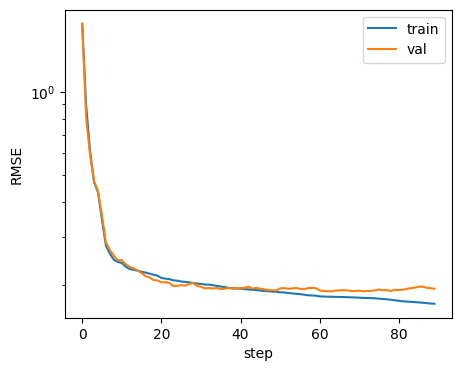

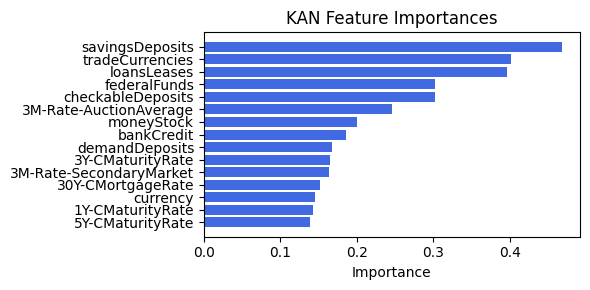

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.49it/s]


[('loansLeases', 0.1421998334782464), ('tradeCurrencies', 0.0828674422488326), ('savingsDeposits', 0.0547186436440998), ('1Y-CMaturityRate', 0.03292253501269789), ('3M-Rate-SecondaryMarket', 0.028058619096520403), ('demandDeposits', 0.026460686990702968), ('3M-Rate-AuctionAverage', 0.012311422665204321), ('30Y-CMortgageRate', 0.01195404731358091), ('3Y-CMaturityRate', 0.009048014210670122), ('bankCredit', 0.005733487595404897), ('5Y-CMaturityRate', 0.005581911502494699), ('currency', 0.0009250901018579801), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


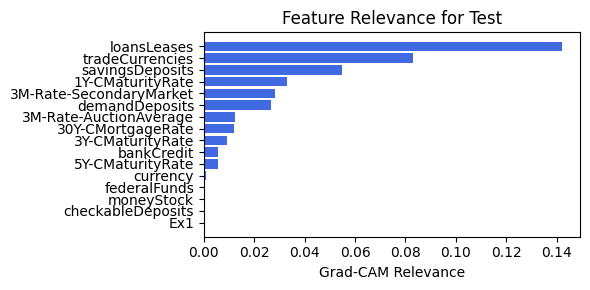

embed_dim: 16, num_head:2
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.34e-01 | eval_loss: 2.00e-01 | reg: 1.42e+01 |: 100%|█| 90/90 [00:32<00:00,  2.74it/

saving model version 0.1
Best epoch 41
0.233984112739563
M_KAN Relevance: 0.2342083752155304
CNN Relevance: 0.7657915949821472
[('savingsDeposits', 0.47161612), ('tradeCurrencies', 0.40065637), ('loansLeases', 0.39160705), ('federalFunds', 0.2898032), ('checkableDeposits', 0.27465746), ('3M-Rate-AuctionAverage', 0.2379473), ('moneyStock', 0.19363414), ('bankCredit', 0.16970186), ('3M-Rate-SecondaryMarket', 0.15621369), ('3Y-CMaturityRate', 0.15352713), ('30Y-CMortgageRate', 0.1417527), ('demandDeposits', 0.13594685), ('1Y-CMaturityRate', 0.1293845), ('5Y-CMaturityRate', 0.12574475), ('currency', 0.118032776)]


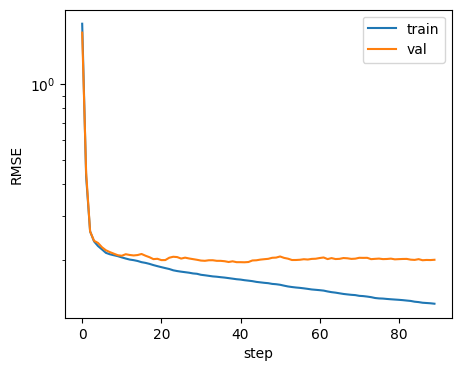

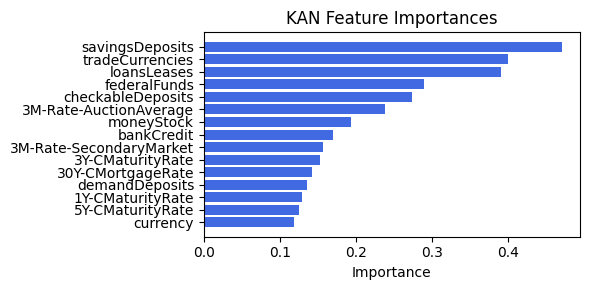

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  8.81it/s]

[('Ex1', 0.40665388985015893), ('loansLeases', 0.26647223664358966), ('savingsDeposits', 0.20279221227416808), ('currency', 0.18385857542854778), ('checkableDeposits', 0.15013447959153425), ('3M-Rate-SecondaryMarket', 0.13255548211080687), ('demandDeposits', 0.07191423503682018), ('tradeCurrencies', 0.06738044723336185), ('5Y-CMaturityRate', 0.011161664895535935), ('federalFunds', 0.009895738611175191), ('bankCredit', 0.006818166419508912), ('1Y-CMaturityRate', 0.003018243100848936), ('3Y-CMaturityRate', 0.002840898239186832), ('moneyStock', 0.0019516402234633764), ('3M-Rate-AuctionAverage', 0.001047286382388501), ('30Y-CMortgageRate', 0.0005103477052346404)]


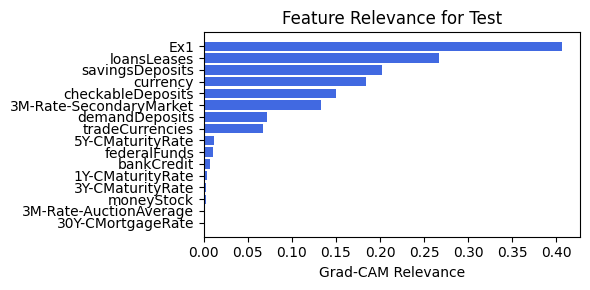

embed_dim: 16, num_head:4
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.41e-01 | eval_loss: 2.10e-01 | reg: 1.33e+01 |: 100%|█| 90/90 [00:28<00:00,  3.13it/

saving model version 0.1
Best epoch 32
0.22727879881858826
M_KAN Relevance: 0.2411966323852539
CNN Relevance: 0.7588034272193909
[('savingsDeposits', 0.472604), ('tradeCurrencies', 0.4009883), ('loansLeases', 0.39344463), ('federalFunds', 0.28776538), ('checkableDeposits', 0.27321193), ('3M-Rate-AuctionAverage', 0.23949055), ('moneyStock', 0.19287585), ('bankCredit', 0.16918409), ('3M-Rate-SecondaryMarket', 0.15411459), ('3Y-CMaturityRate', 0.15066807), ('30Y-CMortgageRate', 0.13874054), ('demandDeposits', 0.12980556), ('1Y-CMaturityRate', 0.1295534), ('5Y-CMaturityRate', 0.123544075), ('currency', 0.11121931)]


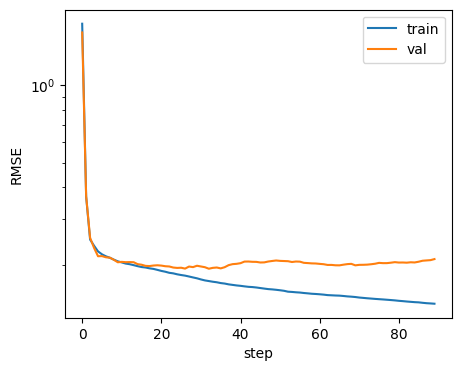

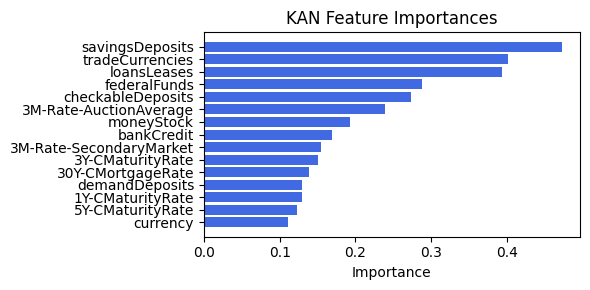

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.35it/s]

[('tradeCurrencies', 0.21706847637182192), ('loansLeases', 0.19843255955105027), ('savingsDeposits', 0.1290549466364263), ('demandDeposits', 0.07937258978684743), ('currency', 0.04604634036021751), ('3Y-CMaturityRate', 0.04427550670336045), ('3M-Rate-SecondaryMarket', 0.02619264726249856), ('checkableDeposits', 0.016642148473433087), ('Ex1', 0.010308252629779633), ('5Y-CMaturityRate', 0.0035507757039297196), ('bankCredit', 0.003146842547825405), ('federalFunds', 0.001106926588164199), ('1Y-CMaturityRate', 0.0008170075359798613), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('moneyStock', 0.0)]


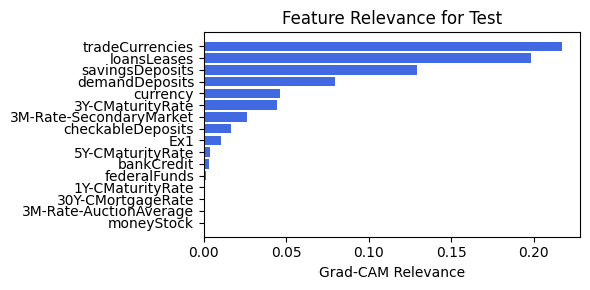

embed_dim: 16, num_head:8
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.39e-01 | eval_loss: 2.10e-01 | reg: 1.35e+01 |: 100%|█| 90/90 [00:29<00:00,  3.09it/

saving model version 0.1
Best epoch 24
0.23177281022071838
M_KAN Relevance: 0.22488337755203247
CNN Relevance: 0.7751166224479675
[('savingsDeposits', 0.46800452), ('tradeCurrencies', 0.40096307), ('loansLeases', 0.39637443), ('checkableDeposits', 0.30513918), ('federalFunds', 0.30407056), ('3M-Rate-AuctionAverage', 0.24726287), ('moneyStock', 0.20052557), ('bankCredit', 0.18795954), ('demandDeposits', 0.1713681), ('3Y-CMaturityRate', 0.16585432), ('3M-Rate-SecondaryMarket', 0.16432562), ('30Y-CMortgageRate', 0.15431035), ('currency', 0.14813972), ('1Y-CMaturityRate', 0.14466695), ('5Y-CMaturityRate', 0.14074966)]


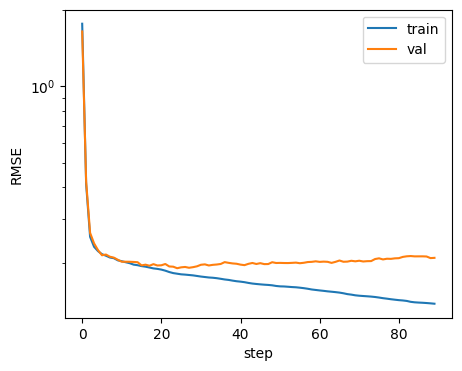

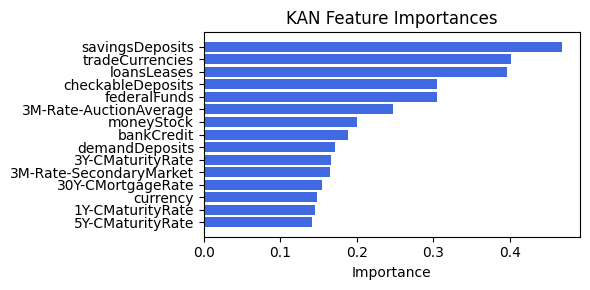

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.73it/s]

[('loansLeases', 0.15265035571175672), ('tradeCurrencies', 0.12180614106452725), ('demandDeposits', 0.07275113835653645), ('savingsDeposits', 0.0656841478396451), ('3Y-CMaturityRate', 0.06252164650885832), ('Ex1', 0.0429636389460592), ('3M-Rate-SecondaryMarket', 0.04055453778377601), ('federalFunds', 0.012579640371924532), ('1Y-CMaturityRate', 0.001768241326014201), ('currency', 0.001345107846316837), ('5Y-CMaturityRate', 8.482010369854314e-06), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('bankCredit', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0)]


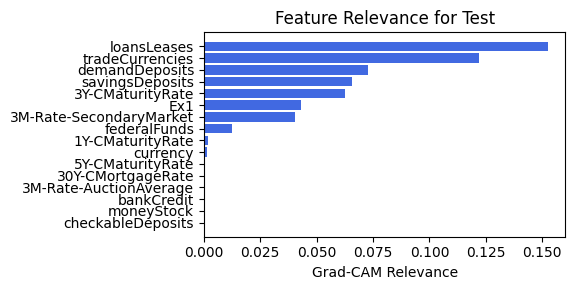

In [49]:
for embed_dim in [64, 32, 16]:
    for num_head in [2, 4 , 8]:
        print(f"embed_dim: {embed_dim}, num_head:{num_head}")
        train_and_plot_relevance(Model3_4, kan_neurons=5, kan_grid=4, lamb=0.0001, steps=90, 
                                 embed_dim=embed_dim, num_heads=num_head, filename=filename_4, opt_col_val=f'{embed_dim}, {num_head}')

embed_dim: 48, num_head:6
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.84e-01 | eval_loss: 1.97e-01 | reg: 2.20e+01 |: 100%|█| 90/90 [02:51<00:00,  1.91s/i


saving model version 0.1
Best epoch 47
0.2358446717262268
M_KAN Relevance: 0.12814940512180328
CNN Relevance: 0.8718505501747131
[('savingsDeposits', 0.46791944), ('loansLeases', 0.41175523), ('tradeCurrencies', 0.40461975), ('checkableDeposits', 0.3339261), ('federalFunds', 0.3176321), ('3M-Rate-AuctionAverage', 0.26188728), ('bankCredit', 0.21137173), ('moneyStock', 0.21062206), ('demandDeposits', 0.20507358), ('3Y-CMaturityRate', 0.1786936), ('3M-Rate-SecondaryMarket', 0.17545244), ('currency', 0.17458601), ('30Y-CMortgageRate', 0.1703684), ('1Y-CMaturityRate', 0.16785407), ('5Y-CMaturityRate', 0.16117005)]


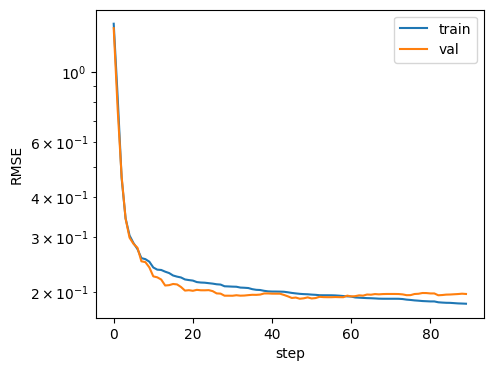

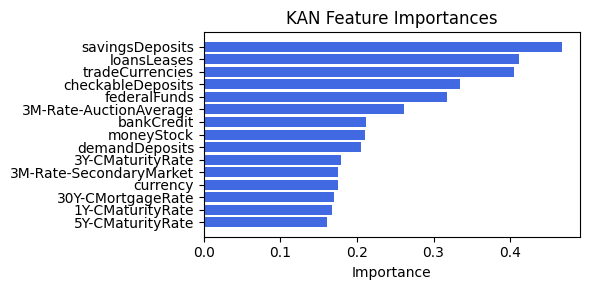

Computing Grad-CAM:   0%|          | 0/210 [00:00<?, ?it/s]C:\Users\vgiov\OneDrive\Documents\Master Data Science\Thesis\pykan\kan\MultKAN.py:822: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\ReduceOps.cpp:1823.)
  self.subnode_actscale.append(torch.std(x, dim=0).detach())
C:\Users\vgiov\OneDrive\Documents\Master Data Science\Thesis\pykan\kan\MultKAN.py:832: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\ReduceOps.cpp:1823.)
  input_range = torch.std(preacts, dim=0) + 0.1
C:\Users\vgiov\OneDrive\Documents\Master Data Science\Thesis\pykan\kan\MultKAN.py:833: UserWarning: std(): degrees of freedom is <= 0. Correction should be strict

[('1Y-CMaturityRate', 0.0), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3M-Rate-SecondaryMarket', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('loansLeases', 0.0), ('savingsDeposits', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


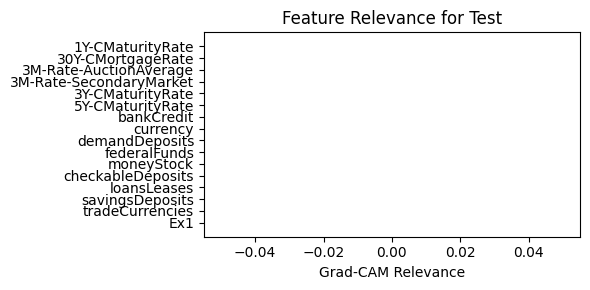

embed_dim: 24, num_head:6
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.47e-01 | eval_loss: 1.92e-01 | reg: 1.44e+01 |: 100%|█| 90/90 [02:55<00:00,  1.95s/i


saving model version 0.1
Best epoch 89
0.21765866875648499
M_KAN Relevance: 0.3290490508079529
CNN Relevance: 0.6709510087966919
[('savingsDeposits', 0.37125602), ('tradeCurrencies', 0.33045226), ('loansLeases', 0.2631402), ('checkableDeposits', 0.21249604), ('federalFunds', 0.19153118), ('3M-Rate-AuctionAverage', 0.15766248), ('30Y-CMortgageRate', 0.12054133), ('1Y-CMaturityRate', 0.11266767), ('moneyStock', 0.109352544), ('3M-Rate-SecondaryMarket', 0.10153072), ('3Y-CMaturityRate', 0.08976358), ('5Y-CMaturityRate', 0.08669452), ('currency', 0.080220364), ('bankCredit', 0.06210348), ('demandDeposits', 0.047973968)]


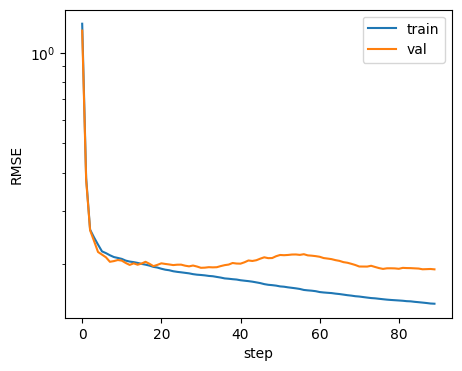

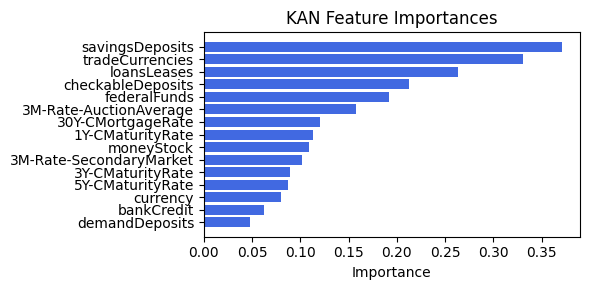

Computing Grad-CAM: 100%|██████████| 210/210 [01:55<00:00,  1.82it/s]


[('Ex1', 0.3420556096093995), ('checkableDeposits', 0.3066929440945387), ('tradeCurrencies', 0.1855727530413008), ('savingsDeposits', 0.1799217064962466), ('currency', 0.1551077845694852), ('loansLeases', 0.09371778411524637), ('3M-Rate-SecondaryMarket', 0.08644510779773727), ('demandDeposits', 0.016487169343357286), ('3Y-CMaturityRate', 0.008460398144753916), ('30Y-CMortgageRate', 0.000755371067073914), ('moneyStock', 0.0007102795033937408), ('3M-Rate-AuctionAverage', 0.0006156744967613901), ('5Y-CMaturityRate', 0.0005059663328297791), ('bankCredit', 0.0003980841398948715), ('federalFunds', 0.0002900285557622001), ('1Y-CMaturityRate', 0.00024190436871278853)]


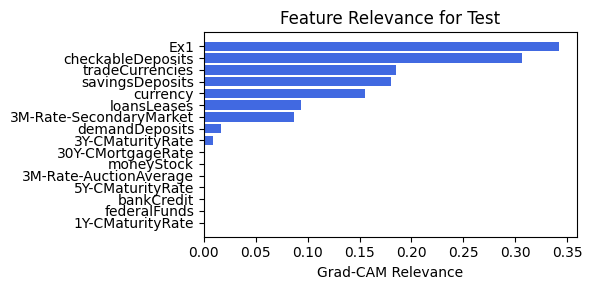

embed_dim: 12, num_head:6
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.53e-01 | eval_loss: 2.05e-01 | reg: 1.15e+01 |: 100%|█| 90/90 [02:54<00:00,  1.94s/i


saving model version 0.1
Best epoch 68
0.20547954738140106
M_KAN Relevance: 0.3937271237373352
CNN Relevance: 0.6062728762626648
[('savingsDeposits', 0.44883943), ('tradeCurrencies', 0.37666583), ('loansLeases', 0.34909162), ('checkableDeposits', 0.28096807), ('federalFunds', 0.22858754), ('3M-Rate-AuctionAverage', 0.20705438), ('moneyStock', 0.16502865), ('3M-Rate-SecondaryMarket', 0.13627315), ('bankCredit', 0.13112059), ('3Y-CMaturityRate', 0.12845396), ('1Y-CMaturityRate', 0.118951105), ('30Y-CMortgageRate', 0.1179316), ('demandDeposits', 0.09911344), ('5Y-CMaturityRate', 0.095143065), ('currency', 0.051540803)]


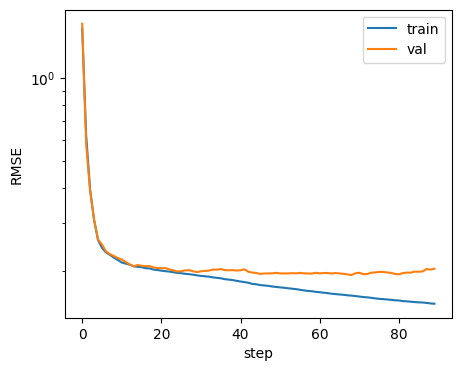

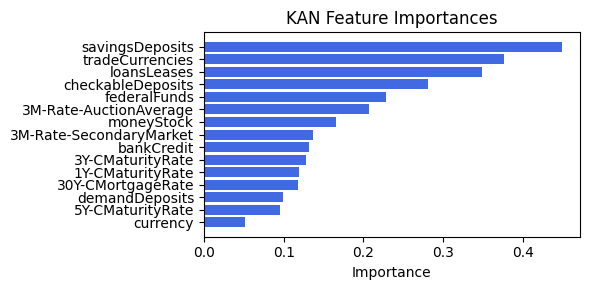

Computing Grad-CAM: 100%|██████████| 210/210 [01:52<00:00,  1.86it/s]


[('3M-Rate-SecondaryMarket', 0.33749968116836887), ('checkableDeposits', 0.15922093304661325), ('3M-Rate-AuctionAverage', 0.1553053717151107), ('30Y-CMortgageRate', 0.1550718668378457), ('1Y-CMaturityRate', 0.1082958119522248), ('currency', 0.09166522723223482), ('Ex1', 0.08307182169741108), ('tradeCurrencies', 0.06671662678244113), ('savingsDeposits', 0.06650658399005244), ('loansLeases', 0.06517771934716923), ('moneyStock', 0.009041847524765346), ('demandDeposits', 0.0028713999316096308), ('5Y-CMaturityRate', 0.0012705565596531545), ('3Y-CMaturityRate', 0.0008870423904487065), ('bankCredit', 0.0008253503191683973), ('federalFunds', 0.00021920141104298335)]


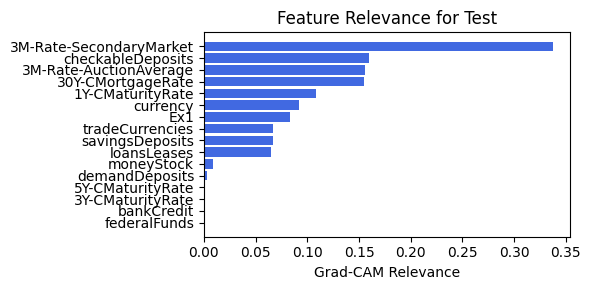

In [41]:
for embed_dim in [48, 24, 12]:
    for num_head in [6]:
        print(f"embed_dim: {embed_dim}, num_head:{num_head}")
        train_and_plot_relevance(Model3_4, kan_neurons=5, kan_grid=4, lamb=0.0001, steps=90, 
                                 embed_dim=embed_dim, num_heads=num_head, filename=filename_4, opt_col_val=f'{embed_dim}, {num_head}')

### 4.0.0 width=[15, 5, 1], grid=4, lamb=0.0001 | embed_dim=64

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 2.19e-01 | eval_loss: 2.14e-01 | reg: 2.28e+01 |: 100%|█| 60/60 [00:20<00:00,  2.87it/


saving model version 0.1
Best epoch 48
0.2627202570438385
M_KAN Relevance: 0.09432785212993622
CNN Relevance: 0.9056721329689026
[('savingsDeposits', 0.46854863), ('loansLeases', 0.41468677), ('tradeCurrencies', 0.4056893), ('checkableDeposits', 0.3380067), ('federalFunds', 0.32098663), ('3M-Rate-AuctionAverage', 0.26413012), ('bankCredit', 0.2148166), ('moneyStock', 0.21238962), ('demandDeposits', 0.20962675), ('3Y-CMaturityRate', 0.18055628), ('currency', 0.17867826), ('3M-Rate-SecondaryMarket', 0.1778591), ('30Y-CMortgageRate', 0.17349519), ('1Y-CMaturityRate', 0.17104852), ('5Y-CMaturityRate', 0.16458474)]


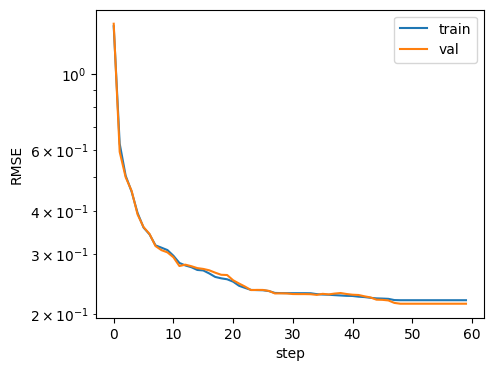

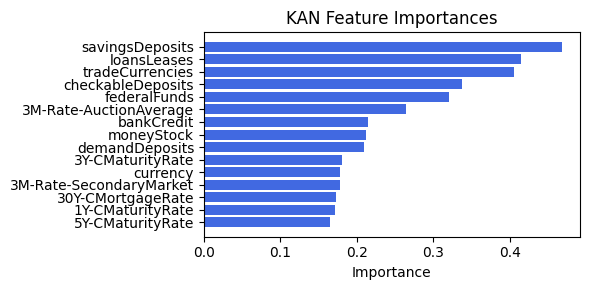

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.71it/s]

[('loansLeases', 0.09906003927545888), ('savingsDeposits', 0.01684921600279354), ('checkableDeposits', 0.016768497884983108), ('demandDeposits', 0.010907811312271016), ('moneyStock', 0.008716054189772834), ('tradeCurrencies', 0.00847742585908799), ('federalFunds', 0.00737705926100413), ('3Y-CMaturityRate', 0.0049876032840637935), ('1Y-CMaturityRate', 0.004526865553288233), ('3M-Rate-SecondaryMarket', 0.0028633182868361474), ('Ex1', 0.0024308558730852035), ('3M-Rate-AuctionAverage', 0.0018799237153005032), ('30Y-CMortgageRate', 0.001177943249543508), ('bankCredit', 0.00026448087855463935), ('5Y-CMaturityRate', 0.00019802512334925787), ('currency', 0.00010717969077328841)]


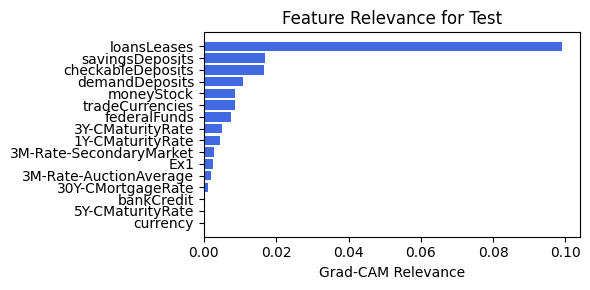

In [210]:
train_and_plot_relevance(Model3_4, kan_neurons=5, kan_grid=4, lamb=0.0001, steps=60, embed_dim=64, filename=filename_4, opt_col_val=64)

### 4.0.1 width=[15, 5, 1], grid=4, lamb=0.0001 | embed_dim=64

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 2.19e-01 | eval_loss: 2.14e-01 | reg: 2.25e+01 |: 100%|█| 60/60 [00:23<00:00,  2.53it/

saving model version 0.1
Best epoch 59
0.25768163800239563
M_KAN Relevance: 0.20432136952877045
CNN Relevance: 0.7956786751747131
[('savingsDeposits', 0.468228), ('loansLeases', 0.41317654), ('tradeCurrencies', 0.40514132), ('checkableDeposits', 0.33589825), ('federalFunds', 0.31924567), ('3M-Rate-AuctionAverage', 0.26297516), ('bankCredit', 0.2130413), ('moneyStock', 0.21147804), ('demandDeposits', 0.20727907), ('3Y-CMaturityRate', 0.17959519), ('3M-Rate-SecondaryMarket', 0.17656069), ('currency', 0.1765554), ('30Y-CMortgageRate', 0.17187387), ('1Y-CMaturityRate', 0.16939907), ('5Y-CMaturityRate', 0.16281939)]


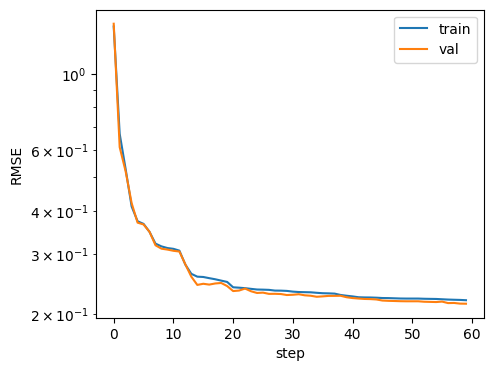

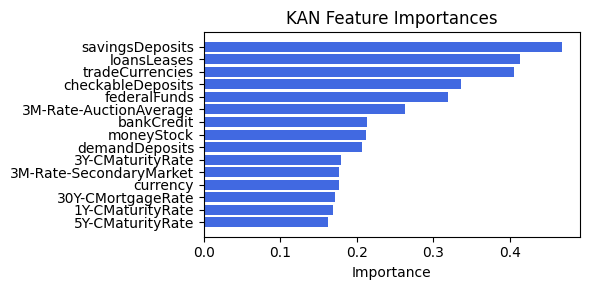

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.56it/s]

[('loansLeases', 0.07552538466684165), ('savingsDeposits', 0.017859614558429236), ('checkableDeposits', 0.012725087237500009), ('demandDeposits', 0.01263958802003236), ('tradeCurrencies', 0.011939882664453415), ('moneyStock', 0.00988764791261582), ('federalFunds', 0.008290943361464001), ('3Y-CMaturityRate', 0.005720518316541399), ('Ex1', 0.0043040137915384205), ('1Y-CMaturityRate', 0.0037656118827206746), ('3M-Rate-AuctionAverage', 0.0015947589916842325), ('30Y-CMortgageRate', 0.000882125105930581), ('3M-Rate-SecondaryMarket', 0.0005758522433184442), ('bankCredit', 0.00031365510076284406), ('5Y-CMaturityRate', 0.0002574154619304907), ('currency', 0.000133041079555239)]


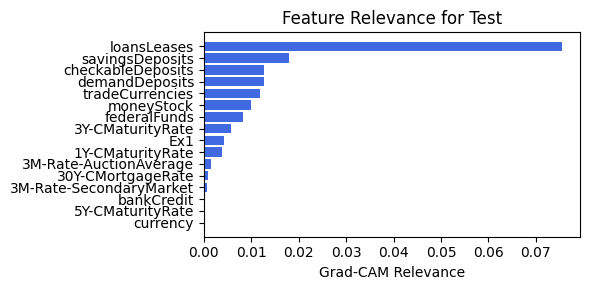

In [211]:
train_and_plot_relevance(Model3_4, kan_neurons=5, kan_grid=4, lamb=0.0001, steps=60, embed_dim=64, filename=filename_4, opt_col_val=64)

### 4.0.2 width=[15, 5, 1], grid=4, lamb=0.0001 | embed_dim=32

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.90e-01 | eval_loss: 2.00e-01 | reg: 1.92e+01 |: 100%|█| 60/60 [00:23<00:00,  2.59it/

saving model version 0.1
Best epoch 51
0.2389809936285019
M_KAN Relevance: 0.40101248025894165
CNN Relevance: 0.5989875197410583
[('savingsDeposits', 0.46735963), ('tradeCurrencies', 0.4005753), ('loansLeases', 0.39633814), ('checkableDeposits', 0.30668017), ('federalFunds', 0.3042723), ('3M-Rate-AuctionAverage', 0.2478416), ('moneyStock', 0.20077081), ('bankCredit', 0.18894409), ('demandDeposits', 0.17326117), ('3Y-CMaturityRate', 0.1664654), ('3M-Rate-SecondaryMarket', 0.16531996), ('30Y-CMortgageRate', 0.15518004), ('currency', 0.14975223), ('1Y-CMaturityRate', 0.14594367), ('5Y-CMaturityRate', 0.1415853)]


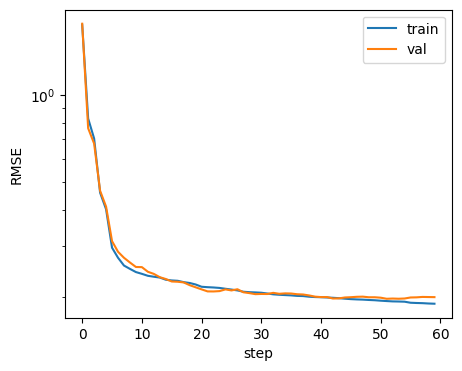

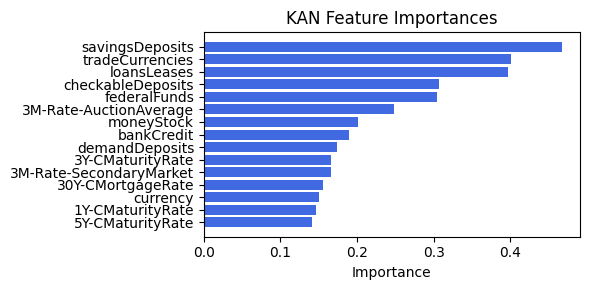

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.69it/s]


[('loansLeases', 0.2868829188247522), ('savingsDeposits', 0.06335815075297085), ('3M-Rate-SecondaryMarket', 0.019785562157630922), ('1Y-CMaturityRate', 0.003946597098062435), ('tradeCurrencies', 0.003632785714719267), ('3M-Rate-AuctionAverage', 0.0010990101666677565), ('30Y-CMortgageRate', 0.0006595378120740255), ('currency', 0.00046643225165704885), ('bankCredit', 5.3270533680915835e-05), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


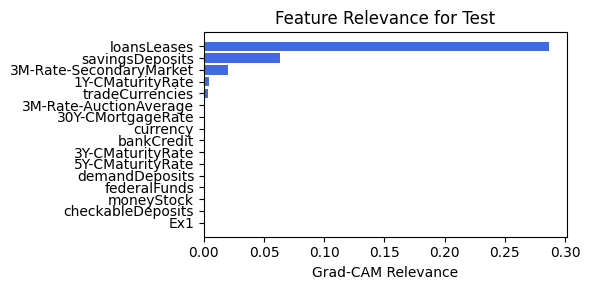

In [212]:
train_and_plot_relevance(Model3_4, kan_neurons=5, kan_grid=4, lamb=0.0001, steps=60, embed_dim=32, filename=filename_4, opt_col_val=32)

### 4.0.3 width=[15, 5, 1], grid=4, lamb=0.0001 | embed_dim=32

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.91e-01 | eval_loss: 2.01e-01 | reg: 1.98e+01 |: 100%|█| 60/60 [00:23<00:00,  2.55it/

saving model version 0.1
Best epoch 56
0.23075753450393677
M_KAN Relevance: 0.3533024191856384
CNN Relevance: 0.6466975808143616
[('savingsDeposits', 0.46803808), ('tradeCurrencies', 0.4007629), ('loansLeases', 0.3958937), ('federalFunds', 0.3038251), ('checkableDeposits', 0.3033835), ('3M-Rate-AuctionAverage', 0.24639423), ('moneyStock', 0.2000269), ('bankCredit', 0.18672659), ('demandDeposits', 0.169256), ('3Y-CMaturityRate', 0.16504598), ('3M-Rate-SecondaryMarket', 0.16366838), ('30Y-CMortgageRate', 0.15361372), ('currency', 0.14661221), ('1Y-CMaturityRate', 0.14329319), ('5Y-CMaturityRate', 0.13985851)]


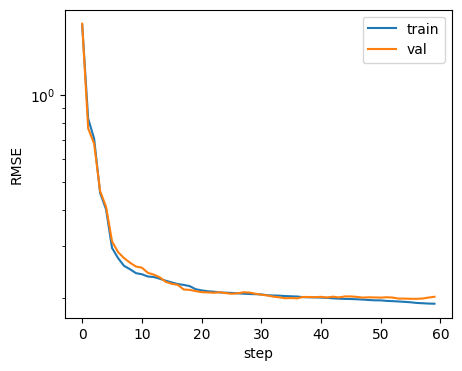

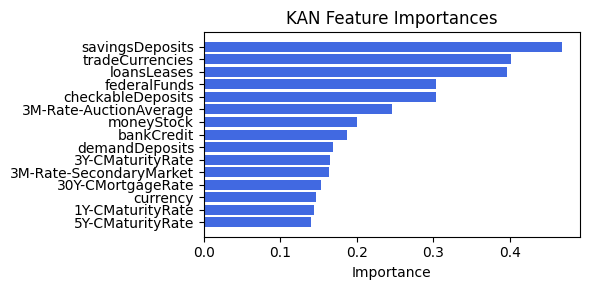

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.70it/s]

[('loansLeases', 0.2823049836215519), ('tradeCurrencies', 0.09619231697704111), ('savingsDeposits', 0.08749280453970035), ('3M-Rate-SecondaryMarket', 0.01978905647993088), ('1Y-CMaturityRate', 0.007714143963087173), ('demandDeposits', 0.006288071197784683), ('3M-Rate-AuctionAverage', 0.001743696221993083), ('30Y-CMortgageRate', 0.001546062207559035), ('currency', 0.0006471082213379088), ('bankCredit', 0.00021685627954346794), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


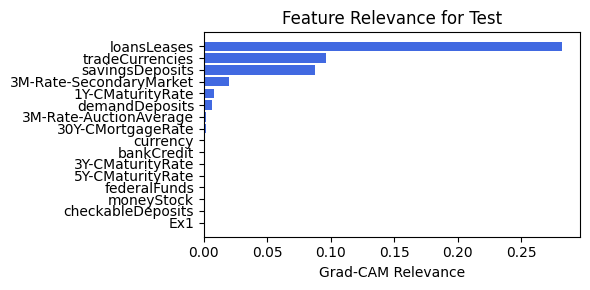

In [213]:
train_and_plot_relevance(Model3_4, kan_neurons=5, kan_grid=4, lamb=0.0001, steps=60, embed_dim=32, filename=filename_4, opt_col_val=32)

### 4.0.4 width=[15, 5, 1], grid=4, lamb=0.0001 | embed_dim=16

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.52e-01 | eval_loss: 2.11e-01 | reg: 1.63e+01 |: 100%|█| 60/60 [00:21<00:00,  2.77it/

saving model version 0.1
Best epoch 38
0.2377694547176361
M_KAN Relevance: 0.24170316755771637
CNN Relevance: 0.7582967877388
[('savingsDeposits', 0.47017455), ('tradeCurrencies', 0.4005266), ('loansLeases', 0.39256972), ('federalFunds', 0.2942612), ('checkableDeposits', 0.28383663), ('3M-Rate-AuctionAverage', 0.23807755), ('moneyStock', 0.19558482), ('bankCredit', 0.17518939), ('3M-Rate-SecondaryMarket', 0.158285), ('3Y-CMaturityRate', 0.1577404), ('demandDeposits', 0.1470772), ('30Y-CMortgageRate', 0.14542873), ('1Y-CMaturityRate', 0.13331626), ('5Y-CMaturityRate', 0.1307355), ('currency', 0.12819293)]


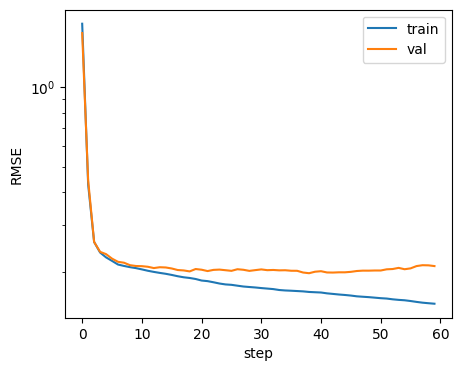

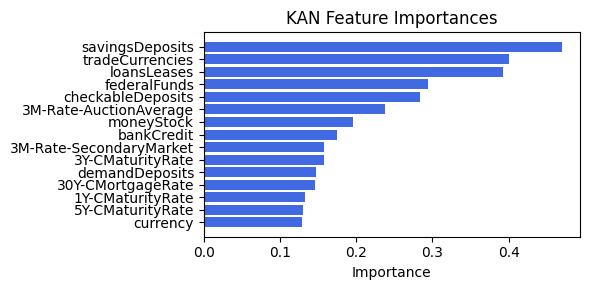

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.49it/s]

[('Ex1', 0.5199391210717814), ('savingsDeposits', 0.2408143291776512), ('loansLeases', 0.2312656287015194), ('tradeCurrencies', 0.21982374181970954), ('currency', 0.16763277181335504), ('checkableDeposits', 0.10821174242134605), ('3M-Rate-SecondaryMarket', 0.08486226688893068), ('demandDeposits', 0.07249879000287149), ('3Y-CMaturityRate', 0.03494805511353272), ('federalFunds', 0.015455089875363879), ('moneyStock', 0.012031369882502726), ('5Y-CMaturityRate', 0.001734332296819914), ('1Y-CMaturityRate', 0.00025689605560425357), ('bankCredit', 0.00020112522123824983), ('30Y-CMortgageRate', 2.2670486941933632e-05), ('3M-Rate-AuctionAverage', 0.0)]


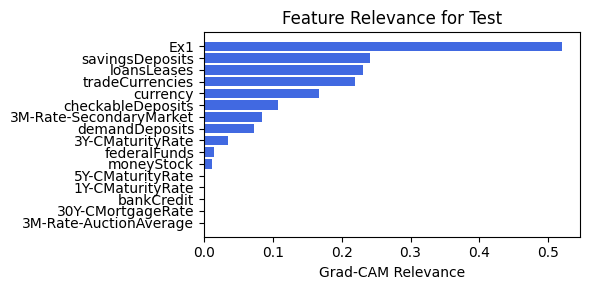

In [214]:
train_and_plot_relevance(Model3_4, kan_neurons=5, kan_grid=4, lamb=0.0001, steps=60, embed_dim=16, filename=filename_4, opt_col_val=16)

### 4.0.5 width=[15, 5, 1], grid=4, lamb=0.0001 | embed_dim=16

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.54e-01 | eval_loss: 2.03e-01 | reg: 1.61e+01 |: 100%|█| 60/60 [00:19<00:00,  3.05it/

saving model version 0.1
Best epoch 29
0.22704599797725677
M_KAN Relevance: 0.24605140089988708
CNN Relevance: 0.7539486885070801
[('savingsDeposits', 0.46904656), ('tradeCurrencies', 0.39884552), ('loansLeases', 0.39362684), ('federalFunds', 0.29620183), ('checkableDeposits', 0.2798912), ('3M-Rate-AuctionAverage', 0.23735021), ('moneyStock', 0.19487056), ('bankCredit', 0.17378838), ('3M-Rate-SecondaryMarket', 0.15697049), ('3Y-CMaturityRate', 0.15513466), ('30Y-CMortgageRate', 0.14528629), ('demandDeposits', 0.14213), ('1Y-CMaturityRate', 0.13349883), ('5Y-CMaturityRate', 0.13113272), ('currency', 0.12567012)]


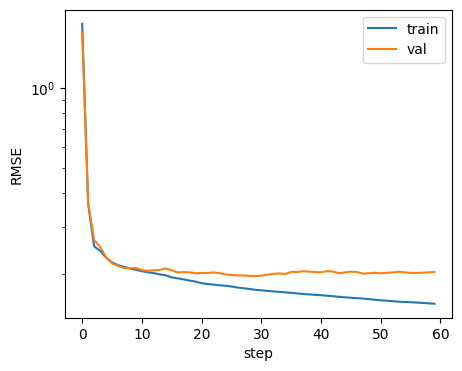

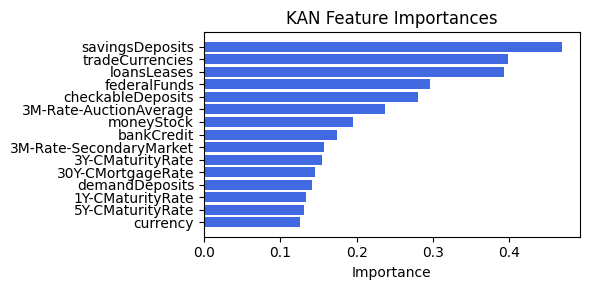

Computing Grad-CAM: 100%|██████████| 210/210 [00:23<00:00,  9.11it/s]

[('Ex1', 0.6268738704245715), ('currency', 0.4759201874335607), ('checkableDeposits', 0.29380392872013283), ('3M-Rate-SecondaryMarket', 0.22641486192476892), ('loansLeases', 0.16829658913803064), ('savingsDeposits', 0.1428517503374938), ('tradeCurrencies', 0.049908802556871835), ('demandDeposits', 0.015120195861284932), ('federalFunds', 0.00037700983424050115), ('1Y-CMaturityRate', 1.823086335900284e-05), ('30Y-CMortgageRate', 6.339062348983827e-07), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('moneyStock', 0.0)]


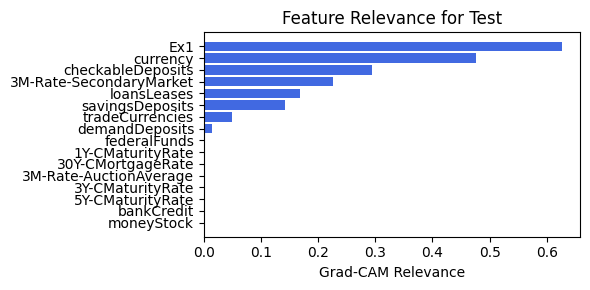

In [215]:
train_and_plot_relevance(Model3_4, kan_neurons=5, kan_grid=4, lamb=0.0001, steps=60, embed_dim=16, filename=filename_4, opt_col_val=16)

## 4.1. width=[15, 6, 1], grid=5, lamb=1e-05

embed_dim: 64, num_head:2
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 2.24e-01 | eval_loss: 2.24e-01 | reg: 3.13e+01 |: 100%|█| 90/90 [00:24<00:00,  3.62it/


saving model version 0.1
Best epoch 80
0.27087223529815674
M_KAN Relevance: 0.06268934160470963
CNN Relevance: 0.9373106360435486
[('checkableDeposits', 0.5205964), ('tradeCurrencies', 0.35727343), ('loansLeases', 0.29890043), ('federalFunds', 0.29613063), ('currency', 0.29281345), ('3Y-CMaturityRate', 0.28131875), ('moneyStock', 0.27850065), ('30Y-CMortgageRate', 0.25179), ('savingsDeposits', 0.24651837), ('demandDeposits', 0.24628799), ('3M-Rate-SecondaryMarket', 0.23361593), ('5Y-CMaturityRate', 0.22042978), ('bankCredit', 0.18376836), ('3M-Rate-AuctionAverage', 0.17534845), ('1Y-CMaturityRate', 0.15572257)]


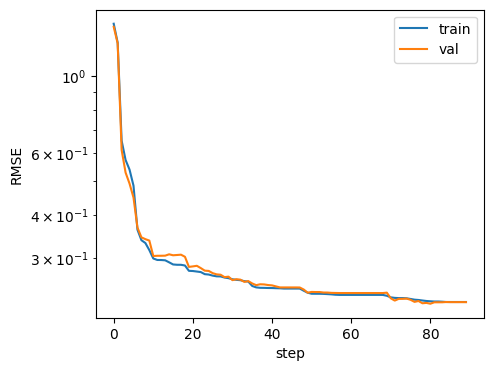

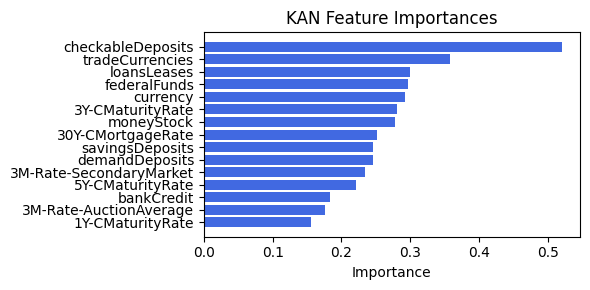

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  8.07it/s]


[('loansLeases', 0.17949663745793737), ('savingsDeposits', 0.05299893114147597), ('demandDeposits', 0.03694802139708329), ('1Y-CMaturityRate', 0.03188300698640801), ('3M-Rate-SecondaryMarket', 0.020402808168104716), ('bankCredit', 0.020165569015911648), ('5Y-CMaturityRate', 0.01959242568839164), ('checkableDeposits', 0.01759164413282027), ('federalFunds', 0.01544332942881045), ('3Y-CMaturityRate', 0.014109173295132461), ('moneyStock', 0.013690692434708277), ('30Y-CMortgageRate', 0.013573767839088327), ('3M-Rate-AuctionAverage', 0.011775137430855205), ('currency', 0.00957908324365105), ('tradeCurrencies', 0.003911462993848891), ('Ex1', 0.0023083776235580445)]


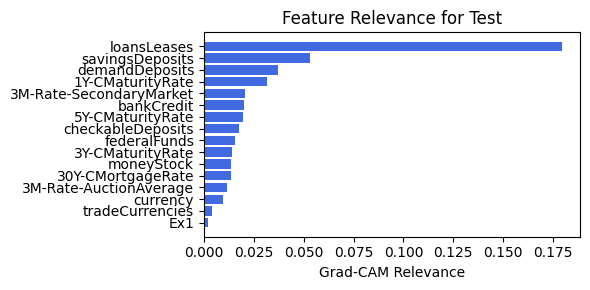

embed_dim: 64, num_head:4
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 2.24e-01 | eval_loss: 2.24e-01 | reg: 3.13e+01 |: 100%|█| 90/90 [00:24<00:00,  3.60it/


saving model version 0.1
Best epoch 80
0.27087223529815674
M_KAN Relevance: 0.06268934160470963
CNN Relevance: 0.9373106360435486
[('checkableDeposits', 0.5205964), ('tradeCurrencies', 0.35727343), ('loansLeases', 0.29890043), ('federalFunds', 0.29613063), ('currency', 0.29281345), ('3Y-CMaturityRate', 0.28131875), ('moneyStock', 0.27850065), ('30Y-CMortgageRate', 0.25179), ('savingsDeposits', 0.24651837), ('demandDeposits', 0.24628799), ('3M-Rate-SecondaryMarket', 0.23361593), ('5Y-CMaturityRate', 0.22042978), ('bankCredit', 0.18376836), ('3M-Rate-AuctionAverage', 0.17534845), ('1Y-CMaturityRate', 0.15572257)]


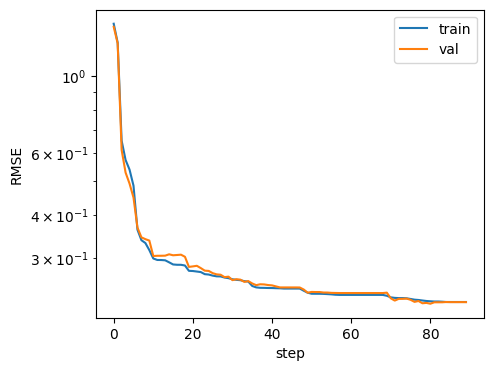

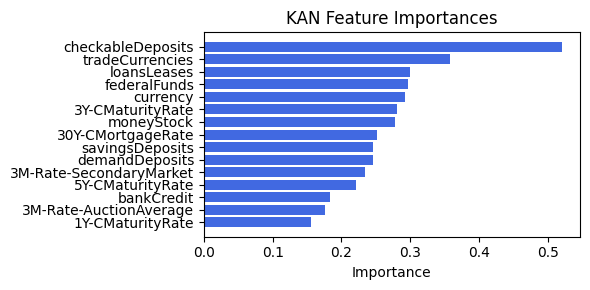

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.35it/s]


[('loansLeases', 0.17949663745793737), ('savingsDeposits', 0.05299893114147597), ('demandDeposits', 0.03694802139708329), ('1Y-CMaturityRate', 0.03188300698640801), ('3M-Rate-SecondaryMarket', 0.020402808168104716), ('bankCredit', 0.020165569015911648), ('5Y-CMaturityRate', 0.01959242568839164), ('checkableDeposits', 0.01759164413282027), ('federalFunds', 0.01544332942881045), ('3Y-CMaturityRate', 0.014109173295132461), ('moneyStock', 0.013690692434708277), ('30Y-CMortgageRate', 0.013573767839088327), ('3M-Rate-AuctionAverage', 0.011775137430855205), ('currency', 0.00957908324365105), ('tradeCurrencies', 0.003911462993848891), ('Ex1', 0.0023083776235580445)]


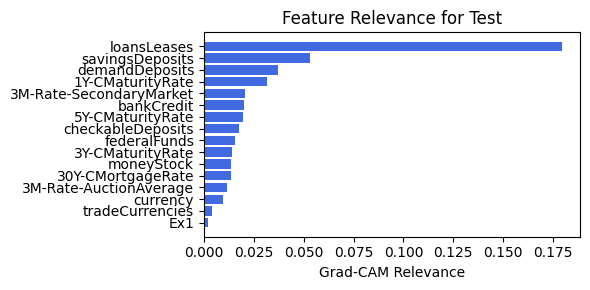

embed_dim: 64, num_head:8
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 2.41e-01 | eval_loss: 2.53e-01 | reg: 3.22e+01 |: 100%|█| 90/90 [00:22<00:00,  3.96it/


saving model version 0.1
Best epoch 51
0.28523537516593933
M_KAN Relevance: 0.04478868842124939
CNN Relevance: 0.9552112817764282
[('checkableDeposits', 0.5206868), ('tradeCurrencies', 0.35733074), ('loansLeases', 0.29899883), ('federalFunds', 0.29626128), ('currency', 0.2928928), ('3Y-CMaturityRate', 0.28136423), ('moneyStock', 0.27854788), ('30Y-CMortgageRate', 0.25185013), ('savingsDeposits', 0.24659336), ('demandDeposits', 0.24638185), ('3M-Rate-SecondaryMarket', 0.23367974), ('5Y-CMaturityRate', 0.22050023), ('bankCredit', 0.1838505), ('3M-Rate-AuctionAverage', 0.17543116), ('1Y-CMaturityRate', 0.15580228)]


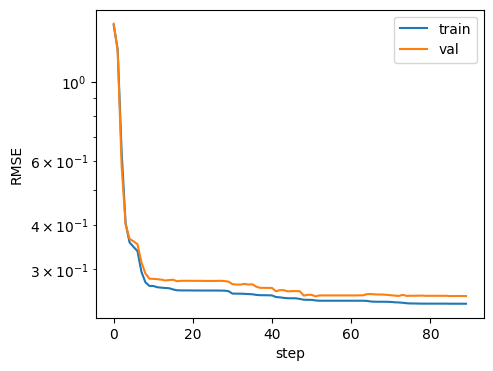

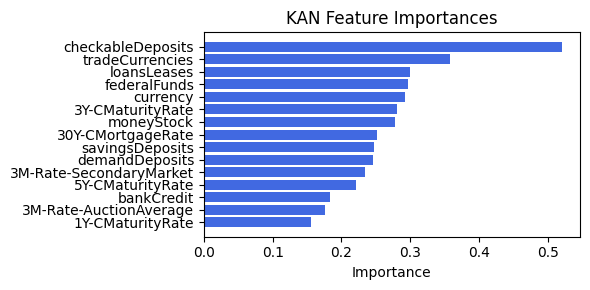

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.51it/s]

[('loansLeases', 0.2479617829656317), ('savingsDeposits', 0.09100853876942502), ('demandDeposits', 0.028636046179703303), ('1Y-CMaturityRate', 0.0267271787637756), ('3M-Rate-SecondaryMarket', 0.02315182282278935), ('bankCredit', 0.022323716964040483), ('5Y-CMaturityRate', 0.021311384439468384), ('currency', 0.016991154202038332), ('3Y-CMaturityRate', 0.01441477285365441), ('30Y-CMortgageRate', 0.012956314995175315), ('moneyStock', 0.012781144891466414), ('federalFunds', 0.012574800707045055), ('3M-Rate-AuctionAverage', 0.011021417361639795), ('checkableDeposits', 0.008338623724523046), ('tradeCurrencies', 0.004046566074802762), ('Ex1', 0.0029456857237077894)]


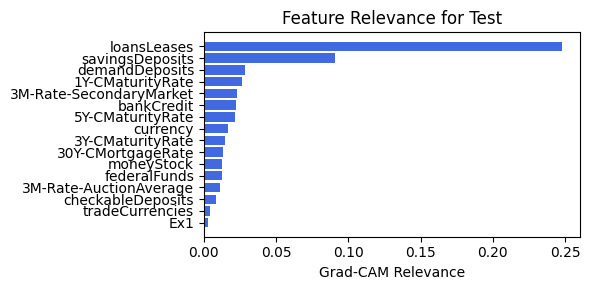

embed_dim: 32, num_head:2
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.85e-01 | eval_loss: 1.96e-01 | reg: 2.21e+01 |: 100%|█| 90/90 [00:36<00:00,  2.47it/

saving model version 0.1
Best epoch 60
0.24606440961360931
M_KAN Relevance: 0.03154339641332626
CNN Relevance: 0.9684566259384155
[('checkableDeposits', 0.5191649), ('tradeCurrencies', 0.35636365), ('loansLeases', 0.29734316), ('federalFunds', 0.2940609), ('currency', 0.2915589), ('3Y-CMaturityRate', 0.28059584), ('moneyStock', 0.27775162), ('30Y-CMortgageRate', 0.25083673), ('savingsDeposits', 0.2453349), ('demandDeposits', 0.24480294), ('3M-Rate-SecondaryMarket', 0.23260862), ('5Y-CMaturityRate', 0.21931788), ('bankCredit', 0.18246871), ('3M-Rate-AuctionAverage', 0.17403653), ('1Y-CMaturityRate', 0.15446511)]


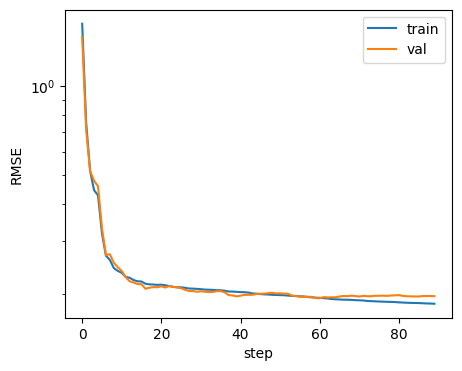

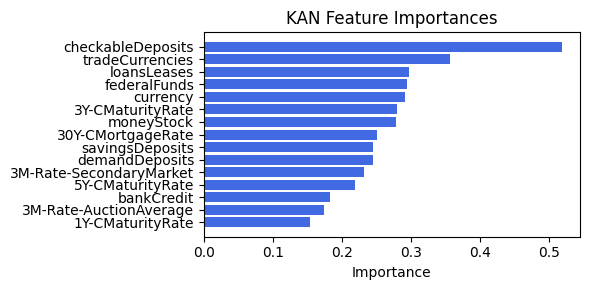

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.09it/s]


[('loansLeases', 0.1501560356257306), ('savingsDeposits', 0.046610020322813875), ('3M-Rate-SecondaryMarket', 0.03832605843033109), ('demandDeposits', 0.01056736640277363), ('currency', 0.009841594776316059), ('tradeCurrencies', 0.004460640508858931), ('1Y-CMaturityRate', 0.0017101906594775972), ('3M-Rate-AuctionAverage', 0.0008461869898296538), ('30Y-CMortgageRate', 0.00048774375269810356), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


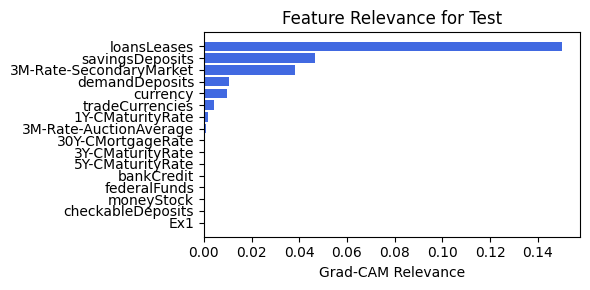

embed_dim: 32, num_head:4
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.86e-01 | eval_loss: 1.98e-01 | reg: 2.19e+01 |: 100%|█| 90/90 [00:30<00:00,  2.97it/

saving model version 0.1
Best epoch 62
0.24324862658977509
M_KAN Relevance: 0.03351369872689247
CNN Relevance: 0.9664862751960754
[('checkableDeposits', 0.519301), ('tradeCurrencies', 0.35645014), ('loansLeases', 0.29749095), ('federalFunds', 0.29425752), ('currency', 0.29167798), ('3Y-CMaturityRate', 0.28066462), ('moneyStock', 0.27782285), ('30Y-CMortgageRate', 0.2509273), ('savingsDeposits', 0.24544725), ('demandDeposits', 0.24494413), ('3M-Rate-SecondaryMarket', 0.23270433), ('5Y-CMaturityRate', 0.21942322), ('bankCredit', 0.18259212), ('3M-Rate-AuctionAverage', 0.17416118), ('1Y-CMaturityRate', 0.15458421)]


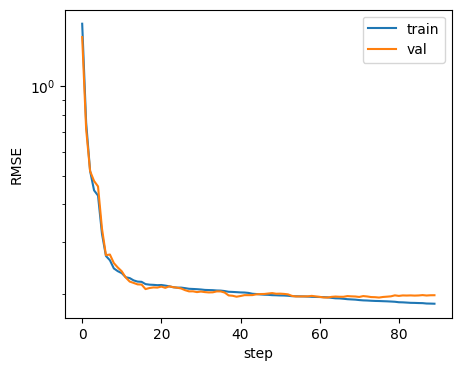

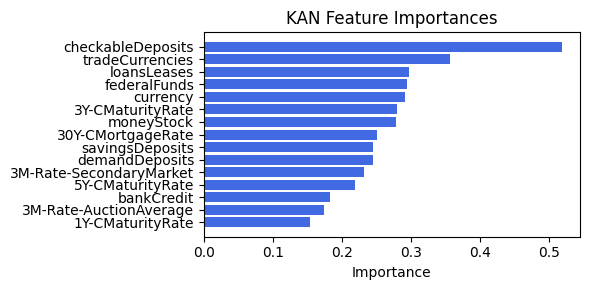

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  7.97it/s]


[('loansLeases', 0.1528215346059629), ('savingsDeposits', 0.04924967727136044), ('3M-Rate-SecondaryMarket', 0.03864800759724208), ('currency', 0.009624837540433787), ('demandDeposits', 0.008530567550943011), ('tradeCurrencies', 0.004155123252089003), ('1Y-CMaturityRate', 0.0021225106503282277), ('3M-Rate-AuctionAverage', 0.0008834484077635265), ('30Y-CMortgageRate', 0.0005992994865491277), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


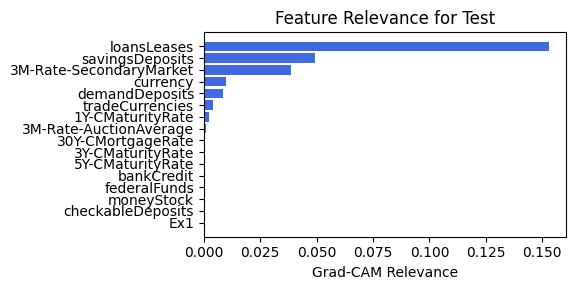

embed_dim: 32, num_head:8
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.85e-01 | eval_loss: 1.96e-01 | reg: 2.21e+01 |: 100%|█| 90/90 [00:29<00:00,  3.02it/

saving model version 0.1
Best epoch 60
0.24606440961360931
M_KAN Relevance: 0.03154339641332626
CNN Relevance: 0.9684566259384155
[('checkableDeposits', 0.5191649), ('tradeCurrencies', 0.35636365), ('loansLeases', 0.29734316), ('federalFunds', 0.2940609), ('currency', 0.2915589), ('3Y-CMaturityRate', 0.28059584), ('moneyStock', 0.27775162), ('30Y-CMortgageRate', 0.25083673), ('savingsDeposits', 0.2453349), ('demandDeposits', 0.24480294), ('3M-Rate-SecondaryMarket', 0.23260862), ('5Y-CMaturityRate', 0.21931788), ('bankCredit', 0.18246871), ('3M-Rate-AuctionAverage', 0.17403653), ('1Y-CMaturityRate', 0.15446511)]


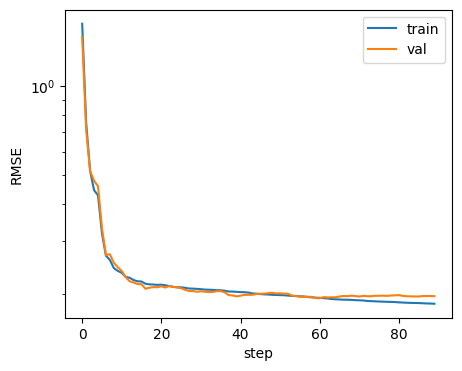

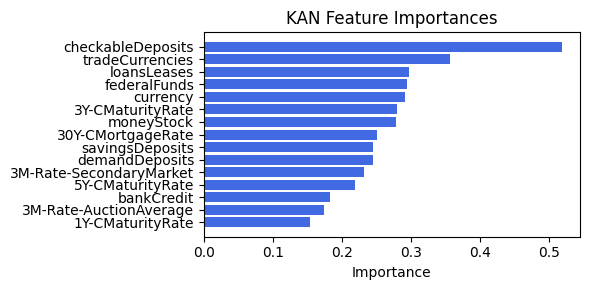

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.09it/s]

[('loansLeases', 0.1501560356257306), ('savingsDeposits', 0.046610020322813875), ('3M-Rate-SecondaryMarket', 0.03832605843033109), ('demandDeposits', 0.01056736640277363), ('currency', 0.009841594776316059), ('tradeCurrencies', 0.004460640508858931), ('1Y-CMaturityRate', 0.0017101906594775972), ('3M-Rate-AuctionAverage', 0.0008461869898296538), ('30Y-CMortgageRate', 0.00048774375269810356), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


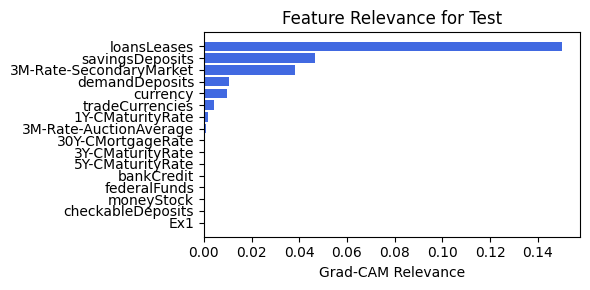

embed_dim: 16, num_head:2
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.58e-01 | eval_loss: 1.98e-01 | reg: 2.14e+01 |: 100%|█| 90/90 [00:28<00:00,  3.12it/

saving model version 0.1
Best epoch 89
0.23235571384429932
M_KAN Relevance: 0.24763458967208862
CNN Relevance: 0.7523654103279114
[('checkableDeposits', 0.50682634), ('tradeCurrencies', 0.34843737), ('loansLeases', 0.2841263), ('currency', 0.28101793), ('federalFunds', 0.2763932), ('3Y-CMaturityRate', 0.27439886), ('moneyStock', 0.27126423), ('30Y-CMortgageRate', 0.242587), ('savingsDeposits', 0.23542999), ('demandDeposits', 0.23205066), ('3M-Rate-SecondaryMarket', 0.2241233), ('5Y-CMaturityRate', 0.2101824), ('bankCredit', 0.1714141), ('3M-Rate-AuctionAverage', 0.16287506), ('1Y-CMaturityRate', 0.14409742)]


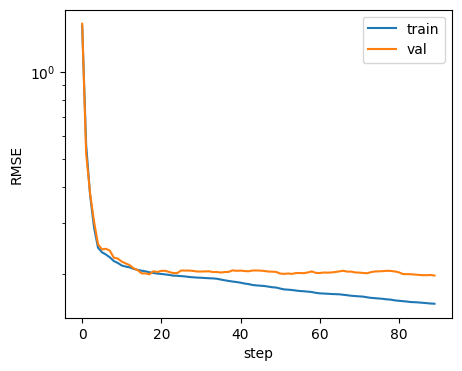

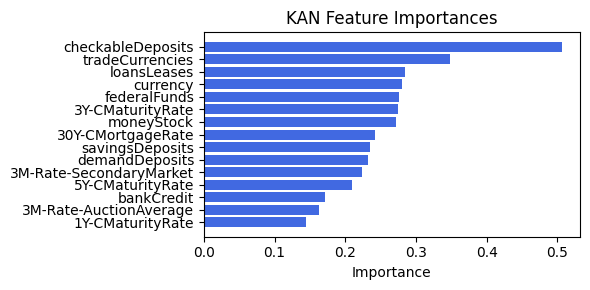

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  8.02it/s]

[('loansLeases', 0.2151029963223707), ('3M-Rate-SecondaryMarket', 0.1852505665449869), ('tradeCurrencies', 0.15141742115707268), ('savingsDeposits', 0.09549826512728551), ('currency', 0.0640221829625911), ('checkableDeposits', 0.027503476841818718), ('demandDeposits', 0.004102174365626914), ('Ex1', 0.002692730077320621), ('3M-Rate-AuctionAverage', 0.0023862311173053017), ('1Y-CMaturityRate', 0.0017595807001704261), ('30Y-CMortgageRate', 0.0016352231414722546), ('bankCredit', 0.00022319632227576914), ('5Y-CMaturityRate', 2.7454905487155927e-05), ('3Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0)]


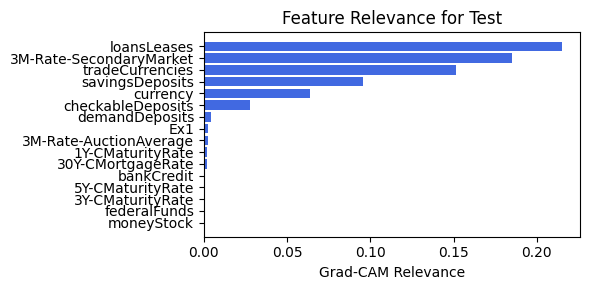

embed_dim: 16, num_head:4
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.52e-01 | eval_loss: 2.13e-01 | reg: 2.16e+01 |: 100%|█| 90/90 [00:28<00:00,  3.11it/

saving model version 0.1
Best epoch 51
0.23902159929275513
M_KAN Relevance: 0.10952167958021164
CNN Relevance: 0.8904783129692078
[('checkableDeposits', 0.51539165), ('tradeCurrencies', 0.35395992), ('loansLeases', 0.29325372), ('federalFunds', 0.288615), ('currency', 0.28827482), ('3Y-CMaturityRate', 0.2786941), ('moneyStock', 0.27577555), ('30Y-CMortgageRate', 0.2483226), ('savingsDeposits', 0.24224769), ('demandDeposits', 0.24089281), ('3M-Rate-SecondaryMarket', 0.22996986), ('5Y-CMaturityRate', 0.21641944), ('bankCredit', 0.17905329), ('3M-Rate-AuctionAverage', 0.17058931), ('1Y-CMaturityRate', 0.15119103)]


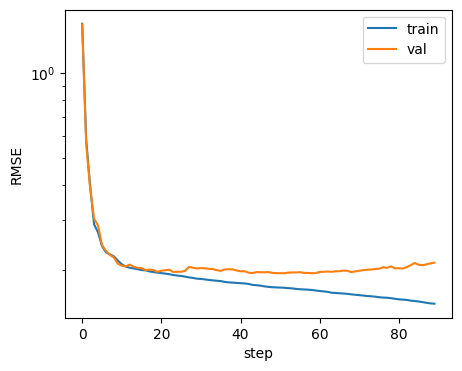

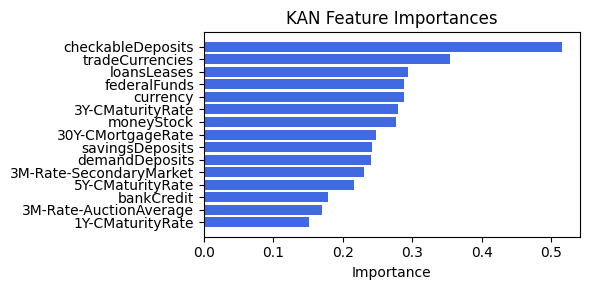

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.40it/s]

[('loansLeases', 0.35344926863908765), ('tradeCurrencies', 0.10023012363484927), ('currency', 0.0734699553677014), ('demandDeposits', 0.06904416595020198), ('3M-Rate-SecondaryMarket', 0.06573340401408218), ('checkableDeposits', 0.042607681878975456), ('savingsDeposits', 0.03238568120120492), ('Ex1', 0.008996093798694866), ('5Y-CMaturityRate', 0.007002910971641541), ('bankCredit', 0.006918571960358393), ('3Y-CMaturityRate', 0.005081438379628318), ('30Y-CMortgageRate', 0.00013067782745652257), ('3M-Rate-AuctionAverage', 3.256531254876227e-05), ('1Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0)]


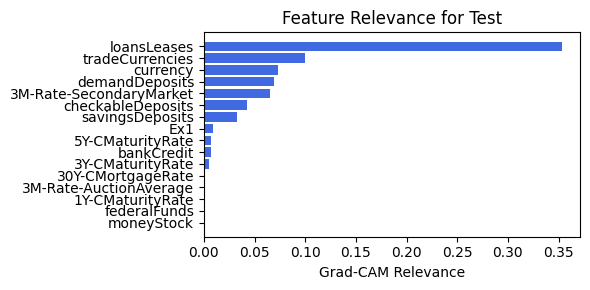

embed_dim: 16, num_head:8
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.46e-01 | eval_loss: 2.03e-01 | reg: 2.21e+01 |: 100%|█| 90/90 [00:27<00:00,  3.25it/

saving model version 0.1
Best epoch 38
0.23642690479755402
M_KAN Relevance: 0.23435905575752258
CNN Relevance: 0.765640914440155
[('checkableDeposits', 0.5171995), ('tradeCurrencies', 0.35511225), ('loansLeases', 0.29520968), ('federalFunds', 0.29122242), ('currency', 0.28984433), ('3Y-CMaturityRate', 0.2796046), ('moneyStock', 0.27672264), ('30Y-CMortgageRate', 0.24952692), ('savingsDeposits', 0.24372143), ('demandDeposits', 0.24276513), ('3M-Rate-SecondaryMarket', 0.23123114), ('5Y-CMaturityRate', 0.21780294), ('bankCredit', 0.18068796), ('3M-Rate-AuctionAverage', 0.17223917), ('1Y-CMaturityRate', 0.15275316)]


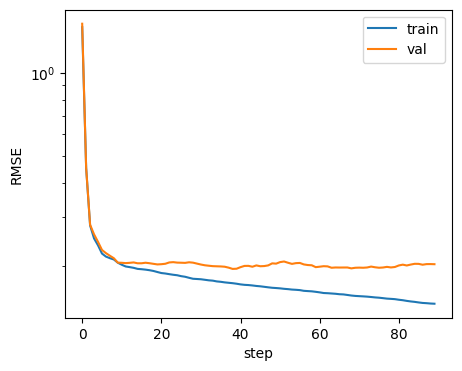

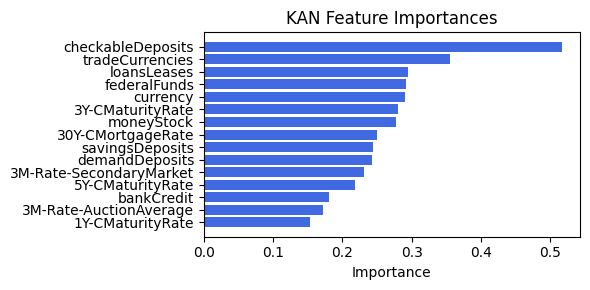

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.25it/s]

[('loansLeases', 0.1345957881637982), ('currency', 0.060467012049186794), ('3M-Rate-SecondaryMarket', 0.048438816233759834), ('demandDeposits', 0.013620918350560325), ('checkableDeposits', 0.010417057697971662), ('tradeCurrencies', 0.0018826490800295558), ('1Y-CMaturityRate', 0.0011244037321635654), ('savingsDeposits', 0.0008714241030420886), ('3M-Rate-AuctionAverage', 0.0007531124388887769), ('30Y-CMortgageRate', 0.0005450006807222963), ('bankCredit', 0.0003963153986703782), ('5Y-CMaturityRate', 0.0003651439434006101), ('Ex1', 0.00019902211746999196), ('3Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0)]


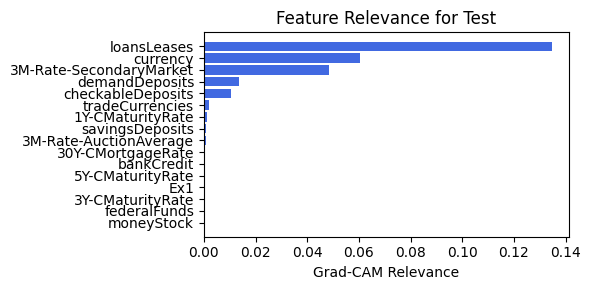

In [50]:
for embed_dim in [64, 32, 16]:
    for num_head in [2, 4 , 8]:
        print(f"embed_dim: {embed_dim}, num_head:{num_head}")
        train_and_plot_relevance(Model3_4, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=90, 
                                 embed_dim=embed_dim, num_heads=num_head, filename=filename_4, opt_col_val=f'{embed_dim}, {num_head}')

embed_dim: 48, num_head:6
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 2.01e-01 | eval_loss: 1.98e-01 | reg: 2.31e+01 |: 100%|█| 90/90 [00:30<00:00,  2.94it/

saving model version 0.1
Best epoch 80
0.24837258458137512
M_KAN Relevance: 0.08771241456270218
CNN Relevance: 0.9122875928878784
[('checkableDeposits', 0.5195718), ('tradeCurrencies', 0.35662276), ('loansLeases', 0.2977855), ('federalFunds', 0.2946487), ('currency', 0.29191506), ('3Y-CMaturityRate', 0.2808014), ('moneyStock', 0.27796492), ('30Y-CMortgageRate', 0.25110763), ('savingsDeposits', 0.24567062), ('demandDeposits', 0.24522498), ('3M-Rate-SecondaryMarket', 0.2328946), ('5Y-CMaturityRate', 0.21963298), ('bankCredit', 0.18283781), ('3M-Rate-AuctionAverage', 0.17440906), ('1Y-CMaturityRate', 0.15482135)]


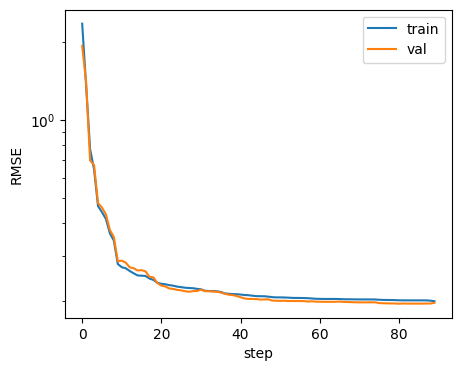

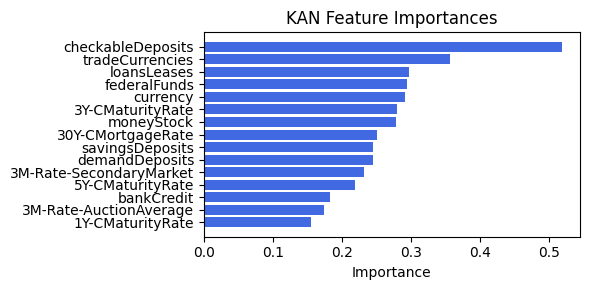

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.57it/s]

[('loansLeases', 0.25205081923133027), ('savingsDeposits', 0.07202841215933274), ('tradeCurrencies', 0.05313647129528579), ('demandDeposits', 0.0035623488620590902), ('3M-Rate-SecondaryMarket', 0.0017321277941976276), ('1Y-CMaturityRate', 0.001156803255989438), ('currency', 0.0002717745778638692), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


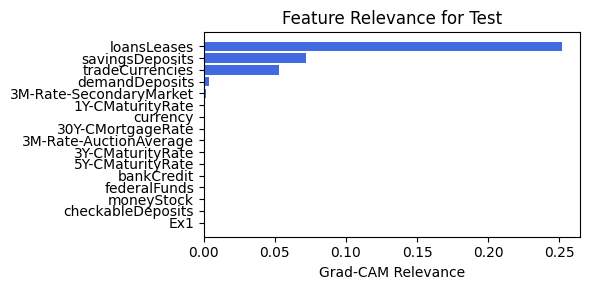

embed_dim: 24, num_head:6
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: nan | eval_loss: nan | reg: nan |: 100%|██████████████| 90/90 [00:26<00:00,  3.37it/s]

saving model version 0.1
Best epoch 2
0.47255662083625793
M_KAN Relevance: 0.04866770654916763
CNN Relevance: 0.9513322710990906
[('checkableDeposits', 0.52077794), ('tradeCurrencies', 0.3573886), ('loansLeases', 0.2990981), ('federalFunds', 0.29639328), ('currency', 0.292973), ('3Y-CMaturityRate', 0.28141046), ('moneyStock', 0.27859557), ('30Y-CMortgageRate', 0.25191087), ('savingsDeposits', 0.24666908), ('demandDeposits', 0.2464764), ('3M-Rate-SecondaryMarket', 0.23374406), ('5Y-CMaturityRate', 0.22057137), ('bankCredit', 0.18393336), ('3M-Rate-AuctionAverage', 0.17551482), ('1Y-CMaturityRate', 0.15588275)]


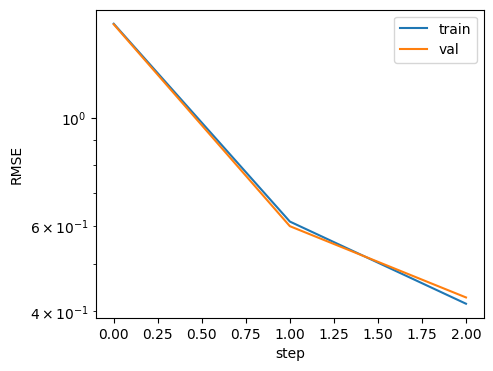

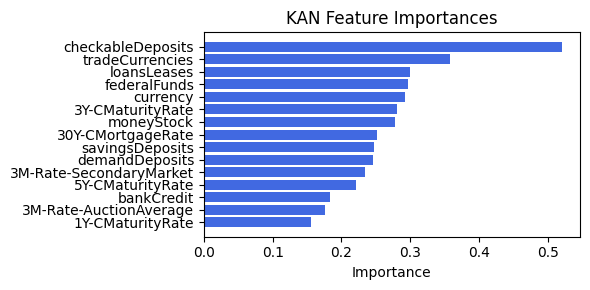

Computing Grad-CAM: 100%|██████████| 210/210 [00:27<00:00,  7.64it/s]

[('loansLeases', 0.22472333281877496), ('savingsDeposits', 0.05340025123607899), ('demandDeposits', 0.008960452640340441), ('3M-Rate-SecondaryMarket', 0.0019343078136444091), ('1Y-CMaturityRate', 0.0012416331540970576), ('currency', 0.00010140455727066312), ('checkableDeposits', 6.398640661722137e-05), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


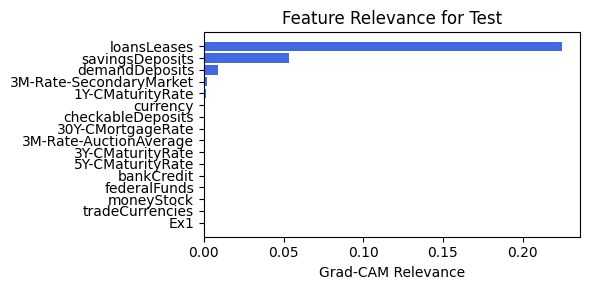

embed_dim: 12, num_head:6
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 2.54e-01 | eval_loss: 2.47e-01 | reg: 2.78e+01 |: 100%|█| 90/90 [00:20<00:00,  4.45it/


saving model version 0.1
Best epoch 84
0.308324933052063
M_KAN Relevance: 0.3410695195198059
CNN Relevance: 0.6589305400848389
[('checkableDeposits', 0.52076924), ('tradeCurrencies', 0.3573833), ('loansLeases', 0.29908872), ('federalFunds', 0.29638073), ('currency', 0.2929654), ('3Y-CMaturityRate', 0.28140604), ('moneyStock', 0.27859113), ('30Y-CMortgageRate', 0.25190505), ('savingsDeposits', 0.2466619), ('demandDeposits', 0.2464674), ('3M-Rate-SecondaryMarket', 0.23373789), ('5Y-CMaturityRate', 0.22056459), ('bankCredit', 0.18392545), ('3M-Rate-AuctionAverage', 0.17550693), ('1Y-CMaturityRate', 0.1558751)]


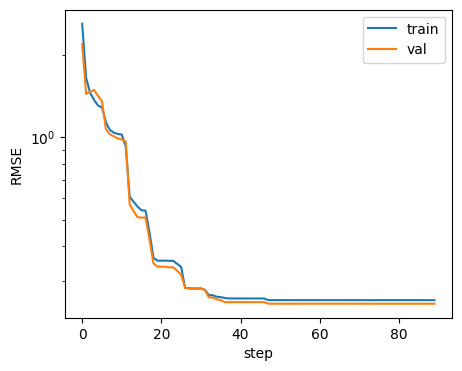

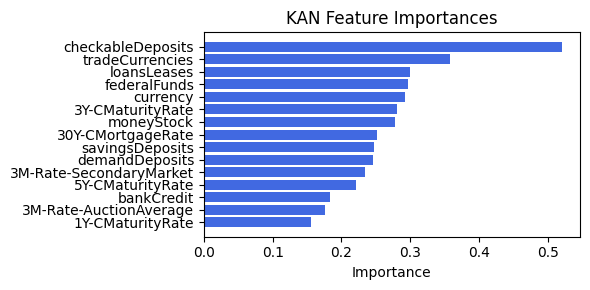

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  7.98it/s]


[('3M-Rate-SecondaryMarket', 0.39909893841970534), ('checkableDeposits', 0.20401476500555873), ('loansLeases', 0.10084088694836413), ('currency', 0.05161026464941512), ('savingsDeposits', 0.03509493021383172), ('3M-Rate-AuctionAverage', 0.019057417990240667), ('30Y-CMortgageRate', 0.018432024848395182), ('1Y-CMaturityRate', 0.016831660217472486), ('demandDeposits', 0.01213827964716724), ('federalFunds', 0.0021610763633535023), ('bankCredit', 0.0011622771931191285), ('5Y-CMaturityRate', 0.0008018017702159428), ('moneyStock', 0.0003898828512146359), ('3Y-CMaturityRate', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


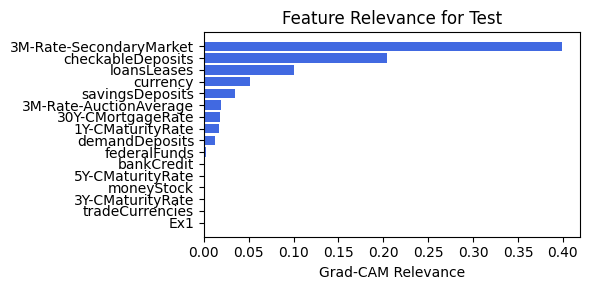

In [44]:
for embed_dim in [48, 24, 12]:
    for num_head in [6]:
        print(f"embed_dim: {embed_dim}, num_head:{num_head}")
        train_and_plot_relevance(Model3_4, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=90, 
                                 embed_dim=embed_dim, num_heads=num_head, filename=filename_4, opt_col_val=f'{embed_dim}, {num_head}')

### 4.1.0 width=[15, 6, 1], grid=5, lamb=1e-05 | embed_dim=64

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 2.46e-01 | eval_loss: 2.54e-01 | reg: 3.22e+01 |: 100%|█| 60/60 [00:16<00:00,  3.56it/


saving model version 0.1
Best epoch 51
0.28523537516593933
M_KAN Relevance: 0.04478868842124939
CNN Relevance: 0.9552112817764282
[('checkableDeposits', 0.5206868), ('tradeCurrencies', 0.35733074), ('loansLeases', 0.29899883), ('federalFunds', 0.29626128), ('currency', 0.2928928), ('3Y-CMaturityRate', 0.28136423), ('moneyStock', 0.27854788), ('30Y-CMortgageRate', 0.25185013), ('savingsDeposits', 0.24659336), ('demandDeposits', 0.24638185), ('3M-Rate-SecondaryMarket', 0.23367974), ('5Y-CMaturityRate', 0.22050023), ('bankCredit', 0.1838505), ('3M-Rate-AuctionAverage', 0.17543116), ('1Y-CMaturityRate', 0.15580228)]


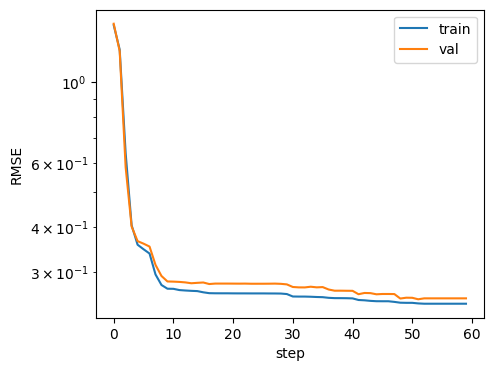

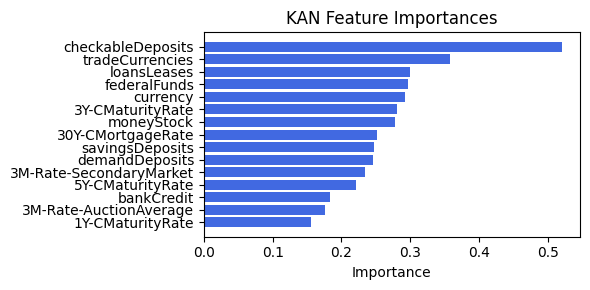

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.22it/s]

[('loansLeases', 0.2479617829656317), ('savingsDeposits', 0.09100853876942502), ('demandDeposits', 0.028636046179703303), ('1Y-CMaturityRate', 0.0267271787637756), ('3M-Rate-SecondaryMarket', 0.02315182282278935), ('bankCredit', 0.022323716964040483), ('5Y-CMaturityRate', 0.021311384439468384), ('currency', 0.016991154202038332), ('3Y-CMaturityRate', 0.01441477285365441), ('30Y-CMortgageRate', 0.012956314995175315), ('moneyStock', 0.012781144891466414), ('federalFunds', 0.012574800707045055), ('3M-Rate-AuctionAverage', 0.011021417361639795), ('checkableDeposits', 0.008338623724523046), ('tradeCurrencies', 0.004046566074802762), ('Ex1', 0.0029456857237077894)]


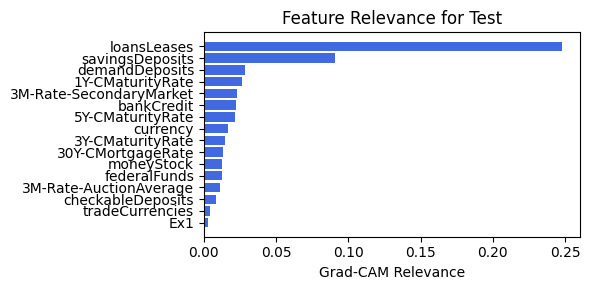

In [216]:
train_and_plot_relevance(Model3_4, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=60, embed_dim=64, filename=filename_4, opt_col_val=64)

### 4.1.1 width=[15, 6, 1], grid=5, lamb=1e-05 | embed_dim=64

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 2.47e-01 | eval_loss: 2.46e-01 | reg: 3.33e+01 |: 100%|█| 60/60 [00:16<00:00,  3.64it/


saving model version 0.1
Best epoch 57
0.27813419699668884
M_KAN Relevance: 0.08293607085943222
CNN Relevance: 0.9170638918876648
[('checkableDeposits', 0.5207181), ('tradeCurrencies', 0.35735065), ('loansLeases', 0.29903302), ('federalFunds', 0.29630673), ('currency', 0.2929204), ('3Y-CMaturityRate', 0.2813801), ('moneyStock', 0.27856427), ('30Y-CMortgageRate', 0.25187108), ('savingsDeposits', 0.24661934), ('demandDeposits', 0.24641427), ('3M-Rate-SecondaryMarket', 0.2337018), ('5Y-CMaturityRate', 0.22052479), ('bankCredit', 0.18387894), ('3M-Rate-AuctionAverage', 0.17546001), ('1Y-CMaturityRate', 0.15582997)]


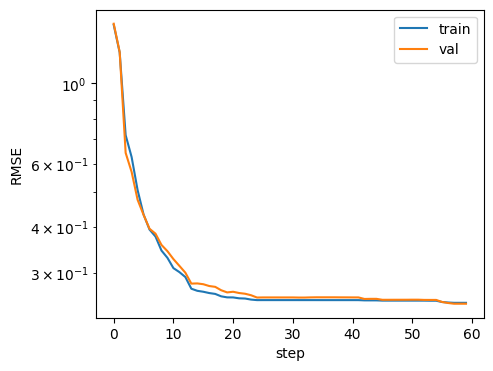

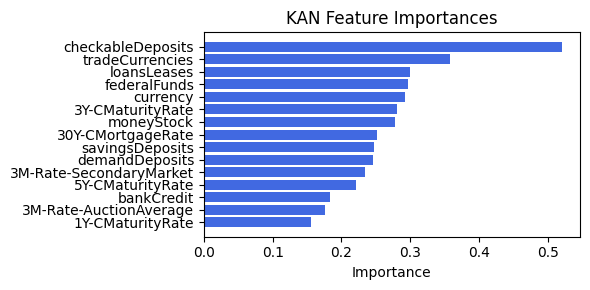

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.26it/s]

[('loansLeases', 0.25529041451352114), ('savingsDeposits', 0.10479802891537214), ('currency', 0.0739205183239565), ('3M-Rate-SecondaryMarket', 0.03441191156217385), ('checkableDeposits', 0.021290074643634613), ('5Y-CMaturityRate', 0.019742264048684212), ('bankCredit', 0.018204127877972844), ('demandDeposits', 0.011855597226392655), ('30Y-CMortgageRate', 0.004140157733733455), ('1Y-CMaturityRate', 0.003896844990196682), ('3Y-CMaturityRate', 0.003774265306336539), ('3M-Rate-AuctionAverage', 0.0030310801097324916), ('tradeCurrencies', 0.0018510230240367709), ('Ex1', 0.0011242732419521504), ('federalFunds', 0.0), ('moneyStock', 0.0)]


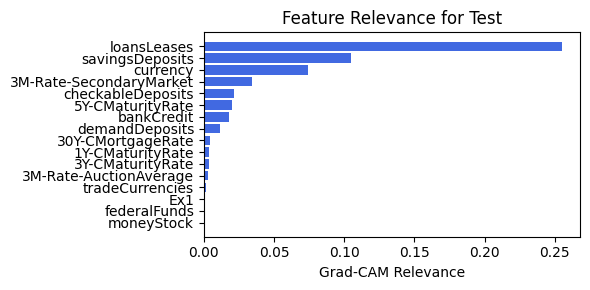

In [217]:
train_and_plot_relevance(Model3_4, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=60, embed_dim=64, filename=filename_4, opt_col_val=64)

### 4.1.2 width=[15, 6, 1], grid=5, lamb=1e-05 | embed_dim=32

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 2.01e-01 | eval_loss: 1.97e-01 | reg: 1.98e+01 |: 100%|█| 60/60 [00:20<00:00,  2.89it/

saving model version 0.1
Best epoch 59
0.2523465156555176
M_KAN Relevance: 0.009570922702550888
CNN Relevance: 0.9904291033744812
[('checkableDeposits', 0.5188061), ('tradeCurrencies', 0.35613525), ('loansLeases', 0.29695308), ('federalFunds', 0.29354244), ('currency', 0.29124558), ('3Y-CMaturityRate', 0.28041476), ('moneyStock', 0.27756405), ('30Y-CMortgageRate', 0.2505977), ('savingsDeposits', 0.24503976), ('demandDeposits', 0.24443083), ('3M-Rate-SecondaryMarket', 0.23235676), ('5Y-CMaturityRate', 0.21904068), ('bankCredit', 0.18214351), ('3M-Rate-AuctionAverage', 0.17370817), ('1Y-CMaturityRate', 0.15415184)]


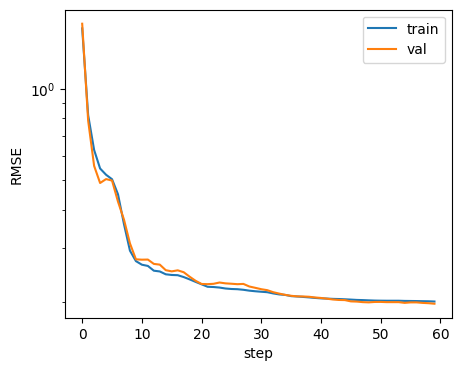

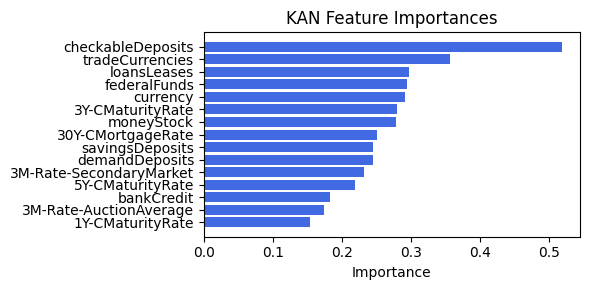

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.20it/s]

[('3M-Rate-SecondaryMarket', 0.08961107261157372), ('loansLeases', 0.07034751211620113), ('demandDeposits', 0.015813555249146054), ('savingsDeposits', 0.011087230142826835), ('currency', 0.006486243045046216), ('1Y-CMaturityRate', 0.005895123577543668), ('checkableDeposits', 0.005185785091349057), ('3M-Rate-AuctionAverage', 0.0029685765637883117), ('30Y-CMortgageRate', 0.0028035067287938936), ('bankCredit', 0.00014400509673924674), ('5Y-CMaturityRate', 8.842342843612035e-05), ('3Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


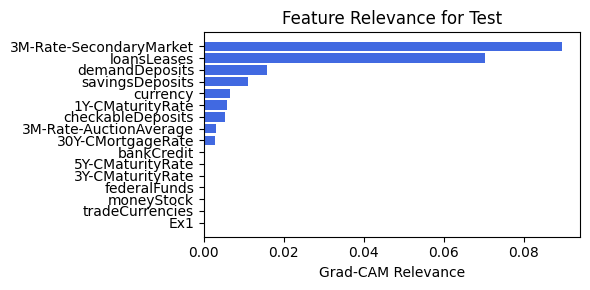

In [218]:
train_and_plot_relevance(Model3_4, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=60, embed_dim=32, filename=filename_4, opt_col_val=32)

### 4.1.3 width=[15, 6, 1], grid=5, lamb=1e-05 | embed_dim=32

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.64e-01 | eval_loss: 1.96e-01 | reg: 2.38e+01 |: 100%|█| 60/60 [00:20<00:00,  2.96it/

saving model version 0.1
Best epoch 44
0.23745492100715637
M_KAN Relevance: 0.16286605596542358
CNN Relevance: 0.8371339440345764
[('checkableDeposits', 0.5109024), ('tradeCurrencies', 0.35107923), ('loansLeases', 0.28843528), ('currency', 0.28443038), ('federalFunds', 0.28217924), ('3Y-CMaturityRate', 0.27643883), ('moneyStock', 0.27341622), ('30Y-CMortgageRate', 0.24532364), ('savingsDeposits', 0.23864499), ('demandDeposits', 0.23625207), ('3M-Rate-SecondaryMarket', 0.22687827), ('5Y-CMaturityRate', 0.21307868), ('bankCredit', 0.17502652), ('3M-Rate-AuctionAverage', 0.16652381), ('1Y-CMaturityRate', 0.14740978)]


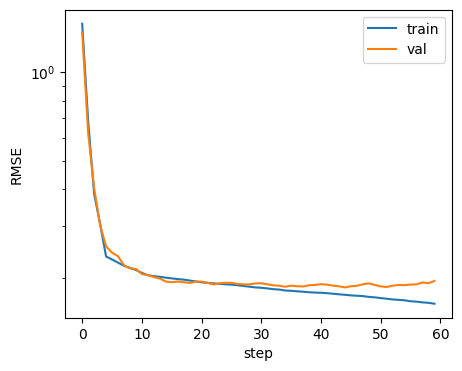

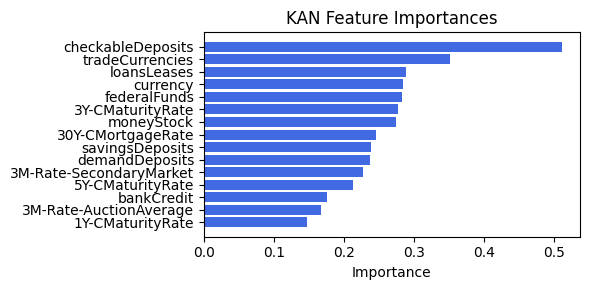

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.20it/s]


[('tradeCurrencies', 0.2390859149485117), ('loansLeases', 0.12707211815369582), ('3M-Rate-SecondaryMarket', 0.056949990433419036), ('savingsDeposits', 0.048877326680147756), ('checkableDeposits', 0.009005957061336153), ('currency', 0.008385062514848652), ('demandDeposits', 0.006307942526126724), ('1Y-CMaturityRate', 0.0026652809210299024), ('Ex1', 0.0011589247910749345), ('30Y-CMortgageRate', 0.00022342771380430177), ('5Y-CMaturityRate', 0.00017483607821521305), ('3M-Rate-AuctionAverage', 4.9519392528704234e-05), ('bankCredit', 1.6881444580143407e-05), ('3Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0)]


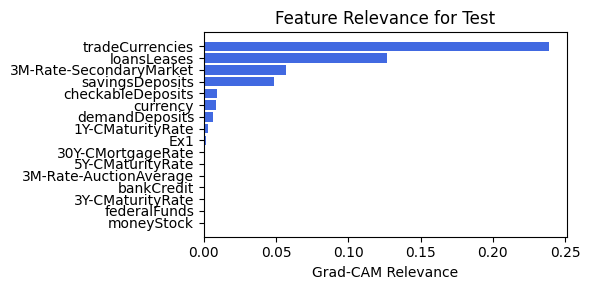

In [219]:
train_and_plot_relevance(Model3_4, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=60, embed_dim=32, filename=filename_4, opt_col_val=32)

### 4.1.4 width=[15, 6, 1], grid=5, lamb=1e-05 | embed_dim=16

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.68e-01 | eval_loss: 1.94e-01 | reg: 2.19e+01 |: 100%|█| 60/60 [00:20<00:00,  2.91it/

saving model version 0.1
Best epoch 56
0.22995947301387787
M_KAN Relevance: 0.09531738609075546
CNN Relevance: 0.9046825766563416
[('checkableDeposits', 0.5154352), ('tradeCurrencies', 0.35398346), ('loansLeases', 0.29330352), ('federalFunds', 0.2886852), ('currency', 0.28831714), ('3Y-CMaturityRate', 0.2787158), ('moneyStock', 0.27579647), ('30Y-CMortgageRate', 0.24834952), ('savingsDeposits', 0.24228898), ('demandDeposits', 0.24093768), ('3M-Rate-SecondaryMarket', 0.23000515), ('5Y-CMaturityRate', 0.21646605), ('bankCredit', 0.1790983), ('3M-Rate-AuctionAverage', 0.17063454), ('1Y-CMaturityRate', 0.15124163)]


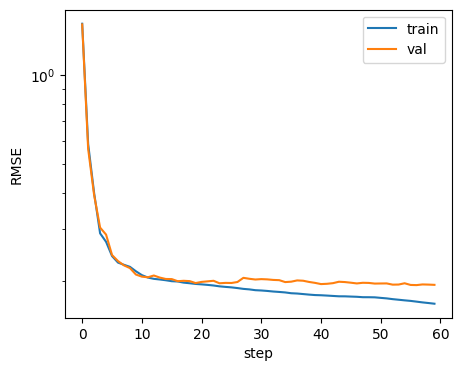

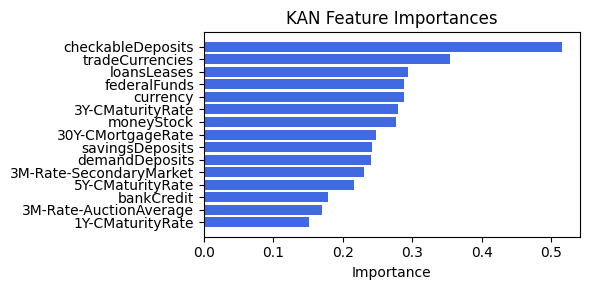

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.25it/s]


[('loansLeases', 0.2983201678310122), ('tradeCurrencies', 0.11723541156167076), ('demandDeposits', 0.07188047556472676), ('currency', 0.06894495224668866), ('3M-Rate-SecondaryMarket', 0.046444353055475014), ('savingsDeposits', 0.03459307071004462), ('checkableDeposits', 0.03279929686160315), ('3Y-CMaturityRate', 0.022440745034033344), ('Ex1', 0.014419935220142914), ('bankCredit', 0.0010413553743135362), ('5Y-CMaturityRate', 0.0009367084019773063), ('30Y-CMortgageRate', 0.00028696734280813307), ('3M-Rate-AuctionAverage', 0.0002809277779999233), ('1Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0)]


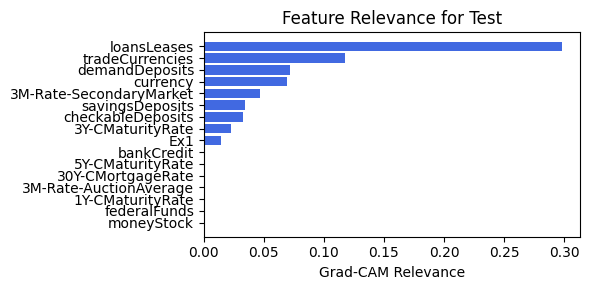

In [220]:
train_and_plot_relevance(Model3_4, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=60, embed_dim=16, filename=filename_4, opt_col_val=16)

### 4.1.5 width=[15, 6, 1], grid=5, lamb=1e-05 | embed_dim=16

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.69e-01 | eval_loss: 1.95e-01 | reg: 2.14e+01 |: 100%|█| 60/60 [00:20<00:00,  2.87it/

saving model version 0.1
Best epoch 51
0.23902159929275513
M_KAN Relevance: 0.10952167958021164
CNN Relevance: 0.8904783129692078
[('checkableDeposits', 0.51539165), ('tradeCurrencies', 0.35395992), ('loansLeases', 0.29325372), ('federalFunds', 0.288615), ('currency', 0.28827482), ('3Y-CMaturityRate', 0.2786941), ('moneyStock', 0.27577555), ('30Y-CMortgageRate', 0.2483226), ('savingsDeposits', 0.24224769), ('demandDeposits', 0.24089281), ('3M-Rate-SecondaryMarket', 0.22996986), ('5Y-CMaturityRate', 0.21641944), ('bankCredit', 0.17905329), ('3M-Rate-AuctionAverage', 0.17058931), ('1Y-CMaturityRate', 0.15119103)]


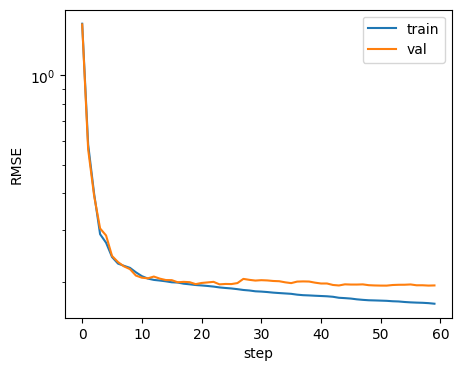

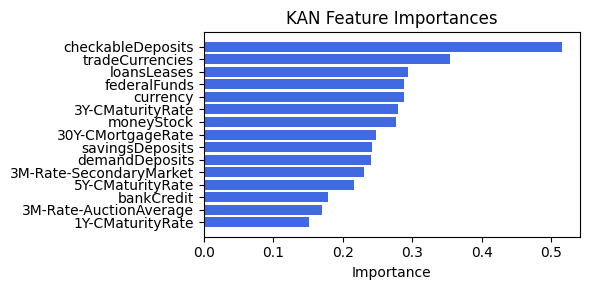

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.43it/s]


[('loansLeases', 0.35344926863908765), ('tradeCurrencies', 0.10023012363484927), ('currency', 0.0734699553677014), ('demandDeposits', 0.06904416595020198), ('3M-Rate-SecondaryMarket', 0.06573340401408218), ('checkableDeposits', 0.042607681878975456), ('savingsDeposits', 0.03238568120120492), ('Ex1', 0.008996093798694866), ('5Y-CMaturityRate', 0.007002910971641541), ('bankCredit', 0.006918571960358393), ('3Y-CMaturityRate', 0.005081438379628318), ('30Y-CMortgageRate', 0.00013067782745652257), ('3M-Rate-AuctionAverage', 3.256531254876227e-05), ('1Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0)]


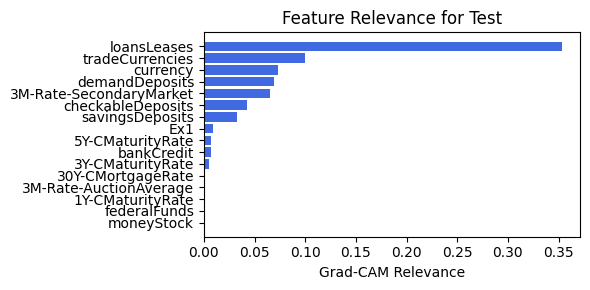

In [221]:
train_and_plot_relevance(Model3_4, kan_neurons=6, kan_grid=5, lamb=1e-05, steps=60, embed_dim=16, filename=filename_4, opt_col_val=16)

## 4.2 width=[15, 1, 1], grid=5, lamb=1e-05

embed_dim: 64, num_head:2
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.60e-01 | eval_loss: 1.98e-01 | reg: 1.68e+01 |: 100%|█| 90/90 [00:28<00:00,  3.17it/

saving model version 0.1
Best epoch 31
0.2419394999742508
M_KAN Relevance: 7.02967299730517e-05
CNN Relevance: 0.999929666519165
[('currency', 0.31620774), ('loansLeases', 0.30207857), ('bankCredit', 0.28090337), ('5Y-CMaturityRate', 0.26335794), ('tradeCurrencies', 0.2088664), ('3M-Rate-AuctionAverage', 0.20225553), ('savingsDeposits', 0.19845773), ('1Y-CMaturityRate', 0.17058371), ('checkableDeposits', 0.15505344), ('moneyStock', 0.09689472), ('3M-Rate-SecondaryMarket', 0.08935592), ('demandDeposits', 0.08157203), ('3Y-CMaturityRate', 0.053326607), ('federalFunds', 0.05293022), ('30Y-CMortgageRate', 0.037793543)]


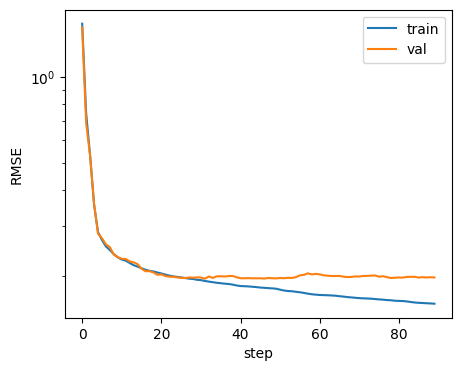

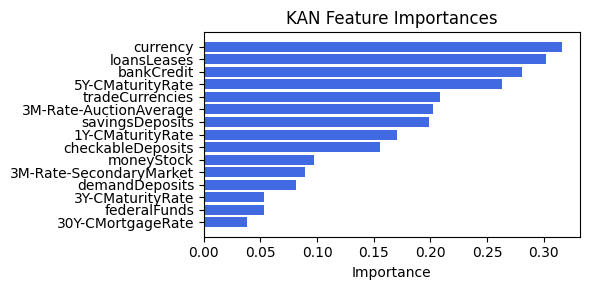

Computing Grad-CAM: 100%|██████████| 210/210 [00:17<00:00, 11.95it/s]


[('checkableDeposits', 0.01518556425968806), ('3M-Rate-SecondaryMarket', 0.013118437961453483), ('loansLeases', 0.0109211603729775), ('currency', 0.004549287259578705), ('1Y-CMaturityRate', 0.0013799339532852173), ('savingsDeposits', 0.0003202272734294335), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


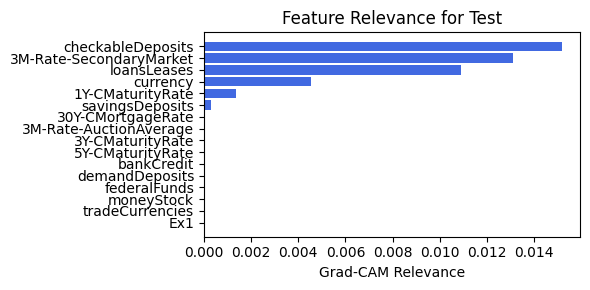

embed_dim: 64, num_head:4
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.60e-01 | eval_loss: 1.93e-01 | reg: 1.69e+01 |: 100%|█| 90/90 [00:34<00:00,  2.63it/

saving model version 0.1
Best epoch 81
0.22936849296092987
M_KAN Relevance: 0.0005429635057225823
CNN Relevance: 0.999457061290741
[('currency', 0.32525596), ('loansLeases', 0.30725563), ('bankCredit', 0.2902134), ('5Y-CMaturityRate', 0.27132568), ('tradeCurrencies', 0.21044022), ('3M-Rate-AuctionAverage', 0.20378017), ('savingsDeposits', 0.1967128), ('1Y-CMaturityRate', 0.16993497), ('checkableDeposits', 0.14008568), ('moneyStock', 0.08991907), ('3M-Rate-SecondaryMarket', 0.08013575), ('demandDeposits', 0.06755172), ('3Y-CMaturityRate', 0.041308764), ('30Y-CMortgageRate', 0.019955644), ('federalFunds', 0.01939391)]


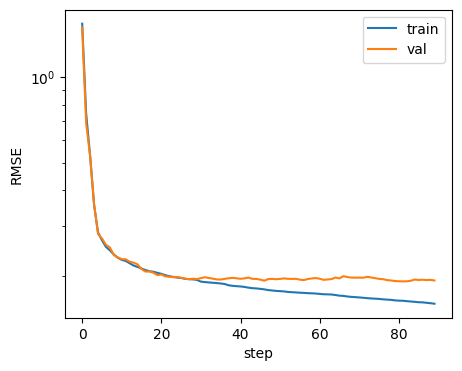

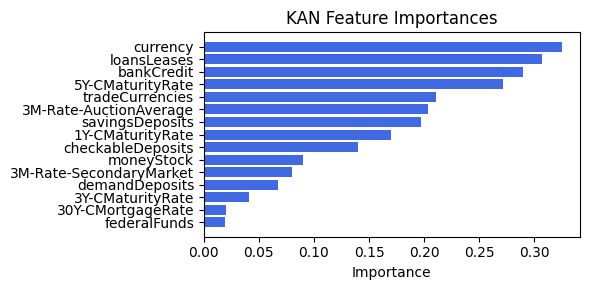

Computing Grad-CAM: 100%|██████████| 210/210 [00:16<00:00, 12.45it/s]


[('loansLeases', 0.10573589870307062), ('currency', 0.03960950461083225), ('checkableDeposits', 0.01768081457841964), ('3M-Rate-SecondaryMarket', 0.01597111935732842), ('savingsDeposits', 0.012608577314919482), ('1Y-CMaturityRate', 0.0009566605800674075), ('demandDeposits', 0.00032342399977746284), ('30Y-CMortgageRate', 4.2021673704896655e-05), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


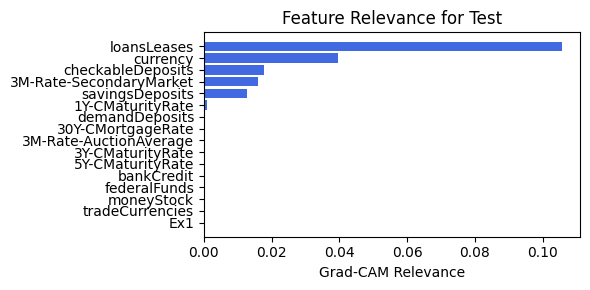

embed_dim: 64, num_head:8
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.58e-01 | eval_loss: 1.96e-01 | reg: 1.67e+01 |: 100%|█| 90/90 [00:28<00:00,  3.15it/

saving model version 0.1
Best epoch 50
0.2381841093301773
M_KAN Relevance: 0.00018806217121891677
CNN Relevance: 0.9998119473457336
[('currency', 0.32079852), ('loansLeases', 0.30477974), ('bankCredit', 0.28560093), ('5Y-CMaturityRate', 0.26739115), ('tradeCurrencies', 0.20975862), ('3M-Rate-AuctionAverage', 0.20311818), ('savingsDeposits', 0.19773346), ('1Y-CMaturityRate', 0.1703736), ('checkableDeposits', 0.1479157), ('moneyStock', 0.09357435), ('3M-Rate-SecondaryMarket', 0.08496109), ('demandDeposits', 0.07475344), ('3Y-CMaturityRate', 0.0474131), ('federalFunds', 0.037406024), ('30Y-CMortgageRate', 0.029184025)]


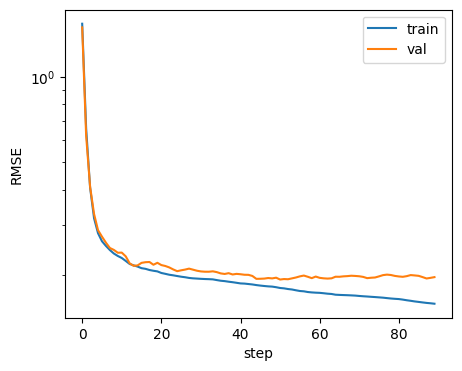

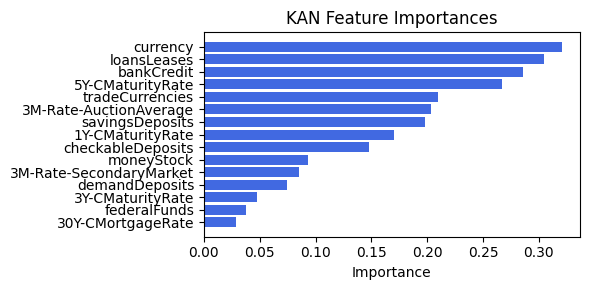

Computing Grad-CAM: 100%|██████████| 210/210 [00:16<00:00, 12.46it/s]


[('loansLeases', 0.0746852899591128), ('demandDeposits', 0.018367858829775027), ('3M-Rate-SecondaryMarket', 0.013189003900403068), ('savingsDeposits', 0.006773473599570847), ('1Y-CMaturityRate', 0.004790728060262543), ('tradeCurrencies', 0.004164218945827867), ('3M-Rate-AuctionAverage', 0.002043228702885764), ('30Y-CMortgageRate', 0.0007106257159085501), ('currency', 0.00027535524928853623), ('bankCredit', 0.00021786862274720555), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


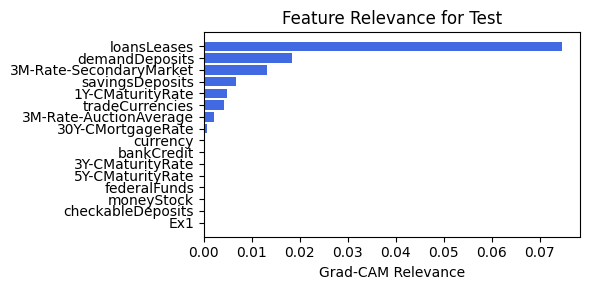

embed_dim: 32, num_head:2
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.43e-01 | eval_loss: 1.94e-01 | reg: 1.19e+01 |: 100%|█| 90/90 [00:28<00:00,  3.18it/

saving model version 0.1
Best epoch 76
0.2216547429561615
M_KAN Relevance: 0.07152002304792404
CNN Relevance: 0.9284799098968506
[('currency', 0.3337579), ('loansLeases', 0.31182122), ('bankCredit', 0.29906377), ('5Y-CMaturityRate', 0.27884945), ('tradeCurrencies', 0.21154554), ('3M-Rate-AuctionAverage', 0.20485762), ('savingsDeposits', 0.19442922), ('1Y-CMaturityRate', 0.16884677), ('checkableDeposits', 0.1242339), ('moneyStock', 0.082499504), ('3M-Rate-SecondaryMarket', 0.07032057), ('demandDeposits', 0.05390212), ('3Y-CMaturityRate', 0.030541841), ('federalFunds', 0.015974082), ('30Y-CMortgageRate', 0.00910917)]


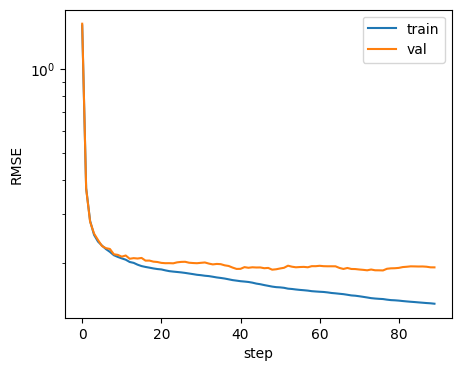

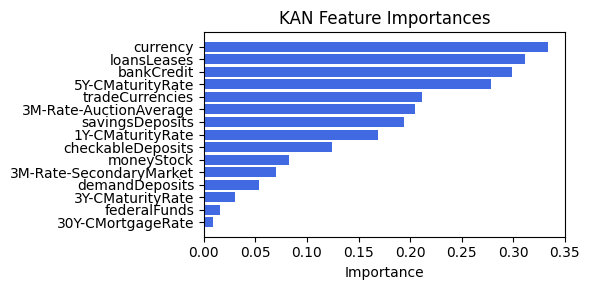

Computing Grad-CAM: 100%|██████████| 210/210 [00:16<00:00, 12.92it/s]


[('1Y-CMaturityRate', 0.3833148416597396), ('30Y-CMortgageRate', 0.14590133243196068), ('3M-Rate-AuctionAverage', 0.13430304044768923), ('loansLeases', 0.1055538815191193), ('3Y-CMaturityRate', 0.09753301802058038), ('demandDeposits', 0.08346495353616774), ('Ex1', 0.0530090946881544), ('savingsDeposits', 0.039478431793187545), ('tradeCurrencies', 0.036495427966916134), ('3M-Rate-SecondaryMarket', 0.03618889588535586), ('currency', 0.031310977267899685), ('moneyStock', 0.02029022005874486), ('checkableDeposits', 0.019629954119002268), ('federalFunds', 0.013173872877156273), ('5Y-CMaturityRate', 0.0018829195272354853), ('bankCredit', 0.0012451809786614917)]


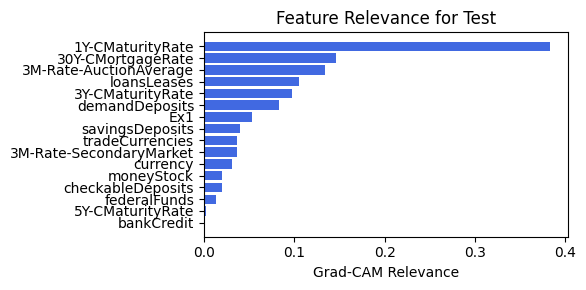

embed_dim: 32, num_head:4
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.37e-01 | eval_loss: 1.93e-01 | reg: 1.28e+01 |: 100%|█| 90/90 [00:29<00:00,  3.09it/

saving model version 0.1
Best epoch 84
0.22218279540538788
M_KAN Relevance: 0.02749594673514366
CNN Relevance: 0.9725040793418884
[('currency', 0.3341777), ('loansLeases', 0.3123054), ('bankCredit', 0.29940608), ('5Y-CMaturityRate', 0.2791884), ('tradeCurrencies', 0.21192792), ('3M-Rate-AuctionAverage', 0.20522767), ('savingsDeposits', 0.19487102), ('1Y-CMaturityRate', 0.1692065), ('checkableDeposits', 0.12491876), ('moneyStock', 0.082866356), ('3M-Rate-SecondaryMarket', 0.07073533), ('demandDeposits', 0.054340318), ('3Y-CMaturityRate', 0.0308135), ('federalFunds', 0.013510054), ('30Y-CMortgageRate', 0.009250355)]


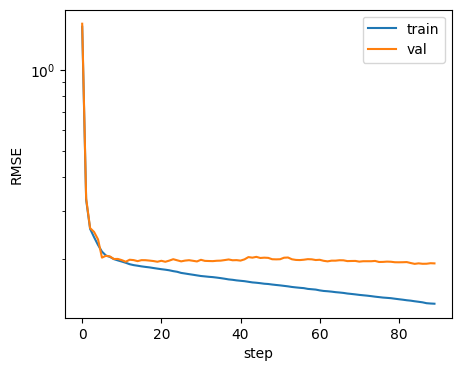

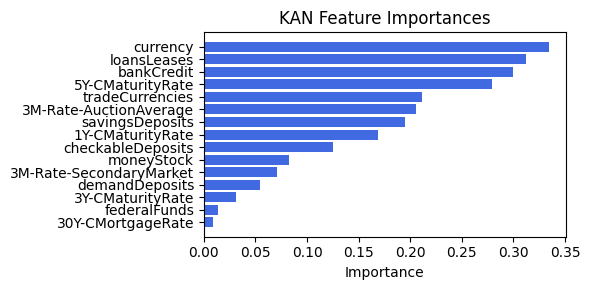

Computing Grad-CAM: 100%|██████████| 210/210 [00:15<00:00, 13.29it/s]


[('1Y-CMaturityRate', 0.1819314887863584), ('3M-Rate-SecondaryMarket', 0.15996937058156446), ('currency', 0.1430616186169486), ('moneyStock', 0.11089155290530817), ('checkableDeposits', 0.10063000311631531), ('3M-Rate-AuctionAverage', 0.05455777392046349), ('30Y-CMortgageRate', 0.049408066038761585), ('loansLeases', 0.04779763928880649), ('savingsDeposits', 0.024542075010859185), ('demandDeposits', 0.022843717905925588), ('tradeCurrencies', 0.012890584756331962), ('Ex1', 0.005415823907103567), ('federalFunds', 0.004140129946089084), ('5Y-CMaturityRate', 0.0034775264350520004), ('bankCredit', 0.0030633540291871344), ('3Y-CMaturityRate', 0.0024857152312982916)]


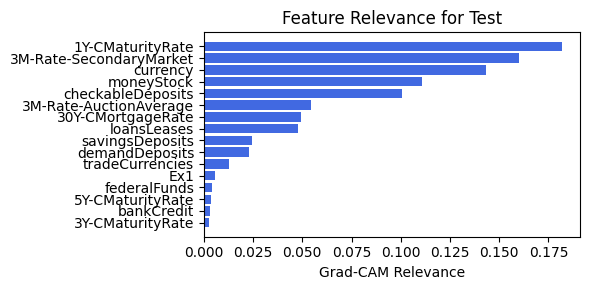

embed_dim: 32, num_head:8
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.43e-01 | eval_loss: 1.94e-01 | reg: 1.19e+01 |: 100%|█| 90/90 [00:27<00:00,  3.32it/

saving model version 0.1
Best epoch 76
0.2216547429561615
M_KAN Relevance: 0.07152002304792404
CNN Relevance: 0.9284799098968506
[('currency', 0.3337579), ('loansLeases', 0.31182122), ('bankCredit', 0.29906377), ('5Y-CMaturityRate', 0.27884945), ('tradeCurrencies', 0.21154554), ('3M-Rate-AuctionAverage', 0.20485762), ('savingsDeposits', 0.19442922), ('1Y-CMaturityRate', 0.16884677), ('checkableDeposits', 0.1242339), ('moneyStock', 0.082499504), ('3M-Rate-SecondaryMarket', 0.07032057), ('demandDeposits', 0.05390212), ('3Y-CMaturityRate', 0.030541841), ('federalFunds', 0.015974082), ('30Y-CMortgageRate', 0.00910917)]


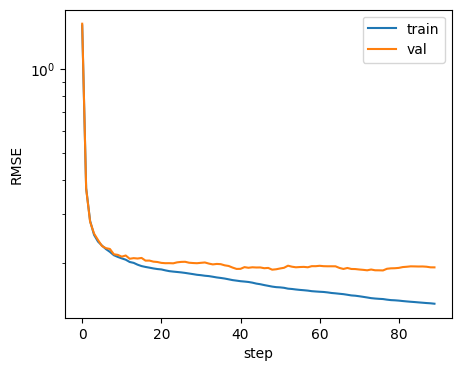

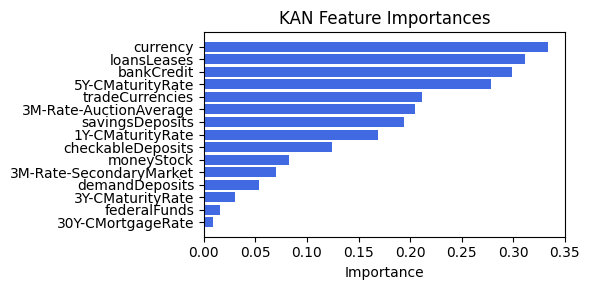

Computing Grad-CAM: 100%|██████████| 210/210 [00:16<00:00, 13.00it/s]


[('1Y-CMaturityRate', 0.3833148416597396), ('30Y-CMortgageRate', 0.14590133243196068), ('3M-Rate-AuctionAverage', 0.13430304044768923), ('loansLeases', 0.1055538815191193), ('3Y-CMaturityRate', 0.09753301802058038), ('demandDeposits', 0.08346495353616774), ('Ex1', 0.0530090946881544), ('savingsDeposits', 0.039478431793187545), ('tradeCurrencies', 0.036495427966916134), ('3M-Rate-SecondaryMarket', 0.03618889588535586), ('currency', 0.031310977267899685), ('moneyStock', 0.02029022005874486), ('checkableDeposits', 0.019629954119002268), ('federalFunds', 0.013173872877156273), ('5Y-CMaturityRate', 0.0018829195272354853), ('bankCredit', 0.0012451809786614917)]


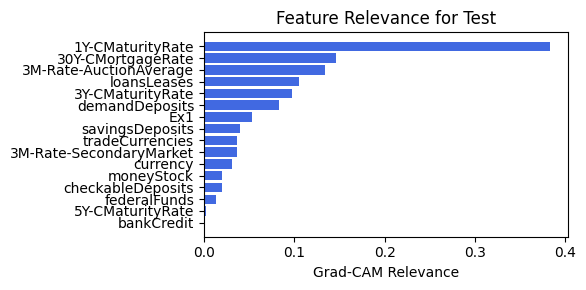

embed_dim: 16, num_head:2
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 2.00e-01 | eval_loss: 1.92e-01 | reg: 1.20e+01 |: 100%|█| 90/90 [00:27<00:00,  3.27it/

saving model version 0.1
Best epoch 87
0.23930878937244415
M_KAN Relevance: 0.20221902430057526
CNN Relevance: 0.7977809906005859
[('currency', 0.31581956), ('loansLeases', 0.3018472), ('bankCredit', 0.28050694), ('5Y-CMaturityRate', 0.26301694), ('tradeCurrencies', 0.20878711), ('3M-Rate-AuctionAverage', 0.20217909), ('savingsDeposits', 0.19851194), ('1Y-CMaturityRate', 0.17059623), ('checkableDeposits', 0.15563673), ('moneyStock', 0.097165935), ('3M-Rate-SecondaryMarket', 0.08971512), ('demandDeposits', 0.08213686), ('federalFunds', 0.054177333), ('3Y-CMaturityRate', 0.05381983), ('30Y-CMortgageRate', 0.03849871)]


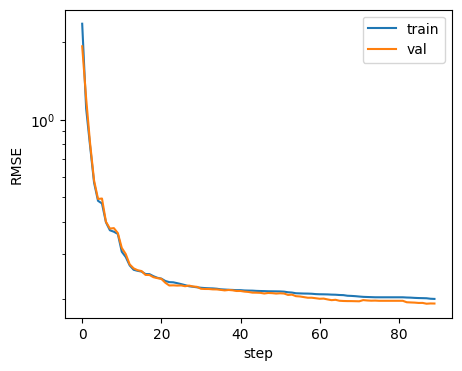

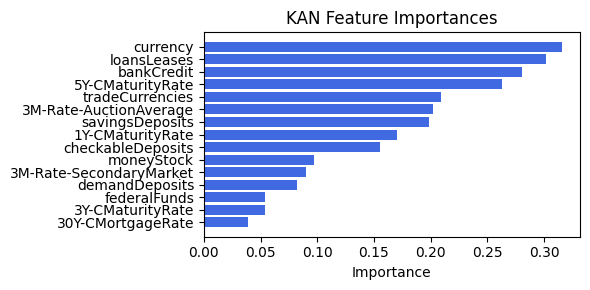

Computing Grad-CAM: 100%|██████████| 210/210 [00:17<00:00, 12.18it/s]


[('loansLeases', 0.07164787056390196), ('savingsDeposits', 0.005330087067115874), ('demandDeposits', 0.0033485768540274527), ('1Y-CMaturityRate', 0.0012943717695417859), ('3M-Rate-SecondaryMarket', 0.00018455051772651217), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


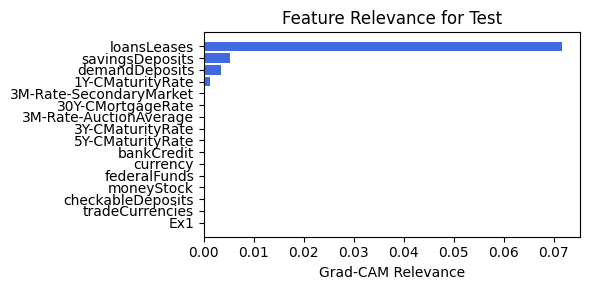

embed_dim: 16, num_head:4
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.77e-01 | eval_loss: 1.99e-01 | reg: 1.29e+01 |: 100%|█| 90/90 [00:28<00:00,  3.19it/

saving model version 0.1
Best epoch 77
0.25257763266563416
M_KAN Relevance: 0.11003424227237701
CNN Relevance: 0.8899657726287842
[('currency', 0.31920546), ('loansLeases', 0.30384895), ('bankCredit', 0.2839695), ('5Y-CMaturityRate', 0.26599103), ('tradeCurrencies', 0.20945534), ('3M-Rate-AuctionAverage', 0.20282498), ('savingsDeposits', 0.19799533), ('1Y-CMaturityRate', 0.17045459), ('checkableDeposits', 0.15041894), ('moneyStock', 0.094739676), ('3M-Rate-SecondaryMarket', 0.08650328), ('demandDeposits', 0.077127844), ('3Y-CMaturityRate', 0.04946248), ('federalFunds', 0.04287006), ('30Y-CMortgageRate', 0.032183334)]


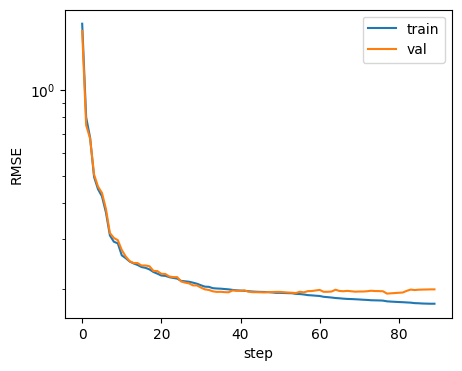

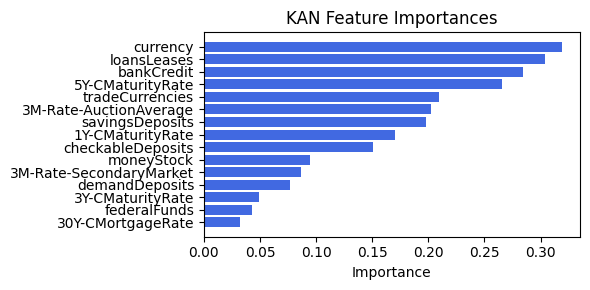

Computing Grad-CAM: 100%|██████████| 210/210 [00:17<00:00, 12.27it/s]


[('loansLeases', 0.10207635155779177), ('1Y-CMaturityRate', 0.06480952481783572), ('savingsDeposits', 0.04932345540340369), ('demandDeposits', 0.014528008089179084), ('3M-Rate-SecondaryMarket', 0.005499576706261862), ('30Y-CMortgageRate', 0.0023457784161326433), ('tradeCurrencies', 0.001716424970488463), ('3M-Rate-AuctionAverage', 0.0016578719374679383), ('bankCredit', 0.00010234520194076356), ('currency', 8.609099313616753e-06), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


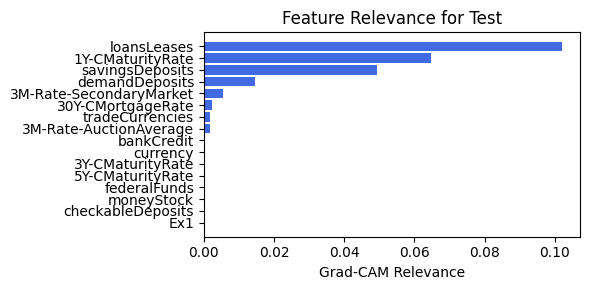

embed_dim: 16, num_head:8
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 2.00e-01 | eval_loss: 1.92e-01 | reg: 1.20e+01 |: 100%|█| 90/90 [00:36<00:00,  2.50it/

saving model version 0.1
Best epoch 87
0.23930878937244415
M_KAN Relevance: 0.20221902430057526
CNN Relevance: 0.7977809906005859
[('currency', 0.31581956), ('loansLeases', 0.3018472), ('bankCredit', 0.28050694), ('5Y-CMaturityRate', 0.26301694), ('tradeCurrencies', 0.20878711), ('3M-Rate-AuctionAverage', 0.20217909), ('savingsDeposits', 0.19851194), ('1Y-CMaturityRate', 0.17059623), ('checkableDeposits', 0.15563673), ('moneyStock', 0.097165935), ('3M-Rate-SecondaryMarket', 0.08971512), ('demandDeposits', 0.08213686), ('federalFunds', 0.054177333), ('3Y-CMaturityRate', 0.05381983), ('30Y-CMortgageRate', 0.03849871)]


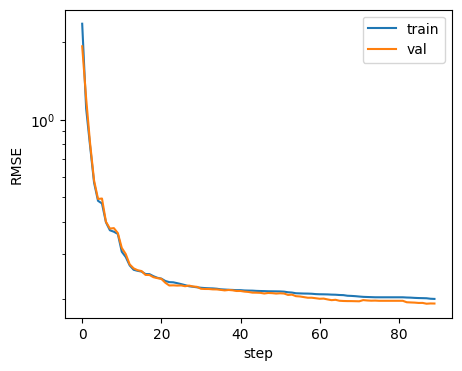

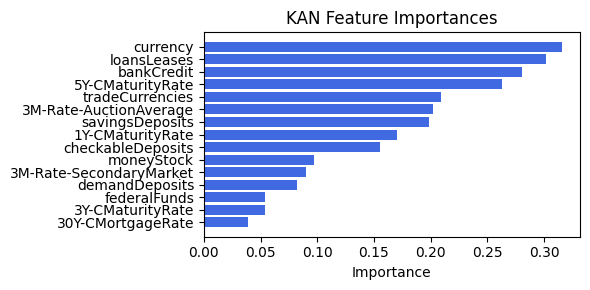

Computing Grad-CAM: 100%|██████████| 210/210 [00:17<00:00, 11.99it/s]


[('loansLeases', 0.07164787056390196), ('savingsDeposits', 0.005330087067115874), ('demandDeposits', 0.0033485768540274527), ('1Y-CMaturityRate', 0.0012943717695417859), ('3M-Rate-SecondaryMarket', 0.00018455051772651217), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


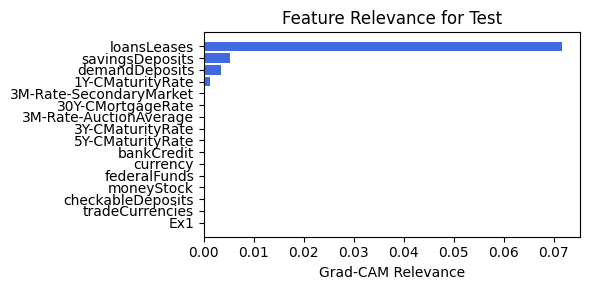

In [51]:
for embed_dim in [64, 32, 16]:
    for num_head in [2, 4 , 8]:
        print(f"embed_dim: {embed_dim}, num_head:{num_head}")
        train_and_plot_relevance(Model3_4, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=90, 
                                 embed_dim=embed_dim, num_heads=num_head, filename=filename_4, opt_col_val=f'{embed_dim}, {num_head}')

embed_dim: 48, num_head:6
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 2.10e-01 | eval_loss: 2.13e-01 | reg: 1.40e+01 |: 100%|█| 90/90 [01:03<00:00,  1.42it/


saving model version 0.1
Best epoch 86
0.2525887191295624
M_KAN Relevance: 6.715398922096938e-05
CNN Relevance: 0.9999328255653381
[('currency', 0.31445011), ('loansLeases', 0.30102915), ('bankCredit', 0.2791092), ('5Y-CMaturityRate', 0.26181537), ('tradeCurrencies', 0.20850639), ('3M-Rate-AuctionAverage', 0.20190702), ('savingsDeposits', 0.19870259), ('1Y-CMaturityRate', 0.17063987), ('checkableDeposits', 0.15769562), ('moneyStock', 0.09812277), ('3M-Rate-SecondaryMarket', 0.0909817), ('demandDeposits', 0.084134966), ('federalFunds', 0.058588304), ('3Y-CMaturityRate', 0.055568103), ('30Y-CMortgageRate', 0.04099752)]


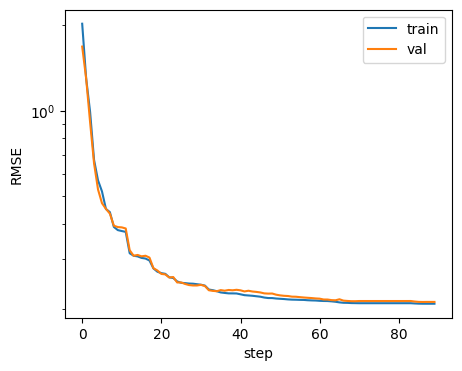

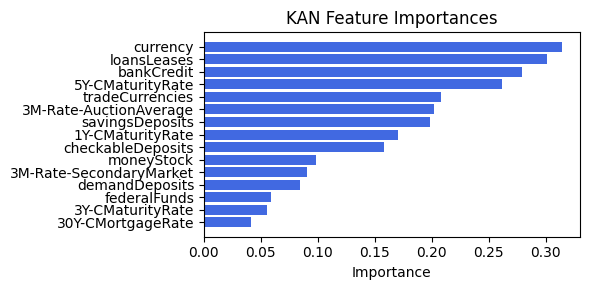

Computing Grad-CAM: 100%|██████████| 210/210 [00:16<00:00, 12.41it/s]

[('loansLeases', 0.22812664860061238), ('savingsDeposits', 0.03763872638921298), ('demandDeposits', 0.009290502690488384), ('1Y-CMaturityRate', 0.00848609903339474), ('3M-Rate-AuctionAverage', 0.0037007492922601247), ('3M-Rate-SecondaryMarket', 0.0017544149598550229), ('30Y-CMortgageRate', 0.0008801842197066262), ('3Y-CMaturityRate', 0.0007359340166052182), ('currency', 0.00044157313449042185), ('bankCredit', 0.00024413459801248143), ('5Y-CMaturityRate', 7.634884012596948e-05), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


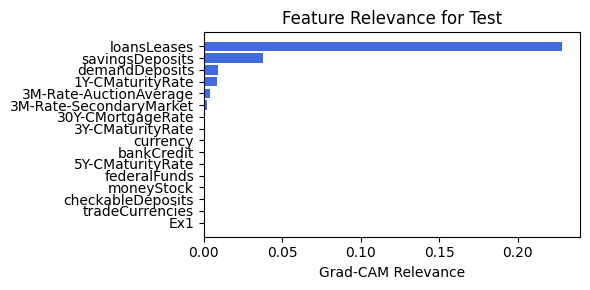

embed_dim: 24, num_head:6
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.32e-01 | eval_loss: 2.18e-01 | reg: 1.42e+01 |: 100%|█| 90/90 [00:34<00:00,  2.62it/

saving model version 0.1
Best epoch 59
0.24124830961227417
M_KAN Relevance: 0.0027367277070879936
CNN Relevance: 0.9972632527351379
[('currency', 0.32670745), ('loansLeases', 0.308022), ('bankCredit', 0.2917302), ('5Y-CMaturityRate', 0.27261174), ('tradeCurrencies', 0.21061088), ('3M-Rate-AuctionAverage', 0.2039464), ('savingsDeposits', 0.19629315), ('1Y-CMaturityRate', 0.16972743), ('checkableDeposits', 0.13730168), ('moneyStock', 0.08861316), ('3M-Rate-SecondaryMarket', 0.07841849), ('demandDeposits', 0.065064974), ('3Y-CMaturityRate', 0.039249714), ('30Y-CMortgageRate', 0.016898315), ('federalFunds', 0.012823)]


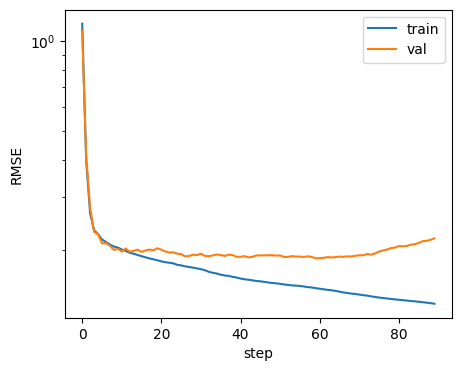

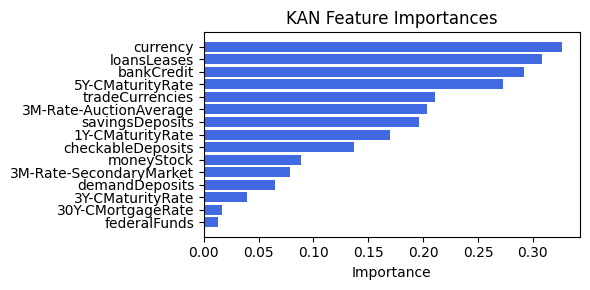

Computing Grad-CAM: 100%|██████████| 210/210 [00:16<00:00, 12.57it/s]


[('checkableDeposits', 0.6273348207984651), ('3M-Rate-SecondaryMarket', 0.572968332694533), ('currency', 0.4622533167518365), ('Ex1', 0.0751558732418787), ('5Y-CMaturityRate', 1.7241497768000476e-05), ('1Y-CMaturityRate', 0.0), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('loansLeases', 0.0), ('savingsDeposits', 0.0), ('tradeCurrencies', 0.0)]


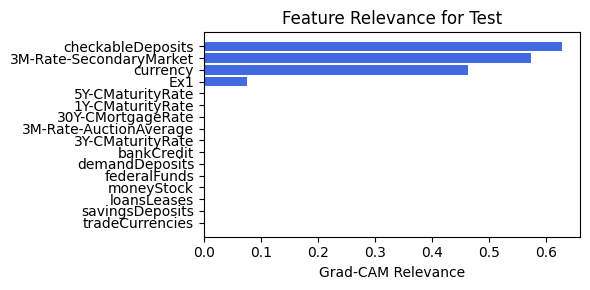

embed_dim: 12, num_head:6
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.44e-01 | eval_loss: 1.99e-01 | reg: 1.38e+01 |: 100%|█| 90/90 [00:31<00:00,  2.84it/

saving model version 0.1
Best epoch 37
0.24607808887958527
M_KAN Relevance: 0.00671464903280139
CNN Relevance: 0.9932852983474731
[('currency', 0.3190724), ('loansLeases', 0.30376884), ('bankCredit', 0.2838331), ('5Y-CMaturityRate', 0.26587433), ('tradeCurrencies', 0.20942894), ('3M-Rate-AuctionAverage', 0.20279965), ('savingsDeposits', 0.19801532), ('1Y-CMaturityRate', 0.17045963), ('checkableDeposits', 0.15062276), ('moneyStock', 0.094834454), ('3M-Rate-SecondaryMarket', 0.08662867), ('demandDeposits', 0.07732286), ('3Y-CMaturityRate', 0.049631707), ('federalFunds', 0.043306734), ('30Y-CMortgageRate', 0.032427214)]


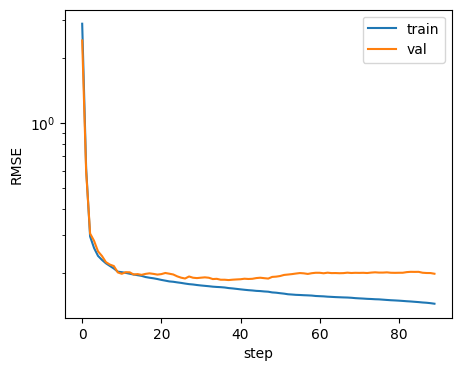

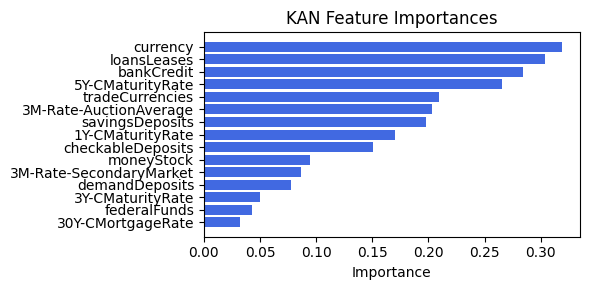

Computing Grad-CAM: 100%|██████████| 210/210 [00:17<00:00, 12.16it/s]


[('loansLeases', 0.2582096551711272), ('3M-Rate-SecondaryMarket', 0.1031437333052357), ('savingsDeposits', 0.08667433043786635), ('demandDeposits', 0.05995356320359167), ('currency', 0.05281784260822903), ('tradeCurrencies', 0.051902877220085686), ('checkableDeposits', 0.012155470630109666), ('1Y-CMaturityRate', 0.005290276849908488), ('30Y-CMortgageRate', 0.004007254651237634), ('3M-Rate-AuctionAverage', 0.0031810465667928968), ('bankCredit', 8.784150261254538e-05), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('Ex1', 0.0)]


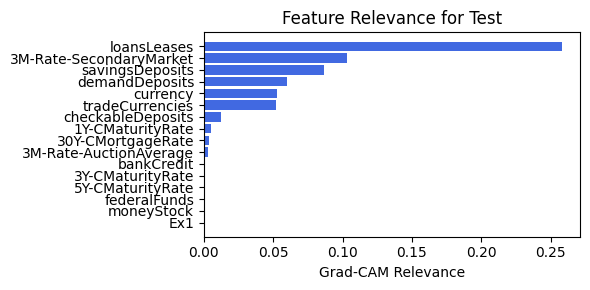

In [42]:
for embed_dim in [48, 24, 12]:
    for num_head in [6]:
        print(f"embed_dim: {embed_dim}, num_head:{num_head}")
        train_and_plot_relevance(Model3_4, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=90, 
                                 embed_dim=embed_dim, num_heads=num_head, filename=filename_4, opt_col_val=f'{embed_dim}, {num_head}')

### 4.2.0 width=[15, 1, 1], grid=5, lamb=1e-05 | embed_dim=64

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.73e-01 | eval_loss: 1.97e-01 | reg: 1.75e+01 |: 100%|█| 60/60 [00:20<00:00,  2.87it/

saving model version 0.1
Best epoch 50
0.2381841093301773
M_KAN Relevance: 0.00018806217121891677
CNN Relevance: 0.9998119473457336
[('currency', 0.32079852), ('loansLeases', 0.30477974), ('bankCredit', 0.28560093), ('5Y-CMaturityRate', 0.26739115), ('tradeCurrencies', 0.20975862), ('3M-Rate-AuctionAverage', 0.20311818), ('savingsDeposits', 0.19773346), ('1Y-CMaturityRate', 0.1703736), ('checkableDeposits', 0.1479157), ('moneyStock', 0.09357435), ('3M-Rate-SecondaryMarket', 0.08496109), ('demandDeposits', 0.07475344), ('3Y-CMaturityRate', 0.0474131), ('federalFunds', 0.037406024), ('30Y-CMortgageRate', 0.029184025)]


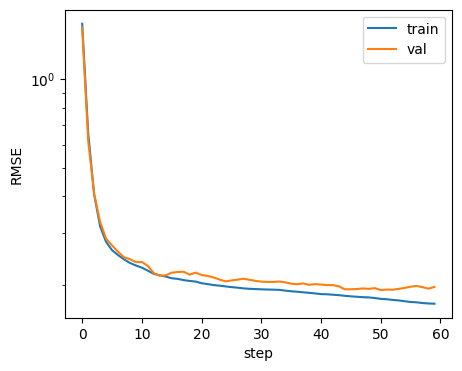

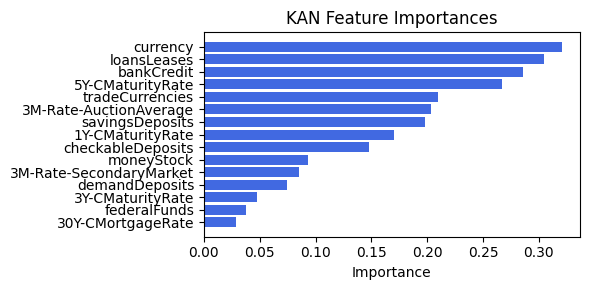

Computing Grad-CAM: 100%|██████████| 210/210 [00:16<00:00, 12.48it/s]


[('loansLeases', 0.0746852899591128), ('demandDeposits', 0.018367858829775027), ('3M-Rate-SecondaryMarket', 0.013189003900403068), ('savingsDeposits', 0.006773473599570847), ('1Y-CMaturityRate', 0.004790728060262543), ('tradeCurrencies', 0.004164218945827867), ('3M-Rate-AuctionAverage', 0.002043228702885764), ('30Y-CMortgageRate', 0.0007106257159085501), ('currency', 0.00027535524928853623), ('bankCredit', 0.00021786862274720555), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


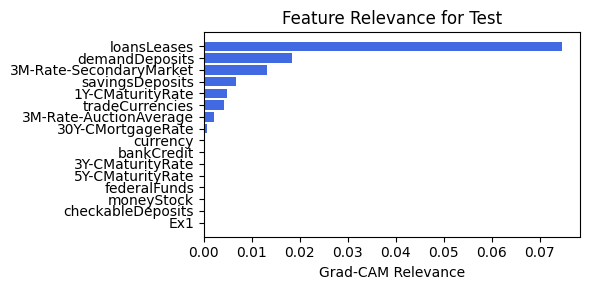

In [222]:
train_and_plot_relevance(Model3_4, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=60, embed_dim=64, filename=filename_4, opt_col_val=64)

### 4.2.1 width=[15, 1, 1], grid=5, lamb=1e-05 | embed_dim=64

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.73e-01 | eval_loss: 1.97e-01 | reg: 1.75e+01 |: 100%|█| 60/60 [00:19<00:00,  3.05it/

saving model version 0.1
Best epoch 50
0.2381841093301773
M_KAN Relevance: 0.00018806217121891677
CNN Relevance: 0.9998119473457336
[('currency', 0.32079852), ('loansLeases', 0.30477974), ('bankCredit', 0.28560093), ('5Y-CMaturityRate', 0.26739115), ('tradeCurrencies', 0.20975862), ('3M-Rate-AuctionAverage', 0.20311818), ('savingsDeposits', 0.19773346), ('1Y-CMaturityRate', 0.1703736), ('checkableDeposits', 0.1479157), ('moneyStock', 0.09357435), ('3M-Rate-SecondaryMarket', 0.08496109), ('demandDeposits', 0.07475344), ('3Y-CMaturityRate', 0.0474131), ('federalFunds', 0.037406024), ('30Y-CMortgageRate', 0.029184025)]


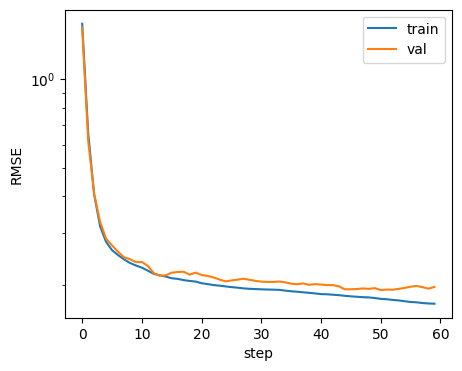

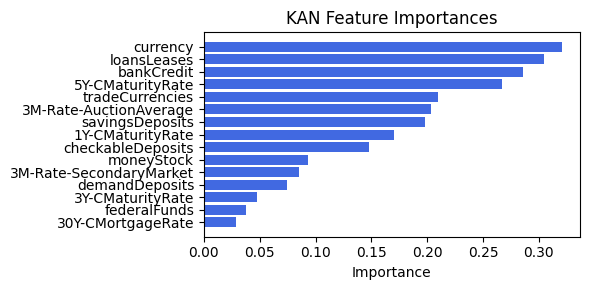

Computing Grad-CAM: 100%|██████████| 210/210 [00:16<00:00, 12.39it/s]


[('loansLeases', 0.0746852899591128), ('demandDeposits', 0.018367858829775027), ('3M-Rate-SecondaryMarket', 0.013189003900403068), ('savingsDeposits', 0.006773473599570847), ('1Y-CMaturityRate', 0.004790728060262543), ('tradeCurrencies', 0.004164218945827867), ('3M-Rate-AuctionAverage', 0.002043228702885764), ('30Y-CMortgageRate', 0.0007106257159085501), ('currency', 0.00027535524928853623), ('bankCredit', 0.00021786862274720555), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


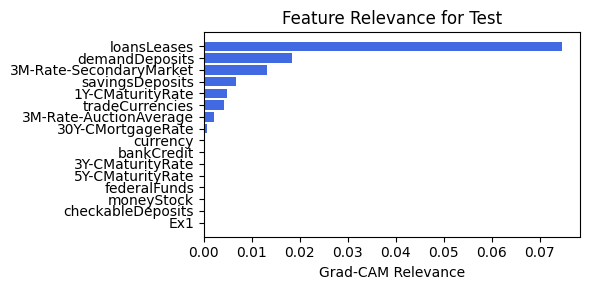

In [223]:
train_and_plot_relevance(Model3_4, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=60, embed_dim=64, filename=filename_4, opt_col_val=64)

### 4.2.2 width=[15, 1, 1], grid=5, lamb=1e-05 | embed_dim=32

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.60e-01 | eval_loss: 1.90e-01 | reg: 1.20e+01 |: 100%|█| 60/60 [00:20<00:00,  2.90it/

saving model version 0.1
Best epoch 56
0.22949616611003876
M_KAN Relevance: 0.053324781358242035
CNN Relevance: 0.946675181388855
[('currency', 0.32755807), ('loansLeases', 0.308534), ('bankCredit', 0.2925964), ('5Y-CMaturityRate', 0.27335763), ('tradeCurrencies', 0.21079141), ('3M-Rate-AuctionAverage', 0.20412107), ('savingsDeposits', 0.19618675), ('1Y-CMaturityRate', 0.16970798), ('checkableDeposits', 0.13607302), ('moneyStock', 0.0880404), ('3M-Rate-SecondaryMarket', 0.077658184), ('demandDeposits', 0.063931786), ('3Y-CMaturityRate', 0.038308144), ('30Y-CMortgageRate', 0.015663171), ('federalFunds', 0.010334622)]


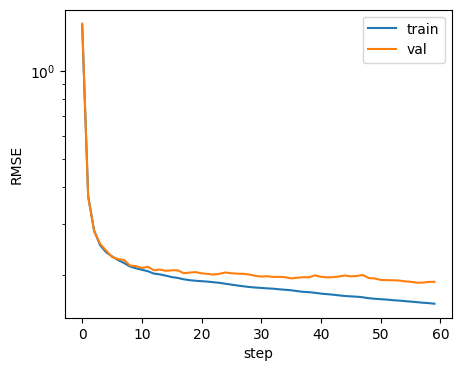

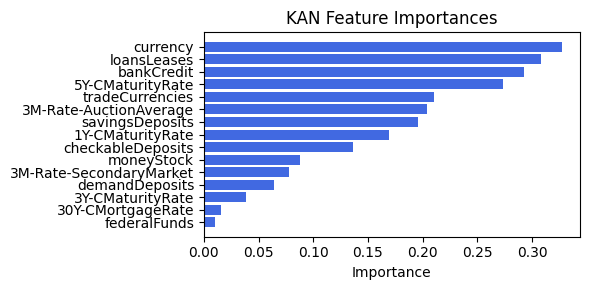

Computing Grad-CAM: 100%|██████████| 210/210 [00:15<00:00, 13.72it/s]


[('1Y-CMaturityRate', 0.334656996617005), ('loansLeases', 0.15071527889674707), ('demandDeposits', 0.10218957217321509), ('3M-Rate-SecondaryMarket', 0.07306872601773301), ('3Y-CMaturityRate', 0.07245841903079833), ('30Y-CMortgageRate', 0.07058091031808761), ('3M-Rate-AuctionAverage', 0.06788948445270458), ('currency', 0.05169173752268155), ('savingsDeposits', 0.04709283770706471), ('tradeCurrencies', 0.030435177564643145), ('moneyStock', 0.00915255745473717), ('federalFunds', 0.002156756549984926), ('bankCredit', 0.0019777429955346246), ('5Y-CMaturityRate', 0.0018433237359637305), ('checkableDeposits', 0.0010630186469781967), ('Ex1', 0.0)]


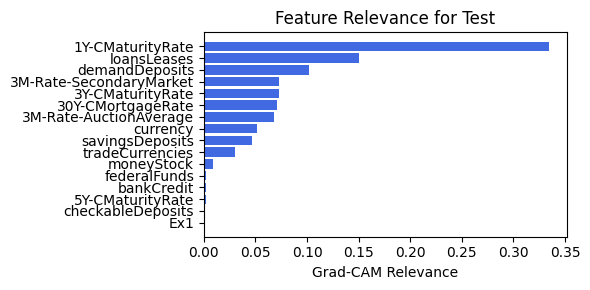

In [224]:
train_and_plot_relevance(Model3_4, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=60, embed_dim=32, filename=filename_4, opt_col_val=32)

### 4.2.3 width=[15, 1, 1], grid=5, lamb=1e-05 | embed_dim=32

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.54e-01 | eval_loss: 1.98e-01 | reg: 1.28e+01 |: 100%|█| 60/60 [00:19<00:00,  3.08it/

saving model version 0.1
Best epoch 21
0.2493170201778412
M_KAN Relevance: 0.0191661287099123
CNN Relevance: 0.980833888053894
[('currency', 0.31578335), ('loansLeases', 0.30182582), ('bankCredit', 0.2804702), ('5Y-CMaturityRate', 0.26298535), ('tradeCurrencies', 0.20877989), ('3M-Rate-AuctionAverage', 0.20217183), ('savingsDeposits', 0.19851768), ('1Y-CMaturityRate', 0.1705978), ('checkableDeposits', 0.15569289), ('moneyStock', 0.09719203), ('3M-Rate-SecondaryMarket', 0.08974956), ('demandDeposits', 0.082190834), ('federalFunds', 0.054300494), ('3Y-CMaturityRate', 0.0538672), ('30Y-CMortgageRate', 0.03856767)]


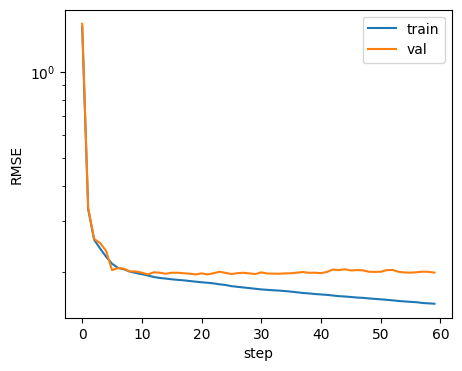

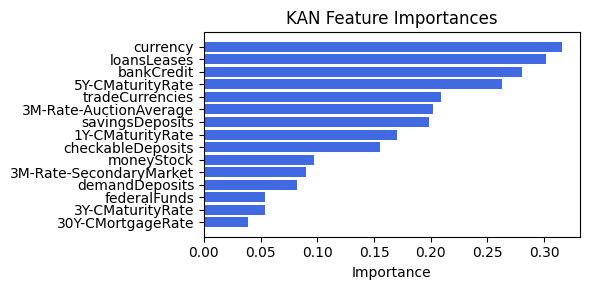

Computing Grad-CAM: 100%|██████████| 210/210 [00:18<00:00, 11.67it/s]

[('3M-Rate-SecondaryMarket', 0.1875219594775921), ('1Y-CMaturityRate', 0.13716691291137112), ('loansLeases', 0.12715241314117087), ('30Y-CMortgageRate', 0.06653372738558877), ('3M-Rate-AuctionAverage', 0.061558460960874244), ('currency', 0.05413378273092565), ('demandDeposits', 0.05392455407196567), ('savingsDeposits', 0.039773210539438185), ('Ex1', 0.004813905273165021), ('tradeCurrencies', 0.00420255554767902), ('bankCredit', 0.0035370363543430964), ('5Y-CMaturityRate', 0.0032692514005161467), ('checkableDeposits', 5.405315286701634e-06), ('3Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0)]


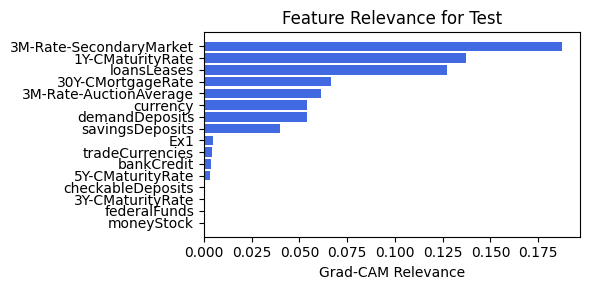

In [225]:
train_and_plot_relevance(Model3_4, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=60, embed_dim=32, filename=filename_4, opt_col_val=32)

### 4.2.4 width=[15, 1, 1], grid=5, lamb=1e-05 | embed_dim=16

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.92e-01 | eval_loss: 1.95e-01 | reg: 1.31e+01 |: 100%|█| 80/80 [00:27<00:00,  2.92it/

saving model version 0.1
Best epoch 79
0.23638205230236053
M_KAN Relevance: 0.4399455785751343
CNN Relevance: 0.5600544810295105
[('currency', 0.31885463), ('loansLeases', 0.30364108), ('bankCredit', 0.28360987), ('5Y-CMaturityRate', 0.26568258), ('tradeCurrencies', 0.20938703), ('3M-Rate-AuctionAverage', 0.20275937), ('savingsDeposits', 0.19805124), ('1Y-CMaturityRate', 0.17047098), ('checkableDeposits', 0.15096624), ('moneyStock', 0.094994344), ('3M-Rate-SecondaryMarket', 0.086840235), ('demandDeposits', 0.07764981), ('3Y-CMaturityRate', 0.049914744), ('federalFunds', 0.04405946), ('30Y-CMortgageRate', 0.032842264)]


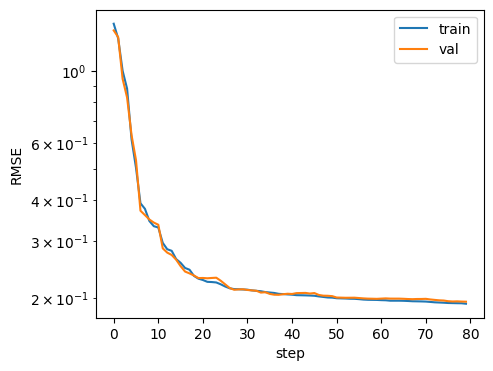

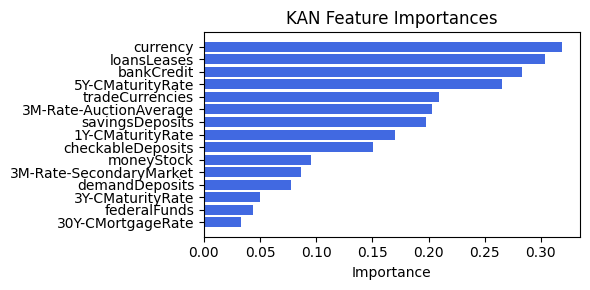

Computing Grad-CAM: 100%|██████████| 210/210 [00:18<00:00, 11.61it/s]


[('loansLeases', 0.008127903867335546), ('1Y-CMaturityRate', 0.0017222498144422258), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3M-Rate-SecondaryMarket', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('demandDeposits', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('savingsDeposits', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


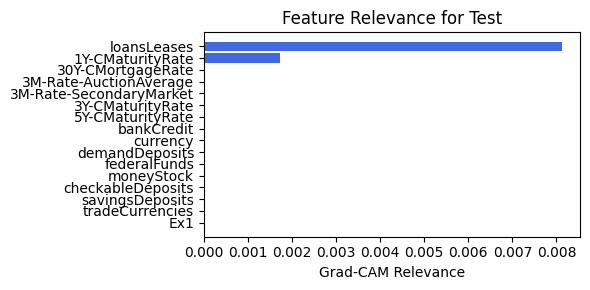

In [226]:
train_and_plot_relevance(Model3_4, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=80, embed_dim=16, filename=filename_4, opt_col_val=16)

### 4.2.5 width=[15, 1, 1], grid=5, lamb=1e-05 | embed_dim=16

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 2.03e-01 | eval_loss: 1.97e-01 | reg: 1.18e+01 |: 100%|█| 80/80 [00:26<00:00,  2.99it/


saving model version 0.1
Best epoch 70
0.23572629690170288
M_KAN Relevance: 0.20017021894454956
CNN Relevance: 0.7998297810554504
[('currency', 0.31527615), ('loansLeases', 0.30152297), ('bankCredit', 0.27995256), ('5Y-CMaturityRate', 0.2625402), ('tradeCurrencies', 0.20867616), ('3M-Rate-AuctionAverage', 0.20207167), ('savingsDeposits', 0.19858852), ('1Y-CMaturityRate', 0.17061421), ('checkableDeposits', 0.15645592), ('moneyStock', 0.09754667), ('3M-Rate-SecondaryMarket', 0.09021915), ('demandDeposits', 0.082930684), ('federalFunds', 0.05593447), ('3Y-CMaturityRate', 0.054513805), ('30Y-CMortgageRate', 0.039492395)]


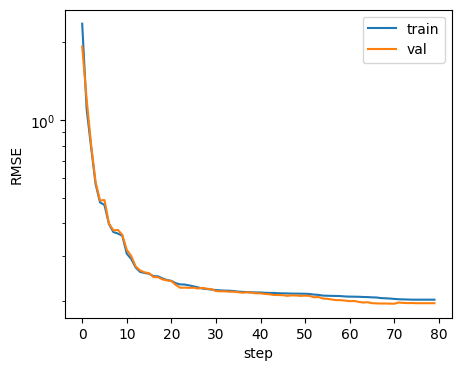

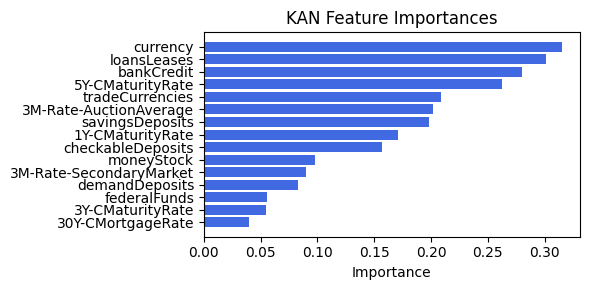

Computing Grad-CAM: 100%|██████████| 210/210 [00:19<00:00, 10.96it/s]

[('loansLeases', 0.07061154768238166), ('savingsDeposits', 0.0050923014769241924), ('demandDeposits', 0.0017801058789094289), ('1Y-CMaturityRate', 0.0011513808653468177), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3M-Rate-SecondaryMarket', 0.0), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('currency', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


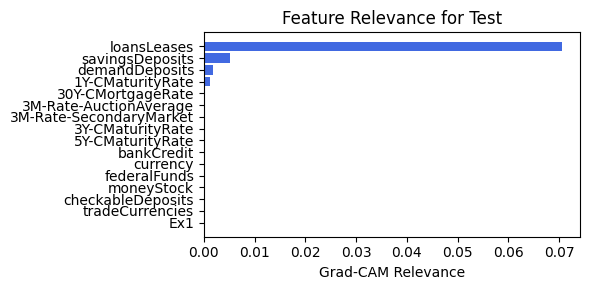

In [227]:
train_and_plot_relevance(Model3_4, kan_neurons=1, kan_grid=5, lamb=1e-05, steps=80, embed_dim=16, filename=filename_4, opt_col_val=16)

## 4.3 width=[15, 6, 1], grid=7, lamb=1e-05

embed_dim: 64, num_head:2
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.29e-01 | eval_loss: 2.25e-01 | reg: 2.69e+01 |: 100%|█| 90/90 [00:28<00:00,  3.11it/

saving model version 0.1
Best epoch 36
0.22360701858997345
M_KAN Relevance: 0.086179219186306
CNN Relevance: 0.913820743560791
[('checkableDeposits', 0.5779004), ('federalFunds', 0.5505158), ('3M-Rate-AuctionAverage', 0.4157513), ('30Y-CMortgageRate', 0.41409802), ('bankCredit', 0.37800062), ('3M-Rate-SecondaryMarket', 0.3385359), ('1Y-CMaturityRate', 0.3359402), ('currency', 0.30055612), ('tradeCurrencies', 0.29904932), ('moneyStock', 0.27954206), ('5Y-CMaturityRate', 0.27206194), ('3Y-CMaturityRate', 0.27020997), ('loansLeases', 0.25054845), ('demandDeposits', 0.22970632), ('savingsDeposits', 0.20261246)]


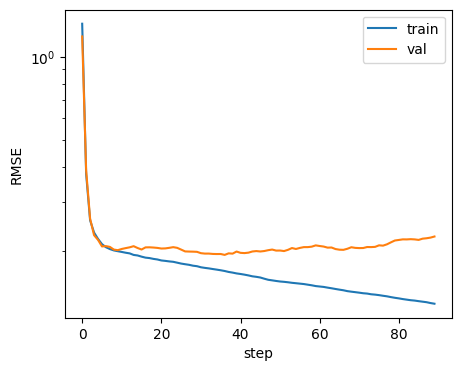

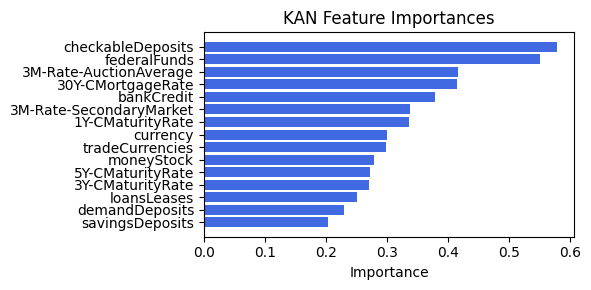

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.26it/s]

[('loansLeases', 0.13553599752042264), ('1Y-CMaturityRate', 0.08255905664658972), ('demandDeposits', 0.05828124926026378), ('savingsDeposits', 0.02059926768311665), ('checkableDeposits', 0.006483244860456103), ('tradeCurrencies', 0.004214273148681969), ('3M-Rate-SecondaryMarket', 0.002839139387721107), ('3Y-CMaturityRate', 0.00218803423479022), ('currency', 0.001169095312555631), ('3M-Rate-AuctionAverage', 0.00047623635757537117), ('30Y-CMortgageRate', 0.00046655209291548955), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('Ex1', 0.0)]


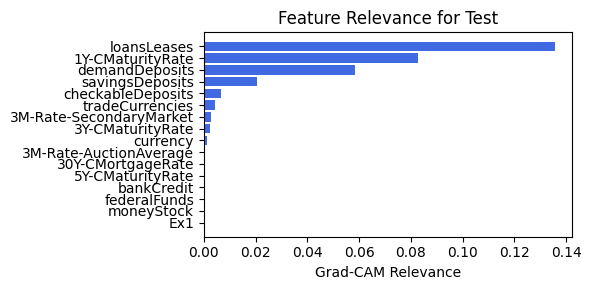

embed_dim: 64, num_head:4
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.23e-01 | eval_loss: 1.92e-01 | reg: 2.69e+01 |: 100%|█| 90/90 [00:28<00:00,  3.19it/

saving model version 0.1
Best epoch 71
0.24677875638008118
M_KAN Relevance: 0.1028977558016777
CNN Relevance: 0.8971022367477417
[('checkableDeposits', 0.5767384), ('federalFunds', 0.5541152), ('30Y-CMortgageRate', 0.41901216), ('3M-Rate-AuctionAverage', 0.4182056), ('bankCredit', 0.38058782), ('3M-Rate-SecondaryMarket', 0.34098396), ('1Y-CMaturityRate', 0.33562052), ('currency', 0.30108744), ('tradeCurrencies', 0.2977105), ('moneyStock', 0.28267103), ('5Y-CMaturityRate', 0.27131295), ('3Y-CMaturityRate', 0.26891094), ('loansLeases', 0.23799828), ('demandDeposits', 0.2233312), ('savingsDeposits', 0.19478516)]


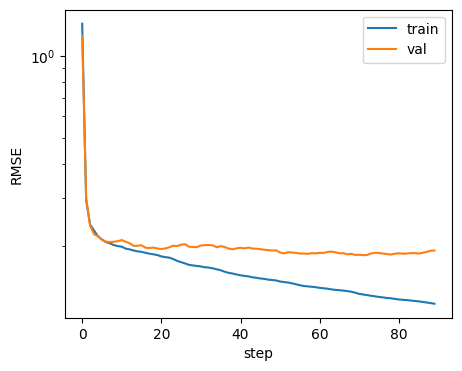

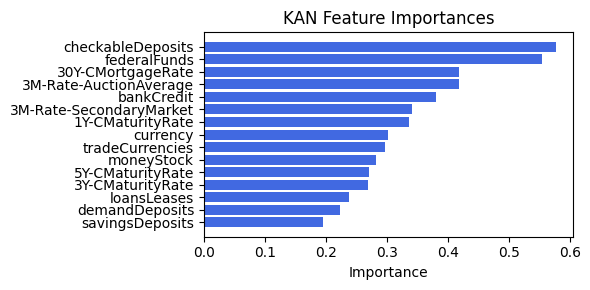

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  7.94it/s]

[('1Y-CMaturityRate', 0.2899709009354064), ('Ex1', 0.14119863534315732), ('3M-Rate-AuctionAverage', 0.09423736106781733), ('30Y-CMortgageRate', 0.0919727167912892), ('loansLeases', 0.060472837879899), ('3Y-CMaturityRate', 0.04356397658425738), ('savingsDeposits', 0.0414948673708187), ('3M-Rate-SecondaryMarket', 0.03830834946018599), ('demandDeposits', 0.02809459995755571), ('moneyStock', 0.025399725218968734), ('currency', 0.017320940861204042), ('5Y-CMaturityRate', 0.007121453852665755), ('bankCredit', 0.006087534718071332), ('federalFunds', 0.0007057333394186571), ('checkableDeposits', 0.0005474254219388101), ('tradeCurrencies', 0.00010188193146383301)]


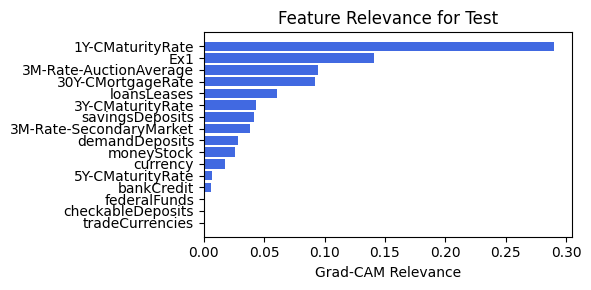

embed_dim: 64, num_head:8
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.29e-01 | eval_loss: 2.25e-01 | reg: 2.69e+01 |: 100%|█| 90/90 [00:28<00:00,  3.13it/

saving model version 0.1
Best epoch 36
0.22360701858997345
M_KAN Relevance: 0.086179219186306
CNN Relevance: 0.913820743560791
[('checkableDeposits', 0.5779004), ('federalFunds', 0.5505158), ('3M-Rate-AuctionAverage', 0.4157513), ('30Y-CMortgageRate', 0.41409802), ('bankCredit', 0.37800062), ('3M-Rate-SecondaryMarket', 0.3385359), ('1Y-CMaturityRate', 0.3359402), ('currency', 0.30055612), ('tradeCurrencies', 0.29904932), ('moneyStock', 0.27954206), ('5Y-CMaturityRate', 0.27206194), ('3Y-CMaturityRate', 0.27020997), ('loansLeases', 0.25054845), ('demandDeposits', 0.22970632), ('savingsDeposits', 0.20261246)]


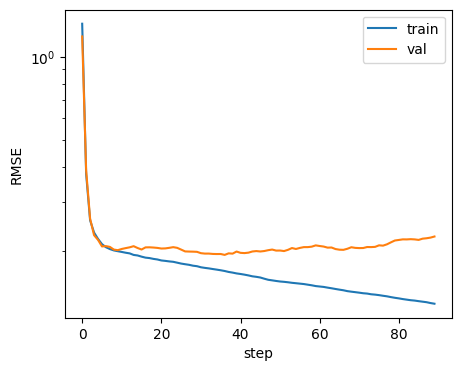

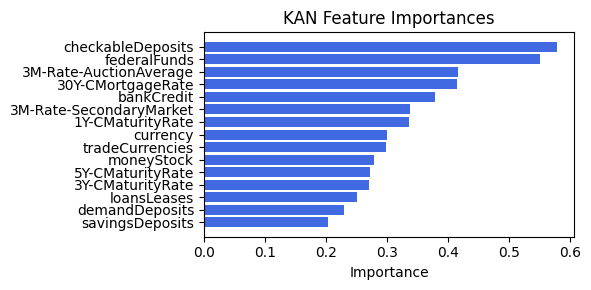

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  8.06it/s]

[('loansLeases', 0.13553599752042264), ('1Y-CMaturityRate', 0.08255905664658972), ('demandDeposits', 0.05828124926026378), ('savingsDeposits', 0.02059926768311665), ('checkableDeposits', 0.006483244860456103), ('tradeCurrencies', 0.004214273148681969), ('3M-Rate-SecondaryMarket', 0.002839139387721107), ('3Y-CMaturityRate', 0.00218803423479022), ('currency', 0.001169095312555631), ('3M-Rate-AuctionAverage', 0.00047623635757537117), ('30Y-CMortgageRate', 0.00046655209291548955), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('Ex1', 0.0)]


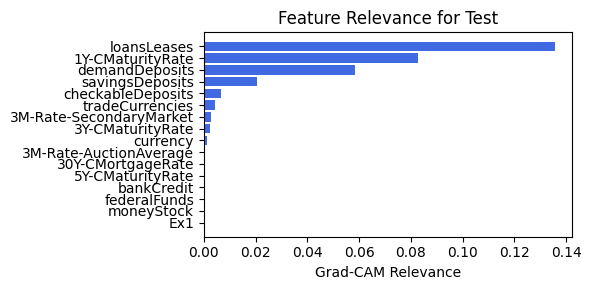

embed_dim: 32, num_head:2
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.87e-01 | eval_loss: 1.95e-01 | reg: 2.22e+01 |: 100%|█| 90/90 [00:28<00:00,  3.11it/

saving model version 0.1
Best epoch 88
0.24269981682300568
M_KAN Relevance: 0.08299649506807327
CNN Relevance: 0.9170035123825073
[('checkableDeposits', 0.57770866), ('federalFunds', 0.5494313), ('3M-Rate-AuctionAverage', 0.4150941), ('30Y-CMortgageRate', 0.4128577), ('bankCredit', 0.37730485), ('3M-Rate-SecondaryMarket', 0.3378967), ('1Y-CMaturityRate', 0.33583578), ('currency', 0.30070385), ('tradeCurrencies', 0.29935184), ('moneyStock', 0.2789298), ('5Y-CMaturityRate', 0.27232516), ('3Y-CMaturityRate', 0.27028888), ('loansLeases', 0.25304705), ('demandDeposits', 0.23102272), ('savingsDeposits', 0.2041422)]


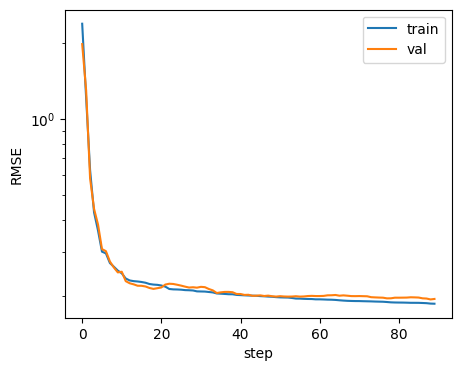

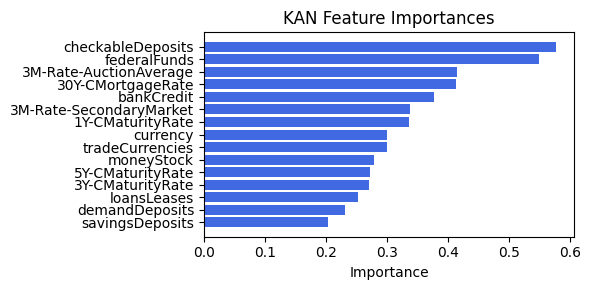

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  8.06it/s]

[('3M-Rate-SecondaryMarket', 0.05351895802887156), ('checkableDeposits', 0.04710783173463174), ('loansLeases', 0.030541236352707658), ('1Y-CMaturityRate', 0.004567325922350088), ('demandDeposits', 0.004366372800653889), ('currency', 0.004076200563992773), ('3M-Rate-AuctionAverage', 0.003978582835268407), ('30Y-CMortgageRate', 0.0035607986329566866), ('Ex1', 0.0031399209584508626), ('savingsDeposits', 0.0017509844181837425), ('federalFunds', 0.0010605913542565846), ('bankCredit', 0.0007862235995985213), ('5Y-CMaturityRate', 0.0006803622380608604), ('3Y-CMaturityRate', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0)]


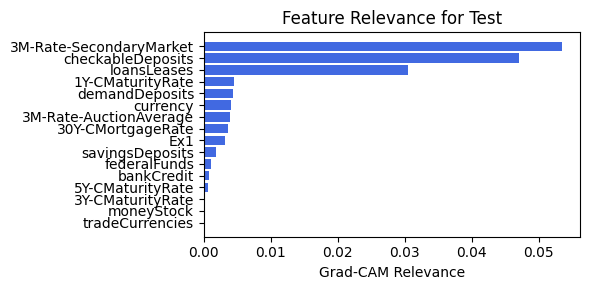

embed_dim: 32, num_head:4
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 2.15e-01 | eval_loss: 2.02e-01 | reg: 2.44e+01 |: 100%|█| 90/90 [00:22<00:00,  3.92it/


saving model version 0.1
Best epoch 87
0.2624058723449707
M_KAN Relevance: 0.031512726098299026
CNN Relevance: 0.9684872627258301
[('checkableDeposits', 0.57737696), ('federalFunds', 0.54823774), ('3M-Rate-AuctionAverage', 0.41439533), ('30Y-CMortgageRate', 0.41156435), ('bankCredit', 0.37656376), ('3M-Rate-SecondaryMarket', 0.337221), ('1Y-CMaturityRate', 0.3356739), ('currency', 0.30091763), ('tradeCurrencies', 0.29964536), ('moneyStock', 0.27833793), ('5Y-CMaturityRate', 0.27260935), ('3Y-CMaturityRate', 0.27029908), ('loansLeases', 0.2554567), ('demandDeposits', 0.2322992), ('savingsDeposits', 0.20560268)]


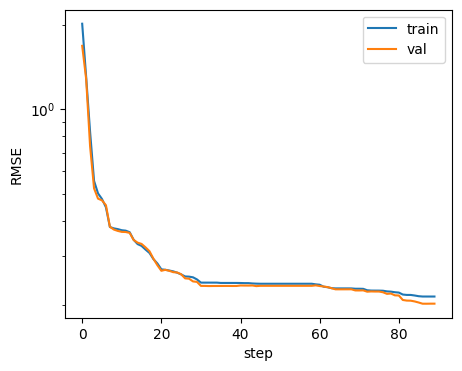

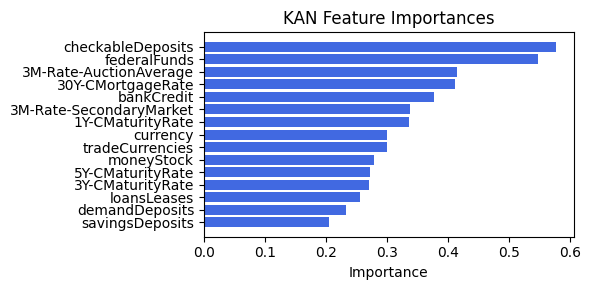

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.24it/s]

[('3M-Rate-SecondaryMarket', 0.24325828442261332), ('loansLeases', 0.08899968124280262), ('checkableDeposits', 0.04594590474097501), ('savingsDeposits', 0.018487347989918947), ('Ex1', 0.011763722864201381), ('demandDeposits', 0.004782269114539737), ('1Y-CMaturityRate', 0.0026185360870191027), ('currency', 0.0005900019901760277), ('3M-Rate-AuctionAverage', 0.00045868905615948497), ('30Y-CMortgageRate', 0.0002503841405823117), ('5Y-CMaturityRate', 0.00013246496784545127), ('bankCredit', 4.09063860951435e-05), ('3Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0)]


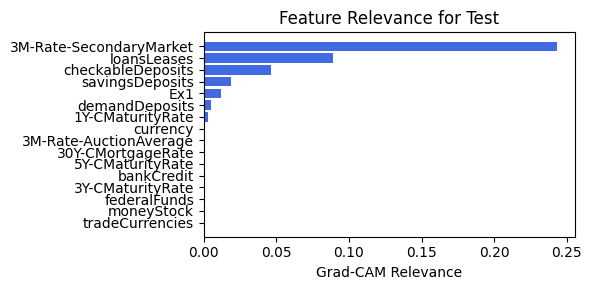

embed_dim: 32, num_head:8
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.87e-01 | eval_loss: 1.95e-01 | reg: 2.22e+01 |: 100%|█| 90/90 [00:28<00:00,  3.12it/

saving model version 0.1
Best epoch 88
0.24269981682300568
M_KAN Relevance: 0.08299649506807327
CNN Relevance: 0.9170035123825073
[('checkableDeposits', 0.57770866), ('federalFunds', 0.5494313), ('3M-Rate-AuctionAverage', 0.4150941), ('30Y-CMortgageRate', 0.4128577), ('bankCredit', 0.37730485), ('3M-Rate-SecondaryMarket', 0.3378967), ('1Y-CMaturityRate', 0.33583578), ('currency', 0.30070385), ('tradeCurrencies', 0.29935184), ('moneyStock', 0.2789298), ('5Y-CMaturityRate', 0.27232516), ('3Y-CMaturityRate', 0.27028888), ('loansLeases', 0.25304705), ('demandDeposits', 0.23102272), ('savingsDeposits', 0.2041422)]


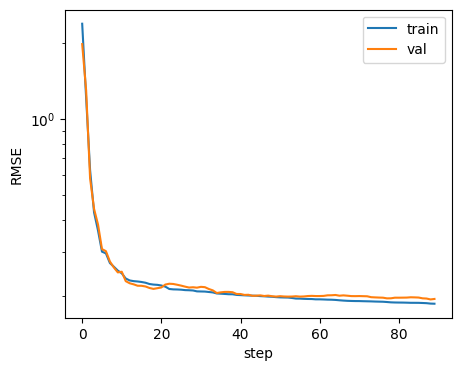

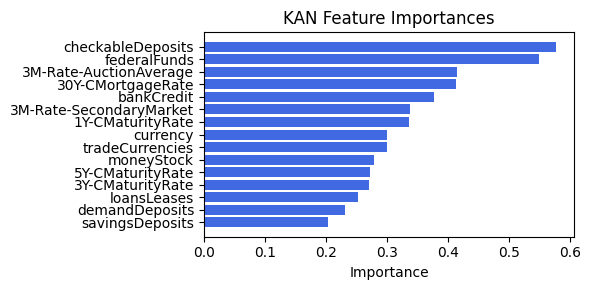

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  7.94it/s]

[('3M-Rate-SecondaryMarket', 0.05351895802887156), ('checkableDeposits', 0.04710783173463174), ('loansLeases', 0.030541236352707658), ('1Y-CMaturityRate', 0.004567325922350088), ('demandDeposits', 0.004366372800653889), ('currency', 0.004076200563992773), ('3M-Rate-AuctionAverage', 0.003978582835268407), ('30Y-CMortgageRate', 0.0035607986329566866), ('Ex1', 0.0031399209584508626), ('savingsDeposits', 0.0017509844181837425), ('federalFunds', 0.0010605913542565846), ('bankCredit', 0.0007862235995985213), ('5Y-CMaturityRate', 0.0006803622380608604), ('3Y-CMaturityRate', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0)]


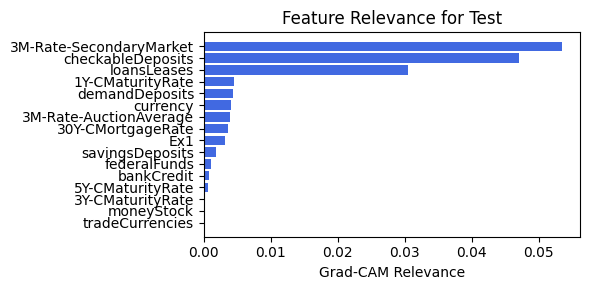

embed_dim: 16, num_head:2
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.29e-01 | eval_loss: 1.97e-01 | reg: 2.17e+01 |: 100%|█| 90/90 [00:33<00:00,  2.67it/

saving model version 0.1
Best epoch 9
0.24345974624156952
M_KAN Relevance: 0.055060189217329025
CNN Relevance: 0.9449398517608643
[('checkableDeposits', 0.57750213), ('federalFunds', 0.54865193), ('3M-Rate-AuctionAverage', 0.41463658), ('30Y-CMortgageRate', 0.41200835), ('bankCredit', 0.37681866), ('3M-Rate-SecondaryMarket', 0.33745334), ('1Y-CMaturityRate', 0.3357339), ('currency', 0.3008352), ('tradeCurrencies', 0.29954523), ('moneyStock', 0.27853677), ('5Y-CMaturityRate', 0.27250904), ('3Y-CMaturityRate', 0.27030084), ('loansLeases', 0.25464606), ('demandDeposits', 0.231868), ('savingsDeposits', 0.20511113)]


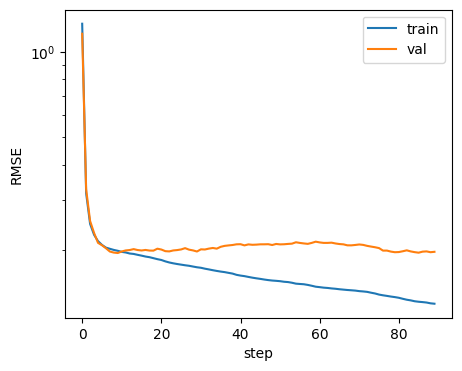

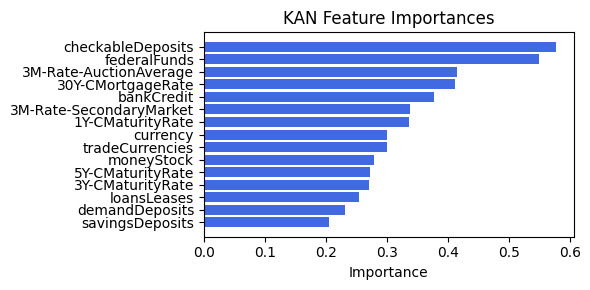

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.49it/s]

[('loansLeases', 0.24054715679348668), ('savingsDeposits', 0.08023328908408682), ('3M-Rate-SecondaryMarket', 0.019438251852989197), ('demandDeposits', 0.01527978697974634), ('1Y-CMaturityRate', 0.012624093358005796), ('tradeCurrencies', 0.005725566009503035), ('30Y-CMortgageRate', 0.0040844478494753795), ('3M-Rate-AuctionAverage', 0.0037127304600463027), ('currency', 0.0003684733240377335), ('bankCredit', 0.0003516952906336103), ('5Y-CMaturityRate', 5.5857636921462556e-05), ('3Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


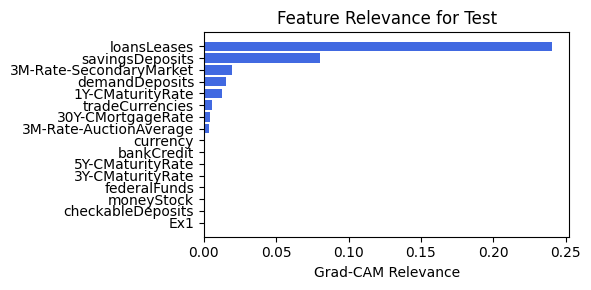

embed_dim: 16, num_head:4
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.28e-01 | eval_loss: 1.90e-01 | reg: 2.27e+01 |: 100%|█| 90/90 [00:30<00:00,  2.95it/

saving model version 0.1
Best epoch 89
0.23530244827270508
M_KAN Relevance: 0.08672560006380081
CNN Relevance: 0.913274347782135
[('checkableDeposits', 0.57384616), ('federalFunds', 0.5557954), ('30Y-CMortgageRate', 0.42103776), ('3M-Rate-AuctionAverage', 0.4190799), ('bankCredit', 0.38135833), ('3M-Rate-SecondaryMarket', 0.34190172), ('1Y-CMaturityRate', 0.33461294), ('currency', 0.30230245), ('tradeCurrencies', 0.29705435), ('moneyStock', 0.28482863), ('5Y-CMaturityRate', 0.2712446), ('3Y-CMaturityRate', 0.267151), ('loansLeases', 0.22988103), ('demandDeposits', 0.21935956), ('savingsDeposits', 0.18942639)]


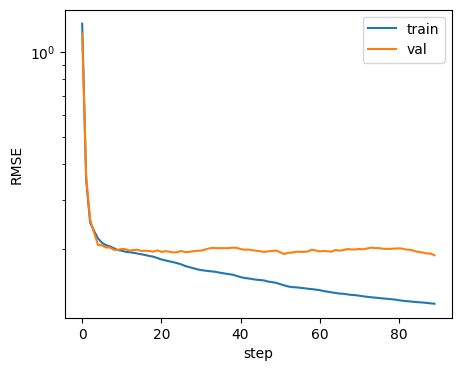

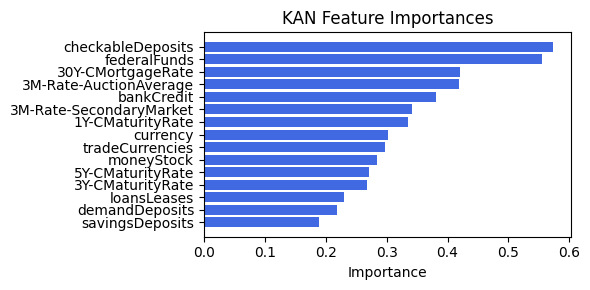

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.09it/s]

[('3Y-CMaturityRate', 0.1696248948520016), ('tradeCurrencies', 0.09761983823208582), ('loansLeases', 0.06850854976371573), ('demandDeposits', 0.06177117358449669), ('1Y-CMaturityRate', 0.049024530579724036), ('savingsDeposits', 0.03854762467751806), ('federalFunds', 0.009732806865525032), ('5Y-CMaturityRate', 0.008423921179824642), ('bankCredit', 0.0037223604657421155), ('30Y-CMortgageRate', 0.0014084436010480636), ('moneyStock', 0.000609029892144636), ('3M-Rate-AuctionAverage', 0.0005253563080692575), ('Ex1', 0.00036320981376948547), ('3M-Rate-SecondaryMarket', 5.316734370266897e-05), ('currency', 0.0), ('checkableDeposits', 0.0)]


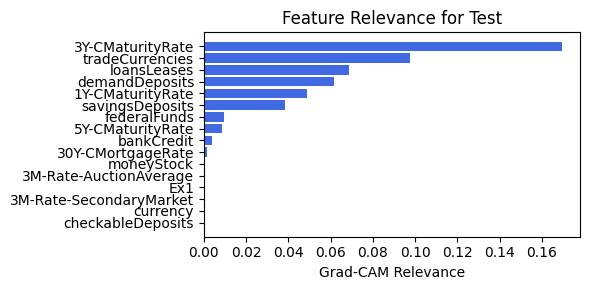

embed_dim: 16, num_head:8
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.29e-01 | eval_loss: 1.97e-01 | reg: 2.17e+01 |: 100%|█| 90/90 [00:29<00:00,  3.10it/

saving model version 0.1
Best epoch 9
0.24345974624156952
M_KAN Relevance: 0.055060189217329025
CNN Relevance: 0.9449398517608643
[('checkableDeposits', 0.57750213), ('federalFunds', 0.54865193), ('3M-Rate-AuctionAverage', 0.41463658), ('30Y-CMortgageRate', 0.41200835), ('bankCredit', 0.37681866), ('3M-Rate-SecondaryMarket', 0.33745334), ('1Y-CMaturityRate', 0.3357339), ('currency', 0.3008352), ('tradeCurrencies', 0.29954523), ('moneyStock', 0.27853677), ('5Y-CMaturityRate', 0.27250904), ('3Y-CMaturityRate', 0.27030084), ('loansLeases', 0.25464606), ('demandDeposits', 0.231868), ('savingsDeposits', 0.20511113)]


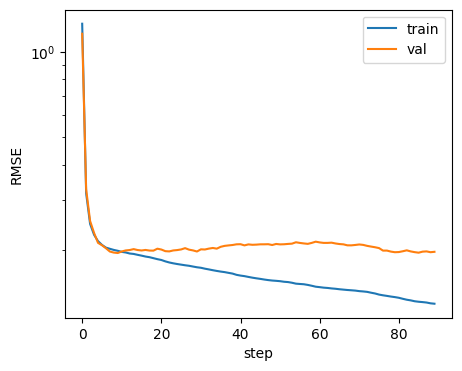

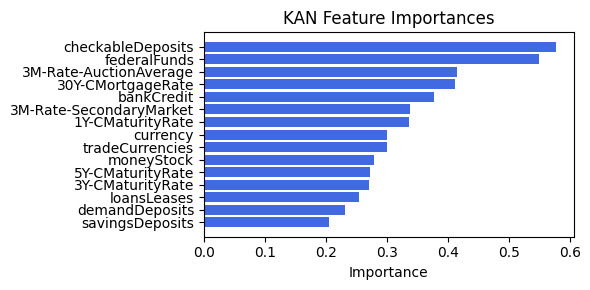

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.19it/s]

[('loansLeases', 0.24054715679348668), ('savingsDeposits', 0.08023328908408682), ('3M-Rate-SecondaryMarket', 0.019438251852989197), ('demandDeposits', 0.01527978697974634), ('1Y-CMaturityRate', 0.012624093358005796), ('tradeCurrencies', 0.005725566009503035), ('30Y-CMortgageRate', 0.0040844478494753795), ('3M-Rate-AuctionAverage', 0.0037127304600463027), ('currency', 0.0003684733240377335), ('bankCredit', 0.0003516952906336103), ('5Y-CMaturityRate', 5.5857636921462556e-05), ('3Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


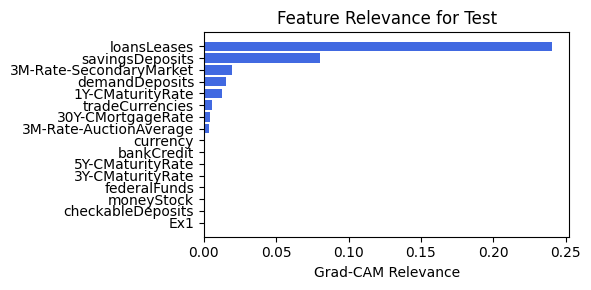

In [52]:
for embed_dim in [64, 32, 16]:
    for num_head in [2, 4 , 8]:
        print(f"embed_dim: {embed_dim}, num_head:{num_head}")
        train_and_plot_relevance(Model3_4, kan_neurons=6, kan_grid=7, lamb=1e-05, steps=90, 
                                 embed_dim=embed_dim, num_heads=num_head, filename=filename_4, opt_col_val=f'{embed_dim}, {num_head}')

embed_dim: 48, num_head:6
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.54e-01 | eval_loss: 2.04e-01 | reg: 2.15e+01 |: 100%|█| 90/90 [00:29<00:00,  3.09it/

saving model version 0.1
Best epoch 30
0.2521257996559143
M_KAN Relevance: 0.001621466246433556
CNN Relevance: 0.9983785152435303
[('checkableDeposits', 0.5778402), ('federalFunds', 0.55009055), ('3M-Rate-AuctionAverage', 0.41549098), ('30Y-CMortgageRate', 0.41360313), ('bankCredit', 0.37772438), ('3M-Rate-SecondaryMarket', 0.33828193), ('1Y-CMaturityRate', 0.3359052), ('currency', 0.3006071), ('tradeCurrencies', 0.29917246), ('moneyStock', 0.27929193), ('5Y-CMaturityRate', 0.27216554), ('3Y-CMaturityRate', 0.2702502), ('loansLeases', 0.25156963), ('demandDeposits', 0.23024338), ('savingsDeposits', 0.20323929)]


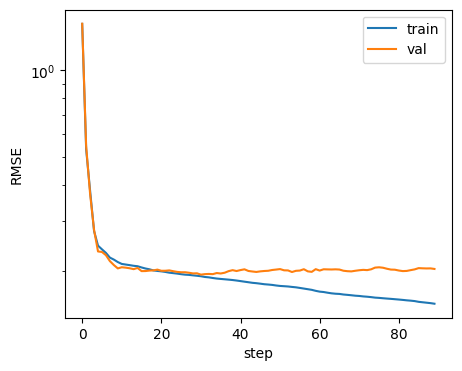

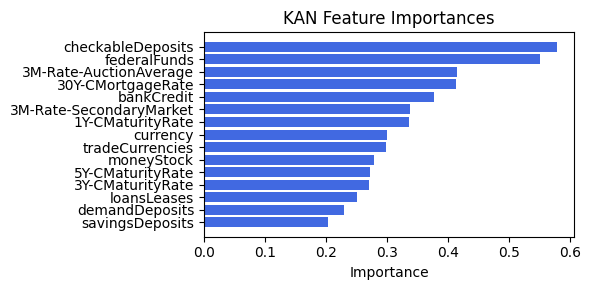

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.10it/s]

[('3M-Rate-SecondaryMarket', 0.2847285949758121), ('3M-Rate-AuctionAverage', 0.2804323021765976), ('30Y-CMortgageRate', 0.26181404979101247), ('1Y-CMaturityRate', 0.1838876585963936), ('loansLeases', 0.0889290290047592), ('currency', 0.027638107112475805), ('demandDeposits', 0.020922080131380687), ('savingsDeposits', 0.004375032858280022), ('5Y-CMaturityRate', 0.0015637391335552647), ('bankCredit', 0.000578619788090388), ('checkableDeposits', 0.0002662390825294313), ('3Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0), ('Ex1', 0.0)]


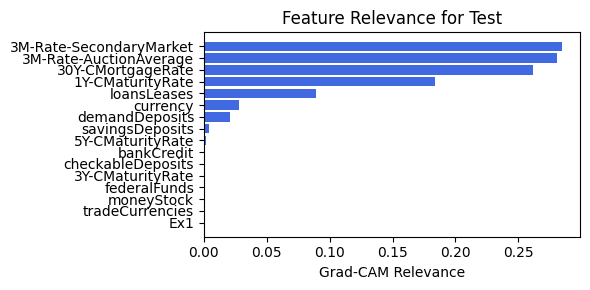

embed_dim: 24, num_head:6
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.32e-01 | eval_loss: 1.86e-01 | reg: 2.22e+01 |: 100%|█| 90/90 [00:28<00:00,  3.20it/

saving model version 0.1
Best epoch 89
0.24409350752830505
M_KAN Relevance: 0.17139874398708344
CNN Relevance: 0.8286013007164001
[('checkableDeposits', 0.5737232), ('federalFunds', 0.5561231), ('30Y-CMortgageRate', 0.42128754), ('3M-Rate-AuctionAverage', 0.4192302), ('bankCredit', 0.3814562), ('3M-Rate-SecondaryMarket', 0.34206212), ('1Y-CMaturityRate', 0.33459836), ('currency', 0.3024283), ('tradeCurrencies', 0.29710713), ('moneyStock', 0.2850133), ('5Y-CMaturityRate', 0.2712532), ('3Y-CMaturityRate', 0.26712084), ('loansLeases', 0.22931233), ('demandDeposits', 0.21913752), ('savingsDeposits', 0.18914072)]


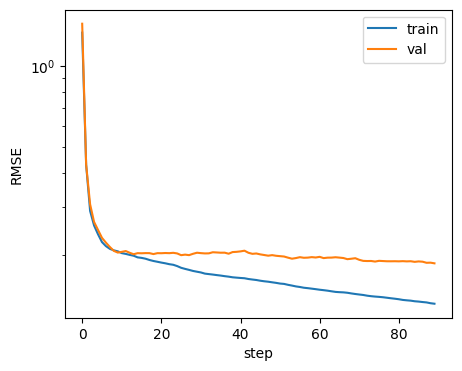

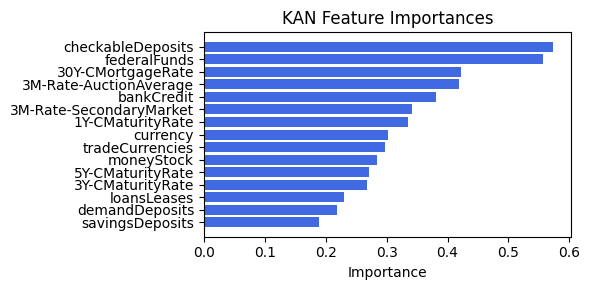

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.08it/s]

[('3M-Rate-SecondaryMarket', 0.27400958635622547), ('loansLeases', 0.23909000410903467), ('checkableDeposits', 0.017705972909572577), ('savingsDeposits', 0.011977016826858745), ('Ex1', 0.008409555376523973), ('currency', 0.007646034584883767), ('demandDeposits', 0.005780405072229249), ('30Y-CMortgageRate', 0.000827562879948389), ('3M-Rate-AuctionAverage', 0.0005998219762529646), ('1Y-CMaturityRate', 0.0005552760192326137), ('tradeCurrencies', 9.45547152133215e-05), ('bankCredit', 4.914288209485156e-06), ('3Y-CMaturityRate', 0.0), ('5Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0)]


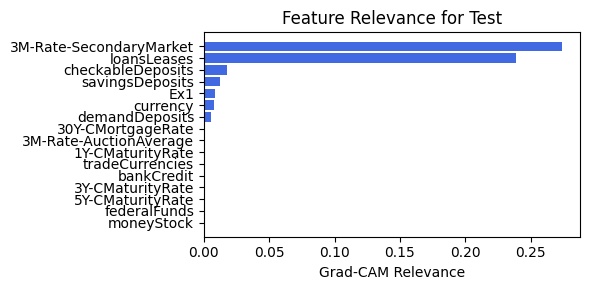

embed_dim: 12, num_head:6
checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.18e-01 | eval_loss: 1.91e-01 | reg: 2.03e+01 |: 100%|█| 90/90 [00:28<00:00,  3.20it/

saving model version 0.1
Best epoch 88
0.21755217015743256
M_KAN Relevance: 0.22819659113883972
CNN Relevance: 0.7718034386634827
[('checkableDeposits', 0.5757407), ('federalFunds', 0.5549361), ('30Y-CMortgageRate', 0.42012537), ('3M-Rate-AuctionAverage', 0.41872486), ('bankCredit', 0.38109016), ('3M-Rate-SecondaryMarket', 0.34152684), ('1Y-CMaturityRate', 0.33529204), ('currency', 0.30159378), ('tradeCurrencies', 0.29742503), ('moneyStock', 0.28364822), ('5Y-CMaturityRate', 0.27125454), ('3Y-CMaturityRate', 0.26827013), ('loansLeases', 0.23425543), ('demandDeposits', 0.2215386), ('savingsDeposits', 0.1924281)]


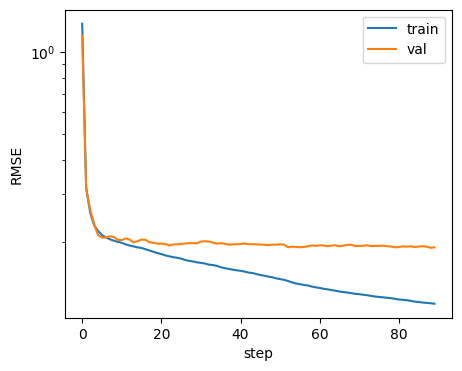

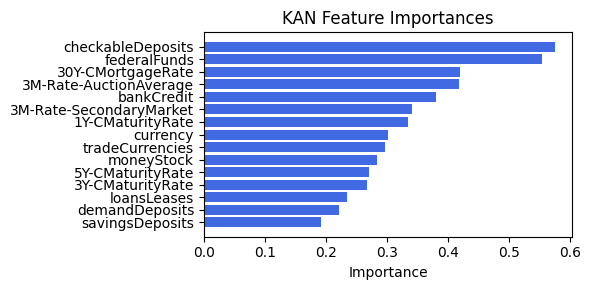

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  7.83it/s]

[('3Y-CMaturityRate', 0.2817476727024075), ('loansLeases', 0.2248055704492366), ('1Y-CMaturityRate', 0.20290596151871362), ('3M-Rate-SecondaryMarket', 0.18561390530805857), ('demandDeposits', 0.1796845441196291), ('checkableDeposits', 0.13202915621957453), ('currency', 0.12941274934301397), ('tradeCurrencies', 0.10135028826272381), ('savingsDeposits', 0.08606229852919656), ('3M-Rate-AuctionAverage', 0.08519883962996704), ('30Y-CMortgageRate', 0.07740068297079276), ('federalFunds', 0.021296677492570044), ('bankCredit', 0.015063694613941369), ('5Y-CMaturityRate', 0.014498202919605232), ('moneyStock', 0.004127929152621488), ('Ex1', 0.0029034611202188813)]


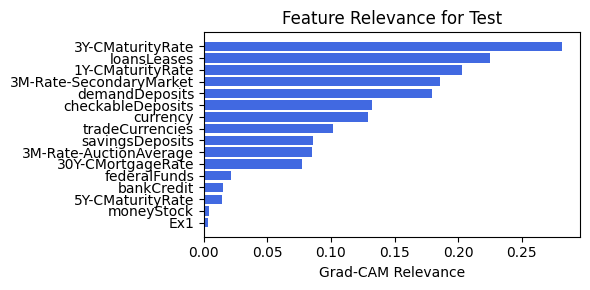

In [43]:
for embed_dim in [48, 24, 12]:
    for num_head in [6]:
        print(f"embed_dim: {embed_dim}, num_head:{num_head}")
        train_and_plot_relevance(Model3_4, kan_neurons=6, kan_grid=7, lamb=1e-05, steps=90, 
                                 embed_dim=embed_dim, num_heads=num_head, filename=filename_4, opt_col_val=f'{embed_dim}, {num_head}')

### 4.3.0 width=[15, 6, 1], grid=7, lamb=1e-05 | embed_dim=64

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.50e-01 | eval_loss: 2.09e-01 | reg: 2.67e+01 |: 100%|█| 60/60 [00:19<00:00,  3.02it/


saving model version 0.1
Best epoch 36
0.22360701858997345
M_KAN Relevance: 0.086179219186306
CNN Relevance: 0.913820743560791
[('checkableDeposits', 0.5779004), ('federalFunds', 0.5505158), ('3M-Rate-AuctionAverage', 0.4157513), ('30Y-CMortgageRate', 0.41409802), ('bankCredit', 0.37800062), ('3M-Rate-SecondaryMarket', 0.3385359), ('1Y-CMaturityRate', 0.3359402), ('currency', 0.30055612), ('tradeCurrencies', 0.29904932), ('moneyStock', 0.27954206), ('5Y-CMaturityRate', 0.27206194), ('3Y-CMaturityRate', 0.27020997), ('loansLeases', 0.25054845), ('demandDeposits', 0.22970632), ('savingsDeposits', 0.20261246)]


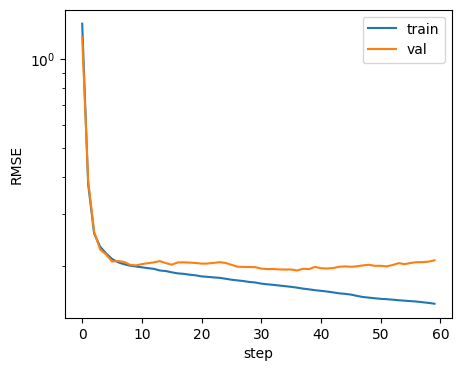

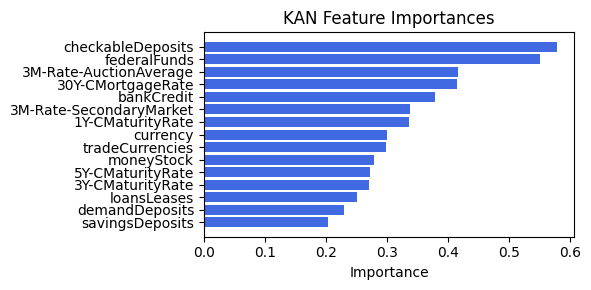

Computing Grad-CAM: 100%|██████████| 210/210 [00:26<00:00,  7.94it/s]

[('loansLeases', 0.13553599752042264), ('1Y-CMaturityRate', 0.08255905664658972), ('demandDeposits', 0.05828124926026378), ('savingsDeposits', 0.02059926768311665), ('checkableDeposits', 0.006483244860456103), ('tradeCurrencies', 0.004214273148681969), ('3M-Rate-SecondaryMarket', 0.002839139387721107), ('3Y-CMaturityRate', 0.00218803423479022), ('currency', 0.001169095312555631), ('3M-Rate-AuctionAverage', 0.00047623635757537117), ('30Y-CMortgageRate', 0.00046655209291548955), ('5Y-CMaturityRate', 0.0), ('bankCredit', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('Ex1', 0.0)]


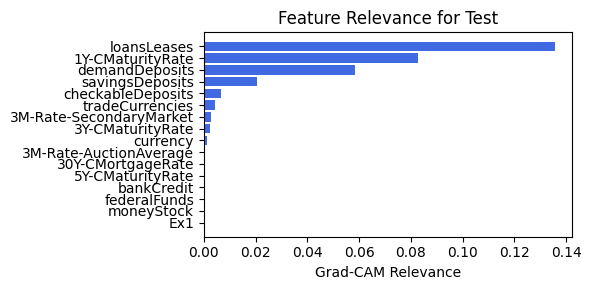

In [228]:
train_and_plot_relevance(Model3_4, kan_neurons=6, kan_grid=7, lamb=1e-05, steps=60, embed_dim=64, filename=filename_4, opt_col_val=64)

### 4.3.1 width=[15, 6, 1], grid=7, lamb=1e-05 | embed_dim=64

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.41e-01 | eval_loss: 1.88e-01 | reg: 2.68e+01 |: 100%|█| 60/60 [00:20<00:00,  2.98it/

saving model version 0.1
Best epoch 57
0.24473468959331512
M_KAN Relevance: 0.10009247809648514
CNN Relevance: 0.8999075293540955
[('checkableDeposits', 0.5774181), ('federalFunds', 0.55329823), ('30Y-CMortgageRate', 0.4177725), ('3M-Rate-AuctionAverage', 0.4176106), ('bankCredit', 0.37996846), ('3M-Rate-SecondaryMarket', 0.34037507), ('1Y-CMaturityRate', 0.33583984), ('currency', 0.3007165), ('tradeCurrencies', 0.29804876), ('moneyStock', 0.28173846), ('5Y-CMaturityRate', 0.2714307), ('3Y-CMaturityRate', 0.26942527), ('loansLeases', 0.24166223), ('demandDeposits', 0.22513458), ('savingsDeposits', 0.19708124)]


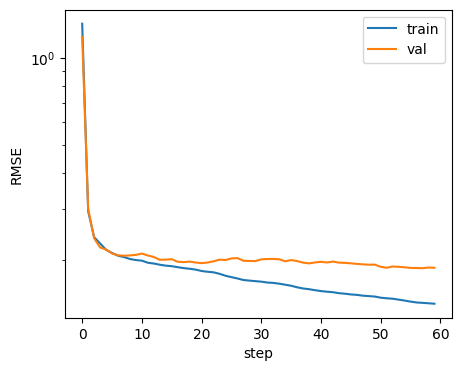

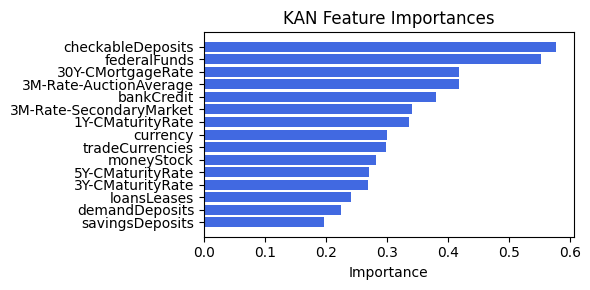

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.21it/s]

[('1Y-CMaturityRate', 0.37007903112985546), ('3M-Rate-AuctionAverage', 0.11748867319991058), ('30Y-CMortgageRate', 0.117287170323765), ('loansLeases', 0.1137986241773303), ('3M-Rate-SecondaryMarket', 0.06148458598133099), ('savingsDeposits', 0.053170605294872074), ('Ex1', 0.032690659893991586), ('demandDeposits', 0.032325862257164856), ('moneyStock', 0.01705694860845272), ('3Y-CMaturityRate', 0.01206883364253112), ('currency', 0.01093900262300546), ('5Y-CMaturityRate', 0.006037231031638969), ('bankCredit', 0.005614760276373653), ('federalFunds', 0.0013333142164074594), ('checkableDeposits', 0.00015766189566680363), ('tradeCurrencies', 0.0)]


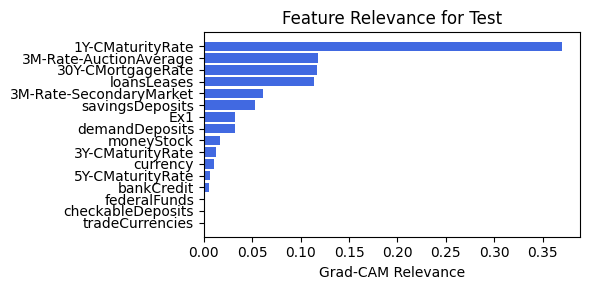

In [229]:
train_and_plot_relevance(Model3_4, kan_neurons=6, kan_grid=7, lamb=1e-05, steps=60, embed_dim=64, filename=filename_4, opt_col_val=64)

### 4.3.2 width=[15, 6, 1], grid=7, lamb=1e-05 | embed_dim=32

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 2.37e-01 | eval_loss: 2.35e-01 | reg: 2.56e+01 |: 100%|█| 60/60 [00:15<00:00,  3.82it/

saving model version 0.1
Best epoch 44
0.2854785621166229
M_KAN Relevance: 0.027420608326792717
CNN Relevance: 0.9725794196128845
[('checkableDeposits', 0.5773274), ('federalFunds', 0.5480813), ('3M-Rate-AuctionAverage', 0.41430506), ('30Y-CMortgageRate', 0.41139817), ('bankCredit', 0.37646803), ('3M-Rate-SecondaryMarket', 0.33713365), ('1Y-CMaturityRate', 0.3356502), ('currency', 0.30095035), ('tradeCurrencies', 0.29968238), ('moneyStock', 0.27826446), ('5Y-CMaturityRate', 0.27264726), ('3Y-CMaturityRate', 0.27029675), ('loansLeases', 0.25575578), ('demandDeposits', 0.23245858), ('savingsDeposits', 0.20578378)]


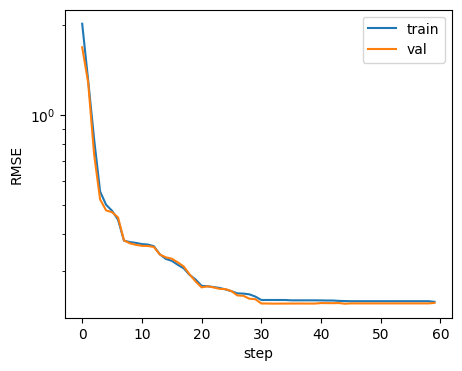

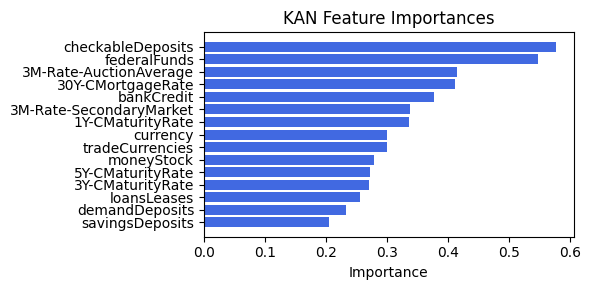

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.22it/s]

[('3M-Rate-SecondaryMarket', 0.38917243486004216), ('loansLeases', 0.10728887046376864), ('checkableDeposits', 0.08643856300484566), ('savingsDeposits', 0.028590754461696462), ('demandDeposits', 0.007310531045576291), ('Ex1', 0.004636400370370774), ('currency', 0.00044919294083402273), ('bankCredit', 0.00042161200018156145), ('5Y-CMaturityRate', 0.00036062286013648624), ('1Y-CMaturityRate', 0.0003085605445362273), ('30Y-CMortgageRate', 0.0), ('3M-Rate-AuctionAverage', 0.0), ('3Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('tradeCurrencies', 0.0)]


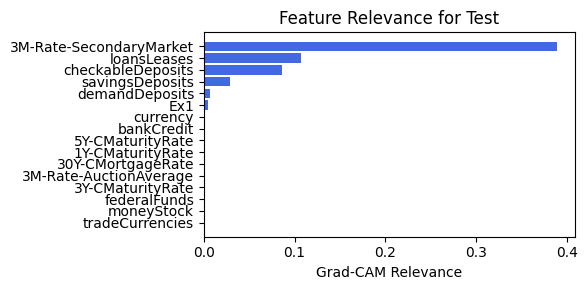

In [230]:
train_and_plot_relevance(Model3_4, kan_neurons=6, kan_grid=7, lamb=1e-05, steps=60, embed_dim=32, filename=filename_4, opt_col_val=32)

### 4.3.3 width=[15, 6, 1], grid=7, lamb=1e-05 | embed_dim=32

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.94e-01 | eval_loss: 2.00e-01 | reg: 2.22e+01 |: 100%|█| 60/60 [00:21<00:00,  2.86it/

saving model version 0.1
Best epoch 52
0.25083234906196594
M_KAN Relevance: 0.08379694074392319
CNN Relevance: 0.9162030816078186
[('checkableDeposits', 0.57750887), ('federalFunds', 0.5486747), ('3M-Rate-AuctionAverage', 0.41464934), ('30Y-CMortgageRate', 0.41203198), ('bankCredit', 0.37683266), ('3M-Rate-SecondaryMarket', 0.33746576), ('1Y-CMaturityRate', 0.33573708), ('currency', 0.30083153), ('tradeCurrencies', 0.2995401), ('moneyStock', 0.2785475), ('5Y-CMaturityRate', 0.27250415), ('3Y-CMaturityRate', 0.2703013), ('loansLeases', 0.25460258), ('demandDeposits', 0.23184499), ('savingsDeposits', 0.20508501)]


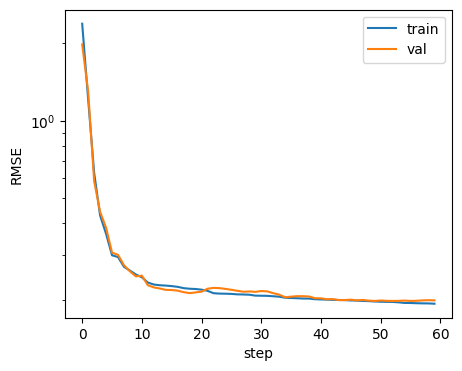

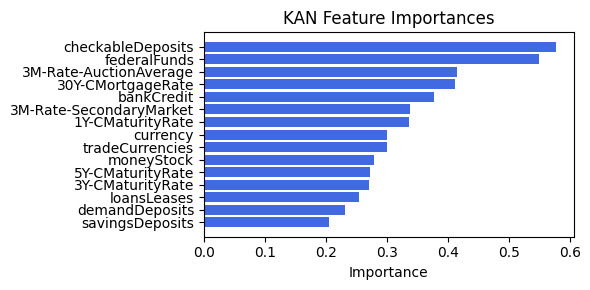

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.58it/s]

[('3M-Rate-SecondaryMarket', 0.08942775823940922), ('checkableDeposits', 0.05631049127661667), ('loansLeases', 0.022421586890483187), ('currency', 0.019970670191659812), ('Ex1', 0.01048763761341217), ('3M-Rate-AuctionAverage', 0.008383387344933692), ('1Y-CMaturityRate', 0.007092014132511048), ('30Y-CMortgageRate', 0.006819096917197818), ('demandDeposits', 0.003314637652199183), ('savingsDeposits', 0.001089441824782019), ('federalFunds', 0.0006850586051032657), ('bankCredit', 0.0006534389619316373), ('5Y-CMaturityRate', 0.0004755810524026553), ('moneyStock', 3.029110264920053e-05), ('3Y-CMaturityRate', 0.0), ('tradeCurrencies', 0.0)]


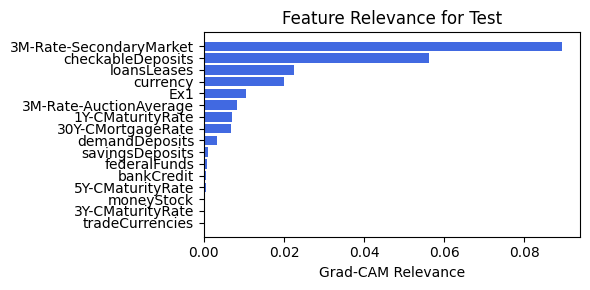

In [231]:
train_and_plot_relevance(Model3_4, kan_neurons=6, kan_grid=7, lamb=1e-05, steps=60, embed_dim=32, filename=filename_4, opt_col_val=32)

### 4.3.4 width=[15, 6, 1], grid=7, lamb=1e-05 | embed_dim=16

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.48e-01 | eval_loss: 2.14e-01 | reg: 2.19e+01 |: 100%|█| 60/60 [00:19<00:00,  3.06it/

saving model version 0.1
Best epoch 9
0.24345974624156952
M_KAN Relevance: 0.055060189217329025
CNN Relevance: 0.9449398517608643
[('checkableDeposits', 0.57750213), ('federalFunds', 0.54865193), ('3M-Rate-AuctionAverage', 0.41463658), ('30Y-CMortgageRate', 0.41200835), ('bankCredit', 0.37681866), ('3M-Rate-SecondaryMarket', 0.33745334), ('1Y-CMaturityRate', 0.3357339), ('currency', 0.3008352), ('tradeCurrencies', 0.29954523), ('moneyStock', 0.27853677), ('5Y-CMaturityRate', 0.27250904), ('3Y-CMaturityRate', 0.27030084), ('loansLeases', 0.25464606), ('demandDeposits', 0.231868), ('savingsDeposits', 0.20511113)]


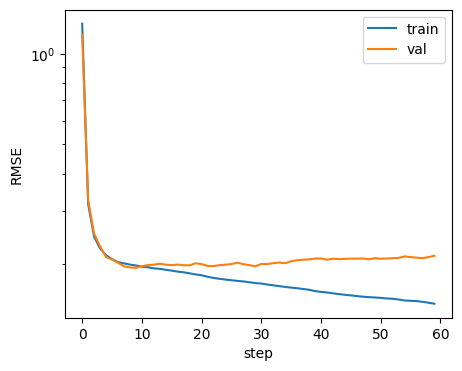

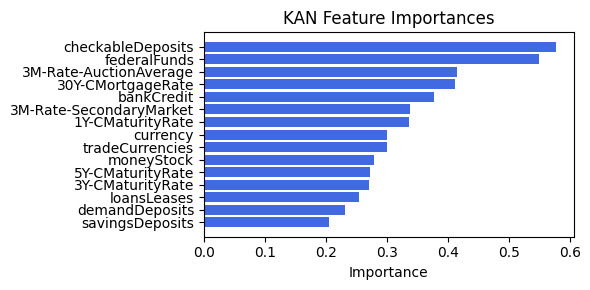

Computing Grad-CAM: 100%|██████████| 210/210 [00:25<00:00,  8.40it/s]

[('loansLeases', 0.24054715679348668), ('savingsDeposits', 0.08023328908408682), ('3M-Rate-SecondaryMarket', 0.019438251852989197), ('demandDeposits', 0.01527978697974634), ('1Y-CMaturityRate', 0.012624093358005796), ('tradeCurrencies', 0.005725566009503035), ('30Y-CMortgageRate', 0.0040844478494753795), ('3M-Rate-AuctionAverage', 0.0037127304600463027), ('currency', 0.0003684733240377335), ('bankCredit', 0.0003516952906336103), ('5Y-CMaturityRate', 5.5857636921462556e-05), ('3Y-CMaturityRate', 0.0), ('federalFunds', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0), ('Ex1', 0.0)]


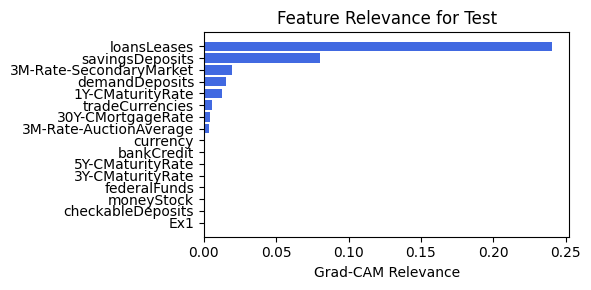

In [232]:
train_and_plot_relevance(Model3_4, kan_neurons=6, kan_grid=7, lamb=1e-05, steps=60, embed_dim=16, filename=filename_4, opt_col_val=16)

### 4.3.5 width=[15, 6, 1], grid=7, lamb=1e-05 | embed_dim=16

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3_4


| train_loss: 1.44e-01 | eval_loss: 1.98e-01 | reg: 2.25e+01 |: 100%|█| 60/60 [00:22<00:00,  2.68it/

saving model version 0.1
Best epoch 51
0.24063687026500702
M_KAN Relevance: 0.07207455486059189
CNN Relevance: 0.9279254078865051
[('checkableDeposits', 0.5773853), ('federalFunds', 0.5532675), ('30Y-CMortgageRate', 0.41776776), ('3M-Rate-AuctionAverage', 0.41760334), ('bankCredit', 0.3799592), ('3M-Rate-SecondaryMarket', 0.34036678), ('1Y-CMaturityRate', 0.33582413), ('currency', 0.30070314), ('tradeCurrencies', 0.29803205), ('moneyStock', 0.2817453), ('5Y-CMaturityRate', 0.2714206), ('3Y-CMaturityRate', 0.2694012), ('loansLeases', 0.24161503), ('demandDeposits', 0.22510056), ('savingsDeposits', 0.19703811)]


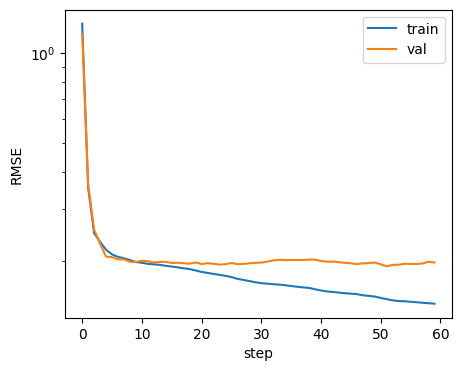

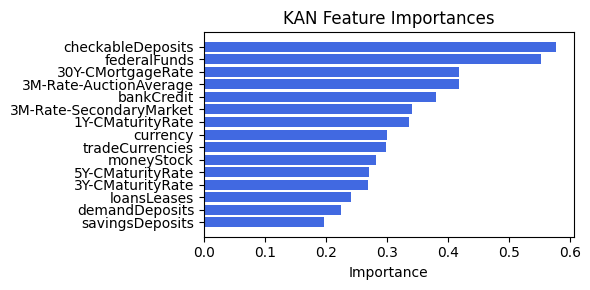

Computing Grad-CAM: 100%|██████████| 210/210 [00:24<00:00,  8.66it/s]

[('3Y-CMaturityRate', 0.1843048220720361), ('tradeCurrencies', 0.08886885636242195), ('loansLeases', 0.06194415923025753), ('demandDeposits', 0.040453523814323405), ('savingsDeposits', 0.030224775605234927), ('5Y-CMaturityRate', 0.022286116949371285), ('1Y-CMaturityRate', 0.01728715116143056), ('bankCredit', 0.017083209294027516), ('federalFunds', 0.012077291597545678), ('Ex1', 0.0007655469950155488), ('3M-Rate-SecondaryMarket', 0.0006672871055170184), ('30Y-CMortgageRate', 0.00041330399302144845), ('3M-Rate-AuctionAverage', 0.0001224199926669133), ('currency', 0.0), ('moneyStock', 0.0), ('checkableDeposits', 0.0)]


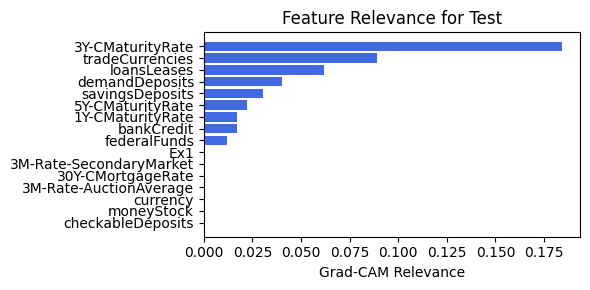

In [233]:
train_and_plot_relevance(Model3_4, kan_neurons=6, kan_grid=7, lamb=1e-05, steps=60, embed_dim=16, filename=filename_4, opt_col_val=16)

# Hibrid Model3 training ✅ Top 2 Configurations

### 1. width=[8, 4, 1], grid=3, lamb=0.01| best_epoch=10 | loss=3.21696

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3


| train_loss: 3.10e+00 | eval_loss: 3.14e+00 | reg: 4.28e+01 |: 100%|█| 40/40 [00:39<00:00,  1.02it/


saving model version 0.1
Best epoch 15
3.2704854011535645


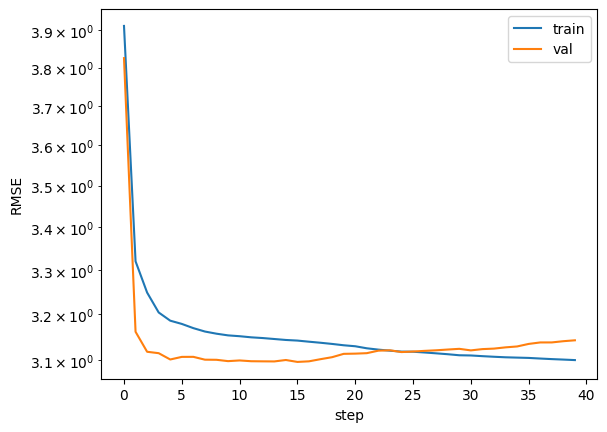

In [101]:
model = try_create_model(Model3, attributes, imgs_shape, kan_neurons=4, kan_grid=3, cnn_bottleneck_dim=1)
best_model_state, metrics3, _ = fit_hybrid_dataloaders(model, dataset, opt="LBFGS", steps=40, lamb=0.01)
plot_training_RMSE(model, best_model_state, average_rmse(model(dataset['test_input'], dataset['test_img']), dataset['test_label']), metrics3['train_loss'], metrics3['eval_loss'])

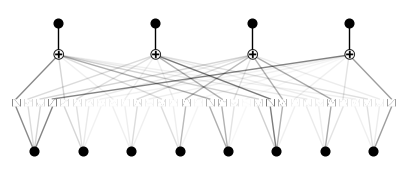

In [45]:
model.m_kan.plot()

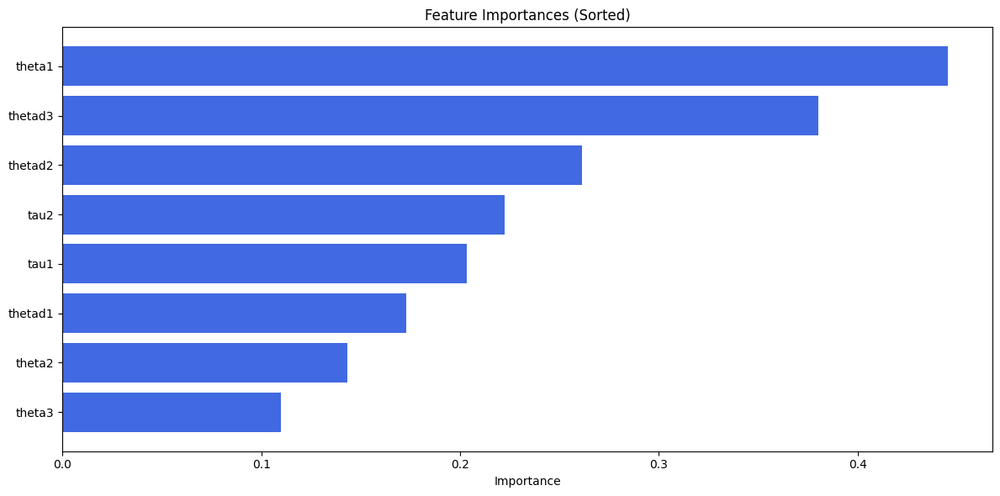

In [46]:
plot_sorted_feature_importance(x_col, model.m_kan.feature_score)

In [42]:
avg_scores = compute_avg_feature_relevance_from_val(
    model=model,
    model_state=best_model_state,
    val_inputs=dataset["test_input"],
    val_imgs=dataset["test_img"],
    coordinate=completed_coordinate,
    x_col=completed_x_col,
    zoom=2
)
plot_feature_relevance_bar(avg_scores)

Computing Grad-CAM:   0%|          | 0/1639 [00:00<?, ?it/s]


AttributeError: 'Model3_0' object has no attribute 'cnn_branch'

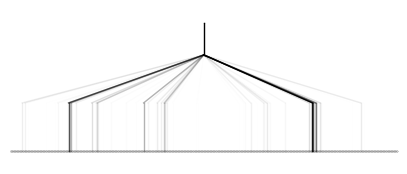

In [47]:
model.final_kan.plot()

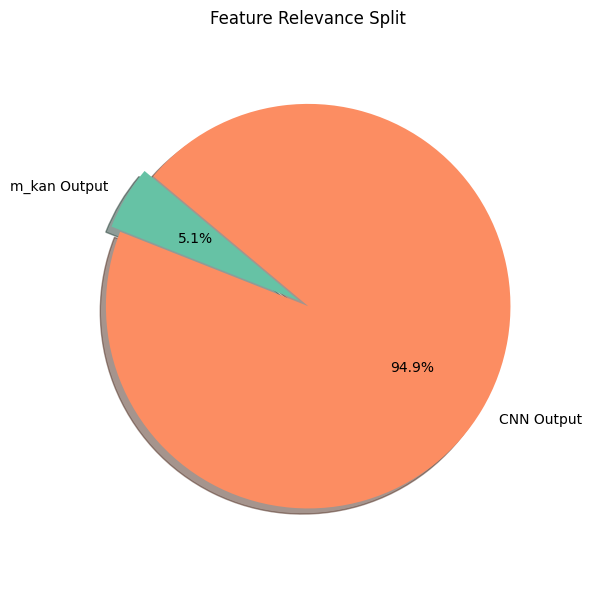

In [103]:
plot_mkan_vs_cnn_relevance(model.final_kan.feature_score, mkan_len=4)

C:\Users\vgiov\OneDrive\Documents\Master Data Science\Thesis\pykan\kan\MultKAN.py:822: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\ReduceOps.cpp:1823.)
  self.subnode_actscale.append(torch.std(x, dim=0).detach())
C:\Users\vgiov\OneDrive\Documents\Master Data Science\Thesis\pykan\kan\MultKAN.py:832: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\ReduceOps.cpp:1823.)
  input_range = torch.std(preacts, dim=0) + 0.1
C:\Users\vgiov\OneDrive\Documents\Master Data Science\Thesis\pykan\kan\MultKAN.py:833: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by o

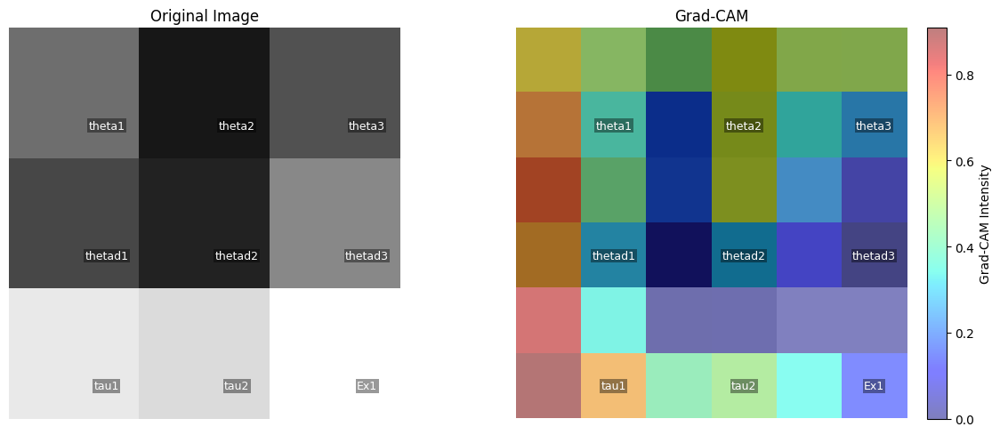

In [50]:
i = 4  # index of the image you want to explain
heatmap = grad_cam_side_by_side(
    model=model,
    model_state=best_model_state,
    num_input=dataset["test_input"][i],
    img_input=dataset["test_img"][i],
    x_col=completed_x_col,
    coordinate=completed_coordinate,
    zoom=2
)

Computing Grad-CAM: 100%|██████████| 1639/1639 [09:53<00:00,  2.76it/s] 


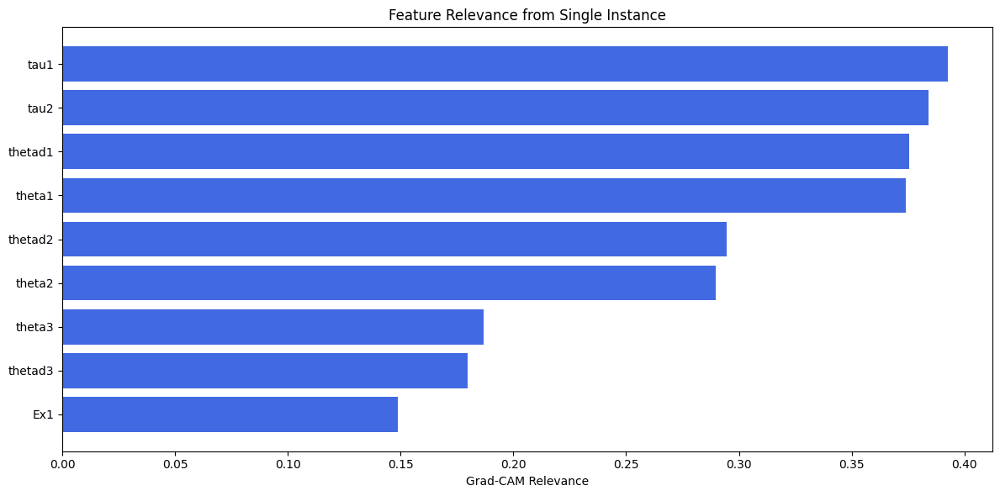

In [51]:
avg_scores = compute_avg_feature_relevance_from_val(
    model=model,
    model_state=best_model_state,
    val_inputs=dataset["test_input"],
    val_imgs=dataset["test_img"],
    coordinate=completed_coordinate,
    x_col=completed_x_col,
    zoom=2
)
plot_feature_relevance_bar(avg_scores)

### 2. width=[8, 3, 1], grid=5, lamb=0.01| best_epoch=12 | loss=3.21744

In [52]:
del model
torch.cuda.empty_cache()
gc.collect()

13172740

In [42]:
model = try_create_model(Model3, attributes, imgs_shape, kan_neurons=3, kan_grid=5)
best_model_state, metrics3,_ = fit_hybrid_dataloaders(model, dataset, opt="LBFGS", steps=40, lamb=0.01)
plot_training_RMSE(model, best_model_state, average_rmse(model(dataset['test_input'], dataset['test_img']), dataset['test_label']), metrics3['train_loss'], metrics3['val_loss'])

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model3


| train_loss: 3.40e+00 | eval_loss: 3.17e+00 | reg: 1.19e+02 |:   8%| | 3/40 [00:18<03:44,  6.06s/it


KeyboardInterrupt: 

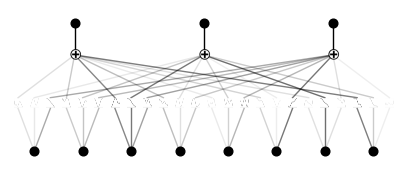

In [54]:
model.m_kan.plot()

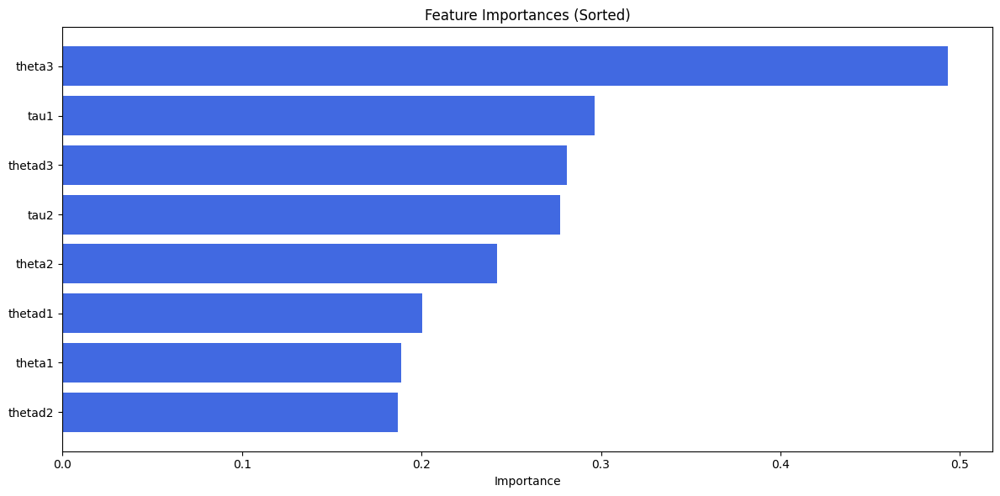

In [55]:
plot_sorted_feature_importance(x_col, model.m_kan.feature_score)

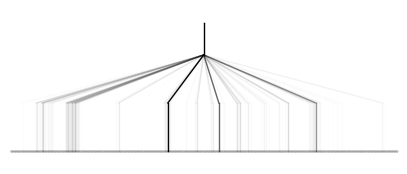

In [56]:
model.final_kan.plot()

In [57]:
feature_score = model.final_kan.feature_score

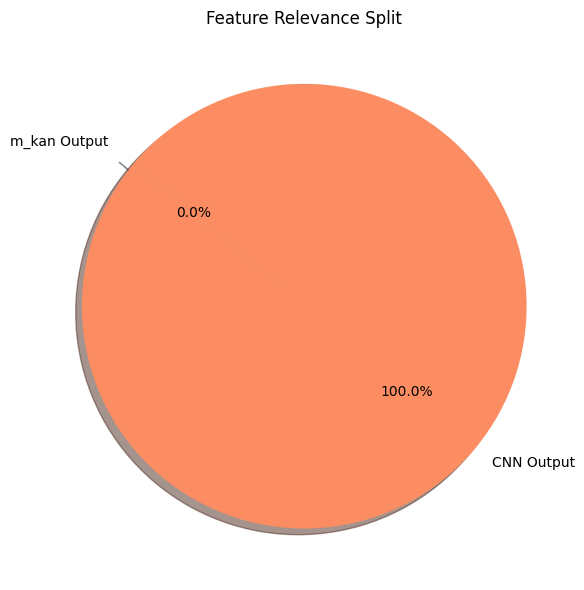

In [58]:
plot_mkan_vs_cnn_relevance(feature_score, mkan_len=3)

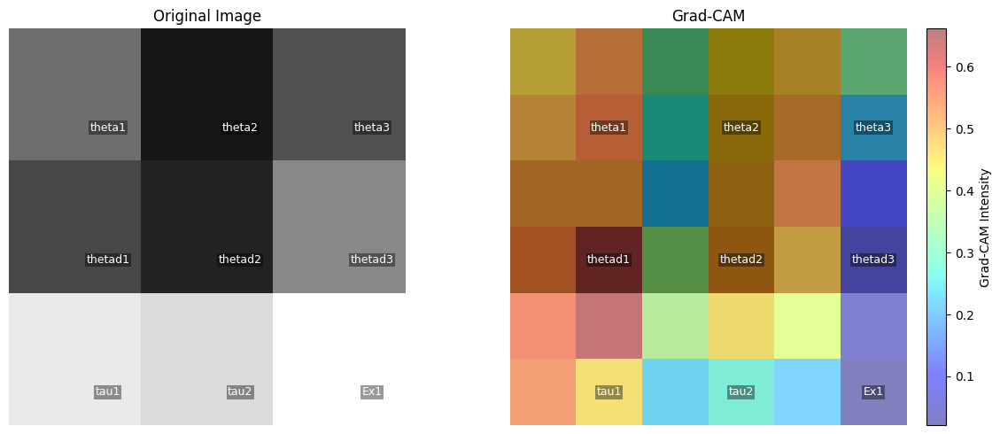

In [59]:
i = 4  # index of the image you want to explain
heatmap = grad_cam_side_by_side(
    model=model,
    model_state=best_model_state,
    num_input=dataset["test_input"][i],
    img_input=dataset["test_img"][i],
    x_col=completed_x_col,
    coordinate=completed_coordinate,
    zoom=2
)

Computing Grad-CAM: 100%|██████████| 1639/1639 [09:06<00:00,  3.00it/s]


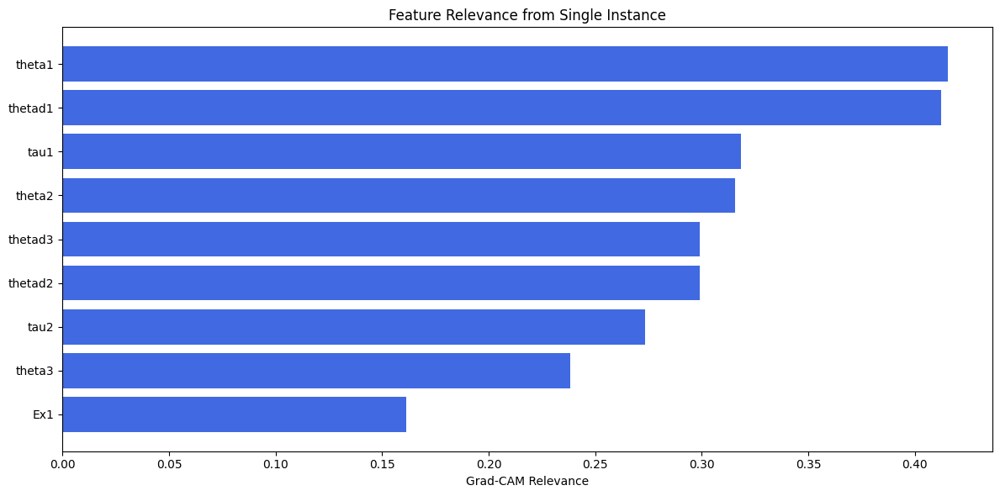

In [60]:
avg_scores = compute_avg_feature_relevance_from_val(
    model=model,
    model_state=best_model_state,
    val_inputs=dataset["test_input"],
    val_imgs=dataset["test_img"],
    coordinate=completed_coordinate,
    x_col=completed_x_col,
    zoom=2
)
plot_feature_relevance_bar(avg_scores)

# Hybrid Model4 training ✅ Top 2 Configurations

### 1. width=[8, 1, 1], grid=4, lamb=0.01| best_epoch=7 | loss=3.23119

In [61]:
del model
torch.cuda.empty_cache()
gc.collect()

13370161

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model4


| train_loss: 2.45e+00 | eval_loss: 3.71e+00 | reg: 9.67e+01 |: 100%|█| 40/40 [13:51<00:00, 20.80s/i


saving model version 0.1
Best epoch 8
3.7815768718719482


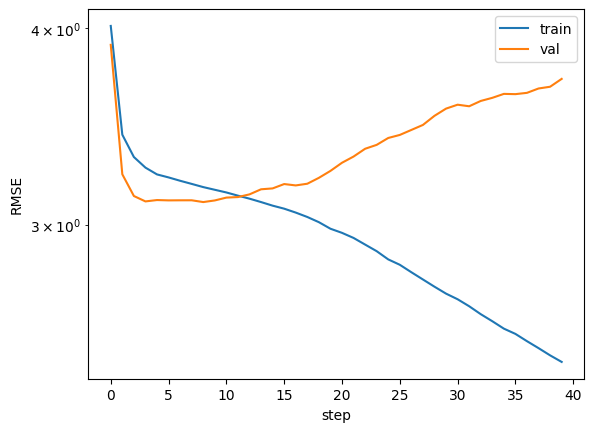

In [62]:
model = try_create_model(Model4, attributes, imgs_shape, kan_neurons=1, kan_grid=4)  # Attempt to create Model4
best_model_state, metrics4, _ = fit_hybrid_dataloaders(model, dataset, opt="LBFGS", steps=40, lamb=0.01)
plot_training_RMSE(model, best_model_state, average_rmse(model(dataset['test_input'], dataset['test_img']), dataset['test_label']), metrics4['train_loss'], metrics4['eval_loss'])

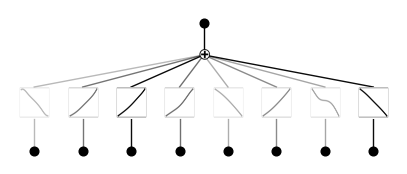

In [63]:
model.m_kan.plot()

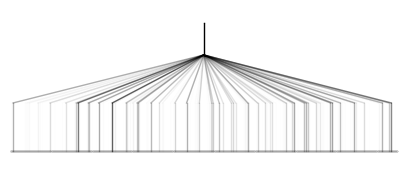

In [64]:
model.final_kan.plot()

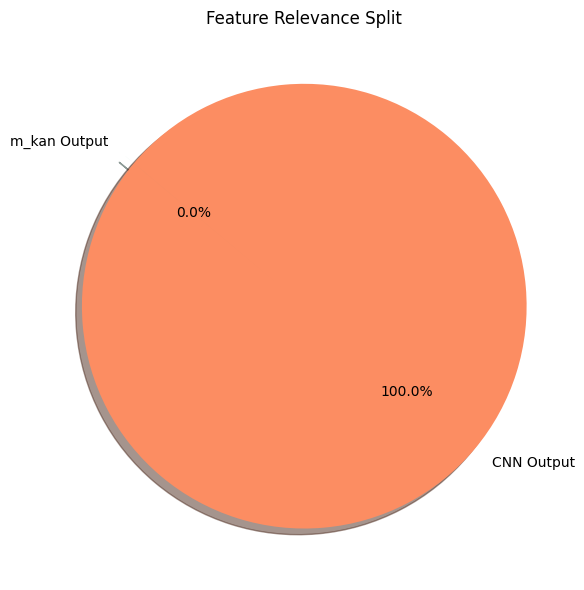

In [65]:
plot_mkan_vs_cnn_relevance(model.final_kan.feature_score, mkan_len=1)

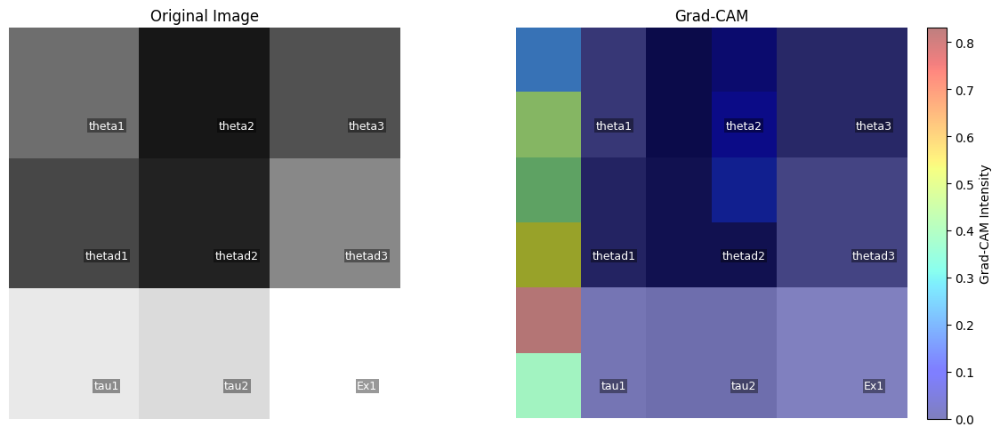

In [66]:
i = 4  # index of the image you want to explain
heatmap = grad_cam_side_by_side(
    model=model,
    model_state=best_model_state,
    num_input=dataset["test_input"][i],
    img_input=dataset["test_img"][i],
    x_col=completed_x_col,
    coordinate=completed_coordinate,
    zoom=2
)

Computing Grad-CAM: 100%|██████████| 1639/1639 [07:58<00:00,  3.43it/s] 


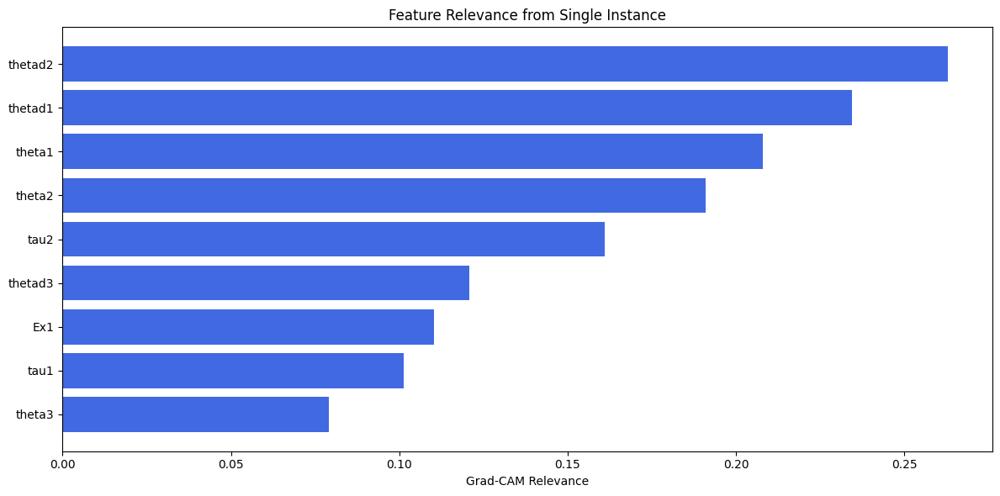

In [67]:
avg_scores = compute_avg_feature_relevance_from_val(
    model=model,
    model_state=best_model_state,
    val_inputs=dataset["test_input"],
    val_imgs=dataset["test_img"],
    coordinate=completed_coordinate,
    x_col=completed_x_col,
    zoom=2
)
plot_feature_relevance_bar(avg_scores)

### 2. width=[8, 2, 1], grid=4, lamb=0.1| best_epoch=7 | loss=3.23543

In [70]:
del model
torch.cuda.empty_cache()
gc.collect()

481

checkpoint directory created: ./model
saving model version 0.0
checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model4


| train_loss: 3.23e+00 | eval_loss: 3.22e+00 | reg: 2.22e+01 |: 100%|█| 40/40 [06:48<00:00, 10.22s/i


saving model version 0.1
Best epoch 11
3.356964588165283


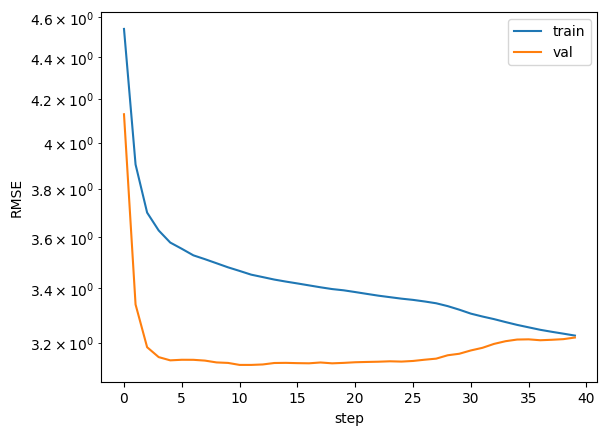

In [71]:
model = try_create_model(Model4, attributes, imgs_shape, kan_neurons=2, kan_grid=4)  # Attempt to create Model4
best_model_state, metrics4, _ = fit_hybrid_dataloaders(model, dataset, opt="LBFGS", steps=40, lamb=0.1)
plot_training_RMSE(model, best_model_state, average_rmse(model(dataset['test_input'], dataset['test_img']), dataset['test_label']), metrics4['train_loss'], metrics4['eval_loss'])

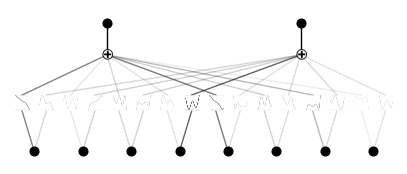

In [72]:
model.m_kan.plot()

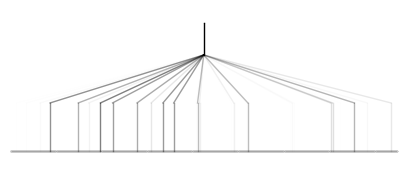

In [73]:
model.final_kan.plot()

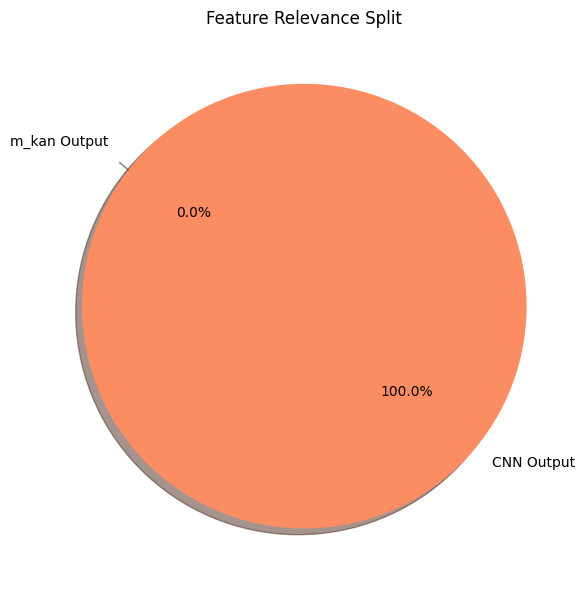

In [74]:
plot_mkan_vs_cnn_relevance(model.final_kan.feature_score, mkan_len=2)

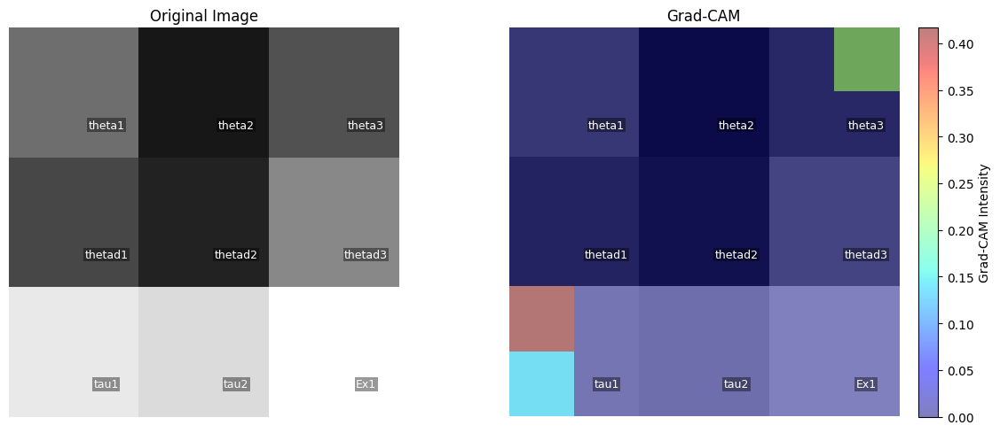

In [75]:
i = 4  # index of the image you want to explain
heatmap = grad_cam_side_by_side(
    model=model,
    model_state=best_model_state,
    num_input=dataset["test_input"][i],
    img_input=dataset["test_img"][i],
    x_col=completed_x_col,
    coordinate=completed_coordinate,
    zoom=2
)

Computing Grad-CAM: 100%|██████████| 1639/1639 [08:03<00:00,  3.39it/s] 


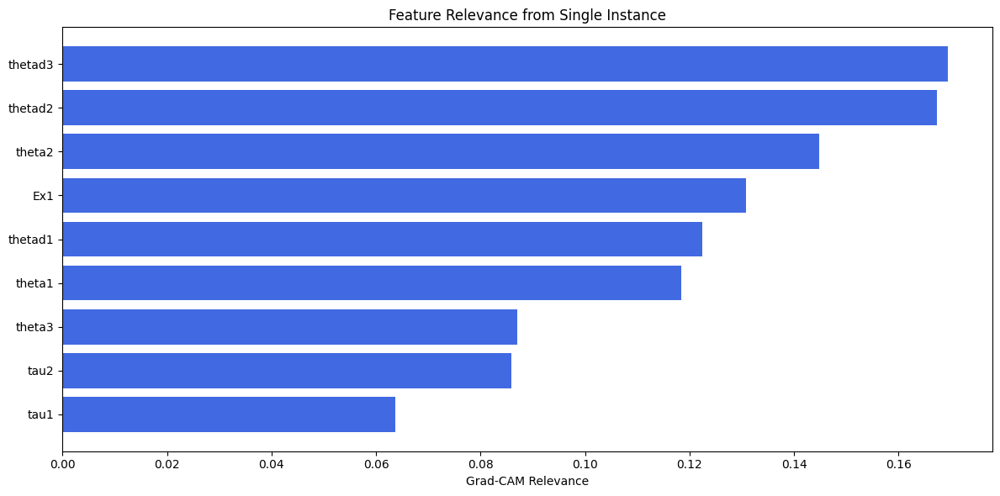

In [76]:
avg_scores = compute_avg_feature_relevance_from_val(
    model=model,
    model_state=best_model_state,
    val_inputs=dataset["test_input"],
    val_imgs=dataset["test_img"],
    coordinate=completed_coordinate,
    x_col=completed_x_col,
    zoom=2
)
plot_feature_relevance_bar(avg_scores)

# Bonus Hybrid

In [49]:
class Model5(nn.Module):
    def __init__(self, attributes, imgs_shape, kan_neurons, kan_grid, device=device):
        super(Model5, self).__init__()
        # CNN branch
        self.cnn_branch = nn.Sequential(
            nn.Conv2d(imgs_shape[0], 16, kernel_size=3, padding=2),     # out: 16 x 9 x 9
            nn.LayerNorm([16, 8, 8]),
            nn.Sigmoid(),
            nn.Flatten()
        ).to(device)

        # Calculate the size of the flattened output
        self.flat_size = self._get_flat_size(imgs_shape)

        self.final_kan = KAN(
            width=[self.flat_size, 1],
            grid=kan_grid,
            k=3,
            seed=SEED,
            device=device
        )

        self.device = device


    def _get_flat_size(self, imgs_shape):
        # Forward pass with dummy input to calculate flat size
        dummy_input = torch.zeros(4, *imgs_shape, device=device)
        x = self.cnn_branch(dummy_input)
        return x.size(1)

    def get_concat_output(self, mlp_input, cnn_input):
        # Ensure inputs are moved to the correct device
        cnn_input = cnn_input.to(self.device)
        
        return self.cnn_branch(cnn_input)  # Process image input

    
    def forward(self, mlp_input, cnn_input):
        concat_output = self.get_concat_output(mlp_input, cnn_input)
        return self.final_kan(concat_output)

In [59]:
def fit_hybrid_dataloaders2(model, 
                           dataset,
                           opt="AdamW", 
                           steps=100, 
                           log=1, 
                           lamb=0., 
                           lamb_l1=1., 
                           lamb_entropy=2., 
                           lamb_coef=0., 
                           lamb_coefdiff=0., 
                           update_grid=True, 
                           grid_update_num=10, 
                           loss_fn=None, 
                           lr=1., 
                           start_grid_update_step=-1, 
                           stop_grid_update_step=50, 
                           batch=-1,
                           metrics=None, 
                           save_fig=False, 
                           in_vars=None, 
                           out_vars=None, 
                           beta=3, 
                           save_fig_freq=1, 
                           img_folder='./video', 
                           singularity_avoiding=False, 
                           y_th=1000., 
                           reg_metric='edge_forward_spline_n', 
                           display_metrics=None,
                           sum_f_reg=True):
    """
    Trains the hybrid model (with a KAN branch and a CNN branch) using a steps-based loop
    adapted from KAN.fit(), with grid updates and regularization.
    
    Instead of a single dataset dict, this function accepts three DataLoaders:
        - train_loader: provides (mlp, img, target) for training
        - val_loader: provides (mlp, img, target) for evaluation during training
        - test_loader: provides (mlp, img, target) for validation

    Internally, the function combines each loader into a dataset dictionary.
    
    Returns:
        results: dictionary containing training loss, evaluation loss, regularization values,
                 and any additional metrics recorded during training.
    """
    #device = next(model.parameters()).device

    # Warn if regularization is requested but model's internal flag isn't enabled.
    if lamb > 0. and not getattr(model.final_kan, "save_act", False):
        print("setting lamb=0. If you want to set lamb > 0, set model.final_kan.save_act=True")
    
    # Disable symbolic processing for training if applicable (KAN internal logic)
    if hasattr(model.final_kan, "disable_symbolic_in_fit"):
        old_save_act, old_symbolic_enabled = model.final_kan.disable_symbolic_in_fit(lamb)
    else:
        old_save_act, old_symbolic_enabled = None, None

    pbar = tqdm(range(steps), desc='Training', ncols=100)

    # Default loss function (mean squared error) if not provided
    if loss_fn is None:
        loss_fn = lambda x, y: torch.mean((x - y) ** 2)

    # Determine grid update frequency
    grid_update_freq = int(stop_grid_update_step / grid_update_num) if grid_update_num > 0 else 1

    # Determine total number of training examples
    n_train = dataset["train_input"].shape[0]
    n_eval  = dataset["val_input"].shape[0]  # using val set for evaluation during training
    batch_size = n_train if batch == -1 or batch > n_train else batch

    # Set up optimizer: choose between Adam and LBFGS (removed tolerance_ys)
    if opt == "AdamW":
        optimizer = optim.AdamW(model.parameters(), lr=lr)
    elif opt == "LBFGS":        
        optimizer = LBFGS(model.parameters(), lr=lr, history_size=10, 
                          line_search_fn="strong_wolfe", 
                          tolerance_grad=1e-32, 
                          tolerance_change=1e-32, 
                          tolerance_ys=1e-32)
    else:
        raise ValueError("Optimizer not recognized. Use 'Adam' or 'LBFGS'.")

    # Prepare results dictionary.
    results = {'train_loss': [], 'eval_loss': [], 'reg': []}

    
    if metrics is not None:
        for metric in metrics:
            results[metric.__name__] = []

    best_model_state = None
    best_epoch = -1
    best_loss = float('inf')

    for step in pbar:
        # Randomly sample indices for a mini-batch from the training set.
        train_indices = np.random.choice(n_train, batch_size, replace=False)
        # Use full evaluation set for evaluation; you can also sample if desired.
        eval_indices = np.arange(n_eval)
        cached_loss = {}
        # Closure for LBFGS
        def closure():
            optimizer.zero_grad()
            mlp_batch = dataset["train_input"][train_indices]
            img_batch = dataset["train_img"][train_indices]
            target_batch = dataset["train_label"][train_indices]
            outputs = model(mlp_batch, img_batch)
            train_loss = loss_fn(outputs, target_batch)
            # Compute regularization term if enabled.
            if hasattr(model.final_kan, "save_act") and model.final_kan.save_act:
                if reg_metric == 'edge_backward':
                    model.final_kan.attribute()
                if reg_metric == 'node_backward':
                    model.final_kan.node_attribute()
                reg_val_inner = model.final_kan.get_reg(reg_metric, lamb_l1, lamb_entropy, lamb_coef, lamb_coefdiff)
            else:
                reg_val_inner = torch.tensor(0., device=device)
            loss_val_inner = train_loss + lamb * reg_val_inner
            loss_val_inner.backward()

            cached_loss['loss'] = loss_val_inner.detach()
            cached_loss['reg'] = reg_val_inner.detach()
            return loss_val_inner

        # Perform grid update if applicable.
        if (step % grid_update_freq == 0 and step < stop_grid_update_step 
            and update_grid and step >= start_grid_update_step):
            
            mlp_batch = dataset['train_input'][train_indices]
            cnn_batch = dataset['train_img'][train_indices]
            #cnn_output = model.cnn_branch(cnn_batch)  # Process image input
            concatenated = model.get_concat_output(mlp_batch, cnn_batch)
            #concatenated = torch.cat((mlp_batch, cnn_output), dim=1)
            model.final_kan.update_grid(concatenated)

        # Perform an optimizer step.
        if opt == "LBFGS":
            optimizer.step(closure)
            loss_val = cached_loss['loss']
            reg_val = cached_loss['reg']
        else:  # AdamW branch
            optimizer.zero_grad()
            mlp_batch = dataset["train_input"][train_indices]
            img_batch = dataset["train_img"][train_indices]
            target_batch = dataset["train_label"][train_indices]
            outputs = model(mlp_batch, img_batch)
            train_loss = loss_fn(outputs, target_batch)
            if hasattr(model.final_kan, "save_act") and model.final_kan.save_act:
                if reg_metric == 'edge_backward':
                    model.final_kan.attribute()
                if reg_metric == 'node_backward':
                    model.final_kan.node_attribute()
                reg_val = model.final_kan.get_reg(reg_metric, lamb_l1, lamb_entropy, lamb_coef, lamb_coefdiff)
            else:
                reg_val = torch.tensor(0., device=device)
            loss_val = train_loss + lamb * reg_val
            loss_val.backward()
            optimizer.step()

        with torch.no_grad():
            mlp_eval = dataset["val_input"][eval_indices]
            img_eval = dataset["val_img"][eval_indices]
            target_eval = dataset["val_label"][eval_indices]
            eval_loss = loss_fn(model(mlp_eval, img_eval), target_eval)

        # Record results (using square-root of loss similar to KAN.fit)
        results['train_loss'].append(torch.sqrt(loss_val.detach()).item())
        results['eval_loss'].append(torch.sqrt(eval_loss.detach()).item())
        results['reg'].append(reg_val.detach().item())

        if metrics is not None:
            for metric in metrics:
                # Here, we assume each metric returns a tensor.
                results[metric.__name__].append(metric().item())

        if eval_loss < best_loss:
            best_epoch = step
            best_loss = eval_loss
            best_model_state = copy.deepcopy(model.state_dict())

        # Update progress bar.
        if display_metrics is None:
            pbar.set_description("| train_loss: %.2e | eval_loss: %.2e | reg: %.2e |" %
                                 (torch.sqrt(loss_val.detach()).item(),
                                  torch.sqrt(eval_loss.detach()).item(),
                                  reg_val.detach().item()))
        else:
            desc = ""
            data = []
            for metric in display_metrics:
                desc += f" {metric}: %.2e |"
                data.append(results[metric.__name__][-1])
            pbar.set_description(desc % tuple(data))

        # Optionally save a figure snapshot.
        if save_fig and step % save_fig_freq == 0:
            save_act_backup = getattr(model.final_kan, "save_act", False)
            model.final_kan.save_act = True
            model.plot(folder=img_folder, in_vars=in_vars, out_vars=out_vars, title=f"Step {step}", beta=beta)
            plt.savefig(os.path.join(img_folder, f"{step}.jpg"), bbox_inches='tight', dpi=200)
            plt.close()
            model.final_kan.save_act = save_act_backup

    # Restore original settings if applicable.
    if old_symbolic_enabled is not None:
        model.final_kan.symbolic_enabled = old_symbolic_enabled
    if hasattr(model.final_kan, "log_history"):
        model.final_kan.log_history('fit')
    print(f"Best epoch {best_epoch}")
    return best_model_state, results, best_epoch

In [78]:
del model
torch.cuda.empty_cache()
gc.collect()

215554

In [65]:
model = try_create_model(Model5, attributes, imgs_shape, kan_neurons=3, kan_grid=4)  # Attempt to create Model4

checkpoint directory created: ./model
saving model version 0.0
Successfully created and tested Model5


In [66]:
best_model_state, metrics5, _ = fit_hybrid_dataloaders2(model, dataset, opt="LBFGS", steps=10, lamb=0.01)

| train_loss: 3.19e+00 | eval_loss: 3.10e+00 | reg: 5.06e+01 |: 100%|█| 10/10 [00:39<00:00,  3.91s/i

saving model version 0.1
Best epoch 9


3.2302682399749756


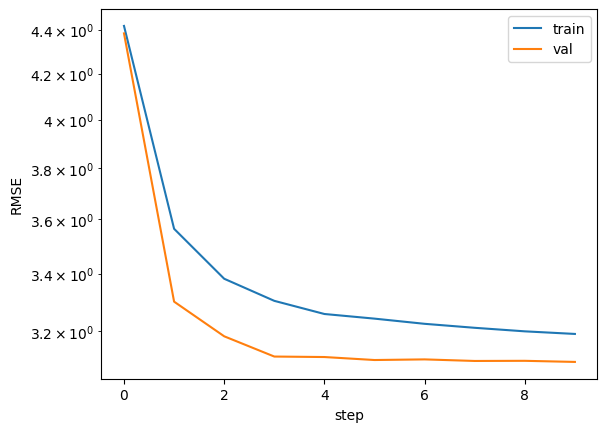

In [67]:
plot_training_RMSE(model, best_model_state, average_rmse(model(dataset['test_input'], dataset['test_img']), dataset['test_label']), metrics5['train_loss'], metrics5['eval_loss'])

C:\Users\vgiov\OneDrive\Documents\Master Data Science\Thesis\pykan\kan\MultKAN.py:822: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\ReduceOps.cpp:1823.)
  self.subnode_actscale.append(torch.std(x, dim=0).detach())
C:\Users\vgiov\OneDrive\Documents\Master Data Science\Thesis\pykan\kan\MultKAN.py:832: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\ReduceOps.cpp:1823.)
  input_range = torch.std(preacts, dim=0) + 0.1
C:\Users\vgiov\OneDrive\Documents\Master Data Science\Thesis\pykan\kan\MultKAN.py:833: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by o

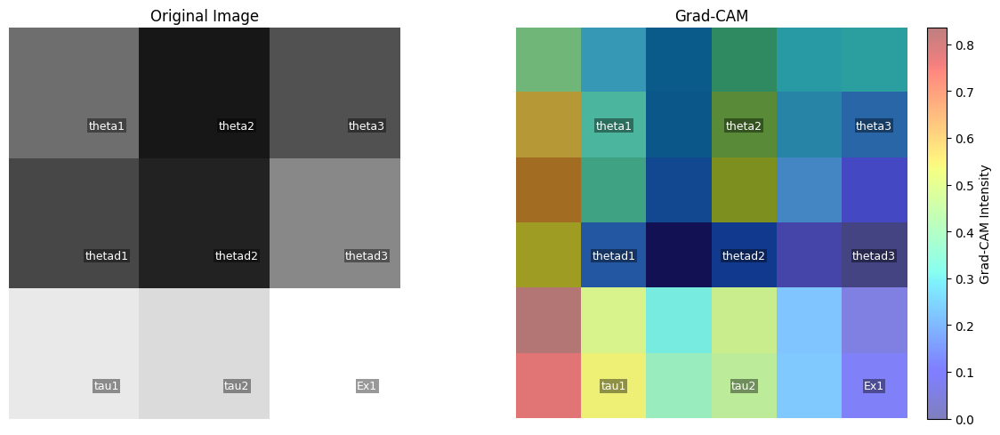

In [68]:
i = 4  # index of the image you want to explain
heatmap = grad_cam_side_by_side(
    model=model,
    model_state=best_model_state,
    num_input=dataset["test_input"][i],
    img_input=dataset["test_img"][i],
    x_col=completed_x_col,
    coordinate=completed_coordinate,
    zoom=2
)

Computing Grad-CAM:   2%|▏         | 26/1639 [00:24<25:31,  1.05it/s]


KeyboardInterrupt: 

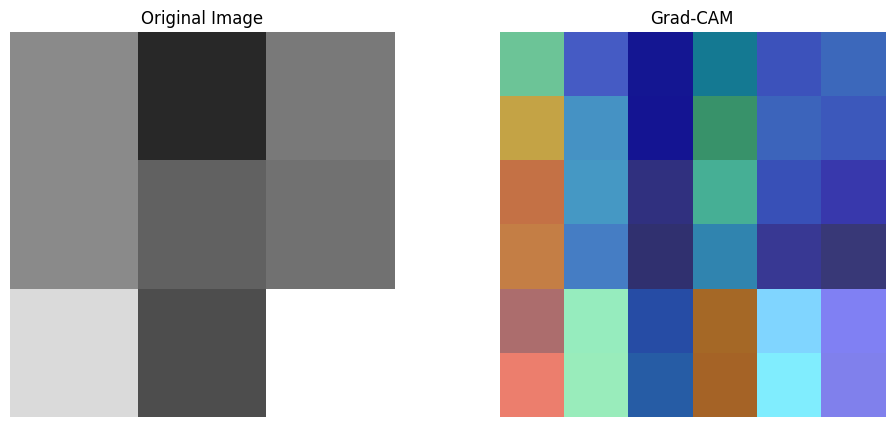

In [69]:
avg_scores = compute_avg_feature_relevance_from_val(
    model=model,
    model_state=best_model_state,
    val_inputs=dataset["test_input"],
    val_imgs=dataset["test_img"],
    coordinate=completed_coordinate,
    x_col=completed_x_col,
    zoom=2
)
plot_feature_relevance_bar(avg_scores)